In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:98% !important; }</style>"))

/tmp/ipykernel_179714/1256517549.py:1: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display, HTML


In [2]:
import numpy as np
from tqdm import tqdm as tqdm
#from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
import os
import optparse
import os.path as osp
import math
import torch_geometric
import torch
import sys
from torch_geometric.data import Data
import glob
from datetime import datetime
import random


from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay
import torch.jit as jit

In [3]:
# tt=torch.load("/grid_mnt/data__data.polcms/cms/sghosh/NEWPID_TICLDUMPER_DATA/ntup_pho_18082024/data_499.pt")
# np.unique(tt[0].clus2d_feat[:,5])

### check if GPU status

In [17]:
!nvidia-smi

cuda_id = !nvidia-smi --query-gpu="memory.used,index" --format="csv,noheader,nounits" |sort -r |head -n 1 | awk '{print $2}'

Fri Jul  4 18:31:43 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla V100-SXM2-32GB           Off |   00000000:18:00.0 Off |                    0 |
| N/A   42C    P0             57W /  300W |    2199MiB /  32768MiB |      1%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [5]:
cuda_id

['2']

### set seed for reproducibility

In [4]:
seed = 42

In [5]:
torch.manual_seed(seed)
#torch.use_deterministic_algorithms(True) # not good: this makes the training break
random.seed(seed)
np.random.seed(seed) # this acts on the shuffle done in test and training datasets. To have always same results in the inference

### create output directory

In [6]:
#today = date.today()
now = datetime.now().strftime("%Y%m%d_%H%M%S")
out_dir = str(now)+'_checkpoints'
os.makedirs(out_dir, exist_ok=True) #check if output dir exist
print(out_dir)

20250704_182355_checkpoints


### tensors features

In [9]:
#########################################
# clus2d_feats = np.stack((ak.to_numpy(sel_clusters[ts].position_x),
#                          ak.to_numpy(sel_clusters[ts].position_y),
#                          ak.to_numpy(sel_clusters[ts].position_z),
#                          ak.to_numpy(sel_clusters[ts].energy),
#                          ak.to_numpy(sel_clusters[ts].cluster_time),
#                          ak.to_numpy(sel_clusters[ts].cluster_layer_id))).T

#                     #print(clus2d_feats.shape)
# clus3d_feats = np.stack((sel_tseta[ts][0],
#                          sel_tsphi[ts][0],
#                          sel_tsen[ts][0],
#                          sel_tst[ts][0],
#                          min(ak.to_numpy(sel_clusters[ts].cluster_layer_id)),
#                          max(ak.to_numpy(sel_clusters[ts].cluster_layer_id)))).T
# gun_feats = np.stack((sel_cpeta[ts][0],
#                       sel_cpphi[ts][0],
#                       sel_cpen[ts][0],
#                       sel_cpent[ts][0], 
#                       sel_ratem[ts][0]    trk_em/ sim_em
#                       sel_rattot[ts][0]   trk/sim
#                        )).T
########################################

### Load input data

In [7]:
from torch.utils.data import Dataset

class ClassificationDataset(Dataset):
    def __init__(self, datapath, numLC, feats, signal, ispi, abz):
        self.datapath_ = datapath
        self.numLC_ = numLC
        self.signal_ = signal
        self.ispi_ = ispi
        self.abz_ = abz
        self.feats_ = feats
        self.process = self.load_datafiles(self.datapath_)
        self.data = torch.stack(self.process[0],dim=0)
        self.labels = torch.stack(self.process[1],dim=0)
        self.masks = torch.stack(self.process[2],dim=0)
        self.info3d = torch.stack(self.process[3],dim=0)
        self.infogun = torch.stack(self.process[4],dim=0)


    def load_datafiles(self, filepath) :
        "filepath of the form /grid_mnt/data__data.polcms/cms/sghosh/NEWPID_DATA/ntup_pho_frac0p8/ "
        print("processing files from:",filepath)
        filelist = [filen for filen in glob.glob(filepath+'data*.pt')]
        output_tensor_list = []
        label = []
        mask_tensor_list = []
        info3d_tensor_list = []
        infogun_tensor_list = []
        
        ctot = 0
        cll = 0
        
        
        for i in tqdm(filelist):
            if (len(label)>50000):
                    break
            
            for filei in torch.load(i) :
                ctot += 1
                #print(filei.gun_feat)
                passpi = False
                passpu = False
                nlay = len(np.unique(filei.clus2d_feat[:,5]))
                ratrec_true = (filei.clus3d_feat[2]/filei.gun_feat[:,3]).item()

                if (self.signal_):
#                    if (nlay < 13) :
                    if (ratrec_true < 0.7):
                        cll += 1                        
                        continue
                else:
                    feat2da = filei.clus2d_feat
                    fracen26 = torch.sum(feat2da[feat2da[:,5] <=26][:,3])/torch.sum(feat2da[:,3])
                    if self.ispi_:
                        #if (nlay > 10)and(fracen26 > 0.7)and(min(feat2da[:,5]) < 15) :
                        passpi = True
                        if not(passpi):
                            cll += 1
                            continue
                        #print("self.ispi_ & nlay < 10 & fracen26< 0.7", self.ispi_, nlay , fracen26)
                    else:
                        #if ((nlay < 10)and(fracen26 < 0.7))or ((nlay > 10)and(fracen26 < 0.7)) or ((nlay < 10)and(fracen26 > 0.7)):
                        #if not((nlay > 10)and(fracen26 > 0.7)and(min(feat2da[:,5]) < 15)):
                        if not((nlay > 10)and(fracen26 > 0.6)and(min(feat2da[:,5]) < 15)and((np.average(filei.clus2d_feat[:,2], weights=filei.clus2d_feat[:,3])) < 360)):
                            passpu = True
                        else:
                            pass
                            #print("self.ispi_ & nlay < 10 & fracen26< 0.7", self.ispi_, nlay, fracen26)
                        if not(passpu):
                            cll += 1
                            continue
                        #print("self.ispi_ & nlay < 10 & fracen26< 0.7", self.ispi_, nlay, fracen26)
               
                
                
                
                
                
                optensor = self.transform_data(filei.clus2d_feat, self.numLC_)
                output_tensor_list.append(optensor[0])
                mask_tensor_list.append(optensor[1])
                info3d_tensor_list.append(filei.clus3d_feat[[0,1,2,4,5]])
                infogun_tensor_list.append(filei.gun_feat)
                if self.signal_:
                    label.append(torch.ones(1,dtype=torch.double))
                else:
                    label.append(torch.zeros(1,dtype=torch.double))
         
        
        print ("nskipped | ntotal:",cll," | ",ctot)
        return output_tensor_list, label, mask_tensor_list, info3d_tensor_list, infogun_tensor_list
                
    def transform_data(self, tensor, nLC) :            

        #feats = [0,1,2,5]
        target = torch.zeros(nLC, len(self.feats_))
        mask0 = torch.ones(nLC)
        source = tensor[:nLC,self.feats_]
        mask1 = torch.zeros(source.shape[0])
        if self.abz_:
            source[:,2] = np.abs(source[:,2])
        target[:source.shape[0], :] = source
        #source = source.T
        mask0[:source.shape[0]] = mask1
        mask0 
        #print(mask0)
        return target, mask0 > 0
    
        
    
    def __len__(self):
        return len(self.labels)
    
    def __getitem__(self, idx): 
        return self.data[idx], self.labels[idx], self.masks[idx], self.info3d[idx], self.infogun[idx]

#### Photon dataset (energy spread: 10-1000 GeV)

In [8]:
pho_path = "/grid_mnt/data__data.polcms/cms/sghosh/NEWPID_TICLDUMPER_DATA/S2Rmin_pho_30072024/"
pho_dataset = ClassificationDataset(pho_path, 150, [0,1,5,3], True, False, True)

processing files from: /grid_mnt/data__data.polcms/cms/sghosh/NEWPID_TICLDUMPER_DATA/S2Rmin_pho_30072024/


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 500/500 [00:25<00:00, 19.50it/s]


nskipped | ntotal: 119  |  50000


#### Low Energy Photons (2-15 GeV)

In [9]:
lowptpho_path = "/grid_mnt/data__data.polcms/cms/sghosh/NEWPID_TICLDUMPER_DATA/S2Rmin_pho2to15_27092024/"
lowptpho_dataset = ClassificationDataset(lowptpho_path, 150, [0,1,5,3], True, False, True)

processing files from: /grid_mnt/data__data.polcms/cms/sghosh/NEWPID_TICLDUMPER_DATA/S2Rmin_pho2to15_27092024/


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 300/300 [00:15<00:00, 19.63it/s]

nskipped | ntotal: 589  |  30000


#### Pion dataset: pion sample from where high energy early showering pions are removed

In [10]:
hizpu_path = "/grid_mnt/data__data.polcms/cms/sghosh/NEWPID_TICLDUMPER_DATA/S2R0p9_pi_30072024/"
hizpu_dataset = ClassificationDataset(hizpu_path, 150, [0,1,5,3], False, False, True)

processing files from: /grid_mnt/data__data.polcms/cms/sghosh/NEWPID_TICLDUMPER_DATA/S2R0p9_pi_30072024/


 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 484/500 [00:42<00:01, 11.33it/s]


nskipped | ntotal: 20625  |  70628


#### Pion dataset: low energy clusters within CEE + others (no CEE restrictions)

##### low energy pions removing the pi0

In [11]:
lowzpu_path = "/grid_mnt/data__data.polcms/cms/sghosh/NEWPID_TICLDUMPER_DATA/S2Rno_PUenrich_05082024/"
lowzpu_dataset = ClassificationDataset(lowzpu_path, 150, [0,1,5,3], False, False, True)

processing files from: /grid_mnt/data__data.polcms/cms/sghosh/NEWPID_TICLDUMPER_DATA/S2Rno_PUenrich_05082024/


 50%|█████████████████████████████████████████████████████████████▌                                                             | 3/6 [03:13<03:13, 64.53s/it]


nskipped | ntotal: 228603  |  287365


##### low energy pions with all inside: no skipping of pi0

In [12]:
unbiased_dataset = ClassificationDataset(lowzpu_path, 150, [0,1,5,3], False, True, True)

processing files from: /grid_mnt/data__data.polcms/cms/sghosh/NEWPID_TICLDUMPER_DATA/S2Rno_PUenrich_05082024/


 17%|████████████████████▌                                                                                                      | 1/6 [00:42<03:30, 42.03s/it]


nskipped | ntotal: 0  |  95549


In [13]:
print("lenpho:",len(pho_dataset), " lenlowptpho:",len(lowptpho_dataset)," lenhizpu:",len(hizpu_dataset), " lenlozpu:",len(lowzpu_dataset), " lenunbias:",len(unbiased_dataset))

lenpho: 49881  lenlowptpho: 29411  lenhizpu: 50003  lenlozpu: 58762  lenunbias: 95549


### Define training and testing datasets

In [14]:
### DEFINE signal COMPOSITION
nphos_low = len(lowptpho_dataset) # number of low pt photons
nphos_normal = len(pho_dataset) # number of normal photons
# since nphos_low < nphos_normal, tot number of pho = 2 times n low pt pho, so that nphos_tot = 50% low pt pho + 50% normal pho
nphos_tot = int(2. * nphos_low) 

idxstotsamp = np.arange(nphos_tot)

normalpho = torch.utils.data.Subset(pho_dataset, idxstotsamp[:int(nphos_low)]) # normal photons: same number as low pt photons 

#### ATTENTION!
## for training up to number 7, then we changed it for training number 8
CEE_dataset = unbiased_dataset # for training up to number 7; comment for training number 8 inference
#CEE_dataset = lowzpu_dataset # for training number 8

### DEFINE Background COMPOSITION
hizpusel = torch.utils.data.Subset(hizpu_dataset, idxstotsamp[:int(0.3*nphos_tot)])
lowzpusel = torch.utils.data.Subset(CEE_dataset, idxstotsamp[:int(0.7*nphos_tot)])
#npusel = len(pho_dataset) - len(pisel)
#pusel = torch.utils.data.Subset(pu_dataset, idxstotsamp[:int(npusel)])

combdataset = torch.utils.data.ConcatDataset([normalpho, lowptpho_dataset, hizpusel, lowzpusel])

nsamp = len(combdataset)

idxs = np.arange(nsamp)
np.random.shuffle(idxs)
tridx = idxs[:int(0.8*nsamp)]
tsidx = idxs[int(0.8*nsamp):nsamp]
trdata = torch.utils.data.Subset(combdataset, tridx)
tsdata = torch.utils.data.Subset(combdataset, tsidx)

ntrainbatch = 600
## load train and test dataset
trainloader = torch.utils.data.DataLoader(trdata, batch_size=ntrainbatch ,shuffle=True)#, num_workers=2)
testloader = torch.utils.data.DataLoader(tsdata, batch_size=ntrainbatch,shuffle=True)#, num_workers=2)
## load all data, for plots later
totalloader = torch.utils.data.DataLoader(combdataset, batch_size=ntrainbatch,shuffle=True)#, num_workers=2)
## load unbiased dataset, for plots and inference later
unbiasloader = torch.utils.data.DataLoader(unbiased_dataset, batch_size=ntrainbatch,shuffle=True)


print("total samples") 
print("nphonormal ",len(normalpho))
print("nlowptpho  ",len(lowptpho_dataset))
print("nhizpu     ",len(hizpusel))
print("nlozpu     ",len(lowzpusel))
print("nTOT       ",nsamp)
print("nunbias    ",len(unbiased_dataset))
print("N_train, N_test:",len(trdata),",",len(tsdata))

total samples
nphonormal  29411
nlowptpho   29411
nhizpu      17646
nlozpu      41175
nTOT        117643
nunbias     95549
N_train, N_test: 94114 , 23529


### Define model

In [15]:
## Define model
## refer https://github.com/ludovicobuizza/HAR-Transformer/blob/main/src/transformer/transformer.py for batchnorm
import torch.nn as nn
import torch.nn.functional as F

class MHA_model(jit.ScriptModule):
    

    def __init__(
        self,
        input_dim = 6,
        dim_emb = 64,
        n_heads = 16,
        num_enclayers = 6,
        dim_feedforward = 64,
        n_seq = 150,
        output_dim = 2,
        norm=torch.tensor([1./100., 1./100., 1./100., 1./100.]),
    ):
        
        super(MHA_model, self).__init__()
        self.datanorm = nn.Parameter(norm, requires_grad=False) 
        self.emb_inp = nn.Sequential(
            nn.Linear(input_dim, dim_emb),
            nn.Dropout(0.1),
            nn.ELU(),
            #nn.LeakyReLU(negative_slope=0.4),
            nn.Linear(dim_emb, dim_emb),
            nn.Dropout(0.1),
#            nn.LeakyReLU(negative_slope=0.4),
#            nn.Linear(hidden_dim*2, hidden_dim),
            nn.ELU(),
            #nn.LeakyReLU(negative_slope=0.4),
        )
        
#        self.emb_inp =  nn.Linear(input_dim, dim_emb)      
        encoder_layer = nn.TransformerEncoderLayer(
                dim_emb,
                n_heads,
                dim_feedforward,
                dropout = 0.2,
                batch_first= True,
                activation=nn.ELU(),  #nn.LeakyReLU(negative_slope=0.4),
            )
        
        
        self.transformer_encoder = nn.TransformerEncoder(encoder_layer, num_enclayers)
        
        self.output_layer = nn.Sequential(nn.Linear(n_seq*dim_emb + 5, dim_emb//2),
                                    
                                    #nn.LeakyReLU(negative_slope=0.4),
                                    nn.Dropout(0.3),
                                    nn.ELU(),
                                    #nn.Softplus(),
                                    nn.Linear(dim_emb//2, dim_emb//2),#added
                                    nn.Dropout(0.3),
                                    nn.ELU(),
                                    nn.Linear(dim_emb//2, dim_emb//2),#added
                                    nn.Dropout(0.3),
                                    nn.ELU(),
                                    #nn.Softplus(),
                                    nn.Linear(dim_emb//2, output_dim)
                                   )
    
    
    @jit.script_method
    def forward(self, X, mask, info3d) :
        
        
        #project input to dim_emb dimensional space
        X = self.datanorm*X
        inp = self.emb_inp(X) #* math.sqrt(self.dim_embed)
        
        output = self.transformer_encoder(inp, src_key_padding_mask=mask)  # (batch, seq, feat)
        output = output.reshape(output.shape[0], -1)  # (batch, seq * feat)
        output = torch.concat((output,info3d), dim = -1)
        output = self.output_layer(output)  # (batch, num_classes)

        return F.log_softmax(output, dim=-1)

### define training and testing functions

In [18]:
### define training and testing functions
#from lr_modulation import *
device = torch.device(f'cuda:{cuda_id[0]}')#('cuda' if torch.cuda.is_available() else 'cpu') # automatically take id of gpu more free
#device = torch.device('cpu')
#model = NetCNN().to(float) ### change to NetDNN().to(float) for DNN
#model = model.to(device)


### --- import checkpoint with best acc from past training 7
in_dir = '20250227_235925_checkpoints' # training 7
model_load = torch.load(in_dir+"/model_checkpoint_bestacc.pth.tar")
print(in_dir)

model = MHA_model(n_seq=150,
        input_dim = 4,
        dim_emb = 16,#32
        n_heads = 16,
        num_enclayers = 6,#4
        dim_feedforward = 64,
        output_dim = 2).to(device)

model.load_state_dict(model_load["state_dict"])




optimizer = torch.optim.AdamW(model.parameters(), lr=1e-4, weight_decay=1e-3) # reduce learning rate for transfer learning (it was 1e-3)
#scheduler = CyclicLRWithRestarts(optimizer, ntrainbatch, epoch_size, restart_period=10, t_mult=1.2, policy="cosine")
#scheduler = CyclicLRWithRestarts(optimizer, 200, 200, restart_period=30, t_mult=1.2, policy="cosine")
scheduler = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(optimizer,50)
#lossfunction = nn.BCELoss()



def train(epoch):
    model.train()
    torch.cuda.empty_cache()
    loss = []
    true_preds, num_preds = 0., 0.
    iters = len(trainloader)
    cc = 0
    for data in tqdm(trainloader):  ### change to loaderDNN for DNN
            #datax, label = data[0].to(device), data[1].to(device)
            datax, label, masks, info3d = data[0].to(device), data[1].to(device), data[2].to(device), data[3].to(device)
            label = label.to(torch.long).squeeze()
            optimizer.zero_grad()
            result = model(datax, masks, info3d)
            #print(result)
            
            #print(label)
            #print(result.dtype)
            #lossc = lossfunction(result, label)
            lossc = F.nll_loss(result, label)
            
            loss.append(lossc.item()) 
            lossc.backward()
            optimizer.step()
            scheduler.step(epoch + cc / iters)
            cc += 1
            pred_labels = torch.argmax(result.cpu(), dim=-1) 
            true_preds += (pred_labels == label.cpu()).sum()
            num_preds += label.shape[0]
            
    acc = true_preds / num_preds
    #print( 'batches for train:',len(loss)) 
    print('train loss:',np.mean(np.array(loss)))
    print('train acc:',np.mean(np.array(acc)))
    return np.mean(np.array(loss)), np.array(acc)


def test(epoch):
    model.eval()
    loss = []
    true_preds, num_preds = 0., 0.
    for data in tqdm(testloader): ### change to loaderDNN for DNN
            datax, label, masks, info3d = data[0].to(device), data[1].to(device), data[2].to(device), data[3].to(device)            
            label = label.to(torch.long).squeeze()
            result = model(datax, masks, info3d)
            lossc = F.nll_loss(result, label)
            loss.append(lossc.item())
            
            pred_labels = torch.argmax(result.cpu(), dim=-1) 
            true_preds += (pred_labels == label.cpu()).sum()
            num_preds += label.shape[0]
            
            
    acc = true_preds / num_preds
    #print( 'batches for train:',len(loss)) 
    print('test loss:',np.mean(np.array(loss)))
    print('test acc:',np.mean(np.array(acc)))
    return np.mean(np.array(loss)), np.array(acc)

20250227_235925_checkpoints


## Define output, training parameters, and launch training

epoch: 0
Learning rate: 0.0001


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:38<00:00,  4.07it/s]


train loss: 0.3398546951401765
train acc: 0.91531545


  0%|                                                                                                                                  | 0/40 [00:00<?, ?it/s]/opt/exp_soft/vo.gridcl.fr/software/torch/2.0.1/py311-cuda117/lib/python3.11/site-packages/torch/nn/modules/module.py:1501: UserWarning: FALLBACK path has been taken inside: runCudaFusionGroup. This is an indication that codegen Failed for some reason.
To debug try disable codegen fallback path via setting the env variable `export PYTORCH_NVFUSER_DISABLE=fallback`
 (Triggered internally at ../third_party/nvfuser/csrc/manager.cpp:335.)
  return forward_call(*args, **kwargs)
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:03<00:00, 13.05it/s]


test loss: 0.1860499821603298
test acc: 0.9307238
new best acc: 0.9307238
epoch: 1
Learning rate: 9.99025888725783e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


train loss: 0.1916659868257061
train acc: 0.92420894


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.69it/s]


test loss: 0.16783872842788697
test acc: 0.92855626
epoch: 2
Learning rate: 9.960823902925947e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.18302574193781349
train acc: 0.9242302


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.69it/s]


test loss: 0.16498728543519975
test acc: 0.92978877
epoch: 3
Learning rate: 9.911810813034072e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.09it/s]


train loss: 0.17675313353538513
train acc: 0.9265253


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.33it/s]


test loss: 0.1632144808769226
test acc: 0.9295338
epoch: 4
Learning rate: 9.843413049856063e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.17330127712457802
train acc: 0.9276516


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.01it/s]


test loss: 0.16170273199677468
test acc: 0.92847127
epoch: 5
Learning rate: 9.755900548115213e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.17203496947030353
train acc: 0.929511


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.73it/s]


test loss: 0.15658165886998177
test acc: 0.9325088
new best acc: 0.9325088
epoch: 6
Learning rate: 9.649618679675237e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.16it/s]


train loss: 0.17070370509176497
train acc: 0.9308073


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.71it/s]


test loss: 0.16112132500857115
test acc: 0.92974627
epoch: 7
Learning rate: 9.524986890515301e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.16907180499309188
train acc: 0.93200797


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.54it/s]


test loss: 0.15666766911745073
test acc: 0.9328063
new best acc: 0.9328063
epoch: 8
Learning rate: 9.382497045368368e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.13it/s]


train loss: 0.16780841863079435
train acc: 0.93300676


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.80it/s]


test loss: 0.15682123303413392
test acc: 0.9319563
epoch: 9
Learning rate: 9.222711486555816e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.1678941638036898
train acc: 0.9325924


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.54it/s]


test loss: 0.1533605270087719
test acc: 0.93335885
new best acc: 0.93335885


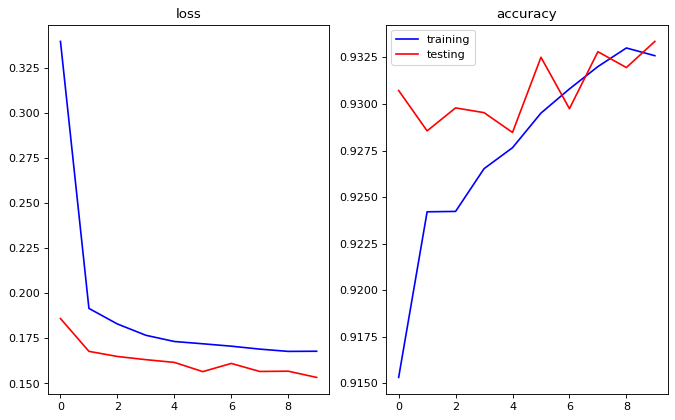

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.66it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


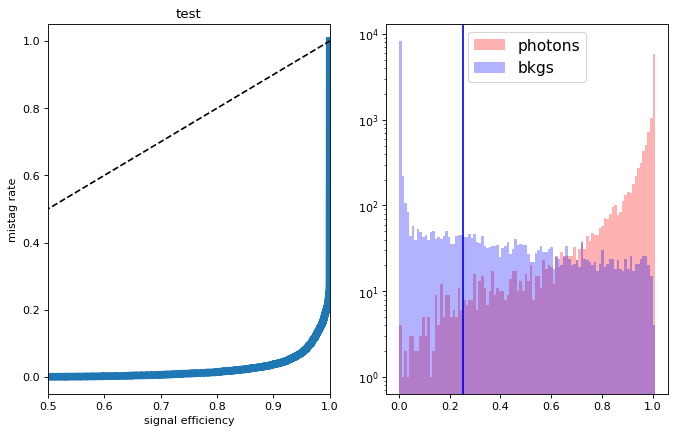

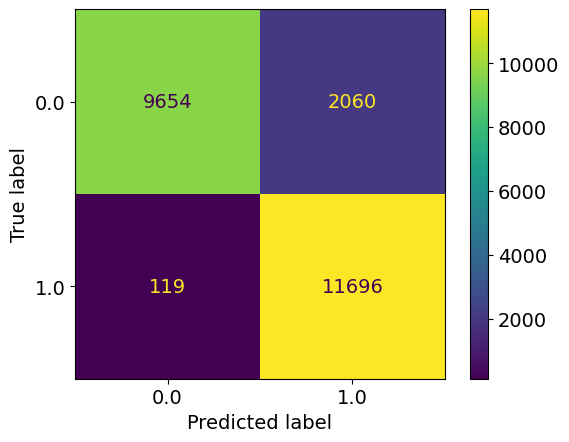

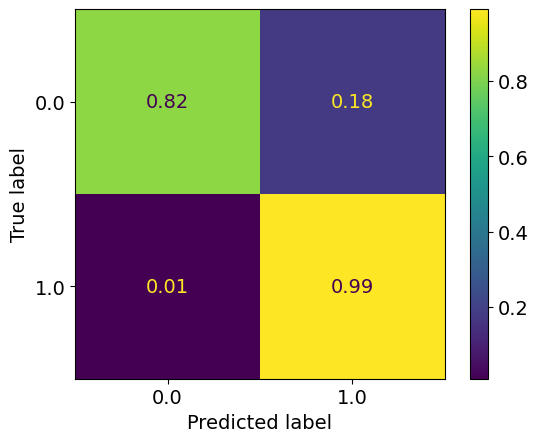

epoch: 10
Learning rate: 9.046260814679201e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


train loss: 0.16648589776959388
train acc: 0.93295366


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.67it/s]


test loss: 0.15932859368622304
test acc: 0.92919374
epoch: 11
Learning rate: 8.853841399927776e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.16551642660882063
train acc: 0.9336762


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.56it/s]


test loss: 0.15843692179769278
test acc: 0.9292788
epoch: 12
Learning rate: 8.646212633823496e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.16449075121029166
train acc: 0.9333149


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.13it/s]


test loss: 0.15802207682281733
test acc: 0.92855626
epoch: 13
Learning rate: 8.424193932249614e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.16it/s]


train loss: 0.1646303083201882
train acc: 0.9342818


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.76it/s]


test loss: 0.1499651238322258
test acc: 0.93484634
new best acc: 0.93484634
epoch: 14
Learning rate: 8.188661501590545e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.16465074137137953
train acc: 0.9338462


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.46it/s]


test loss: 0.1545026194304228
test acc: 0.9326788
epoch: 15
Learning rate: 7.940544880745568e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.16366763360750902
train acc: 0.935185


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.16it/s]


test loss: 0.15268222354352473
test acc: 0.93467635
epoch: 16
Learning rate: 7.68082327266346e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.16233086068728927
train acc: 0.93474936


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.96it/s]


test loss: 0.15664728004485368
test acc: 0.9312763
epoch: 17
Learning rate: 7.410521679875802e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.16494678843552898
train acc: 0.93400556


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.72it/s]


test loss: 0.15275730043649674
test acc: 0.9329763
epoch: 18
Learning rate: 7.130706859280274e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.10it/s]


train loss: 0.16294838008797094
train acc: 0.93524873


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.30it/s]


test loss: 0.14851379729807376
test acc: 0.93561137
new best acc: 0.93561137
epoch: 19
Learning rate: 6.842483112138539e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.16240681878700378
train acc: 0.9347706


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.35it/s]


test loss: 0.15401804335415364
test acc: 0.93352884


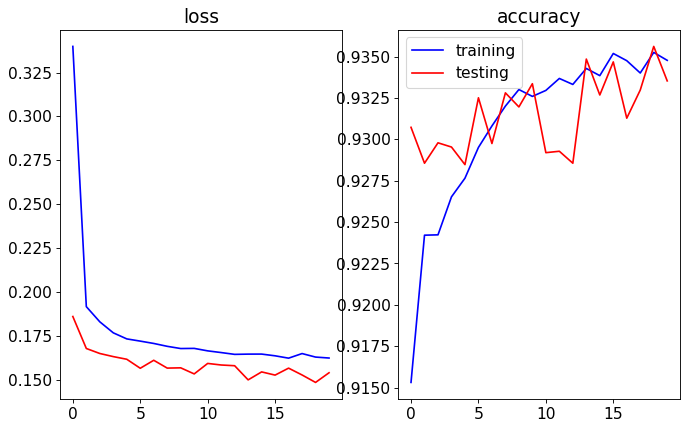

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.89it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


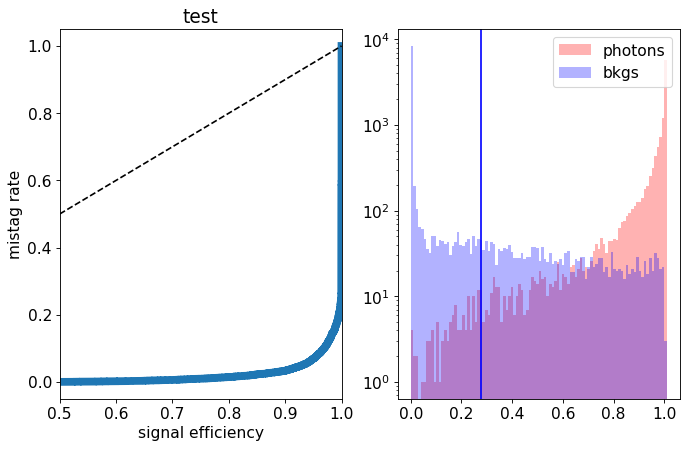

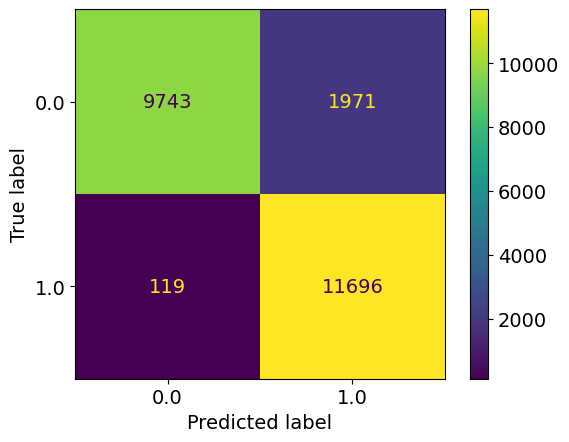

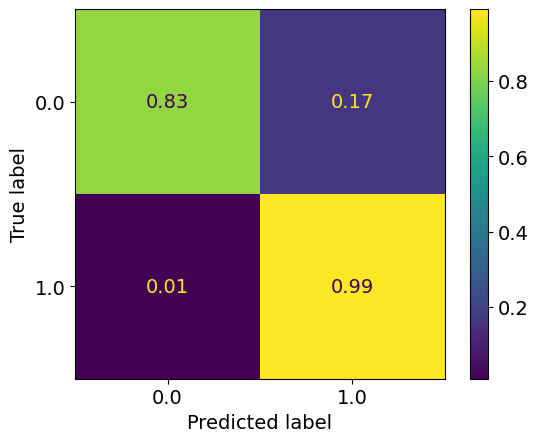

epoch: 20
Learning rate: 6.546987925903657e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.17it/s]


train loss: 0.1621760131826826
train acc: 0.93598187


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.75it/s]


test loss: 0.1611830286681652
test acc: 0.9281737
epoch: 21
Learning rate: 6.245387485076789e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.16264958665439277
train acc: 0.9355037


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.13it/s]


test loss: 0.1507864061743021
test acc: 0.93476135
epoch: 22
Learning rate: 5.938872068809746e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1614268503276406
train acc: 0.93527


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.71it/s]


test loss: 0.15137717574834825
test acc: 0.9340388
epoch: 23
Learning rate: 5.628651353416957e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.16163262330992206
train acc: 0.93609875


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.13it/s]


test loss: 0.15010890159755946
test acc: 0.9351864
epoch: 24
Learning rate: 5.315949638335715e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.16117772977253433
train acc: 0.9355888


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.14624794255942106
test acc: 0.9371414
new best acc: 0.9371414
epoch: 25
Learning rate: 5.002001014375625e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.13it/s]


train loss: 0.16122075545180375
train acc: 0.9355781


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.87it/s]


test loss: 0.14906130637973547
test acc: 0.9353989
epoch: 26
Learning rate: 4.688044493325969e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.16011408066293994
train acc: 0.93602437


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.48it/s]


test loss: 0.15421430058777333
test acc: 0.93433636
epoch: 27
Learning rate: 4.37531911814224e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.16003089279505858
train acc: 0.9367044


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.57it/s]


test loss: 0.15043733604252338
test acc: 0.93582386
epoch: 28
Learning rate: 4.065059073009655e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.19it/s]


train loss: 0.16051261957473817
train acc: 0.9362688


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.37it/s]


test loss: 0.15192913729697466
test acc: 0.93454885
epoch: 29
Learning rate: 3.758488812582022e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.16125142009584767
train acc: 0.9357269


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.32it/s]


test loss: 0.1508237175643444
test acc: 0.9352714


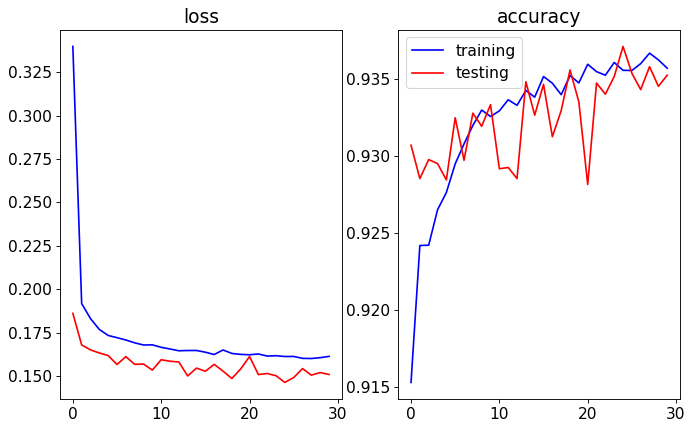

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.87it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


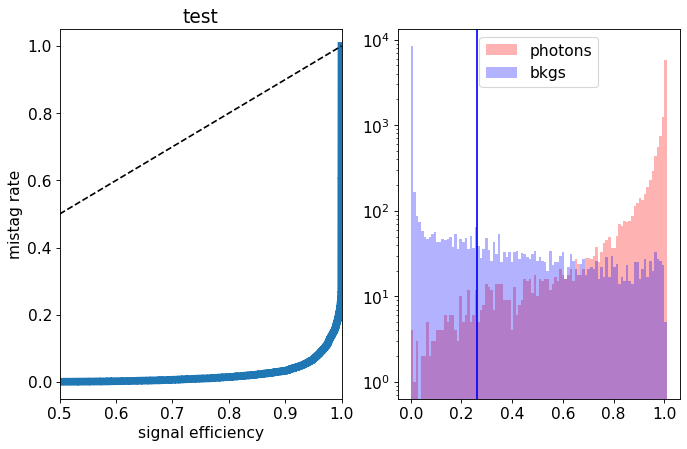

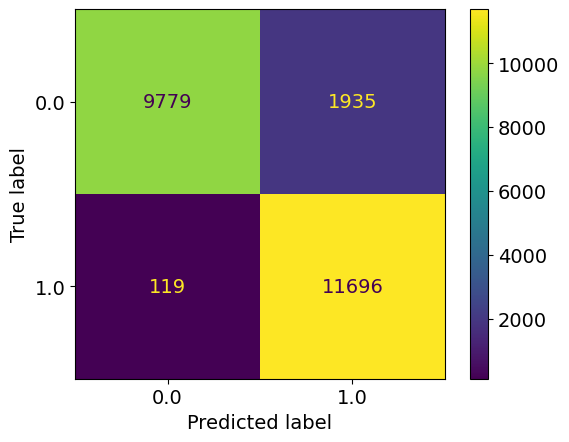

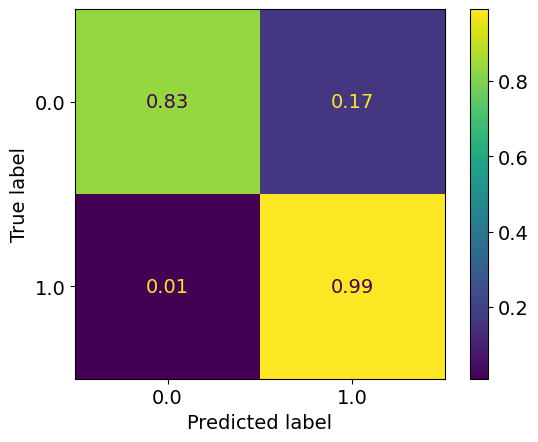

epoch: 30
Learning rate: 3.4568182296186195e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.18it/s]


train loss: 0.1613123191959539
train acc: 0.9355569


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.59it/s]


test loss: 0.14969185888767242
test acc: 0.9361639
epoch: 31
Learning rate: 3.161237880090222e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.16008073988423985
train acc: 0.93698066


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.80it/s]


test loss: 0.15035668313503264
test acc: 0.9338688
epoch: 32
Learning rate: 2.8729142845986012e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.16it/s]


train loss: 0.16014466026596202
train acc: 0.9361519


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.98it/s]


test loss: 0.1558030791580677
test acc: 0.9321263
epoch: 33
Learning rate: 2.5929853246526448e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.15946815238826595
train acc: 0.9367363


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.66it/s]


test loss: 0.15144447777420283
test acc: 0.93561137
epoch: 34
Learning rate: 2.32255575196988e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.15990338185030945
train acc: 0.93580127


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.59it/s]


test loss: 0.15000837966799735
test acc: 0.93565387
epoch: 35
Learning rate: 2.062692828526166e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.16it/s]


train loss: 0.16030056062777331
train acc: 0.935865


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.54it/s]


test loss: 0.14792617298662664
test acc: 0.9364189
epoch: 36
Learning rate: 1.814422114560259e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.54it/s]


train loss: 0.1586582638370763
train acc: 0.93687445


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.85it/s]


test loss: 0.14722488820552826
test acc: 0.9366314
epoch: 37
Learning rate: 1.578723421156084e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.46it/s]


train loss: 0.1591315762062741
train acc: 0.93671507


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.64it/s]


test loss: 0.14995645489543677
test acc: 0.9360364
epoch: 38
Learning rate: 1.3565269433760137e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.1590567443306279
train acc: 0.9364494


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.08it/s]


test loss: 0.14798548277467488
test acc: 0.9362914
epoch: 39
Learning rate: 1.1487095892059325e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.1591003135700894
train acc: 0.93591815


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.76it/s]


test loss: 0.14870327189564705
test acc: 0.9362489


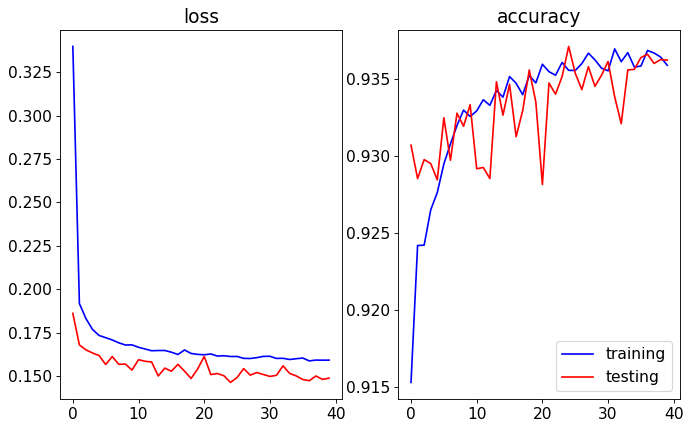

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.37it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


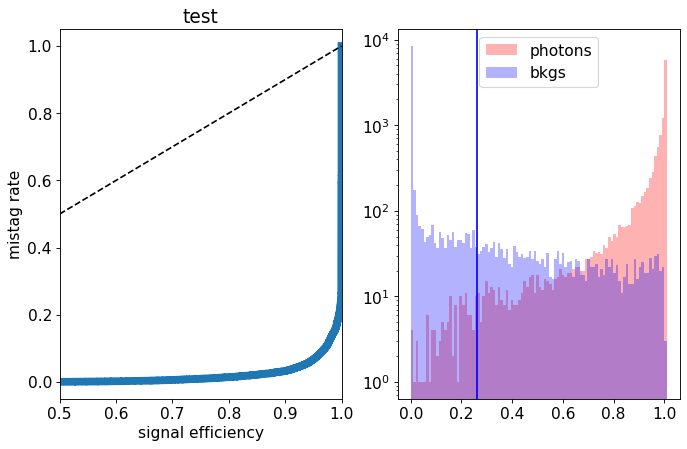

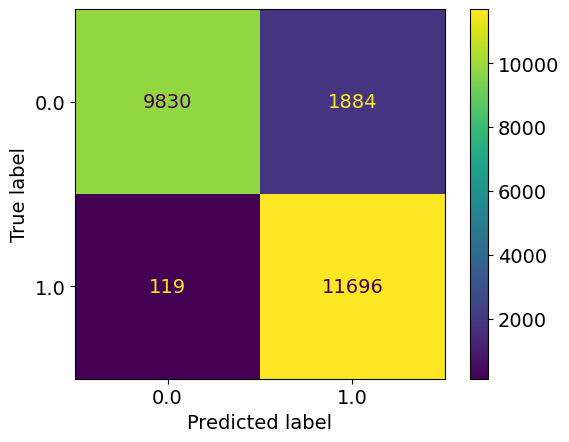

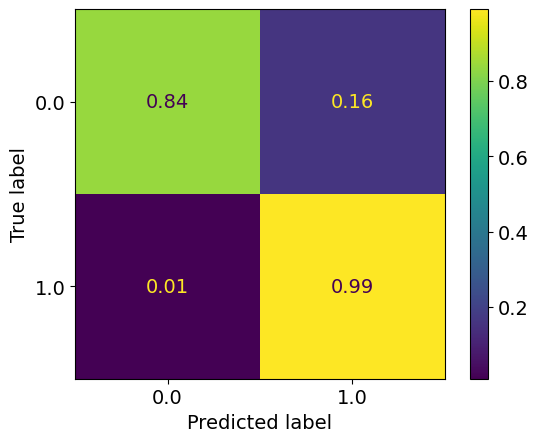

epoch: 40
Learning rate: 9.56091518800032e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.16004827912825687
train acc: 0.93613064


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.48it/s]


test loss: 0.1512542786076665
test acc: 0.9360789
epoch: 41
Learning rate: 7.794329076833778e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.15943387981243196
train acc: 0.9363113


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.39it/s]


test loss: 0.14862327054142951
test acc: 0.9365039
epoch: 42
Learning rate: 6.194309466864068e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


train loss: 0.16011576738896643
train acc: 0.936205


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.91it/s]


test loss: 0.1467985151335597
test acc: 0.9365889
epoch: 43
Learning rate: 4.767170904512303e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.16016052634852707
train acc: 0.9364069


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.97it/s]


test loss: 0.14773635510355235
test acc: 0.93586636
epoch: 44
Learning rate: 3.518545653686467e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.15940225689084667
train acc: 0.9367682


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.65it/s]


test loss: 0.14865085147321225
test acc: 0.9360789
epoch: 45
Learning rate: 2.4533614678089954e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.46it/s]


train loss: 0.1592726753965305
train acc: 0.9366619


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.75it/s]


test loss: 0.14867676049470901
test acc: 0.93599385
epoch: 46
Learning rate: 1.5758221422251529e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.15945695706044033
train acc: 0.9362688


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.44it/s]


test loss: 0.15000135377049445
test acc: 0.93590885
epoch: 47
Learning rate: 8.893909237434605e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


train loss: 0.1585482287748604
train acc: 0.93729943


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.32it/s]


test loss: 0.14816030580550432
test acc: 0.93586636
epoch: 48
Learning rate: 3.9677684278265904e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.15925785566970801
train acc: 0.9365238


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.12it/s]


test loss: 0.1501787479966879
test acc: 0.93590885
epoch: 49
Learning rate: 9.992402206632778e-08


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.1591588906991254
train acc: 0.93709755


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.90it/s]


test loss: 0.14801258482038976
test acc: 0.93590885


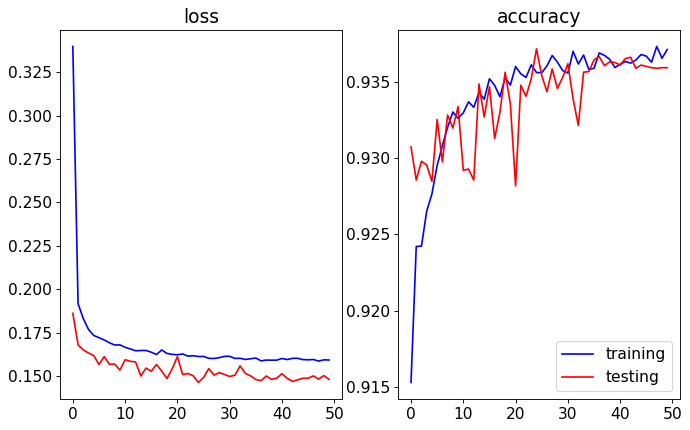

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.25it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


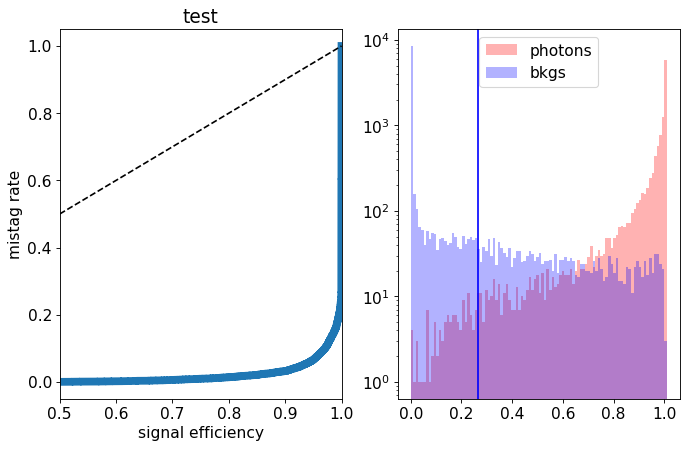

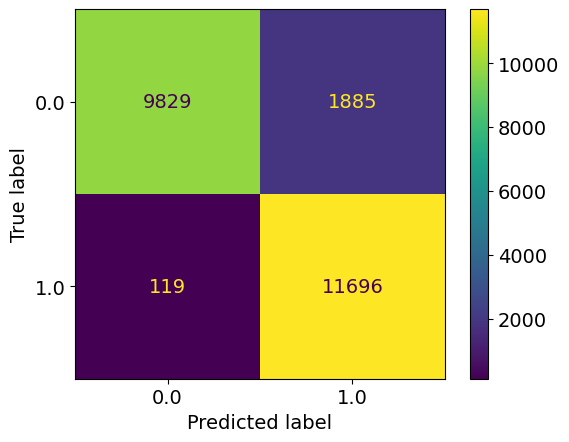

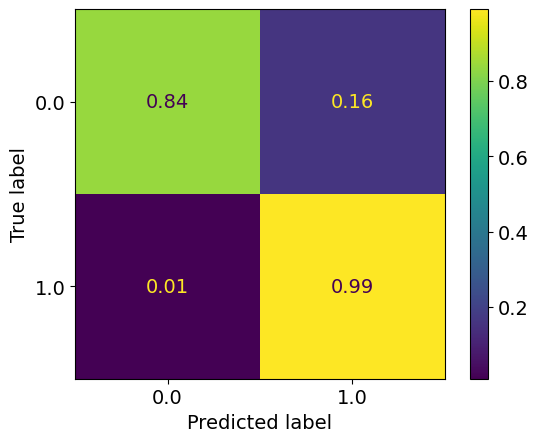

epoch: 50
Learning rate: 4.004058690165735e-12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1606612222589505
train acc: 0.9357694


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.51it/s]


test loss: 0.14624099265784024
test acc: 0.9363764
epoch: 51
Learning rate: 9.99025888725783e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.1607121352557164
train acc: 0.9361519


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.21it/s]


test loss: 0.15084094535559417
test acc: 0.93467635
epoch: 52
Learning rate: 9.960823902925947e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.11it/s]


train loss: 0.15860817723782958
train acc: 0.93691695


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.45it/s]


test loss: 0.14517875388264656
test acc: 0.9387989
new best acc: 0.9387989
epoch: 53
Learning rate: 9.911810813034072e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1584493842948774
train acc: 0.93709755


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.42it/s]


test loss: 0.1478775879368186
test acc: 0.9374389
epoch: 54
Learning rate: 9.843413049856063e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.09it/s]


train loss: 0.15752269137816824
train acc: 0.9371188


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.42it/s]


test loss: 0.1503763049840927
test acc: 0.9355264
epoch: 55
Learning rate: 9.755900548115213e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.15918576295018955
train acc: 0.9371507


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.73it/s]


test loss: 0.14345376547425986
test acc: 0.93947893
new best acc: 0.93947893
epoch: 56
Learning rate: 9.649618679675237e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.15773154595854935
train acc: 0.9365982


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.62it/s]


test loss: 0.14498231168836356
test acc: 0.93913895
epoch: 57
Learning rate: 9.5249868905153e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.09it/s]


train loss: 0.1591140804871632
train acc: 0.9368532


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.35it/s]


test loss: 0.15155350398272277
test acc: 0.93493134
epoch: 58
Learning rate: 9.382497045368368e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.1589282452585591
train acc: 0.93683195


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.60it/s]


test loss: 0.14599963705986738
test acc: 0.9387989
epoch: 59
Learning rate: 9.222711486555816e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.14it/s]


train loss: 0.1569470813509765
train acc: 0.9372463


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.32it/s]


test loss: 0.15117609016597272
test acc: 0.93327385


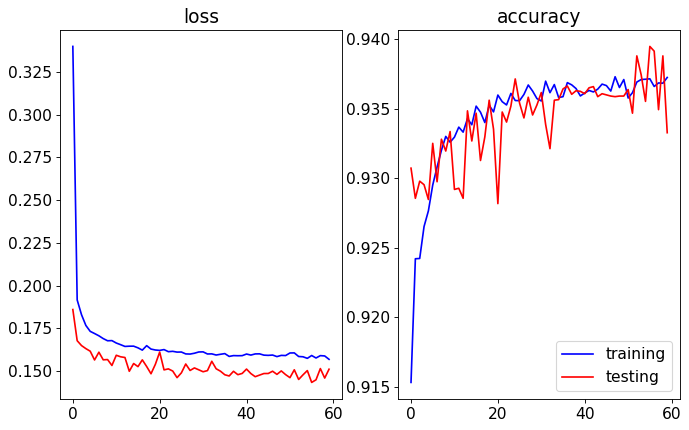

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.78it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


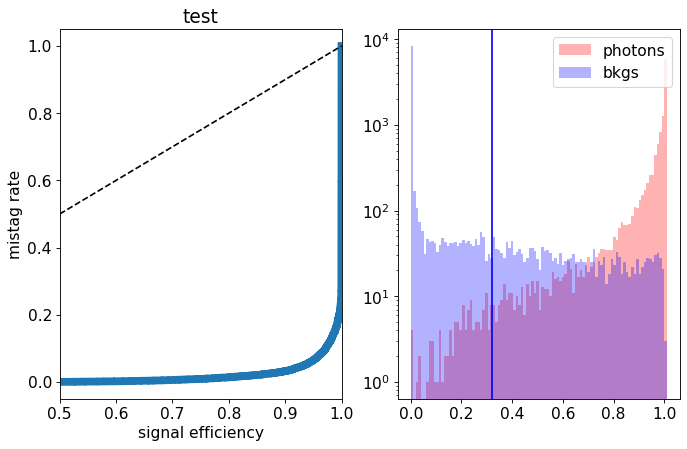

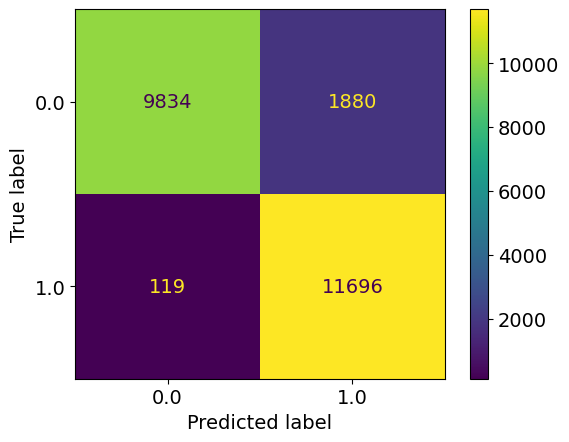

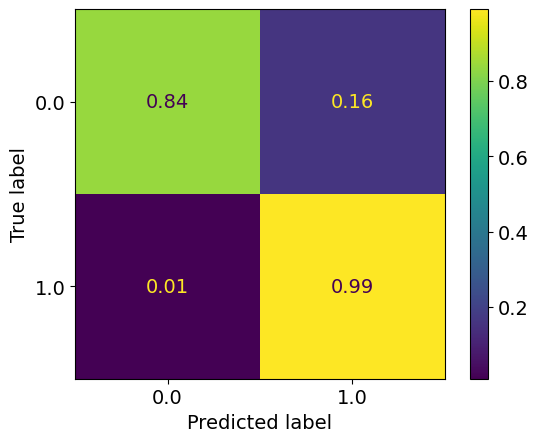

epoch: 60
Learning rate: 9.046260814679201e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.15867509213602468
train acc: 0.93706566


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.57it/s]


test loss: 0.1493314042687416
test acc: 0.93446386
epoch: 61
Learning rate: 8.853841399927776e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.15811899218969283
train acc: 0.93705505


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.12it/s]


test loss: 0.14390729796141385
test acc: 0.93939394
epoch: 62
Learning rate: 8.646212633823496e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.15828929585256393
train acc: 0.9374482


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.84it/s]


test loss: 0.1464654292911291
test acc: 0.9378214
epoch: 63
Learning rate: 8.424193932249614e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.15729475942007295
train acc: 0.93717194


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.54it/s]


test loss: 0.15115282032638788
test acc: 0.93348634
epoch: 64
Learning rate: 8.188661501590544e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


train loss: 0.15789272047721656
train acc: 0.9366619


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.66it/s]


test loss: 0.14885621517896652
test acc: 0.9361639
epoch: 65
Learning rate: 7.940544880745568e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.15570753153152528
train acc: 0.93789446


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.79it/s]


test loss: 0.14864551108330487
test acc: 0.9362064
epoch: 66
Learning rate: 7.68082327266346e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.15774939698018844
train acc: 0.9376288


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.45it/s]


test loss: 0.14537364412099124
test acc: 0.93794894
epoch: 67
Learning rate: 7.4105216798758e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.1569914599987352
train acc: 0.9371932


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.18it/s]


test loss: 0.15108619779348373
test acc: 0.93471885
epoch: 68
Learning rate: 7.130706859280273e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1569811268027421
train acc: 0.9373419


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.34it/s]


test loss: 0.1441758967936039
test acc: 0.9372689
epoch: 69
Learning rate: 6.842483112138537e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.16it/s]


train loss: 0.1578831996792441
train acc: 0.93700194


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.71it/s]


test loss: 0.1461221393197775
test acc: 0.9378639


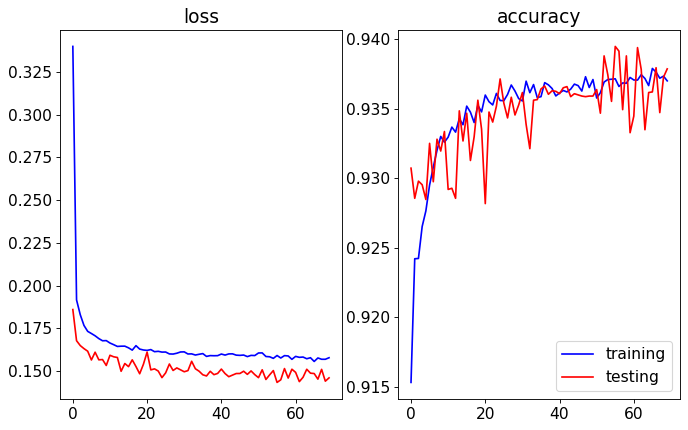

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.85it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


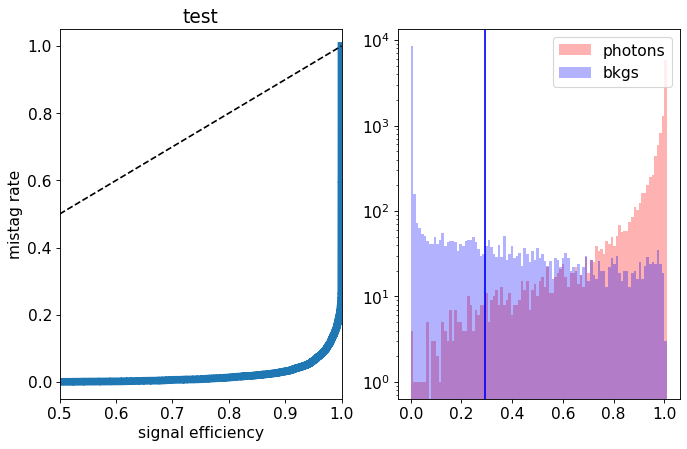

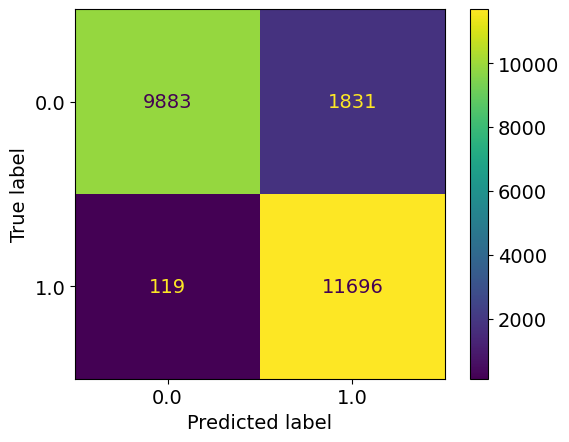

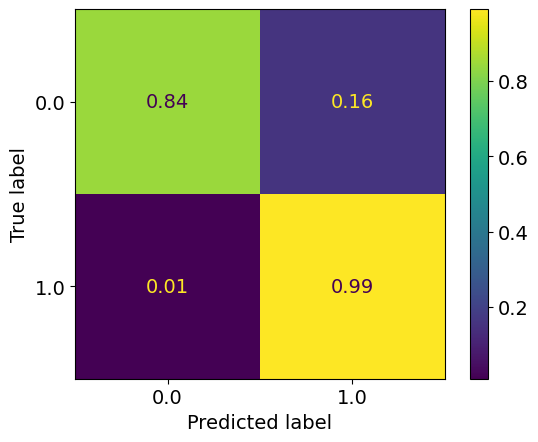

epoch: 70
Learning rate: 6.546987925903656e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.15604210630723625
train acc: 0.9377245


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.76it/s]


test loss: 0.14842333309352398
test acc: 0.9354839
epoch: 71
Learning rate: 6.245387485076789e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.08it/s]


train loss: 0.15721346490132582
train acc: 0.9374057


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.30it/s]


test loss: 0.14783215019851922
test acc: 0.9368014
epoch: 72
Learning rate: 5.9388720688097444e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.15472725484591382
train acc: 0.9378307


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.77it/s]


test loss: 0.14276246819645166
test acc: 0.939904
new best acc: 0.939904
epoch: 73
Learning rate: 5.628651353416956e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.15513624189196118
train acc: 0.9382345


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.86it/s]


test loss: 0.1493769060820341
test acc: 0.9364614
epoch: 74
Learning rate: 5.3159496383357145e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


train loss: 0.15601590759814923
train acc: 0.9375013


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.22it/s]


test loss: 0.14422068931162357
test acc: 0.9385014
epoch: 75
Learning rate: 5.002001014375625e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.15549973607253118
train acc: 0.9374907


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.37it/s]


test loss: 0.14645725339651108
test acc: 0.9374814
epoch: 76
Learning rate: 4.6880444933259674e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.14it/s]


train loss: 0.15474605565048327
train acc: 0.9385851


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.87it/s]


test loss: 0.14464105982333422
test acc: 0.93913895
epoch: 77
Learning rate: 4.3753191181422384e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.15669296966616514
train acc: 0.9366832


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.63it/s]


test loss: 0.14734873697161674
test acc: 0.9374814
epoch: 78
Learning rate: 4.0650590730096545e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.15548747398291424
train acc: 0.9376607


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.07it/s]


test loss: 0.1447424279525876
test acc: 0.9388414
epoch: 79
Learning rate: 3.758488812582022e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  4.96it/s]


train loss: 0.1564244271558561
train acc: 0.93787324


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.57it/s]


test loss: 0.14653186928480863
test acc: 0.93692887


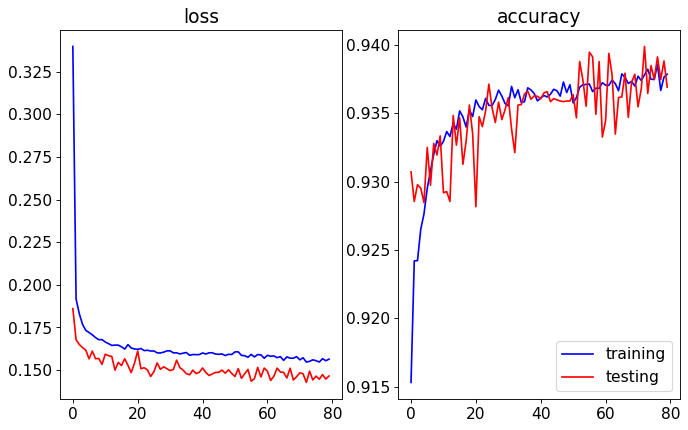

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.19it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


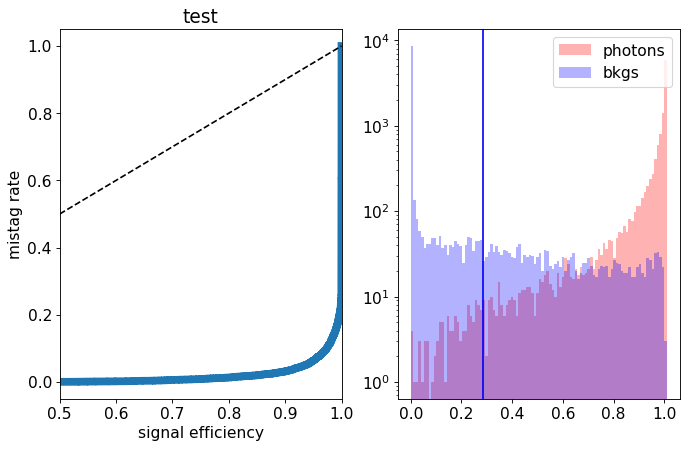

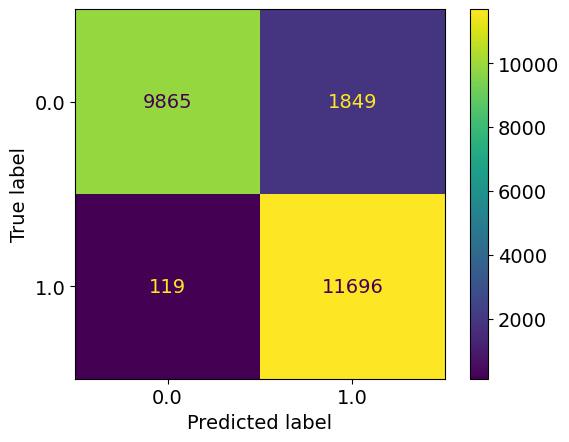

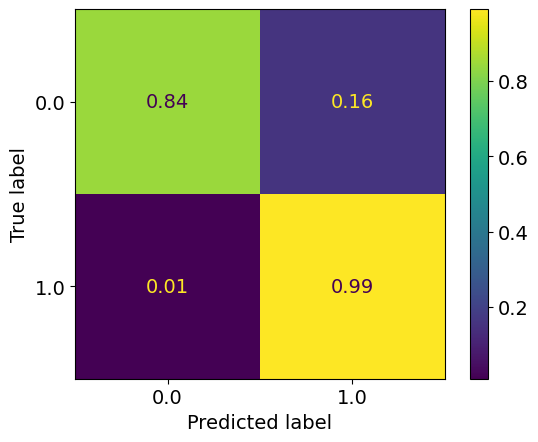

epoch: 80
Learning rate: 3.456818229618618e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.15599134645074797
train acc: 0.93710816


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.84it/s]


test loss: 0.14762671254575252
test acc: 0.9372264
epoch: 81
Learning rate: 3.16123788009022e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.00it/s]


train loss: 0.156577450264791
train acc: 0.9383832


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.64it/s]


test loss: 0.1461725952103734
test acc: 0.9385864
epoch: 82
Learning rate: 2.8729142845986012e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.15565168753171424
train acc: 0.9376926


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.95it/s]


test loss: 0.14477213956415652
test acc: 0.9378214
epoch: 83
Learning rate: 2.5929853246526448e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.15502647675906017
train acc: 0.9373951


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.29it/s]


test loss: 0.14484342448413373
test acc: 0.93896896
epoch: 84
Learning rate: 2.32255575196988e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.15555188130990716
train acc: 0.93703383


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.02it/s]


test loss: 0.146958595700562
test acc: 0.9372689
epoch: 85
Learning rate: 2.062692828526166e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1562222196323097
train acc: 0.9379051


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.79it/s]


test loss: 0.14418913908302783
test acc: 0.9383314
epoch: 86
Learning rate: 1.814422114560259e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.22it/s]


train loss: 0.1546473305221576
train acc: 0.93796885


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.60it/s]


test loss: 0.14670968800783157
test acc: 0.9371839
epoch: 87
Learning rate: 1.578723421156084e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.15590264059745582
train acc: 0.9385001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.06it/s]


test loss: 0.14450658857822418
test acc: 0.93794894
epoch: 88
Learning rate: 1.3565269433760137e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.15666778015482957
train acc: 0.93799007


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.50it/s]


test loss: 0.14648152608424425
test acc: 0.93692887
epoch: 89
Learning rate: 1.1487095892059325e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.15576676905724654
train acc: 0.9373844


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.65it/s]


test loss: 0.14830854181200265
test acc: 0.9367589


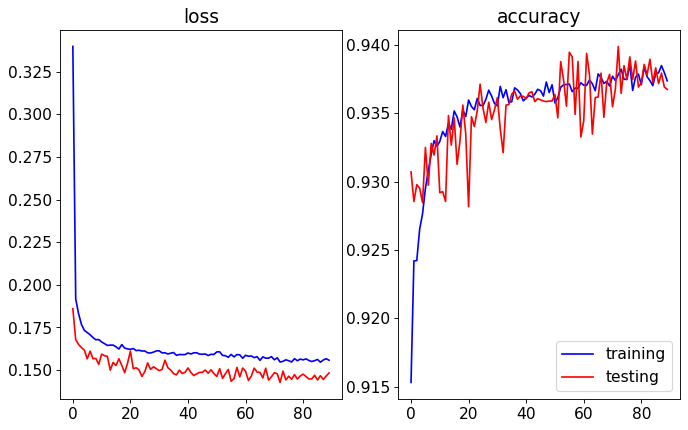

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.53it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


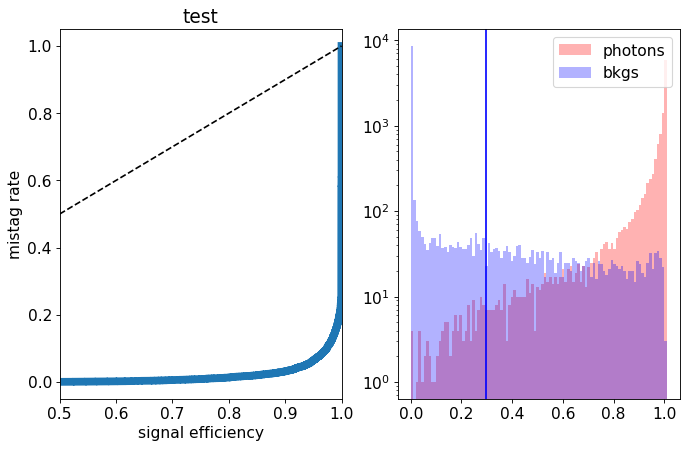

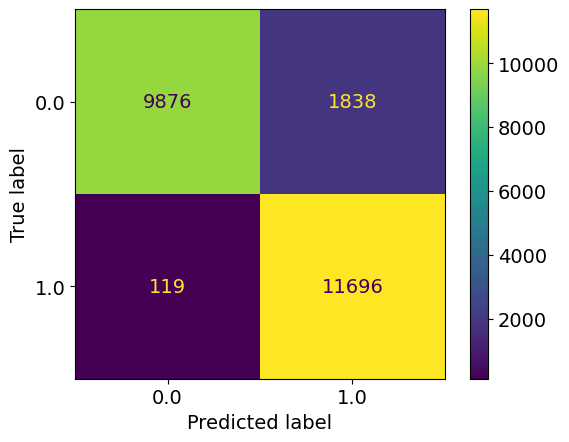

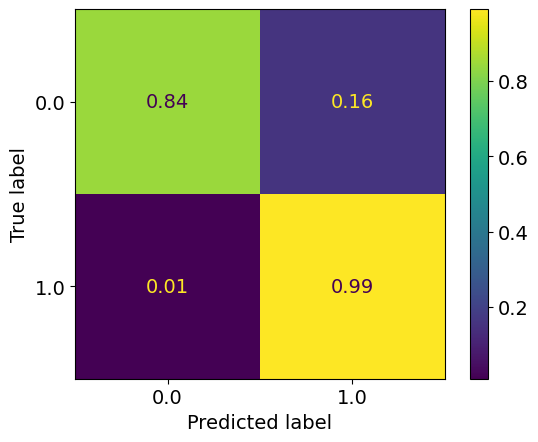

epoch: 90
Learning rate: 9.56091518800032e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.54it/s]


train loss: 0.15511673209583685
train acc: 0.93784136


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.24it/s]


test loss: 0.14817856922745704
test acc: 0.9377364
epoch: 91
Learning rate: 7.794329076833778e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.14it/s]


train loss: 0.1551488656432006
train acc: 0.9382451


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.54it/s]


test loss: 0.1486325966194272
test acc: 0.93688637
epoch: 92
Learning rate: 6.194309466864068e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1555831988525998
train acc: 0.93721443


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.18it/s]


test loss: 0.14648224879056215
test acc: 0.9376089
epoch: 93
Learning rate: 4.767170904512303e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.09it/s]


train loss: 0.1546830398736486
train acc: 0.93799007


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.60it/s]


test loss: 0.14598987828940152
test acc: 0.9373539
epoch: 94
Learning rate: 3.518545653686467e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.15536632948810128
train acc: 0.93805385


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.71it/s]


test loss: 0.14757077135145663
test acc: 0.9373114
epoch: 95
Learning rate: 2.4533614678089954e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.15467713488515017
train acc: 0.93799007


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.06it/s]


test loss: 0.1474201986566186
test acc: 0.9374814
epoch: 96
Learning rate: 1.5758221422251529e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.18it/s]


train loss: 0.15494383264119457
train acc: 0.9383407


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.96it/s]


test loss: 0.14785247314721345
test acc: 0.9373964
epoch: 97
Learning rate: 8.893909237434605e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.46it/s]


train loss: 0.15446044011100843
train acc: 0.9386489


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.18it/s]


test loss: 0.14656467474997042
test acc: 0.9374389
epoch: 98
Learning rate: 3.9677684278265904e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.03it/s]


train loss: 0.15518246277882036
train acc: 0.93868077


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.64it/s]


test loss: 0.1476193642243743
test acc: 0.9372689
epoch: 99
Learning rate: 9.992402206632778e-08


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.15466632860101712
train acc: 0.93817073


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.71it/s]


test loss: 0.14639253504574298
test acc: 0.9373114


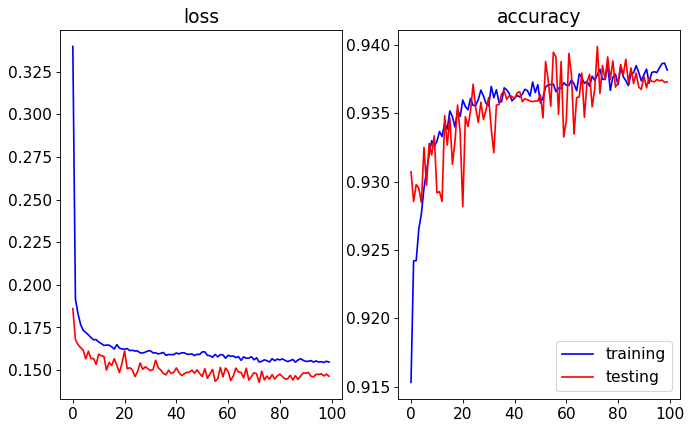

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.42it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


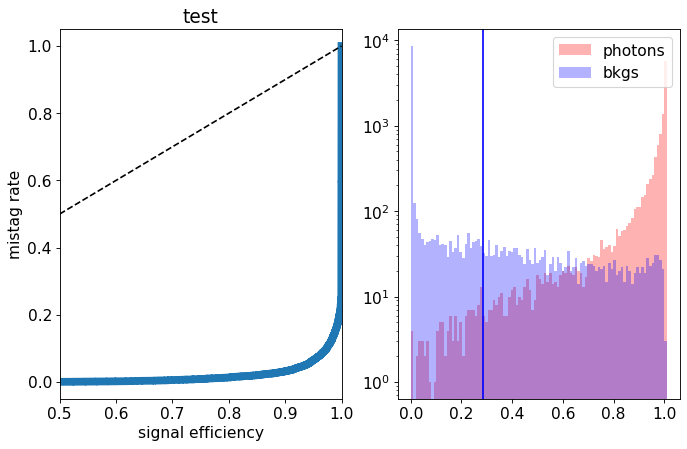

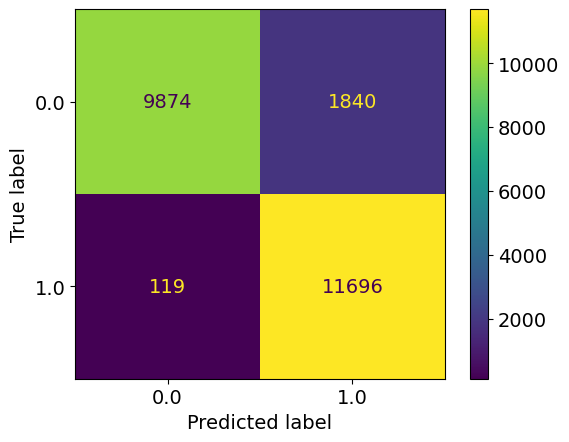

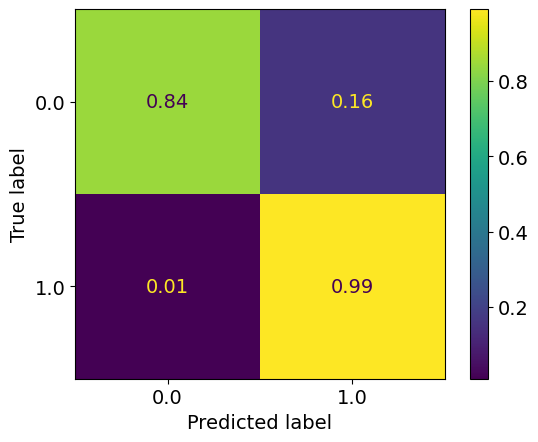

epoch: 100
Learning rate: 4.004058690165735e-12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.15459550290730348
train acc: 0.93796885


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.88it/s]


test loss: 0.15869232825934887
test acc: 0.9312763
epoch: 101
Learning rate: 9.99025888725783e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.15609590870559595
train acc: 0.9377245


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.64it/s]


test loss: 0.1510409815236926
test acc: 0.9361214
epoch: 102
Learning rate: 9.960823902925947e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.15651327276685437
train acc: 0.9374482


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.36it/s]


test loss: 0.149944725073874
test acc: 0.9351439
epoch: 103
Learning rate: 9.911810813034072e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


train loss: 0.1562305490492256
train acc: 0.9377245


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.75it/s]


test loss: 0.1530806491151452
test acc: 0.9320838
epoch: 104
Learning rate: 9.843413049856063e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.15571173095399407
train acc: 0.9374907


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.87it/s]


test loss: 0.15329292360693217
test acc: 0.9329763
epoch: 105
Learning rate: 9.755900548115213e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.15505732202036365
train acc: 0.93806446


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.76it/s]


test loss: 0.1520289484411478
test acc: 0.93488884
epoch: 106
Learning rate: 9.649618679675237e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.15445117263277625
train acc: 0.9382982


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.59it/s]


test loss: 0.14013160075992345
test acc: 0.94045645
new best acc: 0.94045645
epoch: 107
Learning rate: 9.5249868905153e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1549508354751168
train acc: 0.9376926


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.41it/s]


test loss: 0.1436115175485611
test acc: 0.9388414
epoch: 108
Learning rate: 9.382497045368368e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.10it/s]


train loss: 0.15476506962707848
train acc: 0.9373313


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.76it/s]


test loss: 0.1439683336764574
test acc: 0.9385864
epoch: 109
Learning rate: 9.222711486555816e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.15394116634396232
train acc: 0.93826634


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.73it/s]


test loss: 0.1438991131260991
test acc: 0.9385439


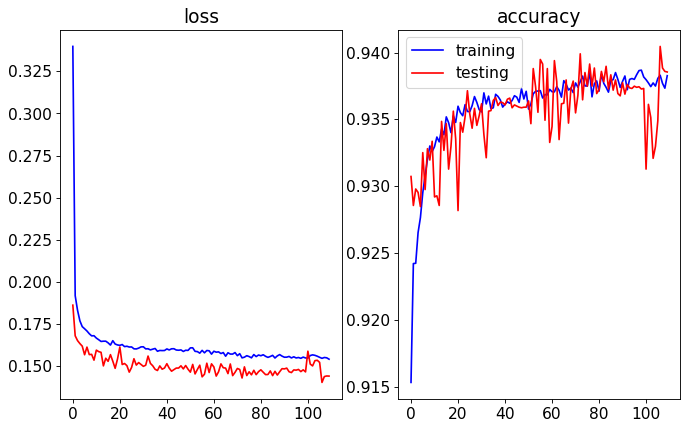

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.70it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


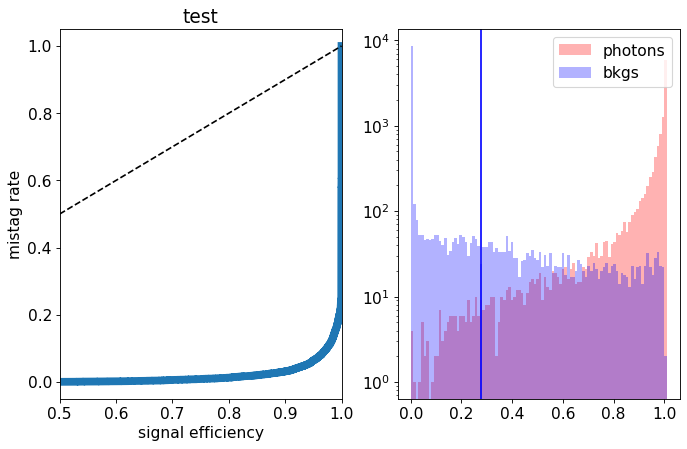

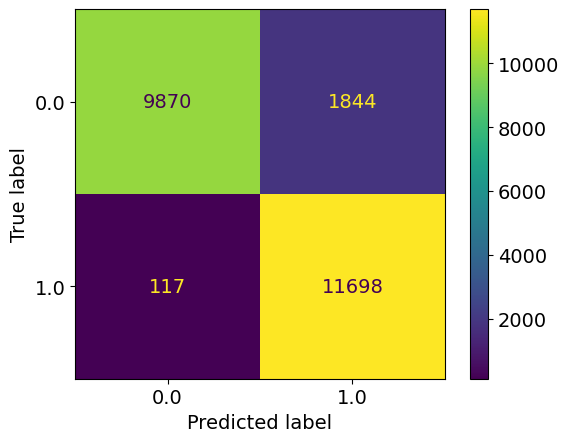

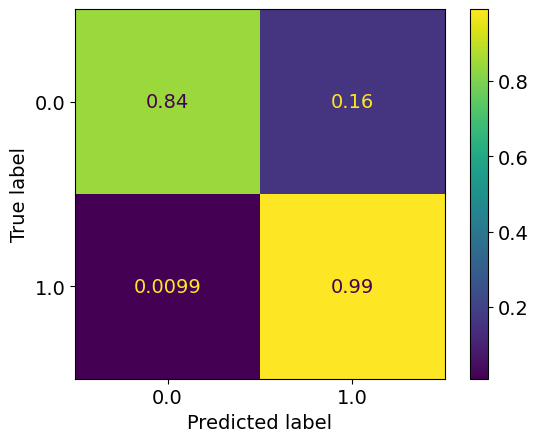

epoch: 110
Learning rate: 9.046260814679201e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.11it/s]


train loss: 0.15439247643681847
train acc: 0.9382345


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.66it/s]


test loss: 0.15570980142802
test acc: 0.93216884
epoch: 111
Learning rate: 8.853841399927776e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.15461719781160355
train acc: 0.9382557


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.85it/s]


test loss: 0.14574645068496467
test acc: 0.9378214
epoch: 112
Learning rate: 8.646212633823496e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.15614833725485833
train acc: 0.93800074


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.86it/s]


test loss: 0.15246186666190625
test acc: 0.9330188
epoch: 113
Learning rate: 8.424193932249614e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.09it/s]


train loss: 0.15540018051293245
train acc: 0.93891454


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.41it/s]


test loss: 0.14520392715930938
test acc: 0.9376089
epoch: 114
Learning rate: 8.188661501590544e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.15561386990319392
train acc: 0.9378626


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.55it/s]


test loss: 0.14975926000624895
test acc: 0.9363339
epoch: 115
Learning rate: 7.940544880745568e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.11it/s]


train loss: 0.15434733132837683
train acc: 0.9385533


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.26it/s]


test loss: 0.14467590134590863
test acc: 0.9379064
epoch: 116
Learning rate: 7.68082327266346e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.15450445624293796
train acc: 0.93776697


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.43it/s]


test loss: 0.14341392256319524
test acc: 0.93956393
epoch: 117
Learning rate: 7.4105216798758e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.15460395599436608
train acc: 0.9384682


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.86it/s]


test loss: 0.1482521891593933
test acc: 0.9382464
epoch: 118
Learning rate: 7.130706859280273e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.15342645688801054
train acc: 0.9385958


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.86it/s]


test loss: 0.1491941137239337
test acc: 0.9365464
epoch: 119
Learning rate: 6.842483112138537e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.15492403298426585
train acc: 0.93819195


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.95it/s]


test loss: 0.15256528686732054
test acc: 0.93420887


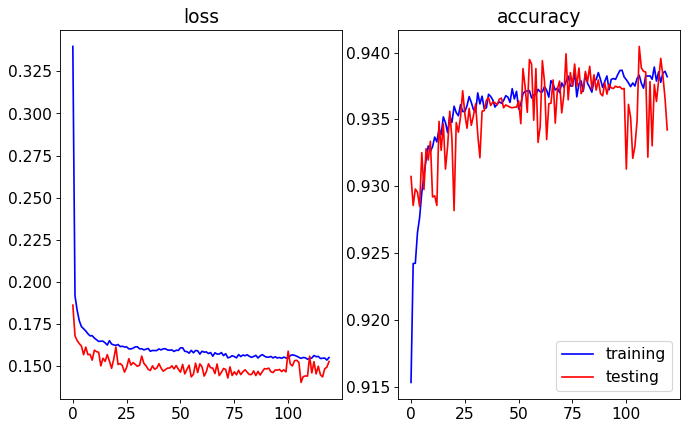

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.25it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


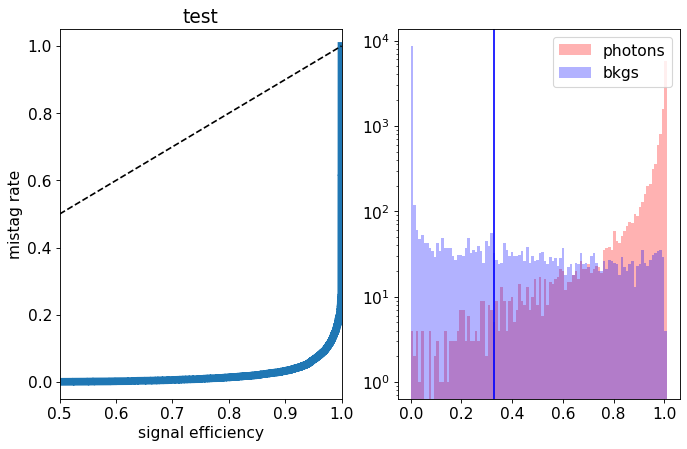

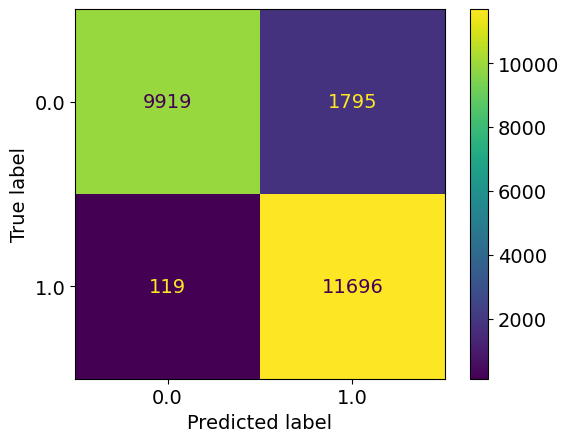

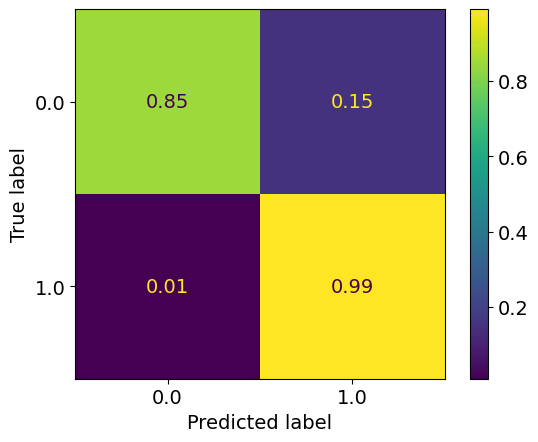

epoch: 120
Learning rate: 6.546987925903656e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.13it/s]


train loss: 0.1540234773686737
train acc: 0.938787


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.78it/s]


test loss: 0.14371516089886427
test acc: 0.93896896
epoch: 121
Learning rate: 6.245387485076789e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.15339180248178494
train acc: 0.9385851


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.95it/s]


test loss: 0.15140586011111737
test acc: 0.9338263
epoch: 122
Learning rate: 5.9388720688097444e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.15296224893847848
train acc: 0.93817073


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.73it/s]


test loss: 0.1433945305645466
test acc: 0.93918145
epoch: 123
Learning rate: 5.628651353416956e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1533533427271114
train acc: 0.93863827


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.76it/s]


test loss: 0.14903261214494706
test acc: 0.93573886
epoch: 124
Learning rate: 5.3159496383357145e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.15377761770016068
train acc: 0.93880826


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.81it/s]


test loss: 0.14530032891780137
test acc: 0.93913895
epoch: 125
Learning rate: 5.002001014375625e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.04it/s]


train loss: 0.15397339333204707
train acc: 0.9385533


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.03it/s]


test loss: 0.14746680296957493
test acc: 0.93794894
epoch: 126
Learning rate: 4.6880444933259674e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.15297594742410503
train acc: 0.93885076


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.85it/s]


test loss: 0.14779665898531674
test acc: 0.93820393
epoch: 127
Learning rate: 4.3753191181422384e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.15373471678252432
train acc: 0.9385214


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.54it/s]


test loss: 0.14559792540967464
test acc: 0.9376939
epoch: 128
Learning rate: 4.0650590730096545e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.15435325771949854
train acc: 0.9375332


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.55it/s]


test loss: 0.1473245568573475
test acc: 0.9373964
epoch: 129
Learning rate: 3.758488812582026e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.15334157356221206
train acc: 0.9387339


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.86it/s]


test loss: 0.14582783821970224
test acc: 0.9377789


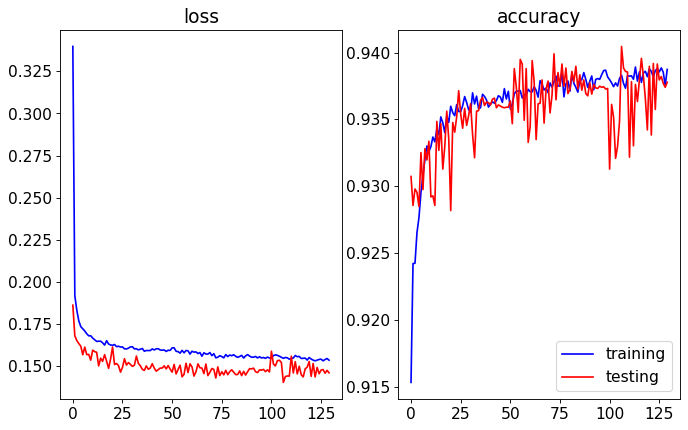

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.99it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


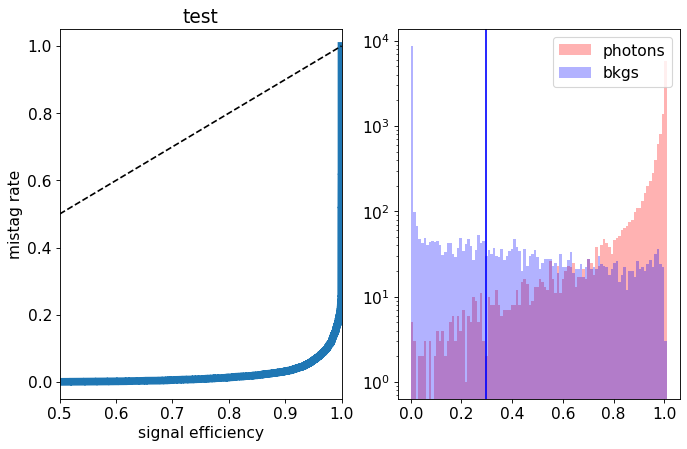

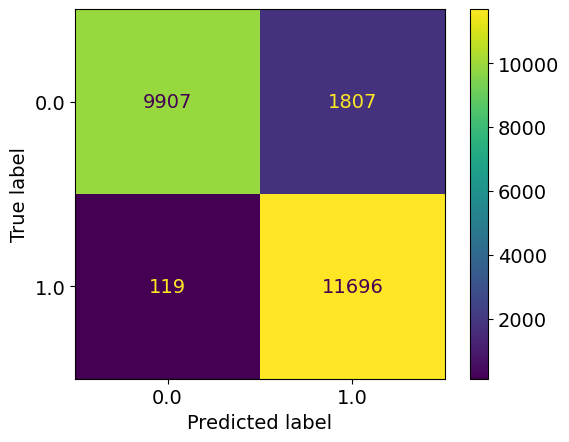

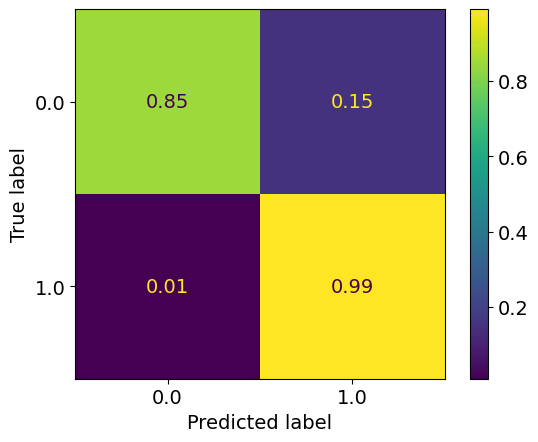

epoch: 130
Learning rate: 3.456818229618622e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.19it/s]


train loss: 0.15427401609671343
train acc: 0.9387126


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.24it/s]


test loss: 0.14777085091918707
test acc: 0.9379064
epoch: 131
Learning rate: 3.161237880090224e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.15447902793337584
train acc: 0.93868077


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.42it/s]


test loss: 0.1458267267793417
test acc: 0.93803394
epoch: 132
Learning rate: 2.8729142845986056e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


train loss: 0.1543362517455581
train acc: 0.9382345


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.75it/s]


test loss: 0.15099449250847102
test acc: 0.93433636
epoch: 133
Learning rate: 2.592985324652648e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.15324960881547564
train acc: 0.93901014


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.39it/s]


test loss: 0.14685511104762555
test acc: 0.9367589
epoch: 134
Learning rate: 2.3225557519698832e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.15326585924359643
train acc: 0.9385851


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.78it/s]


test loss: 0.1455131160095334
test acc: 0.93811893
epoch: 135
Learning rate: 2.06269282852617e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.06it/s]


train loss: 0.15349092728393093
train acc: 0.9387339


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.48it/s]


test loss: 0.14482725579291583
test acc: 0.9384589
epoch: 136
Learning rate: 1.8144221145602645e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1537575119050445
train acc: 0.93822384


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.79it/s]


test loss: 0.14712246134877205
test acc: 0.9372689
epoch: 137
Learning rate: 1.5787234211560875e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.05it/s]


train loss: 0.15319687569407142
train acc: 0.93903136


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.59it/s]


test loss: 0.14441265743225812
test acc: 0.9386714
epoch: 138
Learning rate: 1.3565269433760169e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.15241835256860514
train acc: 0.93907386


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.03it/s]


test loss: 0.14571601953357458
test acc: 0.9383739
epoch: 139
Learning rate: 1.1487095892059352e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.15284409791610803
train acc: 0.9397858


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.77it/s]


test loss: 0.14305427726358175
test acc: 0.9388414


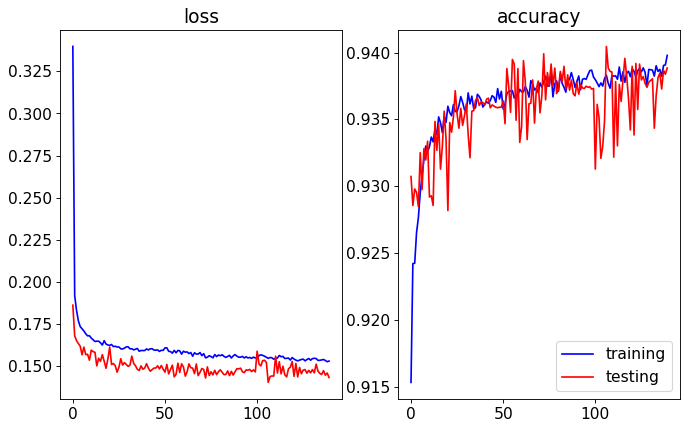

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.79it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


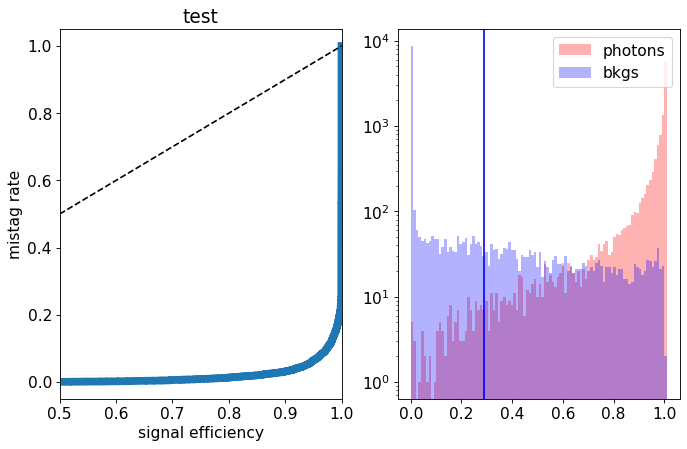

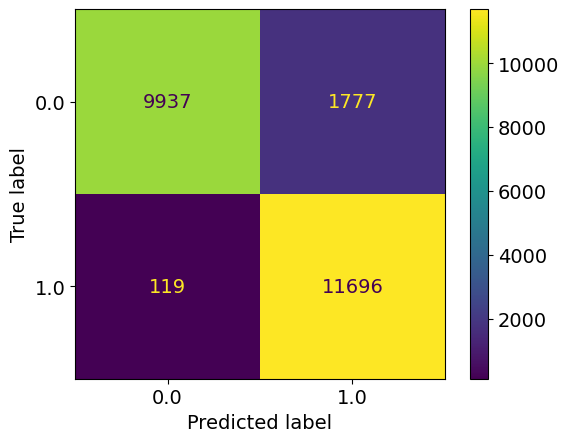

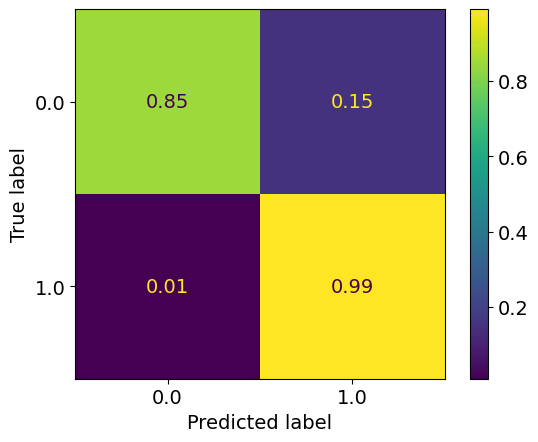

epoch: 140
Learning rate: 9.560915188000358e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.15378227516724047
train acc: 0.9386489


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.91it/s]


test loss: 0.14720699917525054
test acc: 0.9373539
epoch: 141
Learning rate: 7.794329076833812e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.15226553062534637
train acc: 0.9385639


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.66it/s]


test loss: 0.14513361286371945
test acc: 0.9378639
epoch: 142
Learning rate: 6.194309466864101e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.16it/s]


train loss: 0.15345647209768842
train acc: 0.9385958


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.35it/s]


test loss: 0.14769355207681656
test acc: 0.93799144
epoch: 143
Learning rate: 4.767170904512308e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.15237585573819032
train acc: 0.93930763


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.59it/s]


test loss: 0.14626344051212073
test acc: 0.93803394
epoch: 144
Learning rate: 3.518545653686489e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.15303073942091813
train acc: 0.9383832


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.01it/s]


test loss: 0.14577947575598954
test acc: 0.9385014
epoch: 145
Learning rate: 2.453361467809001e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.1526516936482138
train acc: 0.9392014


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.16it/s]


test loss: 0.14775208104401827
test acc: 0.93816143
epoch: 146
Learning rate: 1.5758221422251696e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.15262087434530258
train acc: 0.93885076


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.37it/s]


test loss: 0.14638561699539424
test acc: 0.93811893
epoch: 147
Learning rate: 8.893909237434716e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.15307817294908937
train acc: 0.9387339


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.43it/s]


test loss: 0.14503709003329276
test acc: 0.9378214
epoch: 148
Learning rate: 3.967768427826646e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.15376453272476318
train acc: 0.9383407


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.46it/s]


test loss: 0.14763671420514585
test acc: 0.93807644
epoch: 149
Learning rate: 9.992402206633334e-08


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.153222532361556
train acc: 0.93895704


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.17it/s]


test loss: 0.14555594902485608
test acc: 0.93811893


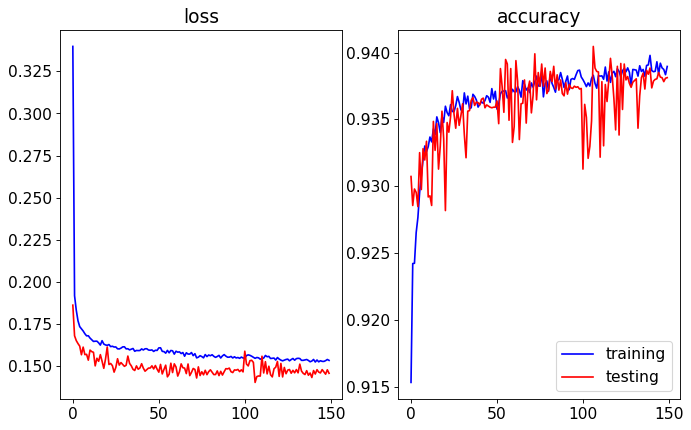

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.12it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


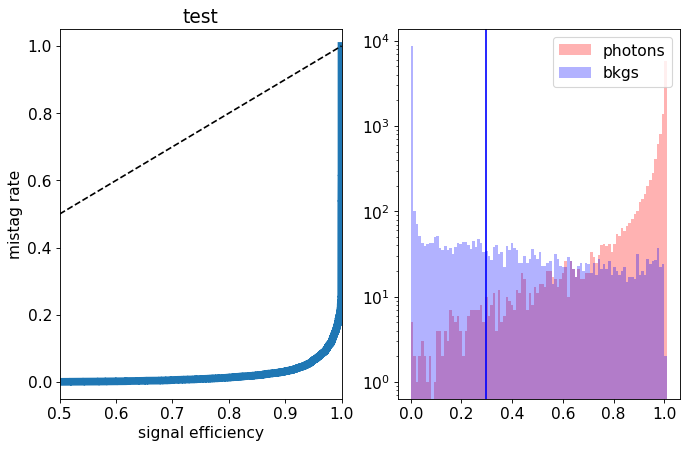

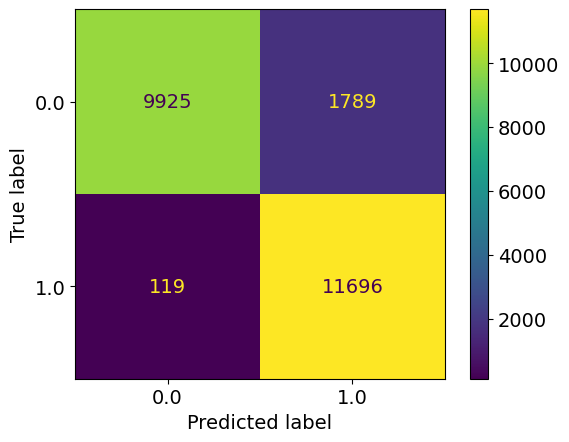

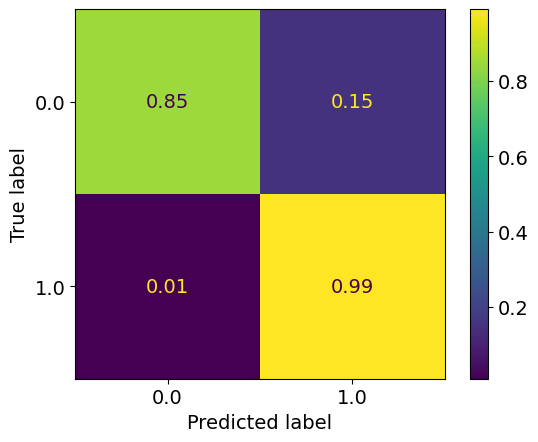

epoch: 150
Learning rate: 4.004058690165735e-12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.15365919048429294
train acc: 0.9385107


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.96it/s]


test loss: 0.14582193717360498
test acc: 0.9385439
epoch: 151
Learning rate: 9.990258887257831e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.55it/s]


train loss: 0.15242840620173012
train acc: 0.93886137


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.48it/s]


test loss: 0.14598005954176188
test acc: 0.9373539
epoch: 152
Learning rate: 9.960823902925947e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.16it/s]


train loss: 0.15379824674433204
train acc: 0.9381601


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.18it/s]


test loss: 0.14682303331792354
test acc: 0.9362064
epoch: 153
Learning rate: 9.911810813034074e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.15336028353613654
train acc: 0.938787


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.27it/s]


test loss: 0.1425437979400158
test acc: 0.939904
epoch: 154
Learning rate: 9.843413049856063e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.10it/s]


train loss: 0.15233081802251233
train acc: 0.93808573


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.65it/s]


test loss: 0.15000857468694448
test acc: 0.9353989
epoch: 155
Learning rate: 9.755900548115216e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.1540363575717446
train acc: 0.93875515


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.96it/s]


test loss: 0.14206829238682986
test acc: 0.939904
epoch: 156
Learning rate: 9.649618679675239e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.15322379075038206
train acc: 0.9386914


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.71it/s]


test loss: 0.1486376442015171
test acc: 0.9360789
epoch: 157
Learning rate: 9.524986890515301e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.16it/s]


train loss: 0.15336058602021757
train acc: 0.93802196


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.47it/s]


test loss: 0.14414061959832908
test acc: 0.94049895
new best acc: 0.94049895
epoch: 158
Learning rate: 9.38249704536837e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.15445245327843224
train acc: 0.93868077


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.28it/s]


test loss: 0.14834381137043237
test acc: 0.9363339
epoch: 159
Learning rate: 9.222711486555818e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.14it/s]


train loss: 0.15189051580656865
train acc: 0.9392439


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.05it/s]


test loss: 0.14014655612409116
test acc: 0.94058394
new best acc: 0.94058394


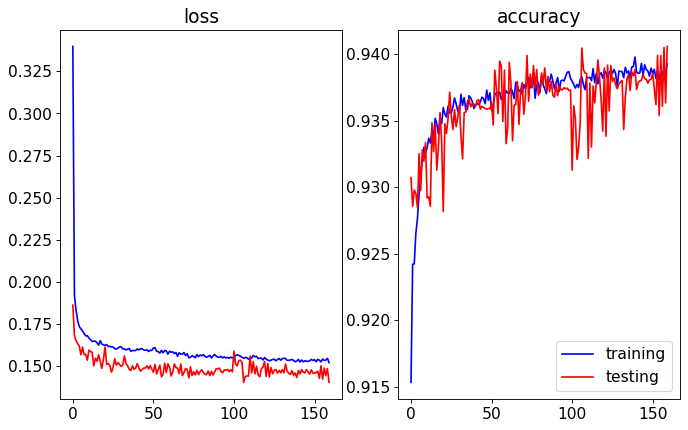

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


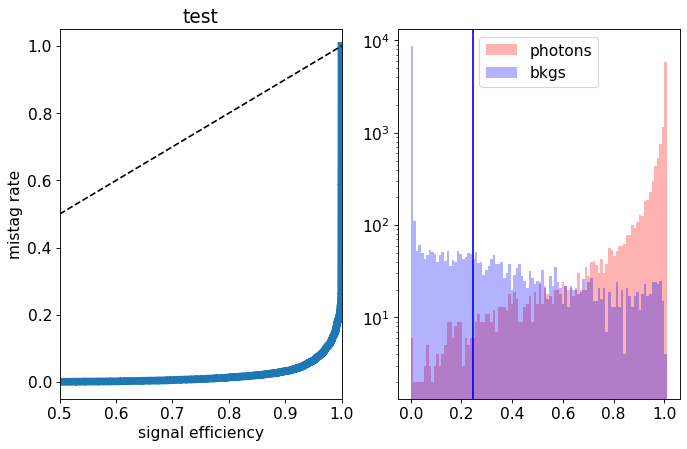

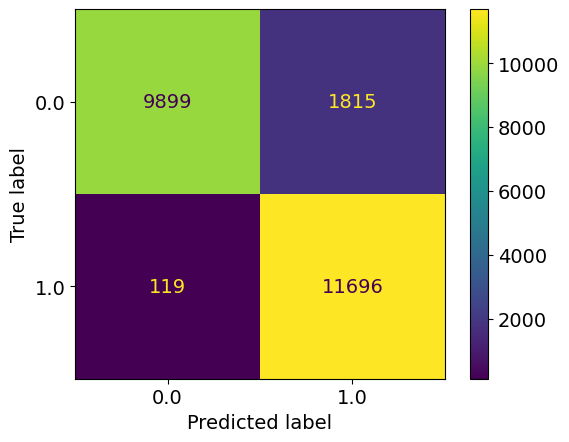

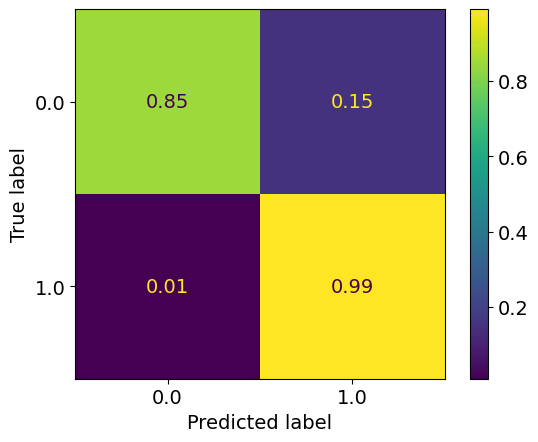

epoch: 160
Learning rate: 9.046260814679204e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.15368584619396053
train acc: 0.9384789


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.96it/s]


test loss: 0.14234606679528952
test acc: 0.93952143
epoch: 161
Learning rate: 8.85384139992778e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.17it/s]


train loss: 0.1520992483777605
train acc: 0.93885076


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.37it/s]


test loss: 0.14454050213098527
test acc: 0.9387564
epoch: 162
Learning rate: 8.646212633823499e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1528098618813381
train acc: 0.93908453


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.51it/s]


test loss: 0.14480920135974884
test acc: 0.93939394
epoch: 163
Learning rate: 8.424193932249616e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.54it/s]


train loss: 0.1516940584702856
train acc: 0.938872


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.58it/s]


test loss: 0.14190031588077545
test acc: 0.94011647
epoch: 164
Learning rate: 8.188661501590548e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


train loss: 0.1519465189735601
train acc: 0.93894637


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.00it/s]


test loss: 0.14541170224547387
test acc: 0.9386714
epoch: 165
Learning rate: 7.940544880745573e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.15299439871576942
train acc: 0.93905264


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.62it/s]


test loss: 0.14312941450625657
test acc: 0.9387989
epoch: 166
Learning rate: 7.680823272663462e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.15266135268530268
train acc: 0.9388295


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.50it/s]


test loss: 0.14264009725302457
test acc: 0.93939394
epoch: 167
Learning rate: 7.410521679875803e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.15220011400569017
train acc: 0.9376395


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.16it/s]


test loss: 0.14778008926659822
test acc: 0.9364189
epoch: 168
Learning rate: 7.130706859280277e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.55it/s]


train loss: 0.15226362180557979
train acc: 0.93889326


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.77it/s]


test loss: 0.14568489603698254
test acc: 0.9385014
epoch: 169
Learning rate: 6.842483112138543e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.11it/s]


train loss: 0.15199815671724878
train acc: 0.939382


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.48it/s]


test loss: 0.14238052312284707
test acc: 0.93905395


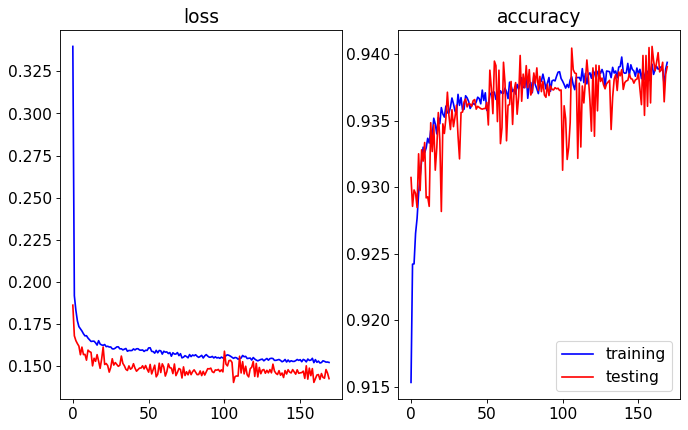

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.13it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


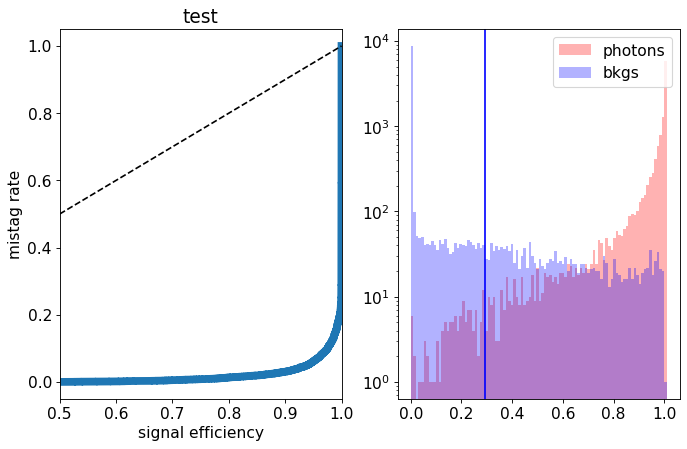

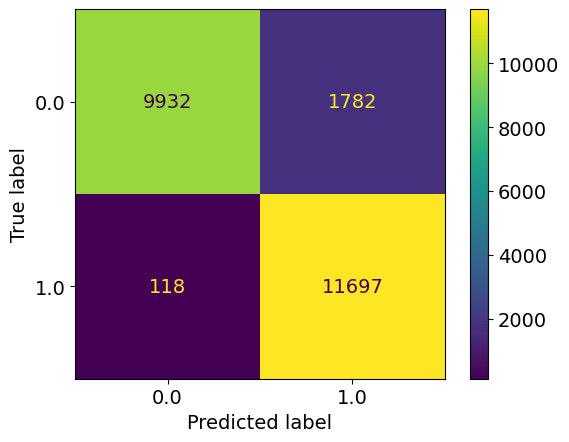

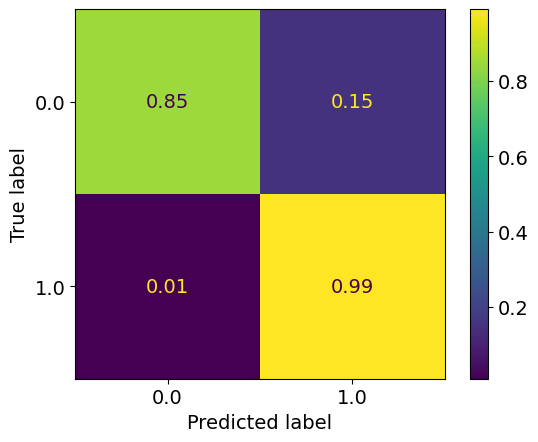

epoch: 170
Learning rate: 6.54698792590366e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.15162461621176665
train acc: 0.9385426


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.25it/s]


test loss: 0.14748021513223647
test acc: 0.9375239
epoch: 171
Learning rate: 6.245387485076794e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.07it/s]


train loss: 0.15287307341387318
train acc: 0.9387339


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.79it/s]


test loss: 0.14524570368230344
test acc: 0.93807644
epoch: 172
Learning rate: 5.9388720688097485e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.15193882385256943
train acc: 0.93918014


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.98it/s]


test loss: 0.14495335891842842
test acc: 0.9377789
epoch: 173
Learning rate: 5.6286513534169605e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1526403199335572
train acc: 0.9387764


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.49it/s]


test loss: 0.15177256464958191
test acc: 0.93433636
epoch: 174
Learning rate: 5.31594963833572e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.14it/s]


train loss: 0.15285440325547175
train acc: 0.93903136


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.48it/s]


test loss: 0.14237284064292907
test acc: 0.93913895
epoch: 175
Learning rate: 5.0020010143756276e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.15342964924824465
train acc: 0.9387764


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.55it/s]


test loss: 0.15007298719137907
test acc: 0.9361639
epoch: 176
Learning rate: 4.688044493325971e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.16it/s]


train loss: 0.1516280553428231
train acc: 0.93898886


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.81it/s]


test loss: 0.1446730775758624
test acc: 0.93896896
epoch: 177
Learning rate: 4.375319118142243e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.15111871666399537
train acc: 0.93980706


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.47it/s]


test loss: 0.1480045810341835
test acc: 0.9367589
epoch: 178
Learning rate: 4.06505907300966e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.15113201281826966
train acc: 0.9394351


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.04it/s]


test loss: 0.1392567755654454
test acc: 0.94011647
epoch: 179
Learning rate: 3.758488812582026e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.11it/s]


train loss: 0.15072148340712688
train acc: 0.93903136


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.84it/s]


test loss: 0.14658258445560932
test acc: 0.9375664


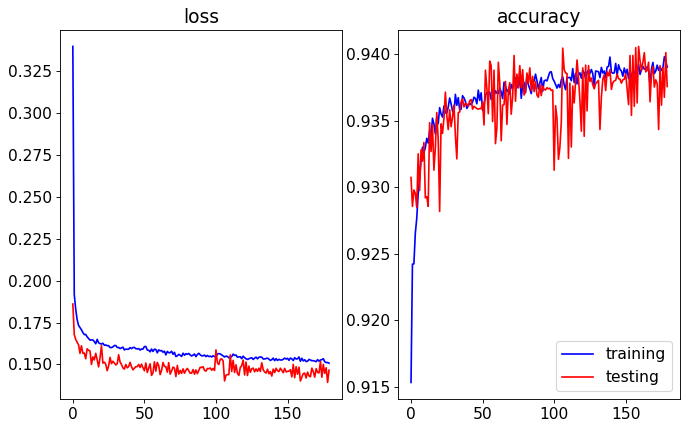

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.66it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


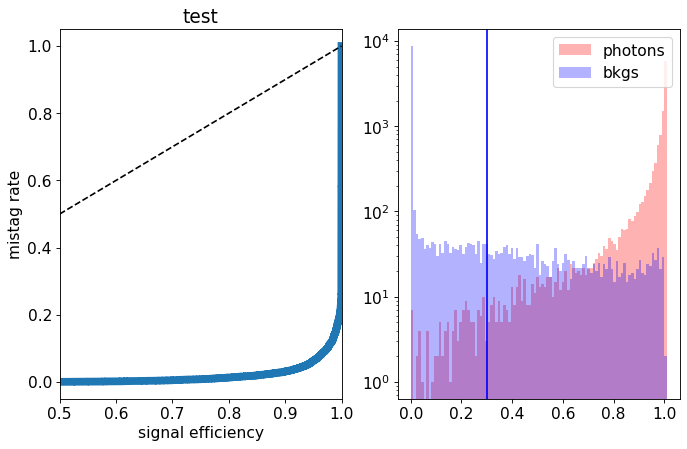

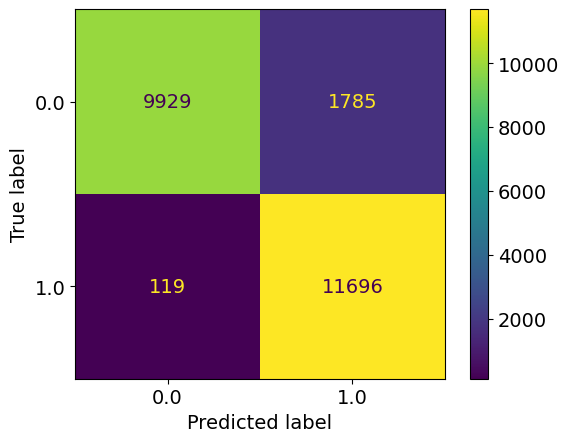

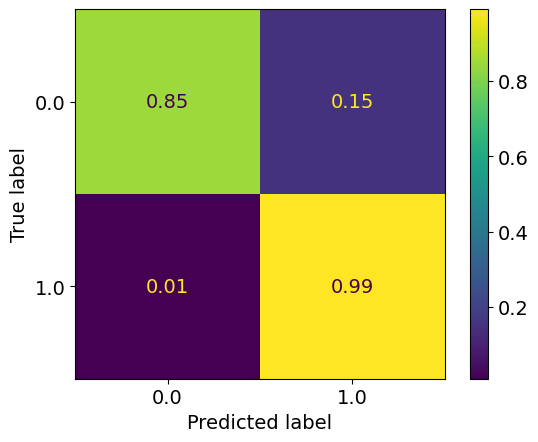

epoch: 180
Learning rate: 3.456818229618622e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.15166225554836785
train acc: 0.9384364


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.55it/s]


test loss: 0.14329792261123658
test acc: 0.9386714
epoch: 181
Learning rate: 3.161237880090224e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.1516637253533503
train acc: 0.93909514


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.20it/s]


test loss: 0.14446157217025757
test acc: 0.93939394
epoch: 182
Learning rate: 2.8729142845986056e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.15091459894446052
train acc: 0.93884015


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.62it/s]


test loss: 0.1434090780094266
test acc: 0.93947893
epoch: 183
Learning rate: 2.592985324652648e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.55it/s]


train loss: 0.15143436359561932
train acc: 0.9397539


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.10it/s]


test loss: 0.1458638520911336
test acc: 0.93913895
epoch: 184
Learning rate: 2.3225557519698832e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1511851116350502
train acc: 0.9394139


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.58it/s]


test loss: 0.14494290426373482
test acc: 0.9383314
epoch: 185
Learning rate: 2.06269282852617e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.15181729876121897
train acc: 0.93906325


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.74it/s]


test loss: 0.14367519207298757
test acc: 0.93952143
epoch: 186
Learning rate: 1.8144221145602645e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.07it/s]


train loss: 0.1509353709258851
train acc: 0.9392439


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.72it/s]


test loss: 0.14292828030884266
test acc: 0.93918145
epoch: 187
Learning rate: 1.5787234211560875e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.15061472959009706
train acc: 0.939297


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.08it/s]


test loss: 0.1428942658007145
test acc: 0.93935144
epoch: 188
Learning rate: 1.3565269433760169e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.1515889135515614
train acc: 0.93918014


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.63it/s]


test loss: 0.14525239318609237
test acc: 0.9386289
epoch: 189
Learning rate: 1.1487095892059352e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.15008963620776583
train acc: 0.94000894


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.69it/s]


test loss: 0.14339961018413305
test acc: 0.93943644


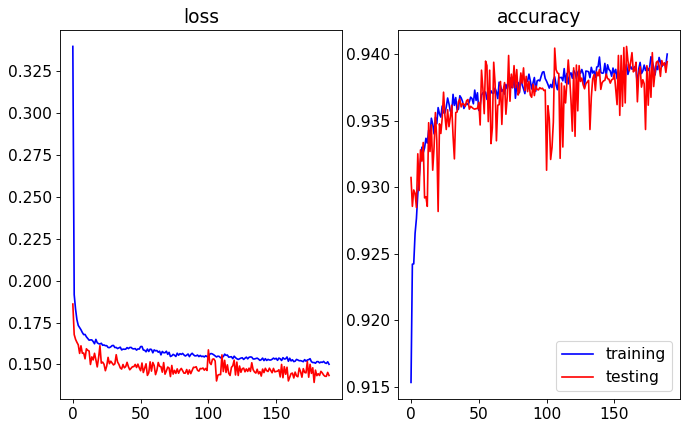

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.70it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


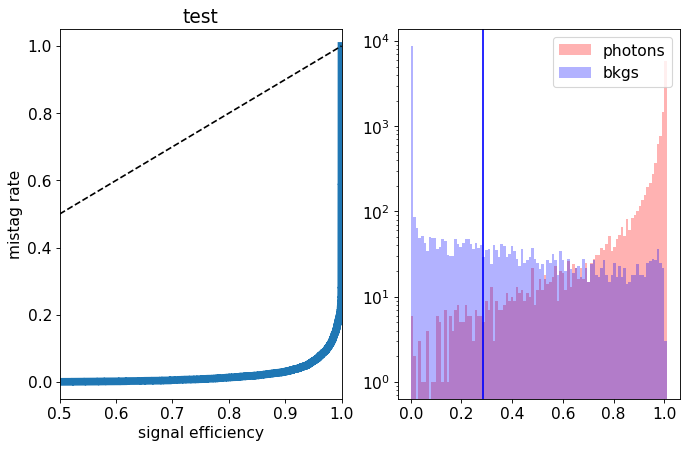

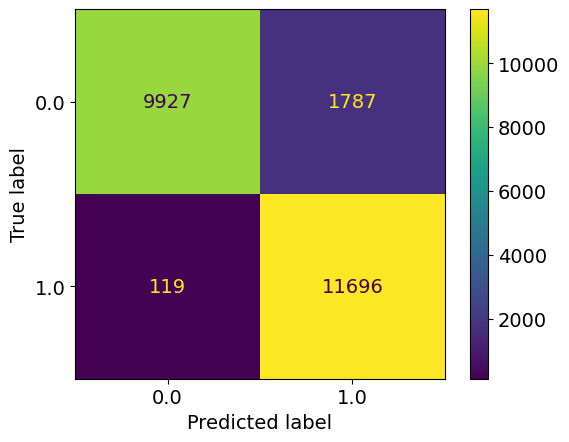

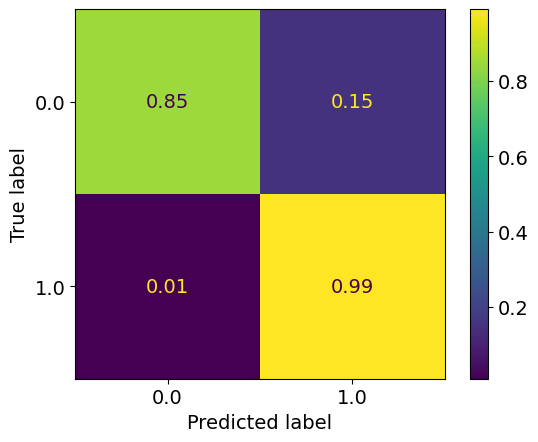

epoch: 190
Learning rate: 9.560915188000358e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1509558041194442
train acc: 0.939127


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.82it/s]


test loss: 0.1458439590409398
test acc: 0.9383314
epoch: 191
Learning rate: 7.794329076833812e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.10it/s]


train loss: 0.15163238873337484
train acc: 0.93895704


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.44it/s]


test loss: 0.14422132316976785
test acc: 0.93922395
epoch: 192
Learning rate: 6.194309466864101e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.15210079458678605
train acc: 0.9385639


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.99it/s]


test loss: 0.14464135207235812
test acc: 0.93901145
epoch: 193
Learning rate: 4.767170904512308e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.14it/s]


train loss: 0.1510266037123978
train acc: 0.93913764


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.86it/s]


test loss: 0.14319535251706839
test acc: 0.93918145
epoch: 194
Learning rate: 3.518545653686489e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1509914433785305
train acc: 0.9392014


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.13it/s]


test loss: 0.14244517870247364
test acc: 0.93918145
epoch: 195
Learning rate: 2.453361467809001e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.56it/s]


train loss: 0.15129367423475168
train acc: 0.9393183


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.84it/s]


test loss: 0.14346490669995546
test acc: 0.93909645
epoch: 196
Learning rate: 1.5758221422251696e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.19it/s]


train loss: 0.15188173109748562
train acc: 0.93868077


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.32it/s]


test loss: 0.14318312089890242
test acc: 0.93918145
epoch: 197
Learning rate: 8.893909237434716e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.15134866796671206
train acc: 0.9395202


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.82it/s]


test loss: 0.14397252034395933
test acc: 0.93926644
epoch: 198
Learning rate: 3.967768427826646e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.19it/s]


train loss: 0.150783638380895
train acc: 0.93926513


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.94it/s]


test loss: 0.1448142806068063
test acc: 0.93922395
epoch: 199
Learning rate: 9.992402206633334e-08


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.15142361705849886
train acc: 0.93967956


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.47it/s]


test loss: 0.146825516410172
test acc: 0.93922395


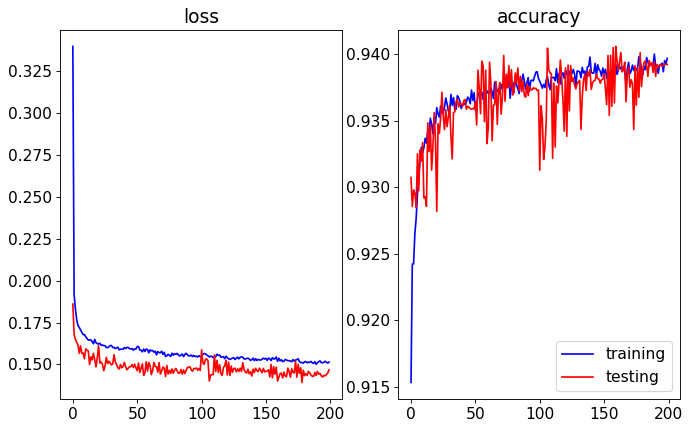

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.72it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


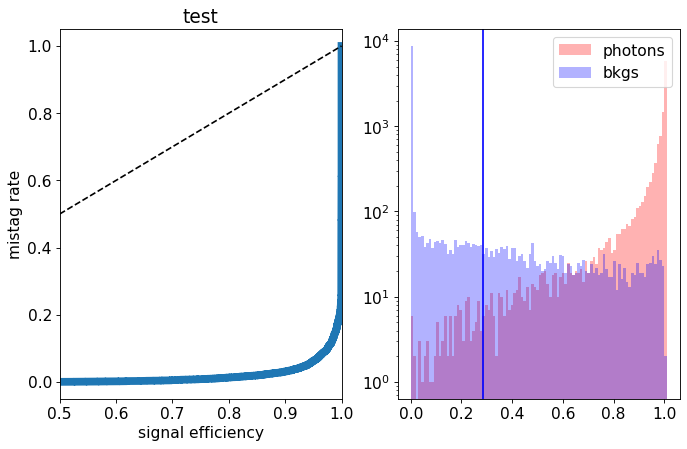

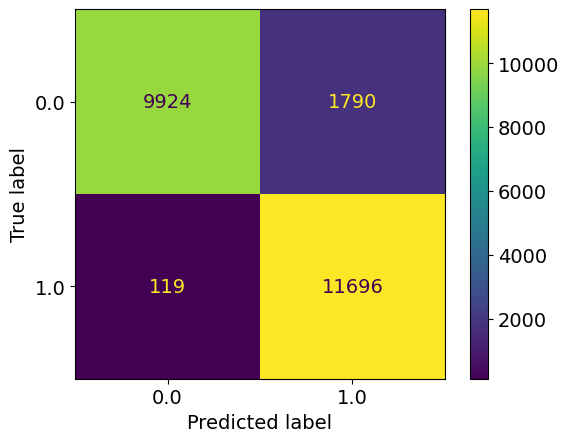

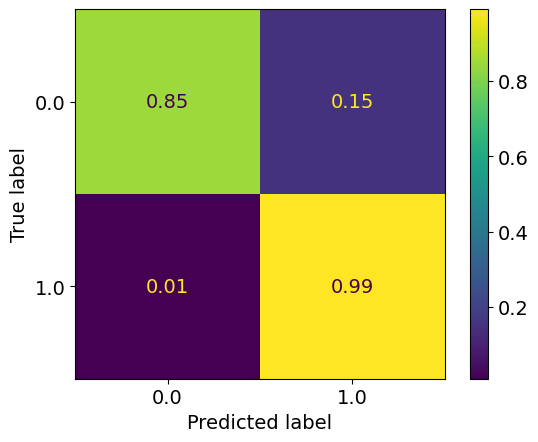

epoch: 200
Learning rate: 4.004058690165735e-12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.54it/s]


train loss: 0.15244286967690585
train acc: 0.93983895


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.34it/s]


test loss: 0.14218292869627475
test acc: 0.93905395
epoch: 201
Learning rate: 9.990258887257831e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.15298726646953328
train acc: 0.93894637


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.37it/s]


test loss: 0.14458873961120844
test acc: 0.9387564
epoch: 202
Learning rate: 9.960823902925947e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.15158571298145185
train acc: 0.93904203


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.77it/s]


test loss: 0.14719797503203153
test acc: 0.9374389
epoch: 203
Learning rate: 9.911810813034074e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  4.98it/s]


train loss: 0.15267109942094537
train acc: 0.9386489


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.86it/s]


test loss: 0.14537519719451666
test acc: 0.93816143
epoch: 204
Learning rate: 9.843413049856063e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.15206045415371086
train acc: 0.93963706


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.66it/s]


test loss: 0.14416304640471936
test acc: 0.9385864
epoch: 205
Learning rate: 9.755900548115216e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.15038141181134873
train acc: 0.9395095


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.16it/s]


test loss: 0.14546733628958464
test acc: 0.9387989
epoch: 206
Learning rate: 9.649618679675239e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.15338357239012507
train acc: 0.9384682


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.16it/s]


test loss: 0.1442189946770668
test acc: 0.93803394
epoch: 207
Learning rate: 9.524986890515301e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.15137596736857845
train acc: 0.9385851


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.82it/s]


test loss: 0.1457731883972883
test acc: 0.9376089
epoch: 208
Learning rate: 9.38249704536837e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.09it/s]


train loss: 0.15219718393436663
train acc: 0.9394033


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.48it/s]


test loss: 0.14235269241034984
test acc: 0.93926644
epoch: 209
Learning rate: 9.222711486555818e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1513923879736548
train acc: 0.939127


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.56it/s]


test loss: 0.14666755311191082
test acc: 0.9379064


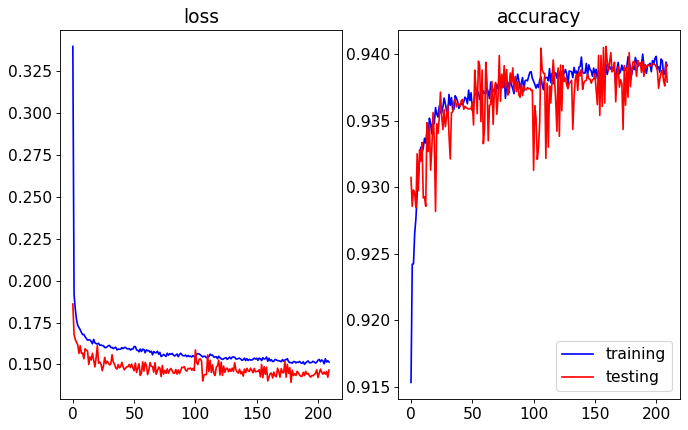

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.56it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


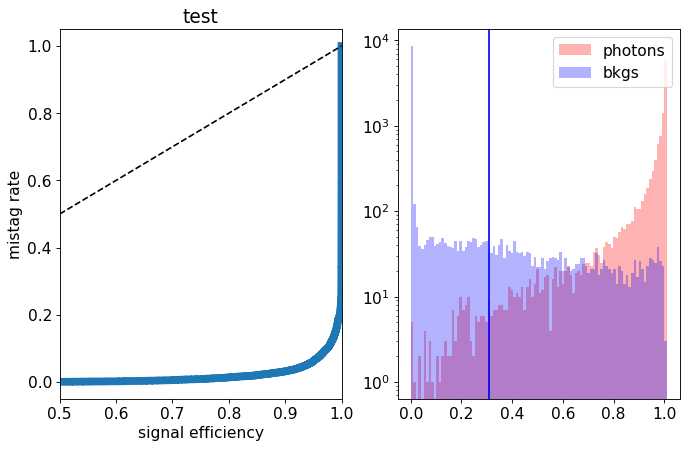

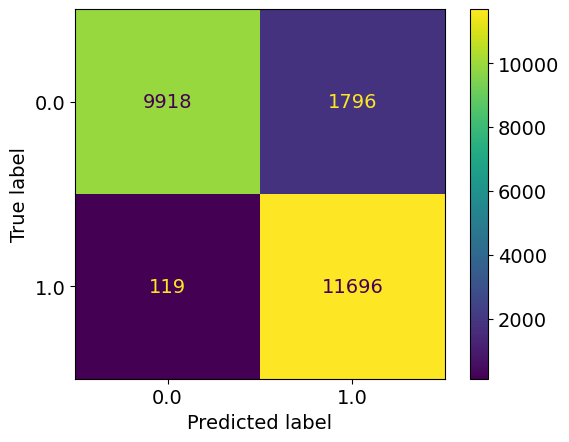

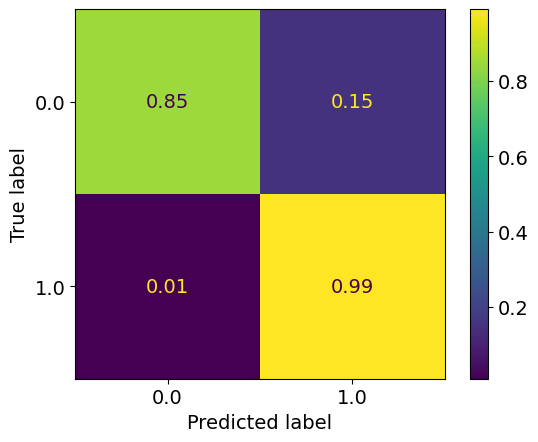

epoch: 210
Learning rate: 9.046260814679204e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  4.97it/s]


train loss: 0.15190984911409913
train acc: 0.938447


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.45it/s]


test loss: 0.14107672180980443
test acc: 0.93922395
epoch: 211
Learning rate: 8.85384139992778e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1523971887910442
train acc: 0.9392014


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.97it/s]


test loss: 0.1428834680467844
test acc: 0.9387139
epoch: 212
Learning rate: 8.646212633823499e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.15217467202882098
train acc: 0.9392758


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.50it/s]


test loss: 0.14330739676952362
test acc: 0.93901145
epoch: 213
Learning rate: 8.424193932249616e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.13it/s]


train loss: 0.15160932913897143
train acc: 0.9401258


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.72it/s]


test loss: 0.1409070871770382
test acc: 0.94003147
epoch: 214
Learning rate: 8.188661501590548e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.15118424039167963
train acc: 0.9391164


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.15it/s]


test loss: 0.14379181638360022
test acc: 0.9387564
epoch: 215
Learning rate: 7.940544880745573e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.15095510537836962
train acc: 0.93903136


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.72it/s]


test loss: 0.14467999655753375
test acc: 0.9385864
epoch: 216
Learning rate: 7.680823272663462e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.15242068882390952
train acc: 0.93884015


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.79it/s]


test loss: 0.14451655689626933
test acc: 0.93799144
epoch: 217
Learning rate: 7.410521679875803e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.15272602434181104
train acc: 0.93894637


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.78it/s]


test loss: 0.14074806366115808
test acc: 0.94007397
epoch: 218
Learning rate: 7.130706859280277e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.09it/s]


train loss: 0.15145913051192167
train acc: 0.9393714


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.59it/s]


test loss: 0.1417329903692007
test acc: 0.93952143
epoch: 219
Learning rate: 6.842483112138543e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14973761981270114
train acc: 0.93977517


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.51it/s]


test loss: 0.13960309904068707
test acc: 0.94151896
new best acc: 0.94151896


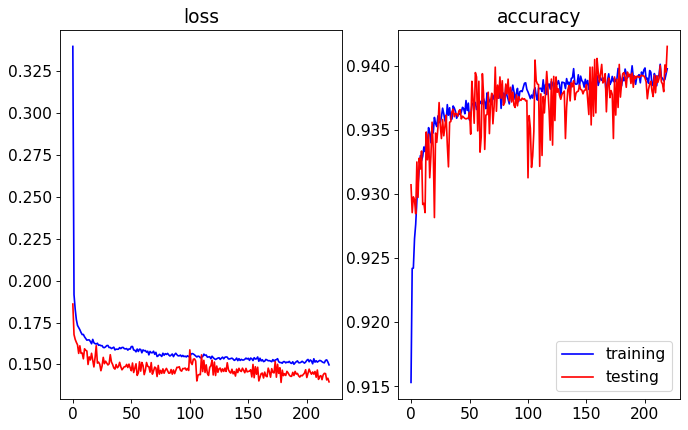

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.43it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


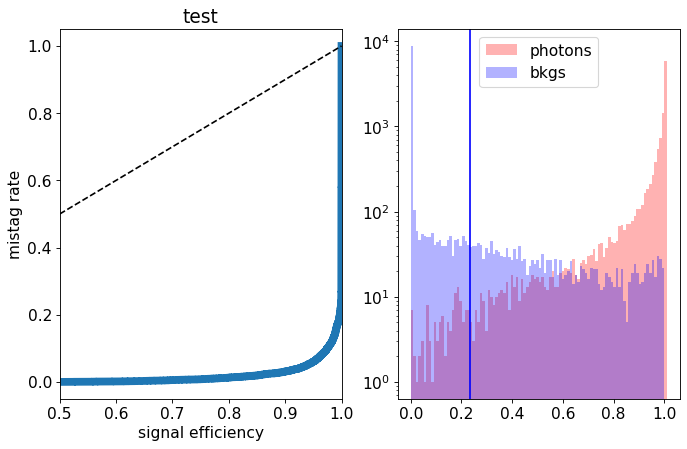

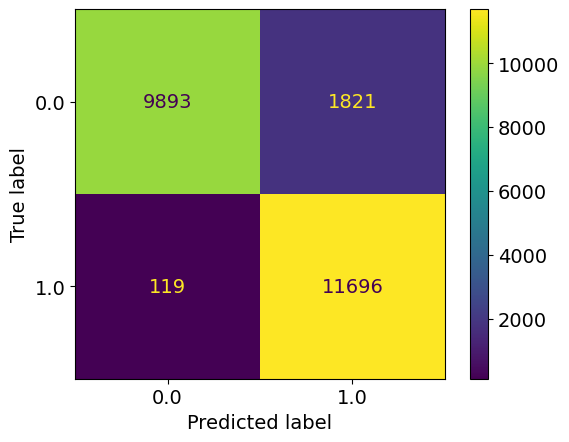

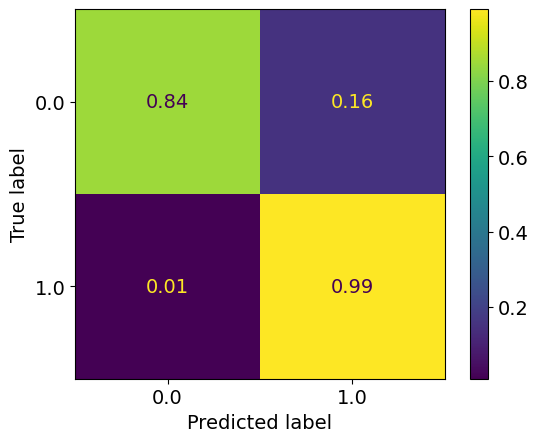

epoch: 220
Learning rate: 6.54698792590366e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.14it/s]


train loss: 0.1504205639480026
train acc: 0.9393608


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.50it/s]


test loss: 0.13750812634825707
test acc: 0.94173145
new best acc: 0.94173145
epoch: 221
Learning rate: 6.245387485076794e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.46it/s]


train loss: 0.15056344173896086
train acc: 0.9394777


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.29it/s]


test loss: 0.14997669067233801
test acc: 0.9365889
epoch: 222
Learning rate: 5.9388720688097485e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.54it/s]


train loss: 0.14971422033894594
train acc: 0.9394033


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.05it/s]


test loss: 0.1424059819430113
test acc: 0.9396064
epoch: 223
Learning rate: 5.6286513534169605e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.15083249610890248
train acc: 0.9391589


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.21it/s]


test loss: 0.1469295060262084
test acc: 0.9368439
epoch: 224
Learning rate: 5.31594963833572e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.1511130833606811
train acc: 0.9394564


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.19it/s]


test loss: 0.14143729787319897
test acc: 0.94041395
epoch: 225
Learning rate: 5.0020010143756276e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.13it/s]


train loss: 0.14934053015746887
train acc: 0.9391164


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.60it/s]


test loss: 0.14337694831192493
test acc: 0.94024396
epoch: 226
Learning rate: 4.688044493325971e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.46it/s]


train loss: 0.1509786667242931
train acc: 0.9395945


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.55it/s]


test loss: 0.14807705506682395
test acc: 0.93794894
epoch: 227
Learning rate: 4.375319118142243e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.15064062852009086
train acc: 0.9395945


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.47it/s]


test loss: 0.14354925137013197
test acc: 0.93930894
epoch: 228
Learning rate: 4.06505907300966e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.15031951219792578
train acc: 0.94003016


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.46it/s]


test loss: 0.14019720125943422
test acc: 0.94028646
epoch: 229
Learning rate: 3.758488812582026e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.15065447112936883
train acc: 0.9393289


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.43it/s]


test loss: 0.13963049799203872
test acc: 0.94079643


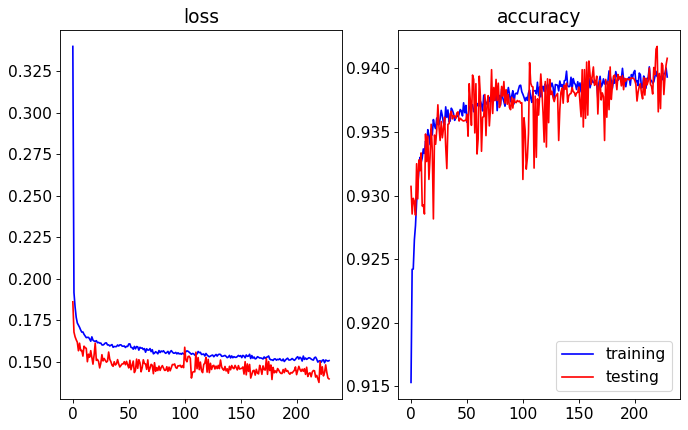

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.40it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


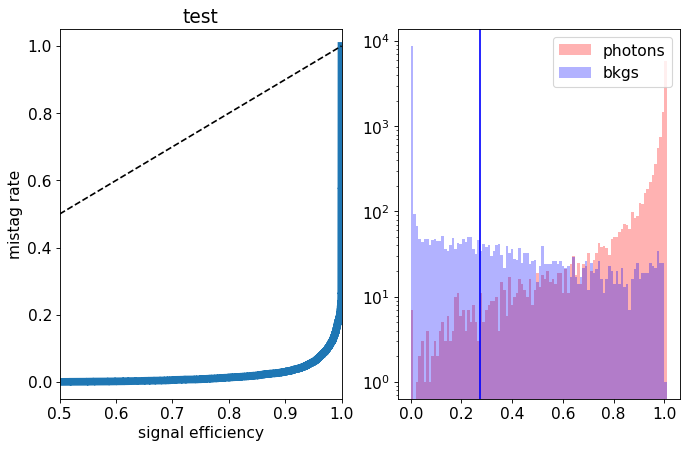

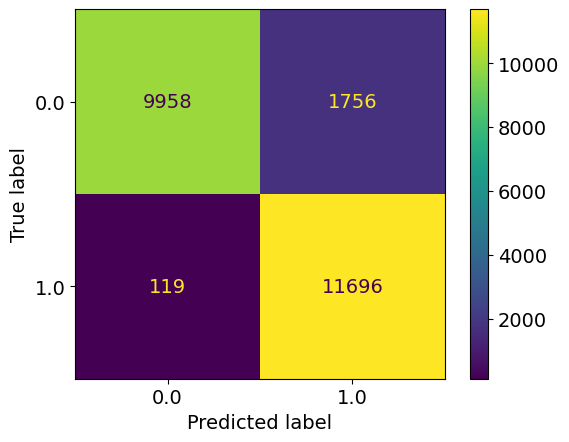

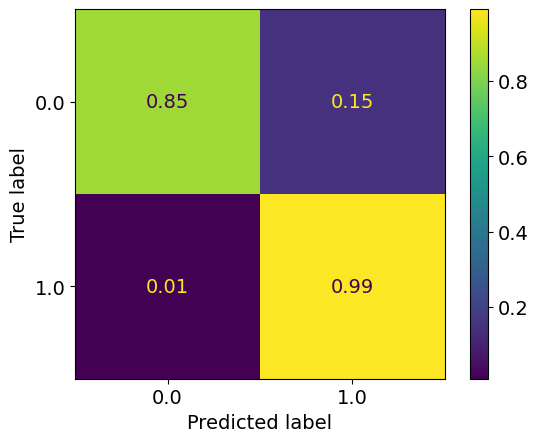

epoch: 230
Learning rate: 3.456818229618622e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.17it/s]


train loss: 0.1505806573731884
train acc: 0.9395308


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.50it/s]


test loss: 0.1444081898778677
test acc: 0.9386289
epoch: 231
Learning rate: 3.161237880090224e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14854395959028013
train acc: 0.94000894


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.80it/s]


test loss: 0.14185589514672756
test acc: 0.94007397
epoch: 232
Learning rate: 2.8729142845986056e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.1500994567848315
train acc: 0.94011515


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.20it/s]


test loss: 0.1439222414046526
test acc: 0.9385864
epoch: 233
Learning rate: 2.592985324652648e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.149555811409358
train acc: 0.94015765


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.13it/s]


test loss: 0.14505912605673074
test acc: 0.9386289
epoch: 234
Learning rate: 2.3225557519698832e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14939432619673432
train acc: 0.9402639


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.04it/s]


test loss: 0.14517656844109297
test acc: 0.9375239
epoch: 235
Learning rate: 2.06269282852617e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.14it/s]


train loss: 0.1500739667351079
train acc: 0.93913764


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.38it/s]


test loss: 0.1435738628730178
test acc: 0.9396914
epoch: 236
Learning rate: 1.8144221145602645e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.15040082930569437
train acc: 0.9397433


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.92it/s]


test loss: 0.1448525467887521
test acc: 0.93930894
epoch: 237
Learning rate: 1.5787234211560875e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.10it/s]


train loss: 0.1512042922294064
train acc: 0.9394883


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.39it/s]


test loss: 0.14343219194561244
test acc: 0.9397764
epoch: 238
Learning rate: 1.3565269433760169e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.1497156207633626
train acc: 0.94011515


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.10it/s]


test loss: 0.14363622646778823
test acc: 0.93926644
epoch: 239
Learning rate: 1.1487095892059352e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.14901525270976837
train acc: 0.94018954


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.30it/s]


test loss: 0.14075998924672603
test acc: 0.94058394


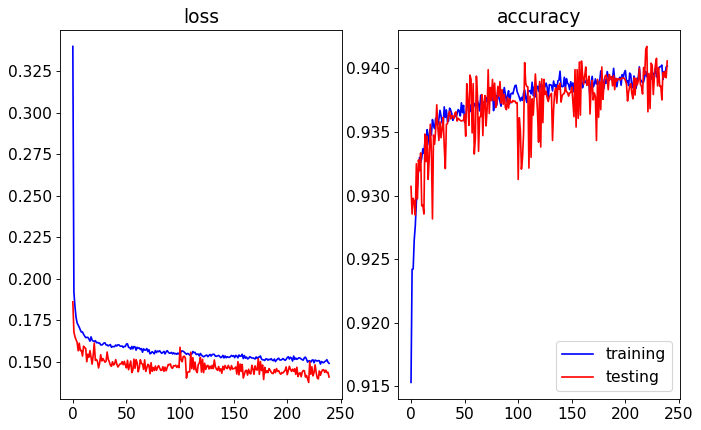

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.85it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


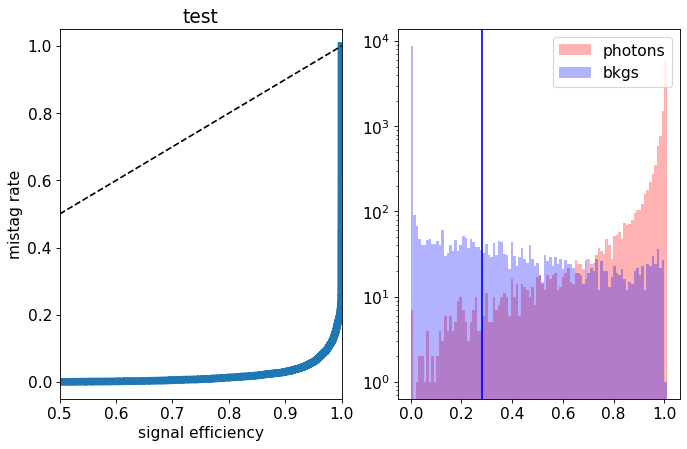

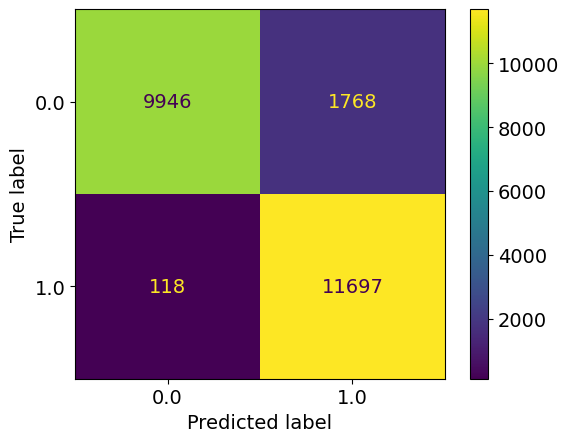

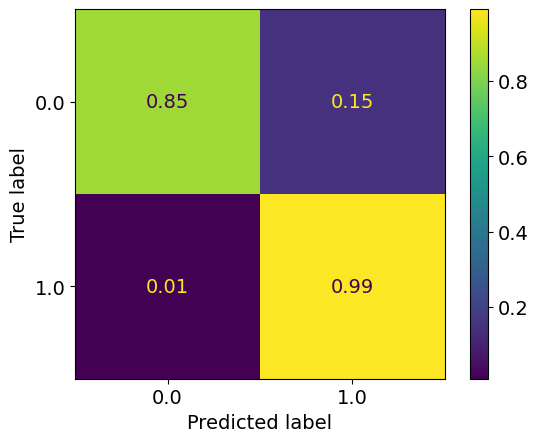

epoch: 240
Learning rate: 9.560915188000358e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.15059683414970992
train acc: 0.94031703


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.14289741031825542
test acc: 0.9396064
epoch: 241
Learning rate: 7.794329076833812e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14869450151350846
train acc: 0.9399558


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.85it/s]


test loss: 0.1423697905614972
test acc: 0.94020146
epoch: 242
Learning rate: 6.194309466864101e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.14it/s]


train loss: 0.14876504432243906
train acc: 0.93980706


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.16it/s]


test loss: 0.14352277535945177
test acc: 0.93926644
epoch: 243
Learning rate: 4.767170904512308e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.14981604666466924
train acc: 0.93981767


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.49it/s]


test loss: 0.14225772749632598
test acc: 0.939989
epoch: 244
Learning rate: 3.518545653686489e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1486740487681073
train acc: 0.9402002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.17it/s]


test loss: 0.14459103103727103
test acc: 0.94003147
epoch: 245
Learning rate: 2.453361467809001e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14941726136169617
train acc: 0.9402639


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.35it/s]


test loss: 0.1435892717912793
test acc: 0.9398189
epoch: 246
Learning rate: 1.5758221422251696e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14977204325092827
train acc: 0.93996644


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.98it/s]


test loss: 0.1425294890999794
test acc: 0.93947893
epoch: 247
Learning rate: 8.893909237434716e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.10it/s]


train loss: 0.1497324974673569
train acc: 0.93989205


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.45it/s]


test loss: 0.14288878832012414
test acc: 0.93939394
epoch: 248
Learning rate: 3.967768427826646e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14906836324816297
train acc: 0.94000894


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.03it/s]


test loss: 0.1432486752048135
test acc: 0.93947893
epoch: 249
Learning rate: 9.992402206633334e-08


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.15018530028640845
train acc: 0.94014704


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.81it/s]


test loss: 0.14418937917798758
test acc: 0.93947893


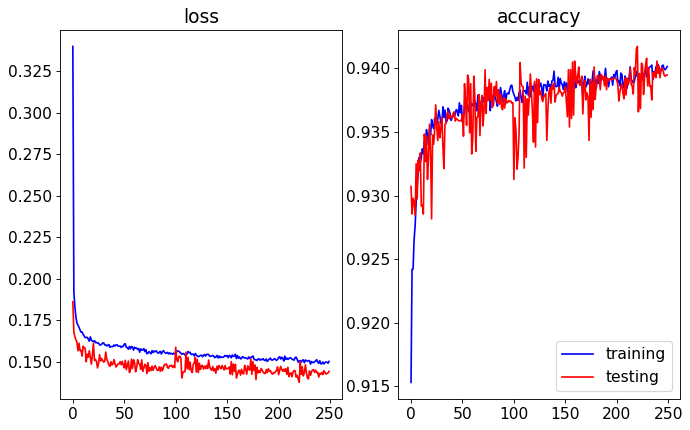

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.35it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


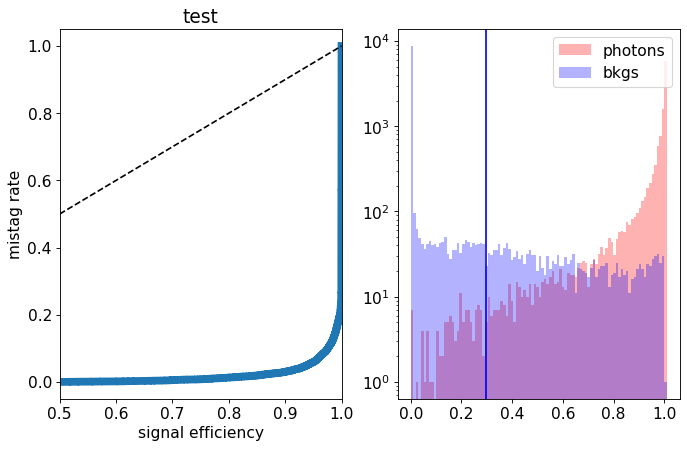

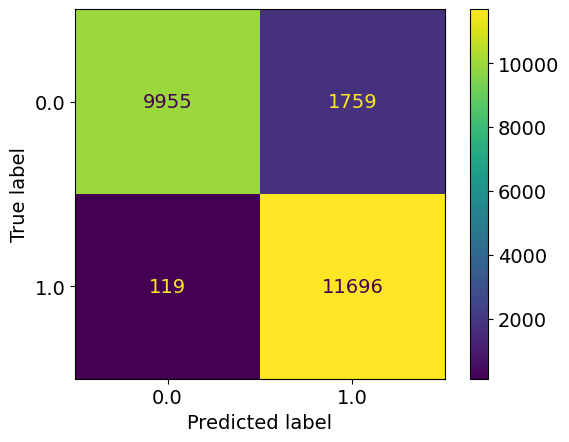

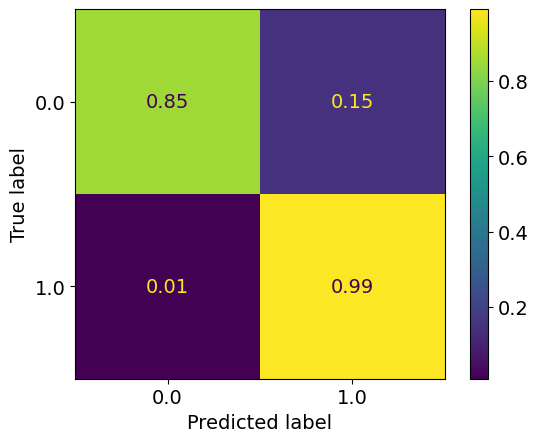

epoch: 250
Learning rate: 4.004058690165735e-12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1505425136275352
train acc: 0.9399983


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.96it/s]


test loss: 0.14677369482815267
test acc: 0.93688637
epoch: 251
Learning rate: 9.990258887257831e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.1501885629763269
train acc: 0.939212


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.16it/s]


test loss: 0.14217588789761065
test acc: 0.9398615
epoch: 252
Learning rate: 9.960823902925947e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.11it/s]


train loss: 0.1508007793669488
train acc: 0.93905264


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.50it/s]


test loss: 0.14442449752241374
test acc: 0.93892646
epoch: 253
Learning rate: 9.911810813034074e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.15019123109093138
train acc: 0.9399983


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.57it/s]


test loss: 0.14536425694823266
test acc: 0.93926644
epoch: 254
Learning rate: 9.843413049856063e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.14it/s]


train loss: 0.1505354495280108
train acc: 0.9394458


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.32it/s]


test loss: 0.13838684149086475
test acc: 0.94160396
epoch: 255
Learning rate: 9.755900548115216e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.15119834789994416
train acc: 0.93919075


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.47it/s]


test loss: 0.14367243479937314
test acc: 0.9387989
epoch: 256
Learning rate: 9.649618679675239e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.15227453595703574
train acc: 0.93909514


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.58it/s]


test loss: 0.14334984850138427
test acc: 0.9384164
epoch: 257
Learning rate: 9.524986890515297e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


train loss: 0.15124941878258044
train acc: 0.9394351


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.1446343580260873
test acc: 0.9376514
epoch: 258
Learning rate: 9.382497045368364e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.15093946380979695
train acc: 0.9397327


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.94it/s]


test loss: 0.14058998189866542
test acc: 0.94011647
epoch: 259
Learning rate: 9.222711486555813e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.13it/s]


train loss: 0.14996732292091772
train acc: 0.9394989


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.1406520288437605
test acc: 0.94020146


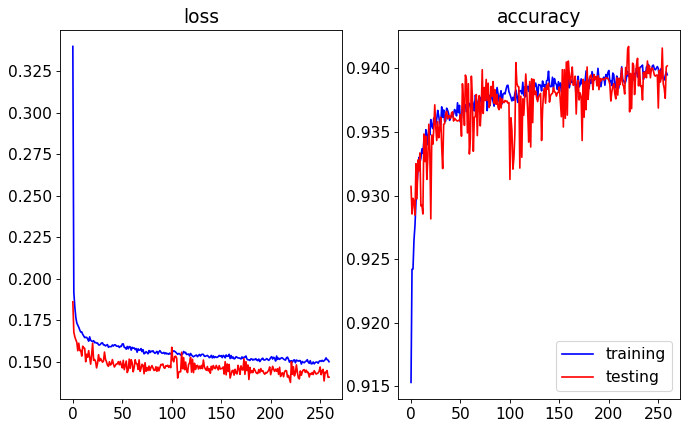

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.36it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


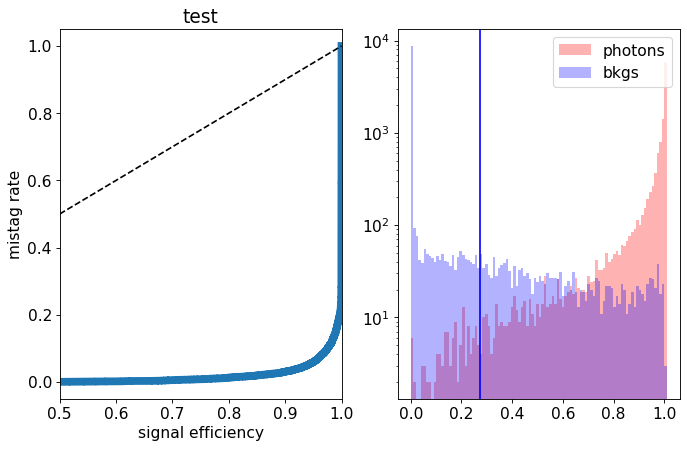

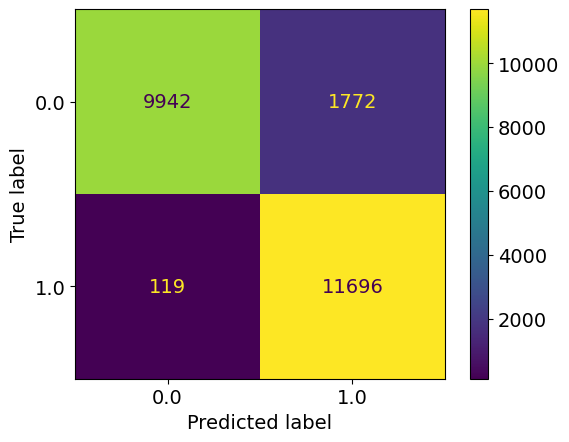

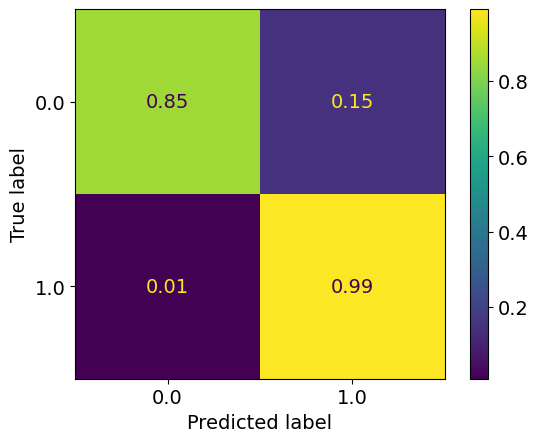

epoch: 260
Learning rate: 9.046260814679199e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14926597637355707
train acc: 0.9405721


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.02it/s]


test loss: 0.14307182151824235
test acc: 0.93905395
epoch: 261
Learning rate: 8.853841399927774e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14928931235128148
train acc: 0.94011515


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.91it/s]


test loss: 0.14502021558582784
test acc: 0.93820393
epoch: 262
Learning rate: 8.646212633823493e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.46it/s]


train loss: 0.1493994338307411
train acc: 0.9395414


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.64it/s]


test loss: 0.14464962016791105
test acc: 0.93888396
epoch: 263
Learning rate: 8.42419393224961e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.15053864060693486
train acc: 0.93919075


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.58it/s]


test loss: 0.14508256278932094
test acc: 0.9375239
epoch: 264
Learning rate: 8.188661501590543e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.18it/s]


train loss: 0.14970736998091838
train acc: 0.94015765


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.11it/s]


test loss: 0.14535740669816732
test acc: 0.9388414
epoch: 265
Learning rate: 7.940544880745565e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14978782272642585
train acc: 0.9394351


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.46it/s]


test loss: 0.14493091953918338
test acc: 0.9363764
epoch: 266
Learning rate: 7.680823272663455e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.46it/s]


train loss: 0.15059720174332333
train acc: 0.93908453


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.32it/s]


test loss: 0.14733411986380815
test acc: 0.9367164
epoch: 267
Learning rate: 7.410521679875796e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.13it/s]


train loss: 0.14908718787560796
train acc: 0.93919075


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.85it/s]


test loss: 0.14506589621305466
test acc: 0.9371839
epoch: 268
Learning rate: 7.130706859280269e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.14997154270197935
train acc: 0.93981767


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.50it/s]


test loss: 0.14789917189627885
test acc: 0.9370564
epoch: 269
Learning rate: 6.842483112138533e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.13it/s]


train loss: 0.15021269958300196
train acc: 0.9399133


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.32it/s]


test loss: 0.13887949641793967
test acc: 0.94134897


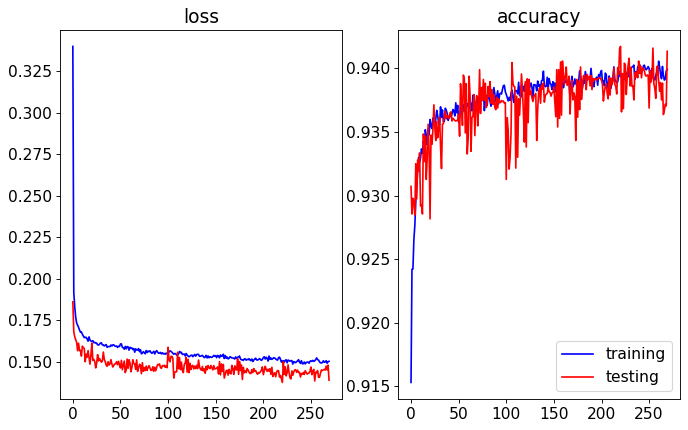

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.37it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


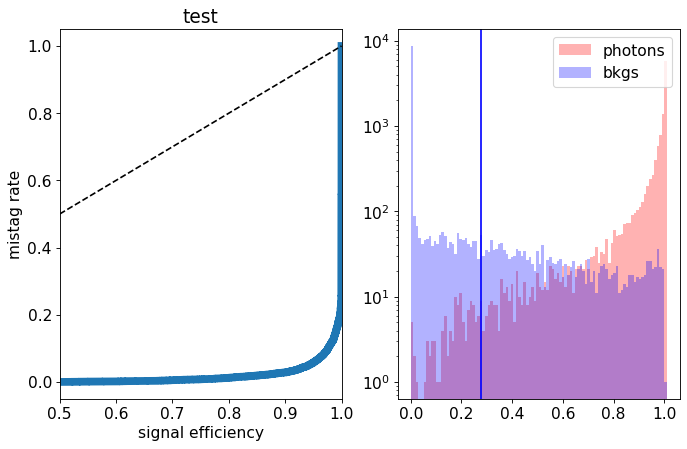

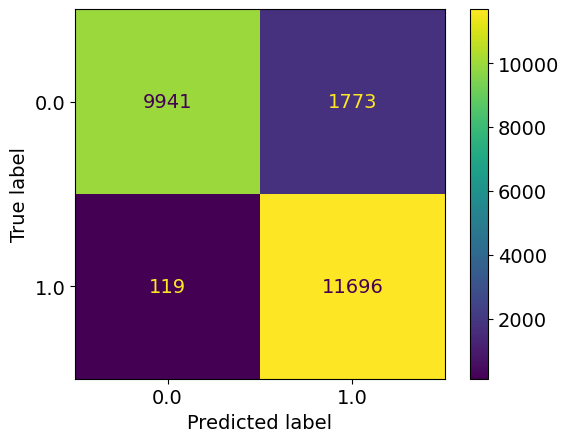

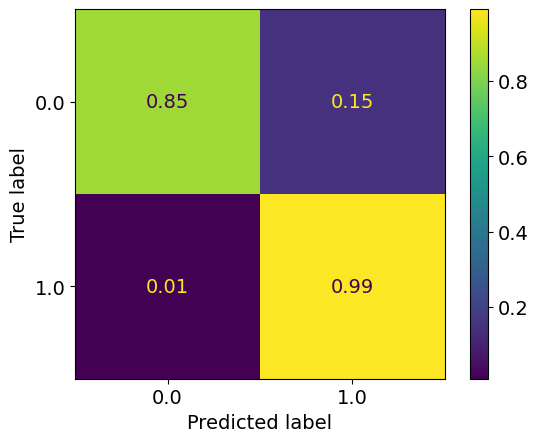

epoch: 270
Learning rate: 6.546987925903652e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.14936947015820035
train acc: 0.9402639


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.47it/s]


test loss: 0.14262485690414906
test acc: 0.9399465
epoch: 271
Learning rate: 6.245387485076784e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


train loss: 0.14937350713902978
train acc: 0.93992394


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.42it/s]


test loss: 0.13581830970942974
test acc: 0.943134
new best acc: 0.943134
epoch: 272
Learning rate: 5.93887206880974e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1493537348167152
train acc: 0.9405296


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.90it/s]


test loss: 0.13807665295898913
test acc: 0.94173145
epoch: 273
Learning rate: 5.6286513534169517e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14909311009060805
train acc: 0.9406783


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.57it/s]


test loss: 0.143438233807683
test acc: 0.93926644
epoch: 274
Learning rate: 5.315949638335711e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  4.99it/s]


train loss: 0.1504074183239299
train acc: 0.94009393


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.90it/s]


test loss: 0.14198419973254203
test acc: 0.940924
epoch: 275
Learning rate: 5.00200101437562e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14936243125777335
train acc: 0.93976456


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.08it/s]


test loss: 0.143935907818377
test acc: 0.93918145
epoch: 276
Learning rate: 4.6880444933259634e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.14984274603379
train acc: 0.93981767


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.96it/s]


test loss: 0.14198093935847284
test acc: 0.94049895
epoch: 277
Learning rate: 4.375319118142234e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14866410437852715
train acc: 0.94089085


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.82it/s]


test loss: 0.14273197557777167
test acc: 0.93939394
epoch: 278
Learning rate: 4.06505907300965e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.15001744587140478
train acc: 0.9397539


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.82it/s]


test loss: 0.1462643003091216
test acc: 0.9371839
epoch: 279
Learning rate: 3.758488812582018e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.1498062522358196
train acc: 0.9402958


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.33it/s]


test loss: 0.14693498946726322
test acc: 0.9370989


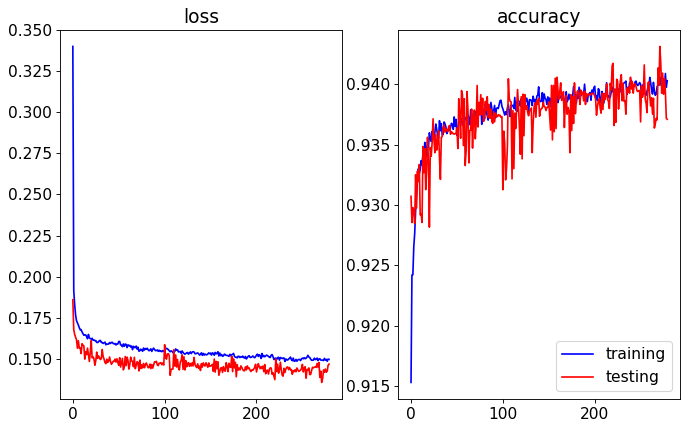

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.27it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


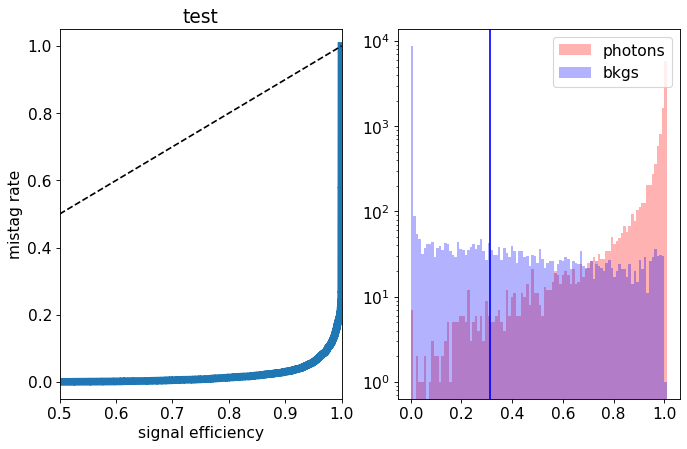

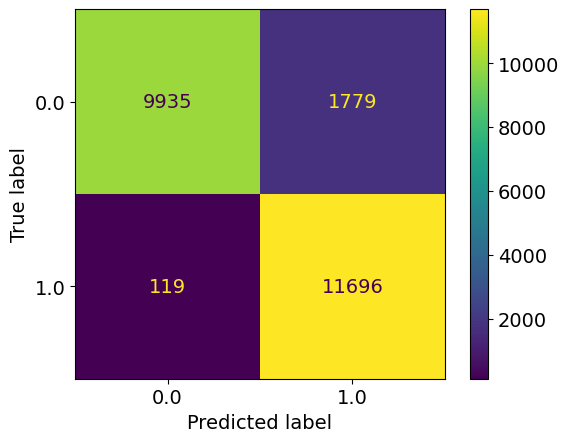

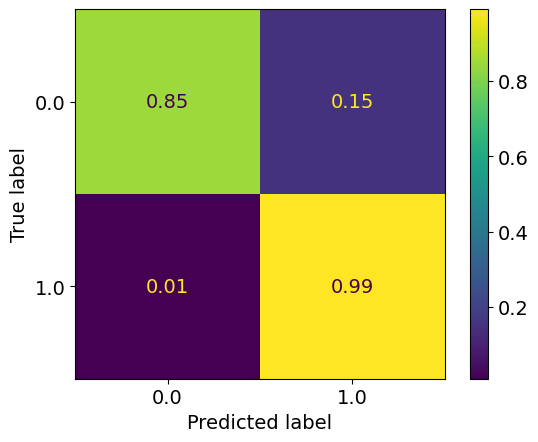

epoch: 280
Learning rate: 3.4568182296186134e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.14914380721036036
train acc: 0.9395839


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.82it/s]


test loss: 0.14045542515814305
test acc: 0.94062644
epoch: 281
Learning rate: 3.161237880090216e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.08it/s]


train loss: 0.14980981389808048
train acc: 0.94013643


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.49it/s]


test loss: 0.14718699995428325
test acc: 0.9365889
epoch: 282
Learning rate: 2.8729142845985978e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14954533627268615
train acc: 0.94010454


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.43it/s]


test loss: 0.13724663350731134
test acc: 0.94164646
epoch: 283
Learning rate: 2.5929853246526404e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.54it/s]


train loss: 0.14831355361232332
train acc: 0.94092274


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.13991064839065076
test acc: 0.9412215
epoch: 284
Learning rate: 2.3225557519698758e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.07it/s]


train loss: 0.1486445569973083
train acc: 0.9399558


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.43it/s]


test loss: 0.14144821166992189
test acc: 0.9408815
epoch: 285
Learning rate: 2.0626928285261642e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.1483009940214977
train acc: 0.9406783


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.19it/s]


test loss: 0.14255524948239326
test acc: 0.939989
epoch: 286
Learning rate: 1.8144221145602574e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.20it/s]


train loss: 0.1493141579020555
train acc: 0.93998766


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.00it/s]


test loss: 0.14373200833797456
test acc: 0.93952143
epoch: 287
Learning rate: 1.5787234211560807e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1479580240074996
train acc: 0.9405508


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.03it/s]


test loss: 0.144117228128016
test acc: 0.93888396
epoch: 288
Learning rate: 1.3565269433760108e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1488358532167544
train acc: 0.9405933


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.39it/s]


test loss: 0.14358087796717883
test acc: 0.94007397
epoch: 289
Learning rate: 1.1487095892059296e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.19it/s]


train loss: 0.14908330640785253
train acc: 0.9396689


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.41it/s]


test loss: 0.1396404368802905
test acc: 0.94032896


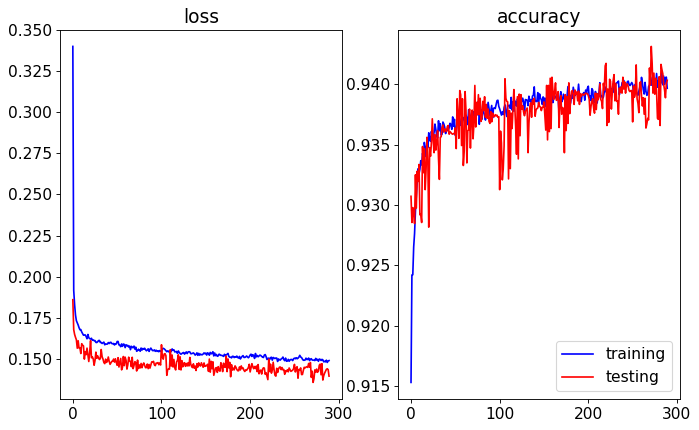

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.92it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


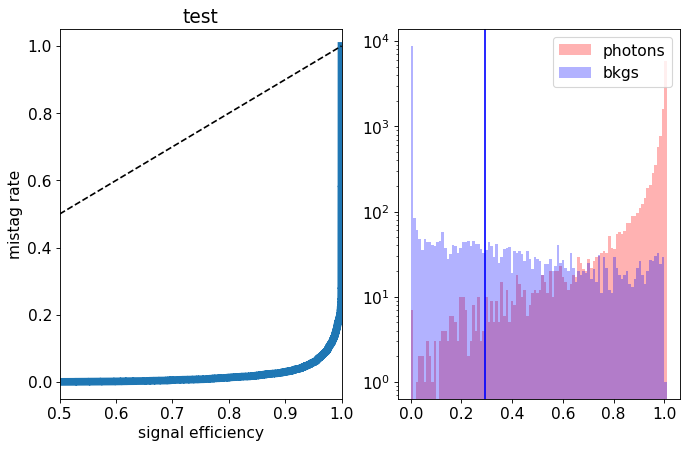

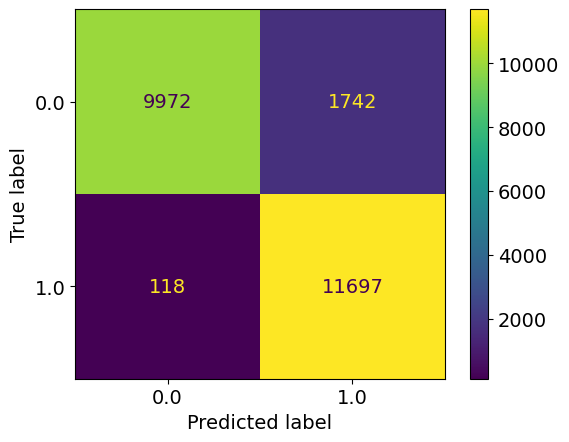

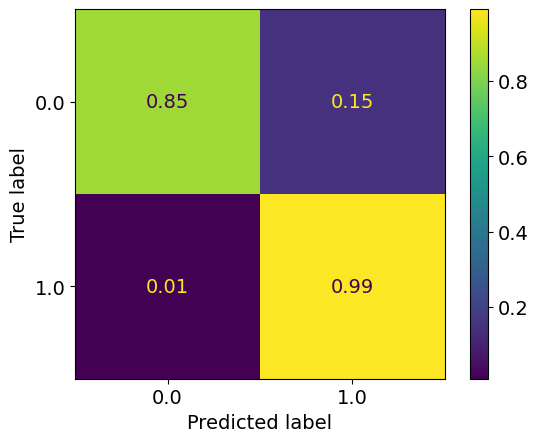

epoch: 290
Learning rate: 9.56091518800029e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.1487960727636222
train acc: 0.94077396


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.97it/s]


test loss: 0.14175952840596437
test acc: 0.941094
epoch: 291
Learning rate: 7.794329076833768e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


train loss: 0.14798264717979795
train acc: 0.94023204


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.17it/s]


test loss: 0.1423258524388075
test acc: 0.94041395
epoch: 292
Learning rate: 6.194309466864034e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14861896178524964
train acc: 0.9399983


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.46it/s]


test loss: 0.14218812566250563
test acc: 0.94058394
epoch: 293
Learning rate: 4.76717090451227e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.45it/s]


train loss: 0.14761981828387377
train acc: 0.94086957


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.27it/s]


test loss: 0.14178435187786817
test acc: 0.94024396
epoch: 294
Learning rate: 3.518545653686456e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14881906169614975
train acc: 0.94093335


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.54it/s]


test loss: 0.1430073892697692
test acc: 0.94020146
epoch: 295
Learning rate: 2.453361467808979e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.1489093447946439
train acc: 0.9402427


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.64it/s]


test loss: 0.14168042093515396
test acc: 0.94020146
epoch: 296
Learning rate: 1.5758221422251474e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.18it/s]


train loss: 0.14822152256965637
train acc: 0.9407846


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.86it/s]


test loss: 0.14130452387034892
test acc: 0.94032896
epoch: 297
Learning rate: 8.893909237434605e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.54it/s]


train loss: 0.1497040224872577
train acc: 0.94009393


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.85it/s]


test loss: 0.14084702041000127
test acc: 0.94032896
epoch: 298
Learning rate: 3.967768427826535e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1477492148898969
train acc: 0.93986017


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.76it/s]


test loss: 0.14117145389318467
test acc: 0.94020146
epoch: 299
Learning rate: 9.992402206632778e-08


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14814112126637416
train acc: 0.94086957


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.89it/s]


test loss: 0.14304611999541522
test acc: 0.94020146


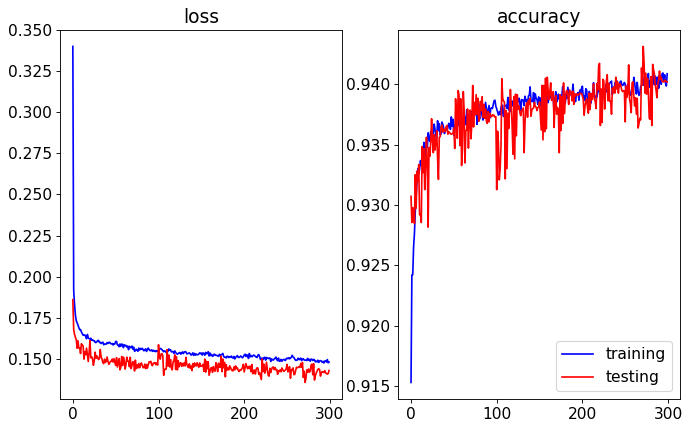

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.11it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


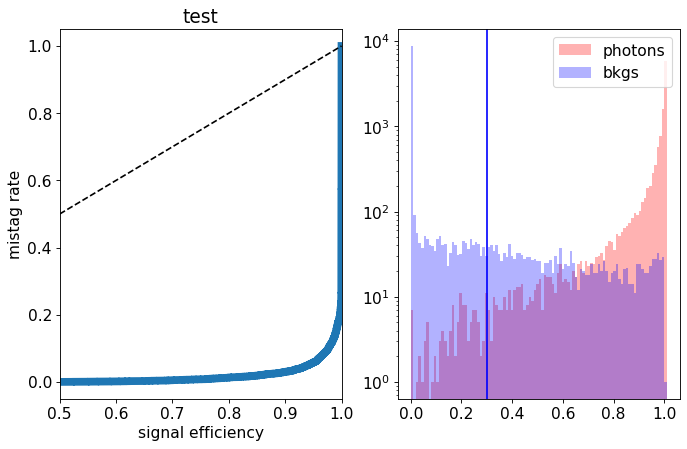

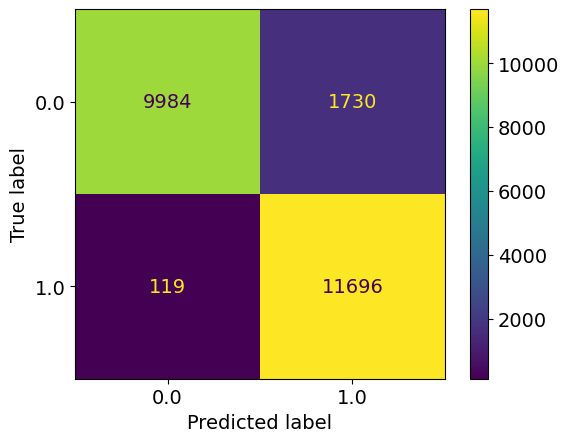

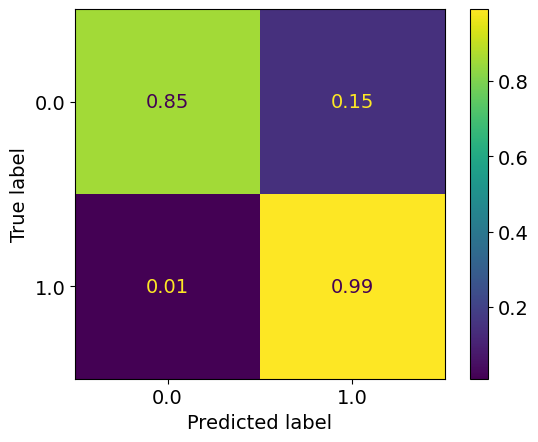

epoch: 300
Learning rate: 4.004058690165735e-12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14980685734634946
train acc: 0.93863827


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.58it/s]


test loss: 0.15066716074943542
test acc: 0.93573886
epoch: 301
Learning rate: 9.99025888725783e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.08it/s]


train loss: 0.14909404449781793
train acc: 0.94010454


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.62it/s]


test loss: 0.14461592063307763
test acc: 0.9397764
epoch: 302
Learning rate: 9.960823902925945e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.15051693232006327
train acc: 0.93913764


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.89it/s]


test loss: 0.1474004967138171
test acc: 0.9388414
epoch: 303
Learning rate: 9.911810813034072e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.09it/s]


train loss: 0.14917797955927575
train acc: 0.9394883


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.80it/s]


test loss: 0.1410317588597536
test acc: 0.941179
epoch: 304
Learning rate: 9.84341304985606e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.148925281396717
train acc: 0.94013643


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.21it/s]


test loss: 0.1426937161013484
test acc: 0.94075394
epoch: 305
Learning rate: 9.755900548115212e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14858802991687872
train acc: 0.94076335


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.55it/s]


test loss: 0.14571749251335858
test acc: 0.93820393
epoch: 306
Learning rate: 9.649618679675236e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.1500790853314339
train acc: 0.94031703


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.66it/s]


test loss: 0.15539247076958418
test acc: 0.9328063
epoch: 307
Learning rate: 9.524986890515297e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14962400206524856
train acc: 0.9398708


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.77it/s]


test loss: 0.1448062652722001
test acc: 0.9386289
epoch: 308
Learning rate: 9.382497045368364e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.1493927344300185
train acc: 0.9406146


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.05it/s]


test loss: 0.1427405819296837
test acc: 0.94062644
epoch: 309
Learning rate: 9.222711486555813e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14928254423437604
train acc: 0.9400408


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.18it/s]


test loss: 0.1381743350997567
test acc: 0.9434315
new best acc: 0.9434315


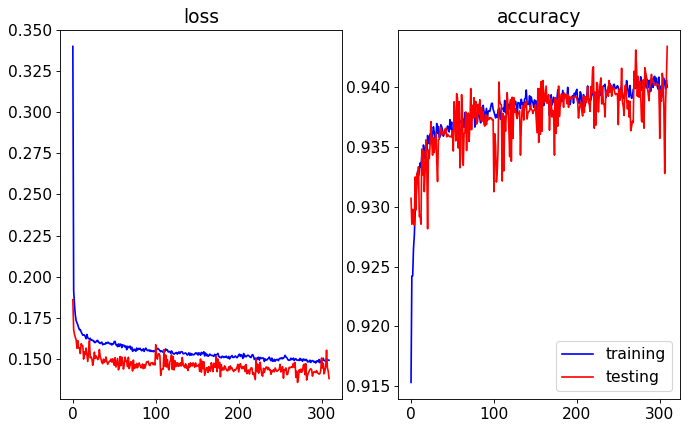

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.65it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


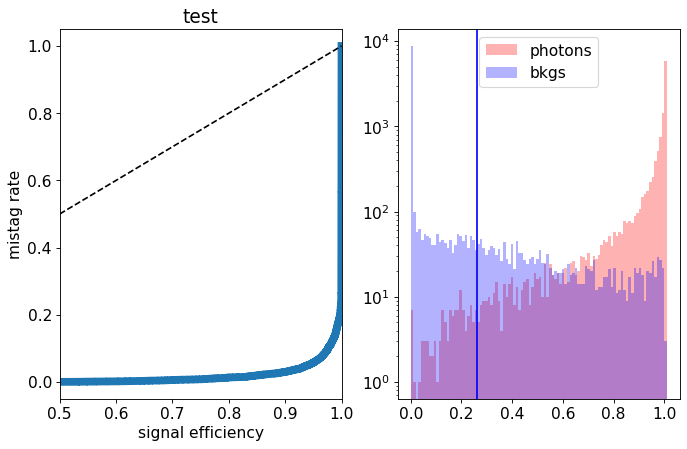

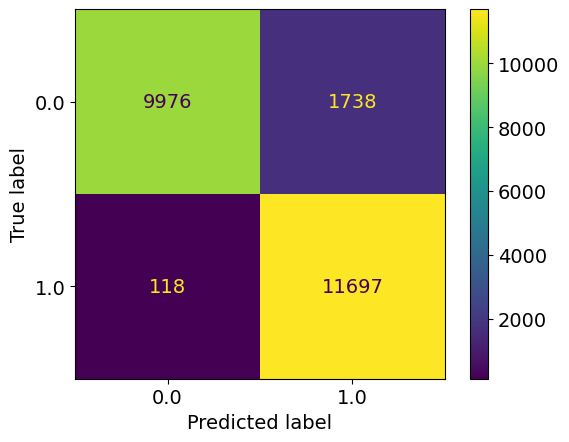

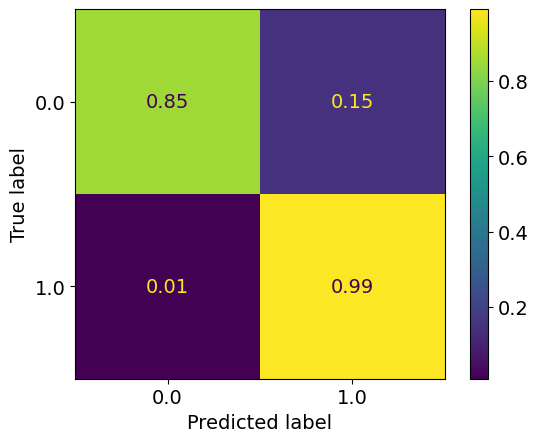

epoch: 310
Learning rate: 9.046260814679199e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.1490702983585133
train acc: 0.9404871


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.11it/s]


test loss: 0.14067886751145126
test acc: 0.94143397
epoch: 311
Learning rate: 8.853841399927774e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14986953661320315
train acc: 0.9396477


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.69it/s]


test loss: 0.13805275820195675
test acc: 0.942964
epoch: 312
Learning rate: 8.646212633823493e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1481657993926364
train acc: 0.9402639


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.00it/s]


test loss: 0.13838629182428122
test acc: 0.94147646
epoch: 313
Learning rate: 8.42419393224961e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.14815008920279277
train acc: 0.9403702


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.35it/s]


test loss: 0.14398842193186284
test acc: 0.94007397
epoch: 314
Learning rate: 8.188661501590543e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14902214013087522
train acc: 0.9402427


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.59it/s]


test loss: 0.1369955690577626
test acc: 0.9429215
epoch: 315
Learning rate: 7.940544880745565e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1487142113363667
train acc: 0.9405296


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.86it/s]


test loss: 0.1454859869554639
test acc: 0.9396914
epoch: 316
Learning rate: 7.680823272663455e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.1499755500703101
train acc: 0.94023204


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.95it/s]


test loss: 0.14346961230039595
test acc: 0.9386289
epoch: 317
Learning rate: 7.410521679875796e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.14797717869091945
train acc: 0.94027454


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.55it/s]


test loss: 0.1484398826956749
test acc: 0.9367164
epoch: 318
Learning rate: 7.130706859280269e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.05it/s]


train loss: 0.1488909095905389
train acc: 0.9405402


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.21it/s]


test loss: 0.14047174379229546
test acc: 0.9410515
epoch: 319
Learning rate: 6.842483112138533e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1488584877958723
train acc: 0.9404871


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.02it/s]


test loss: 0.13934038896113635
test acc: 0.942199


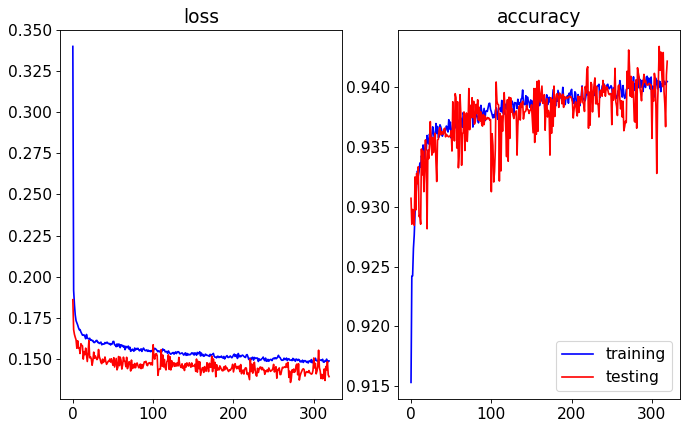

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.18it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


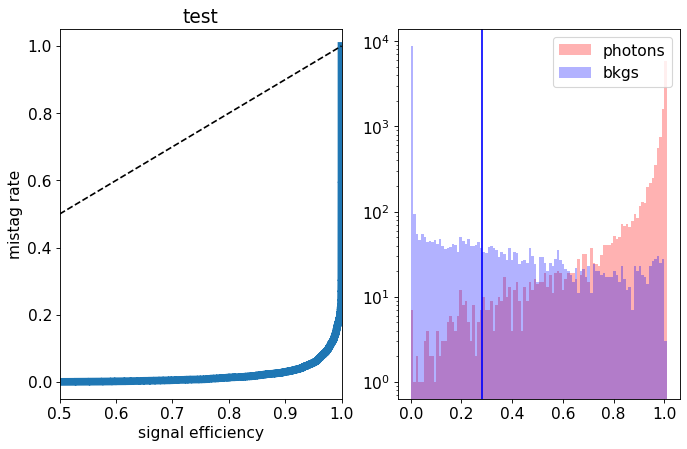

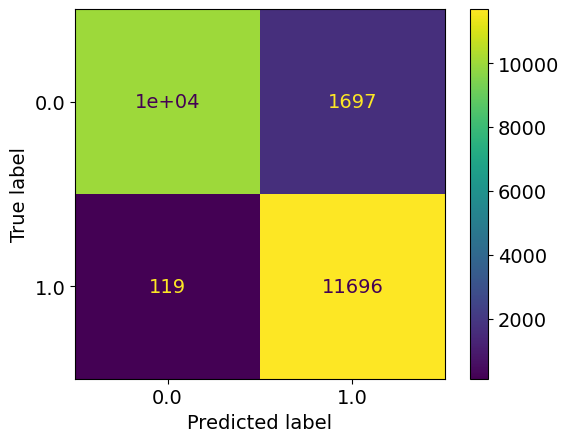

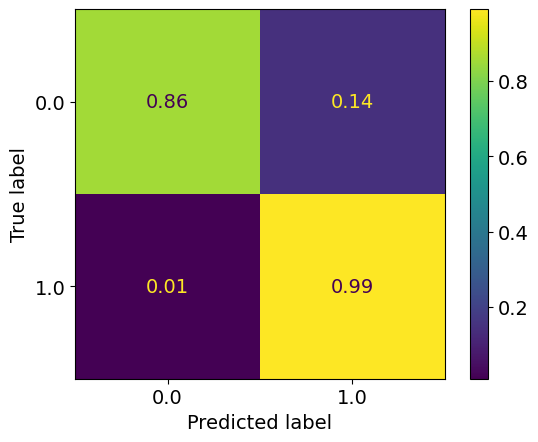

epoch: 320
Learning rate: 6.546987925903652e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.17it/s]


train loss: 0.1482300605079171
train acc: 0.94010454


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.63it/s]


test loss: 0.1436101110652089
test acc: 0.94028646
epoch: 321
Learning rate: 6.245387485076784e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1484094119755326
train acc: 0.9405296


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.11it/s]


test loss: 0.13731398563832045
test acc: 0.9423265
epoch: 322
Learning rate: 5.93887206880974e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14785748781861774
train acc: 0.94072086


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.97it/s]


test loss: 0.14311004821211099
test acc: 0.9396914
epoch: 323
Learning rate: 5.6286513534169517e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.01it/s]


train loss: 0.14871996830982767
train acc: 0.94018954


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.16it/s]


test loss: 0.13990978822112082
test acc: 0.9424115
epoch: 324
Learning rate: 5.315949638335711e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14871512557480746
train acc: 0.9406677


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.27it/s]


test loss: 0.14401201736181973
test acc: 0.93888396
epoch: 325
Learning rate: 5.00200101437562e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


train loss: 0.1490498341287777
train acc: 0.94115645


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.38it/s]


test loss: 0.14213295876979828
test acc: 0.94049895
epoch: 326
Learning rate: 4.6880444933259634e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14895760125605165
train acc: 0.94073147


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.84it/s]


test loss: 0.14183975700289012
test acc: 0.941009
epoch: 327
Learning rate: 4.375319118142234e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1484360145820174
train acc: 0.9404871


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.98it/s]


test loss: 0.14239221177995204
test acc: 0.9397764
epoch: 328
Learning rate: 4.06505907300965e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


train loss: 0.1475493692953116
train acc: 0.9410821


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.93it/s]


test loss: 0.14287311248481274
test acc: 0.94024396
epoch: 329
Learning rate: 3.758488812582018e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14742175556102377
train acc: 0.94064647


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.84it/s]


test loss: 0.14206814300268888
test acc: 0.941179


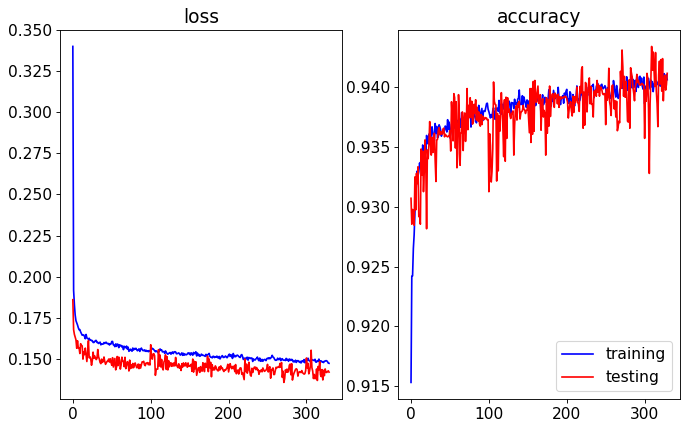

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.16it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


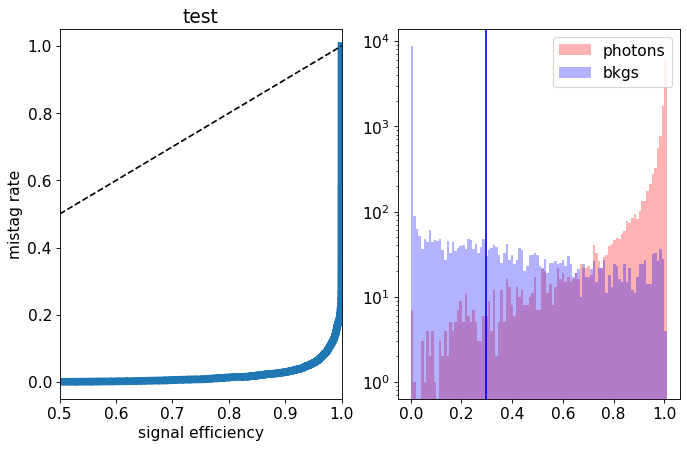

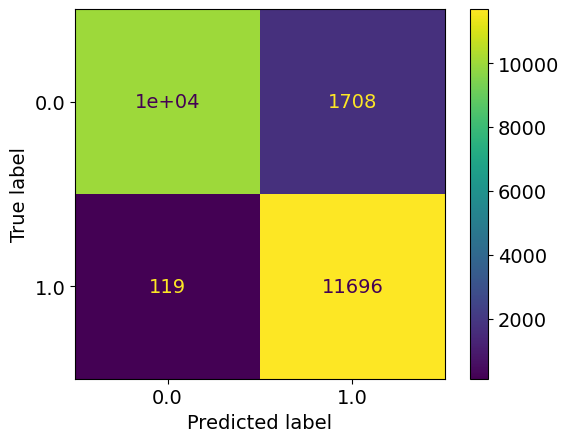

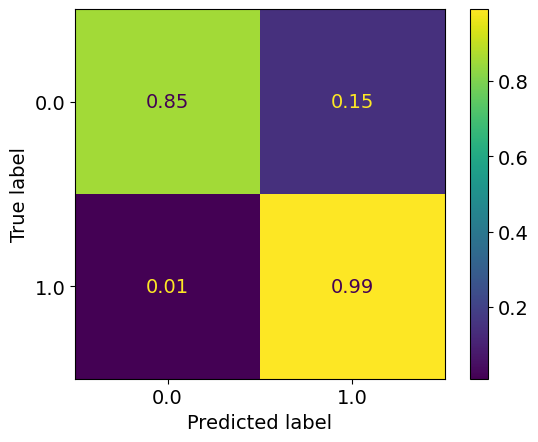

epoch: 330
Learning rate: 3.4568182296186134e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.11it/s]


train loss: 0.1476911799448311
train acc: 0.9403277


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.35it/s]


test loss: 0.1453299717977643
test acc: 0.93896896
epoch: 331
Learning rate: 3.161237880090216e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.1479638633644505
train acc: 0.94089085


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.70it/s]


test loss: 0.14106704480946064
test acc: 0.94066894
epoch: 332
Learning rate: 2.8729142845985978e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.1485712731340129
train acc: 0.9405721


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.60it/s]


test loss: 0.14185735154896975
test acc: 0.94058394
epoch: 333
Learning rate: 2.5929853246526404e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.03it/s]


train loss: 0.14788564659987286
train acc: 0.94089085


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.98it/s]


test loss: 0.1402207087725401
test acc: 0.942029
epoch: 334
Learning rate: 2.3225557519698758e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14876143733976752
train acc: 0.9404446


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.25it/s]


test loss: 0.14079467132687568
test acc: 0.94079643
epoch: 335
Learning rate: 2.0626928285261642e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.10it/s]


train loss: 0.1484215524830636
train acc: 0.9404871


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.92it/s]


test loss: 0.14463835451751947
test acc: 0.9387139
epoch: 336
Learning rate: 1.8144221145602574e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.54it/s]


train loss: 0.14814937774352965
train acc: 0.9403702


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.47it/s]


test loss: 0.14095804691314698
test acc: 0.94139147
epoch: 337
Learning rate: 1.5787234211560807e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.1483684220131795
train acc: 0.9413052


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.22it/s]


test loss: 0.14099284689873456
test acc: 0.9421565
epoch: 338
Learning rate: 1.3565269433760108e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.17it/s]


train loss: 0.14778155330449913
train acc: 0.9404977


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.34it/s]


test loss: 0.14013834875077008
test acc: 0.9418165
epoch: 339
Learning rate: 1.1487095892059296e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.55it/s]


train loss: 0.1475950102707383
train acc: 0.9405296


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.72it/s]


test loss: 0.14170090947300196
test acc: 0.94075394


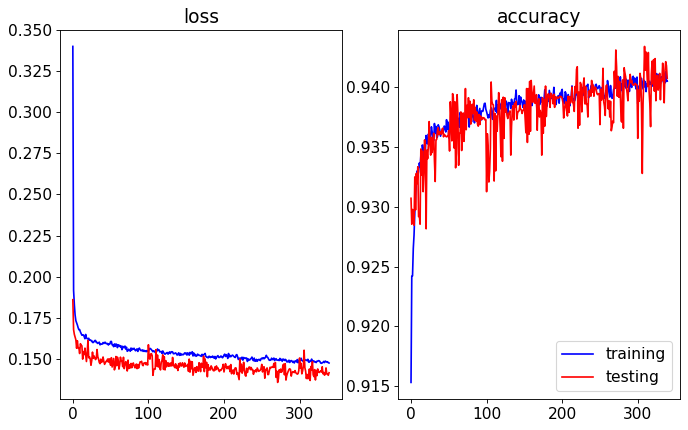

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.82it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


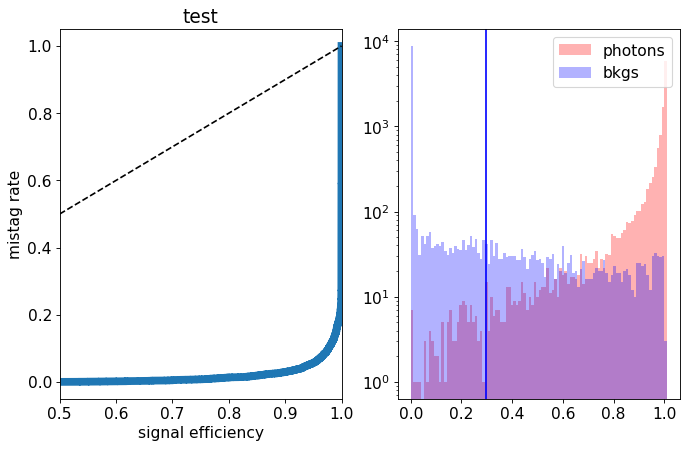

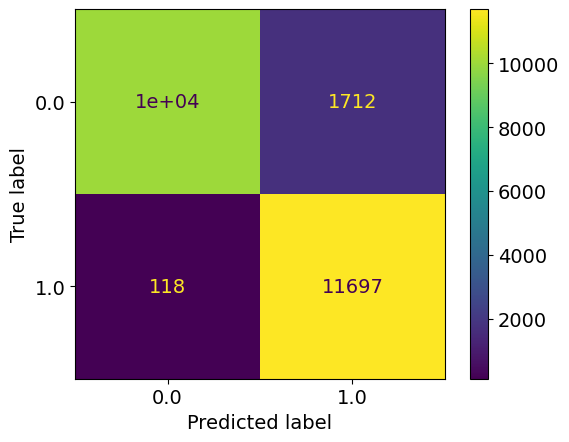

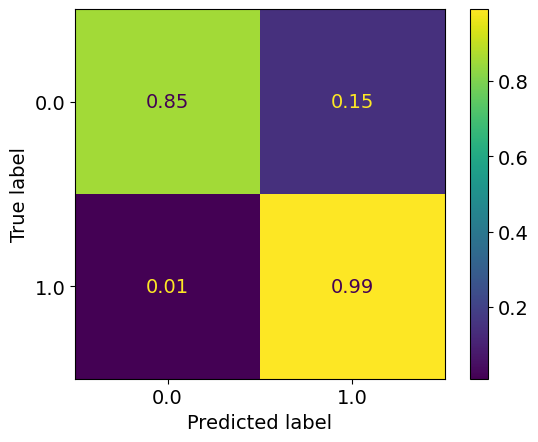

epoch: 340
Learning rate: 9.56091518800029e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.10it/s]


train loss: 0.1476486299163217
train acc: 0.9407952


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.41it/s]


test loss: 0.14107167553156613
test acc: 0.94071144
epoch: 341
Learning rate: 7.794329076833768e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.14745769977189932
train acc: 0.94119895


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.67it/s]


test loss: 0.14069492053240537
test acc: 0.94075394
epoch: 342
Learning rate: 6.194309466864034e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.45it/s]


train loss: 0.1476990658861057
train acc: 0.9404339


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.52it/s]


test loss: 0.1413252741098404
test acc: 0.94160396
epoch: 343
Learning rate: 4.76717090451227e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14696562612891956
train acc: 0.9413583


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.24it/s]


test loss: 0.14120338577777147
test acc: 0.94143397
epoch: 344
Learning rate: 3.518545653686456e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.1473467565930573
train acc: 0.9405933


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.99it/s]


test loss: 0.14202325604856014
test acc: 0.94062644
epoch: 345
Learning rate: 2.453361467808979e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.13it/s]


train loss: 0.14603180034904722
train acc: 0.94068897


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.30it/s]


test loss: 0.1410046722739935
test acc: 0.941094
epoch: 346
Learning rate: 1.5758221422251474e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.14725484148522092
train acc: 0.9407846


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.42it/s]


test loss: 0.14118321016430854
test acc: 0.9409665
epoch: 347
Learning rate: 8.893909237434605e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1484939336397086
train acc: 0.9403489


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.90it/s]


test loss: 0.14176865126937627
test acc: 0.9411365
epoch: 348
Learning rate: 3.967768427826535e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14724004728968737
train acc: 0.9412627


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.86it/s]


test loss: 0.14072448369115592
test acc: 0.941094
epoch: 349
Learning rate: 9.992402206632778e-08


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.1477401672275203
train acc: 0.9404658


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.71it/s]


test loss: 0.14309593252837657
test acc: 0.9411365


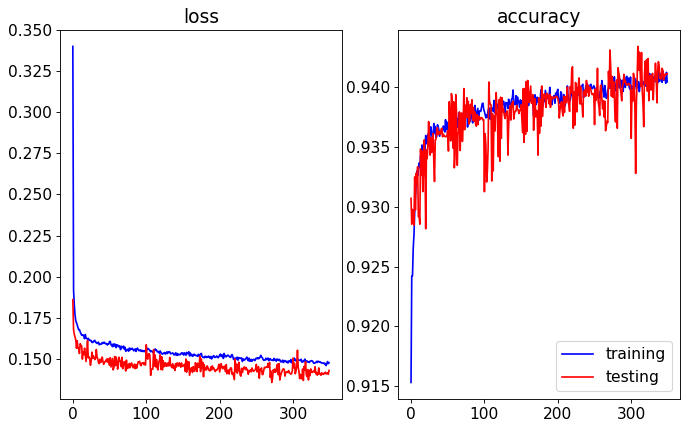

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.25it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


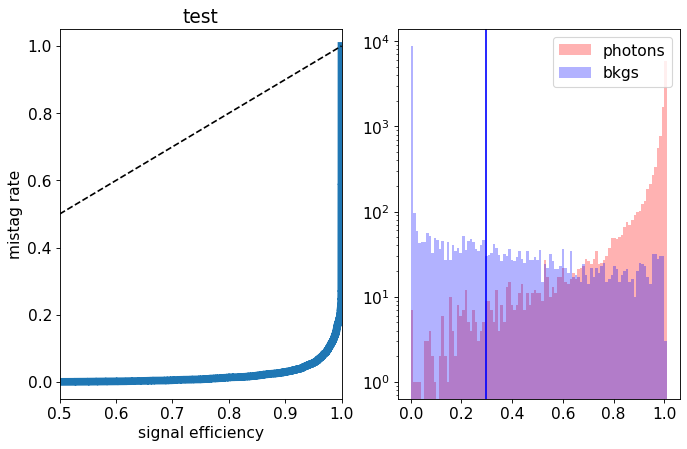

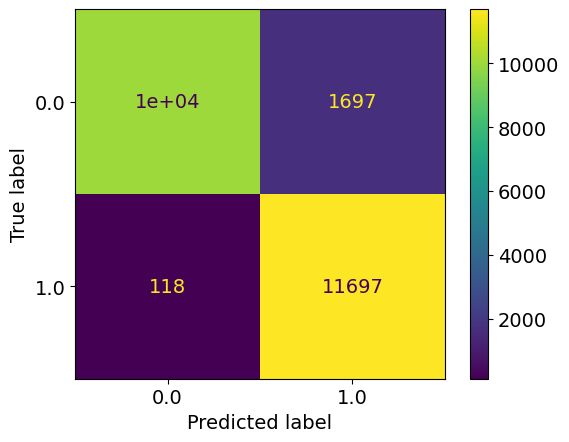

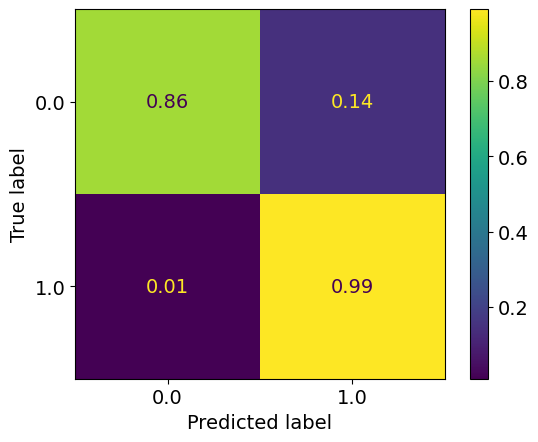

epoch: 350
Learning rate: 4.004058690165735e-12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.13it/s]


train loss: 0.14827690335216037
train acc: 0.9404339


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.18it/s]


test loss: 0.14359570164233446
test acc: 0.93892646
epoch: 351
Learning rate: 9.99025888725783e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14936642586045965
train acc: 0.9400408


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.38it/s]


test loss: 0.1418597549200058
test acc: 0.94058394
epoch: 352
Learning rate: 9.960823902925945e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.14852497873792223
train acc: 0.9402958


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.07it/s]


test loss: 0.14066695142537355
test acc: 0.9411365
epoch: 353
Learning rate: 9.911810813034072e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.1474304943327691
train acc: 0.9403914


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.81it/s]


test loss: 0.14006742555648088
test acc: 0.94160396
epoch: 354
Learning rate: 9.84341304985606e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14823246282187236
train acc: 0.94073147


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.16it/s]


test loss: 0.140860297344625
test acc: 0.94075394
epoch: 355
Learning rate: 9.755900548115212e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


train loss: 0.14752499374804223
train acc: 0.9401258


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.25it/s]


test loss: 0.14039290938526391
test acc: 0.943389
epoch: 356
Learning rate: 9.649618679675236e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1478105963320489
train acc: 0.9407421


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.72it/s]


test loss: 0.14193323645740746
test acc: 0.94011647
epoch: 357
Learning rate: 9.524986890515297e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.16it/s]


train loss: 0.1484341193346461
train acc: 0.9405189


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.58it/s]


test loss: 0.14452716708183289
test acc: 0.9385864
epoch: 358
Learning rate: 9.382497045368364e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1471408540560941
train acc: 0.94081646


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.19it/s]


test loss: 0.14519309662282467
test acc: 0.93888396
epoch: 359
Learning rate: 9.222711486555813e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14855639802612317
train acc: 0.9403064


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.87it/s]


test loss: 0.1351096410304308
test acc: 0.94534403
new best acc: 0.94534403


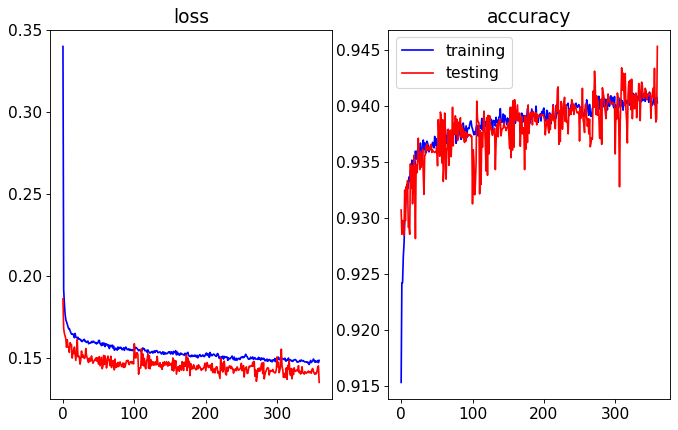

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.69it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


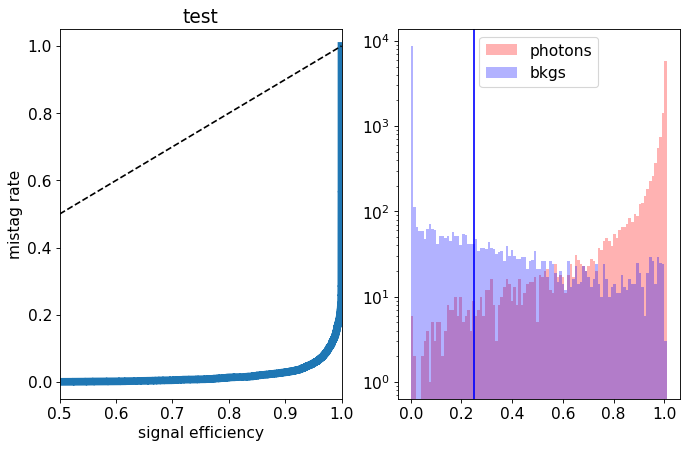

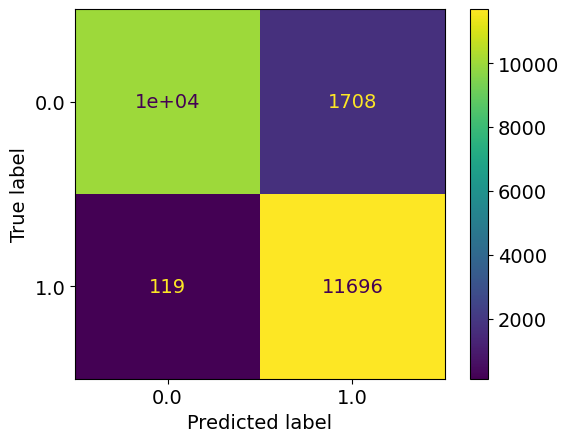

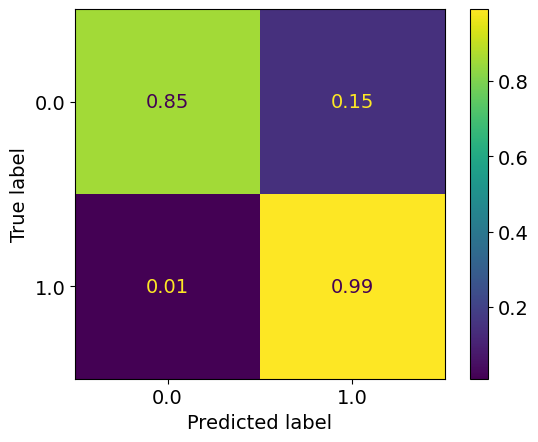

epoch: 360
Learning rate: 9.046260814679199e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1480974159707689
train acc: 0.9403808


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 13.97it/s]


test loss: 0.13774537462741138
test acc: 0.9431765
epoch: 361
Learning rate: 8.853841399927774e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14696012465817154
train acc: 0.9412521


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.65it/s]


test loss: 0.13868250334635376
test acc: 0.942454
epoch: 362
Learning rate: 8.646212633823493e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.14it/s]


train loss: 0.14829683683480427
train acc: 0.94111395


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.69it/s]


test loss: 0.14051938094198704
test acc: 0.9425815
epoch: 363
Learning rate: 8.42419393224961e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14891224084006752
train acc: 0.9403914


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.23it/s]


test loss: 0.1445460332557559
test acc: 0.9374389
epoch: 364
Learning rate: 8.188661501590543e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14847906451126572
train acc: 0.93986017


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.67it/s]


test loss: 0.14267714731395245
test acc: 0.9413065
epoch: 365
Learning rate: 7.940544880745565e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.14803109280053217
train acc: 0.9403596


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.58it/s]


test loss: 0.148085630312562
test acc: 0.9366314
epoch: 366
Learning rate: 7.680823272663455e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1478316677603752
train acc: 0.9405296


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.66it/s]


test loss: 0.1404187573119998
test acc: 0.9427515
epoch: 367
Learning rate: 7.410521679875796e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.17it/s]


train loss: 0.14762141603003642
train acc: 0.9406677


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.96it/s]


test loss: 0.14204763174057006
test acc: 0.94151896
epoch: 368
Learning rate: 7.130706859280269e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14784560594589088
train acc: 0.9413265


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.44it/s]


test loss: 0.14250189568847418
test acc: 0.94003147
epoch: 369
Learning rate: 6.842483112138533e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.146739057294882
train acc: 0.9411352


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.23it/s]


test loss: 0.1447363371029496
test acc: 0.939904


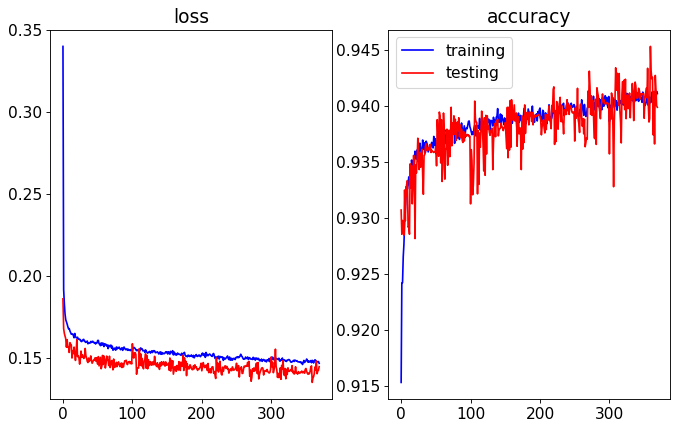

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.60it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


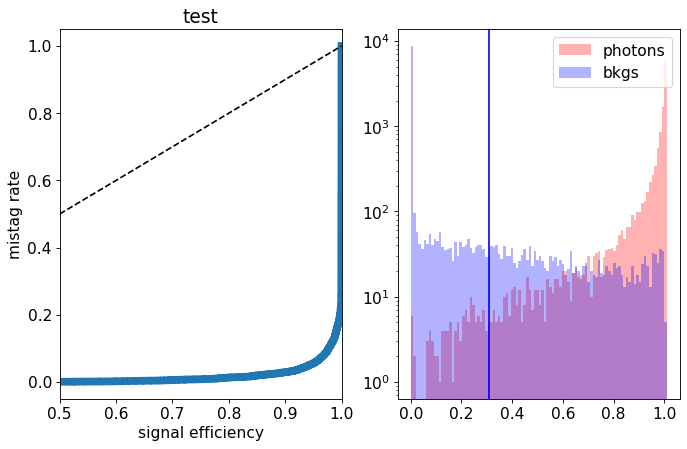

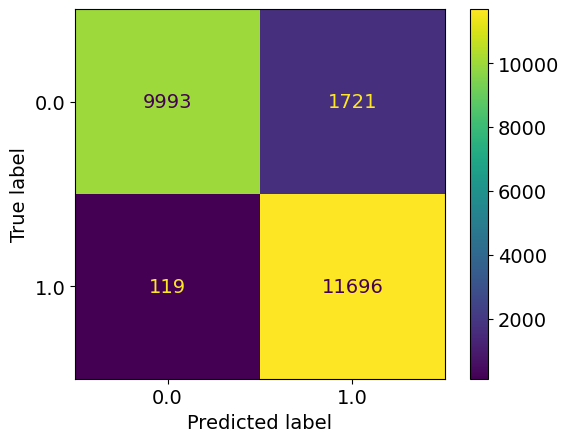

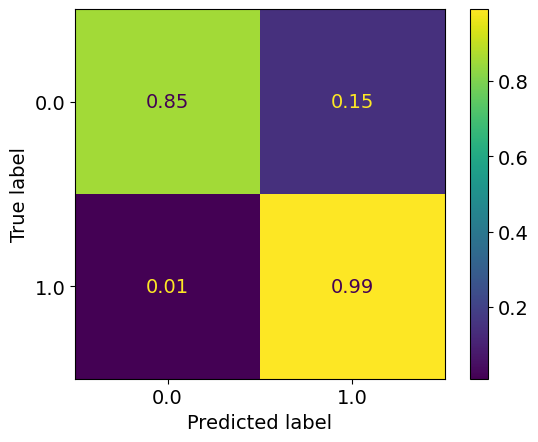

epoch: 370
Learning rate: 6.546987925903652e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.46it/s]


train loss: 0.14778143879334638
train acc: 0.9405189


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.28it/s]


test loss: 0.13537874761968852
test acc: 0.944069
epoch: 371
Learning rate: 6.245387485076784e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14803699128756856
train acc: 0.9406358


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.39it/s]


test loss: 0.14028068762272597
test acc: 0.942199
epoch: 372
Learning rate: 5.93887206880974e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.09it/s]


train loss: 0.14760342824041464
train acc: 0.94089085


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.44it/s]


test loss: 0.1412224393337965
test acc: 0.9411365
epoch: 373
Learning rate: 5.6286513534169517e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.14713759558975317
train acc: 0.94101834


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.54it/s]


test loss: 0.1437636809423566
test acc: 0.939989
epoch: 374
Learning rate: 5.315949638335711e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.14it/s]


train loss: 0.14717478812879817
train acc: 0.9411671


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.90it/s]


test loss: 0.14669038094580172
test acc: 0.9376514
epoch: 375
Learning rate: 5.00200101437562e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1481542680293891
train acc: 0.940604


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.21it/s]


test loss: 0.14280128497630357
test acc: 0.93956393
epoch: 376
Learning rate: 4.6880444933259634e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14675018941141238
train acc: 0.9408802


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.77it/s]


test loss: 0.13891726154834033
test acc: 0.9426665
epoch: 377
Learning rate: 4.375319118142234e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.19it/s]


train loss: 0.14640170943205524
train acc: 0.9413371


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.24it/s]


test loss: 0.13699136283248664
test acc: 0.94500405
epoch: 378
Learning rate: 4.06505907300965e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.1464940604225845
train acc: 0.94164526


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.25it/s]


test loss: 0.1407368466258049
test acc: 0.9426665
epoch: 379
Learning rate: 3.758488812582018e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14801312968799263
train acc: 0.94093335


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.38it/s]


test loss: 0.1409681061282754
test acc: 0.9419015


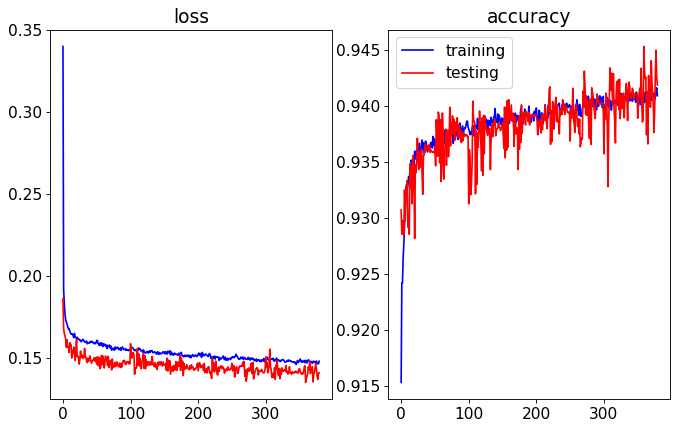

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.76it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


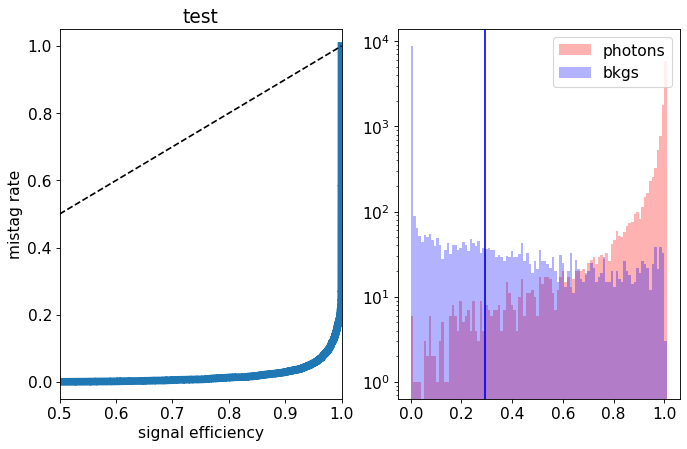

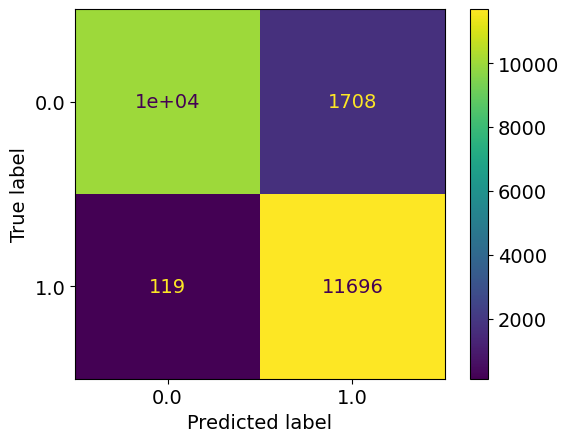

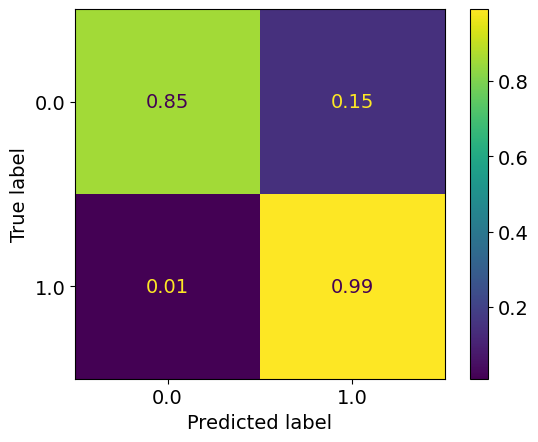

epoch: 380
Learning rate: 3.4568182296186134e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1468964800428433
train acc: 0.94094396


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.97it/s]


test loss: 0.14346666689962148
test acc: 0.93943644
epoch: 381
Learning rate: 3.161237880090216e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14654669716100024
train acc: 0.941369


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.42it/s]


test loss: 0.14227261394262314
test acc: 0.94032896
epoch: 382
Learning rate: 2.8729142845985978e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.05it/s]


train loss: 0.14570810830896827
train acc: 0.9414646


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.51it/s]


test loss: 0.13741679005324842
test acc: 0.9433465
epoch: 383
Learning rate: 2.5929853246526404e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.1473365915808708
train acc: 0.9411777


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.93it/s]


test loss: 0.14289492536336185
test acc: 0.9409665
epoch: 384
Learning rate: 2.3225557519698758e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.13it/s]


train loss: 0.14711179655448647
train acc: 0.9413158


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.36it/s]


test loss: 0.13949533849954604
test acc: 0.94270897
epoch: 385
Learning rate: 2.0626928285261642e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14721968352415
train acc: 0.94127333


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.40it/s]


test loss: 0.1389469809830189
test acc: 0.9418165
epoch: 386
Learning rate: 1.8144221145602574e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.1463833478795495
train acc: 0.9412202


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.69it/s]


test loss: 0.14055706467479467
test acc: 0.94143397
epoch: 387
Learning rate: 1.5787234211560807e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.14it/s]


train loss: 0.14709746638301072
train acc: 0.94103956


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.97it/s]


test loss: 0.1409774275496602
test acc: 0.941009
epoch: 388
Learning rate: 1.3565269433760108e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14667993712766914
train acc: 0.94118834


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.66it/s]


test loss: 0.13965726122260094
test acc: 0.941859
epoch: 389
Learning rate: 1.1487095892059296e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


train loss: 0.14792959619859222
train acc: 0.9403596


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.07it/s]


test loss: 0.14135309178382158
test acc: 0.9421565


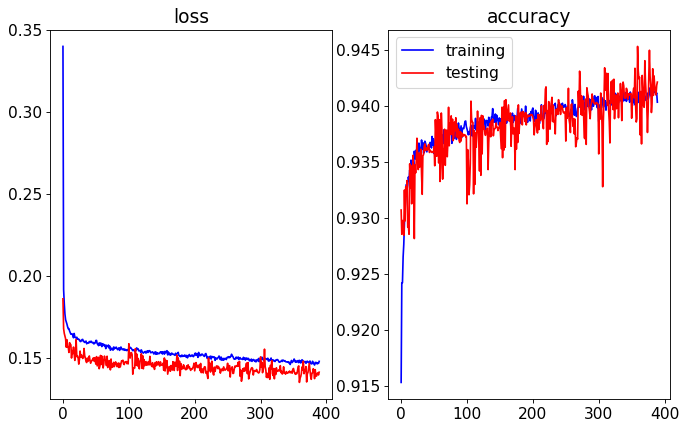

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.12it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


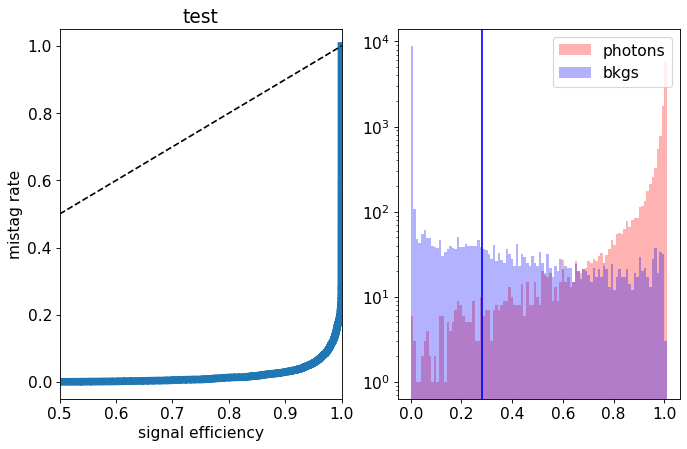

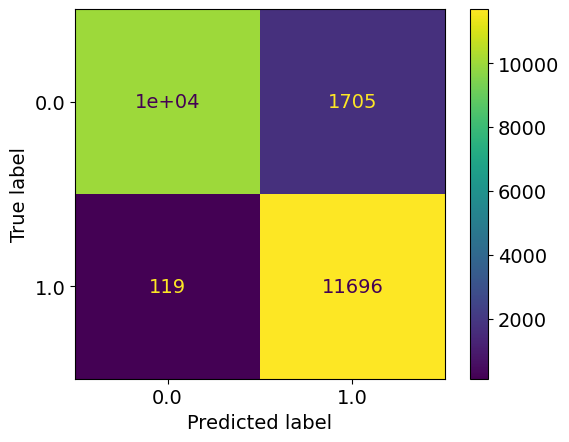

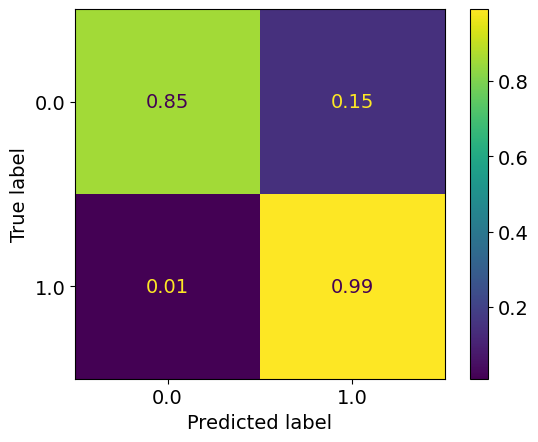

epoch: 390
Learning rate: 9.56091518800029e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14628532471930145
train acc: 0.9413158


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.57it/s]


test loss: 0.13994873594492674
test acc: 0.942454
epoch: 391
Learning rate: 7.794329076833768e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14602490443332938
train acc: 0.9421765


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.75it/s]


test loss: 0.13889074604958296
test acc: 0.942879
epoch: 392
Learning rate: 6.194309466864034e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14574300246253893
train acc: 0.941284


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.12it/s]


test loss: 0.14094935301691294
test acc: 0.9412215
epoch: 393
Learning rate: 4.76717090451227e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14614721772017752
train acc: 0.9407952


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.41it/s]


test loss: 0.14062481559813023
test acc: 0.9428365
epoch: 394
Learning rate: 3.518545653686456e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.09it/s]


train loss: 0.1458960882607539
train acc: 0.94168776


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.63it/s]


test loss: 0.14076849464327096
test acc: 0.942029
epoch: 395
Learning rate: 2.453361467808979e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.14645727372663037
train acc: 0.9415071


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.38it/s]


test loss: 0.1391629470512271
test acc: 0.942369
epoch: 396
Learning rate: 1.5758221422251474e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14510133653689342
train acc: 0.94181526


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.25it/s]


test loss: 0.14056908823549746
test acc: 0.942284
epoch: 397
Learning rate: 8.893909237434605e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.54it/s]


train loss: 0.14715813199995428
train acc: 0.94198525


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.06it/s]


test loss: 0.13923757262527942
test acc: 0.942284
epoch: 398
Learning rate: 3.967768427826535e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14726065820569445
train acc: 0.94080585


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.65it/s]


test loss: 0.13891647551208736
test acc: 0.9421565
epoch: 399
Learning rate: 9.992402206632778e-08


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.10it/s]


train loss: 0.14657727002528062
train acc: 0.94100773


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.23it/s]


test loss: 0.1407102696597576
test acc: 0.9421565


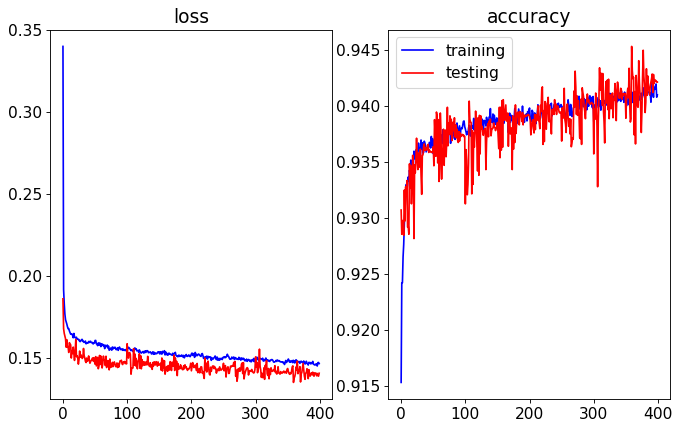

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.16it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


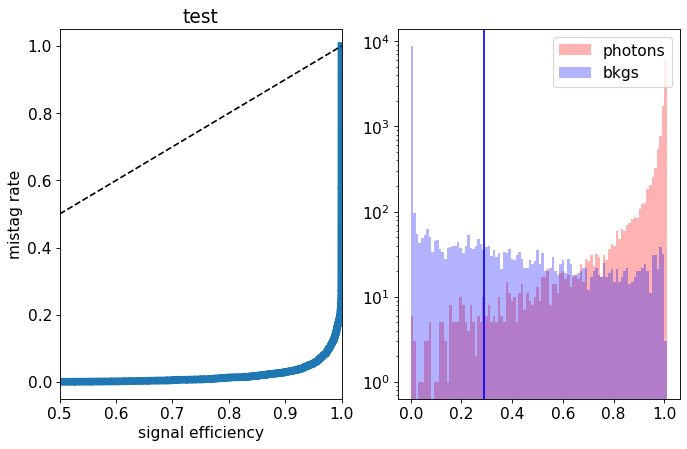

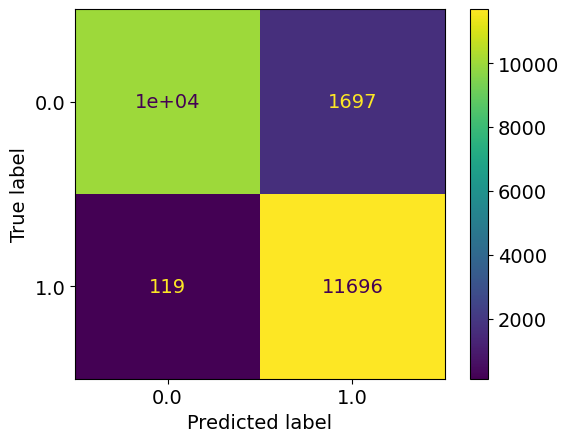

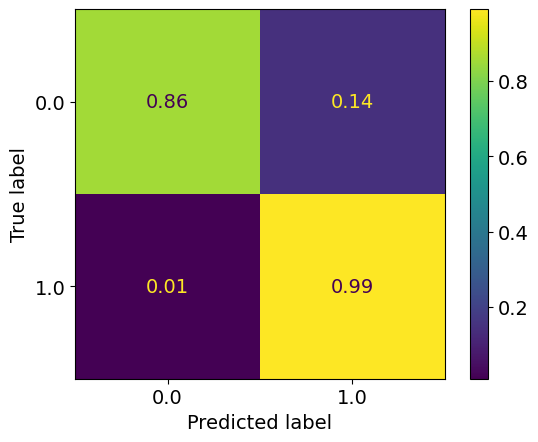

epoch: 400
Learning rate: 4.004058690165735e-12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.147207737063906
train acc: 0.9402002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.94it/s]


test loss: 0.14091569576412438
test acc: 0.9423265
epoch: 401
Learning rate: 9.99025888725783e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.03it/s]


train loss: 0.14765921292031647
train acc: 0.94093335


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.67it/s]


test loss: 0.1446995597332716
test acc: 0.939989
epoch: 402
Learning rate: 9.960823902925945e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14680427825374967
train acc: 0.94101834


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.13it/s]


test loss: 0.13960786070674658
test acc: 0.9421565
epoch: 403
Learning rate: 9.911810813034072e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.14693318108084855
train acc: 0.94123083


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.05it/s]


test loss: 0.13864929582923652
test acc: 0.943049
epoch: 404
Learning rate: 9.84341304985606e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  4.94it/s]


train loss: 0.1471621656588688
train acc: 0.9402002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.39it/s]


test loss: 0.13951870072633027
test acc: 0.94079643
epoch: 405
Learning rate: 9.755900548115212e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.55it/s]


train loss: 0.14846785105527585
train acc: 0.94096524


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.27it/s]


test loss: 0.13835141342133284
test acc: 0.942624
epoch: 406
Learning rate: 9.649618679675236e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


train loss: 0.14684701331291988
train acc: 0.9411246


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.90it/s]


test loss: 0.1464734271168709
test acc: 0.93922395
epoch: 407
Learning rate: 9.524986890515297e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.14750202669269719
train acc: 0.9405933


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.13it/s]


test loss: 0.13782773911952972
test acc: 0.943304
epoch: 408
Learning rate: 9.382497045368364e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.1475690134391663
train acc: 0.94017893


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.93it/s]


test loss: 0.1434194553643465
test acc: 0.9387989
epoch: 409
Learning rate: 9.222711486555813e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.16it/s]


train loss: 0.14754877353359938
train acc: 0.94081646


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.23it/s]


test loss: 0.13836269229650497
test acc: 0.94134897


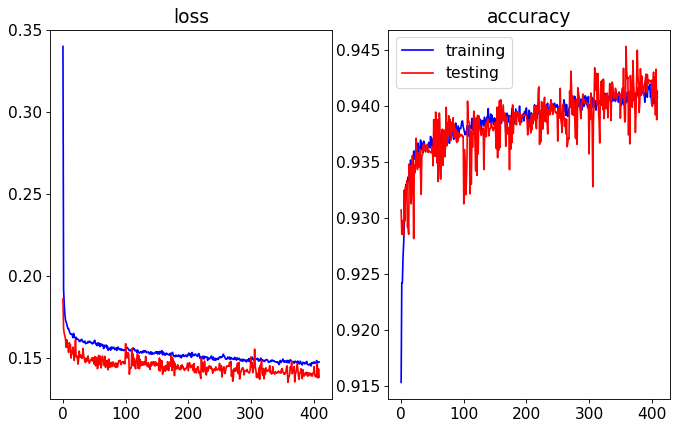

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.88it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


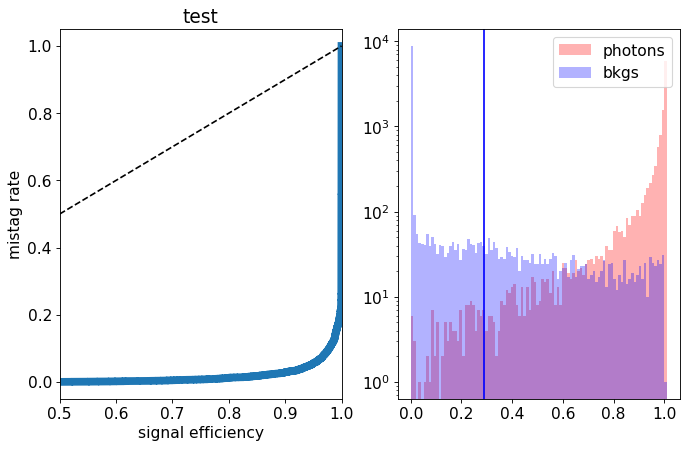

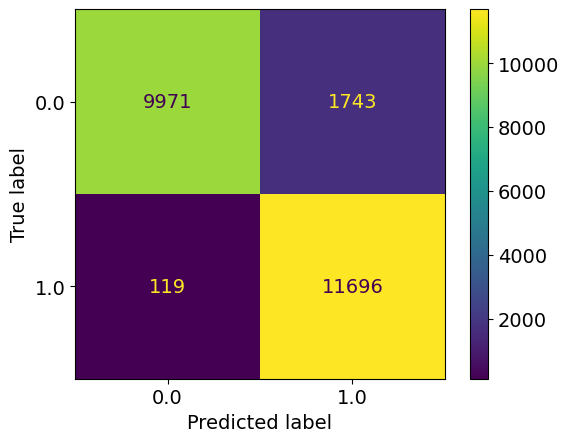

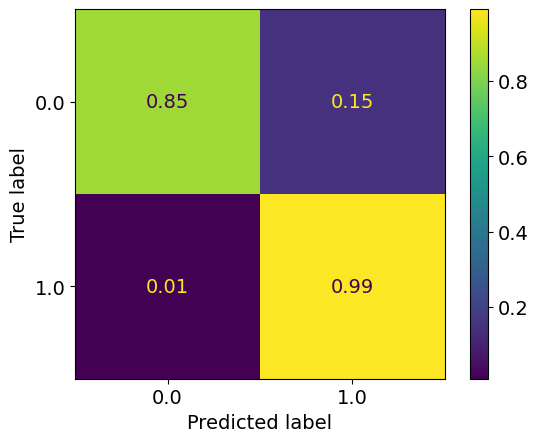

epoch: 410
Learning rate: 9.046260814679199e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14778742379253837
train acc: 0.94084835


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.59it/s]


test loss: 0.14043296445161105
test acc: 0.9409665
epoch: 411
Learning rate: 8.853841399927774e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.13it/s]


train loss: 0.14602601651553135
train acc: 0.9413477


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.78it/s]


test loss: 0.14131225682795048
test acc: 0.93952143
epoch: 412
Learning rate: 8.646212633823493e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14740868411056554
train acc: 0.94097584


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.63it/s]


test loss: 0.14615614656358958
test acc: 0.9365039
epoch: 413
Learning rate: 8.42419393224961e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.14767742546121027
train acc: 0.94102895


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.03it/s]


test loss: 0.14304489642381668
test acc: 0.94028646
epoch: 414
Learning rate: 8.188661501590543e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.54it/s]


train loss: 0.14646184871530837
train acc: 0.94184715


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.04it/s]


test loss: 0.1399732368066907
test acc: 0.942964
epoch: 415
Learning rate: 7.940544880745565e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14699664284848862
train acc: 0.9411352


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.65it/s]


test loss: 0.1374204069375992
test acc: 0.9431765
epoch: 416
Learning rate: 7.680823272663455e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.08it/s]


train loss: 0.14638903608937173
train acc: 0.94085896


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.74it/s]


test loss: 0.1365146553143859
test acc: 0.9430915
epoch: 417
Learning rate: 7.410521679875796e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.54it/s]


train loss: 0.14624760560928637
train acc: 0.94119895


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.42it/s]


test loss: 0.14103959389030934
test acc: 0.94054145
epoch: 418
Learning rate: 7.130706859280269e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.14693333355674318
train acc: 0.9413902


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.00it/s]


test loss: 0.13741594031453133
test acc: 0.943219
epoch: 419
Learning rate: 6.842483112138533e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.11it/s]


train loss: 0.14622661395437397
train acc: 0.9415496


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.17it/s]


test loss: 0.14023272022604943
test acc: 0.94164646


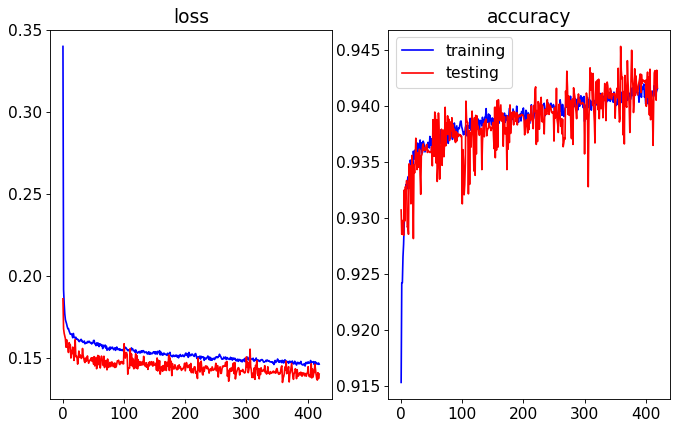

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.39it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


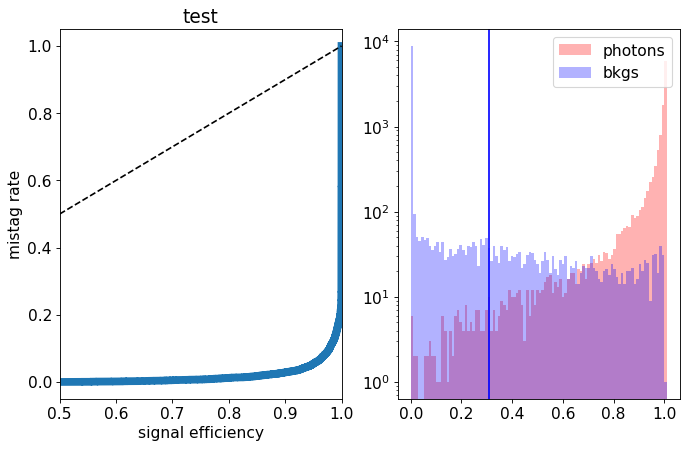

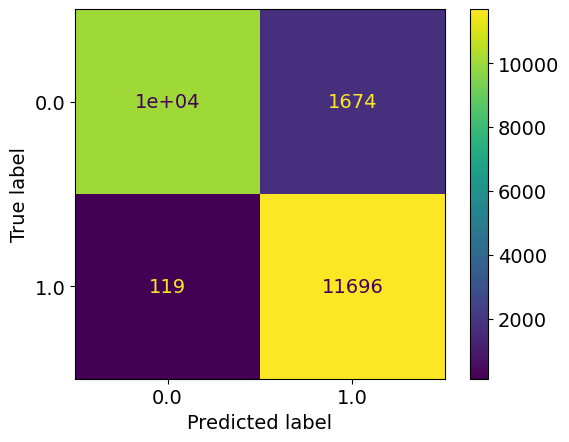

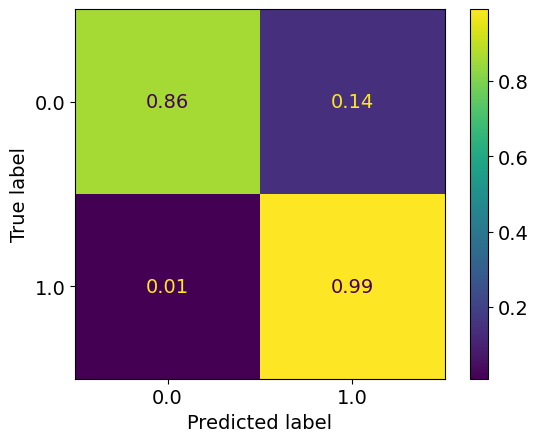

epoch: 420
Learning rate: 6.546987925903652e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14620587675814417
train acc: 0.94099706


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.13it/s]


test loss: 0.143870141915977
test acc: 0.94020146
epoch: 421
Learning rate: 6.245387485076784e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.10it/s]


train loss: 0.14687419350549674
train acc: 0.94188964


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.32it/s]


test loss: 0.13996763043105603
test acc: 0.94147646
epoch: 422
Learning rate: 5.93887206880974e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14634004771519618
train acc: 0.9417515


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.27it/s]


test loss: 0.14188642390072345
test acc: 0.9422415
epoch: 423
Learning rate: 5.6286513534169517e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.1461579366854042
train acc: 0.94207025


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.77it/s]


test loss: 0.14327093940228225
test acc: 0.9397764
epoch: 424
Learning rate: 5.315949638335711e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14640946534408886
train acc: 0.94127333


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.71it/s]


test loss: 0.13810564819723367
test acc: 0.9429215
epoch: 425
Learning rate: 5.00200101437562e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14682547159635337
train acc: 0.9418365


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.46it/s]


test loss: 0.14244095366448165
test acc: 0.941009
epoch: 426
Learning rate: 4.6880444933259634e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.13it/s]


train loss: 0.14609803026838666
train acc: 0.94178337


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.05it/s]


test loss: 0.13543337043374776
test acc: 0.94372904
epoch: 427
Learning rate: 4.375319118142234e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1458056324226841
train acc: 0.9416346


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.21it/s]


test loss: 0.13252984620630742
test acc: 0.94581157
new best acc: 0.94581157
epoch: 428
Learning rate: 4.06505907300965e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.1461157453762498
train acc: 0.941624


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.95it/s]


test loss: 0.13948931470513343
test acc: 0.9419865
epoch: 429
Learning rate: 3.758488812582018e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.55it/s]


train loss: 0.14474245018450319
train acc: 0.94203836


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.72it/s]


test loss: 0.144902990013361
test acc: 0.9396064


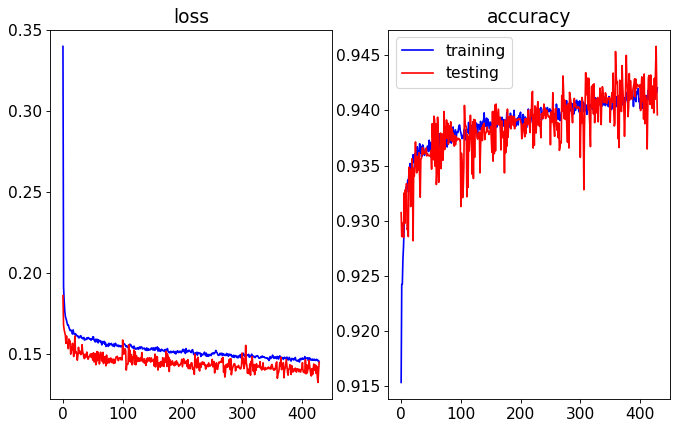

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.30it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


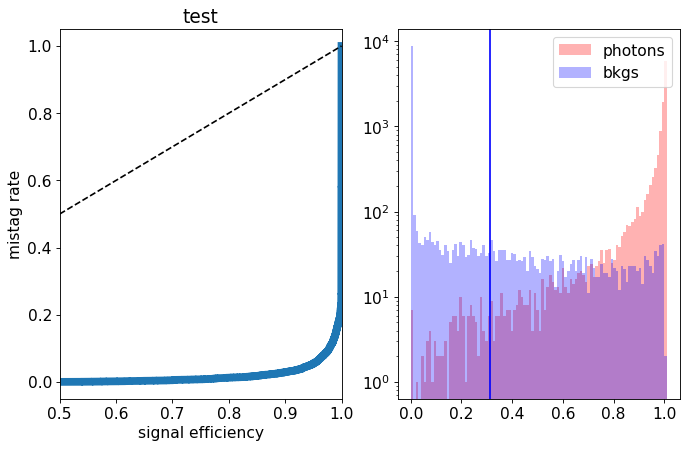

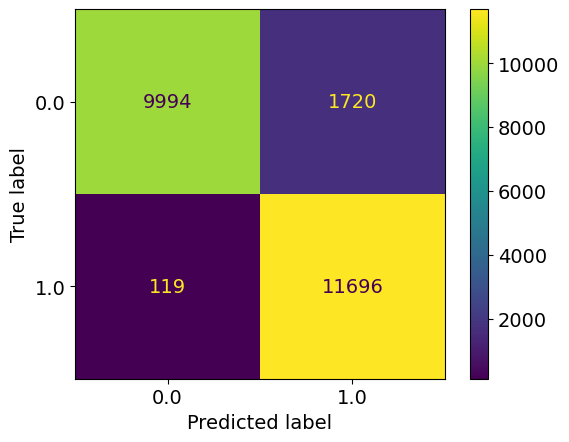

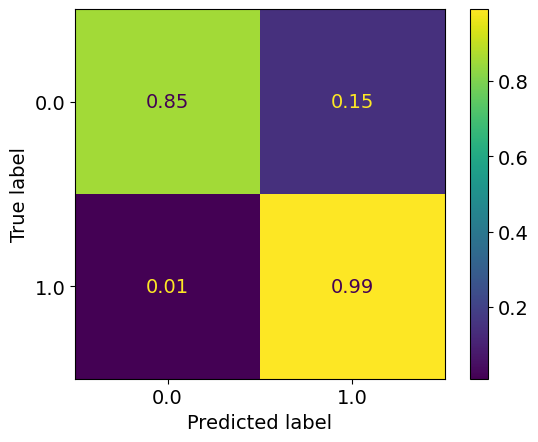

epoch: 430
Learning rate: 3.4568182296186134e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14590348483650548
train acc: 0.942219


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.63it/s]


test loss: 0.13661015182733535
test acc: 0.943389
epoch: 431
Learning rate: 3.161237880090216e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14587515227164433
train acc: 0.94193214


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.50it/s]


test loss: 0.13648979775607586
test acc: 0.943474
epoch: 432
Learning rate: 2.8729142845985978e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.14553338816021658
train acc: 0.9412627


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.90it/s]


test loss: 0.1394280705600977
test acc: 0.942454
epoch: 433
Learning rate: 2.5929853246526404e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.19it/s]


train loss: 0.14616525358265373
train acc: 0.9413902


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.83it/s]


test loss: 0.1393067816272378
test acc: 0.942284
epoch: 434
Learning rate: 2.3225557519698758e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.58it/s]


train loss: 0.14666853142771752
train acc: 0.94185776


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.98it/s]


test loss: 0.13813660982996226
test acc: 0.9426665
epoch: 435
Learning rate: 2.0626928285261642e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.54it/s]


train loss: 0.14623531632742304
train acc: 0.94086957


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.24it/s]


test loss: 0.13791597746312617
test acc: 0.942794
epoch: 436
Learning rate: 1.8144221145602574e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.05it/s]


train loss: 0.14515244063867885
train acc: 0.9426228


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.52it/s]


test loss: 0.13915972225368023
test acc: 0.94173145
epoch: 437
Learning rate: 1.5787234211560807e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14563281653792995
train acc: 0.941284


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.78it/s]


test loss: 0.13575503788888454
test acc: 0.943389
epoch: 438
Learning rate: 1.3565269433760108e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.17it/s]


train loss: 0.145500733736594
train acc: 0.94186836


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.82it/s]


test loss: 0.13803758043795825
test acc: 0.942624
epoch: 439
Learning rate: 1.1487095892059296e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14525225521272914
train acc: 0.94190025


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.96it/s]


test loss: 0.14008306078612803
test acc: 0.942114


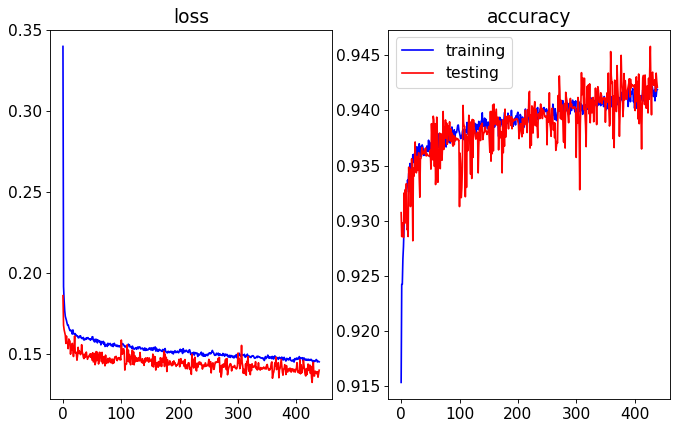

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.65it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


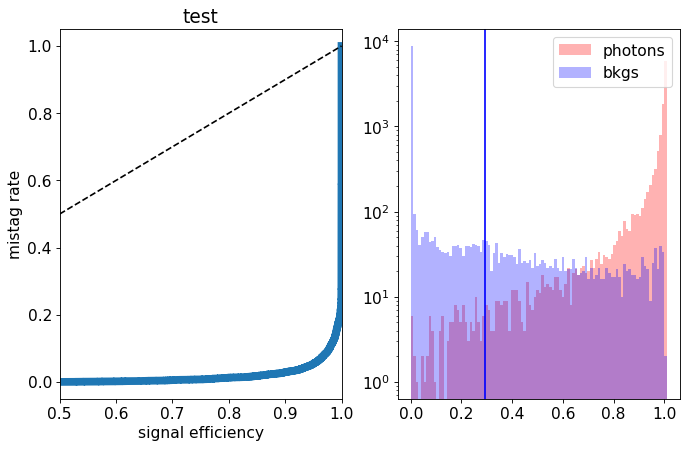

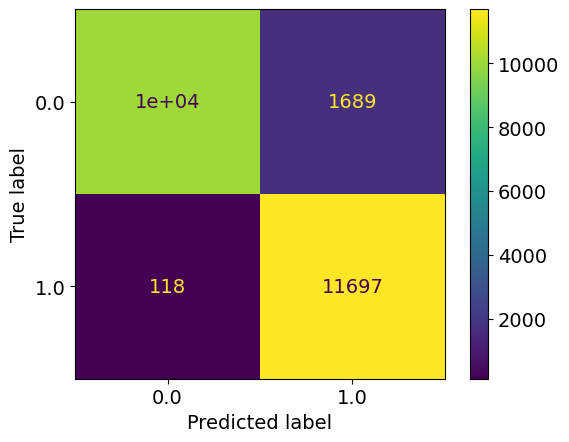

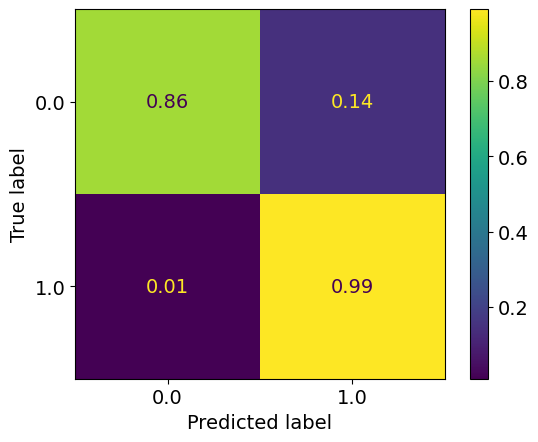

epoch: 440
Learning rate: 9.56091518800029e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.14it/s]


train loss: 0.14556354758845771
train acc: 0.94173026


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.11it/s]


test loss: 0.13967507276684046
test acc: 0.943134
epoch: 441
Learning rate: 7.794329076833768e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14576567073536525
train acc: 0.9415815


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.29it/s]


test loss: 0.1390855235978961
test acc: 0.9424965
epoch: 442
Learning rate: 6.194309466864034e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.55it/s]


train loss: 0.14545935610677027
train acc: 0.94196403


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.05it/s]


test loss: 0.13990344535559415
test acc: 0.9424115
epoch: 443
Learning rate: 4.76717090451227e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.14608313352059407
train acc: 0.9413902


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.89it/s]


test loss: 0.13741045277565717
test acc: 0.9434315
epoch: 444
Learning rate: 3.518545653686456e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.1450904137959146
train acc: 0.9415071


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.54it/s]


test loss: 0.13810362610965968
test acc: 0.942879
epoch: 445
Learning rate: 2.453361467808979e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14479075476622125
train acc: 0.94211274


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.13it/s]


test loss: 0.13957794960588216
test acc: 0.942964
epoch: 446
Learning rate: 1.5758221422251474e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14578572973893705
train acc: 0.94102895


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.84it/s]


test loss: 0.13830448612570762
test acc: 0.9429215
epoch: 447
Learning rate: 8.893909237434605e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14570313582944264
train acc: 0.9414008


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.22it/s]


test loss: 0.13765173573046924
test acc: 0.9430915
epoch: 448
Learning rate: 3.967768427826535e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.09it/s]


train loss: 0.1446652625966224
train acc: 0.94190025


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.13715411648154258
test acc: 0.9430065
epoch: 449
Learning rate: 9.992402206632778e-08


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14605246318183887
train acc: 0.94196403


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.71it/s]


test loss: 0.137754038348794
test acc: 0.9430065


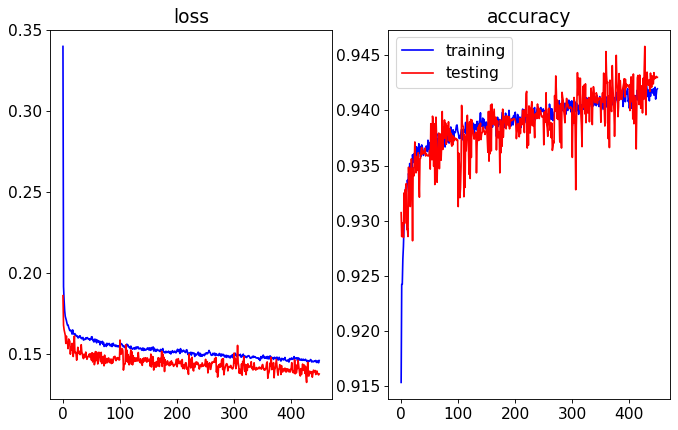

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.73it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


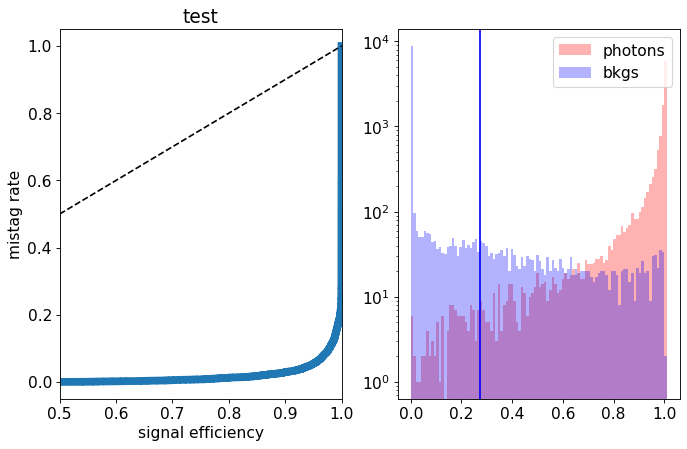

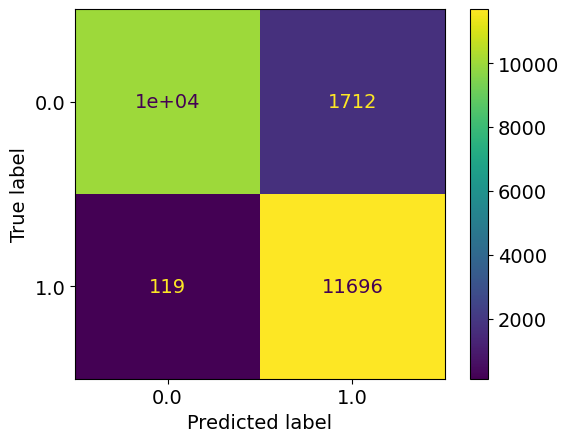

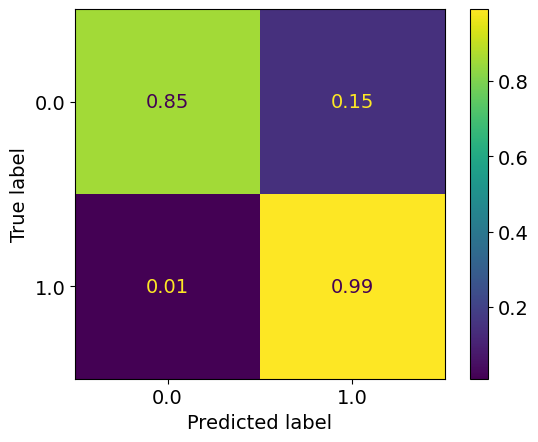

epoch: 450
Learning rate: 4.004058690165735e-12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.09it/s]


train loss: 0.14641271033294642
train acc: 0.94077396


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.55it/s]


test loss: 0.14331272784620525
test acc: 0.941264
epoch: 451
Learning rate: 9.99025888725783e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1469007753262854
train acc: 0.9414327


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.44it/s]


test loss: 0.13746476471424102
test acc: 0.9418165
epoch: 452
Learning rate: 9.960823902925945e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14512308686971664
train acc: 0.9419215


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.59it/s]


test loss: 0.14102310463786125
test acc: 0.94134897
epoch: 453
Learning rate: 9.911810813034072e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.19it/s]


train loss: 0.14776226209037624
train acc: 0.94081646


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.81it/s]


test loss: 0.13409844134002924
test acc: 0.944154
epoch: 454
Learning rate: 9.84341304985606e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14649934297913958
train acc: 0.9415921


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.38it/s]


test loss: 0.137789111956954
test acc: 0.94385654
epoch: 455
Learning rate: 9.755900548115212e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.16it/s]


train loss: 0.1466930825144622
train acc: 0.9413583


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.79it/s]


test loss: 0.14213823322206737
test acc: 0.9410515
epoch: 456
Learning rate: 9.649618679675236e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.14710431930365836
train acc: 0.9413265


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.38it/s]


test loss: 0.141014170832932
test acc: 0.942454
epoch: 457
Learning rate: 9.524986890515297e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14666434068968343
train acc: 0.9410927


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.16it/s]


test loss: 0.13837098088115454
test acc: 0.9430915
epoch: 458
Learning rate: 9.382497045368364e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.16it/s]


train loss: 0.1466991072817213
train acc: 0.94093335


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.93it/s]


test loss: 0.14004929810762407
test acc: 0.942879
epoch: 459
Learning rate: 9.222711486555813e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.55it/s]


train loss: 0.14591458131363438
train acc: 0.9423571


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.87it/s]


test loss: 0.13716899771243335
test acc: 0.943389


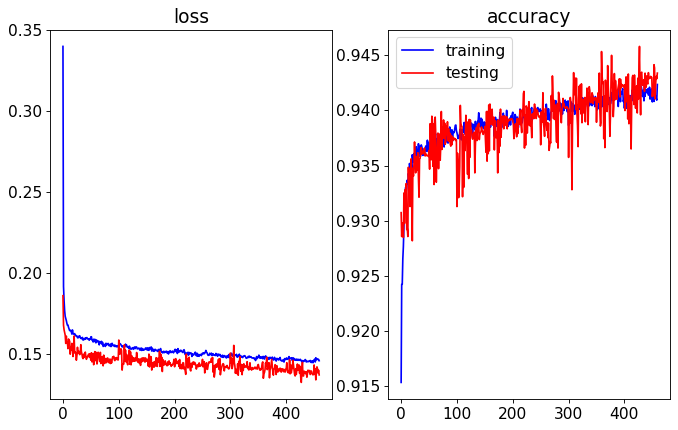

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.47it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


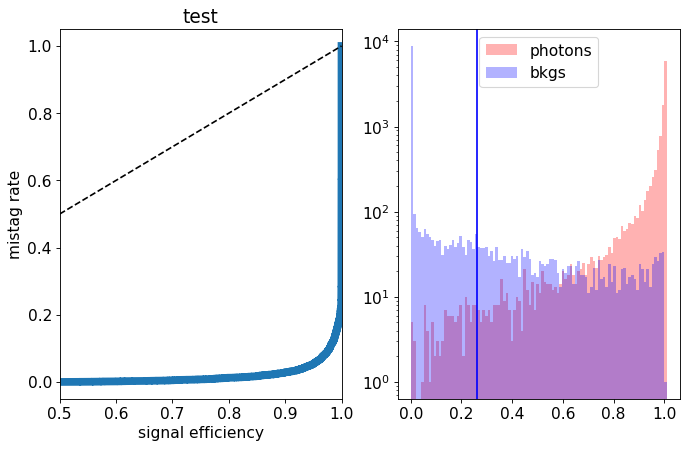

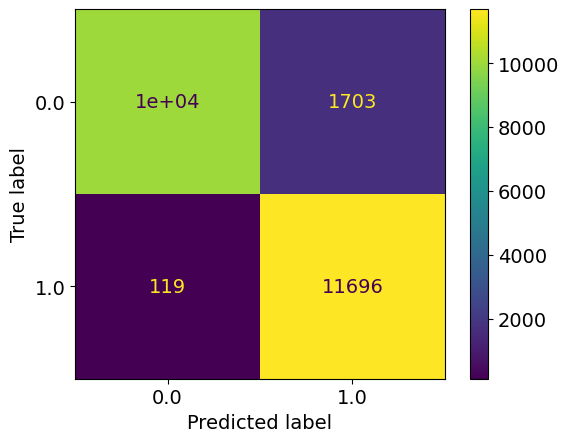

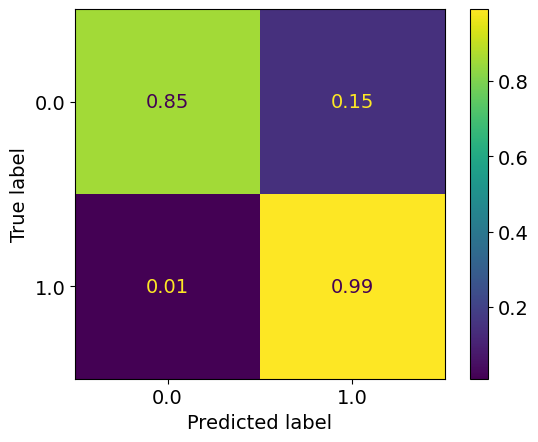

epoch: 460
Learning rate: 9.046260814679199e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.04it/s]


train loss: 0.14622857236558465
train acc: 0.9416665


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.50it/s]


test loss: 0.13670350722968577
test acc: 0.94530153
epoch: 461
Learning rate: 8.853841399927774e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14537177785376834
train acc: 0.9413796


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.50it/s]


test loss: 0.1377338409423828
test acc: 0.9432615
epoch: 462
Learning rate: 8.646212633823493e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.14538246806070304
train acc: 0.9414859


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.19it/s]


test loss: 0.14649483375251293
test acc: 0.94041395
epoch: 463
Learning rate: 8.42419393224961e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14577223526634228
train acc: 0.9416559


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.02it/s]


test loss: 0.1334049142897129
test acc: 0.94517404
epoch: 464
Learning rate: 8.188661501590543e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14718028931481064
train acc: 0.9408377


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.05it/s]


test loss: 0.13558585830032827
test acc: 0.944494
epoch: 465
Learning rate: 7.940544880745565e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.16it/s]


train loss: 0.14607597840060094
train acc: 0.9405721


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.26it/s]


test loss: 0.1331396047025919
test acc: 0.945599
epoch: 466
Learning rate: 7.680823272663455e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14560304458733578
train acc: 0.9416134


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.40it/s]


test loss: 0.1391931449994445
test acc: 0.9410515
epoch: 467
Learning rate: 7.410521679875796e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14516460558601246
train acc: 0.94205964


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.58it/s]


test loss: 0.13826586361974477
test acc: 0.9410515
epoch: 468
Learning rate: 7.130706859280269e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1455304666784159
train acc: 0.9415284


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.84it/s]


test loss: 0.13965266663581133
test acc: 0.943474
epoch: 469
Learning rate: 6.842483112138533e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.54it/s]


train loss: 0.1465373144597764
train acc: 0.94168776


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.46it/s]


test loss: 0.14046777561306953
test acc: 0.942794


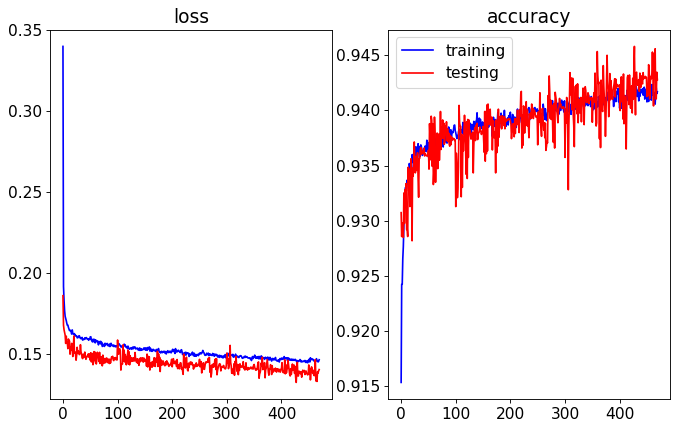

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.07it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


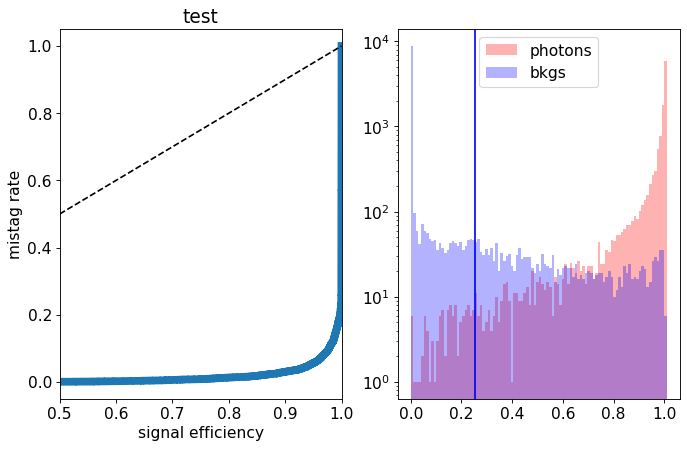

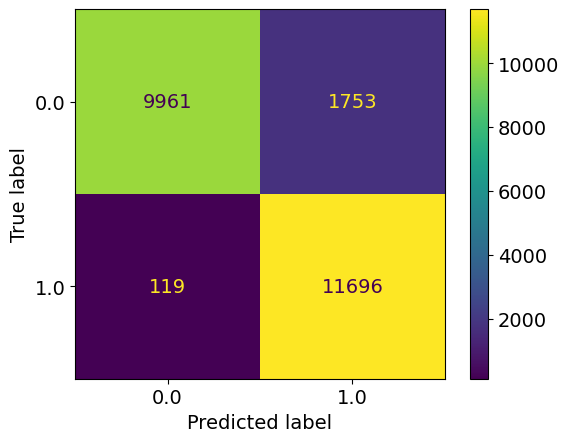

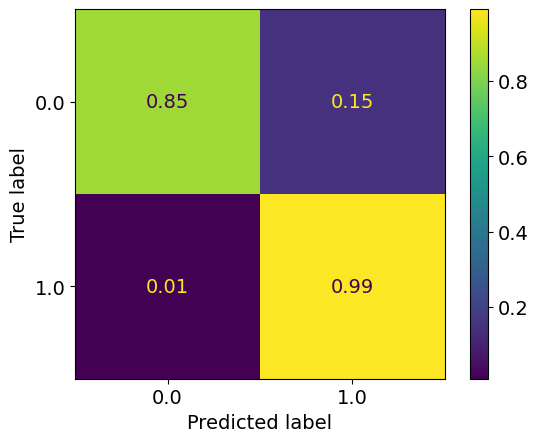

epoch: 470
Learning rate: 6.546987925903652e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.1450276744973128
train acc: 0.94127333


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.02it/s]


test loss: 0.1363513557240367
test acc: 0.9444515
epoch: 471
Learning rate: 6.245387485076784e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14557850621877963
train acc: 0.9414859


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.48it/s]


test loss: 0.1411264207214117
test acc: 0.9427515
epoch: 472
Learning rate: 5.93887206880974e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.11it/s]


train loss: 0.1458051416809392
train acc: 0.94199586


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.32it/s]


test loss: 0.13606388140469788
test acc: 0.9435165
epoch: 473
Learning rate: 5.6286513534169517e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14554726916133978
train acc: 0.9414752


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.15it/s]


test loss: 0.13527921829372644
test acc: 0.94394153
epoch: 474
Learning rate: 5.315949638335711e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.66it/s]


train loss: 0.14486655982057
train acc: 0.94199586


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.10it/s]


test loss: 0.1415163591504097
test acc: 0.94143397
epoch: 475
Learning rate: 5.00200101437562e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.25it/s]


train loss: 0.1452089355914456
train acc: 0.941454


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.29it/s]


test loss: 0.13553538229316472
test acc: 0.944409
epoch: 476
Learning rate: 4.6880444933259634e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1464669548781814
train acc: 0.94077396


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.84it/s]


test loss: 0.13830156419426204
test acc: 0.9430915
epoch: 477
Learning rate: 4.375319118142234e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.57it/s]


train loss: 0.14511433751529948
train acc: 0.94168776


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.25it/s]


test loss: 0.13728189263492824
test acc: 0.943219
epoch: 478
Learning rate: 4.06505907300965e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14598492096373988
train acc: 0.94181526


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.56it/s]


test loss: 0.1347558567300439
test acc: 0.94398403
epoch: 479
Learning rate: 3.758488812582018e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14539609915891272
train acc: 0.9411352


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.81it/s]


test loss: 0.1431982431560755
test acc: 0.9397764


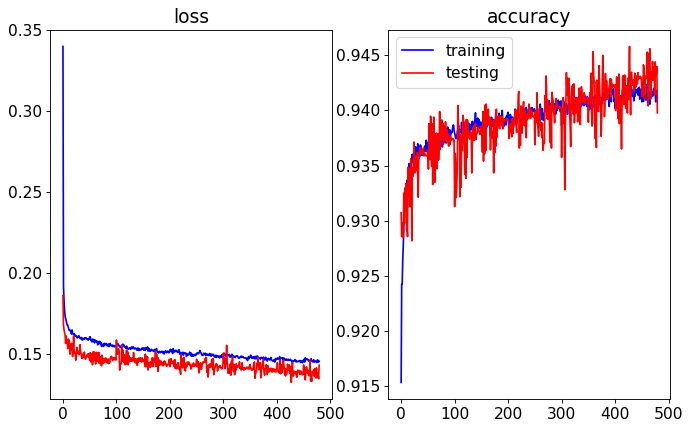

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.76it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


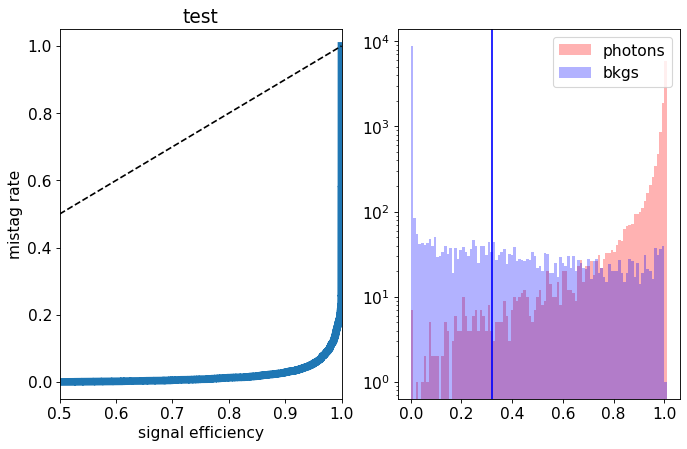

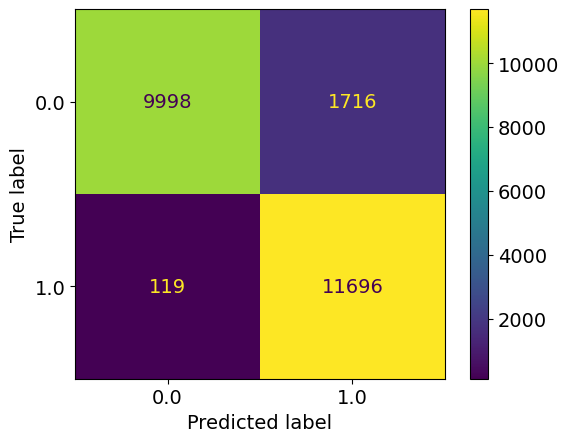

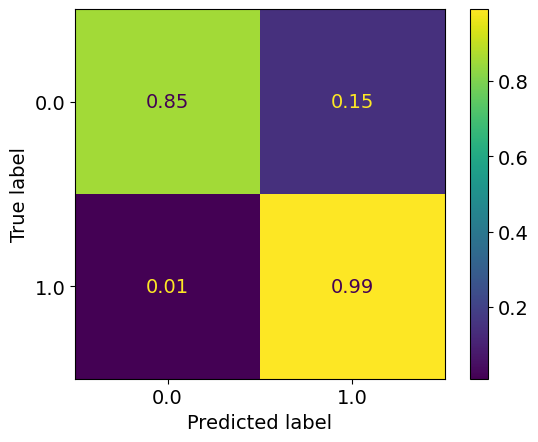

epoch: 480
Learning rate: 3.4568182296186134e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.14536528759131764
train acc: 0.9420915


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.48it/s]


test loss: 0.1382923623546958
test acc: 0.9434315
epoch: 481
Learning rate: 3.161237880090216e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14548964323891198
train acc: 0.94178337


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.84it/s]


test loss: 0.13674506545066833
test acc: 0.94385654
epoch: 482
Learning rate: 2.8729142845985978e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.14488640698088204
train acc: 0.94188964


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.66it/s]


test loss: 0.14175501875579358
test acc: 0.942624
epoch: 483
Learning rate: 2.5929853246526404e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14457783136208346
train acc: 0.94185776


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.70it/s]


test loss: 0.13744656331837177
test acc: 0.94398403
epoch: 484
Learning rate: 2.3225557519698758e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14529259782877696
train acc: 0.9417515


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.77it/s]


test loss: 0.13707107547670602
test acc: 0.9441965
epoch: 485
Learning rate: 2.0626928285261642e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.08it/s]


train loss: 0.14556963722796956
train acc: 0.9416559


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.79it/s]


test loss: 0.13881566505879164
test acc: 0.943474
epoch: 486
Learning rate: 1.8144221145602574e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14412648050458568
train acc: 0.9423253


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.36it/s]


test loss: 0.1372880281880498
test acc: 0.94385654
epoch: 487
Learning rate: 1.5787234211560807e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.05it/s]


train loss: 0.14556821820082938
train acc: 0.94181526


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.88it/s]


test loss: 0.13695461954921484
test acc: 0.94385654
epoch: 488
Learning rate: 1.3565269433760108e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14665695403222065
train acc: 0.941624


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.39it/s]


test loss: 0.13781899139285086
test acc: 0.9435165
epoch: 489
Learning rate: 1.1487095892059296e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14468659133098688
train acc: 0.9422296


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.03it/s]


test loss: 0.137311496399343
test acc: 0.943474


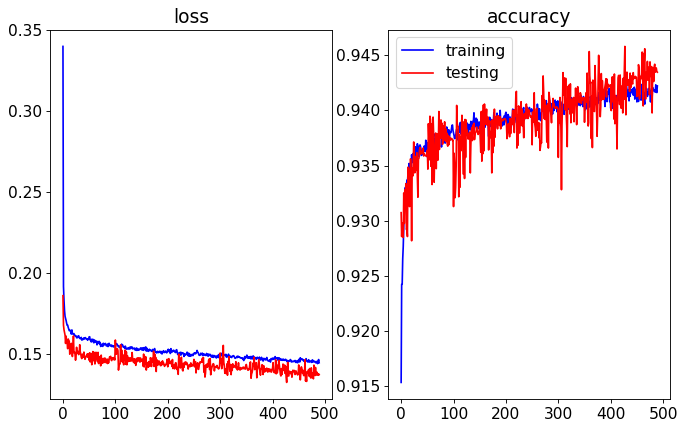

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.11it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


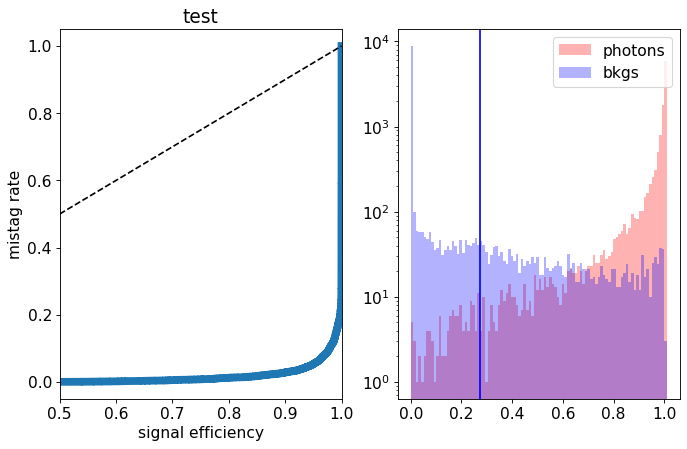

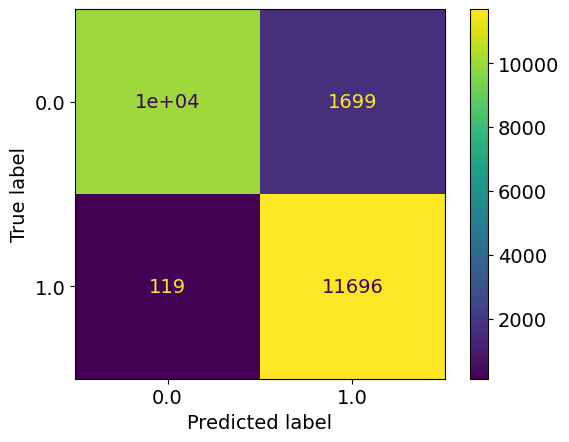

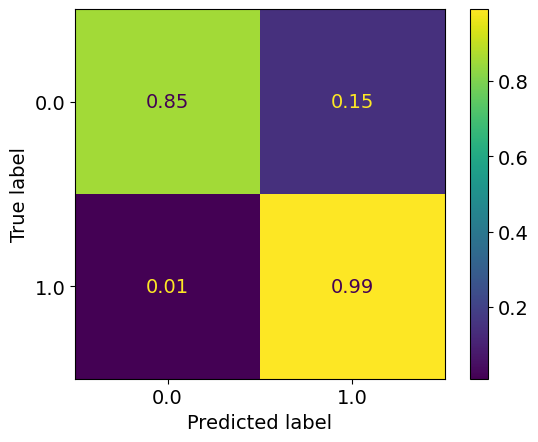

epoch: 490
Learning rate: 9.56091518800029e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14567358981651865
train acc: 0.941624


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.86it/s]


test loss: 0.1378388313576579
test acc: 0.944069
epoch: 491
Learning rate: 7.794329076833768e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14491155667669453
train acc: 0.9422084


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.51it/s]


test loss: 0.1393065545707941
test acc: 0.9436015
epoch: 492
Learning rate: 6.194309466864034e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.14it/s]


train loss: 0.14416910769643299
train acc: 0.94185776


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.13it/s]


test loss: 0.1370403401553631
test acc: 0.9436015
epoch: 493
Learning rate: 4.76717090451227e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.1456179481687819
train acc: 0.9415284


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.24it/s]


test loss: 0.1359624657779932
test acc: 0.94372904
epoch: 494
Learning rate: 3.518545653686456e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.1446879682647195
train acc: 0.94195336


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.11it/s]


test loss: 0.1384380703791976
test acc: 0.94385654
epoch: 495
Learning rate: 2.453361467808979e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.56it/s]


train loss: 0.14451784967996512
train acc: 0.9424846


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.01it/s]


test loss: 0.13842959757894277
test acc: 0.9435165
epoch: 496
Learning rate: 1.5758221422251474e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1440893304860516
train acc: 0.9424421


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.94it/s]


test loss: 0.1367187935858965
test acc: 0.94394153
epoch: 497
Learning rate: 8.893909237434605e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


train loss: 0.14467394470599046
train acc: 0.941879


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.05it/s]


test loss: 0.13683160599321126
test acc: 0.94385654
epoch: 498
Learning rate: 3.967768427826535e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1447635534083008
train acc: 0.9414752


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.81it/s]


test loss: 0.1374622905626893
test acc: 0.94377154
epoch: 499
Learning rate: 9.992402206632778e-08


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.144077066213462
train acc: 0.94228274


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.82it/s]


test loss: 0.1383578896522522
test acc: 0.94377154


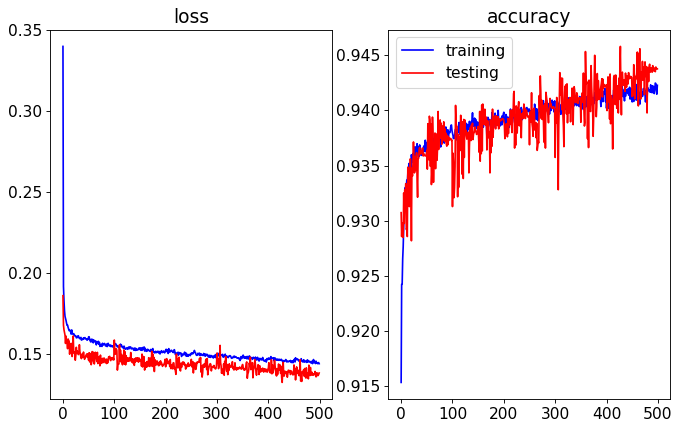

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.73it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


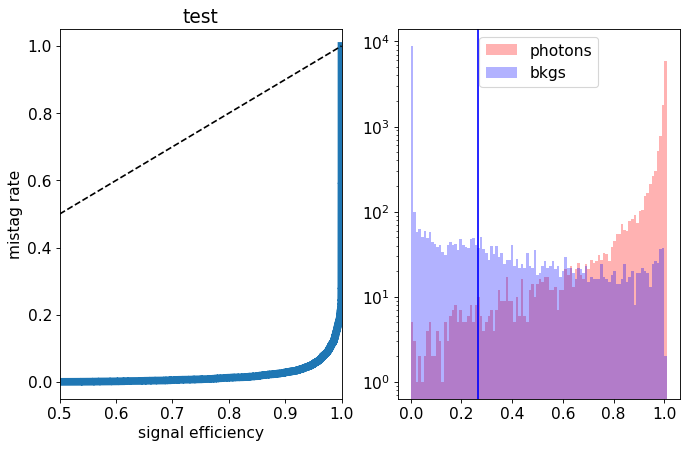

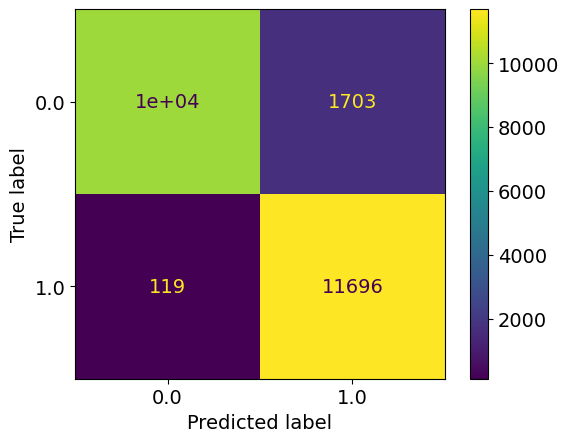

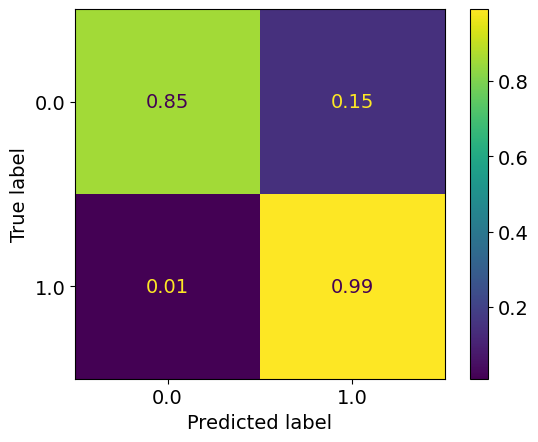

epoch: 500
Learning rate: 4.004058690165735e-12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14675774306628356
train acc: 0.94182587


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.68it/s]


test loss: 0.1395638221874833
test acc: 0.941944
epoch: 501
Learning rate: 9.99025888725783e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.54it/s]


train loss: 0.14601358372694367
train acc: 0.94182587


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.91it/s]


test loss: 0.13788918405771255
test acc: 0.9431765
epoch: 502
Learning rate: 9.960823902925945e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.08it/s]


train loss: 0.1468370558729597
train acc: 0.9410821


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.70it/s]


test loss: 0.1379282722249627
test acc: 0.942624
epoch: 503
Learning rate: 9.911810813034072e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14521521201748758
train acc: 0.9414646


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.16it/s]


test loss: 0.1394003013148904
test acc: 0.9424965
epoch: 504
Learning rate: 9.84341304985606e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.16it/s]


train loss: 0.14560912924397523
train acc: 0.94208086


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.53it/s]


test loss: 0.14020527936518193
test acc: 0.94270897
epoch: 505
Learning rate: 9.755900548115212e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.1452370721158708
train acc: 0.941369


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.79it/s]


test loss: 0.1463394831866026
test acc: 0.93918145
epoch: 506
Learning rate: 9.649618679675236e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.1453055127221308
train acc: 0.94185776


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.94it/s]


test loss: 0.13316771239042283
test acc: 0.9456841
epoch: 507
Learning rate: 9.524986890515297e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.01it/s]


train loss: 0.1453032716159608
train acc: 0.9423253


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.88it/s]


test loss: 0.1366398748010397
test acc: 0.944154
epoch: 508
Learning rate: 9.382497045368364e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14539953174105116
train acc: 0.94184715


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.66it/s]


test loss: 0.14804853461682796
test acc: 0.941094
epoch: 509
Learning rate: 9.222711486555813e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.14566741594273575
train acc: 0.9416771


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.50it/s]


test loss: 0.13334268908947705
test acc: 0.944579


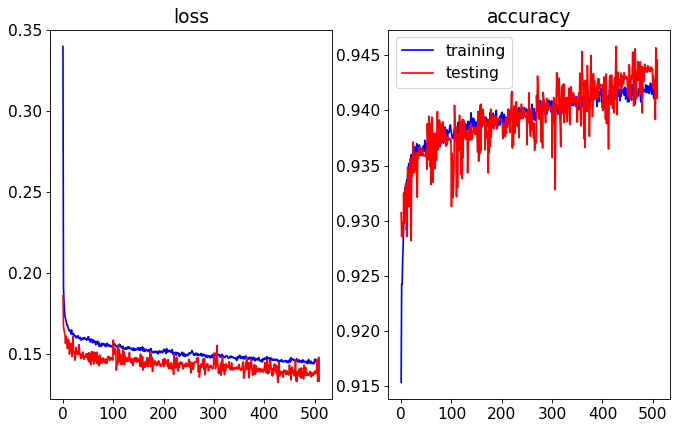

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.09it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


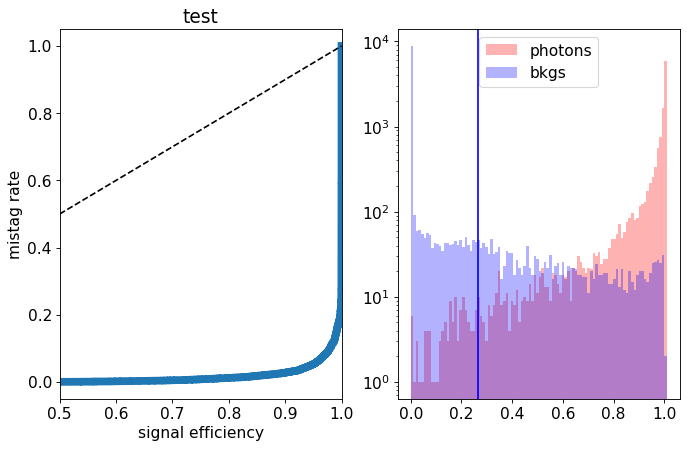

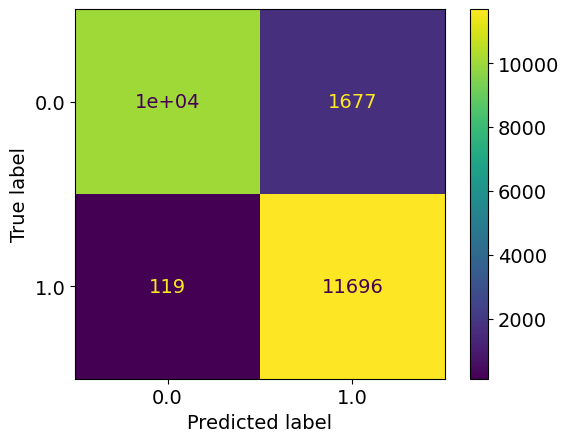

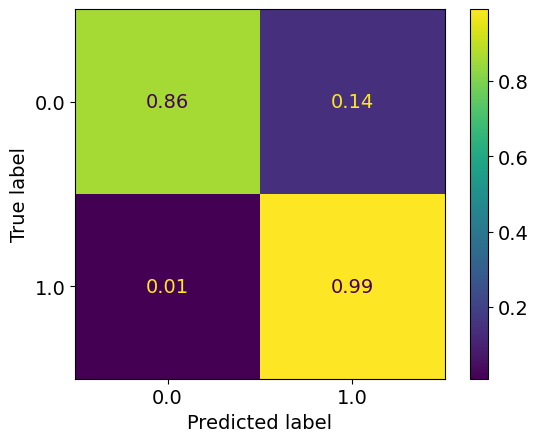

epoch: 510
Learning rate: 9.046260814679199e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14608133892724467
train acc: 0.9413583


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.78it/s]


test loss: 0.13597966767847539
test acc: 0.944579
epoch: 511
Learning rate: 8.853841399927774e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14512455363751978
train acc: 0.94188964


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.16it/s]


test loss: 0.13956443406641483
test acc: 0.942454
epoch: 512
Learning rate: 8.646212633823493e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14533166800904426
train acc: 0.941369


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.66it/s]


test loss: 0.14169959928840398
test acc: 0.94079643
epoch: 513
Learning rate: 8.42419393224961e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14542540480756455
train acc: 0.9417515


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.60it/s]


test loss: 0.14220976307988167
test acc: 0.94168895
epoch: 514
Learning rate: 8.188661501590543e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.09it/s]


train loss: 0.1450652882077132
train acc: 0.94202775


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.48it/s]


test loss: 0.1406783264130354
test acc: 0.941774
epoch: 515
Learning rate: 7.940544880745565e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.1446926906515079
train acc: 0.94195336


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.56it/s]


test loss: 0.13373705893754959
test acc: 0.944579
epoch: 516
Learning rate: 7.680823272663455e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14534145470257778
train acc: 0.941879


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.52it/s]


test loss: 0.13136677537113428
test acc: 0.94734156
new best acc: 0.94734156
epoch: 517
Learning rate: 7.410521679875796e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1451907332535762
train acc: 0.94127333


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.21it/s]


test loss: 0.14107491057366134
test acc: 0.9443665
epoch: 518
Learning rate: 7.130706859280269e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14537795618840843
train acc: 0.94191086


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.49it/s]


test loss: 0.14007417093962432
test acc: 0.942539
epoch: 519
Learning rate: 6.842483112138533e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.11it/s]


train loss: 0.14598564969696057
train acc: 0.94188964


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.60it/s]


test loss: 0.14083687197417022
test acc: 0.94151896


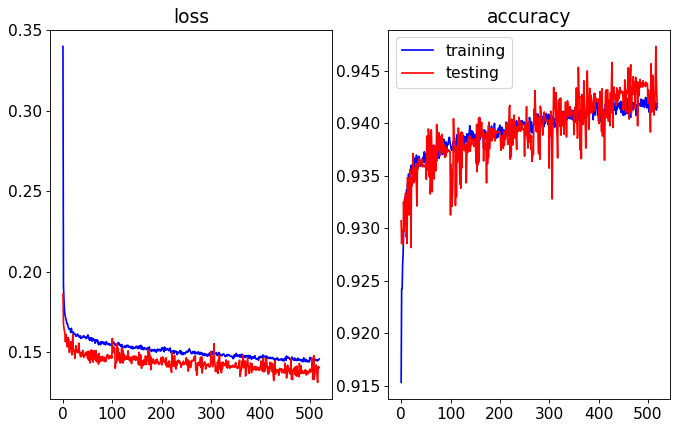

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.37it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


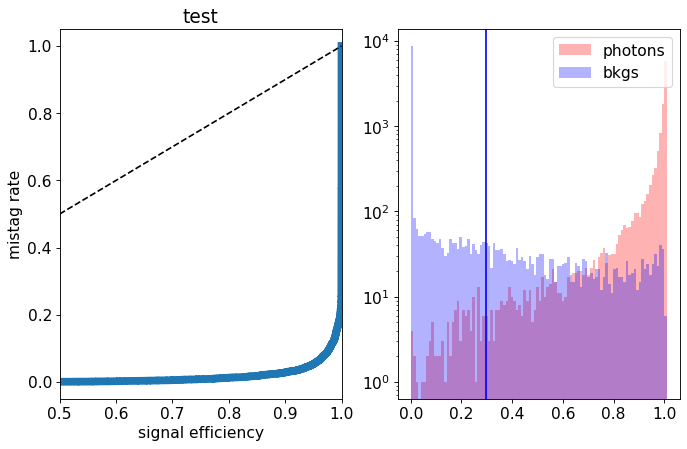

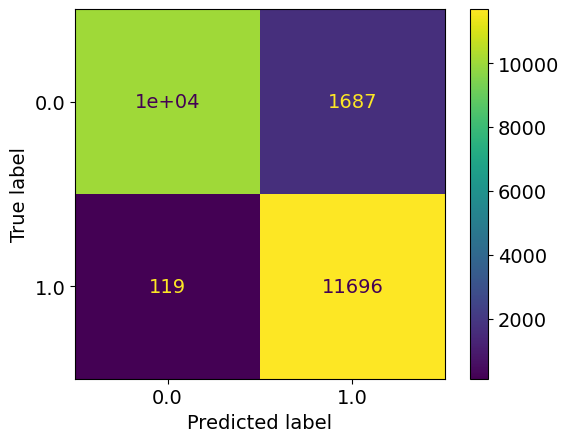

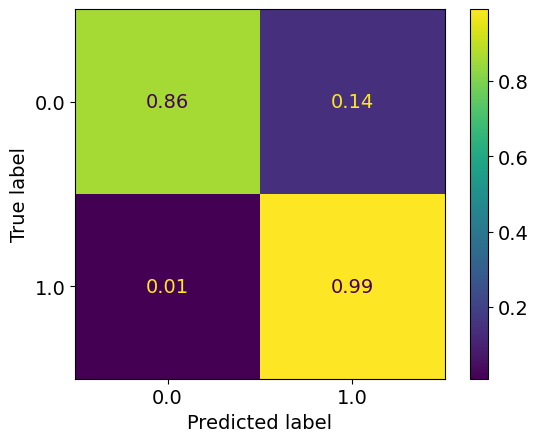

epoch: 520
Learning rate: 6.546987925903652e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14432838155775313
train acc: 0.9423678


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.14458278939127922
test acc: 0.9410515
epoch: 521
Learning rate: 6.245387485076784e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.02it/s]


train loss: 0.14451609827150966
train acc: 0.94278216


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.33it/s]


test loss: 0.1443742822855711
test acc: 0.941264
epoch: 522
Learning rate: 5.93887206880974e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.1451033338145086
train acc: 0.942134


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.25it/s]


test loss: 0.13755740970373154
test acc: 0.94474906
epoch: 523
Learning rate: 5.6286513534169517e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14437187576939345
train acc: 0.9423146


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.80it/s]


test loss: 0.13872786313295365
test acc: 0.94385654
epoch: 524
Learning rate: 5.315949638335711e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.11it/s]


train loss: 0.14487487163133683
train acc: 0.9411246


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.70it/s]


test loss: 0.14114084783941508
test acc: 0.9422415
epoch: 525
Learning rate: 5.00200101437562e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14485519554964296
train acc: 0.9415709


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.04it/s]


test loss: 0.13454648870974778
test acc: 0.94372904
epoch: 526
Learning rate: 4.6880444933259634e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.11it/s]


train loss: 0.14509762951712699
train acc: 0.94205964


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.20it/s]


test loss: 0.1390760626643896
test acc: 0.94377154
epoch: 527
Learning rate: 4.375319118142234e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14622272555805316
train acc: 0.94194275


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.17it/s]


test loss: 0.13750900235027075
test acc: 0.942964
epoch: 528
Learning rate: 4.06505907300965e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1450258196823916
train acc: 0.94168776


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.45it/s]


test loss: 0.1409055281430483
test acc: 0.94151896
epoch: 529
Learning rate: 3.758488812582018e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.05it/s]


train loss: 0.1450877112757628
train acc: 0.9423678


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.21it/s]


test loss: 0.13926253709942102
test acc: 0.942794


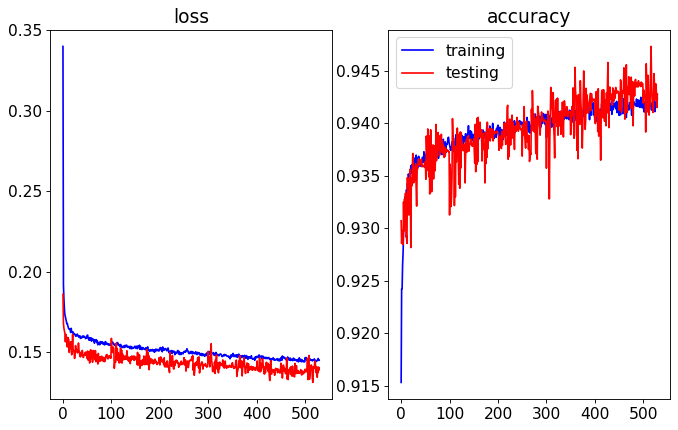

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.43it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


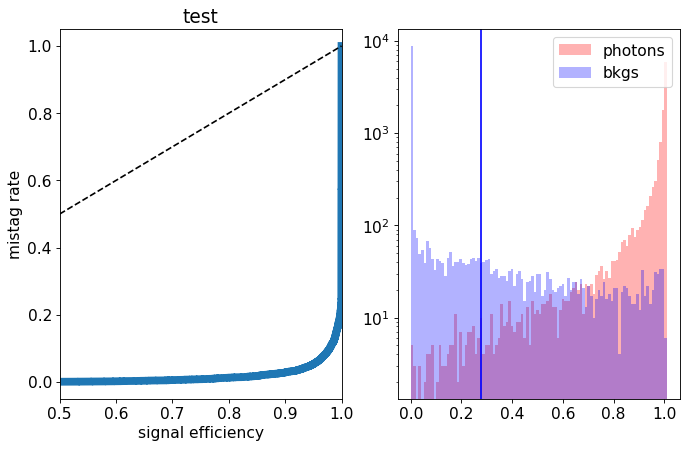

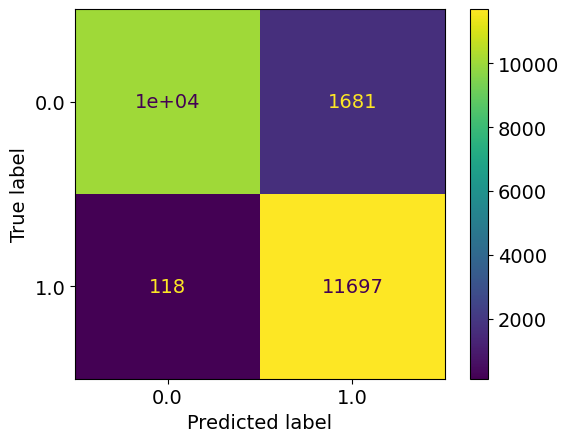

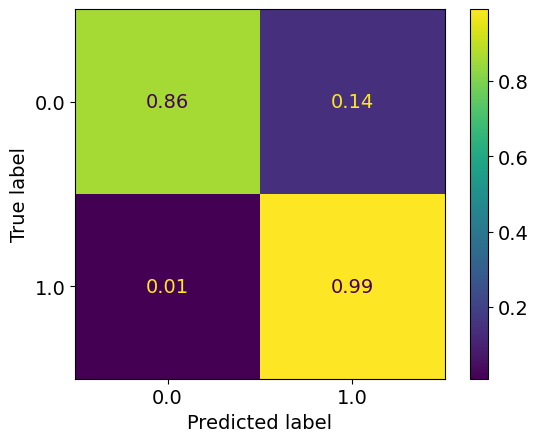

epoch: 530
Learning rate: 3.4568182296186134e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14372044255968872
train acc: 0.9415284


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.36it/s]


test loss: 0.13798867352306843
test acc: 0.9426665
epoch: 531
Learning rate: 3.161237880090216e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.20it/s]


train loss: 0.14508236180635015
train acc: 0.9423678


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.15it/s]


test loss: 0.1416694289073348
test acc: 0.942879
epoch: 532
Learning rate: 2.8729142845985978e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1445868508356392
train acc: 0.94218713


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.40it/s]


test loss: 0.1377148786559701
test acc: 0.944154
epoch: 533
Learning rate: 2.5929853246526404e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14603103203758314
train acc: 0.9416346


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.45it/s]


test loss: 0.13653910178691148
test acc: 0.94381404
epoch: 534
Learning rate: 2.3225557519698758e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14484972326429027
train acc: 0.9424315


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.78it/s]


test loss: 0.14147100318223238
test acc: 0.9432615
epoch: 535
Learning rate: 2.0626928285261642e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.14498186453132872
train acc: 0.9422084


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.74it/s]


test loss: 0.1387353718280792
test acc: 0.9430915
epoch: 536
Learning rate: 1.8144221145602574e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.13it/s]


train loss: 0.14488175207642234
train acc: 0.94177276


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.71it/s]


test loss: 0.13733668196946383
test acc: 0.9440265
epoch: 537
Learning rate: 1.5787234211560807e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14463392792233995
train acc: 0.94193214


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.48it/s]


test loss: 0.13808022495359182
test acc: 0.9444515
epoch: 538
Learning rate: 1.3565269433760108e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14454797546195378
train acc: 0.9417621


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.84it/s]


test loss: 0.1353671343997121
test acc: 0.944409
epoch: 539
Learning rate: 1.1487095892059296e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.14359746598134374
train acc: 0.9424953


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.02it/s]


test loss: 0.1386488674208522
test acc: 0.9429215


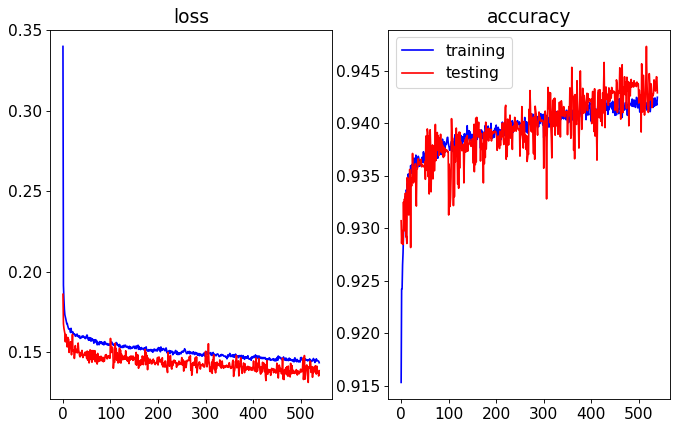

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.53it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


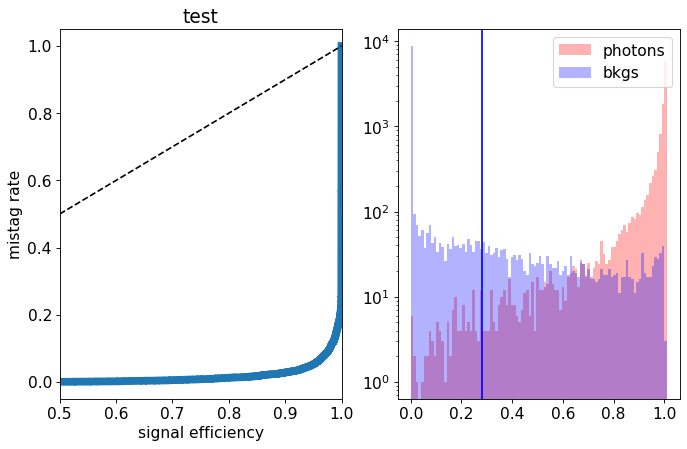

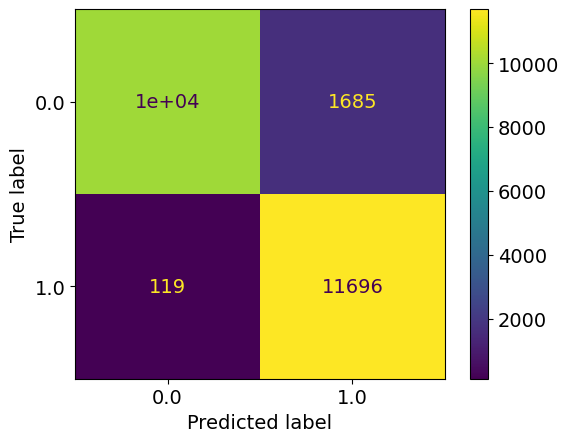

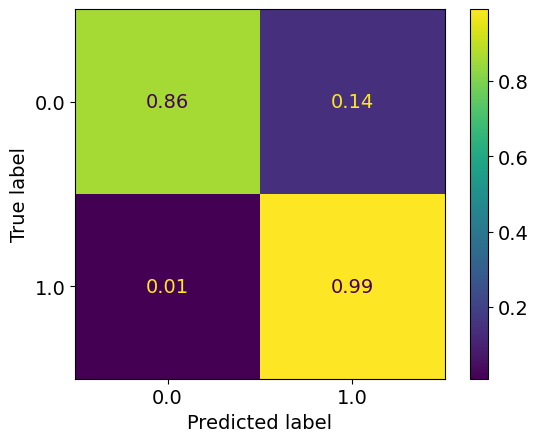

epoch: 540
Learning rate: 9.56091518800029e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14436207384250727
train acc: 0.942304


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.36it/s]


test loss: 0.13846207335591315
test acc: 0.943389
epoch: 541
Learning rate: 7.794329076833768e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.05it/s]


train loss: 0.14398646658393227
train acc: 0.942304


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.32it/s]


test loss: 0.13697409424930812
test acc: 0.9446215
epoch: 542
Learning rate: 6.194309466864034e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1434113168317801
train acc: 0.942389


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.06it/s]


test loss: 0.13852980639785528
test acc: 0.94389904
epoch: 543
Learning rate: 4.76717090451227e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.09it/s]


train loss: 0.1441832621860656
train acc: 0.9423678


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.29it/s]


test loss: 0.14025552961975335
test acc: 0.943474
epoch: 544
Learning rate: 3.518545653686456e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14484103061970632
train acc: 0.9424315


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.71it/s]


test loss: 0.13795925844460727
test acc: 0.943559
epoch: 545
Learning rate: 2.453361467808979e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.1448856899218195
train acc: 0.9424846


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.01it/s]


test loss: 0.1379565430805087
test acc: 0.94381404
epoch: 546
Learning rate: 1.5758221422251474e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


train loss: 0.14421830501905672
train acc: 0.942389


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.66it/s]


test loss: 0.13841342367231846
test acc: 0.9431765
epoch: 547
Learning rate: 8.893909237434605e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14481108170595897
train acc: 0.9422084


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.02it/s]


test loss: 0.14189321491867304
test acc: 0.9434315
epoch: 548
Learning rate: 3.967768427826535e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14425658320735216
train acc: 0.9425697


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.17it/s]


test loss: 0.13914331644773484
test acc: 0.9435165
epoch: 549
Learning rate: 9.992402206632778e-08


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.14333506820687822
train acc: 0.94197464


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.51it/s]


test loss: 0.14106201231479645
test acc: 0.9434315


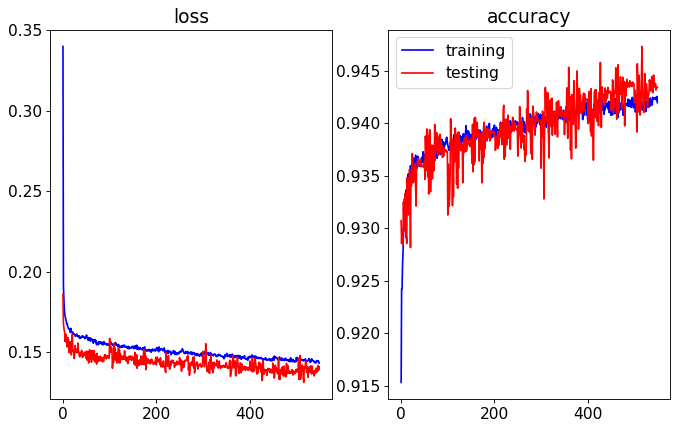

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.28it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


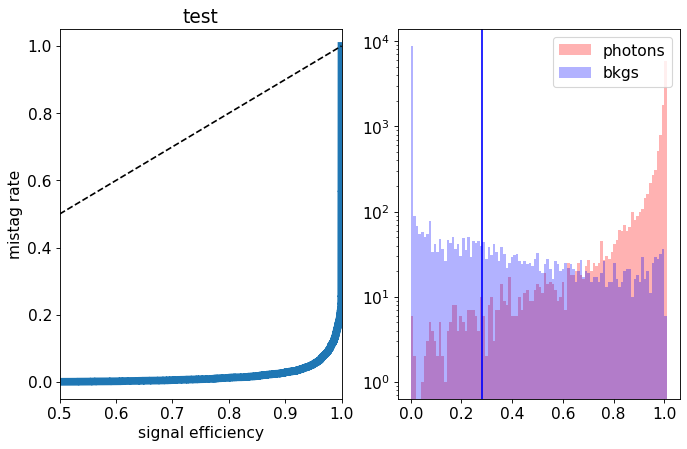

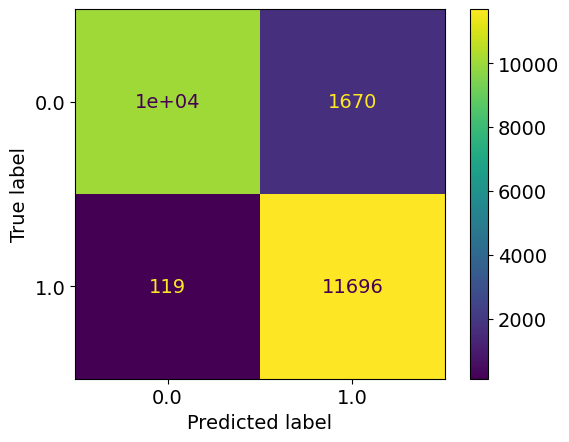

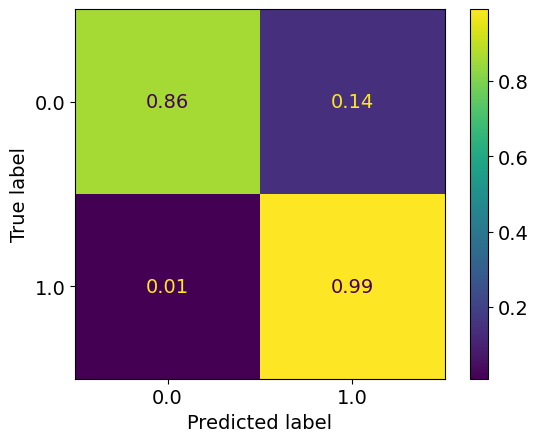

epoch: 550
Learning rate: 4.004058690165735e-12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14567096151743725
train acc: 0.9416134


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.13884273897856475
test acc: 0.9420715
epoch: 551
Learning rate: 9.99025888725783e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.08it/s]


train loss: 0.14511088035099065
train acc: 0.94186836


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.98it/s]


test loss: 0.14388262052088976
test acc: 0.94032896
epoch: 552
Learning rate: 9.960823902925945e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.1445482656074937
train acc: 0.94212335


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.58it/s]


test loss: 0.14107225127518178
test acc: 0.94151896
epoch: 553
Learning rate: 9.911810813034072e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.10it/s]


train loss: 0.14535905306885957
train acc: 0.9412202


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.45it/s]


test loss: 0.15116519201546907
test acc: 0.9398615
epoch: 554
Learning rate: 9.84341304985606e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.14609536808577311
train acc: 0.9415921


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.34it/s]


test loss: 0.13684207182377578
test acc: 0.943049
epoch: 555
Learning rate: 9.755900548115212e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14520518875615612
train acc: 0.941539


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.59it/s]


test loss: 0.13379466589540243
test acc: 0.94623655
epoch: 556
Learning rate: 9.649618679675236e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.14it/s]


train loss: 0.14629684687609884
train acc: 0.94102895


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.35it/s]


test loss: 0.13548868093639613
test acc: 0.9456841
epoch: 557
Learning rate: 9.524986890515297e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14534956700862592
train acc: 0.94092274


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.42it/s]


test loss: 0.1454591115936637
test acc: 0.94062644
epoch: 558
Learning rate: 9.382497045368364e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.09it/s]


train loss: 0.14497915636392156
train acc: 0.94193214


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.56it/s]


test loss: 0.13427808750420808
test acc: 0.94632155
epoch: 559
Learning rate: 9.222711486555813e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14548672375026023
train acc: 0.94212335


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.48it/s]


test loss: 0.1449686959385872
test acc: 0.942539


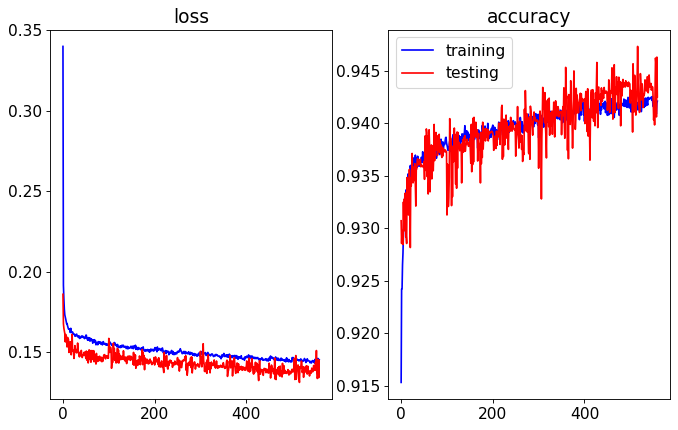

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.66it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


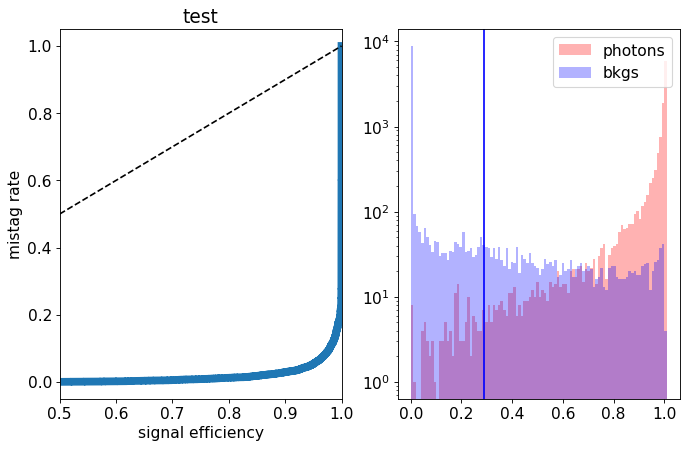

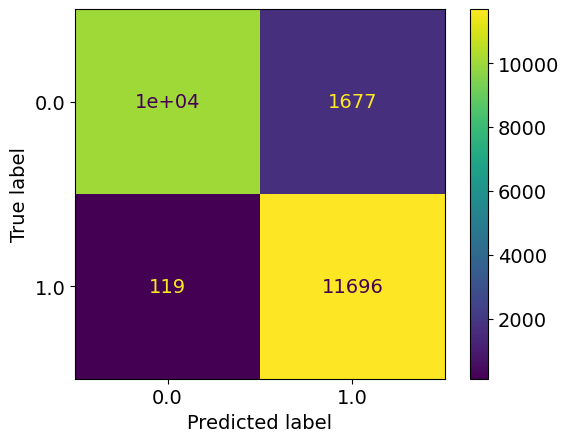

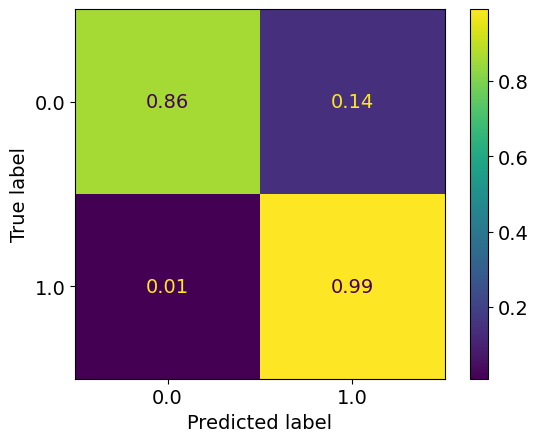

epoch: 560
Learning rate: 9.046260814679199e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14454851489348017
train acc: 0.94160277


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.47it/s]


test loss: 0.1422883328050375
test acc: 0.94164646
epoch: 561
Learning rate: 8.853841399927774e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1438482799063063
train acc: 0.942134


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.49it/s]


test loss: 0.1424179147928953
test acc: 0.94134897
epoch: 562
Learning rate: 8.646212633823493e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.1444934644516866
train acc: 0.9421765


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.20it/s]


test loss: 0.13320454806089402
test acc: 0.94513154
epoch: 563
Learning rate: 8.42419393224961e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.14it/s]


train loss: 0.14477244579488305
train acc: 0.94197464


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.75it/s]


test loss: 0.1465508233755827
test acc: 0.94066894
epoch: 564
Learning rate: 8.188661501590543e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14459646346083113
train acc: 0.9424953


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.53it/s]


test loss: 0.13889922071248292
test acc: 0.944239
epoch: 565
Learning rate: 7.940544880745565e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.46it/s]


train loss: 0.14388332278675334
train acc: 0.9426759


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.76it/s]


test loss: 0.13800591137260199
test acc: 0.9427515
epoch: 566
Learning rate: 7.680823272663455e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14337851918616873
train acc: 0.94295216


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.29it/s]


test loss: 0.1418636215850711
test acc: 0.94372904
epoch: 567
Learning rate: 7.410521679875796e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14384392311998234
train acc: 0.94286716


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.46it/s]


test loss: 0.1336820086464286
test acc: 0.94640654
epoch: 568
Learning rate: 7.130706859280269e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


train loss: 0.14454692412333883
train acc: 0.9423146


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.86it/s]


test loss: 0.13436153754591942
test acc: 0.94508904
epoch: 569
Learning rate: 6.842483112138533e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14561520901265418
train acc: 0.9422509


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.41it/s]


test loss: 0.13754119612276555
test acc: 0.94398403


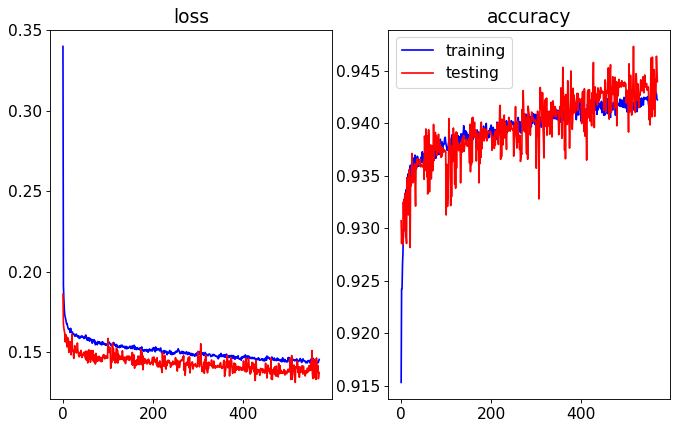

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.91it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


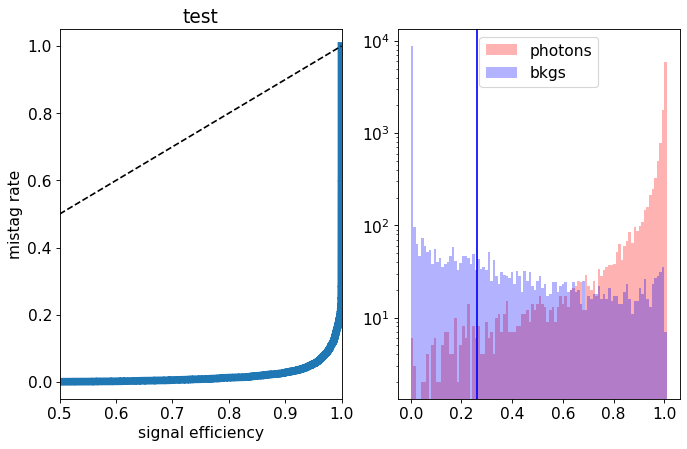

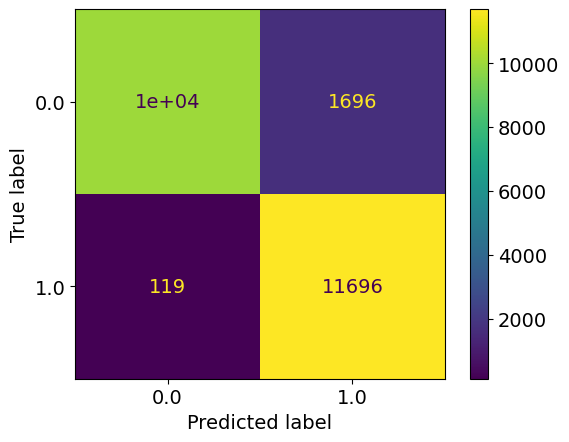

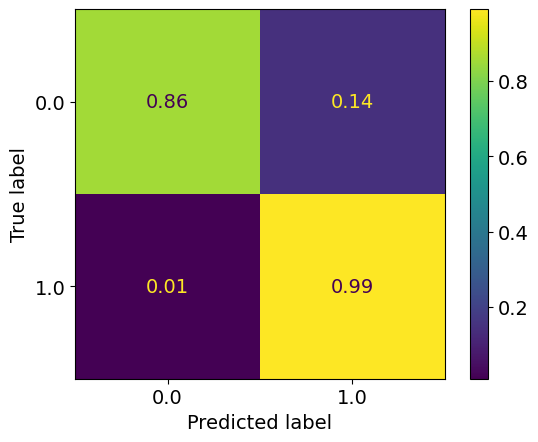

epoch: 570
Learning rate: 6.546987925903652e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


train loss: 0.14461026165136107
train acc: 0.9427503


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.22it/s]


test loss: 0.13838113378733397
test acc: 0.9428365
epoch: 571
Learning rate: 6.245387485076784e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14443425350128467
train acc: 0.94177276


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.45it/s]


test loss: 0.1354056715965271
test acc: 0.9446215
epoch: 572
Learning rate: 5.93887206880974e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.1441808575467699
train acc: 0.9423465


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.57it/s]


test loss: 0.13544045053422452
test acc: 0.94644904
epoch: 573
Learning rate: 5.6286513534169517e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.02it/s]


train loss: 0.14443482899931587
train acc: 0.941879


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.65it/s]


test loss: 0.14320073164999486
test acc: 0.9408815
epoch: 574
Learning rate: 5.315949638335711e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14501069011581932
train acc: 0.9426228


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.75it/s]


test loss: 0.12900905087590217
test acc: 0.9479366
new best acc: 0.9479366
epoch: 575
Learning rate: 5.00200101437562e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.07it/s]


train loss: 0.1448176140143613
train acc: 0.9417409


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.95it/s]


test loss: 0.1350115466862917
test acc: 0.94466406
epoch: 576
Learning rate: 4.6880444933259634e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14448494373992748
train acc: 0.94219774


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.51it/s]


test loss: 0.13784657884389162
test acc: 0.94517404
epoch: 577
Learning rate: 4.375319118142234e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14353936118115285
train acc: 0.942644


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.17it/s]


test loss: 0.14037784487009047
test acc: 0.942879
epoch: 578
Learning rate: 4.06505907300965e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.13it/s]


train loss: 0.14500212337181068
train acc: 0.942219


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.47it/s]


test loss: 0.14122714009135962
test acc: 0.9408815
epoch: 579
Learning rate: 3.758488812582018e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14326117548403466
train acc: 0.94272906


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.17it/s]


test loss: 0.13886049687862395
test acc: 0.94394153


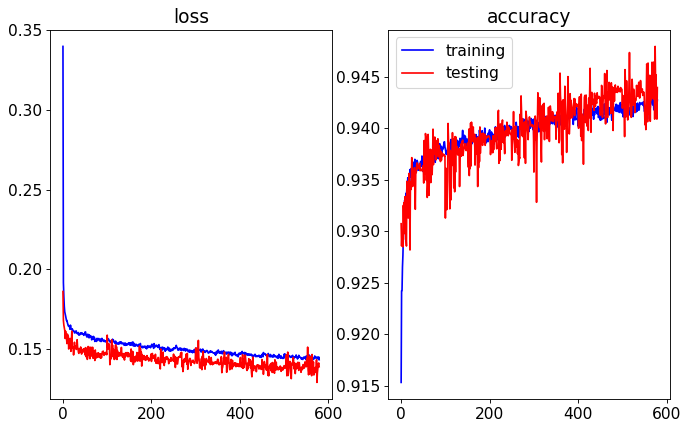

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.55it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


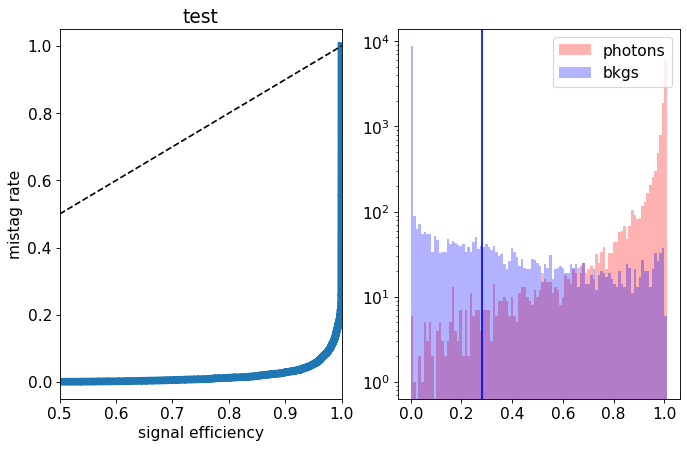

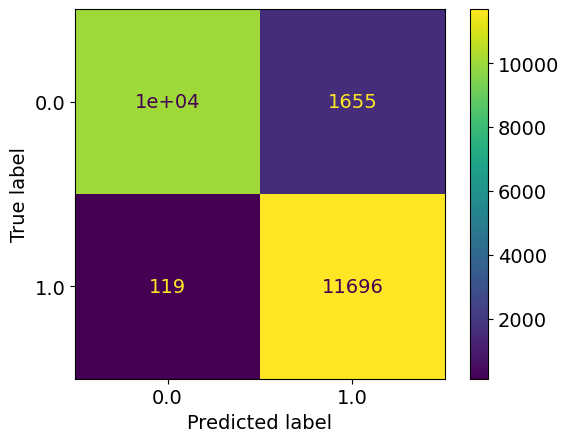

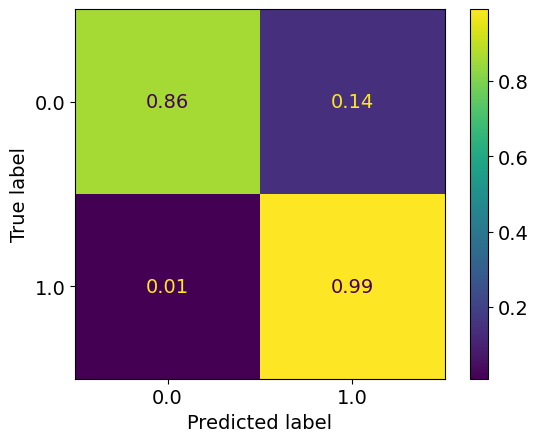

epoch: 580
Learning rate: 3.4568182296186134e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


train loss: 0.14399211227324357
train acc: 0.9425378


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.24it/s]


test loss: 0.13934042006731034
test acc: 0.943049
epoch: 581
Learning rate: 3.161237880090216e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14341208305518338
train acc: 0.9423253


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.53it/s]


test loss: 0.13551076427102088
test acc: 0.94487655
epoch: 582
Learning rate: 2.8729142845985978e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.1444071310151155
train acc: 0.9427609


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.16it/s]


test loss: 0.13758193869143726
test acc: 0.94389904
epoch: 583
Learning rate: 2.5929853246526404e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14440592601420774
train acc: 0.942049


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.74it/s]


test loss: 0.13541367389261721
test acc: 0.94504654
epoch: 584
Learning rate: 2.3225557519698758e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14443155496743074
train acc: 0.9425484


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.39it/s]


test loss: 0.13931258730590343
test acc: 0.942624
epoch: 585
Learning rate: 2.0626928285261642e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.09it/s]


train loss: 0.1440411423611793
train acc: 0.94273967


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.53it/s]


test loss: 0.14094951916486026
test acc: 0.943134
epoch: 586
Learning rate: 1.8144221145602574e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14269945224758926
train acc: 0.94215524


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.52it/s]


test loss: 0.13652002792805434
test acc: 0.9444515
epoch: 587
Learning rate: 1.5787234211560807e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14334022951353886
train acc: 0.9423784


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.85it/s]


test loss: 0.1348166186362505
test acc: 0.94470656
epoch: 588
Learning rate: 1.3565269433760108e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.10it/s]


train loss: 0.1447154951703017
train acc: 0.9426653


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.07it/s]


test loss: 0.13861804995685817
test acc: 0.94394153
epoch: 589
Learning rate: 1.1487095892059296e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.14444560083044564
train acc: 0.94168776


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.80it/s]


test loss: 0.1384573642164469
test acc: 0.94372904


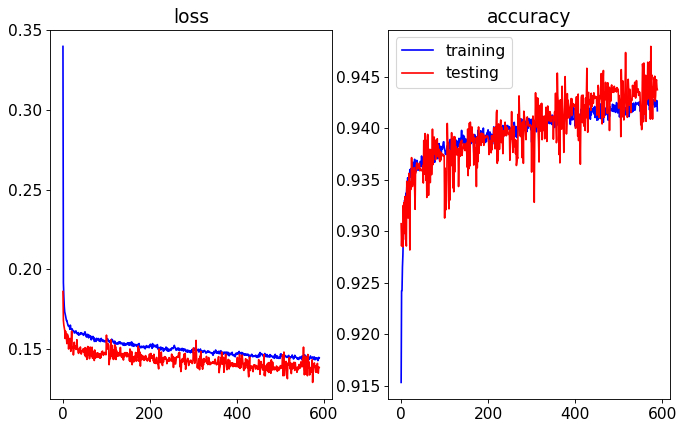

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.32it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


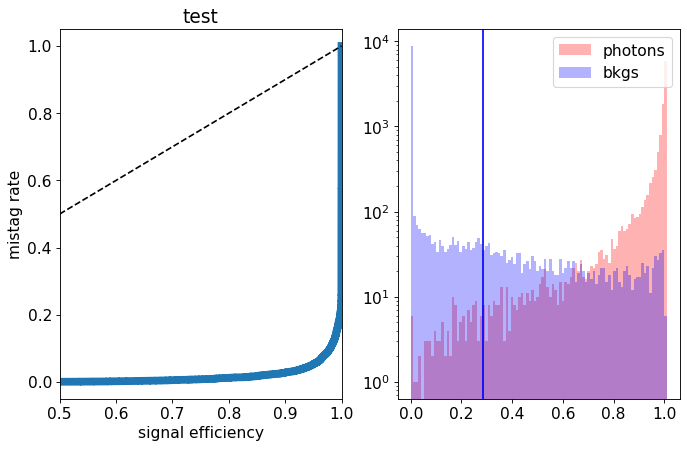

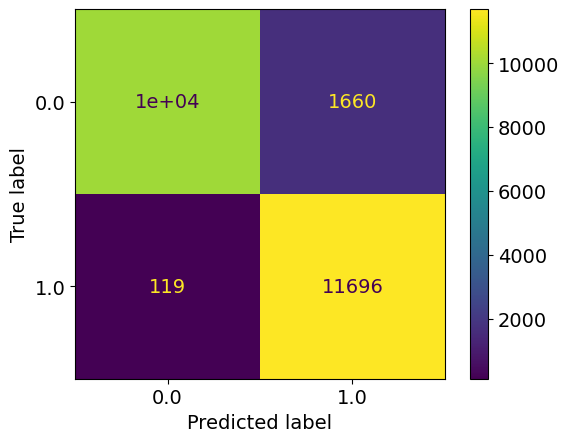

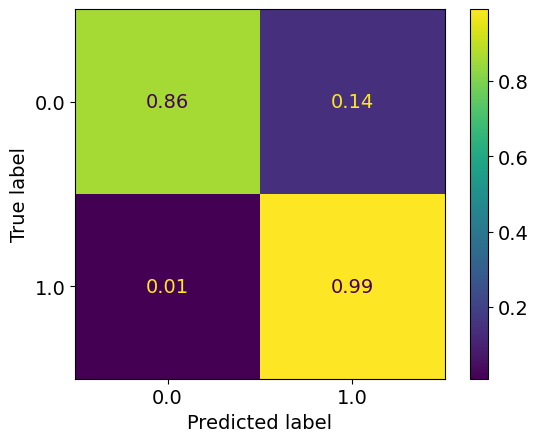

epoch: 590
Learning rate: 9.56091518800029e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.11it/s]


train loss: 0.14414009380682258
train acc: 0.94224024


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.10it/s]


test loss: 0.13475928865373135
test acc: 0.94474906
epoch: 591
Learning rate: 7.794329076833768e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14302507455751395
train acc: 0.9422509


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.93it/s]


test loss: 0.1364640813320875
test acc: 0.94474906
epoch: 592
Learning rate: 6.194309466864034e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.18it/s]


train loss: 0.14350110344636213
train acc: 0.94299465


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.78it/s]


test loss: 0.13650553692132233
test acc: 0.9440265
epoch: 593
Learning rate: 4.76717090451227e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1433880261270104
train acc: 0.9425484


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.47it/s]


test loss: 0.13573040515184404
test acc: 0.944154
epoch: 594
Learning rate: 3.518545653686456e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.1431320767588676
train acc: 0.9428034


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.16it/s]


test loss: 0.13546940479427577
test acc: 0.944494
epoch: 595
Learning rate: 2.453361467808979e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.20it/s]


train loss: 0.14354565298291527
train acc: 0.94281405


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.54it/s]


test loss: 0.13628110829740764
test acc: 0.944579
epoch: 596
Learning rate: 1.5758221422251474e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14232161076395375
train acc: 0.9425909


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.17it/s]


test loss: 0.13578427582979202
test acc: 0.944409
epoch: 597
Learning rate: 8.893909237434605e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.14195792500380497
train acc: 0.9433347


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.58it/s]


test loss: 0.13639028295874595
test acc: 0.9445365
epoch: 598
Learning rate: 3.967768427826535e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14317526250698004
train acc: 0.94278216


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.64it/s]


test loss: 0.13570560067892073
test acc: 0.944579
epoch: 599
Learning rate: 9.992402206632778e-08


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1435271835156307
train acc: 0.942559


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.45it/s]


test loss: 0.13671603389084339
test acc: 0.944579


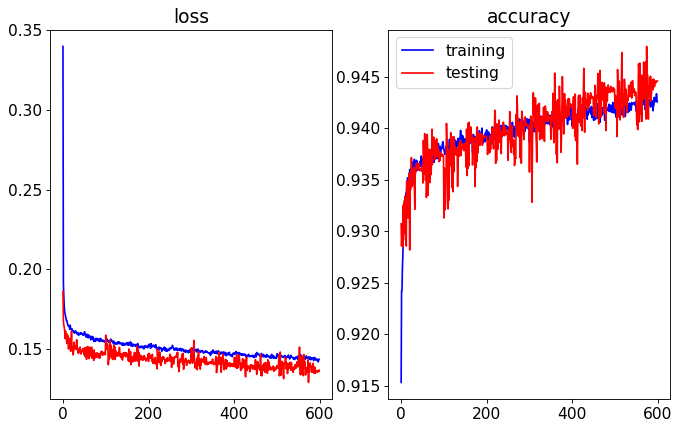

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.73it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


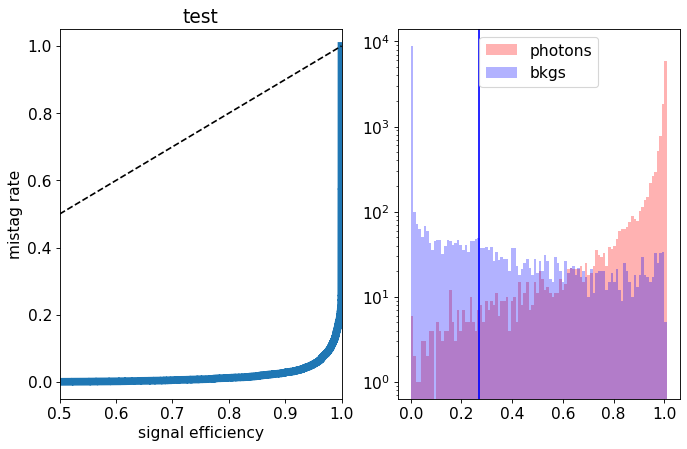

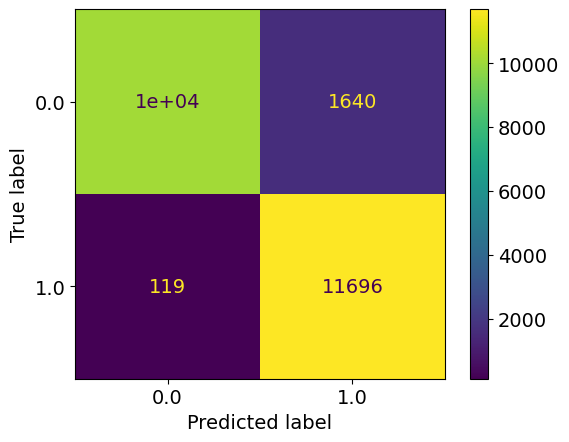

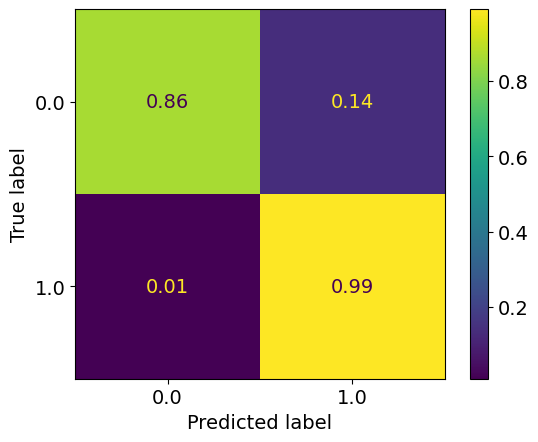

epoch: 600
Learning rate: 4.004058690165735e-12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.46it/s]


train loss: 0.14398046136851522
train acc: 0.9422084


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.48it/s]


test loss: 0.14458480812609195
test acc: 0.9409665
epoch: 601
Learning rate: 9.99025888725783e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14417565580765912
train acc: 0.94228274


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.77it/s]


test loss: 0.13115014284849166
test acc: 0.94619405
epoch: 602
Learning rate: 9.960823902925945e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.02it/s]


train loss: 0.14443493316507644
train acc: 0.94184715


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.44it/s]


test loss: 0.1416634077206254
test acc: 0.9424115
epoch: 603
Learning rate: 9.911810813034072e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.1437796695501941
train acc: 0.94218713


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.75it/s]


test loss: 0.13437341004610062
test acc: 0.94653404
epoch: 604
Learning rate: 9.84341304985606e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14411674420924703
train acc: 0.9413477


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.62it/s]


test loss: 0.13154657669365405
test acc: 0.9478516
epoch: 605
Learning rate: 9.755900548115212e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.16it/s]


train loss: 0.14399283887094752
train acc: 0.9422721


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.27it/s]


test loss: 0.13793851546943187
test acc: 0.94483405
epoch: 606
Learning rate: 9.649618679675236e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.1440322865156611
train acc: 0.9425484


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.53it/s]


test loss: 0.14102971591055394
test acc: 0.941179
epoch: 607
Learning rate: 9.524986890515297e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.18it/s]


train loss: 0.14393580429683064
train acc: 0.9420065


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.00it/s]


test loss: 0.13208558717742563
test acc: 0.94585407
epoch: 608
Learning rate: 9.382497045368364e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14529513619887602
train acc: 0.9415177


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.76it/s]


test loss: 0.13090241495519878
test acc: 0.94602406
epoch: 609
Learning rate: 9.222711486555813e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14446915657656967
train acc: 0.94205964


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.86it/s]


test loss: 0.13707534745335578
test acc: 0.94398403


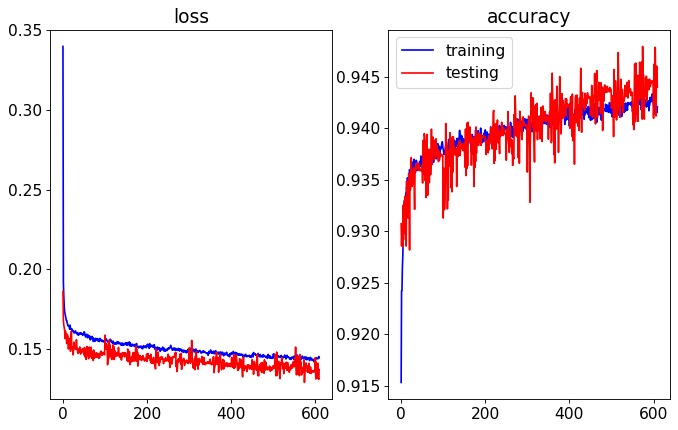

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.68it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


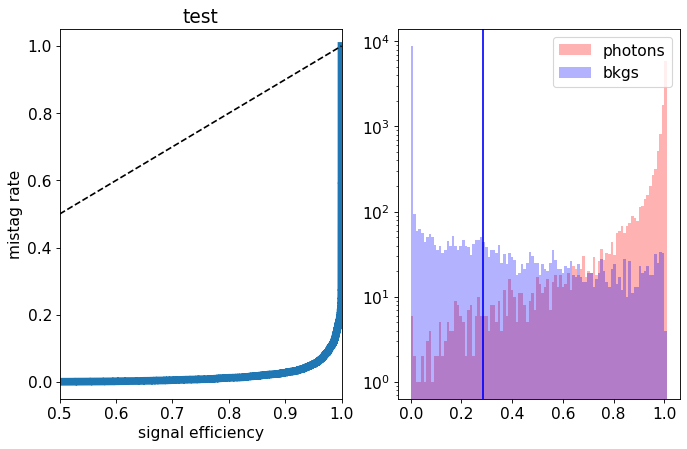

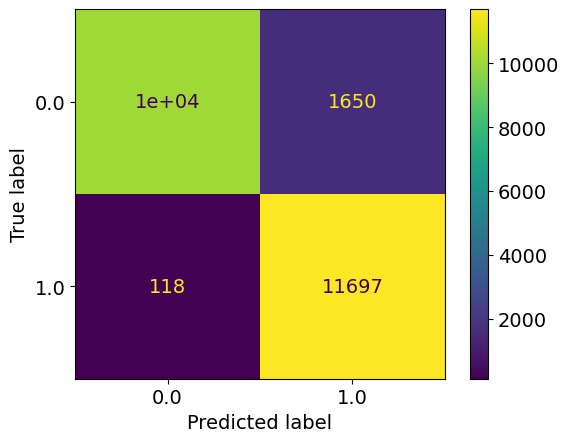

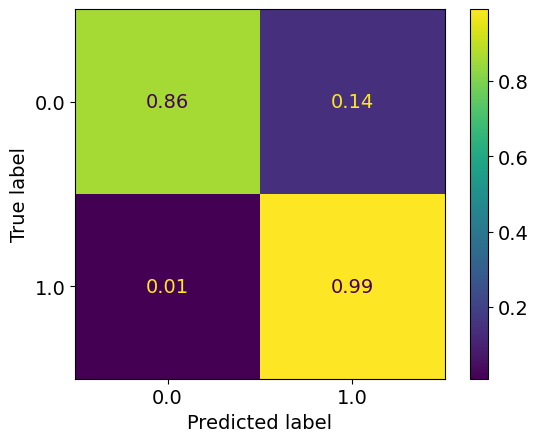

epoch: 610
Learning rate: 9.046260814679199e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14448274947275783
train acc: 0.9424846


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.16it/s]


test loss: 0.13567276187241079
test acc: 0.943134
epoch: 611
Learning rate: 8.853841399927774e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.14486236950963927
train acc: 0.9422509


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.46it/s]


test loss: 0.134815127030015
test acc: 0.94530153
epoch: 612
Learning rate: 8.646212633823493e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.11it/s]


train loss: 0.14414247623674428
train acc: 0.9426334


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.24it/s]


test loss: 0.14450611378997563
test acc: 0.942794
epoch: 613
Learning rate: 8.42419393224961e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14520267269034295
train acc: 0.9422084


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.62it/s]


test loss: 0.14025129713118076
test acc: 0.9426665
epoch: 614
Learning rate: 8.188661501590543e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.144721416578551
train acc: 0.9423996


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.98it/s]


test loss: 0.13642741851508616
test acc: 0.945514
epoch: 615
Learning rate: 7.940544880745565e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14465760131170796
train acc: 0.94219774


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.70it/s]


test loss: 0.13792871460318565
test acc: 0.94377154
epoch: 616
Learning rate: 7.680823272663455e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.14384858120398916
train acc: 0.9427609


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.18it/s]


test loss: 0.14706625882536173
test acc: 0.942794
epoch: 617
Learning rate: 7.410521679875796e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.16it/s]


train loss: 0.14443006314289797
train acc: 0.9425484


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.13617412354797126
test acc: 0.94640654
epoch: 618
Learning rate: 7.130706859280269e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.144047842995756
train acc: 0.9423146


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.38it/s]


test loss: 0.14202978033572436
test acc: 0.9418165
epoch: 619
Learning rate: 6.842483112138533e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1440722493419222
train acc: 0.9423146


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.20it/s]


test loss: 0.13830521535128354
test acc: 0.94513154


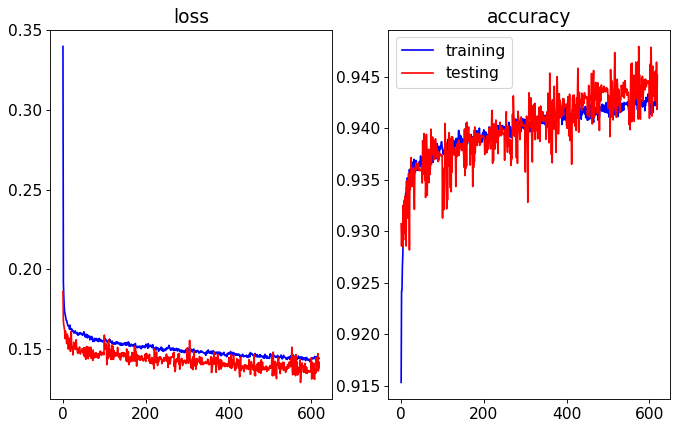

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.19it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


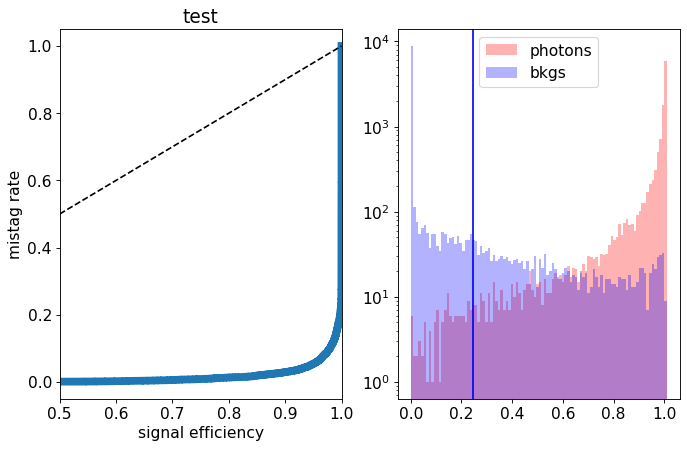

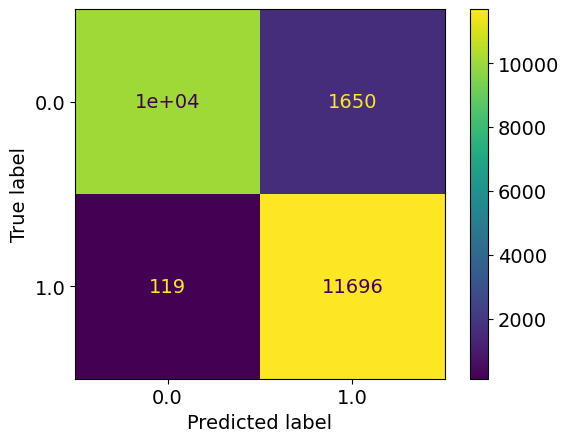

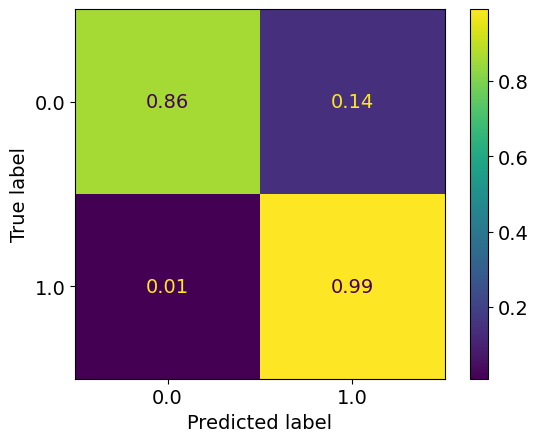

epoch: 620
Learning rate: 6.546987925903652e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.1440463606624087
train acc: 0.94285655


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.39it/s]


test loss: 0.13576976023614407
test acc: 0.944409
epoch: 621
Learning rate: 6.245387485076784e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14501098756957206
train acc: 0.9415496


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.39it/s]


test loss: 0.131533844769001
test acc: 0.94746906
epoch: 622
Learning rate: 5.93887206880974e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.17it/s]


train loss: 0.14340778976489024
train acc: 0.94268656


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.47it/s]


test loss: 0.13708816971629859
test acc: 0.94513154
epoch: 623
Learning rate: 5.6286513534169517e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14397786049895986
train acc: 0.94215524


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.54it/s]


test loss: 0.1405051177367568
test acc: 0.944154
epoch: 624
Learning rate: 5.315949638335711e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.14325811495636678
train acc: 0.9422934


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.46it/s]


test loss: 0.13325220625847578
test acc: 0.94657654
epoch: 625
Learning rate: 5.00200101437562e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14363613900295488
train acc: 0.9421659


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.95it/s]


test loss: 0.13778111580759286
test acc: 0.94534403
epoch: 626
Learning rate: 4.6880444933259634e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.54it/s]


train loss: 0.14319903152004168
train acc: 0.94288844


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.39it/s]


test loss: 0.14669046103954314
test acc: 0.9408815
epoch: 627
Learning rate: 4.375319118142234e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.09it/s]


train loss: 0.1437871178054506
train acc: 0.94328153


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.95it/s]


test loss: 0.13330109603703022
test acc: 0.9475966
epoch: 628
Learning rate: 4.06505907300965e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1432774006656021
train acc: 0.94265467


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.44it/s]


test loss: 0.13336430843919517
test acc: 0.9457266
epoch: 629
Learning rate: 3.758488812582018e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.06it/s]


train loss: 0.1439681920181414
train acc: 0.94185776


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.02it/s]


test loss: 0.13681047037243843
test acc: 0.9455565


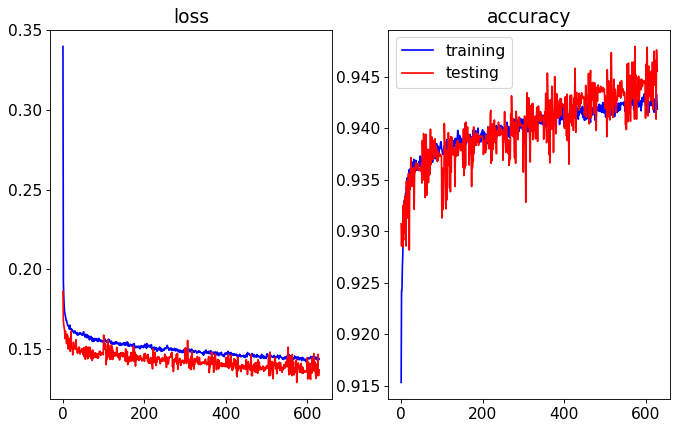

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.65it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


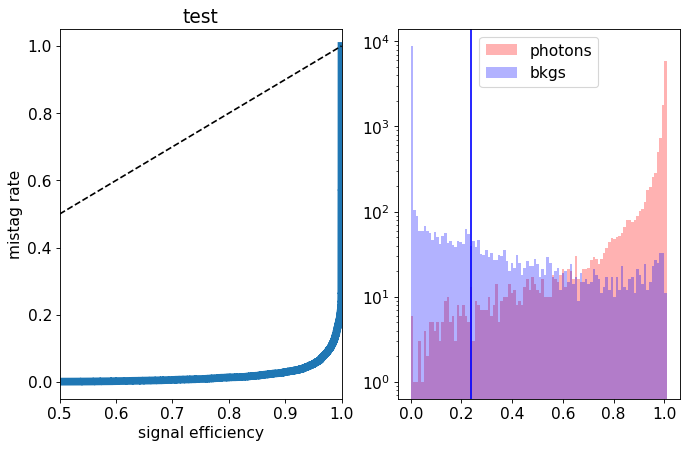

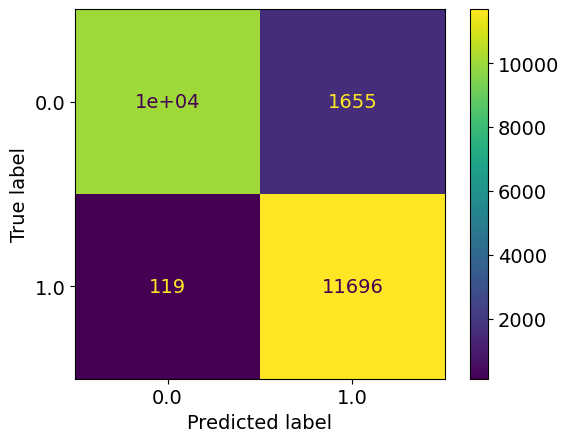

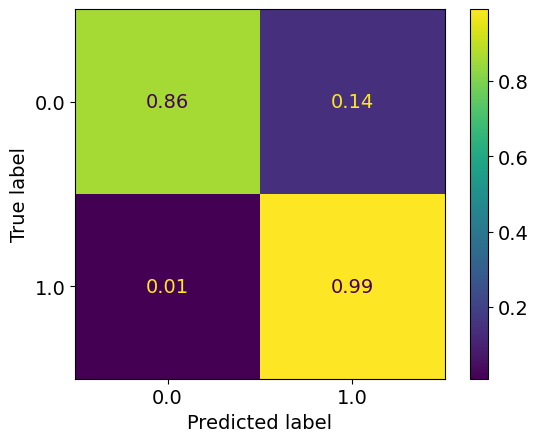

epoch: 630
Learning rate: 3.4568182296186134e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.54it/s]


train loss: 0.1431496220694226
train acc: 0.9426653


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.36it/s]


test loss: 0.1435560517013073
test acc: 0.941944
epoch: 631
Learning rate: 3.161237880090216e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.59it/s]


train loss: 0.14414514624958585
train acc: 0.94196403


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.83it/s]


test loss: 0.14201504830271006
test acc: 0.943474
epoch: 632
Learning rate: 2.8729142845985978e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.143121161088822
train acc: 0.9425697


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.82it/s]


test loss: 0.1366224315017462
test acc: 0.94513154
epoch: 633
Learning rate: 2.5929853246526404e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14169622046552646
train acc: 0.94300526


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.30it/s]


test loss: 0.13812535405158996
test acc: 0.9443665
epoch: 634
Learning rate: 2.3225557519698758e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.08it/s]


train loss: 0.1438837844854707
train acc: 0.9427184


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.96it/s]


test loss: 0.13561452198773621
test acc: 0.94483405
epoch: 635
Learning rate: 2.0626928285261642e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14392925988716684
train acc: 0.9423571


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.85it/s]


test loss: 0.14081248566508292
test acc: 0.94398403
epoch: 636
Learning rate: 1.8144221145602574e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.1425690969369214
train acc: 0.9423784


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.64it/s]


test loss: 0.1398568594828248
test acc: 0.944239
epoch: 637
Learning rate: 1.5787234211560807e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14293587146101483
train acc: 0.94298404


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.00it/s]


test loss: 0.13663030974566936
test acc: 0.944579
epoch: 638
Learning rate: 1.3565269433760108e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.14194871826915983
train acc: 0.9432709


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.54it/s]


test loss: 0.13959263656288384
test acc: 0.9444515
epoch: 639
Learning rate: 1.1487095892059296e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.01it/s]


train loss: 0.14281650105859064
train acc: 0.94282466


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.48it/s]


test loss: 0.13602899704128504
test acc: 0.94496155


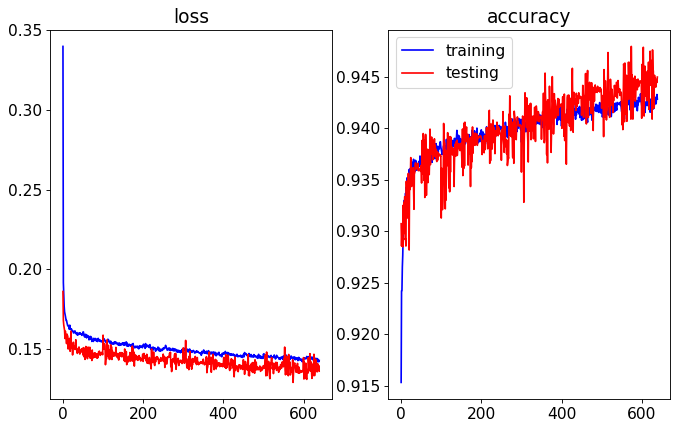

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.15it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


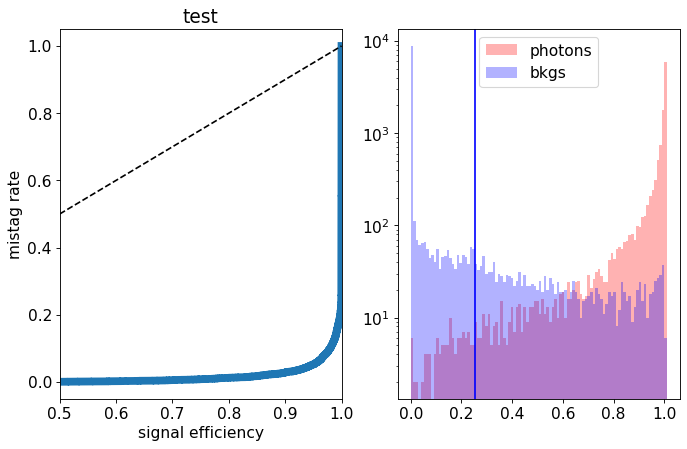

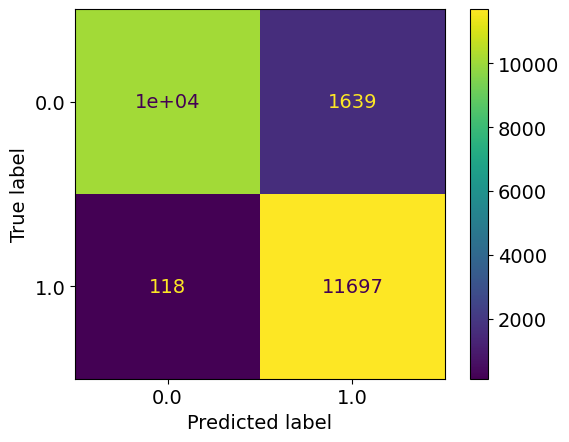

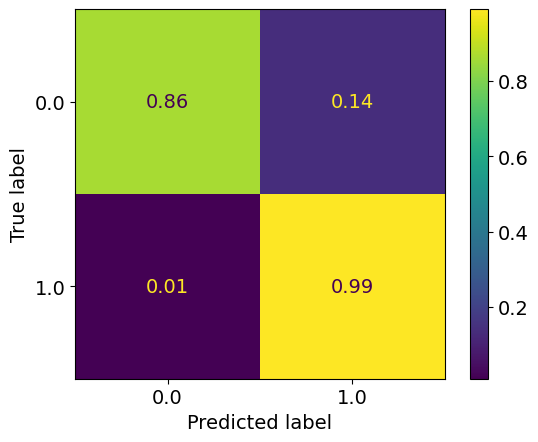

epoch: 640
Learning rate: 9.56091518800029e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14250568884193518
train acc: 0.94273967


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.43it/s]


test loss: 0.13902734890580176
test acc: 0.944324
epoch: 641
Learning rate: 7.794329076833768e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.13it/s]


train loss: 0.1430758903645406
train acc: 0.9423359


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.35it/s]


test loss: 0.1367526264861226
test acc: 0.9445365
epoch: 642
Learning rate: 6.194309466864034e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.1437713596851203
train acc: 0.9426015


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.78it/s]


test loss: 0.13768575955182313
test acc: 0.94470656
epoch: 643
Learning rate: 4.76717090451227e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14195099567911426
train acc: 0.9432178


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.98it/s]


test loss: 0.13664536345750095
test acc: 0.9446215
epoch: 644
Learning rate: 3.518545653686456e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


train loss: 0.14280607366258172
train acc: 0.94289905


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.52it/s]


test loss: 0.13544437177479268
test acc: 0.9445365
epoch: 645
Learning rate: 2.453361467808979e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14286513768943251
train acc: 0.9431753


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.72it/s]


test loss: 0.13598637711256742
test acc: 0.9446215
epoch: 646
Learning rate: 1.5758221422251474e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.1435475161500797
train acc: 0.9426653


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.12it/s]


test loss: 0.1373538265004754
test acc: 0.94466406
epoch: 647
Learning rate: 8.893909237434605e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14326256470885246
train acc: 0.94277155


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.90it/s]


test loss: 0.13612168487161397
test acc: 0.944579
epoch: 648
Learning rate: 3.967768427826535e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14269591943853221
train acc: 0.9432709


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.46it/s]


test loss: 0.13840402029454707
test acc: 0.944579
epoch: 649
Learning rate: 9.992402206632778e-08


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.08it/s]


train loss: 0.14302952127282026
train acc: 0.94269717


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.86it/s]


test loss: 0.13756246101111175
test acc: 0.944579


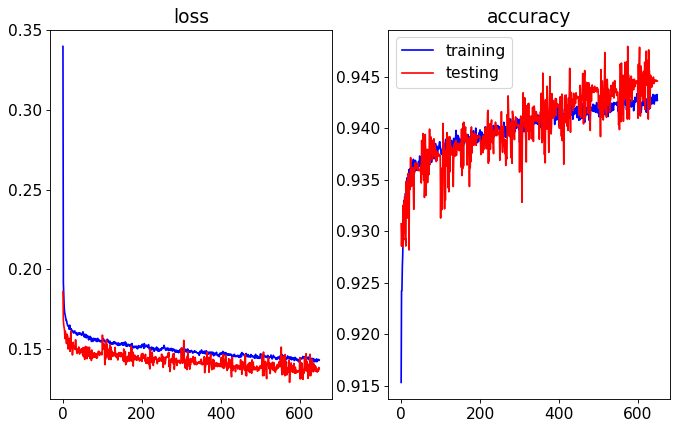

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.92it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


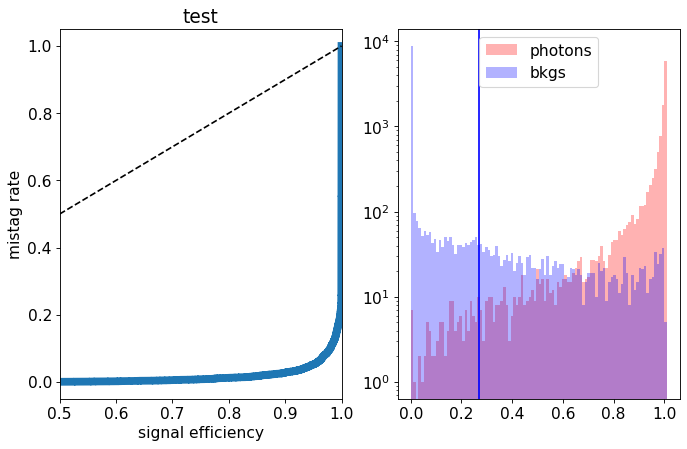

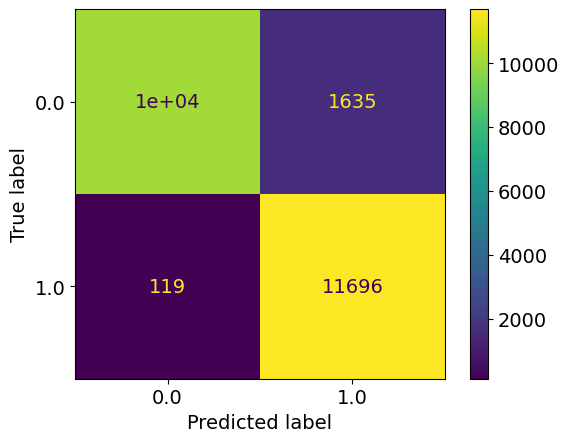

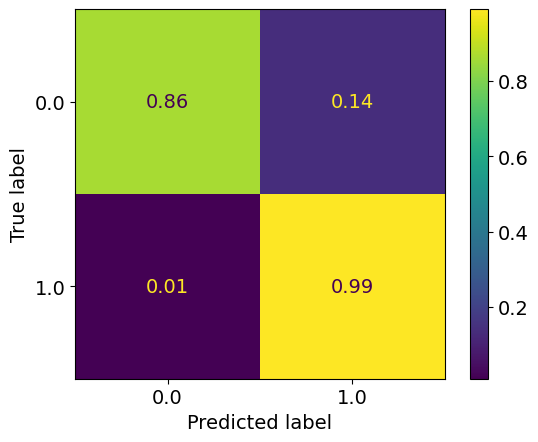

epoch: 650
Learning rate: 4.004058690165735e-12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14331590602542185
train acc: 0.94292027


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.68it/s]


test loss: 0.13442006427794695
test acc: 0.94508904
epoch: 651
Learning rate: 9.99025888725783e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.14it/s]


train loss: 0.14374450859939977
train acc: 0.941794


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.26it/s]


test loss: 0.1418120089918375
test acc: 0.942539
epoch: 652
Learning rate: 9.960823902925945e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14421227863829605
train acc: 0.9428034


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.62it/s]


test loss: 0.1353069558739662
test acc: 0.9456416
epoch: 653
Learning rate: 9.911810813034072e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1440238554481488
train acc: 0.9426334


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.51it/s]


test loss: 0.137411505356431
test acc: 0.944409
epoch: 654
Learning rate: 9.84341304985606e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.19it/s]


train loss: 0.14356164895235354
train acc: 0.9424209


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.41it/s]


test loss: 0.13293999787420036
test acc: 0.945429
epoch: 655
Learning rate: 9.755900548115212e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14256634026955647
train acc: 0.9425697


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.42it/s]


test loss: 0.14166961824521423
test acc: 0.9470866
epoch: 656
Learning rate: 9.649618679675236e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.14it/s]


train loss: 0.14558768120540935
train acc: 0.9425484


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.02it/s]


test loss: 0.1365620182827115
test acc: 0.94479156
epoch: 657
Learning rate: 9.524986890515297e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.143755667575985
train acc: 0.94196403


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.14513023849576712
test acc: 0.942369
epoch: 658
Learning rate: 9.382497045368364e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14484726779969634
train acc: 0.9422509


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.60it/s]


test loss: 0.13322083000093699
test acc: 0.9456416
epoch: 659
Learning rate: 9.222711486555813e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.16it/s]


train loss: 0.1430315579863111
train acc: 0.9424315


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.36it/s]


test loss: 0.14514387771487236
test acc: 0.943049


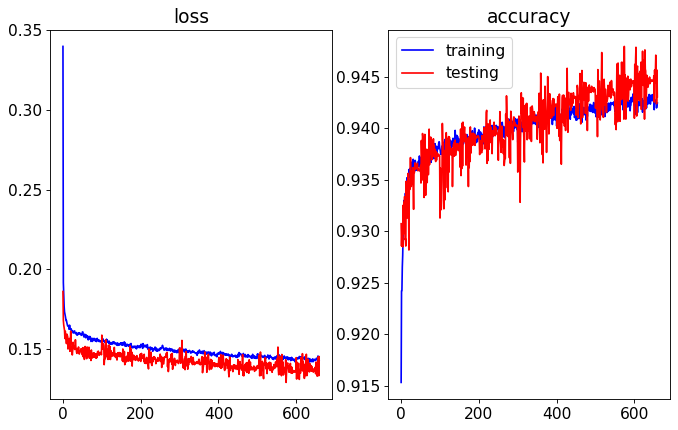

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.67it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


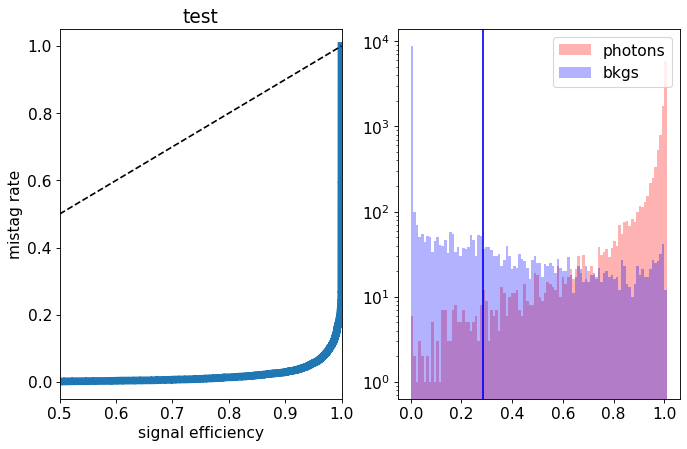

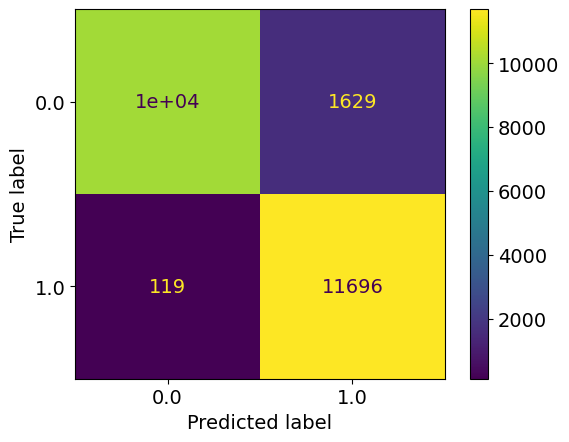

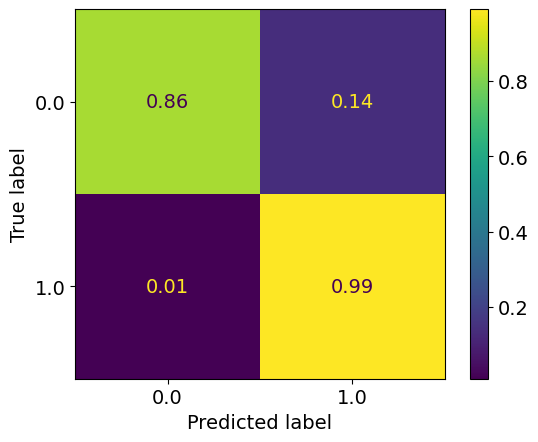

epoch: 660
Learning rate: 9.046260814679199e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14435735159808663
train acc: 0.9417515


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.86it/s]


test loss: 0.1412065362557769
test acc: 0.941859
epoch: 661
Learning rate: 8.853841399927774e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.14it/s]


train loss: 0.14259330097846923
train acc: 0.94302654


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.76it/s]


test loss: 0.13009609691798688
test acc: 0.9476391
epoch: 662
Learning rate: 8.646212633823493e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14366074812829874
train acc: 0.94178337


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.75it/s]


test loss: 0.14787342250347138
test acc: 0.9364614
epoch: 663
Learning rate: 8.42419393224961e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14343091959406615
train acc: 0.9435897


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.81it/s]


test loss: 0.13282521590590476
test acc: 0.9466191
epoch: 664
Learning rate: 8.188661501590543e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14319234051901825
train acc: 0.9426653


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.85it/s]


test loss: 0.14317535739392043
test acc: 0.94385654
epoch: 665
Learning rate: 7.940544880745565e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.1428838896143968
train acc: 0.94290966


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.86it/s]


test loss: 0.1472410188987851
test acc: 0.942369
epoch: 666
Learning rate: 7.680823272663455e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.17it/s]


train loss: 0.14188477012572015
train acc: 0.94277155


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.57it/s]


test loss: 0.13903911467641591
test acc: 0.9457266
epoch: 667
Learning rate: 7.410521679875796e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1447214320017274
train acc: 0.9426759


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.49it/s]


test loss: 0.14023006930947304
test acc: 0.9430915
epoch: 668
Learning rate: 7.130706859280269e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14379862121715667
train acc: 0.9427184


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.29it/s]


test loss: 0.13954477179795505
test acc: 0.943304
epoch: 669
Learning rate: 6.842483112138533e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14334985191465183
train acc: 0.94269717


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.92it/s]


test loss: 0.13957031685858964
test acc: 0.944579


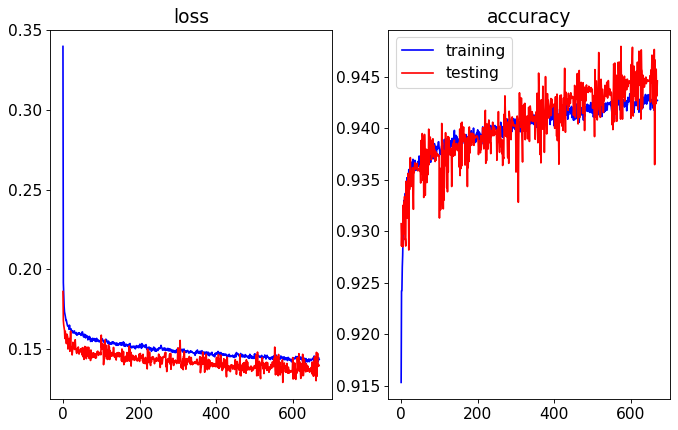

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.27it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


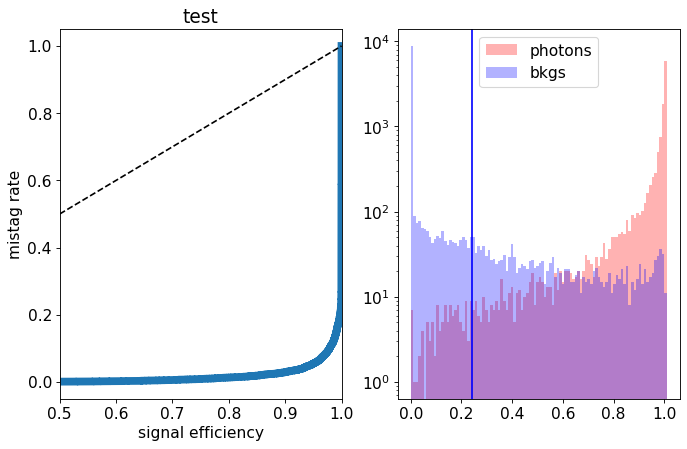

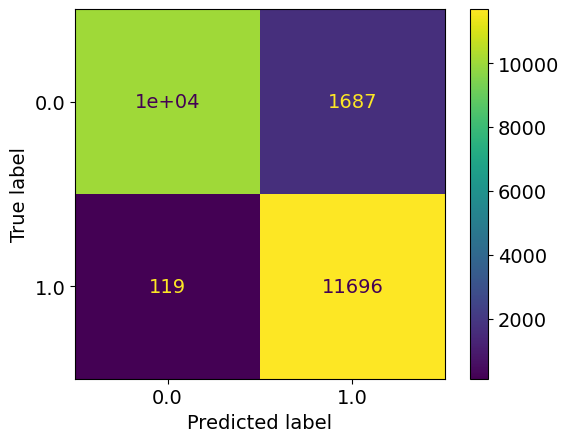

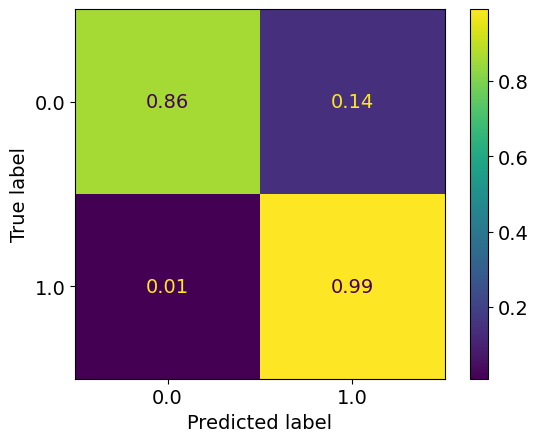

epoch: 670
Learning rate: 6.546987925903652e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.14391510976347954
train acc: 0.9426122


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.80it/s]


test loss: 0.13367909975349904
test acc: 0.9453865
epoch: 671
Learning rate: 6.245387485076784e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


train loss: 0.14393482670472685
train acc: 0.9422509


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.99it/s]


test loss: 0.13351331353187562
test acc: 0.94746906
epoch: 672
Learning rate: 5.93887206880974e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.14424281230398045
train acc: 0.942219


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.95it/s]


test loss: 0.13589966278523208
test acc: 0.94504654
epoch: 673
Learning rate: 5.6286513534169517e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.08it/s]


train loss: 0.143062112200412
train acc: 0.9428353


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.57it/s]


test loss: 0.14307773299515247
test acc: 0.9412215
epoch: 674
Learning rate: 5.315949638335711e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.1436825151656084
train acc: 0.9424528


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.70it/s]


test loss: 0.13319367226213216
test acc: 0.9466191
epoch: 675
Learning rate: 5.00200101437562e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.14299669306559168
train acc: 0.94281405


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.04it/s]


test loss: 0.13869363944977522
test acc: 0.9444515
epoch: 676
Learning rate: 4.6880444933259634e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.10it/s]


train loss: 0.14298381333708005
train acc: 0.94273967


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.87it/s]


test loss: 0.14423118960112333
test acc: 0.94270897
epoch: 677
Learning rate: 4.375319118142234e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1430543336044451
train acc: 0.94307965


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.69it/s]


test loss: 0.14097921103239058
test acc: 0.9440265
epoch: 678
Learning rate: 4.06505907300965e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


train loss: 0.14279236018088212
train acc: 0.94282466


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.01it/s]


test loss: 0.1423041082918644
test acc: 0.943474
epoch: 679
Learning rate: 3.758488812582018e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14312760019378298
train acc: 0.9433347


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.37it/s]


test loss: 0.1328592211008072
test acc: 0.94653404


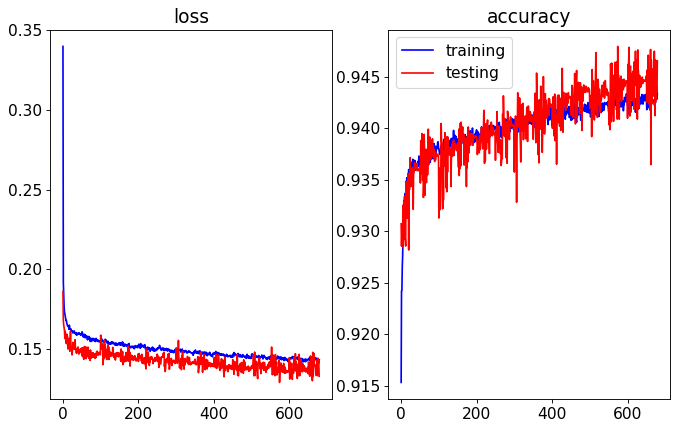

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.00it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


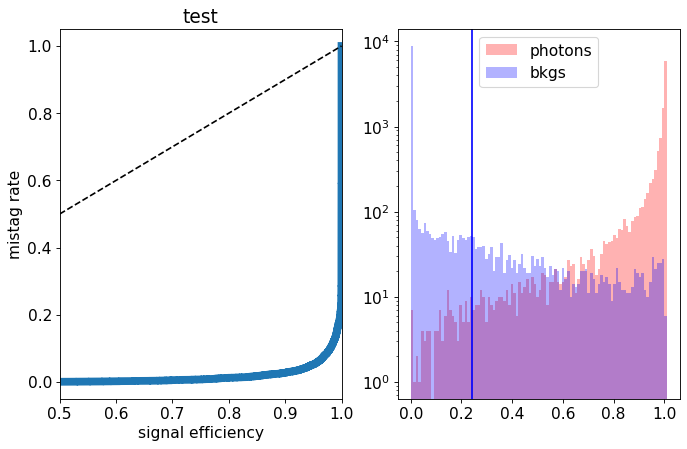

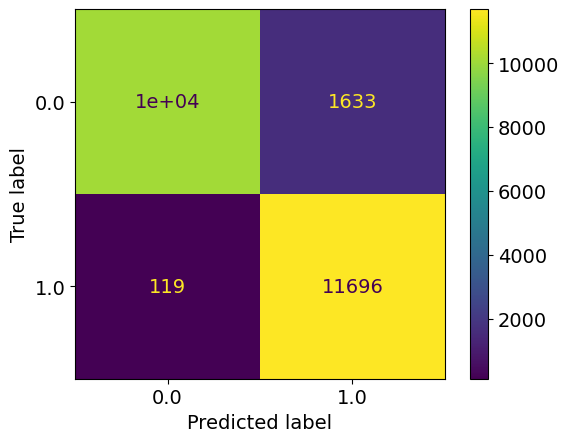

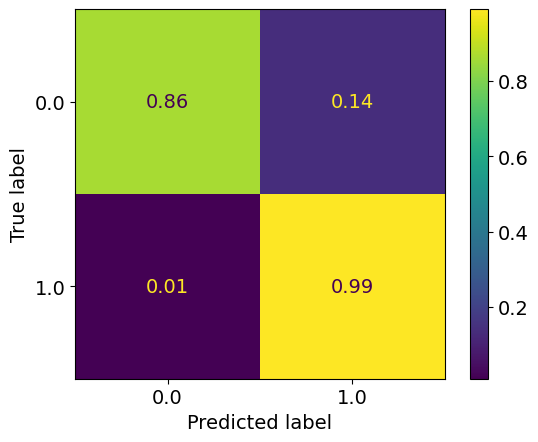

epoch: 680
Learning rate: 3.4568182296186134e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14198834477526368
train acc: 0.9426759


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.99it/s]


test loss: 0.13492611460387707
test acc: 0.94632155
epoch: 681
Learning rate: 3.161237880090216e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14207239486988943
train acc: 0.94292027


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.57it/s]


test loss: 0.1413153724744916
test acc: 0.9434315
epoch: 682
Learning rate: 2.8729142845985978e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.14322721345978937
train acc: 0.9433984


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.35it/s]


test loss: 0.13327221255749463
test acc: 0.94585407
epoch: 683
Learning rate: 2.5929853246526404e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.09it/s]


train loss: 0.14286712205903546
train acc: 0.942389


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.13923697732388973
test acc: 0.9443665
epoch: 684
Learning rate: 2.3225557519698758e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14183617796108222
train acc: 0.9431009


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.50it/s]


test loss: 0.1388735767453909
test acc: 0.9446215
epoch: 685
Learning rate: 2.0626928285261642e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.54it/s]


train loss: 0.1429251726645573
train acc: 0.94303715


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.25it/s]


test loss: 0.14004159085452555
test acc: 0.94517404
epoch: 686
Learning rate: 1.8144221145602574e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14268399627914854
train acc: 0.94294155


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.08it/s]


test loss: 0.13978049885481597
test acc: 0.943219
epoch: 687
Learning rate: 1.5787234211560807e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1428286789139365
train acc: 0.9434091


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.81it/s]


test loss: 0.13762417901307344
test acc: 0.94504654
epoch: 688
Learning rate: 1.3565269433760108e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.06it/s]


train loss: 0.1427667308480117
train acc: 0.94319654


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.96it/s]


test loss: 0.13922774214297534
test acc: 0.9441115
epoch: 689
Learning rate: 1.1487095892059296e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1432012634672177
train acc: 0.9432922


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.63it/s]


test loss: 0.13566778060048817
test acc: 0.94496155


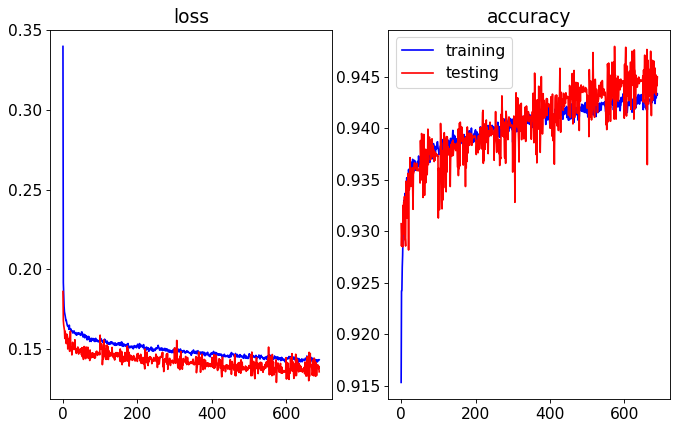

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.64it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


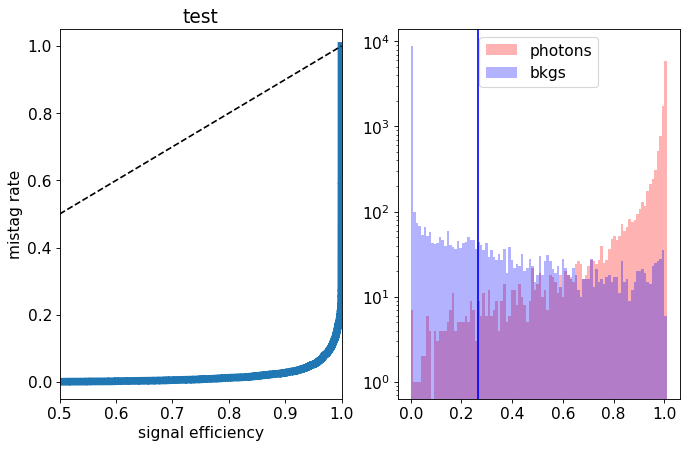

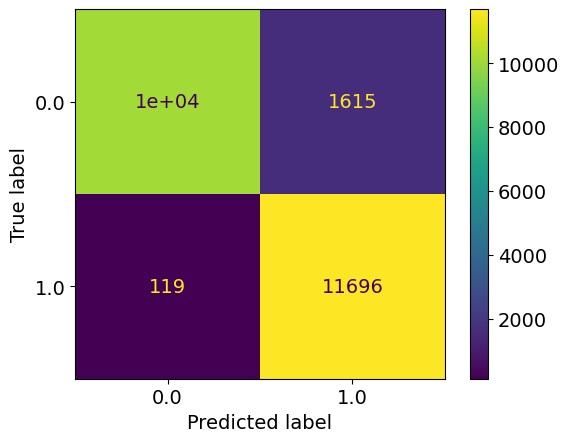

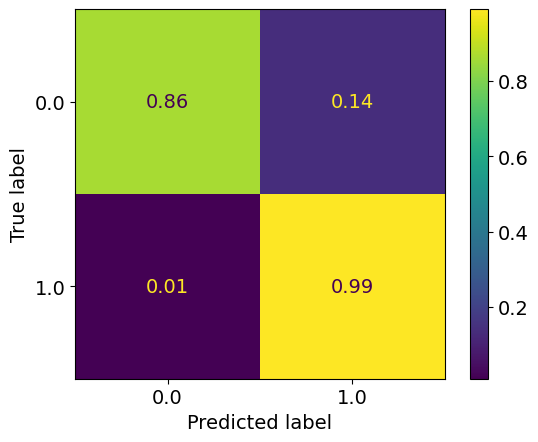

epoch: 690
Learning rate: 9.56091518800029e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.05it/s]


train loss: 0.14253229258736227
train acc: 0.9434303


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.70it/s]


test loss: 0.13707069475203754
test acc: 0.94525903
epoch: 691
Learning rate: 7.794329076833768e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14198233220417789
train acc: 0.9426653


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.79it/s]


test loss: 0.13509669248014688
test acc: 0.94504654
epoch: 692
Learning rate: 6.194309466864034e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14320925200820728
train acc: 0.94290966


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.63it/s]


test loss: 0.13492290657013656
test acc: 0.94517404
epoch: 693
Learning rate: 4.76717090451227e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.14368646098360136
train acc: 0.9430478


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.06it/s]


test loss: 0.13594254460185767
test acc: 0.94483405
epoch: 694
Learning rate: 3.518545653686456e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14237151646120533
train acc: 0.9428353


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.22it/s]


test loss: 0.13705806862562894
test acc: 0.94474906
epoch: 695
Learning rate: 2.453361467808979e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.17it/s]


train loss: 0.14369355626167005
train acc: 0.9427928


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.24it/s]


test loss: 0.13581011556088923
test acc: 0.94500405
epoch: 696
Learning rate: 1.5758221422251474e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14272259939817866
train acc: 0.94300526


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.84it/s]


test loss: 0.13737351447343826
test acc: 0.94504654
epoch: 697
Learning rate: 8.893909237434605e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1429080676026405
train acc: 0.94273967


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.54it/s]


test loss: 0.13825816325843335
test acc: 0.94483405
epoch: 698
Learning rate: 3.967768427826535e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.14257368801315878
train acc: 0.9434303


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.05it/s]


test loss: 0.13678823113441468
test acc: 0.94491905
epoch: 699
Learning rate: 9.992402206632778e-08


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14167111813072947
train acc: 0.9434622


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.50it/s]


test loss: 0.1374145532026887
test acc: 0.94487655


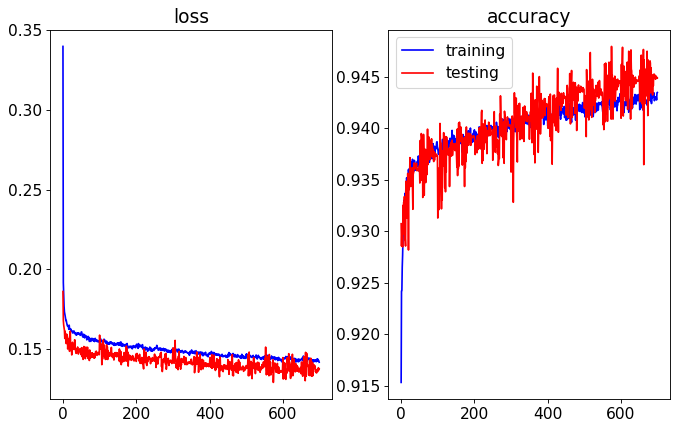

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.47it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


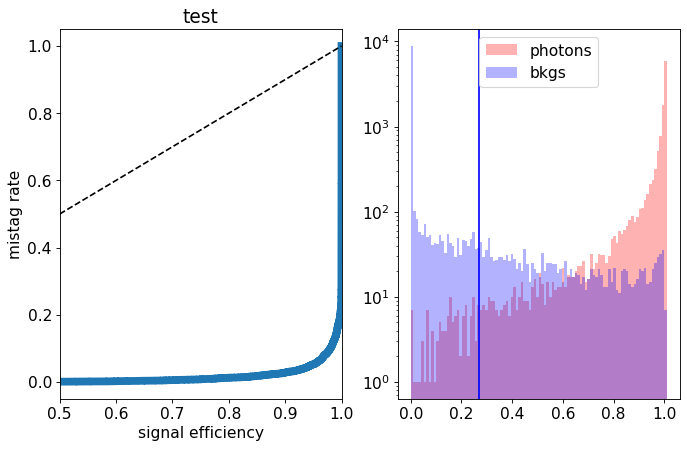

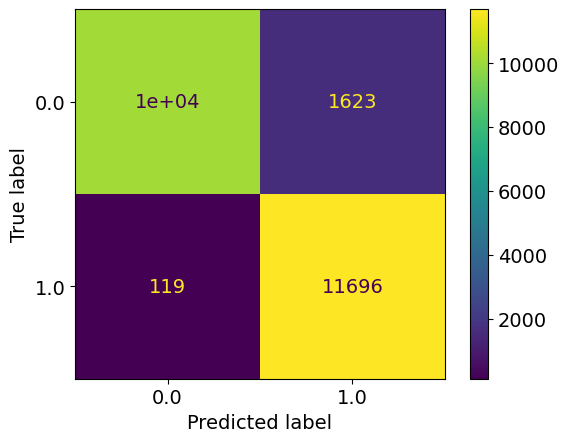

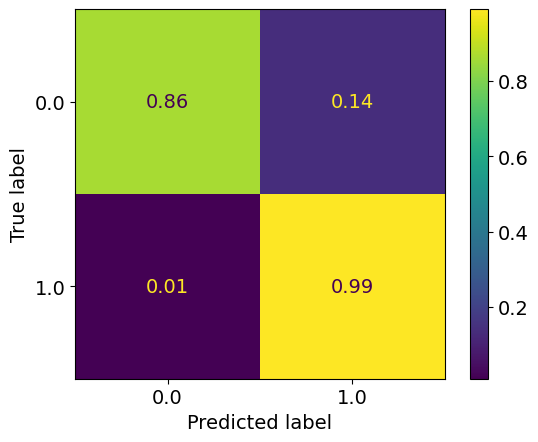

epoch: 700
Learning rate: 4.004058690165735e-12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


train loss: 0.14353560684782685
train acc: 0.94307965


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.59it/s]


test loss: 0.13486645705997943
test acc: 0.9453865
epoch: 701
Learning rate: 9.99025888725783e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.1438258306900407
train acc: 0.94302654


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.48it/s]


test loss: 0.13884900230914354
test acc: 0.944494
epoch: 702
Learning rate: 9.960823902925945e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14468962357492204
train acc: 0.942134


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.57it/s]


test loss: 0.13306693425402044
test acc: 0.94649154
epoch: 703
Learning rate: 9.911810813034072e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.143077458877852
train acc: 0.9424315


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.78it/s]


test loss: 0.13228934556245803
test acc: 0.9470016
epoch: 704
Learning rate: 9.84341304985606e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14311330822432877
train acc: 0.942474


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.33it/s]


test loss: 0.132356046885252
test acc: 0.94729906
epoch: 705
Learning rate: 9.755900548115212e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.14it/s]


train loss: 0.1432470741450407
train acc: 0.9431009


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.63it/s]


test loss: 0.13953741546720266
test acc: 0.9427515
epoch: 706
Learning rate: 9.649618679675236e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1435932673181698
train acc: 0.94302654


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.70it/s]


test loss: 0.13451668359339236
test acc: 0.94589657
epoch: 707
Learning rate: 9.524986890515297e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14295356469169543
train acc: 0.94301593


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.80it/s]


test loss: 0.13485542703419923
test acc: 0.9470016
epoch: 708
Learning rate: 9.382497045368364e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1429578906316666
train acc: 0.9425165


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.87it/s]


test loss: 0.14224308356642723
test acc: 0.94525903
epoch: 709
Learning rate: 9.222711486555813e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14168304015117086
train acc: 0.9427503


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.73it/s]


test loss: 0.1454848239198327
test acc: 0.9433465


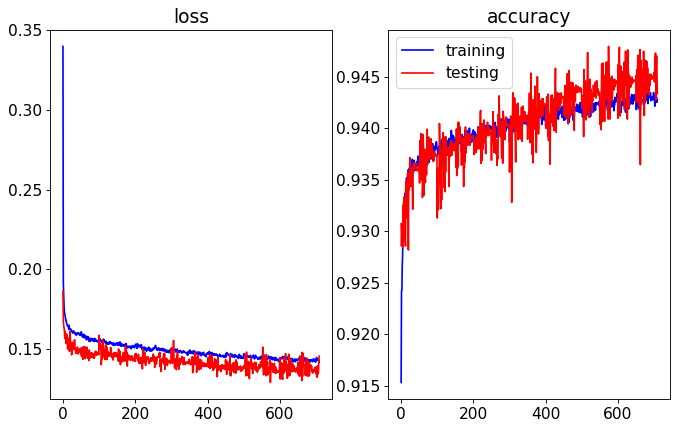

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.42it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


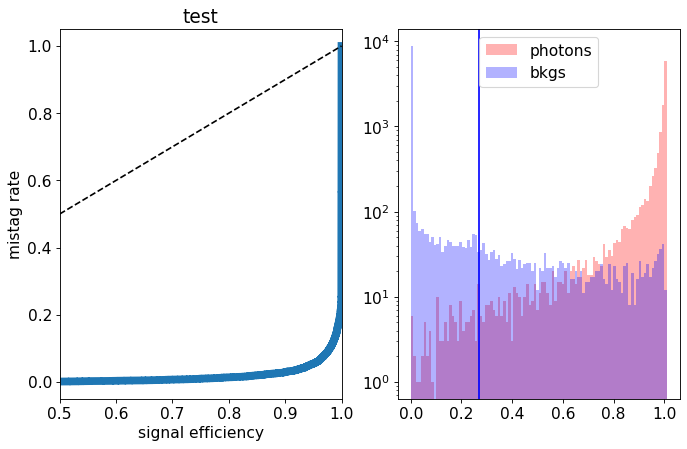

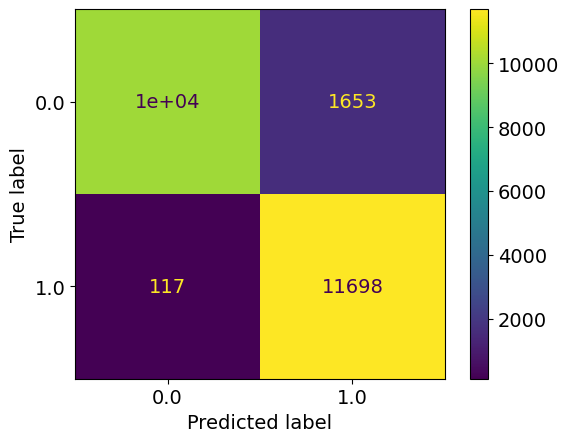

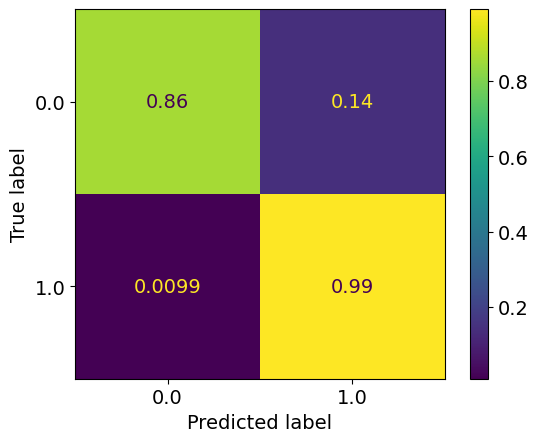

epoch: 710
Learning rate: 9.046260814679199e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.07it/s]


train loss: 0.1433806707904597
train acc: 0.9434303


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.58it/s]


test loss: 0.14108214080333709
test acc: 0.9434315
epoch: 711
Learning rate: 8.853841399927774e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1436608857504881
train acc: 0.94218713


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.44it/s]


test loss: 0.14378865715116262
test acc: 0.94525903
epoch: 712
Learning rate: 8.646212633823493e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.14290371470770258
train acc: 0.9427928


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.70it/s]


test loss: 0.13723032232373952
test acc: 0.94491905
epoch: 713
Learning rate: 8.42419393224961e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1431828830747088
train acc: 0.94300526


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.05it/s]


test loss: 0.13984141666442157
test acc: 0.944069
epoch: 714
Learning rate: 8.188661501590543e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.54it/s]


train loss: 0.14278307675745835
train acc: 0.9424846


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.95it/s]


test loss: 0.13070537690073253
test acc: 0.9466616
epoch: 715
Learning rate: 7.940544880745565e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.08it/s]


train loss: 0.1439848382761524
train acc: 0.94285655


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.18it/s]


test loss: 0.1327258577570319
test acc: 0.94593906
epoch: 716
Learning rate: 7.680823272663455e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1437400446575918
train acc: 0.94224024


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.82it/s]


test loss: 0.1409964807331562
test acc: 0.9436015
epoch: 717
Learning rate: 7.410521679875796e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.04it/s]


train loss: 0.1422828870594122
train acc: 0.94277155


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.45it/s]


test loss: 0.15328033678233624
test acc: 0.9376089
epoch: 718
Learning rate: 7.130706859280269e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14318031039397427
train acc: 0.94287777


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.03it/s]


test loss: 0.13565003890544175
test acc: 0.9455565
epoch: 719
Learning rate: 6.842483112138533e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14244714127794192
train acc: 0.9433347


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.97it/s]


test loss: 0.143120295740664
test acc: 0.9446215


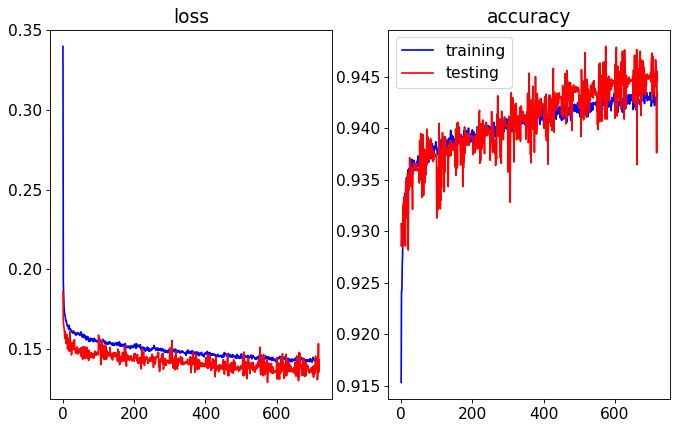

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.93it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


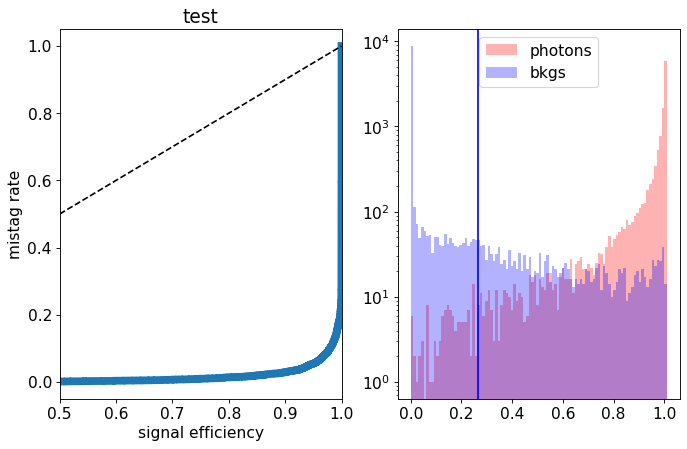

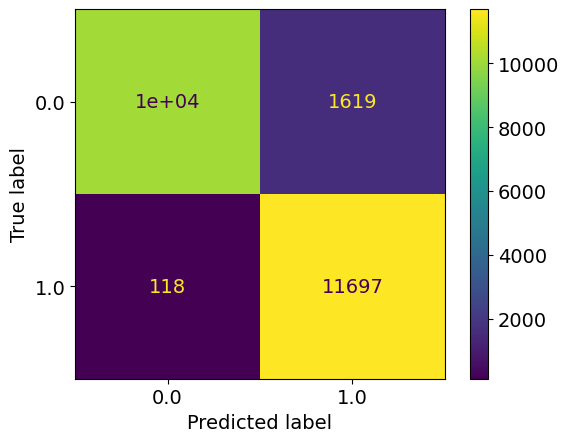

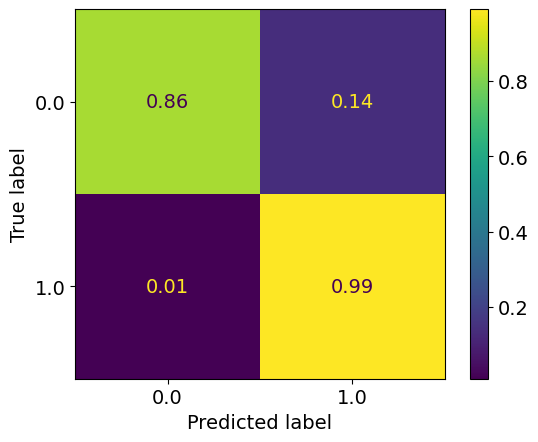

epoch: 720
Learning rate: 6.546987925903652e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14303847990787713
train acc: 0.94208086


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.93it/s]


test loss: 0.1461647989228368
test acc: 0.942794
epoch: 721
Learning rate: 6.245387485076784e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14298104395152658
train acc: 0.9437172


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.38it/s]


test loss: 0.13665866795927287
test acc: 0.94521654
epoch: 722
Learning rate: 5.93887206880974e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.13it/s]


train loss: 0.14350829278207888
train acc: 0.94295216


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.49it/s]


test loss: 0.14653194658458232
test acc: 0.9442815
epoch: 723
Learning rate: 5.6286513534169517e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14274954307041351
train acc: 0.94361097


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.10it/s]


test loss: 0.13710284493863584
test acc: 0.945429
epoch: 724
Learning rate: 5.315949638335711e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.1422008208598301
train acc: 0.94278216


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.58it/s]


test loss: 0.1403108049184084
test acc: 0.94508904
epoch: 725
Learning rate: 5.00200101437562e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.18it/s]


train loss: 0.14295481192837856
train acc: 0.9424528


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.56it/s]


test loss: 0.14135806243866683
test acc: 0.94504654
epoch: 726
Learning rate: 4.6880444933259634e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1426292042348795
train acc: 0.94306904


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.40it/s]


test loss: 0.14063747674226762
test acc: 0.94530153
epoch: 727
Learning rate: 4.375319118142234e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.09it/s]


train loss: 0.14145320093935462
train acc: 0.94323903


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.30it/s]


test loss: 0.14063988234847785
test acc: 0.944579
epoch: 728
Learning rate: 4.06505907300965e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1410286522879722
train acc: 0.9431859


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.60it/s]


test loss: 0.14566964637488128
test acc: 0.9440265
epoch: 729
Learning rate: 3.758488812582018e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.141705346572551
train acc: 0.94294155


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.60it/s]


test loss: 0.14107117168605326
test acc: 0.9435165


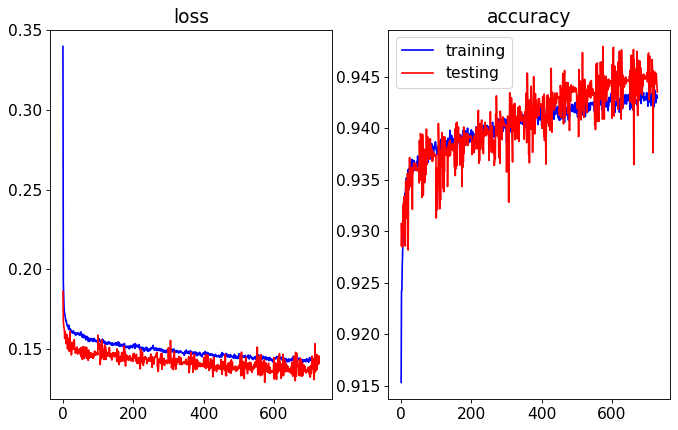

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.60it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


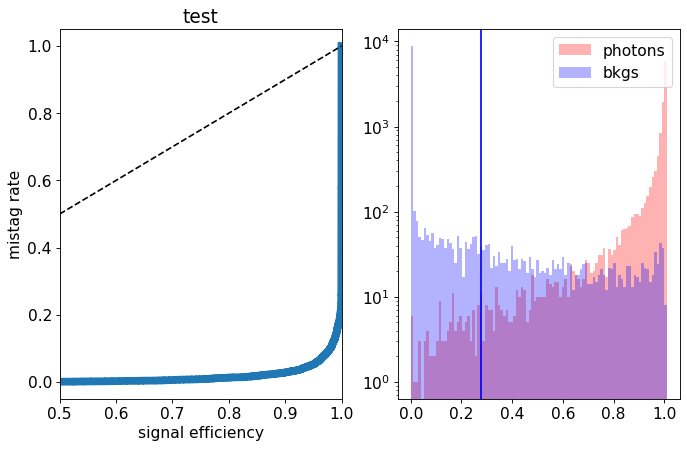

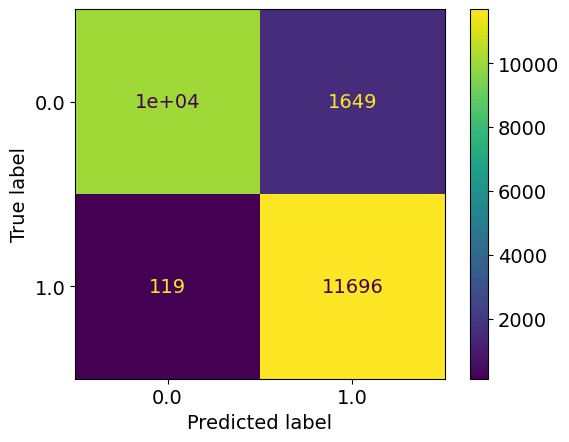

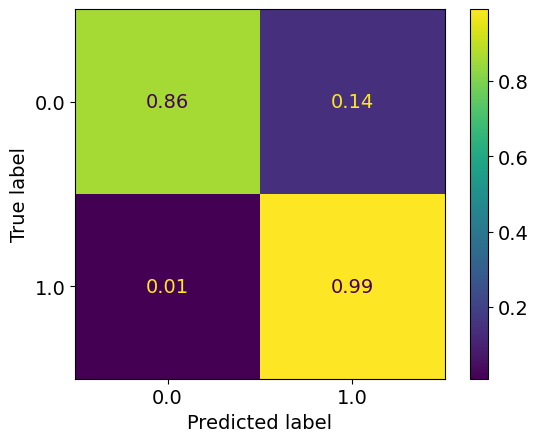

epoch: 730
Learning rate: 3.4568182296186134e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.14191561287185947
train acc: 0.94268656


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.80it/s]


test loss: 0.14355028849095106
test acc: 0.9442815
epoch: 731
Learning rate: 3.161237880090216e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.14246090373415857
train acc: 0.9427078


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.48it/s]


test loss: 0.14203371927142144
test acc: 0.94389904
epoch: 732
Learning rate: 2.8729142845985978e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


train loss: 0.14339565471479088
train acc: 0.94273967


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.23it/s]


test loss: 0.13892108537256717
test acc: 0.94581157
epoch: 733
Learning rate: 2.5929853246526404e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.143938556788074
train acc: 0.9419215


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.51it/s]


test loss: 0.1409837244078517
test acc: 0.943644
epoch: 734
Learning rate: 2.3225557519698758e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14196092132360313
train acc: 0.9434622


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.35it/s]


test loss: 0.13639305103570223
test acc: 0.94500405
epoch: 735
Learning rate: 2.0626928285261642e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14308745442492188
train acc: 0.9431009


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.89it/s]


test loss: 0.13381351800635458
test acc: 0.9456841
epoch: 736
Learning rate: 1.8144221145602574e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.54it/s]


train loss: 0.14243132801382405
train acc: 0.9425697


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.58it/s]


test loss: 0.13260670602321625
test acc: 0.94627905
epoch: 737
Learning rate: 1.5787234211560807e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.08it/s]


train loss: 0.14214885291779877
train acc: 0.94303715


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.85it/s]


test loss: 0.13441851250827314
test acc: 0.94581157
epoch: 738
Learning rate: 1.3565269433760108e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.14217741925055813
train acc: 0.94389784


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.25it/s]


test loss: 0.13506271429359912
test acc: 0.94598156
epoch: 739
Learning rate: 1.1487095892059296e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14154395399389752
train acc: 0.94305843


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.25it/s]


test loss: 0.13649555370211602
test acc: 0.94500405


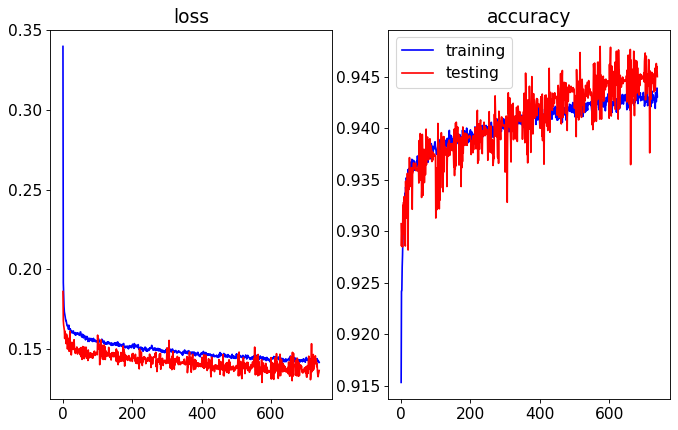

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.42it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


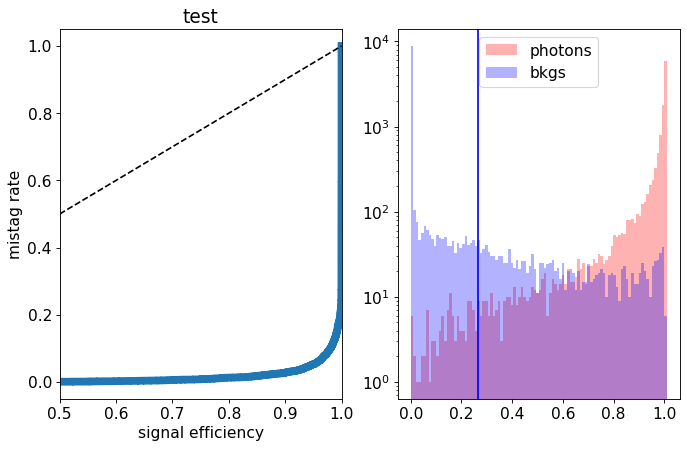

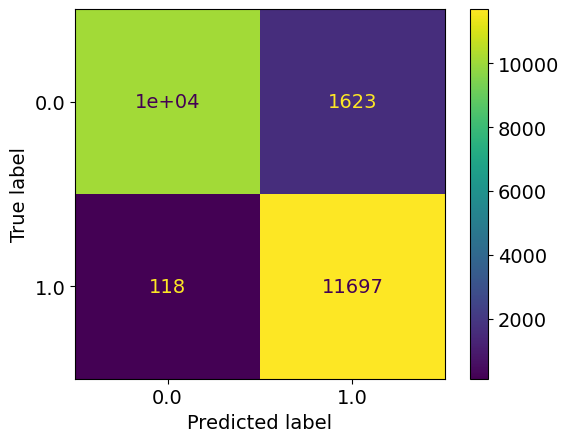

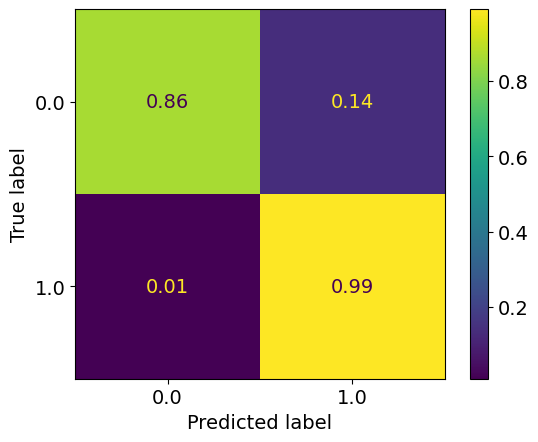

epoch: 740
Learning rate: 9.56091518800029e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14284011484331385
train acc: 0.9424846


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.60it/s]


test loss: 0.13555694464594126
test acc: 0.94530153
epoch: 741
Learning rate: 7.794329076833768e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1414120694159702
train acc: 0.9435684


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.88it/s]


test loss: 0.1338168393820524
test acc: 0.94606656
epoch: 742
Learning rate: 6.194309466864034e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.05it/s]


train loss: 0.14125022510434412
train acc: 0.9437066


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.54it/s]


test loss: 0.13707833755761384
test acc: 0.945429
epoch: 743
Learning rate: 4.76717090451227e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14221763169499718
train acc: 0.94387656


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.44it/s]


test loss: 0.1365291729569435
test acc: 0.94496155
epoch: 744
Learning rate: 3.518545653686456e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.09it/s]


train loss: 0.14323239635889698
train acc: 0.9432922


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.76it/s]


test loss: 0.13629671148955821
test acc: 0.945514
epoch: 745
Learning rate: 2.453361467808979e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14315576253423265
train acc: 0.9434091


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.44it/s]


test loss: 0.13667351175099612
test acc: 0.94517404
epoch: 746
Learning rate: 1.5758221422251474e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.14149076282788234
train acc: 0.9445141


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.57it/s]


test loss: 0.13690581247210504
test acc: 0.94517404
epoch: 747
Learning rate: 8.893909237434605e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.10it/s]


train loss: 0.14287325407669044
train acc: 0.9435578


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.24it/s]


test loss: 0.13824180345982312
test acc: 0.94508904
epoch: 748
Learning rate: 3.967768427826535e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14145365703827256
train acc: 0.943324


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.67it/s]


test loss: 0.13732233159244062
test acc: 0.94508904
epoch: 749
Learning rate: 9.992402206632778e-08


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.10it/s]


train loss: 0.1428429464435881
train acc: 0.94319654


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.13it/s]


test loss: 0.13768845293670892
test acc: 0.94508904


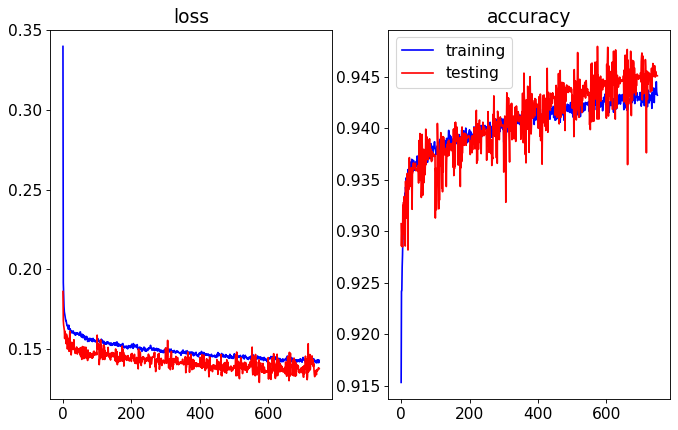

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.57it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


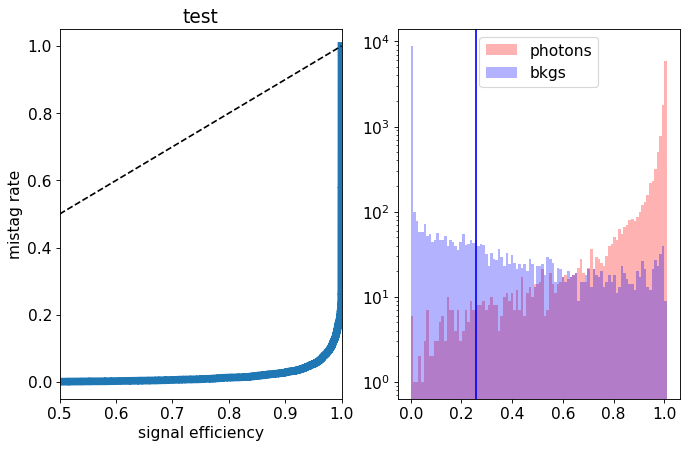

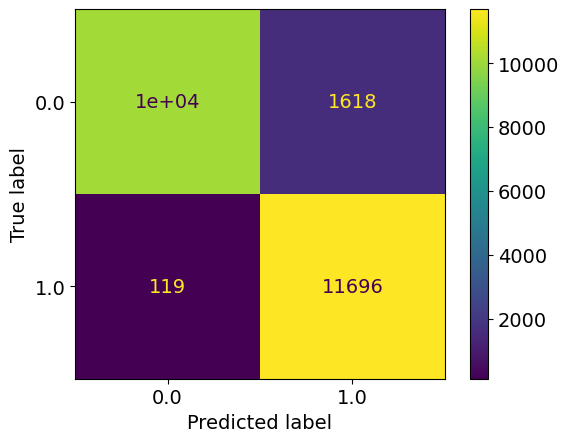

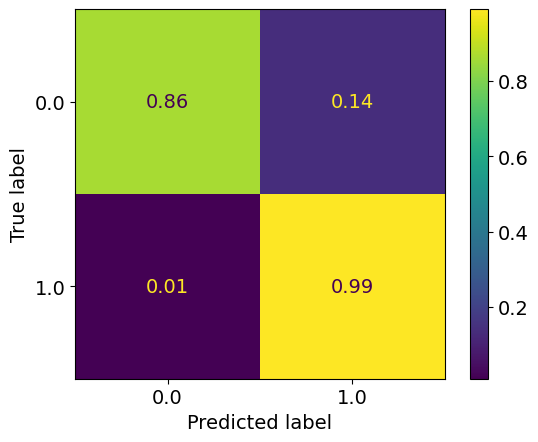

epoch: 750
Learning rate: 4.004058690165735e-12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14206742860709026
train acc: 0.94287777


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.75it/s]


test loss: 0.1364704355597496
test acc: 0.9456416
epoch: 751
Learning rate: 9.99025888725783e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14294593885635873
train acc: 0.94311154


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.34it/s]


test loss: 0.15208630319684743
test acc: 0.942794
epoch: 752
Learning rate: 9.960823902925945e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.142696426600028
train acc: 0.9426653


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.85it/s]


test loss: 0.14082205351442098
test acc: 0.94585407
epoch: 753
Learning rate: 9.911810813034072e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.55it/s]


train loss: 0.1426162647593553
train acc: 0.942389


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.52it/s]


test loss: 0.13614484313875436
test acc: 0.94491905
epoch: 754
Learning rate: 9.84341304985606e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.18it/s]


train loss: 0.14391057402085347
train acc: 0.9428459


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.41it/s]


test loss: 0.13884976077824832
test acc: 0.94466406
epoch: 755
Learning rate: 9.755900548115212e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14368486888469403
train acc: 0.942559


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.45it/s]


test loss: 0.1398474507033825
test acc: 0.9433465
epoch: 756
Learning rate: 9.649618679675236e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1434559443384219
train acc: 0.94296277


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.87it/s]


test loss: 0.13549841661006212
test acc: 0.9455565
epoch: 757
Learning rate: 9.524986890515297e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14294461251064472
train acc: 0.9425378


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.50it/s]


test loss: 0.14091818779706955
test acc: 0.944154
epoch: 758
Learning rate: 9.382497045368364e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14293343426695296
train acc: 0.9424103


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.46it/s]


test loss: 0.1343989098444581
test acc: 0.9456416
epoch: 759
Learning rate: 9.222711486555813e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.11it/s]


train loss: 0.14251615894827874
train acc: 0.94365346


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.15it/s]


test loss: 0.14080261234194041
test acc: 0.944154


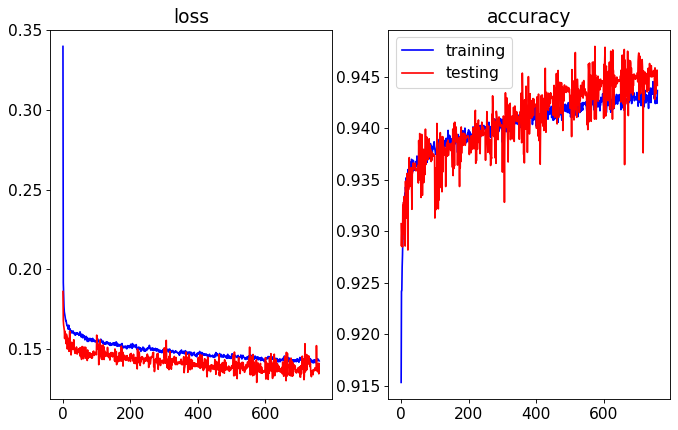

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.95it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


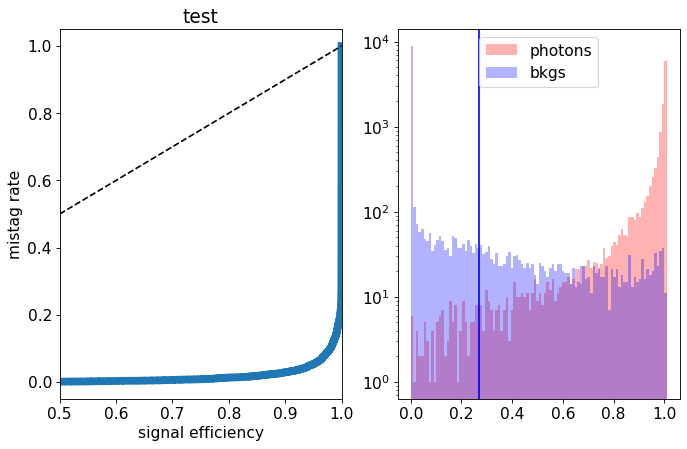

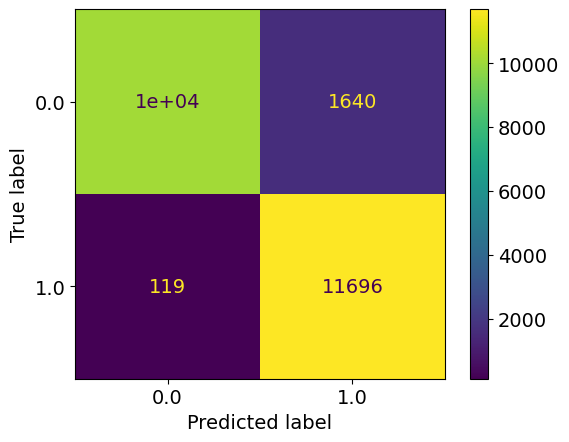

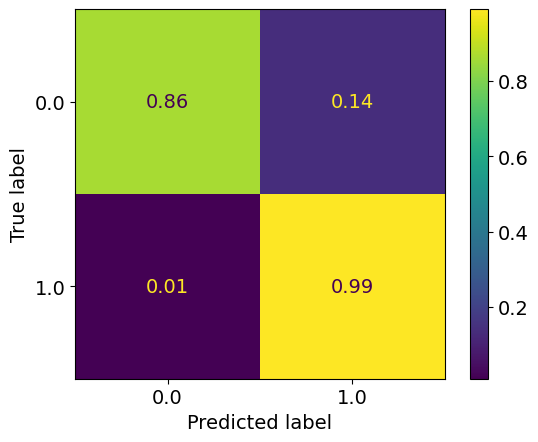

epoch: 760
Learning rate: 9.046260814679199e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14278086198932805
train acc: 0.9424103


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.58it/s]


test loss: 0.14175793770700693
test acc: 0.942369
epoch: 761
Learning rate: 8.853841399927774e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.10it/s]


train loss: 0.14347592385331537
train acc: 0.942559


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.22it/s]


test loss: 0.14684653654694557
test acc: 0.9446215
epoch: 762
Learning rate: 8.646212633823493e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14320517616097334
train acc: 0.9427503


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.72it/s]


test loss: 0.14700801875442265
test acc: 0.9443665
epoch: 763
Learning rate: 8.42419393224961e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.14273112480807457
train acc: 0.94298404


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.13940075170248747
test acc: 0.9456416
epoch: 764
Learning rate: 8.188661501590543e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.04it/s]


train loss: 0.14197053651141514
train acc: 0.943324


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.94it/s]


test loss: 0.1317163972184062
test acc: 0.9470016
epoch: 765
Learning rate: 7.940544880745565e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14250315118367504
train acc: 0.94305843


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.16it/s]


test loss: 0.1338886596262455
test acc: 0.94627905
epoch: 766
Learning rate: 7.680823272663455e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.07it/s]


train loss: 0.141173202378355
train acc: 0.94379157


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.67it/s]


test loss: 0.1374014003202319
test acc: 0.9456841
epoch: 767
Learning rate: 7.410521679875796e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14288061956880957
train acc: 0.9426228


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.79it/s]


test loss: 0.14334897249937056
test acc: 0.944494
epoch: 768
Learning rate: 7.130706859280269e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.14267222502618837
train acc: 0.94272906


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.75it/s]


test loss: 0.14316381700336933
test acc: 0.9457266
epoch: 769
Learning rate: 6.842483112138533e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.14it/s]


train loss: 0.1420982611502052
train acc: 0.94295216


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.66it/s]


test loss: 0.15098368506878615
test acc: 0.9446215


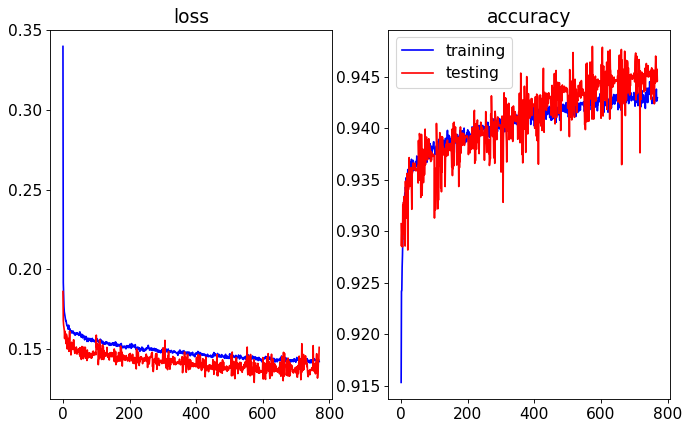

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.75it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


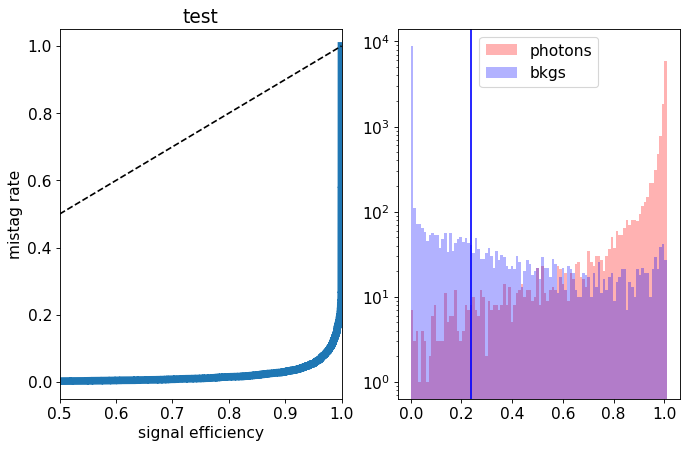

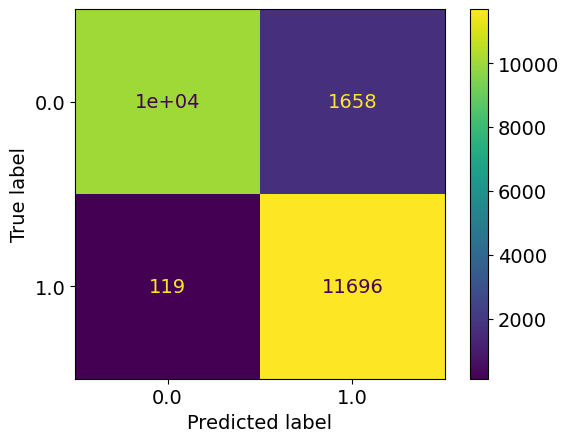

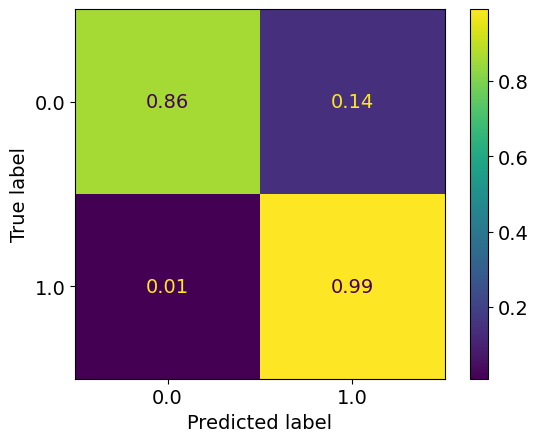

epoch: 770
Learning rate: 6.546987925903652e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.1431170738521655
train acc: 0.9432284


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.62it/s]


test loss: 0.1374114165082574
test acc: 0.9444515
epoch: 771
Learning rate: 6.245387485076784e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.05it/s]


train loss: 0.14170701407892689
train acc: 0.94295216


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.18it/s]


test loss: 0.12897674702107906
test acc: 0.9489141
new best acc: 0.9489141
epoch: 772
Learning rate: 5.93887206880974e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14156313757797714
train acc: 0.9435472


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.59it/s]


test loss: 0.1411389160901308
test acc: 0.94615155
epoch: 773
Learning rate: 5.6286513534169517e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14161710246543216
train acc: 0.9437172


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.82it/s]


test loss: 0.14124634470790626
test acc: 0.945599
epoch: 774
Learning rate: 5.315949638335711e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14331608640540178
train acc: 0.94288844


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.48it/s]


test loss: 0.13496019151061772
test acc: 0.9466616
epoch: 775
Learning rate: 5.00200101437562e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.1426556921878438
train acc: 0.9433878


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.16it/s]


test loss: 0.1408501498401165
test acc: 0.9456416
epoch: 776
Learning rate: 4.6880444933259634e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.19it/s]


train loss: 0.14051330768188852
train acc: 0.94365346


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.26it/s]


test loss: 0.1420675002038479
test acc: 0.944579
epoch: 777
Learning rate: 4.375319118142234e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14157827412057075
train acc: 0.9427609


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.51it/s]


test loss: 0.1397109368816018
test acc: 0.94623655
epoch: 778
Learning rate: 4.06505907300965e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1412881798330386
train acc: 0.94374907


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.72it/s]


test loss: 0.14033520519733428
test acc: 0.9453865
epoch: 779
Learning rate: 3.758488812582018e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.18it/s]


train loss: 0.14270555531712853
train acc: 0.94292027


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.63it/s]


test loss: 0.1360280614346266
test acc: 0.94513154


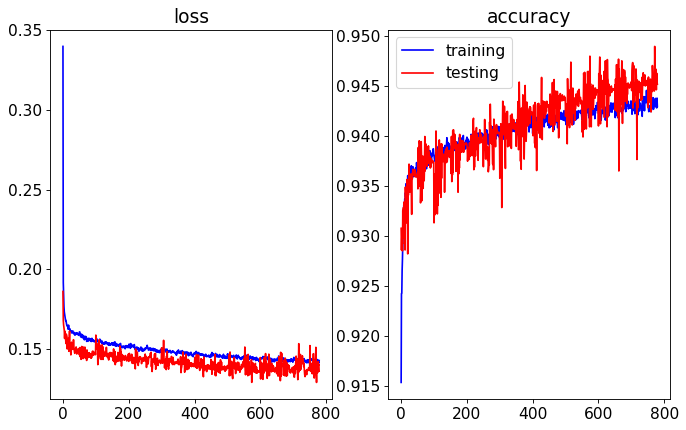

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.76it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


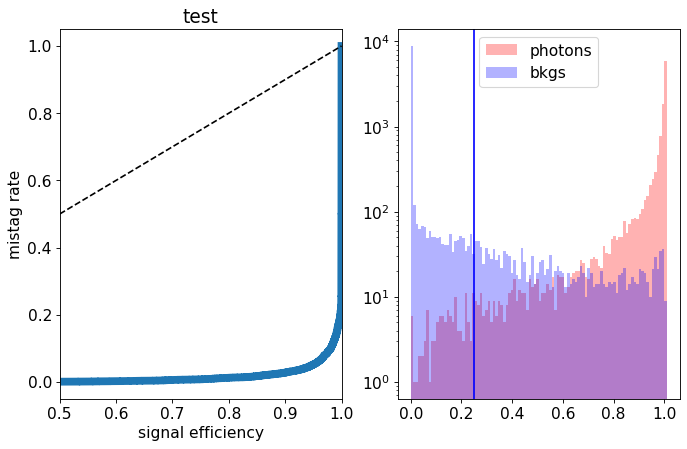

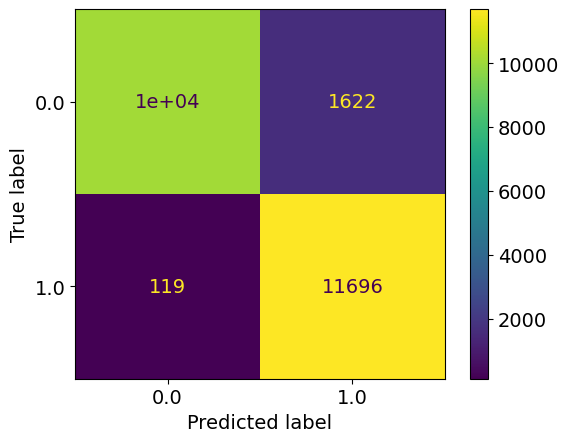

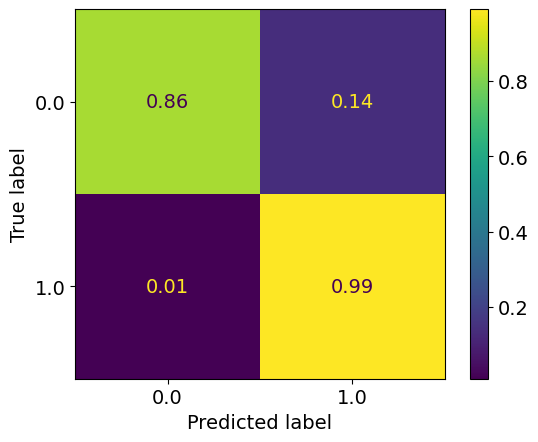

epoch: 780
Learning rate: 3.4568182296186134e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1419930820632133
train acc: 0.9433665


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.54it/s]


test loss: 0.1401385683566332
test acc: 0.94534403
epoch: 781
Learning rate: 3.161237880090216e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


train loss: 0.14194306977994883
train acc: 0.9434409


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.56it/s]


test loss: 0.13567485604435206
test acc: 0.9470016
epoch: 782
Learning rate: 2.8729142845985978e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14181457493145755
train acc: 0.94320714


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.15it/s]


test loss: 0.1336323292925954
test acc: 0.94649154
epoch: 783
Learning rate: 2.5929853246526404e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.17it/s]


train loss: 0.1421008451729064
train acc: 0.943324


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.04it/s]


test loss: 0.13898845631629228
test acc: 0.94530153
epoch: 784
Learning rate: 2.3225557519698758e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14110142153919122
train acc: 0.9432284


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.01it/s]


test loss: 0.14046705439686774
test acc: 0.9444515
epoch: 785
Learning rate: 2.0626928285261642e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.54it/s]


train loss: 0.1411648499927703
train acc: 0.9437597


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.20it/s]


test loss: 0.14274122398346661
test acc: 0.94470656
epoch: 786
Learning rate: 1.8144221145602574e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.19it/s]


train loss: 0.14167017489671707
train acc: 0.9438022


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.79it/s]


test loss: 0.1388021731749177
test acc: 0.94508904
epoch: 787
Learning rate: 1.5787234211560807e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14158803869964212
train acc: 0.9432922


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.47it/s]


test loss: 0.13907722812145948
test acc: 0.9453865
epoch: 788
Learning rate: 1.3565269433760108e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14230561887572526
train acc: 0.94365346


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.89it/s]


test loss: 0.1406135715544224
test acc: 0.94496155
epoch: 789
Learning rate: 1.1487095892059296e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14109740600844098
train acc: 0.94398284


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.99it/s]


test loss: 0.13797258269041776
test acc: 0.9454715


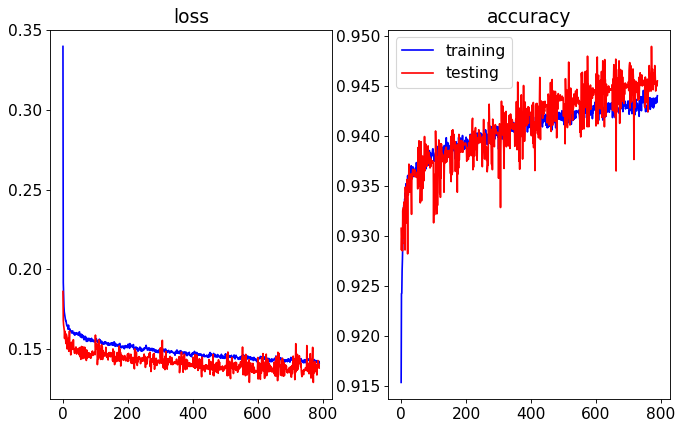

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.90it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


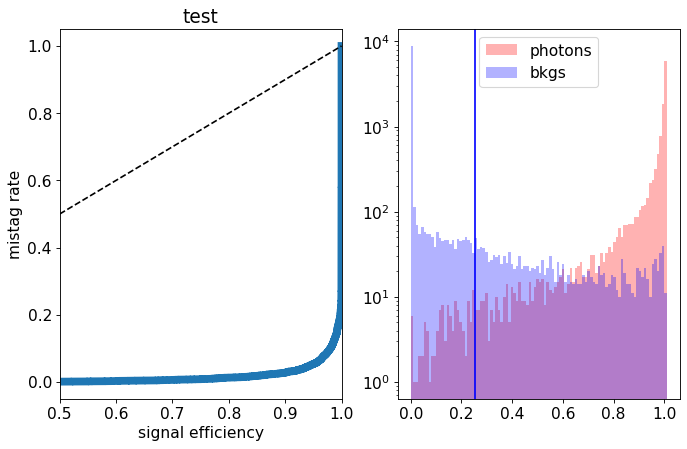

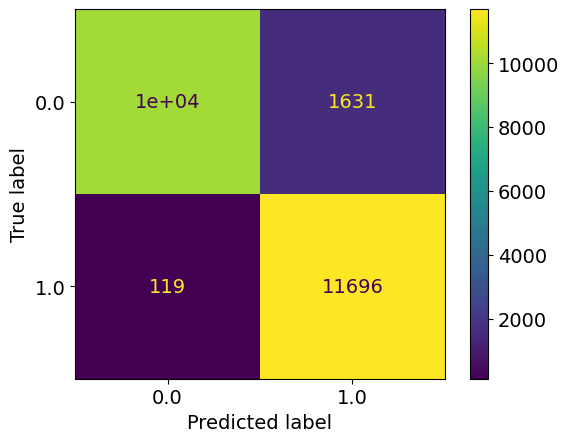

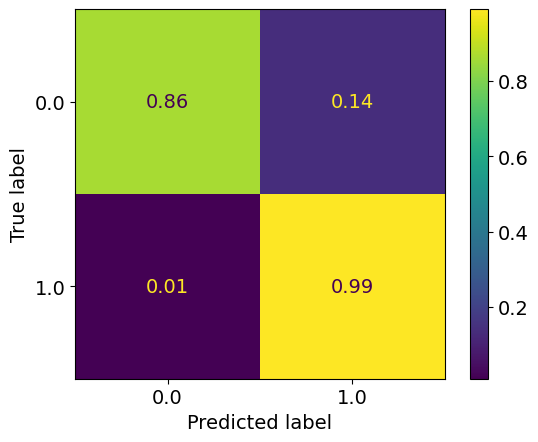

epoch: 790
Learning rate: 9.56091518800029e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.1418723311678619
train acc: 0.94386595


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.14it/s]


test loss: 0.13697367236018182
test acc: 0.94585407
epoch: 791
Learning rate: 7.794329076833768e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.18it/s]


train loss: 0.14193299109009422
train acc: 0.9438022


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.09it/s]


test loss: 0.13869516961276532
test acc: 0.94521654
epoch: 792
Learning rate: 6.194309466864034e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14160519866806687
train acc: 0.9430478


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.98it/s]


test loss: 0.13932629749178888
test acc: 0.945429
epoch: 793
Learning rate: 4.76717090451227e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.08it/s]


train loss: 0.14107048212532786
train acc: 0.9435578


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.70it/s]


test loss: 0.14047363474965097
test acc: 0.9453865
epoch: 794
Learning rate: 3.518545653686456e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.14202569372904528
train acc: 0.9432922


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.82it/s]


test loss: 0.13902852162718773
test acc: 0.94585407
epoch: 795
Learning rate: 2.453361467808979e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14291495193911205
train acc: 0.9424634


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.88it/s]


test loss: 0.13743804730474948
test acc: 0.9456841
epoch: 796
Learning rate: 1.5758221422251474e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.10it/s]


train loss: 0.14051636911121904
train acc: 0.94415283


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.11it/s]


test loss: 0.13695283159613608
test acc: 0.9457266
epoch: 797
Learning rate: 8.893909237434605e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.55it/s]


train loss: 0.1412446542530303
train acc: 0.9428034


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.38it/s]


test loss: 0.13689553253352643
test acc: 0.94581157
epoch: 798
Learning rate: 3.967768427826535e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.16it/s]


train loss: 0.14071247612784624
train acc: 0.9433984


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.27it/s]


test loss: 0.13825059179216623
test acc: 0.94581157
epoch: 799
Learning rate: 9.992402206632778e-08


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1410955918157936
train acc: 0.9431009


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.88it/s]


test loss: 0.13724282681941985
test acc: 0.94581157


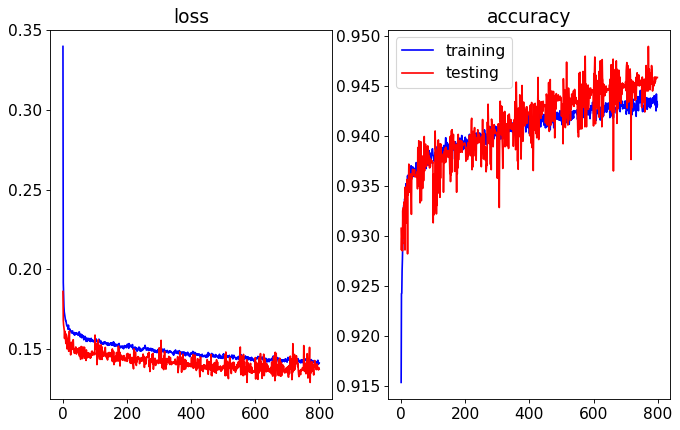

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.73it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


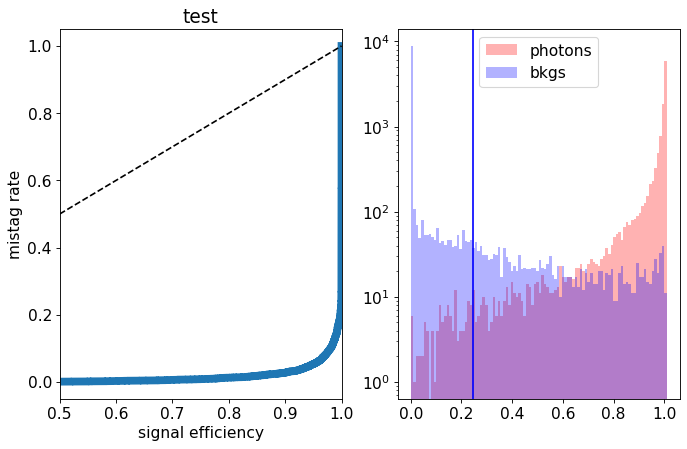

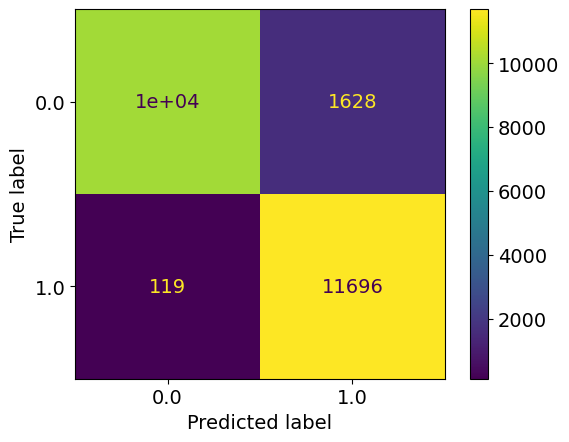

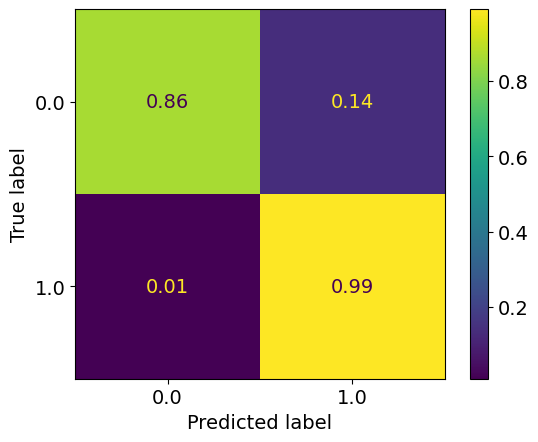

epoch: 800
Learning rate: 4.004058690165735e-12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14277052309862368
train acc: 0.9431009


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.94it/s]


test loss: 0.1555741047486663
test acc: 0.94377154
epoch: 801
Learning rate: 9.99025888725783e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14215537321985147
train acc: 0.94361097


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.44it/s]


test loss: 0.14231639858335257
test acc: 0.9456841
epoch: 802
Learning rate: 9.960823902925945e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.14225586731532577
train acc: 0.94273967


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.30it/s]


test loss: 0.144892755523324
test acc: 0.9435165
epoch: 803
Learning rate: 9.911810813034072e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.08it/s]


train loss: 0.1422745879668339
train acc: 0.94305843


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.98it/s]


test loss: 0.14221455231308938
test acc: 0.9434315
epoch: 804
Learning rate: 9.84341304985606e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1428741053885715
train acc: 0.94268656


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.40it/s]


test loss: 0.1585584819316864
test acc: 0.9426665
epoch: 805
Learning rate: 9.755900548115212e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.46it/s]


train loss: 0.14216441101139518
train acc: 0.9428353


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.78it/s]


test loss: 0.14577408619225024
test acc: 0.943644
epoch: 806
Learning rate: 9.649618679675236e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14322073510877645
train acc: 0.9432603


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.17it/s]


test loss: 0.137108076736331
test acc: 0.9469591
epoch: 807
Learning rate: 9.524986890515297e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.14217287012536056
train acc: 0.94392973


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.96it/s]


test loss: 0.14149252269417048
test acc: 0.9467041
epoch: 808
Learning rate: 9.382497045368364e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.10it/s]


train loss: 0.1425304570395476
train acc: 0.9435259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.81it/s]


test loss: 0.13745077177882195
test acc: 0.9471291
epoch: 809
Learning rate: 9.222711486555813e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1420223632246066
train acc: 0.9435047


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.66it/s]


test loss: 0.14559824354946613
test acc: 0.9478091


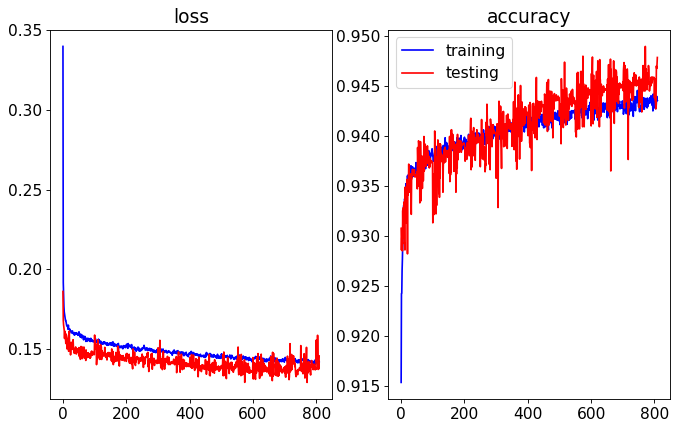

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.86it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


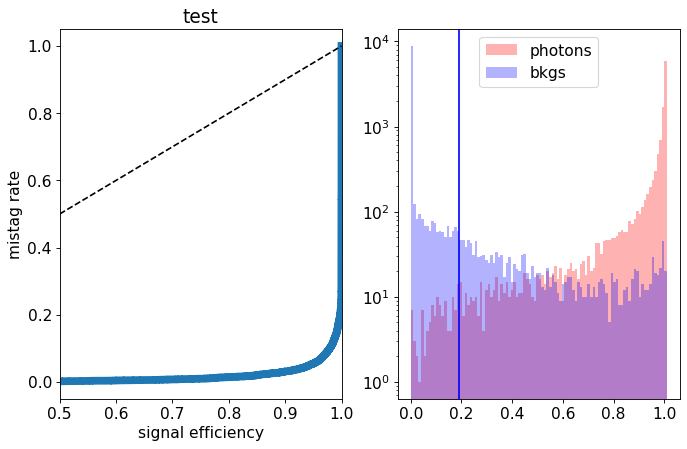

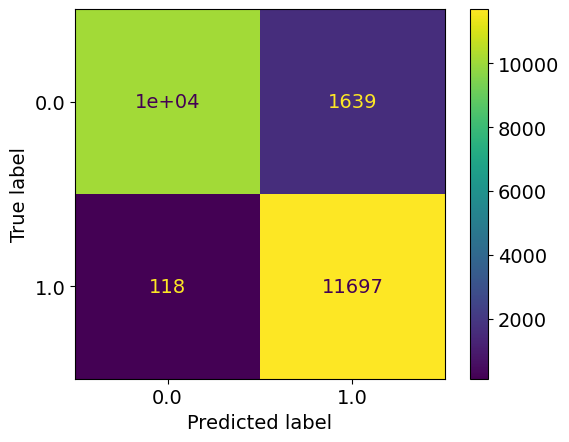

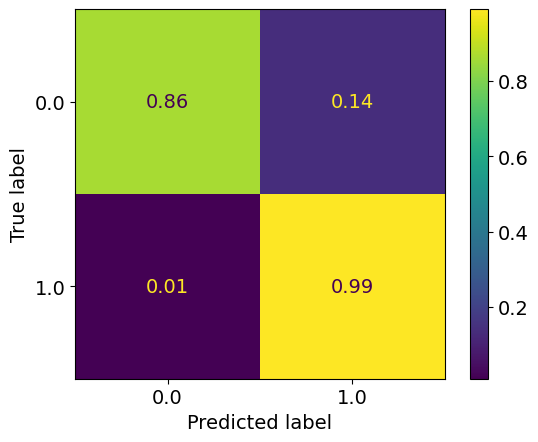

epoch: 810
Learning rate: 9.046260814679199e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.09it/s]


train loss: 0.14235886352457058
train acc: 0.9435047


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.11it/s]


test loss: 0.1349839400500059
test acc: 0.945599
epoch: 811
Learning rate: 8.853841399927774e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.14333634852034272
train acc: 0.9424421


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.56it/s]


test loss: 0.1363761119544506
test acc: 0.94742656
epoch: 812
Learning rate: 8.646212633823493e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14235830069727198
train acc: 0.9436853


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.24it/s]


test loss: 0.14381449539214372
test acc: 0.944069
epoch: 813
Learning rate: 8.42419393224961e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.22it/s]


train loss: 0.14257446263626122
train acc: 0.94282466


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.64it/s]


test loss: 0.13865054864436388
test acc: 0.9445365
epoch: 814
Learning rate: 8.188661501590543e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14260704136767965
train acc: 0.9434622


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.94it/s]


test loss: 0.13586772065609692
test acc: 0.945514
epoch: 815
Learning rate: 7.940544880745565e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.19it/s]


train loss: 0.14257794058626624
train acc: 0.94307965


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.38it/s]


test loss: 0.1371060959994793
test acc: 0.94623655
epoch: 816
Learning rate: 7.680823272663455e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14309387829653017
train acc: 0.94392973


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.14732863400131463
test acc: 0.94521654
epoch: 817
Learning rate: 7.410521679875796e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1413232078597804
train acc: 0.9442803


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.60it/s]


test loss: 0.14833972547203303
test acc: 0.9427515
epoch: 818
Learning rate: 7.130706859280269e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.20it/s]


train loss: 0.14200042321044168
train acc: 0.9434303


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.14788370244204999
test acc: 0.9433465
epoch: 819
Learning rate: 6.842483112138533e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14204196892916018
train acc: 0.9432497


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.54it/s]


test loss: 0.14370572436600923
test acc: 0.9436015


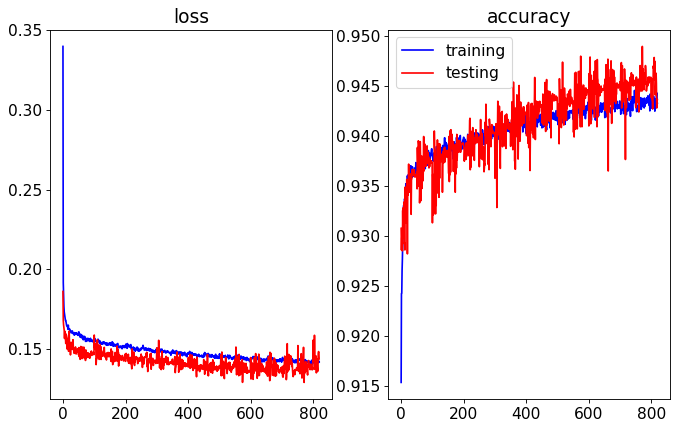

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.59it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


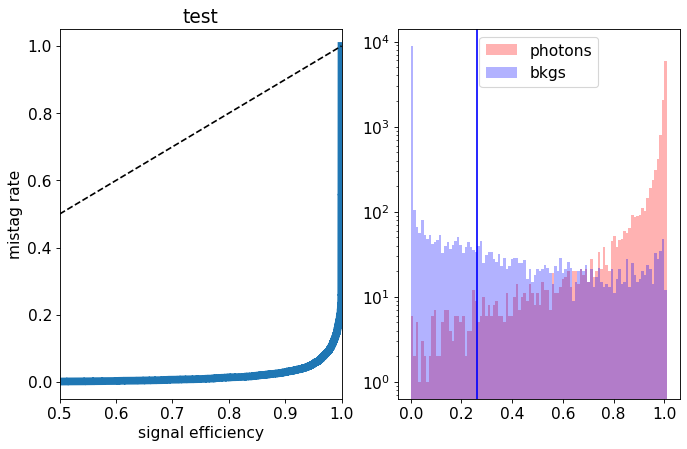

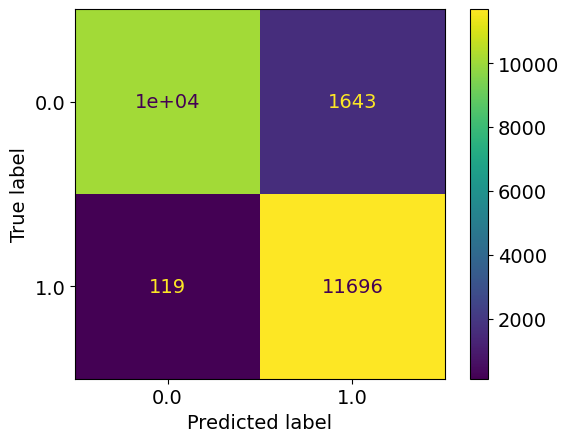

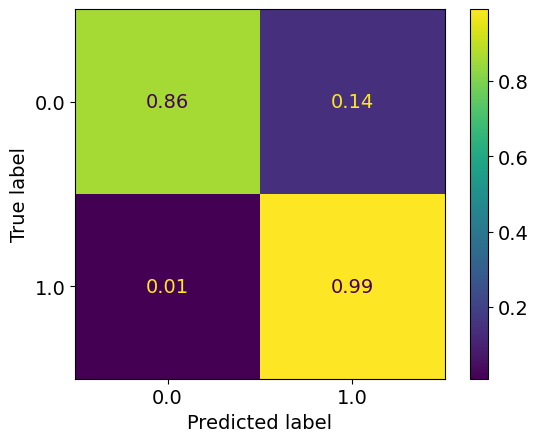

epoch: 820
Learning rate: 6.546987925903652e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


train loss: 0.1418372533598523
train acc: 0.9435684


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.60it/s]


test loss: 0.13666978869587182
test acc: 0.9481491
epoch: 821
Learning rate: 6.245387485076784e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14195691324343349
train acc: 0.94273967


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.60it/s]


test loss: 0.14527141582220793
test acc: 0.94615155
epoch: 822
Learning rate: 5.93887206880974e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14148619011708885
train acc: 0.9428034


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.96it/s]


test loss: 0.14968681018799543
test acc: 0.943474
epoch: 823
Learning rate: 5.6286513534169517e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.1423595613165266
train acc: 0.9433878


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.63it/s]


test loss: 0.1418876165524125
test acc: 0.94521654
epoch: 824
Learning rate: 5.315949638335711e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14171902825877924
train acc: 0.94288844


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.46it/s]


test loss: 0.15057310424745082
test acc: 0.9435165
epoch: 825
Learning rate: 5.00200101437562e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.18it/s]


train loss: 0.14206647180068266
train acc: 0.94300526


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.41it/s]


test loss: 0.14280851036310196
test acc: 0.94632155
epoch: 826
Learning rate: 4.6880444933259634e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14117865596607232
train acc: 0.9432178


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.35it/s]


test loss: 0.13388106487691404
test acc: 0.94746906
epoch: 827
Learning rate: 4.375319118142234e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14169989355430482
train acc: 0.9434516


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.86it/s]


test loss: 0.14721773881465197
test acc: 0.944579
epoch: 828
Learning rate: 4.06505907300965e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.59it/s]


train loss: 0.14209104780178922
train acc: 0.94302654


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.18it/s]


test loss: 0.14035522639751435
test acc: 0.9476391
epoch: 829
Learning rate: 3.758488812582018e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.14225003507676398
train acc: 0.9435897


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.41it/s]


test loss: 0.14292292147874833
test acc: 0.94491905


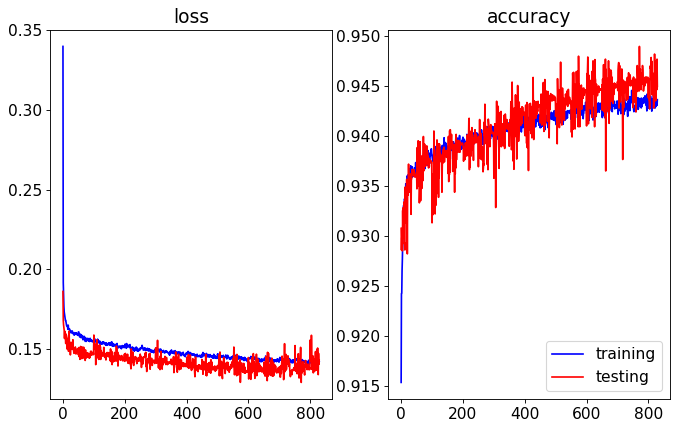

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.40it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


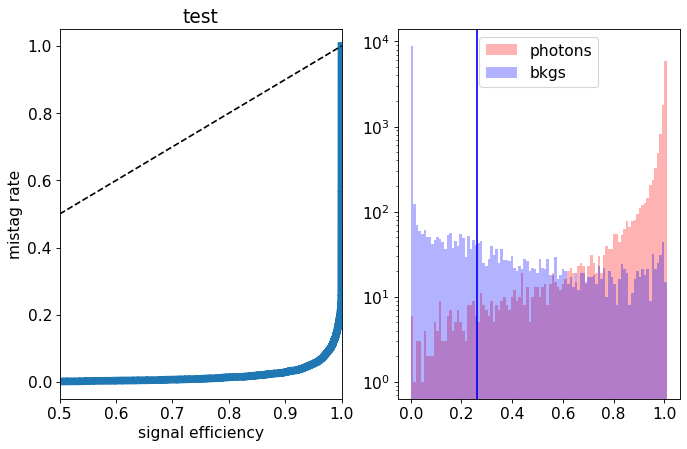

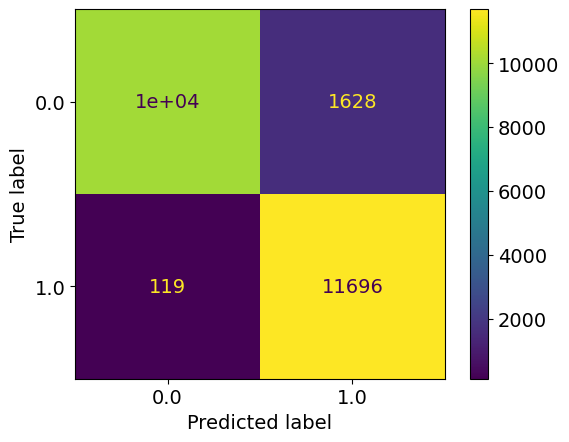

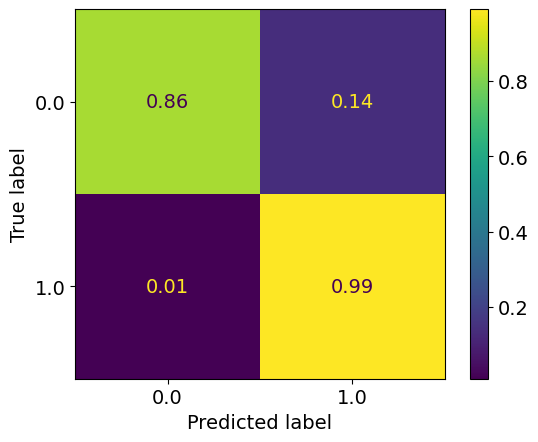

epoch: 830
Learning rate: 3.4568182296186134e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.31it/s]


train loss: 0.14178323793183467
train acc: 0.9432922


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.40it/s]


test loss: 0.1454792158678174
test acc: 0.94530153
epoch: 831
Learning rate: 3.161237880090216e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14069378338042338
train acc: 0.94386595


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.34it/s]


test loss: 0.1408800296485424
test acc: 0.945599
epoch: 832
Learning rate: 2.8729142845985978e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.30it/s]


train loss: 0.14262589992611271
train acc: 0.9433028


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.40it/s]


test loss: 0.14068648163229228
test acc: 0.94606656
epoch: 833
Learning rate: 2.5929853246526404e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.14093350310614156
train acc: 0.9431009


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.27it/s]


test loss: 0.14810049962252378
test acc: 0.944494
epoch: 834
Learning rate: 2.3225557519698758e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14082103208371788
train acc: 0.9443972


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.63it/s]


test loss: 0.14412174355238677
test acc: 0.94517404
epoch: 835
Learning rate: 2.0626928285261642e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


train loss: 0.14133318328553704
train acc: 0.94373846


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.14364064149558545
test acc: 0.94627905
epoch: 836
Learning rate: 1.8144221145602574e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14110067325412848
train acc: 0.94373846


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.14162291456013917
test acc: 0.9455565
epoch: 837
Learning rate: 1.5787234211560807e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


train loss: 0.14194294539796318
train acc: 0.9434728


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.1391118161380291
test acc: 0.94640654
epoch: 838
Learning rate: 1.3565269433760108e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14009062770255812
train acc: 0.94407845


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.56it/s]


test loss: 0.14208484552800654
test acc: 0.9454715
epoch: 839
Learning rate: 1.1487095892059296e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.57it/s]


train loss: 0.1408063177565101
train acc: 0.94404656


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.39it/s]


test loss: 0.1449144022539258
test acc: 0.94585407


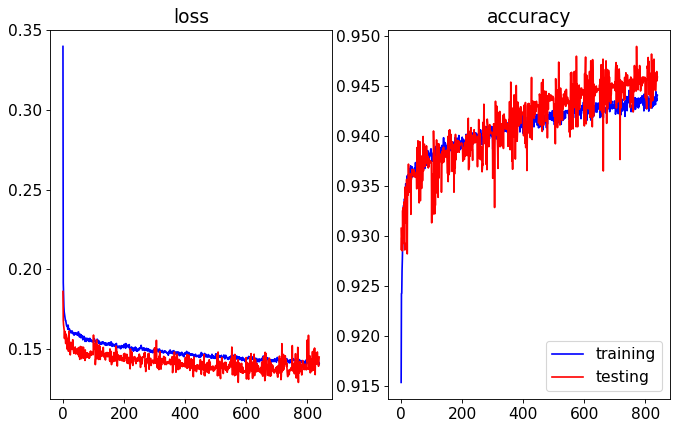

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.37it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


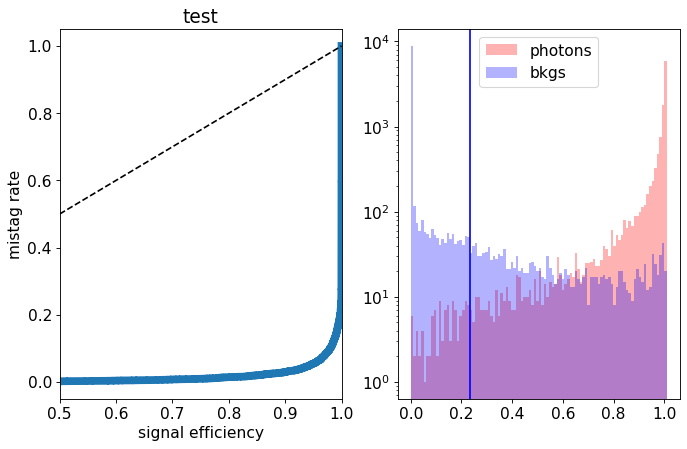

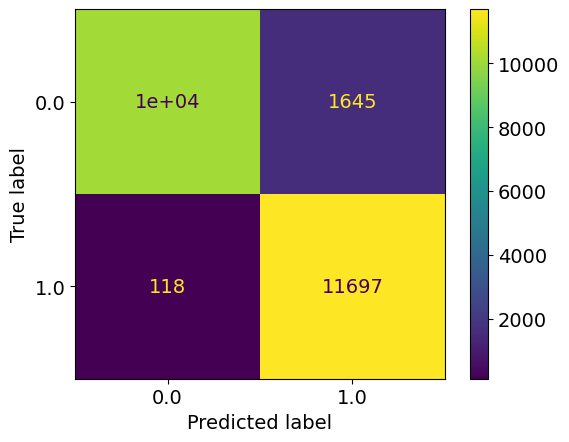

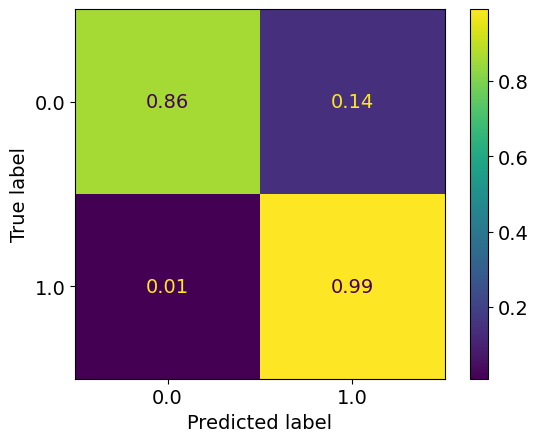

epoch: 840
Learning rate: 9.56091518800029e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14182099073555818
train acc: 0.9431753


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.63it/s]


test loss: 0.14314147923141718
test acc: 0.94602406
epoch: 841
Learning rate: 7.794329076833768e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1414736470883819
train acc: 0.9435472


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.14288376532495023
test acc: 0.945599
epoch: 842
Learning rate: 6.194309466864034e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.18it/s]


train loss: 0.14234294993862226
train acc: 0.9433772


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.21it/s]


test loss: 0.14597478024661542
test acc: 0.94581157
epoch: 843
Learning rate: 4.76717090451227e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14072947403427902
train acc: 0.94385535


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.28it/s]


test loss: 0.14560197852551937
test acc: 0.9454715
epoch: 844
Learning rate: 3.518545653686456e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14035461510822272
train acc: 0.9442378


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.96it/s]


test loss: 0.14645939487963916
test acc: 0.9454715
epoch: 845
Learning rate: 2.453361467808979e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14166137585594396
train acc: 0.94286716


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.56it/s]


test loss: 0.14503884371370077
test acc: 0.945514
epoch: 846
Learning rate: 1.5758221422251474e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14004934778448883
train acc: 0.944631


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.60it/s]


test loss: 0.144795985519886
test acc: 0.9455565
epoch: 847
Learning rate: 8.893909237434605e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


train loss: 0.14086274010170796
train acc: 0.9445247


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.63it/s]


test loss: 0.14513983987271786
test acc: 0.945599
epoch: 848
Learning rate: 3.967768427826535e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14147379567289048
train acc: 0.9438447


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.14548527728766203
test acc: 0.9455565
epoch: 849
Learning rate: 9.992402206632778e-08


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14119332634909137
train acc: 0.9431328


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.62it/s]


test loss: 0.1461079465225339
test acc: 0.9455565


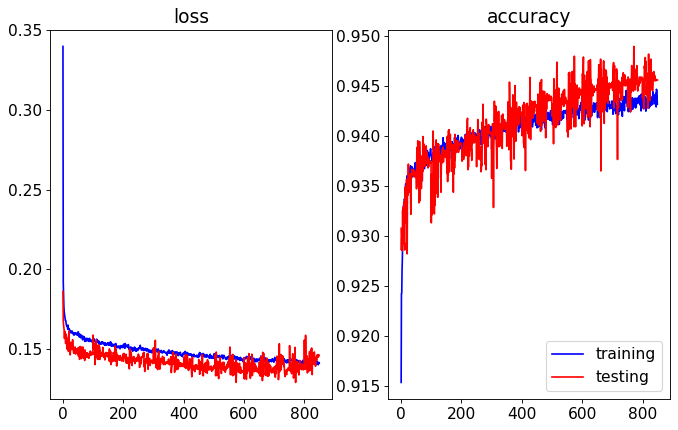

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.83it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


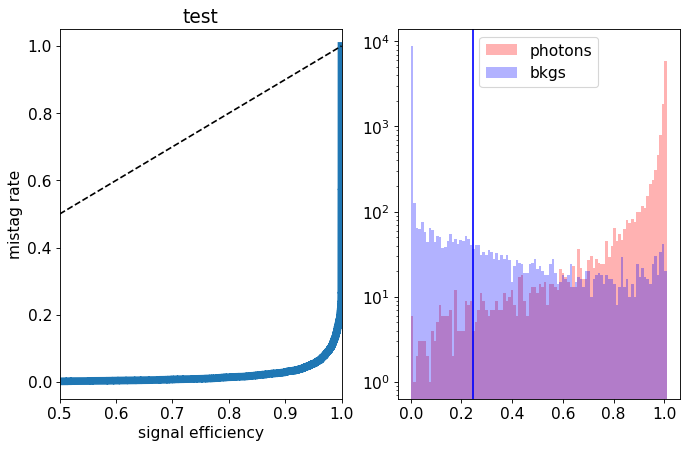

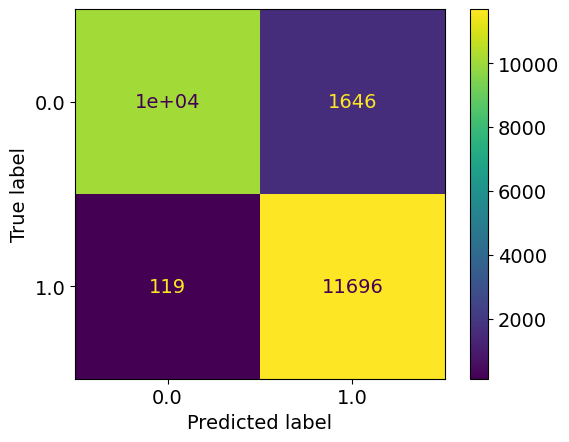

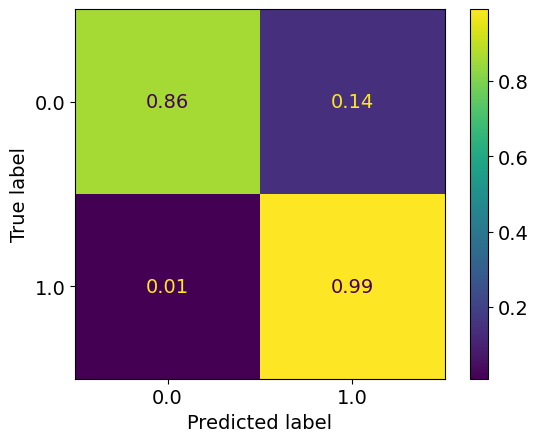

epoch: 850
Learning rate: 4.004058690165735e-12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14287709544418722
train acc: 0.9432497


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.58it/s]


test loss: 0.13732868507504464
test acc: 0.94734156
epoch: 851
Learning rate: 9.99025888725783e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14163041333104395
train acc: 0.94390845


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.80it/s]


test loss: 0.14190821796655656
test acc: 0.944579
epoch: 852
Learning rate: 9.960823902925945e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


train loss: 0.1421476078640883
train acc: 0.9425165


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.32it/s]


test loss: 0.14615704212337732
test acc: 0.94504654
epoch: 853
Learning rate: 9.911810813034072e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14253931900688038
train acc: 0.94311154


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.27it/s]


test loss: 0.13426915183663368
test acc: 0.9476816
epoch: 854
Learning rate: 9.84341304985606e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.25it/s]


train loss: 0.1418255621175857
train acc: 0.9435047


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.49it/s]


test loss: 0.15494566243141888
test acc: 0.94479156
epoch: 855
Learning rate: 9.755900548115212e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14148731800211464
train acc: 0.9433772


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.30it/s]


test loss: 0.14241227563470601
test acc: 0.94521654
epoch: 856
Learning rate: 9.649618679675236e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.1429301393544598
train acc: 0.94306904


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.59it/s]


test loss: 0.13600248824805022
test acc: 0.9470016
epoch: 857
Learning rate: 9.524986890515297e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.26it/s]


train loss: 0.14275825915822557
train acc: 0.9427184


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.40it/s]


test loss: 0.14223995376378298
test acc: 0.94525903
epoch: 858
Learning rate: 9.382497045368364e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.64it/s]


train loss: 0.1421079238414005
train acc: 0.9434303


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.42it/s]


test loss: 0.13235486932098867
test acc: 0.9470441
epoch: 859
Learning rate: 9.222711486555813e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14124173310342109
train acc: 0.9431328


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.29it/s]


test loss: 0.1441264720633626
test acc: 0.94632155


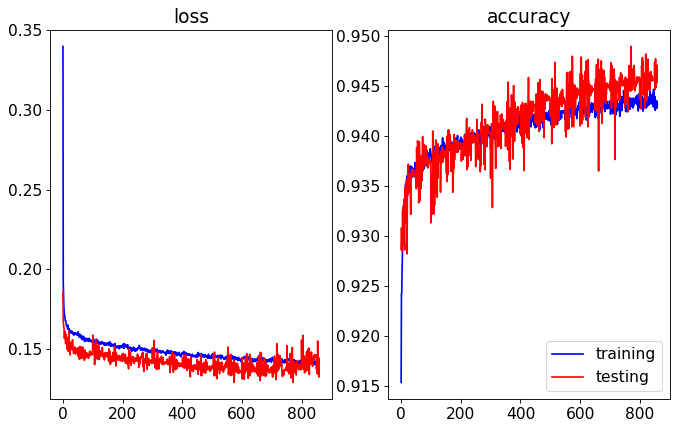

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.38it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


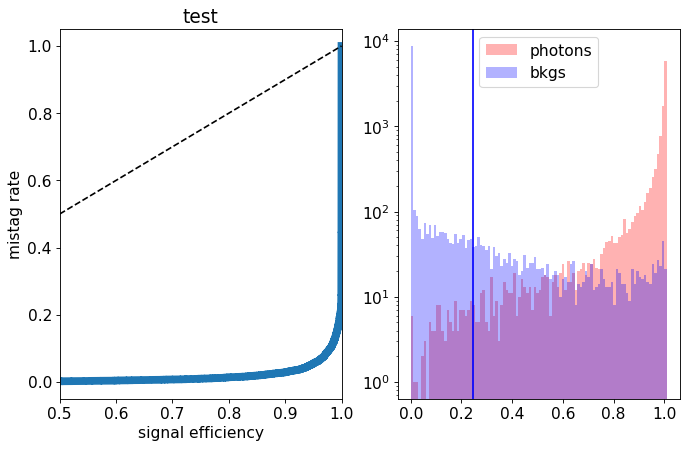

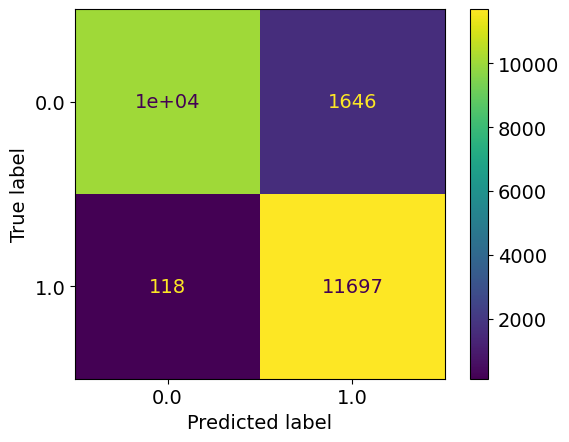

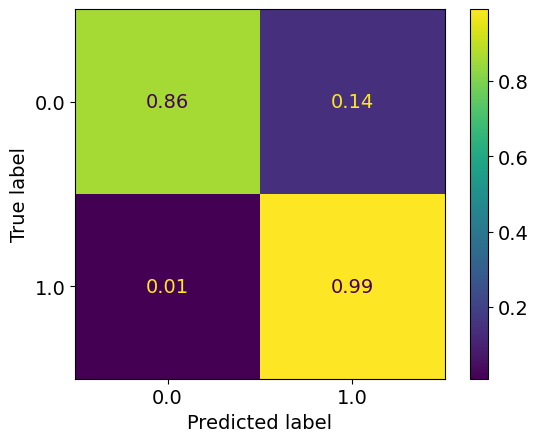

epoch: 860
Learning rate: 9.046260814679199e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.64it/s]


train loss: 0.14299233813004888
train acc: 0.94295216


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.44it/s]


test loss: 0.14692956879734992
test acc: 0.942284
epoch: 861
Learning rate: 8.853841399927774e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.64it/s]


train loss: 0.14304508899996995
train acc: 0.942559


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.36it/s]


test loss: 0.15425337590277194
test acc: 0.944324
epoch: 862
Learning rate: 8.646212633823493e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14206594247726878
train acc: 0.94323903


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.37it/s]


test loss: 0.14443338811397552
test acc: 0.9456841
epoch: 863
Learning rate: 8.42419393224961e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.54it/s]


train loss: 0.14263377504743588
train acc: 0.9435047


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.60it/s]


test loss: 0.1371514018625021
test acc: 0.94589657
epoch: 864
Learning rate: 8.188661501590543e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


train loss: 0.14104078211791957
train acc: 0.9435472


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.37it/s]


test loss: 0.1396188350394368
test acc: 0.9454715
epoch: 865
Learning rate: 7.940544880745565e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.1427317899978085
train acc: 0.9433559


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.62it/s]


test loss: 0.14156009163707495
test acc: 0.944239
epoch: 866
Learning rate: 7.680823272663455e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14185940028186056
train acc: 0.94300526


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.54it/s]


test loss: 0.14521754253655672
test acc: 0.9457266
epoch: 867
Learning rate: 7.410521679875796e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.22it/s]


train loss: 0.14248336438730264
train acc: 0.9433772


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.38it/s]


test loss: 0.14285986553877592
test acc: 0.945429
epoch: 868
Learning rate: 7.130706859280269e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.56it/s]


train loss: 0.14160945826465157
train acc: 0.9435684


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.39it/s]


test loss: 0.13878825921565294
test acc: 0.94504654
epoch: 869
Learning rate: 6.842483112138533e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.30it/s]


train loss: 0.14260459325875446
train acc: 0.94307965


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.35it/s]


test loss: 0.14321393482387065
test acc: 0.94589657


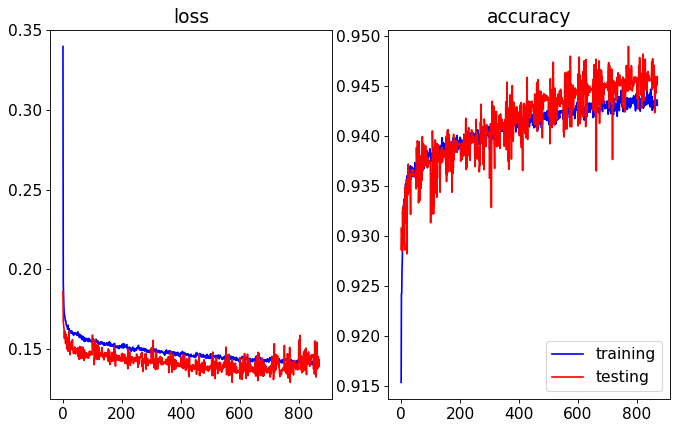

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.35it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


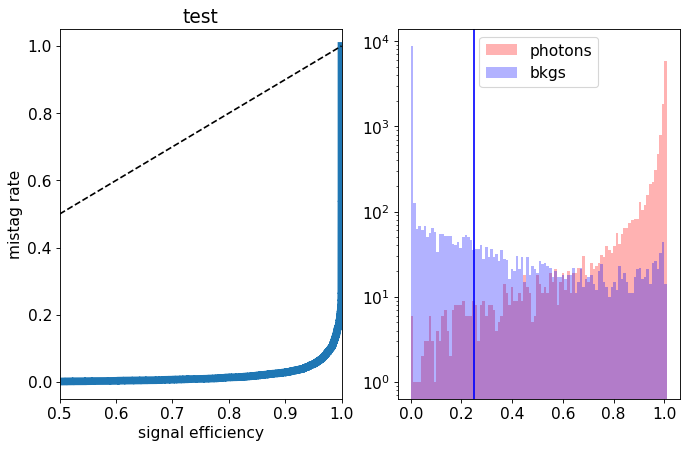

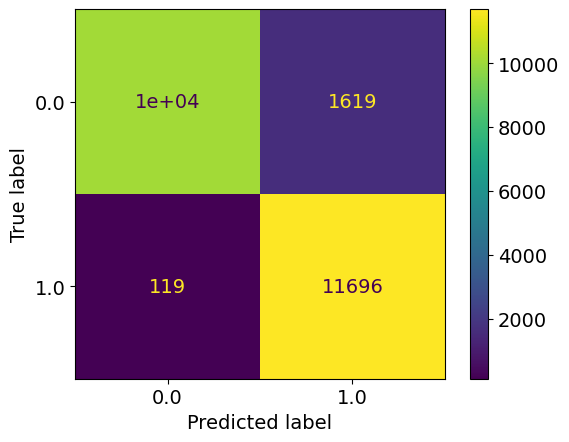

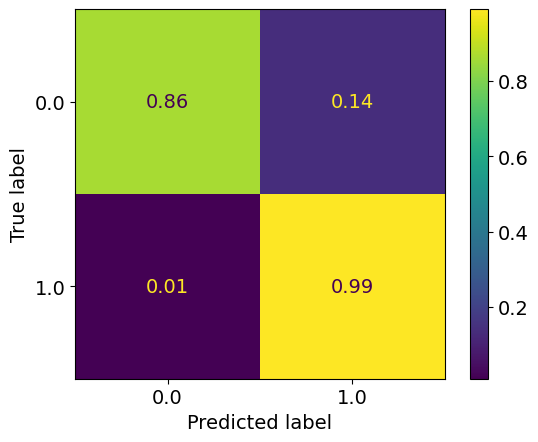

epoch: 870
Learning rate: 6.546987925903652e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.64it/s]


train loss: 0.14090176182947342
train acc: 0.94412094


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.40it/s]


test loss: 0.1388403235003352
test acc: 0.94640654
epoch: 871
Learning rate: 6.245387485076784e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.30it/s]


train loss: 0.1404312459431636
train acc: 0.9435578


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.37it/s]


test loss: 0.1479357497766614
test acc: 0.94394153
epoch: 872
Learning rate: 5.93887206880974e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14098080551358544
train acc: 0.9436853


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.40it/s]


test loss: 0.1444399941712618
test acc: 0.944409
epoch: 873
Learning rate: 5.6286513534169517e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.1422269393209439
train acc: 0.94419533


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.44it/s]


test loss: 0.1472341438755393
test acc: 0.94606656
epoch: 874
Learning rate: 5.315949638335711e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.29it/s]


train loss: 0.14053976374446966
train acc: 0.9436216


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.41it/s]


test loss: 0.1513685632497072
test acc: 0.9441115
epoch: 875
Learning rate: 5.00200101437562e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14196534720575735
train acc: 0.9434728


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.32it/s]


test loss: 0.14700394608080386
test acc: 0.9441965
epoch: 876
Learning rate: 4.6880444933259634e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14087510336736206
train acc: 0.9436216


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.26it/s]


test loss: 0.14321041721850633
test acc: 0.9466616
epoch: 877
Learning rate: 4.375319118142234e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14083182370396935
train acc: 0.9435791


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.41it/s]


test loss: 0.1478704223409295
test acc: 0.944069
epoch: 878
Learning rate: 4.06505907300965e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14135477473591543
train acc: 0.94406784


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.58it/s]


test loss: 0.14186399057507515
test acc: 0.9480216
epoch: 879
Learning rate: 3.758488812582018e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.19it/s]


train loss: 0.14195240322192004
train acc: 0.9433028


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.35it/s]


test loss: 0.13804431967437267
test acc: 0.9480641


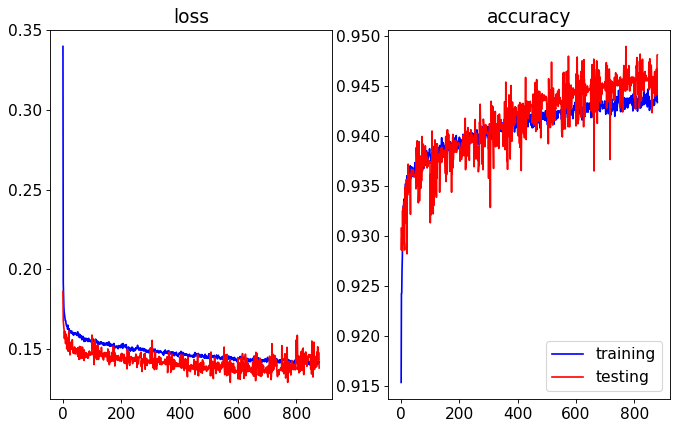

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.40it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


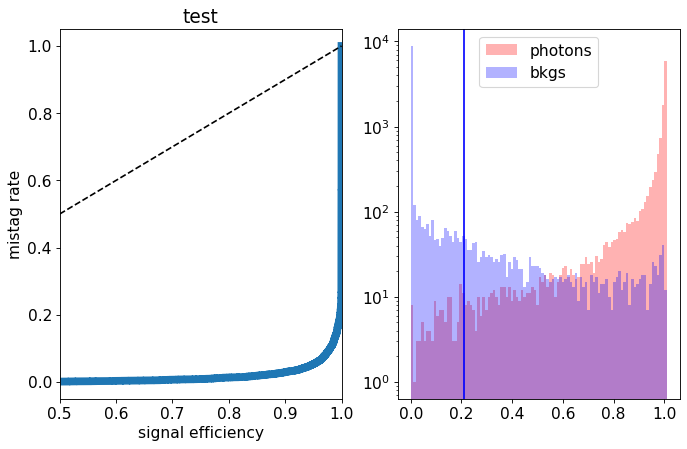

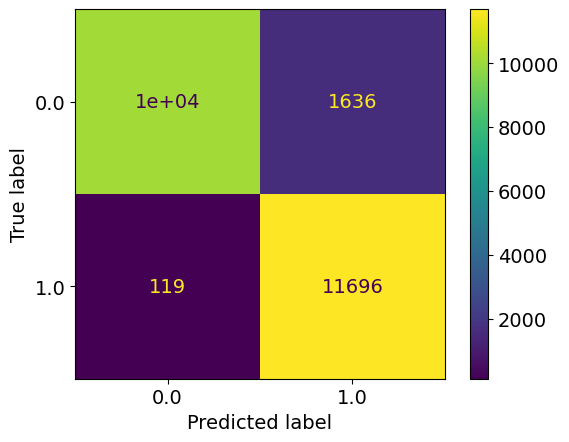

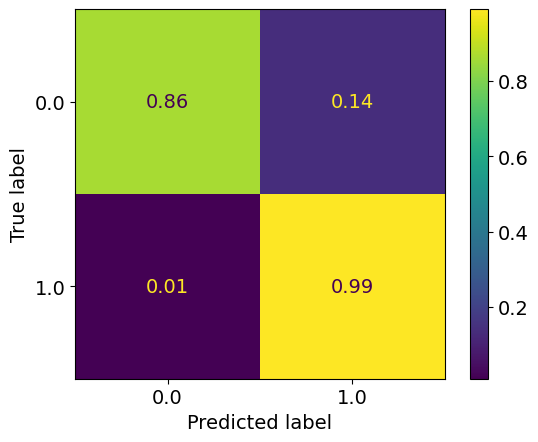

epoch: 880
Learning rate: 3.4568182296186134e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.14056404229182345
train acc: 0.9443335


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.34it/s]


test loss: 0.13707041423767805
test acc: 0.9466191
epoch: 881
Learning rate: 3.161237880090216e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.31it/s]


train loss: 0.14140198095019457
train acc: 0.9443866


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.38it/s]


test loss: 0.14040249902755023
test acc: 0.9469591
epoch: 882
Learning rate: 2.8729142845985978e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.1415224388051944
train acc: 0.9437066


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.37it/s]


test loss: 0.1437935123220086
test acc: 0.945429
epoch: 883
Learning rate: 2.5929853246526404e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1407976359793335
train acc: 0.94386595


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.37it/s]


test loss: 0.1410388233140111
test acc: 0.9469166
epoch: 884
Learning rate: 2.3225557519698758e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.30it/s]


train loss: 0.14014496668508858
train acc: 0.94416344


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.31it/s]


test loss: 0.14632196668535472
test acc: 0.94593906
epoch: 885
Learning rate: 2.0626928285261642e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14146231299942466
train acc: 0.9435472


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.42it/s]


test loss: 0.14482906498014927
test acc: 0.94610906
epoch: 886
Learning rate: 1.8144221145602574e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.31it/s]


train loss: 0.14129156234917367
train acc: 0.9434941


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.32it/s]


test loss: 0.14587832801043987
test acc: 0.94627905
epoch: 887
Learning rate: 1.5787234211560807e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.14059175119088713
train acc: 0.94299465


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.43it/s]


test loss: 0.14390109926462175
test acc: 0.9467041
epoch: 888
Learning rate: 1.3565269433760108e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14235766654371457
train acc: 0.94361097


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.36it/s]


test loss: 0.1411835089325905
test acc: 0.94632155
epoch: 889
Learning rate: 1.1487095892059296e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.31it/s]


train loss: 0.13966136378277638
train acc: 0.94420594


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.43it/s]


test loss: 0.1431656675413251
test acc: 0.94627905


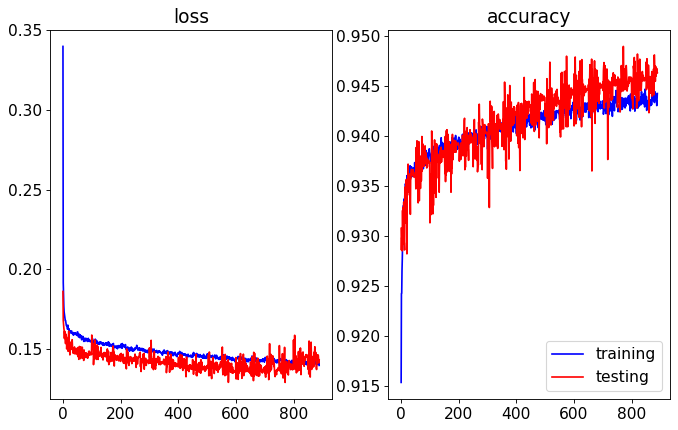

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.41it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


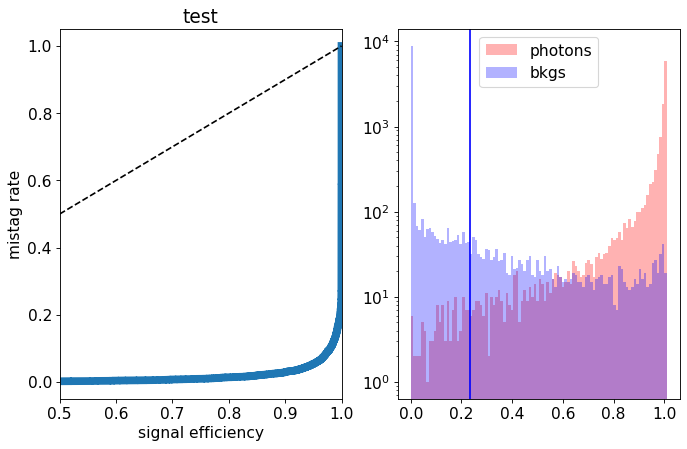

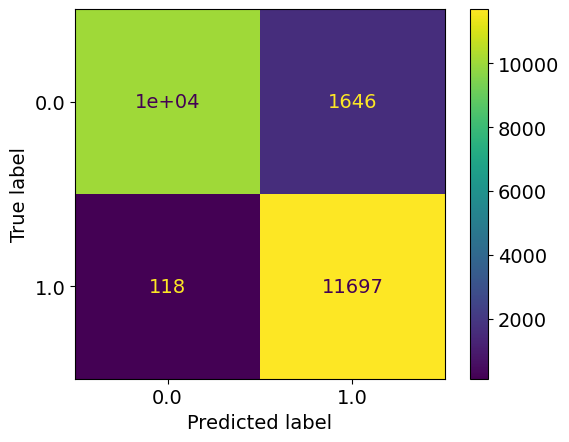

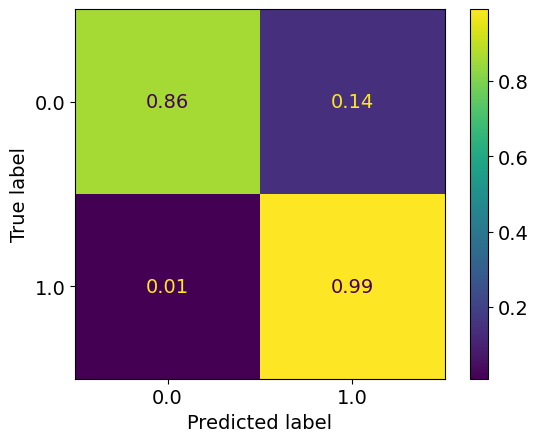

epoch: 890
Learning rate: 9.56091518800029e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14143215418811056
train acc: 0.9440572


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.39it/s]


test loss: 0.1431801587343216
test acc: 0.94636405
epoch: 891
Learning rate: 7.794329076833768e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.31it/s]


train loss: 0.14139891207028346
train acc: 0.94391906


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.40it/s]


test loss: 0.14089290108531713
test acc: 0.9467041
epoch: 892
Learning rate: 6.194309466864034e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14081961391078437
train acc: 0.9443441


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.33it/s]


test loss: 0.1419932384043932
test acc: 0.94636405
epoch: 893
Learning rate: 4.76717090451227e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.1411350216645344
train acc: 0.94404656


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.30it/s]


test loss: 0.1430620038881898
test acc: 0.94615155
epoch: 894
Learning rate: 3.518545653686456e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.64it/s]


train loss: 0.140607060710336
train acc: 0.94387656


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.43it/s]


test loss: 0.1421014392748475
test acc: 0.9467466
epoch: 895
Learning rate: 2.453361467808979e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.1413263254769289
train acc: 0.9436641


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.36it/s]


test loss: 0.1433460060507059
test acc: 0.94649154
epoch: 896
Learning rate: 1.5758221422251474e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.31it/s]


train loss: 0.14080432555667913
train acc: 0.94377035


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.42it/s]


test loss: 0.14409200921654702
test acc: 0.94644904
epoch: 897
Learning rate: 8.893909237434605e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.55it/s]


train loss: 0.14156523963827997
train acc: 0.94415283


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.51it/s]


test loss: 0.14267840124666692
test acc: 0.94653404
epoch: 898
Learning rate: 3.967768427826535e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14068761415732134
train acc: 0.9436853


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.08it/s]


test loss: 0.14271359853446483
test acc: 0.94657654
epoch: 899
Learning rate: 9.992402206632778e-08


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14191259211225873
train acc: 0.9432284


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.62it/s]


test loss: 0.1431951429694891
test acc: 0.94657654


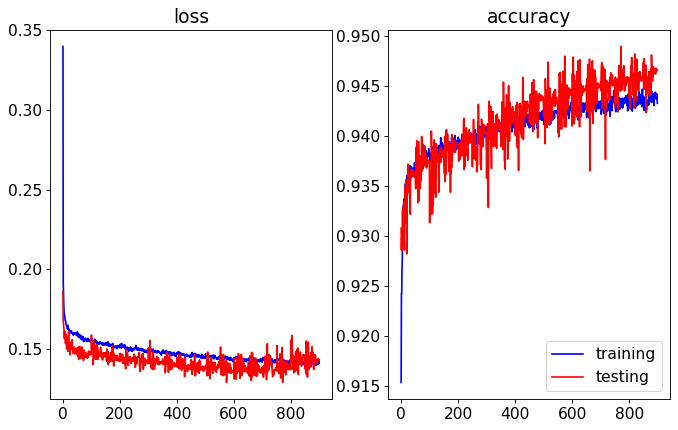

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.60it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


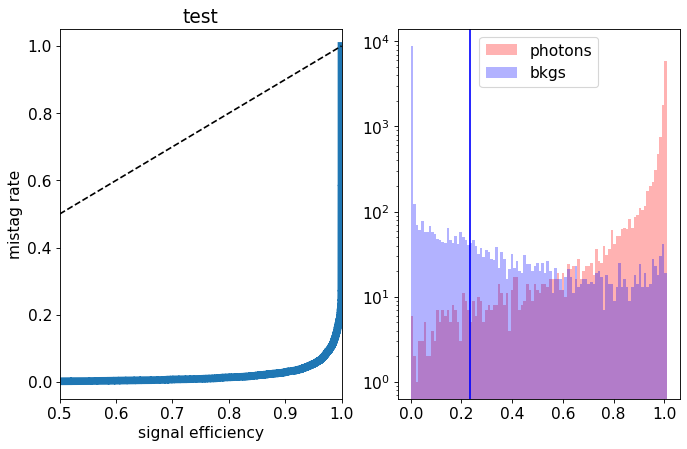

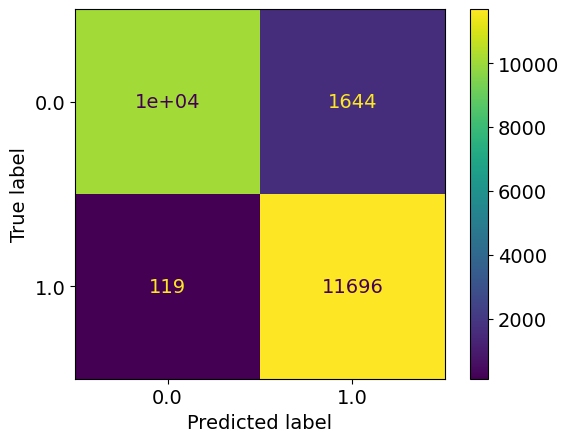

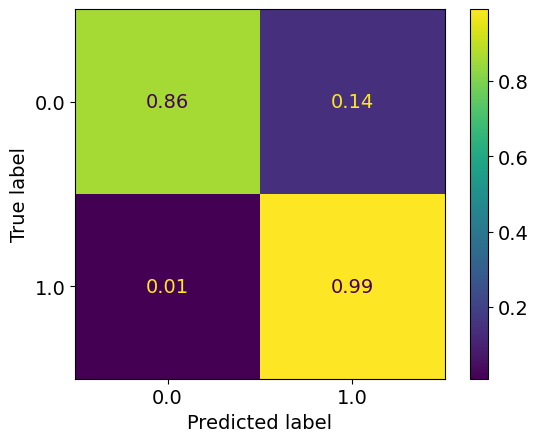

epoch: 900
Learning rate: 4.004058690165735e-12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14253786348613204
train acc: 0.9433878


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.16it/s]


test loss: 0.14162366632372142
test acc: 0.94623655
epoch: 901
Learning rate: 9.99025888725783e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.33it/s]


train loss: 0.14172698742454978
train acc: 0.9434197


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.39it/s]


test loss: 0.140099617280066
test acc: 0.9469166
epoch: 902
Learning rate: 9.960823902925945e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.1425268890181924
train acc: 0.94311154


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.26it/s]


test loss: 0.14220309313386678
test acc: 0.9453865
epoch: 903
Learning rate: 9.911810813034072e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.32it/s]


train loss: 0.1414738352511339
train acc: 0.9434516


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.23it/s]


test loss: 0.13871178776025772
test acc: 0.9478516
epoch: 904
Learning rate: 9.84341304985606e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14212177978579404
train acc: 0.94299465


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.1511613829061389
test acc: 0.94585407
epoch: 905
Learning rate: 9.755900548115212e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14202210985741037
train acc: 0.94369596


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.53it/s]


test loss: 0.14000180568546056
test acc: 0.94615155
epoch: 906
Learning rate: 9.649618679675236e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


train loss: 0.1412537817362767
train acc: 0.9431753


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.64it/s]


test loss: 0.15932861175388097
test acc: 0.9457691
epoch: 907
Learning rate: 9.524986890515297e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1408773657337875
train acc: 0.9440572


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.56it/s]


test loss: 0.14169565513730048
test acc: 0.94734156
epoch: 908
Learning rate: 9.382497045368364e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14239497112620408
train acc: 0.9431328


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.96it/s]


test loss: 0.13977454993873833
test acc: 0.9468316
epoch: 909
Learning rate: 9.222711486555813e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14062883220850284
train acc: 0.94395095


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.53it/s]


test loss: 0.14361143428832293
test acc: 0.94649154


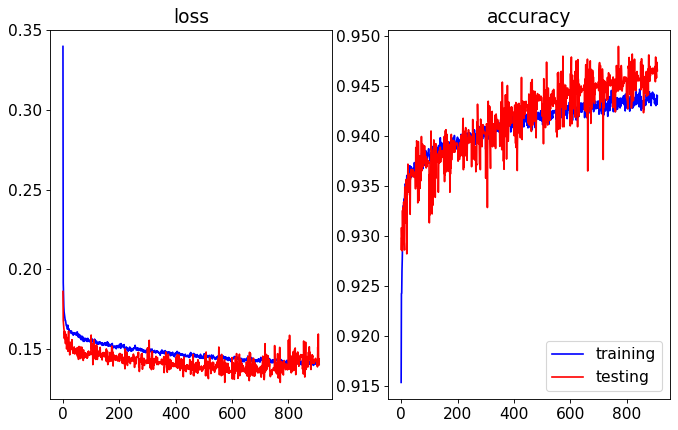

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.62it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


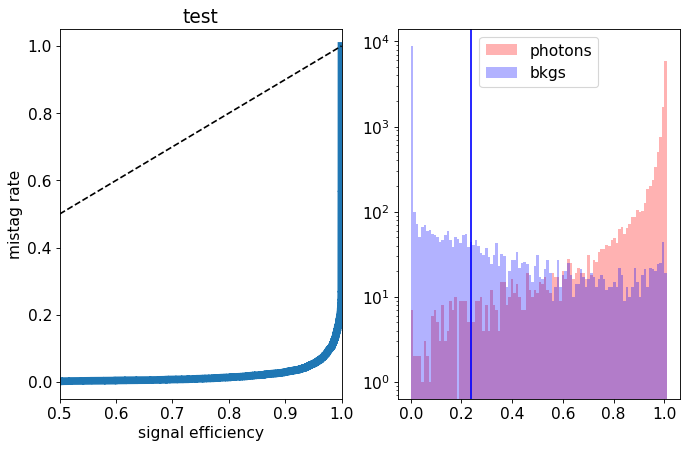

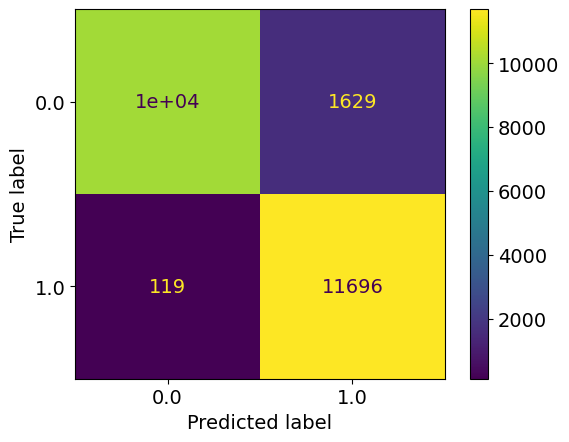

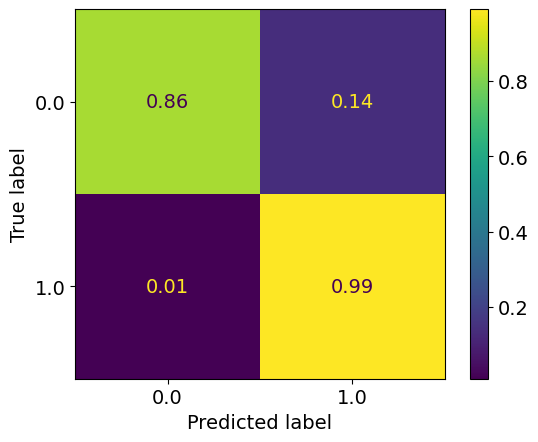

epoch: 910
Learning rate: 9.046260814679199e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14121930097128935
train acc: 0.9433984


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.93it/s]


test loss: 0.1445447327569127
test acc: 0.94598156
epoch: 911
Learning rate: 8.853841399927774e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14148598150083214
train acc: 0.9435047


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.60it/s]


test loss: 0.14056154452264308
test acc: 0.9443665
epoch: 912
Learning rate: 8.646212633823493e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14255523776552478
train acc: 0.94319654


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.63it/s]


test loss: 0.13703202754259108
test acc: 0.94606656
epoch: 913
Learning rate: 8.42419393224961e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.20it/s]


train loss: 0.14035621902365594
train acc: 0.9435366


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.64it/s]


test loss: 0.14466432053595782
test acc: 0.94517404
epoch: 914
Learning rate: 8.188661501590543e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14120229703795378
train acc: 0.94395095


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.60it/s]


test loss: 0.1449265770614147
test acc: 0.9456841
epoch: 915
Learning rate: 7.940544880745565e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.1414395453064305
train acc: 0.94298404


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.63it/s]


test loss: 0.13495897278189659
test acc: 0.94742656
epoch: 916
Learning rate: 7.680823272663455e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


train loss: 0.14188725107414707
train acc: 0.9437278


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.53it/s]


test loss: 0.13988642655313016
test acc: 0.9468741
epoch: 917
Learning rate: 7.410521679875796e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1407118088500515
train acc: 0.94403595


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.62it/s]


test loss: 0.14054201431572438
test acc: 0.9466616
epoch: 918
Learning rate: 7.130706859280269e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.20it/s]


train loss: 0.14213707449899357
train acc: 0.9434834


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.49it/s]


test loss: 0.13800799306482076
test acc: 0.94653404
epoch: 919
Learning rate: 6.842483112138533e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.14053449243496938
train acc: 0.944546


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.14it/s]


test loss: 0.14323166534304618
test acc: 0.9478941


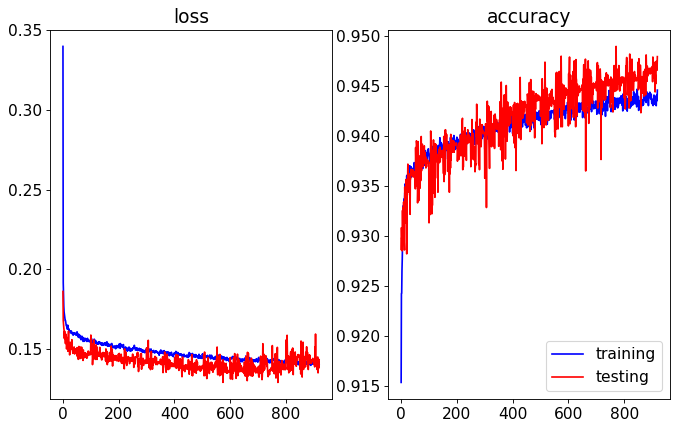

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.33it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


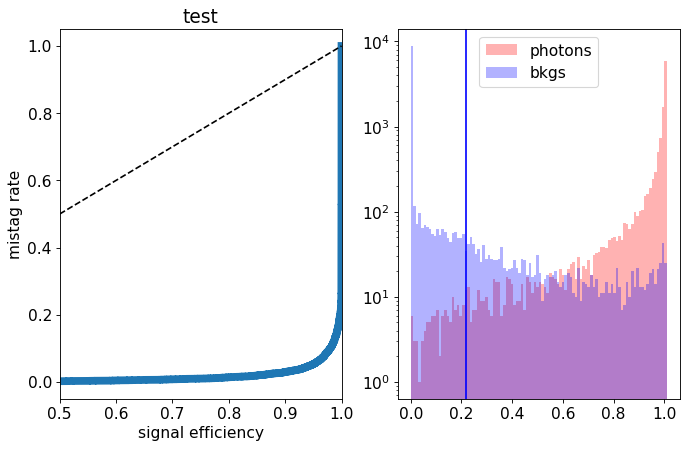

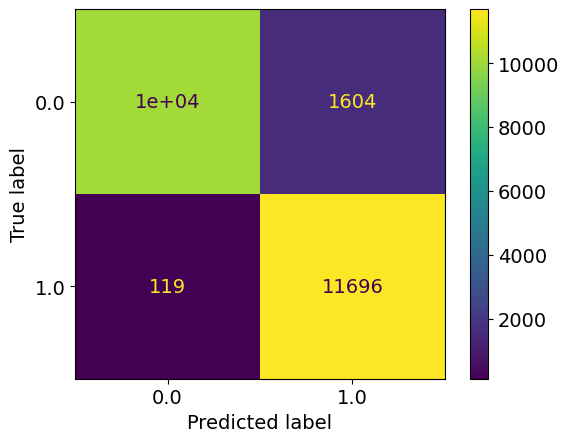

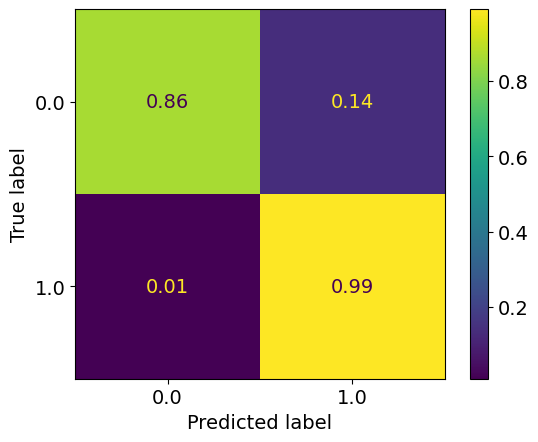

epoch: 920
Learning rate: 6.546987925903652e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.30it/s]


train loss: 0.14111993874713874
train acc: 0.94396156


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.37it/s]


test loss: 0.1350304873660207
test acc: 0.94742656
epoch: 921
Learning rate: 6.245387485076784e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.141421633778484
train acc: 0.9434728


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.30it/s]


test loss: 0.14690514765679835
test acc: 0.9456416
epoch: 922
Learning rate: 5.93887206880974e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.14131665286744477
train acc: 0.9435578


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.40it/s]


test loss: 0.1568525040522218
test acc: 0.943304
epoch: 923
Learning rate: 5.6286513534169517e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.29it/s]


train loss: 0.14068109494675496
train acc: 0.94302654


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.49it/s]


test loss: 0.14946488179266454
test acc: 0.9444515
epoch: 924
Learning rate: 5.315949638335711e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.14028760159661055
train acc: 0.9434834


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.57it/s]


test loss: 0.15590390991419553
test acc: 0.9442815
epoch: 925
Learning rate: 5.00200101437562e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.14116441344569444
train acc: 0.9443653


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.98it/s]


test loss: 0.13861833848059177
test acc: 0.9478091
epoch: 926
Learning rate: 4.6880444933259634e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14137505469428505
train acc: 0.9442272


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.58it/s]


test loss: 0.14282940551638604
test acc: 0.9455565
epoch: 927
Learning rate: 4.375319118142234e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.56it/s]


train loss: 0.1403176300939481
train acc: 0.94391906


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.81it/s]


test loss: 0.1379147030413151
test acc: 0.94504654
epoch: 928
Learning rate: 4.06505907300965e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


train loss: 0.14002262986010047
train acc: 0.943324


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.62it/s]


test loss: 0.14012854509055614
test acc: 0.9484041
epoch: 929
Learning rate: 3.758488812582018e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14092133853845534
train acc: 0.9444503


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.56it/s]


test loss: 0.1451514894142747
test acc: 0.9468316


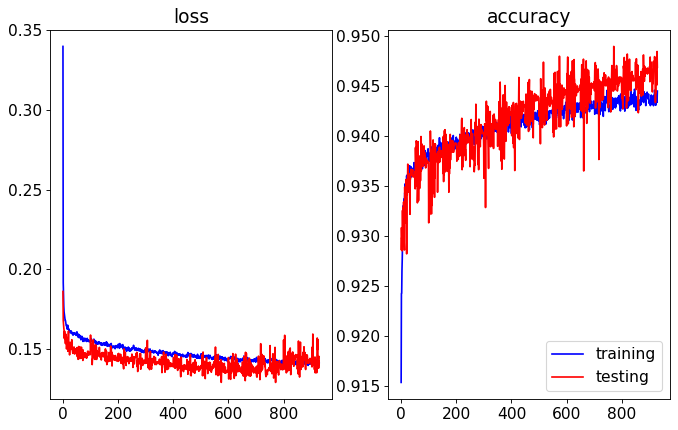

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.37it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


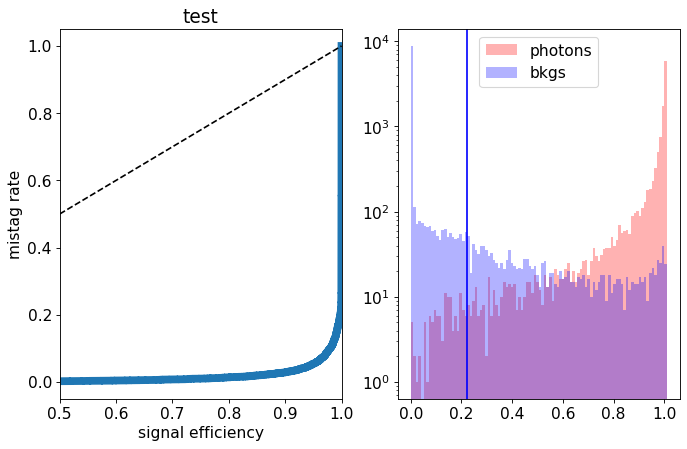

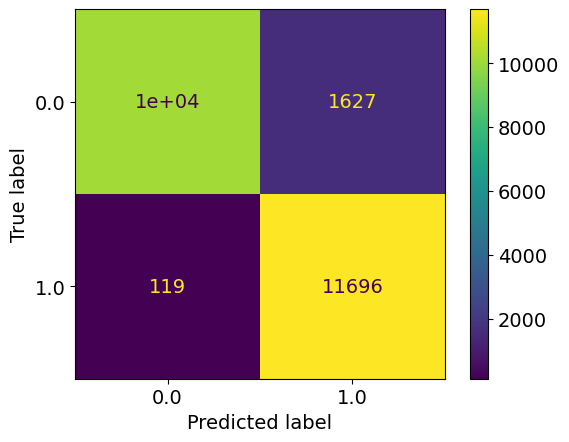

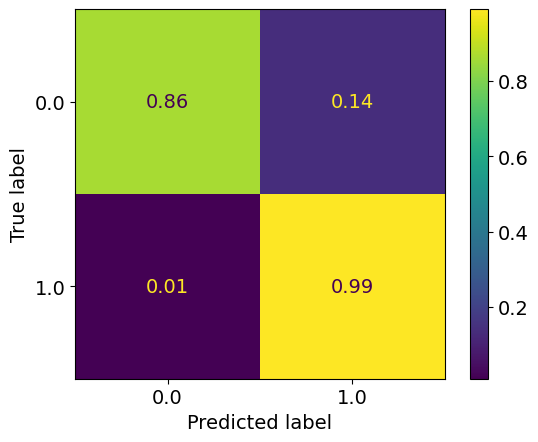

epoch: 930
Learning rate: 3.4568182296186134e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.29it/s]


train loss: 0.14087512016676035
train acc: 0.94415283


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.37it/s]


test loss: 0.14150034505873918
test acc: 0.9475966
epoch: 931
Learning rate: 3.161237880090216e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14035587197845908
train acc: 0.94374907


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.35it/s]


test loss: 0.14031865894794465
test acc: 0.9478516
epoch: 932
Learning rate: 2.8729142845985978e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.140336428003706
train acc: 0.9446416


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.32it/s]


test loss: 0.1417116027325392
test acc: 0.9479791
epoch: 933
Learning rate: 2.5929853246526404e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.32it/s]


train loss: 0.14020418945201643
train acc: 0.9435791


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.40it/s]


test loss: 0.14808997344225644
test acc: 0.9469166
epoch: 934
Learning rate: 2.3225557519698758e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.1399153191952189
train acc: 0.94465226


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.40it/s]


test loss: 0.1438219344243407
test acc: 0.9470441
epoch: 935
Learning rate: 2.0626928285261642e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.30it/s]


train loss: 0.1406449698813402
train acc: 0.9438022


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.39it/s]


test loss: 0.14704560916870832
test acc: 0.94598156
epoch: 936
Learning rate: 1.8144221145602574e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14073259283782572
train acc: 0.94400406


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.39it/s]


test loss: 0.14418738279491664
test acc: 0.94602406
epoch: 937
Learning rate: 1.5787234211560807e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14056097393392758
train acc: 0.9434728


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.32it/s]


test loss: 0.1466446140781045
test acc: 0.94632155
epoch: 938
Learning rate: 1.3565269433760108e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.32it/s]


train loss: 0.13911172880488595
train acc: 0.9444716


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.40it/s]


test loss: 0.1399318754673004
test acc: 0.9477241
epoch: 939
Learning rate: 1.1487095892059296e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.1402333540141962
train acc: 0.94465226


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.40it/s]


test loss: 0.14001284018158913
test acc: 0.94725657


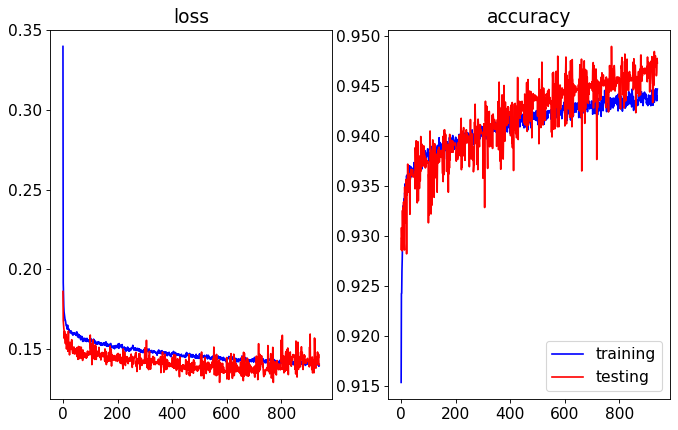

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.36it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


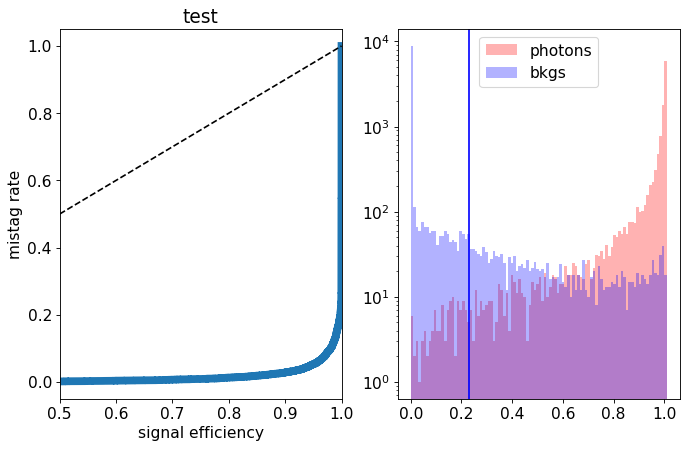

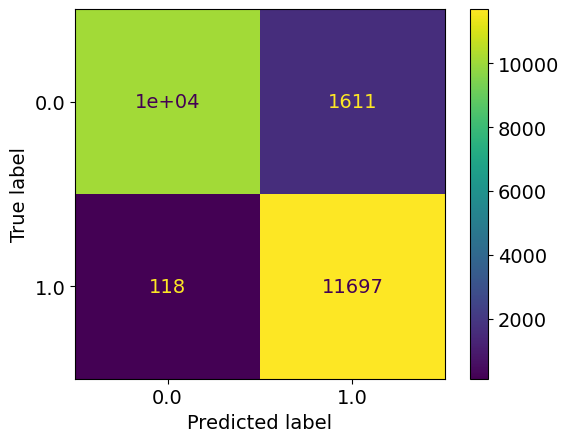

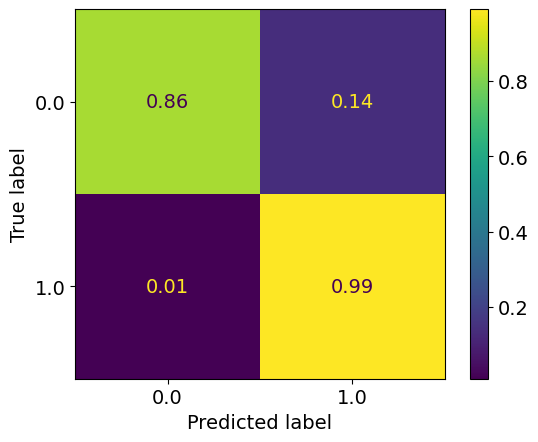

epoch: 940
Learning rate: 9.56091518800029e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.20it/s]


train loss: 0.1405125250861903
train acc: 0.9437172


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.62it/s]


test loss: 0.13962217969819904
test acc: 0.94717157
epoch: 941
Learning rate: 7.794329076833768e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1394725274887814
train acc: 0.9443866


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.62it/s]


test loss: 0.1408863240852952
test acc: 0.94742656
epoch: 942
Learning rate: 6.194309466864034e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1401592241540836
train acc: 0.94381285


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.00it/s]


test loss: 0.14018518766388297
test acc: 0.9478091
epoch: 943
Learning rate: 4.76717090451227e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.56it/s]


train loss: 0.14089331130503088
train acc: 0.9436003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.42it/s]


test loss: 0.14184214863926173
test acc: 0.9470016
epoch: 944
Learning rate: 3.518545653686456e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1407844641595889
train acc: 0.9436641


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.30it/s]


test loss: 0.14273935966193677
test acc: 0.9469166
epoch: 945
Learning rate: 2.453361467808979e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.31it/s]


train loss: 0.1396035919333719
train acc: 0.944291


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.41it/s]


test loss: 0.142394595220685
test acc: 0.9470016
epoch: 946
Learning rate: 1.5758221422251474e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.64it/s]


train loss: 0.1409135050359805
train acc: 0.9443866


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.42it/s]


test loss: 0.14124946519732476
test acc: 0.9470866
epoch: 947
Learning rate: 8.893909237434605e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.54it/s]


train loss: 0.14038664301869216
train acc: 0.94389784


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.14121006168425082
test acc: 0.9470866
epoch: 948
Learning rate: 3.967768427826535e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


train loss: 0.14106936154851488
train acc: 0.9427928


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.64it/s]


test loss: 0.14214992187917233
test acc: 0.9470441
epoch: 949
Learning rate: 9.992402206632778e-08


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.140699256377615
train acc: 0.944291


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.60it/s]


test loss: 0.1426701383665204
test acc: 0.9470866


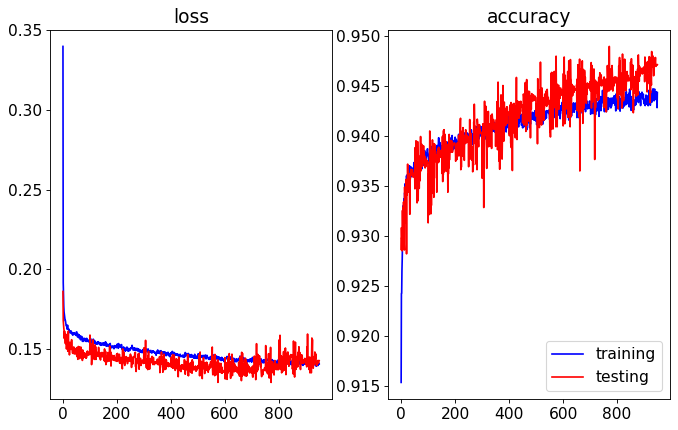

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.58it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


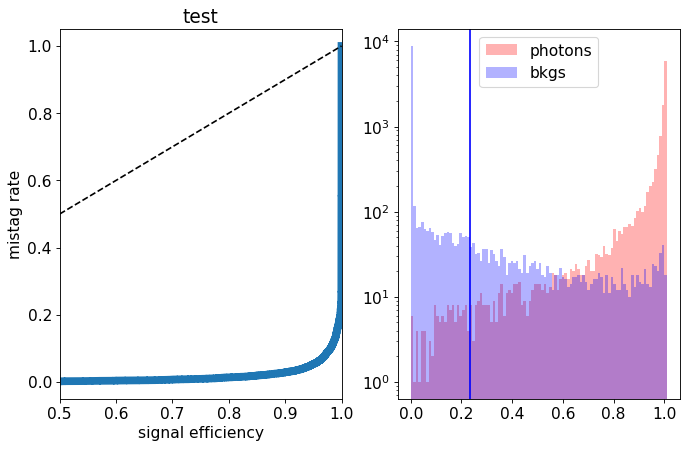

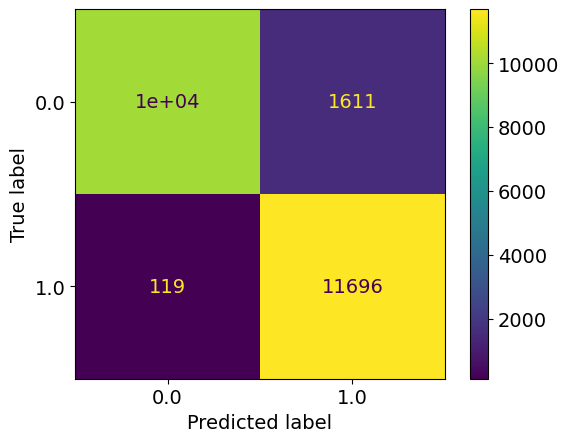

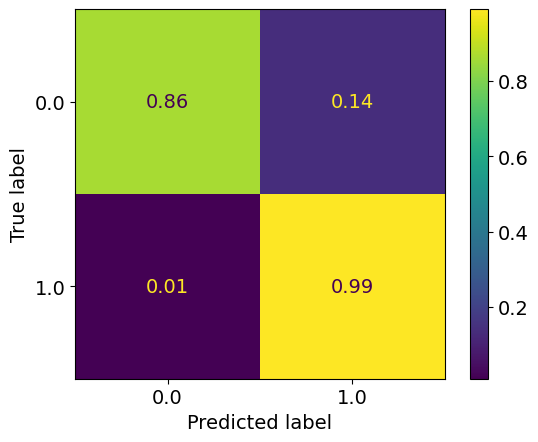

epoch: 950
Learning rate: 4.004058690165735e-12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.25it/s]


train loss: 0.14144591374951562
train acc: 0.94404656


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.39it/s]


test loss: 0.13368723914027214
test acc: 0.9469166
epoch: 951
Learning rate: 9.99025888725783e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.64it/s]


train loss: 0.14146863180360977
train acc: 0.94319654


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.30it/s]


test loss: 0.1492397664114833
test acc: 0.94610906
epoch: 952
Learning rate: 9.960823902925945e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.31it/s]


train loss: 0.14024368521704036
train acc: 0.94420594


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.37it/s]


test loss: 0.1349387964233756
test acc: 0.9485741
epoch: 953
Learning rate: 9.911810813034072e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.1423798183062274
train acc: 0.9435791


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.38it/s]


test loss: 0.13525638561695813
test acc: 0.94657654
epoch: 954
Learning rate: 9.84341304985606e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14055844282458543
train acc: 0.9444503


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.52it/s]


test loss: 0.15571378823369741
test acc: 0.94394153
epoch: 955
Learning rate: 9.755900548115212e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.23it/s]


train loss: 0.14187190330522076
train acc: 0.9437597


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.68it/s]


test loss: 0.14126245938241483
test acc: 0.9456416
epoch: 956
Learning rate: 9.649618679675236e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14224047422598882
train acc: 0.9427184


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.60it/s]


test loss: 0.1398335300385952
test acc: 0.9456416
epoch: 957
Learning rate: 9.524986890515297e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14005346876230967
train acc: 0.94292027


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.08it/s]


test loss: 0.14459987450391054
test acc: 0.94589657
epoch: 958
Learning rate: 9.382497045368364e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14065811896969557
train acc: 0.9443335


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.34it/s]


test loss: 0.14023866951465608
test acc: 0.94636405
epoch: 959
Learning rate: 9.222711486555813e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14125482178038093
train acc: 0.9433028


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.40it/s]


test loss: 0.1401951203122735
test acc: 0.94742656


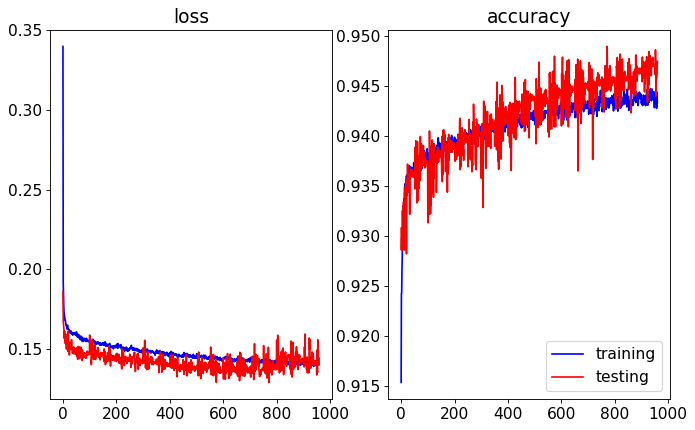

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.37it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


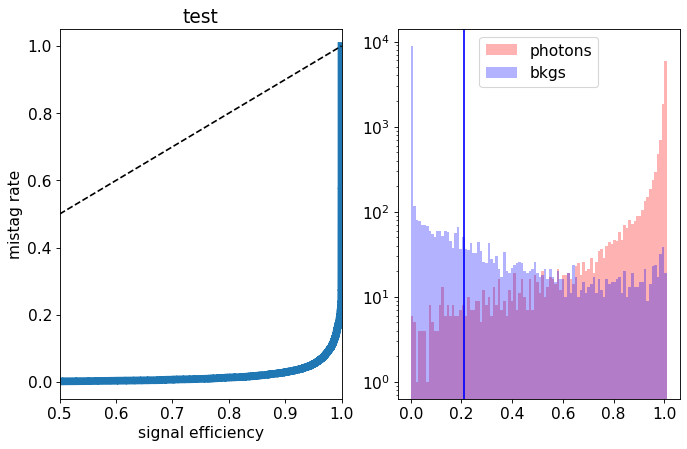

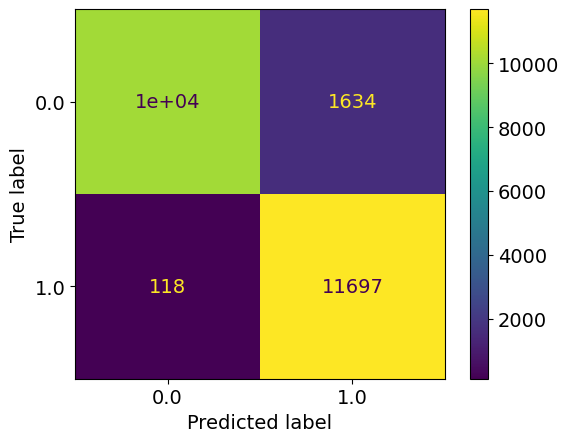

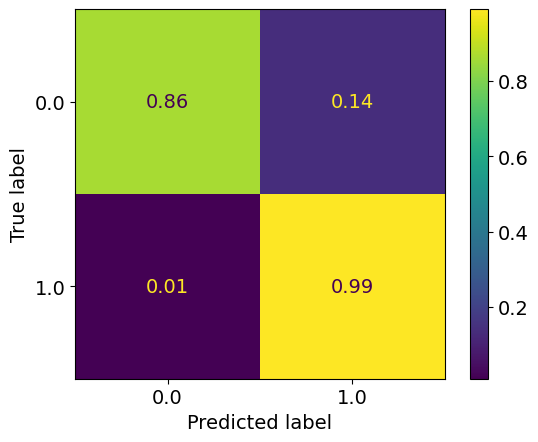

epoch: 960
Learning rate: 9.046260814679199e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.31it/s]


train loss: 0.14055017405634473
train acc: 0.94386595


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.39it/s]


test loss: 0.14321694653481246
test acc: 0.94610906
epoch: 961
Learning rate: 8.853841399927774e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.14043788403082805
train acc: 0.94302654


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.36it/s]


test loss: 0.13804917950183154
test acc: 0.94606656
epoch: 962
Learning rate: 8.646212633823493e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.24it/s]


train loss: 0.1412856441679274
train acc: 0.9436216


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.62it/s]


test loss: 0.14987339060753585
test acc: 0.94632155
epoch: 963
Learning rate: 8.42419393224961e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14104209674201953
train acc: 0.9432922


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.57it/s]


test loss: 0.14079909399151802
test acc: 0.9470016
epoch: 964
Learning rate: 8.188661501590543e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14121620243142366
train acc: 0.9434728


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.62it/s]


test loss: 0.13688257988542318
test acc: 0.9480641
epoch: 965
Learning rate: 7.940544880745565e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.20it/s]


train loss: 0.14066347930651563
train acc: 0.94474787


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.59it/s]


test loss: 0.13880204930901527
test acc: 0.9466191
epoch: 966
Learning rate: 7.680823272663455e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.59it/s]


train loss: 0.14143410605040324
train acc: 0.94402534


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.29it/s]


test loss: 0.14453668016940355
test acc: 0.94627905
epoch: 967
Learning rate: 7.410521679875796e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.29it/s]


train loss: 0.13957192354900821
train acc: 0.9438872


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.36it/s]


test loss: 0.1366869043558836
test acc: 0.9480641
epoch: 968
Learning rate: 7.130706859280269e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14082937863222353
train acc: 0.94396156


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.57it/s]


test loss: 0.14072051243856548
test acc: 0.9457266
epoch: 969
Learning rate: 6.842483112138533e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1404341124710004
train acc: 0.94390845


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.13713927362114192
test acc: 0.94725657


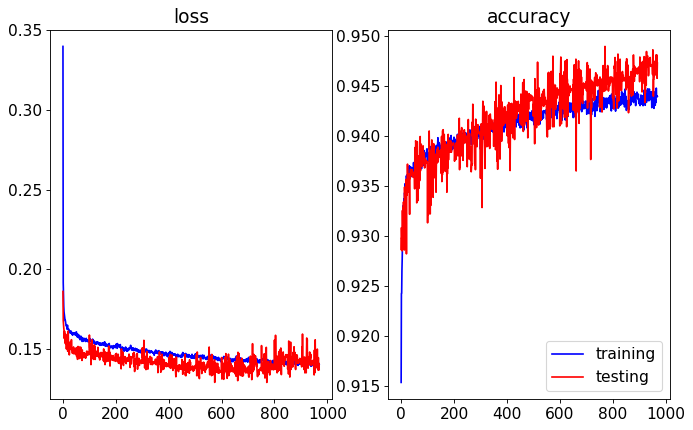

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.92it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


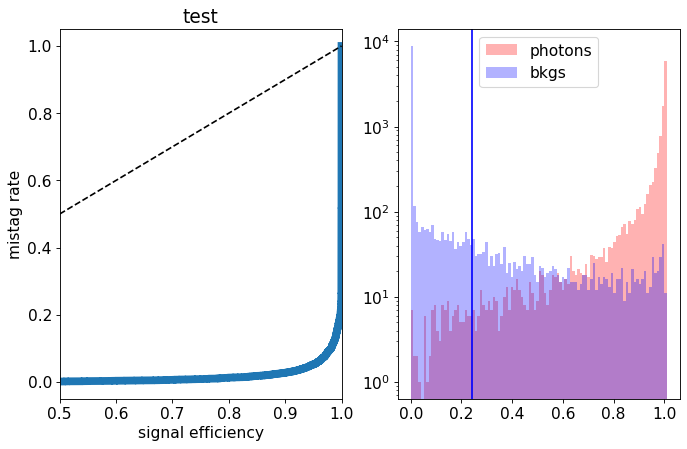

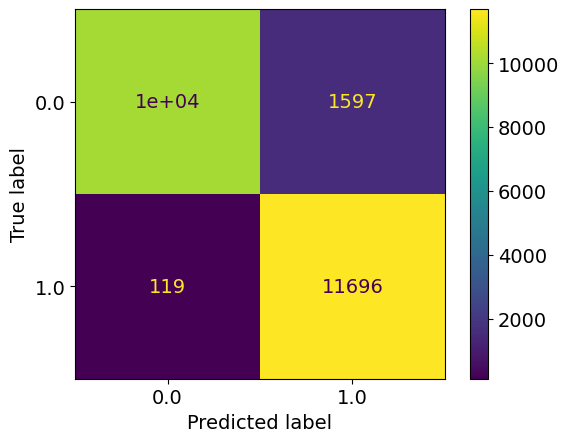

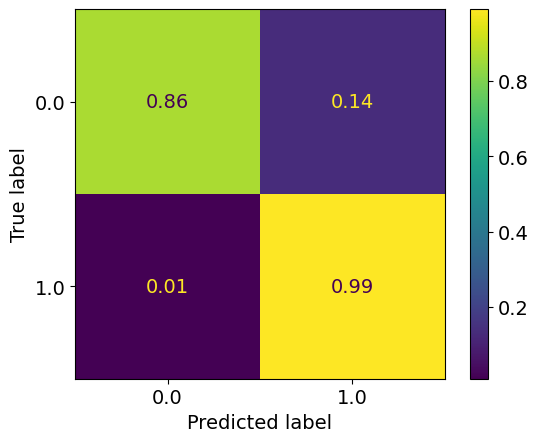

epoch: 970
Learning rate: 6.546987925903652e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14134768752535437
train acc: 0.9434728


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.64it/s]


test loss: 0.1485422607511282
test acc: 0.94610906
epoch: 971
Learning rate: 6.245387485076784e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14086956777580226
train acc: 0.94389784


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.64it/s]


test loss: 0.1420830747112632
test acc: 0.9476816
epoch: 972
Learning rate: 5.93887206880974e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.30it/s]


train loss: 0.1408537798531496
train acc: 0.94399345


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.36it/s]


test loss: 0.13975896835327148
test acc: 0.94487655
epoch: 973
Learning rate: 5.6286513534169517e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14064497771156823
train acc: 0.94412094


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.41it/s]


test loss: 0.13775645727291702
test acc: 0.9481066
epoch: 974
Learning rate: 5.315949638335711e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.64it/s]


train loss: 0.14133382621844104
train acc: 0.94402534


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.37it/s]


test loss: 0.14356989767402412
test acc: 0.94734156
epoch: 975
Learning rate: 5.00200101437562e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.14027658607929375
train acc: 0.9438447


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.40it/s]


test loss: 0.1392614159733057
test acc: 0.9478516
epoch: 976
Learning rate: 4.6880444933259634e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.64it/s]


train loss: 0.14044539070433112
train acc: 0.9443547


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.41it/s]


test loss: 0.13061583042144775
test acc: 0.9491266
new best acc: 0.9491266
epoch: 977
Learning rate: 4.375319118142234e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.31it/s]


train loss: 0.14115797552713163
train acc: 0.9436003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.33it/s]


test loss: 0.13920570872724056
test acc: 0.9466616
epoch: 978
Learning rate: 4.06505907300965e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.1397428474133941
train acc: 0.94479036


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.41it/s]


test loss: 0.1356070201843977
test acc: 0.9470866
epoch: 979
Learning rate: 3.758488812582018e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.64it/s]


train loss: 0.14086509045142276
train acc: 0.94387656


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.40it/s]


test loss: 0.15434259716421367
test acc: 0.94619405


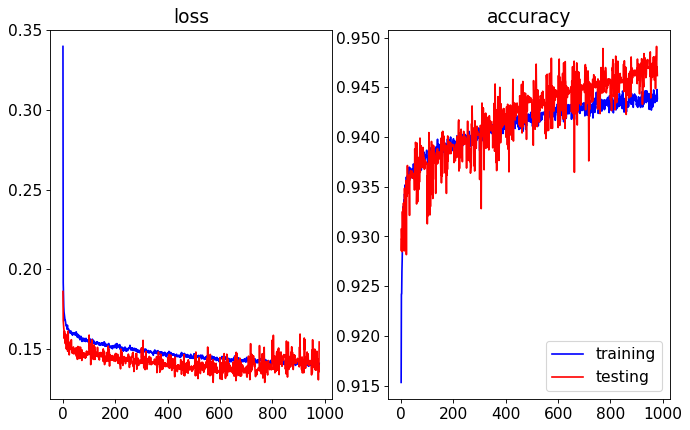

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.34it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


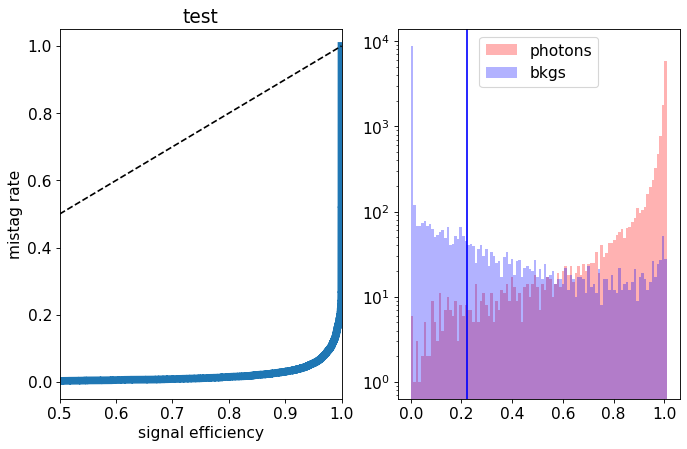

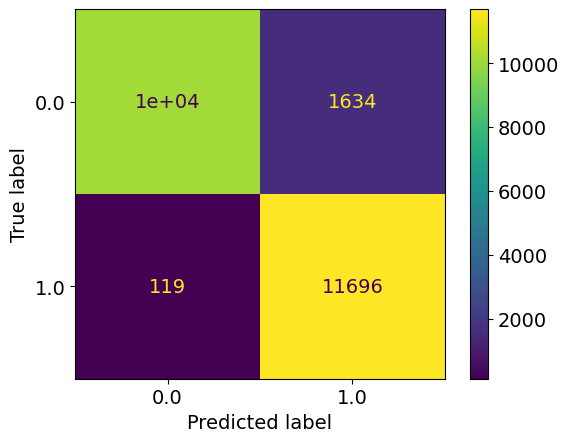

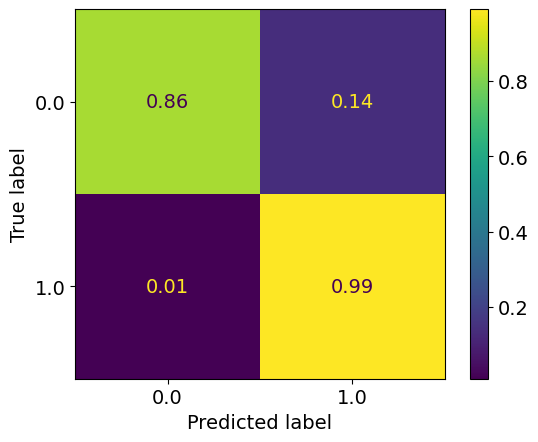

epoch: 980
Learning rate: 3.4568182296186134e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14076139934503348
train acc: 0.94374907


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.41it/s]


test loss: 0.14312048703432084
test acc: 0.9485316
epoch: 981
Learning rate: 3.161237880090216e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14102012573913403
train acc: 0.9440572


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.42it/s]


test loss: 0.14692946076393126
test acc: 0.94598156
epoch: 982
Learning rate: 2.8729142845985978e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.30it/s]


train loss: 0.14048054505875157
train acc: 0.94420594


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.03it/s]


test loss: 0.14408519081771373
test acc: 0.9468741
epoch: 983
Learning rate: 2.5929853246526404e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.61it/s]


train loss: 0.1398040689765268
train acc: 0.9446204


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.28it/s]


test loss: 0.14099848605692386
test acc: 0.9475541
epoch: 984
Learning rate: 2.3225557519698758e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.30it/s]


train loss: 0.13925559320457423
train acc: 0.9446416


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.34it/s]


test loss: 0.13826048839837313
test acc: 0.94751155
epoch: 985
Learning rate: 2.0626928285261642e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.1396754995273177
train acc: 0.94411033


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.39it/s]


test loss: 0.13908489029854537
test acc: 0.94746906
epoch: 986
Learning rate: 1.8144221145602574e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.64it/s]


train loss: 0.14037289778897716
train acc: 0.94378096


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.38it/s]


test loss: 0.14339858684688805
test acc: 0.94657654
epoch: 987
Learning rate: 1.5787234211560807e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.30it/s]


train loss: 0.13993830779555497
train acc: 0.9443228


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.43it/s]


test loss: 0.14201242867857217
test acc: 0.9471291
epoch: 988
Learning rate: 1.3565269433760108e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.64it/s]


train loss: 0.14008852089666257
train acc: 0.94382346


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.39it/s]


test loss: 0.14258207026869057
test acc: 0.9470441
epoch: 989
Learning rate: 1.1487095892059296e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.30it/s]


train loss: 0.1388348519422446
train acc: 0.9444503


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.50it/s]


test loss: 0.14232378285378217
test acc: 0.9469591


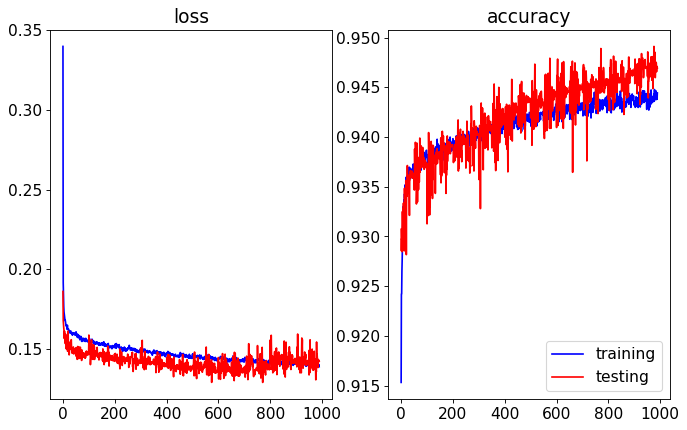

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.63it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


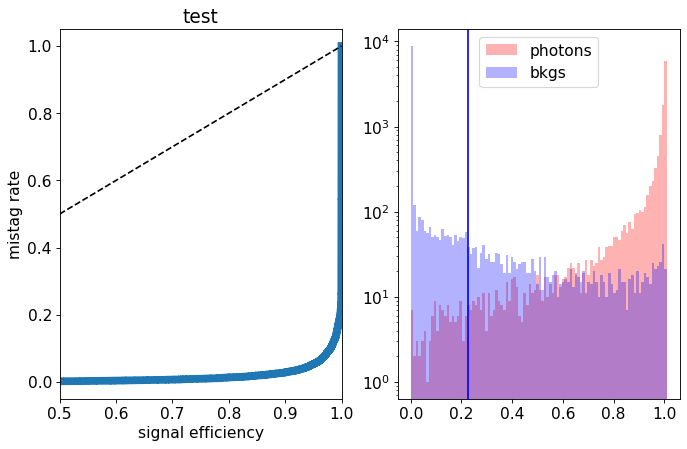

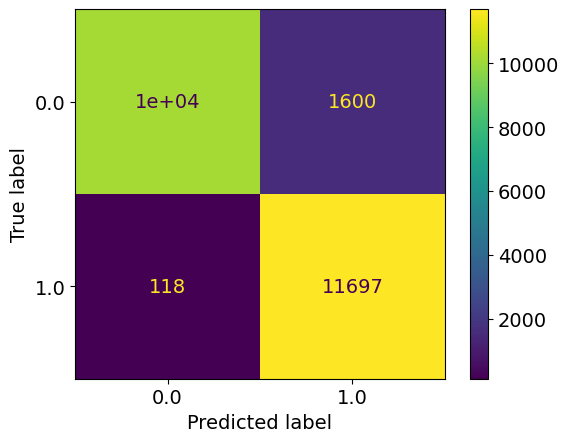

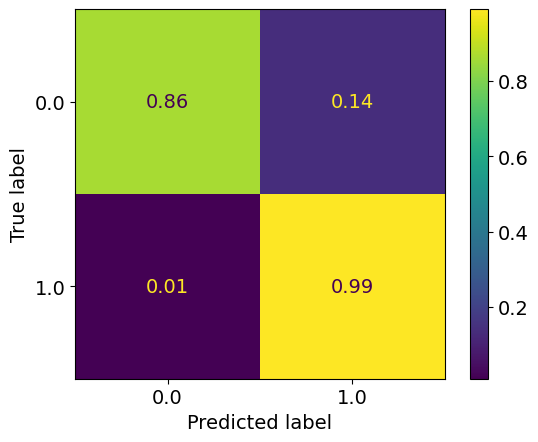

epoch: 990
Learning rate: 9.56091518800029e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.13941605944352545
train acc: 0.94465226


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.57it/s]


test loss: 0.14335289280861616
test acc: 0.9470441
epoch: 991
Learning rate: 7.794329076833768e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.13955662707993938
train acc: 0.9446841


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.01it/s]


test loss: 0.14680674877017735
test acc: 0.9475541
epoch: 992
Learning rate: 6.194309466864034e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.13810828698288863
train acc: 0.9447266


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.58it/s]


test loss: 0.14232045114040376
test acc: 0.9469591
epoch: 993
Learning rate: 4.76717090451227e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1400207406396319
train acc: 0.9443016


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.14288015943020582
test acc: 0.9468316
epoch: 994
Learning rate: 3.518545653686456e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.25it/s]


train loss: 0.1399199243184108
train acc: 0.9444716


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.21it/s]


test loss: 0.14447932001203298
test acc: 0.9467891
epoch: 995
Learning rate: 2.453361467808979e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.13951236659743985
train acc: 0.9442272


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.42it/s]


test loss: 0.1459150541573763
test acc: 0.9468316
epoch: 996
Learning rate: 1.5758221422251474e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.13885891053137506
train acc: 0.94504535


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.89it/s]


test loss: 0.14377628695219755
test acc: 0.94657654
epoch: 997
Learning rate: 8.893909237434605e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.14037695104718967
train acc: 0.94416344


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.63it/s]


test loss: 0.14430129509419204
test acc: 0.9469166
epoch: 998
Learning rate: 3.967768427826535e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1407518455651915
train acc: 0.9434728


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.55it/s]


test loss: 0.14591731671243907
test acc: 0.94653404
epoch: 999
Learning rate: 9.992402206632778e-08


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


train loss: 0.14014623551421865
train acc: 0.94369596


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.63it/s]


test loss: 0.14521686118096114
test acc: 0.94653404


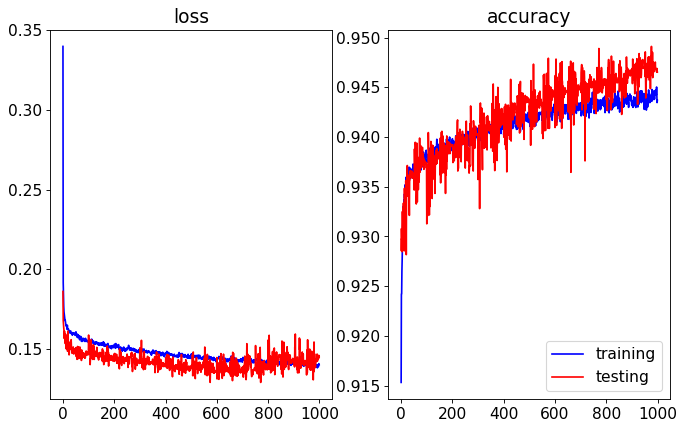

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.62it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


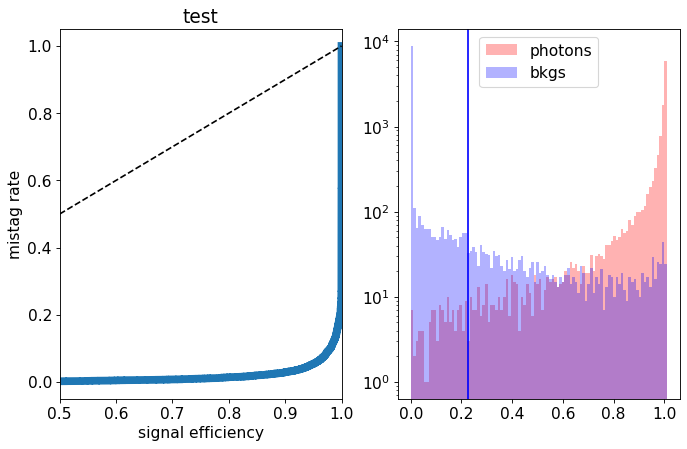

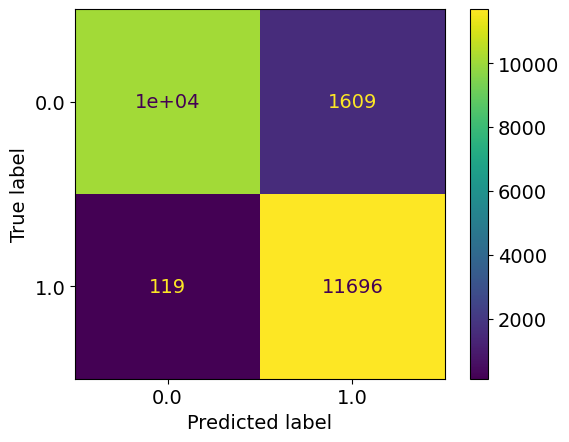

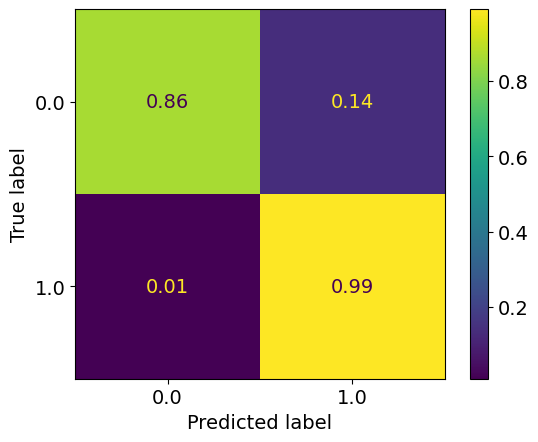

epoch: 1000
Learning rate: 4.004058690165735e-12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14146112095398508
train acc: 0.94387656


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.57it/s]


test loss: 0.1378459956496954
test acc: 0.9470866
epoch: 1001
Learning rate: 9.99025888725783e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


train loss: 0.14056277023569033
train acc: 0.94373846


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.55it/s]


test loss: 0.14013692699372768
test acc: 0.94585407
epoch: 1002
Learning rate: 9.960823902925945e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1410078783608546
train acc: 0.9433878


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.60it/s]


test loss: 0.13935726191848516
test acc: 0.9477241
epoch: 1003
Learning rate: 9.911810813034072e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.14081281461533468
train acc: 0.9438872


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.31it/s]


test loss: 0.13301968816667795
test acc: 0.9476391
epoch: 1004
Learning rate: 9.84341304985606e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.20it/s]


train loss: 0.14058404235513347
train acc: 0.9437172


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.62it/s]


test loss: 0.13597227931022643
test acc: 0.9475541
epoch: 1005
Learning rate: 9.755900548115212e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.141786396171257
train acc: 0.9434941


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.57it/s]


test loss: 0.15098141096532344
test acc: 0.9453865
epoch: 1006
Learning rate: 9.649618679675236e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.31it/s]


train loss: 0.14037311826921572
train acc: 0.9440997


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.42it/s]


test loss: 0.1288192171603441
test acc: 0.9491691
new best acc: 0.9491691
epoch: 1007
Learning rate: 9.524986890515297e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14006057277226905
train acc: 0.9441847


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.35it/s]


test loss: 0.1410564985126257
test acc: 0.9453865
epoch: 1008
Learning rate: 9.382497045368364e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.1402837301420558
train acc: 0.9443335


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.41it/s]


test loss: 0.15310973450541496
test acc: 0.9436015
epoch: 1009
Learning rate: 9.222711486555813e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.31it/s]


train loss: 0.1407805615739458
train acc: 0.94374907


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.42it/s]


test loss: 0.1392765475437045
test acc: 0.94479156


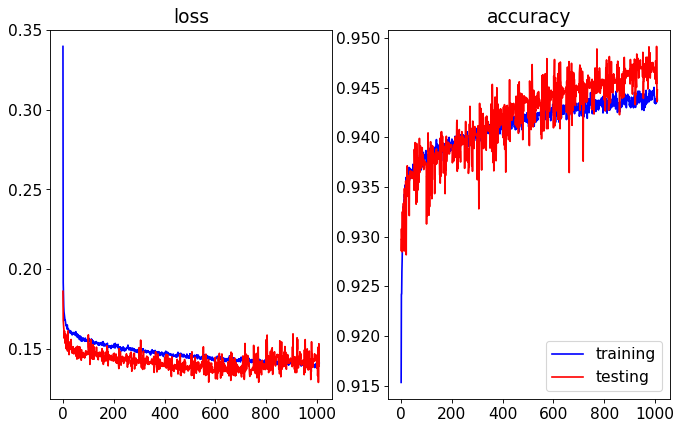

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.40it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


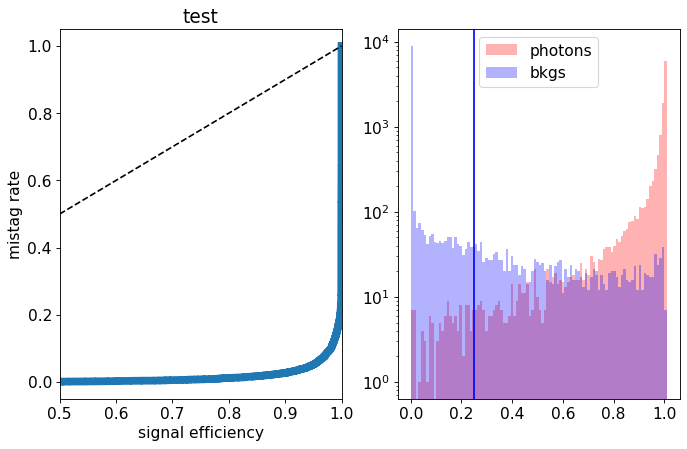

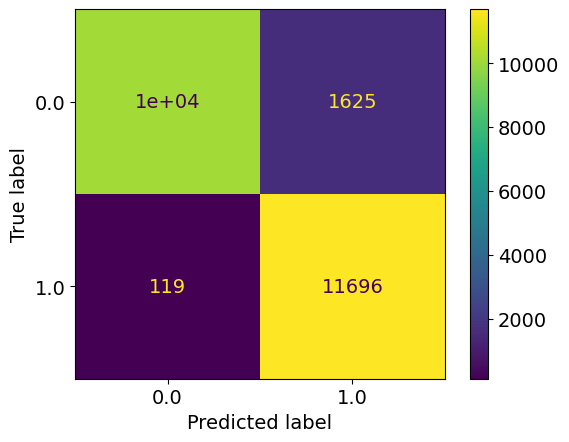

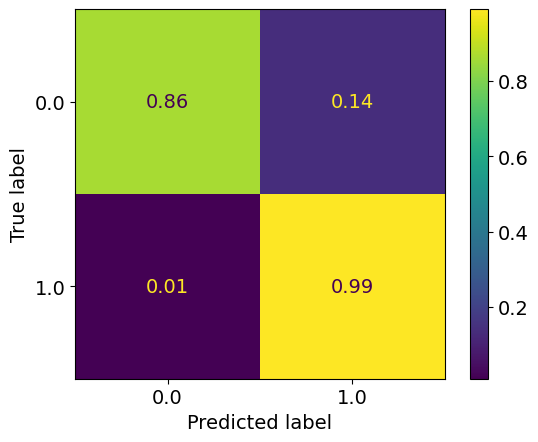

epoch: 1010
Learning rate: 9.046260814679199e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14106121559621423
train acc: 0.94378096


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.42it/s]


test loss: 0.13846037574112416
test acc: 0.9480641
epoch: 1011
Learning rate: 8.853841399927774e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.30it/s]


train loss: 0.1397247042056102
train acc: 0.9443441


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.39it/s]


test loss: 0.1438741110265255
test acc: 0.94615155
epoch: 1012
Learning rate: 8.646212633823493e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14037504782722254
train acc: 0.9436641


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.32it/s]


test loss: 0.1439168618991971
test acc: 0.9467891
epoch: 1013
Learning rate: 8.42419393224961e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.54it/s]


train loss: 0.14011855015329494
train acc: 0.9445247


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.64it/s]


test loss: 0.13804159071296454
test acc: 0.9483616
epoch: 1014
Learning rate: 8.188661501590543e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.25it/s]


train loss: 0.1400789062783217
train acc: 0.9437597


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.32it/s]


test loss: 0.14872455615550279
test acc: 0.944324
epoch: 1015
Learning rate: 7.940544880745565e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.60it/s]


train loss: 0.14052309641602692
train acc: 0.9436428


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.25it/s]


test loss: 0.13706161566078662
test acc: 0.9467891
epoch: 1016
Learning rate: 7.680823272663455e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.31it/s]


train loss: 0.1412125999096093
train acc: 0.9440147


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.38it/s]


test loss: 0.13166004549711943
test acc: 0.9493391
new best acc: 0.9493391
epoch: 1017
Learning rate: 7.410521679875796e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.13981345656571115
train acc: 0.9445035


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.34it/s]


test loss: 0.14510533697903155
test acc: 0.94602406
epoch: 1018
Learning rate: 7.130706859280269e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.1403709473029064
train acc: 0.94491786


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.82it/s]


test loss: 0.14586627185344697
test acc: 0.9468316
epoch: 1019
Learning rate: 6.842483112138533e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


train loss: 0.14085314066926385
train acc: 0.9434197


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.54it/s]


test loss: 0.14035288356244563
test acc: 0.9477241


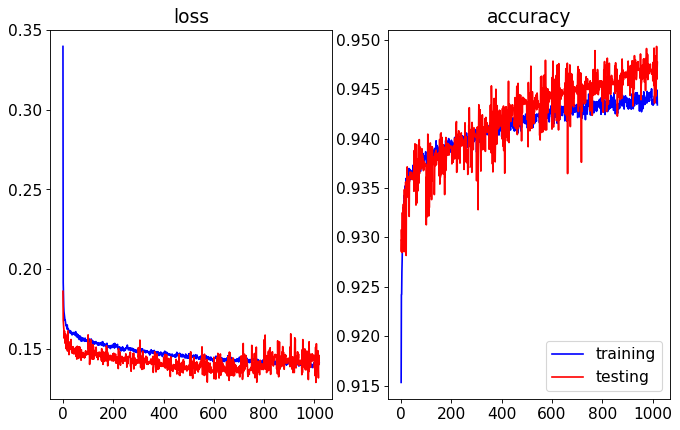

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.56it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


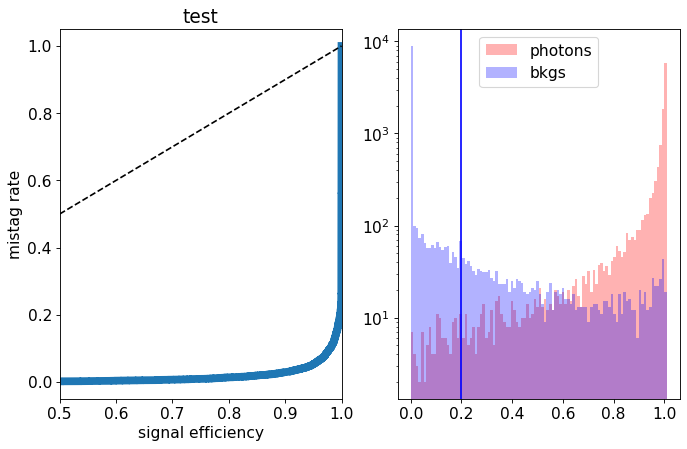

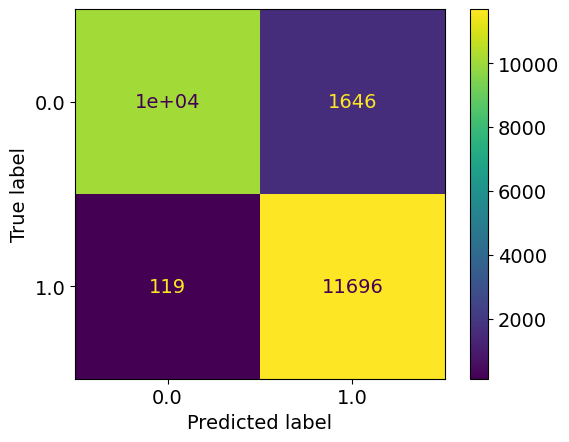

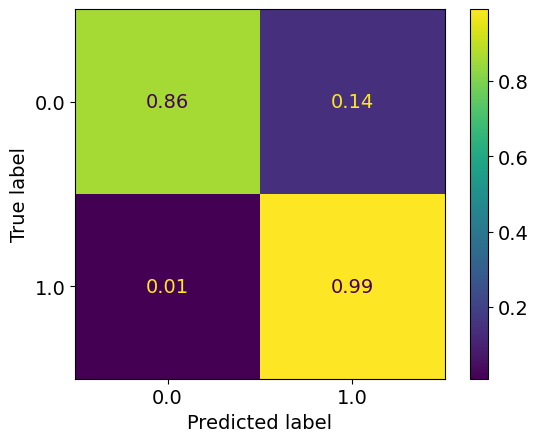

epoch: 1020
Learning rate: 6.546987925903652e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.13972307219626798
train acc: 0.9445035


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.10it/s]


test loss: 0.15048812683671714
test acc: 0.94534403
epoch: 1021
Learning rate: 6.245387485076784e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.30it/s]


train loss: 0.14104887074345995
train acc: 0.9436747


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.34it/s]


test loss: 0.13743158392608165
test acc: 0.9489991
epoch: 1022
Learning rate: 5.93887206880974e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14029554059361196
train acc: 0.9443016


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.19it/s]


test loss: 0.132386233843863
test acc: 0.9467466
epoch: 1023
Learning rate: 5.6286513534169517e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.1402689653217413
train acc: 0.9438447


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.34it/s]


test loss: 0.14508397430181502
test acc: 0.9468741
epoch: 1024
Learning rate: 5.315949638335711e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1399818359856393
train acc: 0.944376


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.62it/s]


test loss: 0.1485772080719471
test acc: 0.9443665
epoch: 1025
Learning rate: 5.0020010143756554e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14060738094293387
train acc: 0.94381285


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.59it/s]


test loss: 0.1507546415552497
test acc: 0.94593906
epoch: 1026
Learning rate: 4.6880444933259986e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.20it/s]


train loss: 0.1406552774036766
train acc: 0.94382346


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.40it/s]


test loss: 0.14697674587368964
test acc: 0.94619405
epoch: 1027
Learning rate: 4.3753191181422696e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.13949362781776745
train acc: 0.94477975


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.32it/s]


test loss: 0.14312437158077956
test acc: 0.9485741
epoch: 1028
Learning rate: 4.065059073009685e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14094800136651203
train acc: 0.9447585


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.40it/s]


test loss: 0.14673814550042152
test acc: 0.9446215
epoch: 1029
Learning rate: 3.7584888125820524e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.64it/s]


train loss: 0.14014697677580415
train acc: 0.9442697


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.44it/s]


test loss: 0.15075393505394458
test acc: 0.9467891


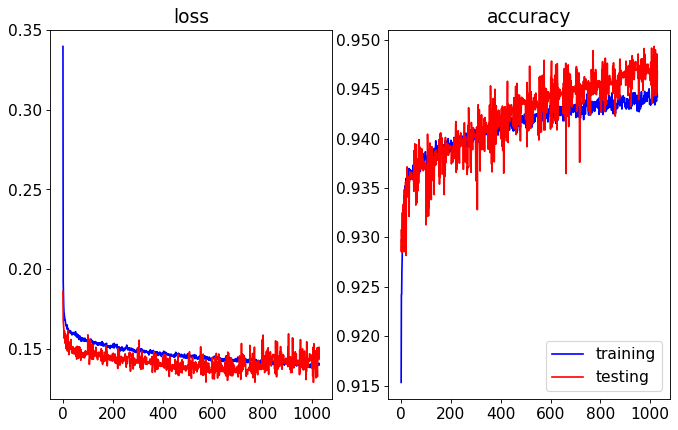

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.40it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


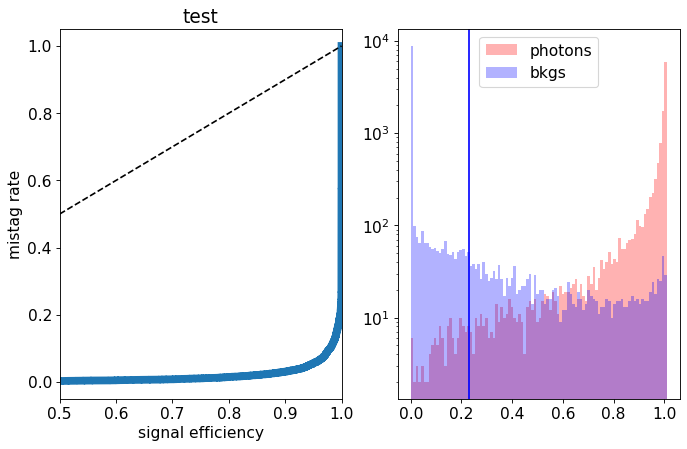

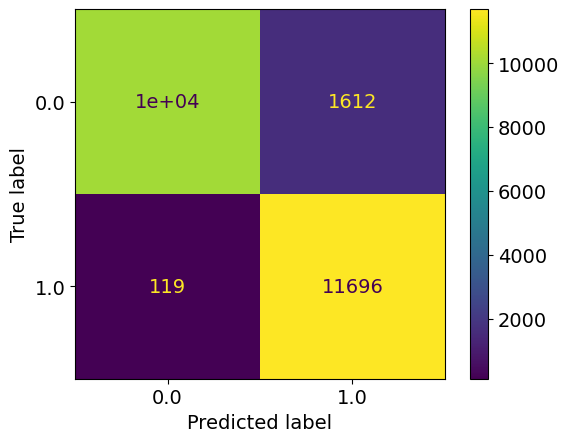

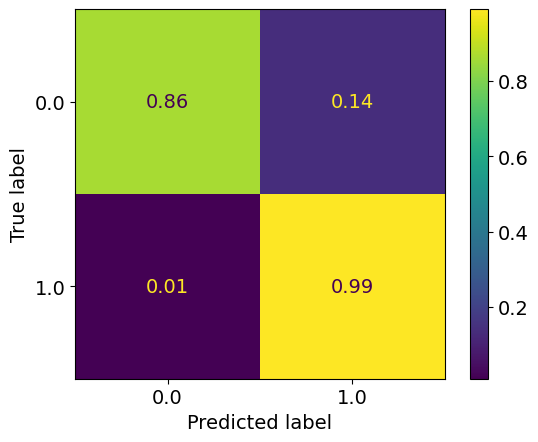

epoch: 1030
Learning rate: 3.456818229618647e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14193175818510118
train acc: 0.94403595


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.38it/s]


test loss: 0.1494060954079032
test acc: 0.94619405
epoch: 1031
Learning rate: 3.1612378800902485e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.24it/s]


train loss: 0.13965677916054514
train acc: 0.94383407


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.38it/s]


test loss: 0.1453526584431529
test acc: 0.94657654
epoch: 1032
Learning rate: 2.87291428459863e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.13958340133451352
train acc: 0.9442697


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.31it/s]


test loss: 0.14371065683662892
test acc: 0.94598156
epoch: 1033
Learning rate: 2.5929853246526715e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


train loss: 0.1405113947809122
train acc: 0.9438447


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.63it/s]


test loss: 0.15214381758123635
test acc: 0.94508904
epoch: 1034
Learning rate: 2.322555751969906e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.13826415469502187
train acc: 0.9444929


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.13743773363530637
test acc: 0.9487016
epoch: 1035
Learning rate: 2.062692828526193e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1389658842591723
train acc: 0.9444397


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.63it/s]


test loss: 0.14370691105723382
test acc: 0.9469591
epoch: 1036
Learning rate: 1.8144221145602852e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


train loss: 0.13985538814857507
train acc: 0.944546


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.58it/s]


test loss: 0.14602675158530473
test acc: 0.9468741
epoch: 1037
Learning rate: 1.5787234211561068e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.139936230032687
train acc: 0.9442591


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.62it/s]


test loss: 0.14666761979460716
test acc: 0.94649154
epoch: 1038
Learning rate: 1.3565269433760352e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


train loss: 0.14048813335644972
train acc: 0.9444822


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.58it/s]


test loss: 0.14738111458718778
test acc: 0.9467466
epoch: 1039
Learning rate: 1.1487095892059523e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14025214955115775
train acc: 0.944291


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.14970512222498655
test acc: 0.9471291


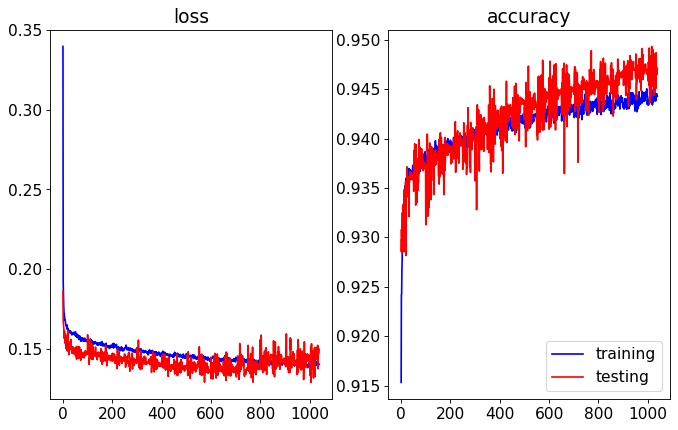

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.63it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


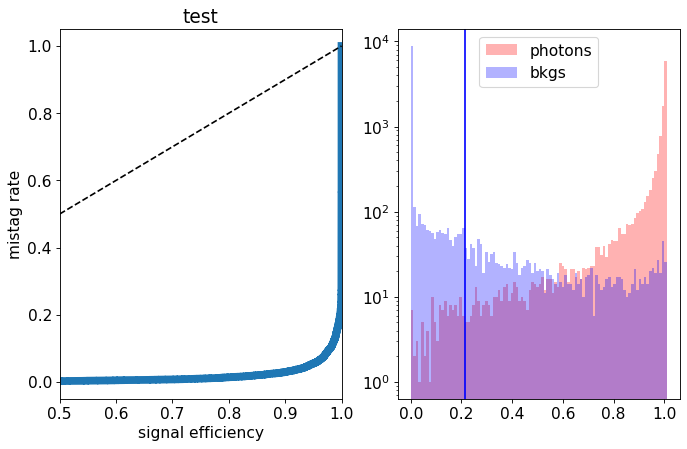

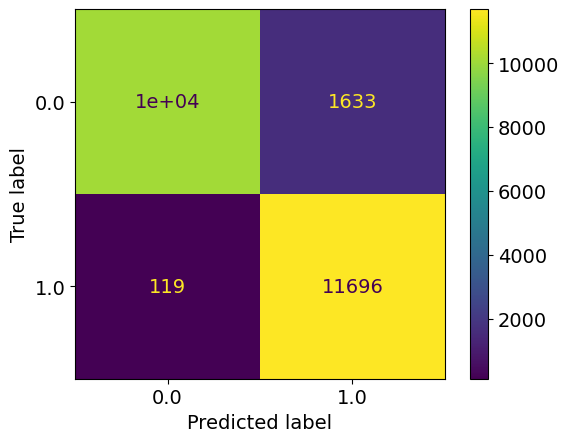

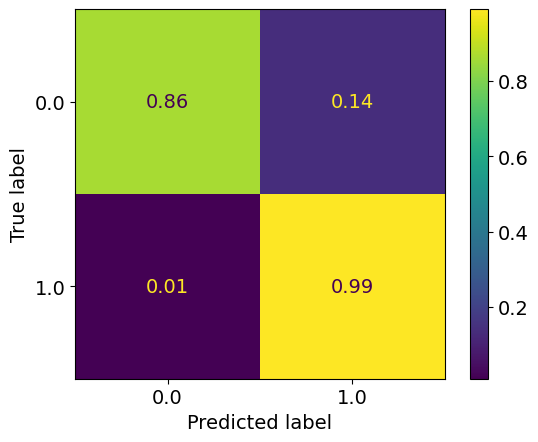

epoch: 1040
Learning rate: 9.560915188000497e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.138660478031939
train acc: 0.94486475


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.94it/s]


test loss: 0.14927261266857386
test acc: 0.94606656
epoch: 1041
Learning rate: 7.794329076833946e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14021759954797233
train acc: 0.9443547


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.40it/s]


test loss: 0.1466121995821595
test acc: 0.94657654
epoch: 1042
Learning rate: 6.194309466864218e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.13972501513684632
train acc: 0.9447691


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.63it/s]


test loss: 0.1472935289144516
test acc: 0.9467466
epoch: 1043
Learning rate: 4.7671709045124306e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.23it/s]


train loss: 0.13883125207796218
train acc: 0.9445885


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.39it/s]


test loss: 0.14696469977498056
test acc: 0.9466191
epoch: 1044
Learning rate: 3.5185456536865835e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.59it/s]


train loss: 0.1389510509599546
train acc: 0.94490725


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.35it/s]


test loss: 0.1451329005882144
test acc: 0.9470866
epoch: 1045
Learning rate: 2.4533614678090954e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.61it/s]


train loss: 0.1394181074989829
train acc: 0.94487536


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.34it/s]


test loss: 0.1449962195008993
test acc: 0.9467891
epoch: 1046
Learning rate: 1.5758221422252306e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.57it/s]


train loss: 0.13888160599644778
train acc: 0.9442591


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.57it/s]


test loss: 0.145952663756907
test acc: 0.9466616
epoch: 1047
Learning rate: 8.893909237435216e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1392214783722428
train acc: 0.9445354


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.63it/s]


test loss: 0.14777287989854812
test acc: 0.9466191
epoch: 1048
Learning rate: 3.967768427826979e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.20it/s]


train loss: 0.1386951542678912
train acc: 0.94473726


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.08it/s]


test loss: 0.14580671284347774
test acc: 0.9466616
epoch: 1049
Learning rate: 9.992402206634999e-08


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.56it/s]


train loss: 0.1391157531624387
train acc: 0.9448116


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.49it/s]


test loss: 0.14801878165453672
test acc: 0.9467041


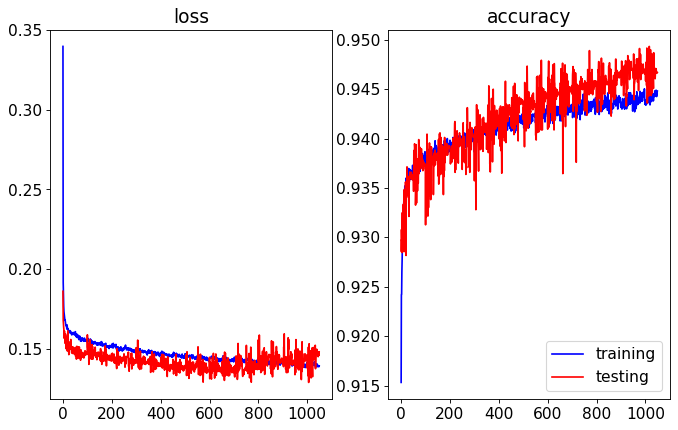

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.59it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


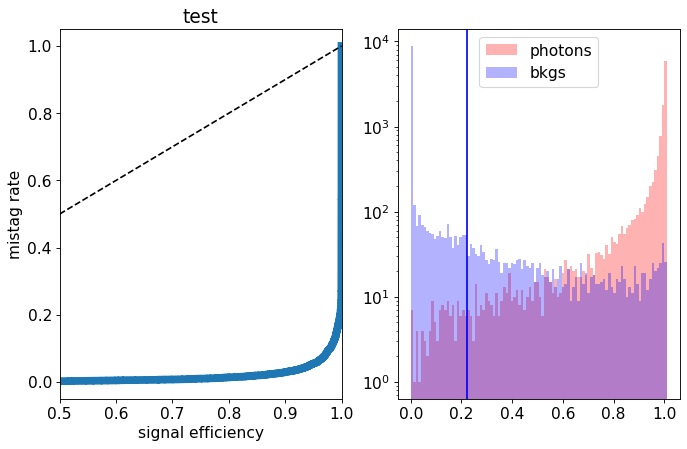

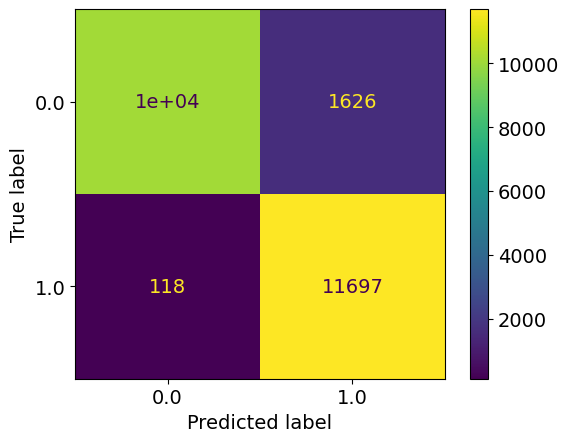

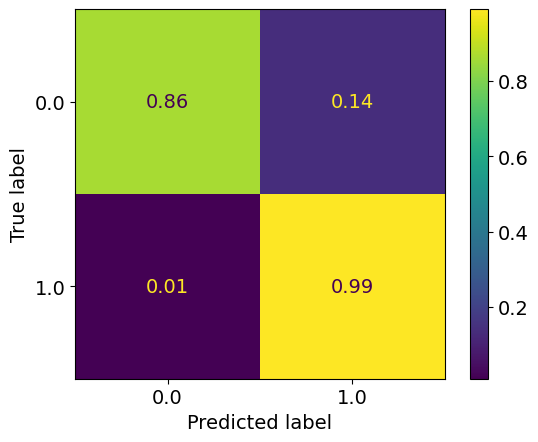

epoch: 1050
Learning rate: 4.004058690165735e-12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.20it/s]


train loss: 0.1412321652766246
train acc: 0.94307965


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.57it/s]


test loss: 0.15006136428564787
test acc: 0.943559
epoch: 1051
Learning rate: 9.990258887257832e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1403440452020639
train acc: 0.94420594


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.58it/s]


test loss: 0.15898984149098397
test acc: 0.94581157
epoch: 1052
Learning rate: 9.960823902925949e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14173578072315568
train acc: 0.94404656


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.60it/s]


test loss: 0.1459960989654064
test acc: 0.9467466
epoch: 1053
Learning rate: 9.911810813034079e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.19it/s]


train loss: 0.1419787234181811
train acc: 0.9433878


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.62it/s]


test loss: 0.14998536463826895
test acc: 0.94627905
epoch: 1054
Learning rate: 9.84341304985607e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1409631026968075
train acc: 0.94395095


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.47it/s]


test loss: 0.13429041672497988
test acc: 0.9484041
epoch: 1055
Learning rate: 9.755900548115223e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


train loss: 0.14002332466233308
train acc: 0.94483286


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.59it/s]


test loss: 0.14990968592464923
test acc: 0.94640654
epoch: 1056
Learning rate: 9.649618679675248e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.13886950848398694
train acc: 0.9448116


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.63it/s]


test loss: 0.13937782011926175
test acc: 0.9485316
epoch: 1057
Learning rate: 9.524986890515313e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.13956073956314924
train acc: 0.9435897


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.52it/s]


test loss: 0.14114707428961992
test acc: 0.9480641
epoch: 1058
Learning rate: 9.382497045368382e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.19it/s]


train loss: 0.1409966379973539
train acc: 0.94385535


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.22it/s]


test loss: 0.1310845049098134
test acc: 0.9475966
epoch: 1059
Learning rate: 9.222711486555833e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.1411217995415068
train acc: 0.94389784


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.39it/s]


test loss: 0.1305383536964655
test acc: 0.94950914
new best acc: 0.94950914


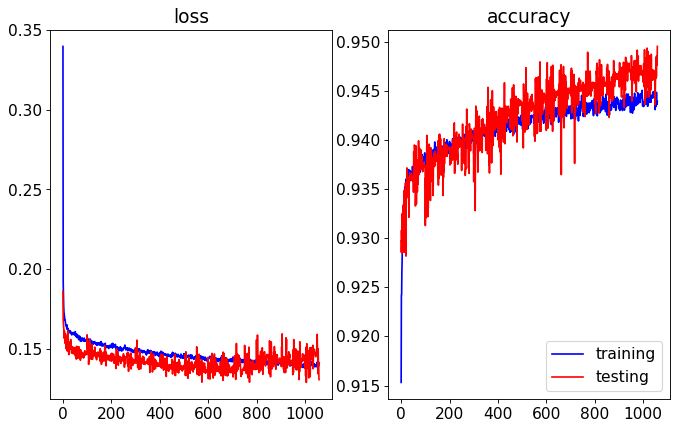

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.31it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


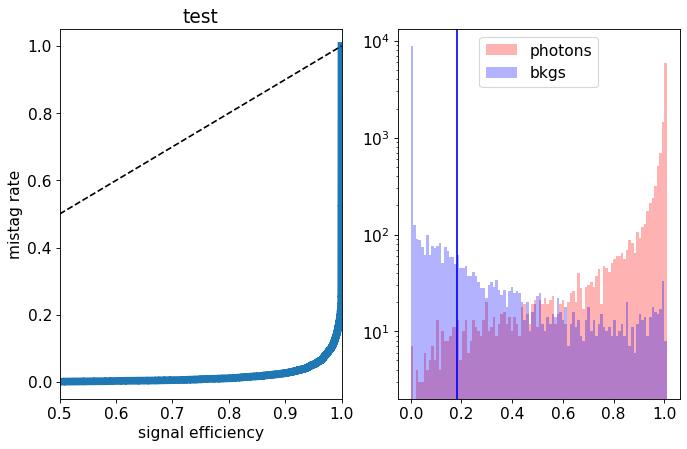

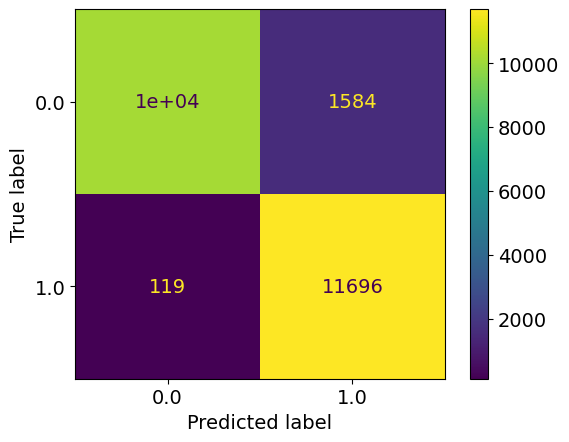

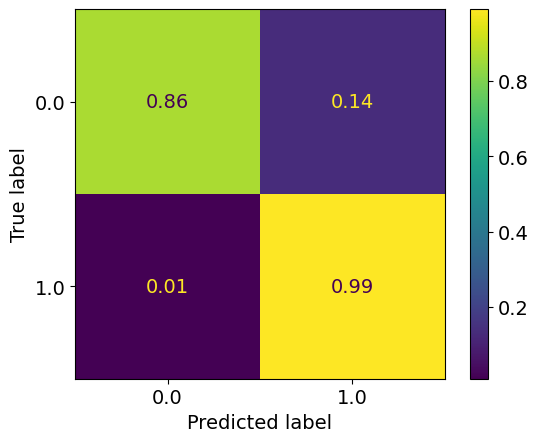

epoch: 1060
Learning rate: 9.046260814679219e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.30it/s]


train loss: 0.14054745492661835
train acc: 0.94379157


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.42it/s]


test loss: 0.14353562463074923
test acc: 0.9470441
epoch: 1061
Learning rate: 8.853841399927796e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14025695009785852
train acc: 0.9434834


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.1476737828925252
test acc: 0.94398403
epoch: 1062
Learning rate: 8.646212633823516e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.61it/s]


train loss: 0.14099980017561822
train acc: 0.9441422


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.36it/s]


test loss: 0.1452870262786746
test acc: 0.9486166
epoch: 1063
Learning rate: 8.424193932249635e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.31it/s]


train loss: 0.14055235740865113
train acc: 0.9442378


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.40it/s]


test loss: 0.1374870190396905
test acc: 0.9490416
epoch: 1064
Learning rate: 8.188661501590568e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14056186392238945
train acc: 0.9436428


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.32it/s]


test loss: 0.14101268909871578
test acc: 0.9478091
epoch: 1065
Learning rate: 7.940544880745594e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.29it/s]


train loss: 0.1402734371412332
train acc: 0.9441847


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.39it/s]


test loss: 0.15292479619383811
test acc: 0.941944
epoch: 1066
Learning rate: 7.680823272663487e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.1410480028220043
train acc: 0.9434834


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.33it/s]


test loss: 0.14665499962866307
test acc: 0.9469591
epoch: 1067
Learning rate: 7.410521679875828e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.13994228422262106
train acc: 0.9444503


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.36it/s]


test loss: 0.14928094409406184
test acc: 0.94742656
epoch: 1068
Learning rate: 7.130706859280303e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.31it/s]


train loss: 0.14017928690667364
train acc: 0.9442378


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.40it/s]


test loss: 0.146183058898896
test acc: 0.9470016
epoch: 1069
Learning rate: 6.842483112138567e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14012765552207923
train acc: 0.9446735


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.38it/s]


test loss: 0.14707113523036242
test acc: 0.94653404


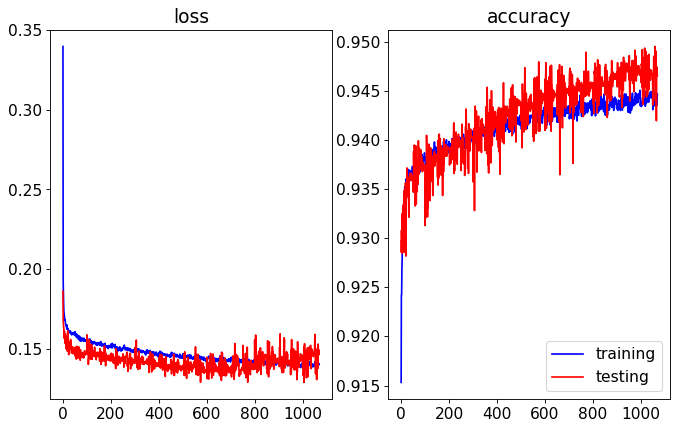

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.33it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


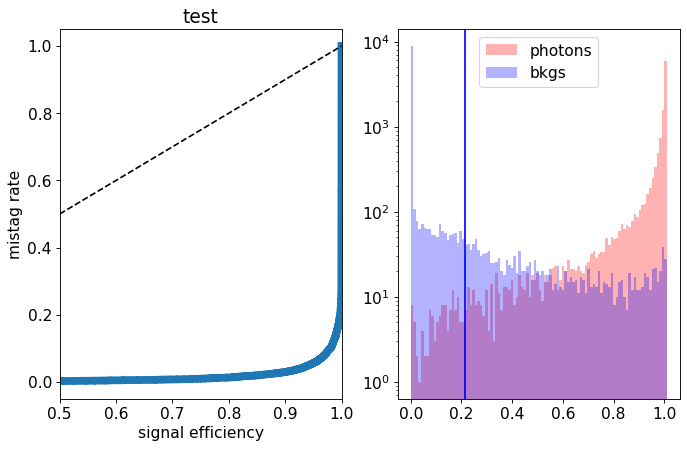

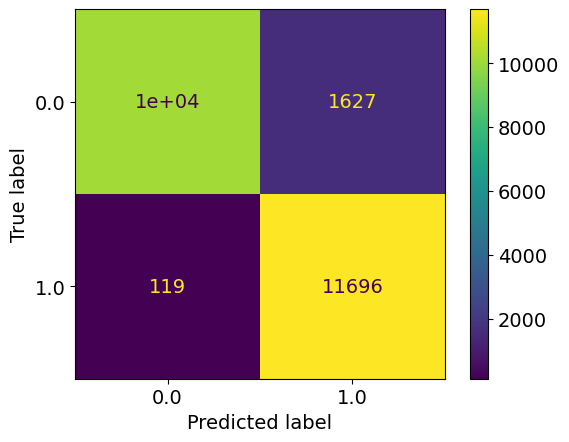

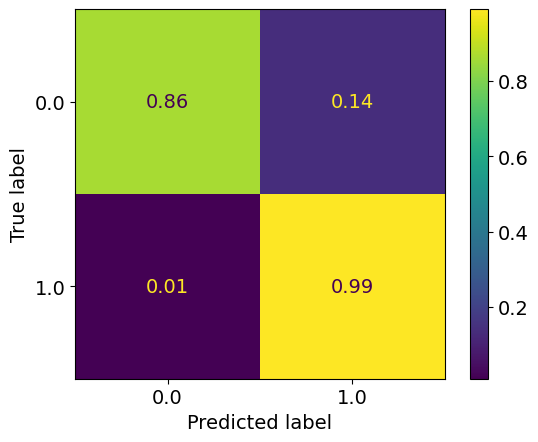

epoch: 1070
Learning rate: 6.546987925903684e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.32it/s]


train loss: 0.13903591895748854
train acc: 0.9442378


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.36it/s]


test loss: 0.1422200370579958
test acc: 0.9484466
epoch: 1071
Learning rate: 6.245387485076818e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.13996220005166
train acc: 0.94392973


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.41it/s]


test loss: 0.14124193731695414
test acc: 0.9483616
epoch: 1072
Learning rate: 5.9388720688097756e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.27it/s]


train loss: 0.13932363712673734
train acc: 0.94390845


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.20it/s]


test loss: 0.13690704256296157
test acc: 0.9490841
epoch: 1073
Learning rate: 5.628651353416987e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.13962422078771955
train acc: 0.944376


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.36it/s]


test loss: 0.1438429716974497
test acc: 0.9482341
epoch: 1074
Learning rate: 5.3159496383357456e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.13894639605549491
train acc: 0.94411033


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.34it/s]


test loss: 0.14255191199481487
test acc: 0.9486166
epoch: 1075
Learning rate: 5.0020010143756554e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.31it/s]


train loss: 0.14033163970063448
train acc: 0.9444185


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.40it/s]


test loss: 0.15000149216502906
test acc: 0.94738406
epoch: 1076
Learning rate: 4.6880444933259986e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.14042706047273745
train acc: 0.94407845


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.84it/s]


test loss: 0.14091835543513298
test acc: 0.9477666
epoch: 1077
Learning rate: 4.3753191181422696e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.13843030496767372
train acc: 0.94503474


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.97it/s]


test loss: 0.1449412390589714
test acc: 0.94717157
epoch: 1078
Learning rate: 4.065059073009685e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1390768221704064
train acc: 0.9434303


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.60it/s]


test loss: 0.15535184200853108
test acc: 0.94610906
epoch: 1079
Learning rate: 3.7584888125820524e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1400669253176185
train acc: 0.94412094


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.57it/s]


test loss: 0.14302020370960236
test acc: 0.94717157


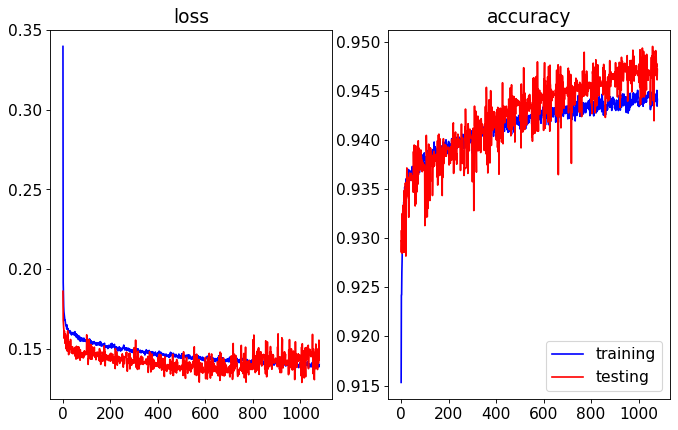

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.62it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


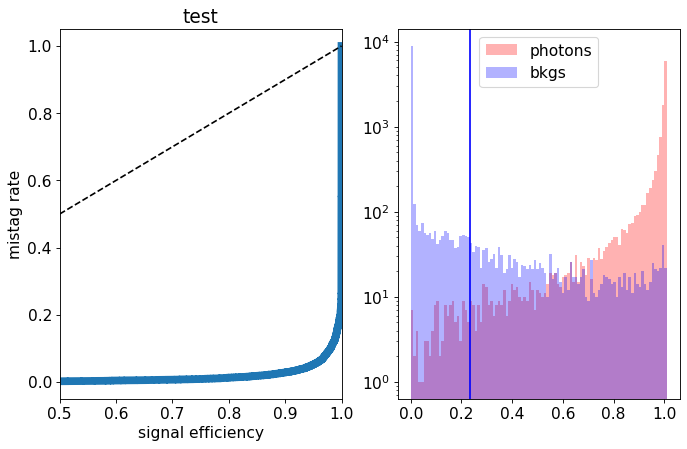

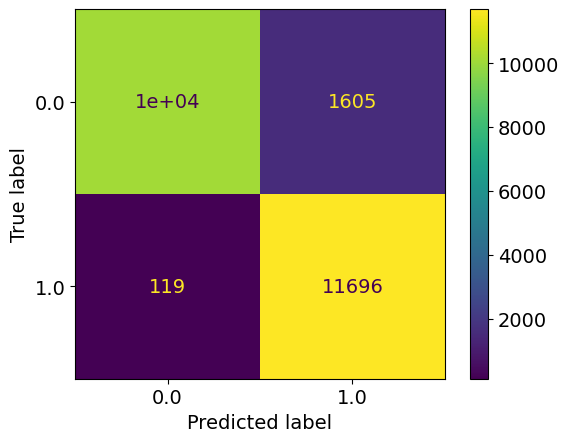

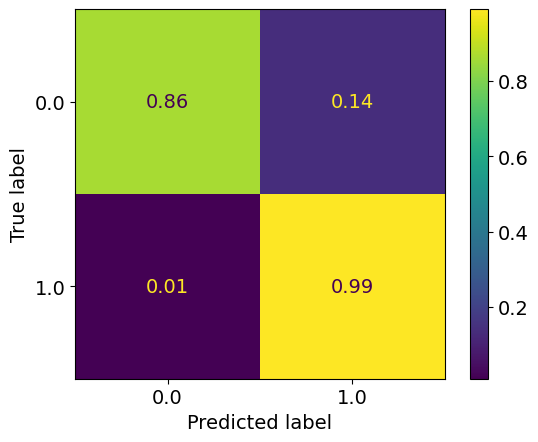

epoch: 1080
Learning rate: 3.456818229618647e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.19it/s]


train loss: 0.13952742426828213
train acc: 0.9448116


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.55it/s]


test loss: 0.14541440401226283
test acc: 0.9477666
epoch: 1081
Learning rate: 3.1612378800902485e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14043275456709467
train acc: 0.9443547


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.63it/s]


test loss: 0.14660507831722497
test acc: 0.9481066
epoch: 1082
Learning rate: 2.87291428459863e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


train loss: 0.14053277168304298
train acc: 0.9445035


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.59it/s]


test loss: 0.1474874483421445
test acc: 0.9481066
epoch: 1083
Learning rate: 2.5929853246526715e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1397193584852158
train acc: 0.94378096


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.63it/s]


test loss: 0.13871727511286736
test acc: 0.9489566
epoch: 1084
Learning rate: 2.322555751969906e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.13874636296254056
train acc: 0.94500285


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.40it/s]


test loss: 0.14531745556741954
test acc: 0.9484041
epoch: 1085
Learning rate: 2.062692828526193e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.30it/s]


train loss: 0.13851497175207564
train acc: 0.94595915


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.37it/s]


test loss: 0.14655486810952426
test acc: 0.9469591
epoch: 1086
Learning rate: 1.8144221145602852e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.57it/s]


train loss: 0.13905564951858704
train acc: 0.9443972


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.14307191111147405
test acc: 0.94848907
epoch: 1087
Learning rate: 1.5787234211561068e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.20it/s]


train loss: 0.13995432464560126
train acc: 0.94498163


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.56it/s]


test loss: 0.14529565237462522
test acc: 0.9483191
epoch: 1088
Learning rate: 1.3565269433760352e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.13915219902992249
train acc: 0.9444822


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.28it/s]


test loss: 0.14076270312070846
test acc: 0.9484466
epoch: 1089
Learning rate: 1.1487095892059523e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.13929334301857432
train acc: 0.944461


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.35it/s]


test loss: 0.14244029745459558
test acc: 0.9478941


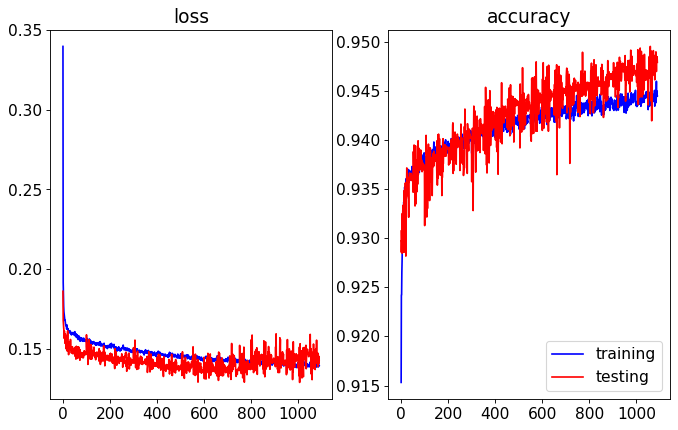

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.25it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


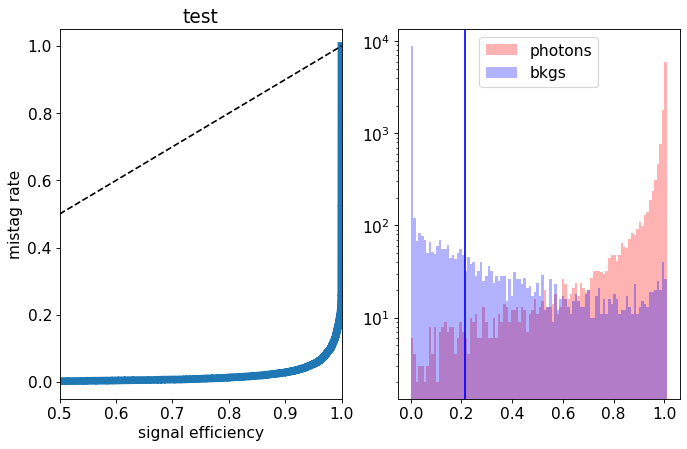

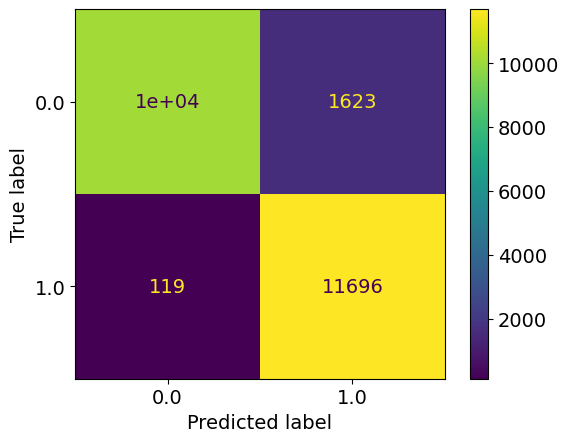

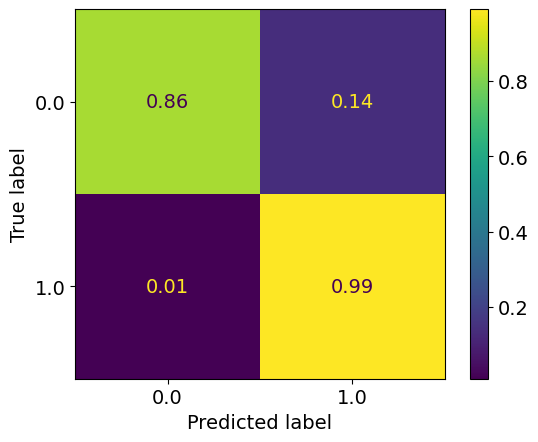

epoch: 1090
Learning rate: 9.560915188000497e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.13811520899936652
train acc: 0.94494975


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.41it/s]


test loss: 0.1480884650722146
test acc: 0.9476391
epoch: 1091
Learning rate: 7.794329076833946e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.1387666722961292
train acc: 0.9444078


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.24it/s]


test loss: 0.14601436369121074
test acc: 0.9481066
epoch: 1092
Learning rate: 6.194309466864218e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.31it/s]


train loss: 0.13940777995024517
train acc: 0.94517285


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.38it/s]


test loss: 0.14654599111527206
test acc: 0.9475966
epoch: 1093
Learning rate: 4.7671709045124306e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.58it/s]


train loss: 0.1395591664466129
train acc: 0.9440572


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.42it/s]


test loss: 0.14380616806447505
test acc: 0.9479366
epoch: 1094
Learning rate: 3.5185456536865835e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.56it/s]


train loss: 0.1401326520143041
train acc: 0.9436322


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.35it/s]


test loss: 0.1438200669363141
test acc: 0.9477666
epoch: 1095
Learning rate: 2.4533614678090954e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.1398090656585754
train acc: 0.9446735


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.21it/s]


test loss: 0.14721234012395143
test acc: 0.9477241
epoch: 1096
Learning rate: 1.5758221422252306e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.55it/s]


train loss: 0.13758457950346029
train acc: 0.9453854


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.34it/s]


test loss: 0.14536579940468072
test acc: 0.9478516
epoch: 1097
Learning rate: 8.893909237435216e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.24it/s]


train loss: 0.13949756504623753
train acc: 0.94489664


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.33it/s]


test loss: 0.14301101835444568
test acc: 0.9477241
epoch: 1098
Learning rate: 3.967768427826979e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.56it/s]


train loss: 0.13905253840290058
train acc: 0.94488597


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.37it/s]


test loss: 0.14363055862486362
test acc: 0.9477666
epoch: 1099
Learning rate: 9.992402206634999e-08


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.56it/s]


train loss: 0.1383019756454571
train acc: 0.9455129


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.17it/s]


test loss: 0.1437875721603632
test acc: 0.9477666


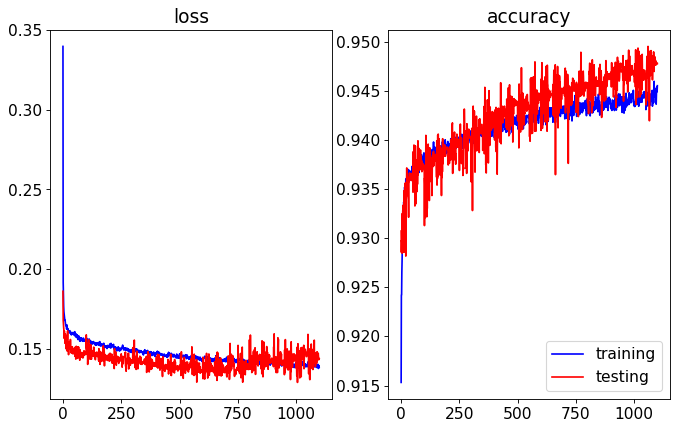

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.37it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


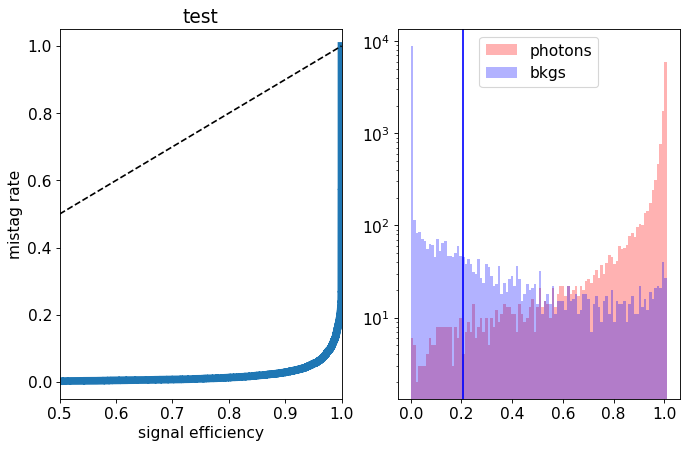

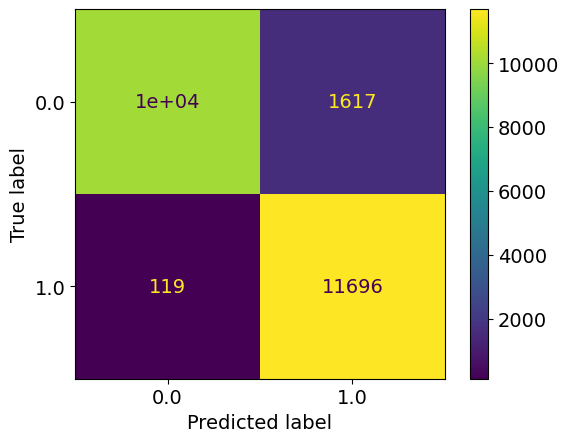

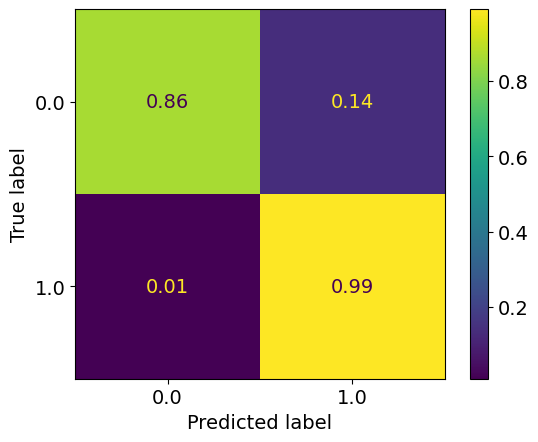

epoch: 1100
Learning rate: 4.004058690165735e-12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.59it/s]


train loss: 0.14096490431363415
train acc: 0.9445141


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.41it/s]


test loss: 0.14337034784257413
test acc: 0.9467041
epoch: 1101
Learning rate: 9.990258887257832e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.56it/s]


train loss: 0.14036958370428937
train acc: 0.9438872


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.33it/s]


test loss: 0.16313762608915566
test acc: 0.94581157
epoch: 1102
Learning rate: 9.960823902925949e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.26it/s]


train loss: 0.14008928223210534
train acc: 0.94411033


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.37it/s]


test loss: 0.15068807266652584
test acc: 0.94717157
epoch: 1103
Learning rate: 9.911810813034079e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.56it/s]


train loss: 0.14039111967868867
train acc: 0.94390845


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.31it/s]


test loss: 0.14966829363256692
test acc: 0.94746906
epoch: 1104
Learning rate: 9.84341304985607e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.23it/s]


train loss: 0.13992210657923085
train acc: 0.9434834


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.19it/s]


test loss: 0.14809364918619394
test acc: 0.94632155
epoch: 1105
Learning rate: 9.755900548115223e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.55it/s]


train loss: 0.14006565103105678
train acc: 0.94420594


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.31it/s]


test loss: 0.13971430268138646
test acc: 0.9478941
epoch: 1106
Learning rate: 9.649618679675248e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.55it/s]


train loss: 0.1402591716996424
train acc: 0.9446416


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.35it/s]


test loss: 0.1373020565137267
test acc: 0.9484466
epoch: 1107
Learning rate: 9.524986890515313e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.25it/s]


train loss: 0.1400175343748111
train acc: 0.94403595


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.34it/s]


test loss: 0.1607026344165206
test acc: 0.9435165
epoch: 1108
Learning rate: 9.382497045368382e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.57it/s]


train loss: 0.13935177488501665
train acc: 0.9443972


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.40it/s]


test loss: 0.14040780551731585
test acc: 0.9480216
epoch: 1109
Learning rate: 9.222711486555833e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.25it/s]


train loss: 0.14015043773658717
train acc: 0.9435153


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.38it/s]


test loss: 0.14503109827637672
test acc: 0.9470016


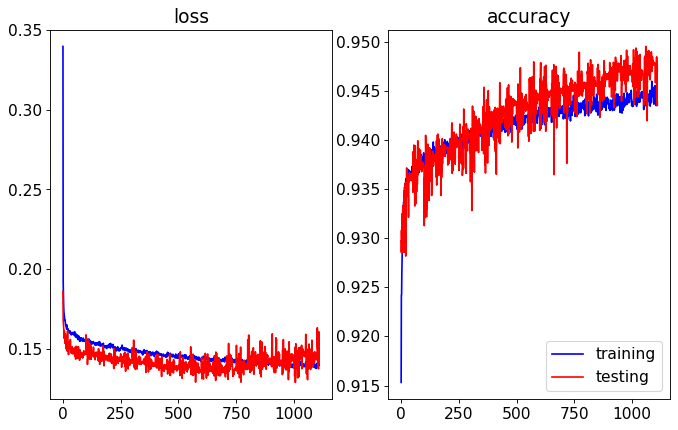

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.41it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


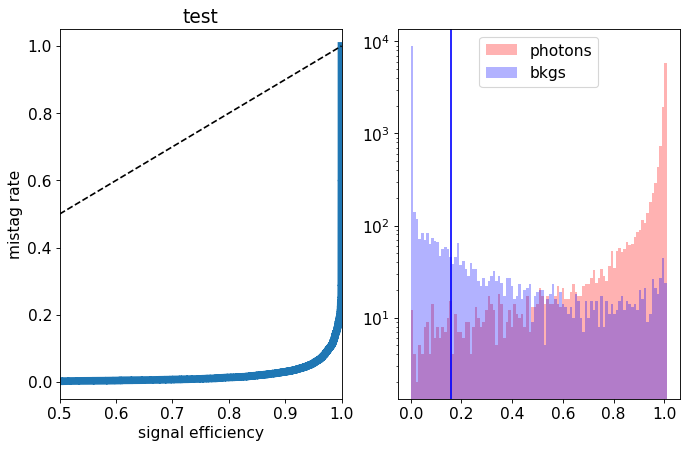

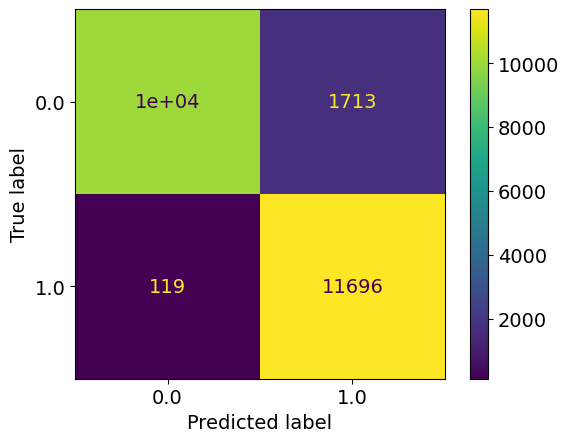

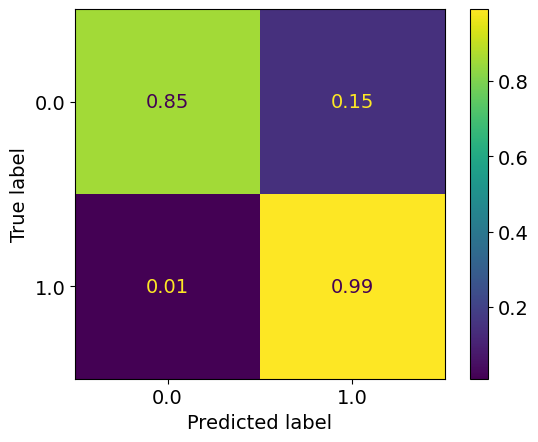

epoch: 1110
Learning rate: 9.046260814679219e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.56it/s]


train loss: 0.13929627394410454
train acc: 0.9441847


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.42it/s]


test loss: 0.1438128851354122
test acc: 0.9468316
epoch: 1111
Learning rate: 8.853841399927796e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.59it/s]


train loss: 0.1403480198732607
train acc: 0.94408906


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.41it/s]


test loss: 0.1470272546634078
test acc: 0.9479366
epoch: 1112
Learning rate: 8.646212633823516e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.56it/s]


train loss: 0.14006255315557406
train acc: 0.94373846


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.38it/s]


test loss: 0.14652613680809737
test acc: 0.9469166
epoch: 1113
Learning rate: 8.424193932249635e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.56it/s]


train loss: 0.13994349615209423
train acc: 0.9443122


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.41it/s]


test loss: 0.159898879006505
test acc: 0.94589657
epoch: 1114
Learning rate: 8.188661501590568e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.24it/s]


train loss: 0.13873286170374816
train acc: 0.94496036


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.39it/s]


test loss: 0.15489852651953698
test acc: 0.9475966
epoch: 1115
Learning rate: 7.940544880745594e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.13853672844399312
train acc: 0.9451941


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.64it/s]


test loss: 0.13518242575228215
test acc: 0.94976413
new best acc: 0.94976413
epoch: 1116
Learning rate: 7.680823272663487e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.13934628869507723
train acc: 0.94494975


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.58it/s]


test loss: 0.1446838727220893
test acc: 0.94742656
epoch: 1117
Learning rate: 7.410521679875828e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


train loss: 0.13915853074211984
train acc: 0.9450985


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.62it/s]


test loss: 0.13961472380906342
test acc: 0.9488716
epoch: 1118
Learning rate: 7.130706859280303e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.14037532435291133
train acc: 0.9443866


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.56it/s]


test loss: 0.14649324361234903
test acc: 0.9470016
epoch: 1119
Learning rate: 6.842483112138567e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.20it/s]


train loss: 0.13928216254445397
train acc: 0.9442803


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.64it/s]


test loss: 0.15355533342808486
test acc: 0.94602406


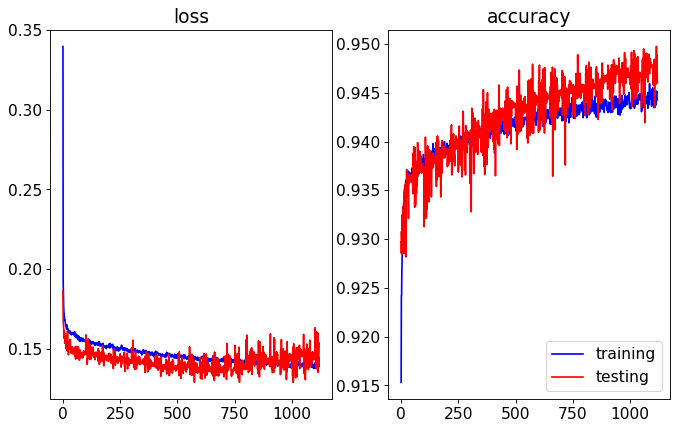

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


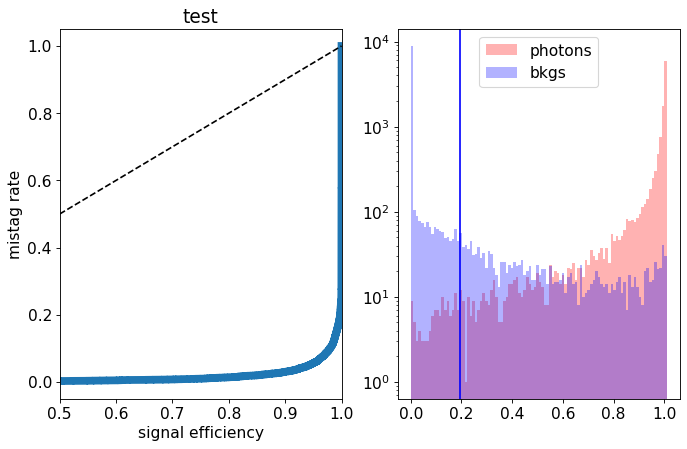

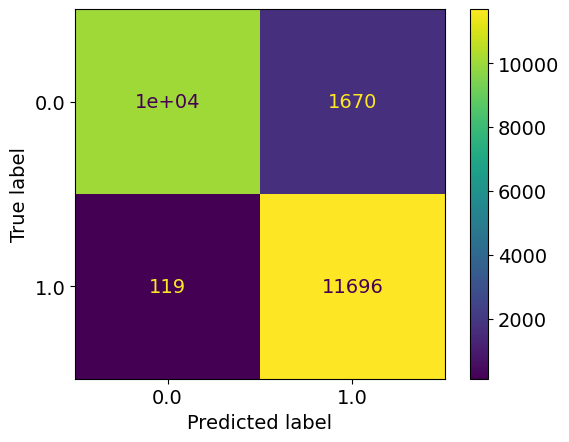

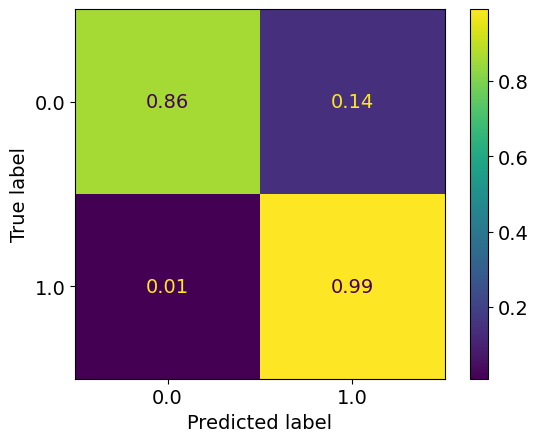

epoch: 1120
Learning rate: 6.546987925903684e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.13979476490977463
train acc: 0.944461


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.64it/s]


test loss: 0.1394339395686984
test acc: 0.9492116
epoch: 1121
Learning rate: 6.245387485076818e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.22it/s]


train loss: 0.13992219460997612
train acc: 0.9442378


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.55it/s]


test loss: 0.14298839811235667
test acc: 0.9481916
epoch: 1122
Learning rate: 5.9388720688097756e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.13987199976375908
train acc: 0.94379157


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.39it/s]


test loss: 0.14696296136826276
test acc: 0.9475966
epoch: 1123
Learning rate: 5.628651353416987e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.13866842267619575
train acc: 0.9443547


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.33it/s]


test loss: 0.15431039836257696
test acc: 0.94657654
epoch: 1124
Learning rate: 5.3159496383357456e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.32it/s]


train loss: 0.13972082658178486
train acc: 0.9443228


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.42it/s]


test loss: 0.13576903026551007
test acc: 0.9498491
new best acc: 0.9498491
epoch: 1125
Learning rate: 5.0020010143756554e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.64it/s]


train loss: 0.1390180115107518
train acc: 0.94516224


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.39it/s]


test loss: 0.147311002202332
test acc: 0.9480216
epoch: 1126
Learning rate: 4.6880444933259986e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.31it/s]


train loss: 0.1389637149063645
train acc: 0.9446416


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.21it/s]


test loss: 0.14364652335643768
test acc: 0.9482341
epoch: 1127
Learning rate: 4.3753191181422696e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.13896457324172282
train acc: 0.9440572


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.37it/s]


test loss: 0.13899825774133207
test acc: 0.9484041
epoch: 1128
Learning rate: 4.065059073009685e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.1394084664951464
train acc: 0.94517285


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.32it/s]


test loss: 0.15553578343242408
test acc: 0.94742656
epoch: 1129
Learning rate: 3.7584888125820524e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.25it/s]


train loss: 0.1400382162374296
train acc: 0.94473726


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.64it/s]


test loss: 0.1418144280090928
test acc: 0.9486166


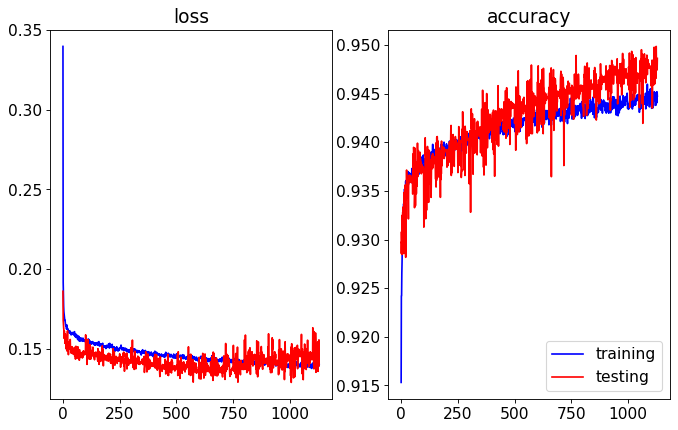

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


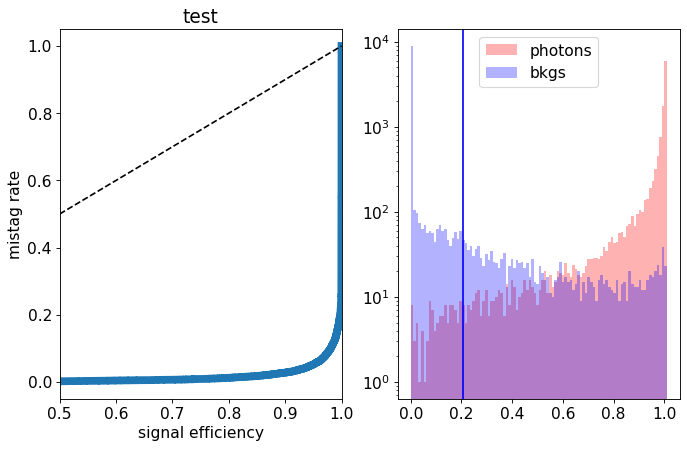

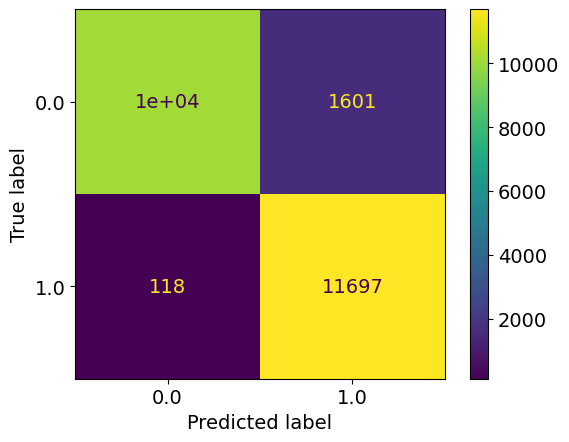

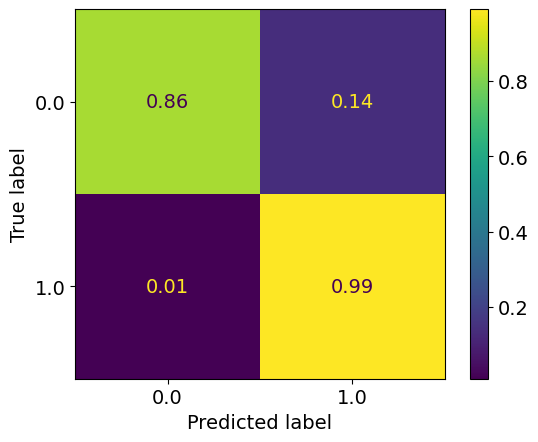

epoch: 1130
Learning rate: 3.456818229618647e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.1388666803479954
train acc: 0.94494975


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.56it/s]


test loss: 0.14868476539850234
test acc: 0.9482341
epoch: 1131
Learning rate: 3.1612378800902485e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.20it/s]


train loss: 0.13838275256240443
train acc: 0.94507724


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.59it/s]


test loss: 0.14475890509784223
test acc: 0.9479366
epoch: 1132
Learning rate: 2.87291428459863e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.13914538151139666
train acc: 0.9443335


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.55it/s]


test loss: 0.1563489841297269
test acc: 0.9468316
epoch: 1133
Learning rate: 2.5929853246526715e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1388996554787751
train acc: 0.94499224


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.56it/s]


test loss: 0.1558422489091754
test acc: 0.9468741
epoch: 1134
Learning rate: 2.322555751969906e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.30it/s]


train loss: 0.13847047218661399
train acc: 0.9445885


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.41it/s]


test loss: 0.1481847506016493
test acc: 0.9475966
epoch: 1135
Learning rate: 2.062692828526193e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.61it/s]


train loss: 0.13787886932207521
train acc: 0.94506663


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.36it/s]


test loss: 0.1479917697608471
test acc: 0.9475966
epoch: 1136
Learning rate: 1.8144221145602852e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.32it/s]


train loss: 0.1382957034429927
train acc: 0.94485414


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.42it/s]


test loss: 0.14724124688655138
test acc: 0.94729906
epoch: 1137
Learning rate: 1.5787234211561068e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.13790282042353016
train acc: 0.94516224


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.37it/s]


test loss: 0.14713305681943895
test acc: 0.94742656
epoch: 1138
Learning rate: 1.3565269433760352e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.64it/s]


train loss: 0.13761877040764328
train acc: 0.9455023


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.41it/s]


test loss: 0.14555993359535932
test acc: 0.9478941
epoch: 1139
Learning rate: 1.1487095892059523e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.31it/s]


train loss: 0.13833562374874286
train acc: 0.94469476


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.38it/s]


test loss: 0.14782096538692713
test acc: 0.9469591


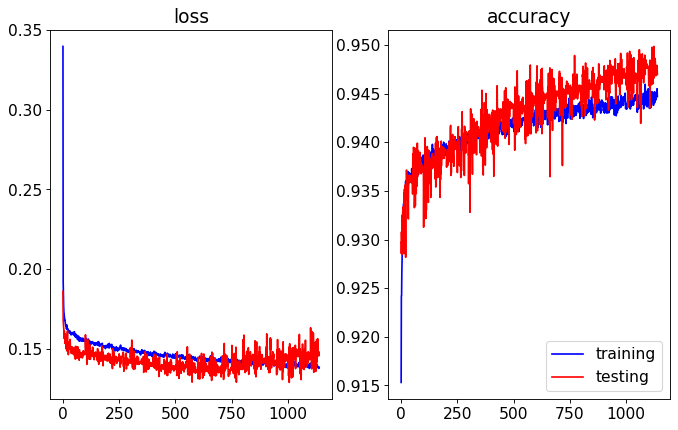

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.38it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


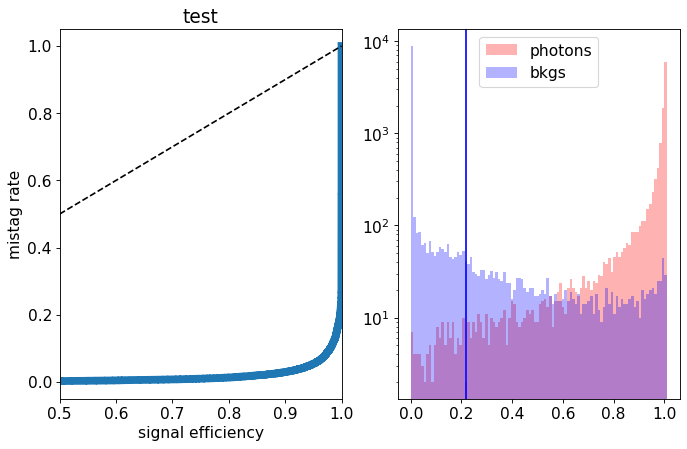

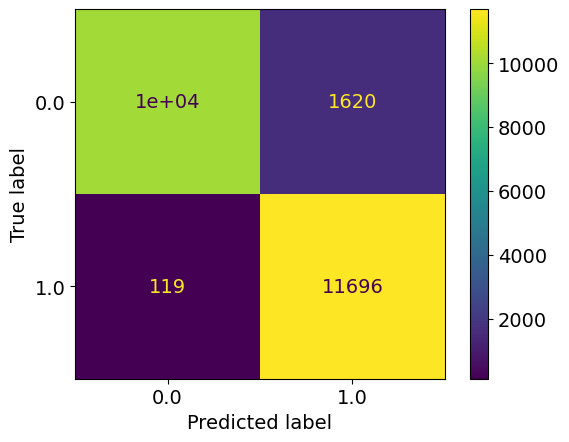

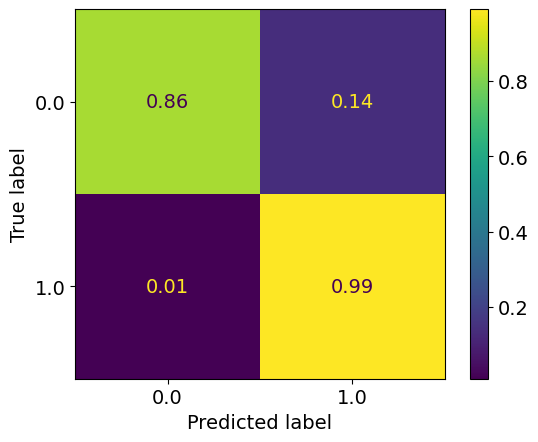

epoch: 1140
Learning rate: 9.560915188000497e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.64it/s]


train loss: 0.1397916208596746
train acc: 0.9445354


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.43it/s]


test loss: 0.14474149961024524
test acc: 0.9478516
epoch: 1141
Learning rate: 7.794329076833946e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.30it/s]


train loss: 0.1389055019066592
train acc: 0.94528973


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.31it/s]


test loss: 0.1489114586263895
test acc: 0.94729906
epoch: 1142
Learning rate: 6.194309466864218e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.1388019935530462
train acc: 0.94508785


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.35it/s]


test loss: 0.14682921124622225
test acc: 0.94746906
epoch: 1143
Learning rate: 4.7671709045124306e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.1384949007421542
train acc: 0.94513035


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.36it/s]


test loss: 0.1493387432768941
test acc: 0.9475541
epoch: 1144
Learning rate: 3.5185456536865835e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.13921954924133934
train acc: 0.94483286


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.32it/s]


test loss: 0.14913979806005956
test acc: 0.94738406
epoch: 1145
Learning rate: 2.4533614678090954e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.13884339937169082
train acc: 0.94424844


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.43it/s]


test loss: 0.14987557344138622
test acc: 0.94738406
epoch: 1146
Learning rate: 1.5758221422252306e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.31it/s]


train loss: 0.13925144717002372
train acc: 0.9444078


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.41it/s]


test loss: 0.1481897970661521
test acc: 0.94725657
epoch: 1147
Learning rate: 8.893909237435216e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.13813266613680847
train acc: 0.94517285


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.43it/s]


test loss: 0.1486449185758829
test acc: 0.94729906
epoch: 1148
Learning rate: 3.967768427826979e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.1391212030960496
train acc: 0.9440997


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.38it/s]


test loss: 0.14840174354612828
test acc: 0.94729906
epoch: 1149
Learning rate: 9.992402206634999e-08


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.60it/s]


train loss: 0.1387455526051248
train acc: 0.94487536


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.36it/s]


test loss: 0.14701983164995908
test acc: 0.94729906


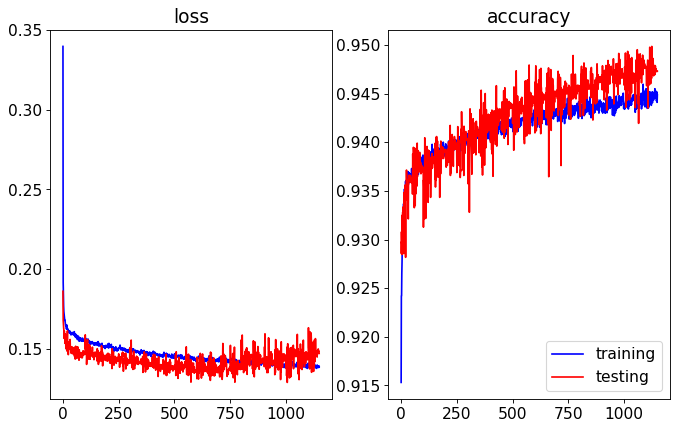

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.73it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


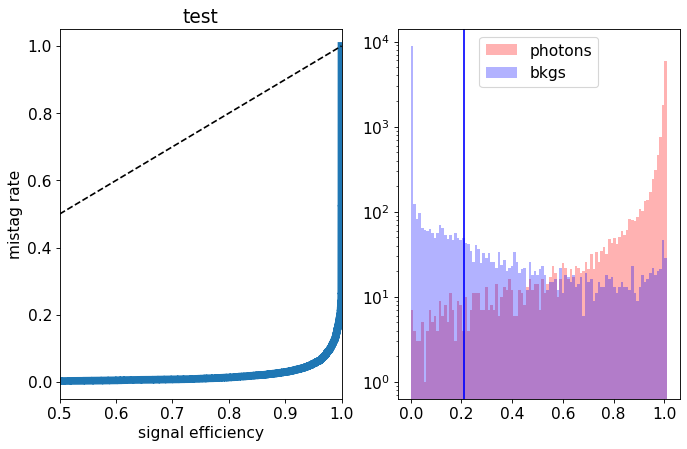

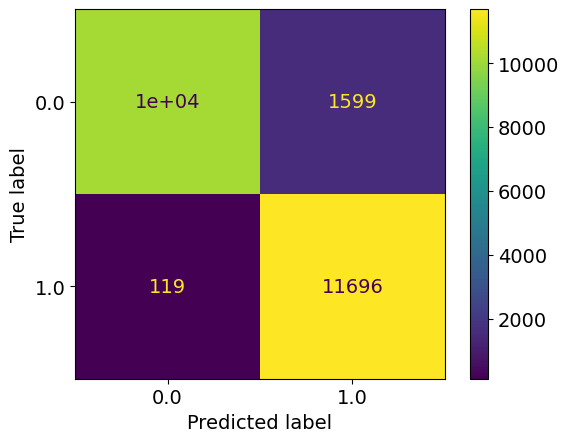

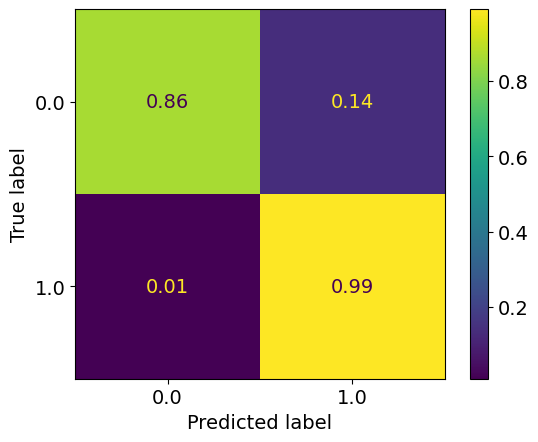

epoch: 1150
Learning rate: 4.004058690165735e-12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.54it/s]


train loss: 0.14010543124690936
train acc: 0.9445779


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.35it/s]


test loss: 0.13402807917445897
test acc: 0.9499766
new best acc: 0.9499766
epoch: 1151
Learning rate: 9.990258887257832e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.30it/s]


train loss: 0.13956657887264423
train acc: 0.9442378


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.35it/s]


test loss: 0.15312890969216825
test acc: 0.94627905
epoch: 1152
Learning rate: 9.960823902925949e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.1396165166501027
train acc: 0.9444503


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.38it/s]


test loss: 0.1415741814300418
test acc: 0.94734156
epoch: 1153
Learning rate: 9.911810813034079e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.30it/s]


train loss: 0.13890013188883
train acc: 0.9450985


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.39it/s]


test loss: 0.1496911332011223
test acc: 0.9479366
epoch: 1154
Learning rate: 9.84341304985607e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.64it/s]


train loss: 0.1404942669401503
train acc: 0.9446097


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.38it/s]


test loss: 0.14288440272212027
test acc: 0.9484466
epoch: 1155
Learning rate: 9.755900548115223e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.1394927384462326
train acc: 0.94483286


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.36it/s]


test loss: 0.1471947744488716
test acc: 0.94581157
epoch: 1156
Learning rate: 9.649618679675248e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.32it/s]


train loss: 0.13991050858786153
train acc: 0.9451091


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.40it/s]


test loss: 0.1502083959057927
test acc: 0.9476391
epoch: 1157
Learning rate: 9.524986890515313e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14053921738437786
train acc: 0.94397223


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.32it/s]


test loss: 0.13754553236067296
test acc: 0.9492541
epoch: 1158
Learning rate: 9.382497045368382e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.31it/s]


train loss: 0.1390602967351865
train acc: 0.9442697


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.39it/s]


test loss: 0.13928683325648308
test acc: 0.9485316
epoch: 1159
Learning rate: 9.222711486555833e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.64it/s]


train loss: 0.1387815483531375
train acc: 0.94420594


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.40it/s]


test loss: 0.13650679793208836
test acc: 0.9483616


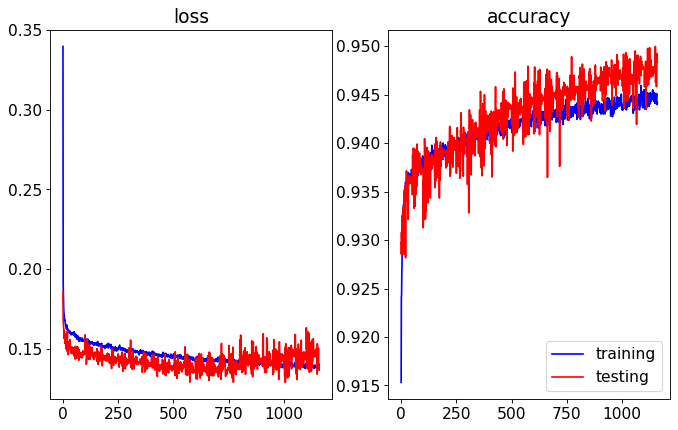

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.37it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


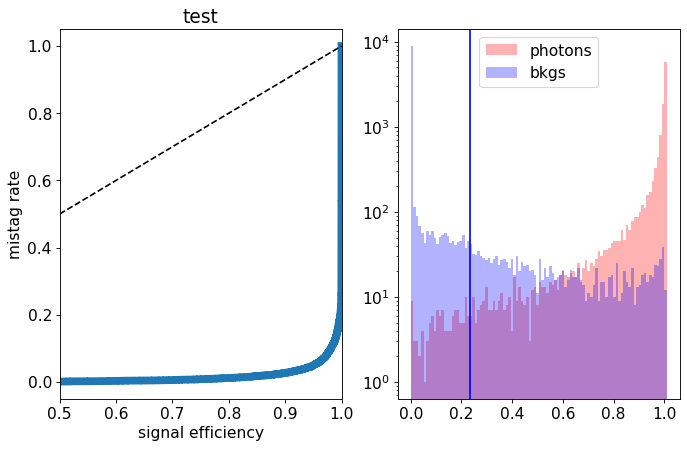

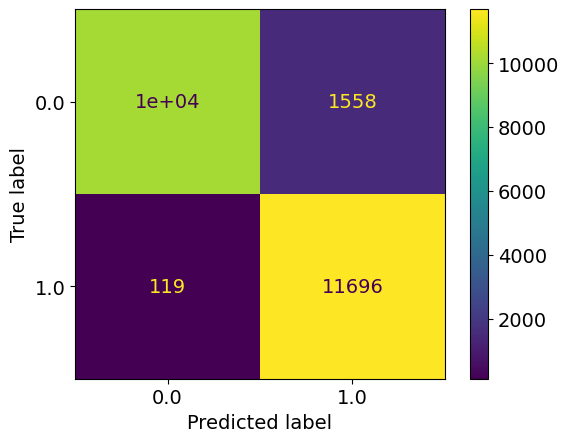

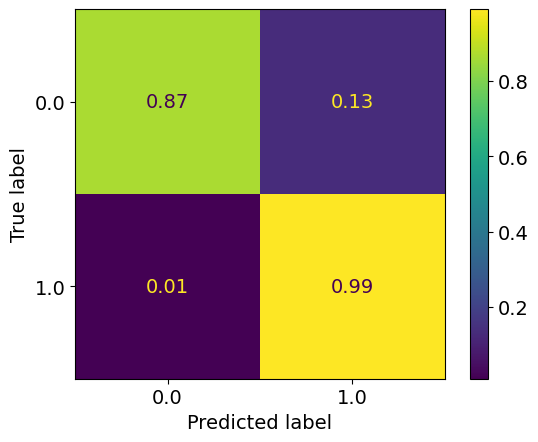

epoch: 1160
Learning rate: 9.046260814679219e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.14089460651965657
train acc: 0.9436747


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.67it/s]


test loss: 0.13630795311182736
test acc: 0.9481916
epoch: 1161
Learning rate: 8.853841399927796e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.13910643670968947
train acc: 0.94412094


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.38it/s]


test loss: 0.13990437630563973
test acc: 0.9486166
epoch: 1162
Learning rate: 8.646212633823516e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.64it/s]


train loss: 0.13870029137202888
train acc: 0.94466287


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.36it/s]


test loss: 0.14948078487068414
test acc: 0.9481491
epoch: 1163
Learning rate: 8.424193932249635e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.31it/s]


train loss: 0.1402902424240568
train acc: 0.9445141


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.40it/s]


test loss: 0.14202811438590288
test acc: 0.9494241
epoch: 1164
Learning rate: 8.188661501590568e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.64it/s]


train loss: 0.1383535005389505
train acc: 0.94520473


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.40it/s]


test loss: 0.13692629858851432
test acc: 0.94980663
epoch: 1165
Learning rate: 7.940544880745594e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.13835988544924244
train acc: 0.9453748


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.17it/s]


test loss: 0.15515576265752315
test acc: 0.9467041
epoch: 1166
Learning rate: 7.680823272663487e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.1392425947413323
train acc: 0.94506663


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.63it/s]


test loss: 0.15371758956462145
test acc: 0.9469591
epoch: 1167
Learning rate: 7.410521679875828e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.13930196557075356
train acc: 0.94493914


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.56it/s]


test loss: 0.1473100209608674
test acc: 0.94725657
epoch: 1168
Learning rate: 7.130706859280303e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


train loss: 0.13856646176546242
train acc: 0.94477975


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.42it/s]


test loss: 0.14197475872933865
test acc: 0.94950914
epoch: 1169
Learning rate: 6.842483112138567e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.64it/s]


train loss: 0.1399043512287413
train acc: 0.94419533


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.44it/s]


test loss: 0.1498707065358758
test acc: 0.9467466


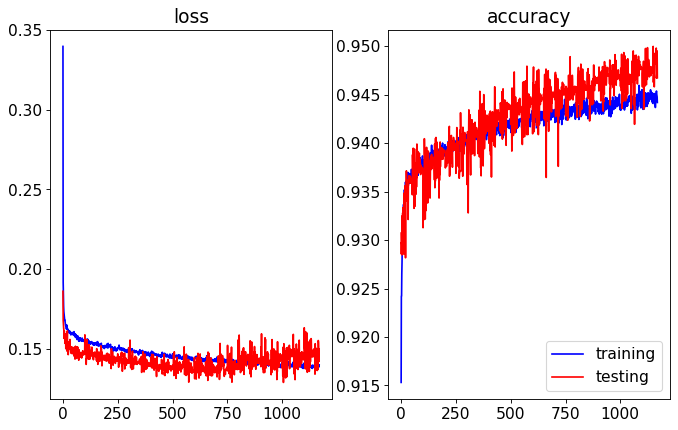

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.34it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


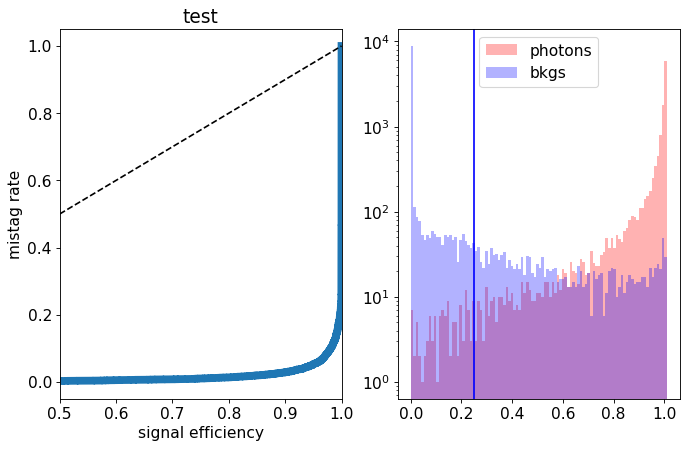

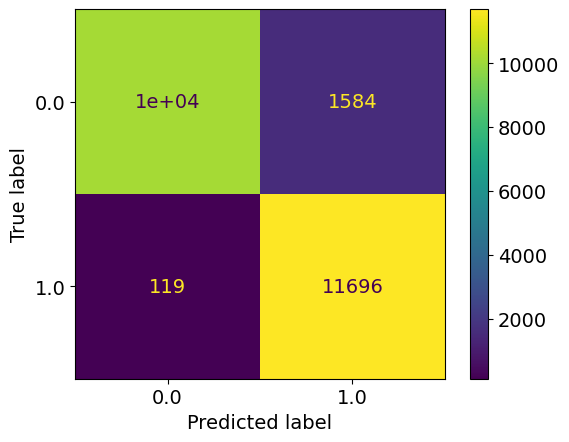

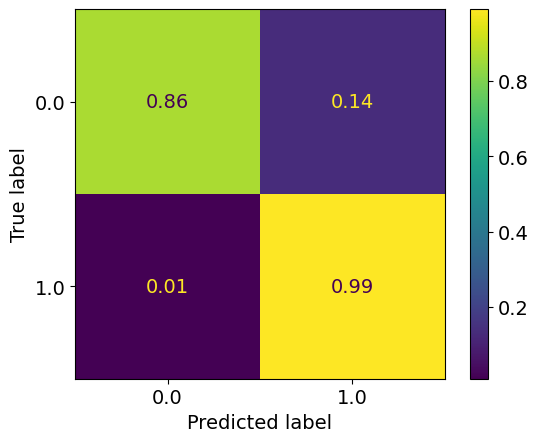

epoch: 1170
Learning rate: 6.546987925903684e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.31it/s]


train loss: 0.13945067892218851
train acc: 0.9445672


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.38it/s]


test loss: 0.13212157264351845
test acc: 0.94955164
epoch: 1171
Learning rate: 6.245387485076818e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.13891314235842153
train acc: 0.9444185


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.40it/s]


test loss: 0.15104018989950418
test acc: 0.9471291
epoch: 1172
Learning rate: 5.9388720688097756e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.13774088779642324
train acc: 0.94520473


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.70it/s]


test loss: 0.144554522074759
test acc: 0.9478516
epoch: 1173
Learning rate: 5.628651353416987e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


train loss: 0.13946200470635844
train acc: 0.9444822


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.95it/s]


test loss: 0.1513266820460558
test acc: 0.94644904
epoch: 1174
Learning rate: 5.3159496383357456e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.13920928684958986
train acc: 0.9443653


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.30it/s]


test loss: 0.13881526719778775
test acc: 0.9489566
epoch: 1175
Learning rate: 5.0020010143756554e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.26it/s]


train loss: 0.1387824202134351
train acc: 0.9442378


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.29it/s]


test loss: 0.14306166693568229
test acc: 0.9483616
epoch: 1176
Learning rate: 4.6880444933259986e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.13770219754831048
train acc: 0.9457148


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.37it/s]


test loss: 0.1573247417807579
test acc: 0.94738406
epoch: 1177
Learning rate: 4.3753191181422696e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.13925166541983366
train acc: 0.9444397


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.40it/s]


test loss: 0.1475291946902871
test acc: 0.94729906
epoch: 1178
Learning rate: 4.065059073009685e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.27it/s]


train loss: 0.13857371763438936
train acc: 0.94573605


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.33it/s]


test loss: 0.1423492580652237
test acc: 0.9483616
epoch: 1179
Learning rate: 3.7584888125820524e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.13961481549747431
train acc: 0.9446735


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.31it/s]


test loss: 0.14600107930600642
test acc: 0.9479366


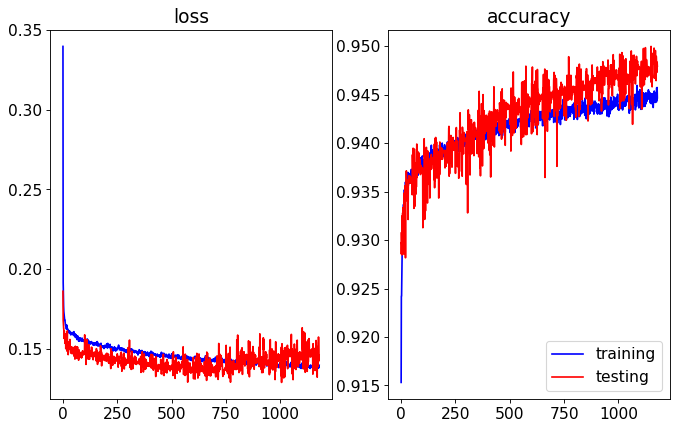

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.36it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


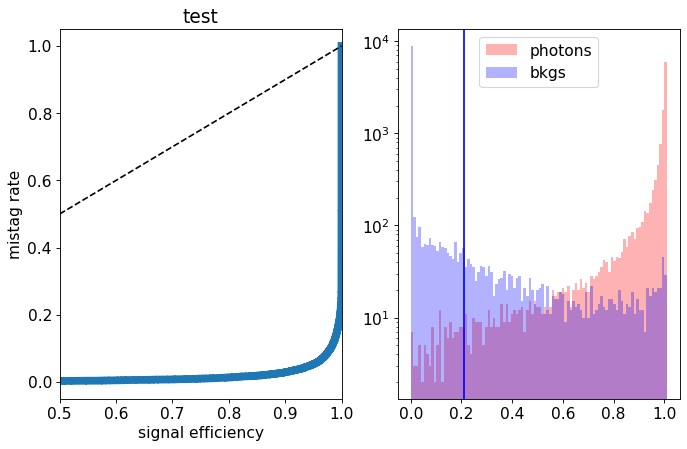

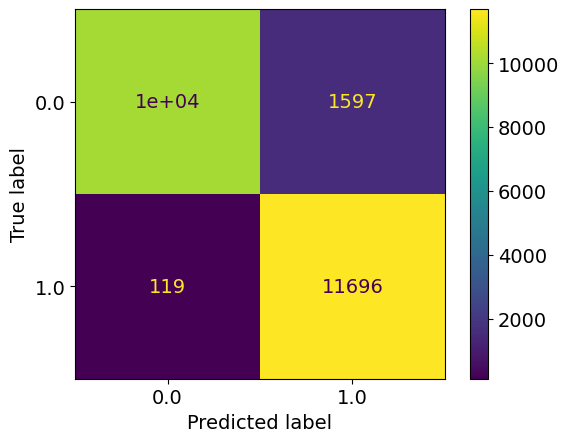

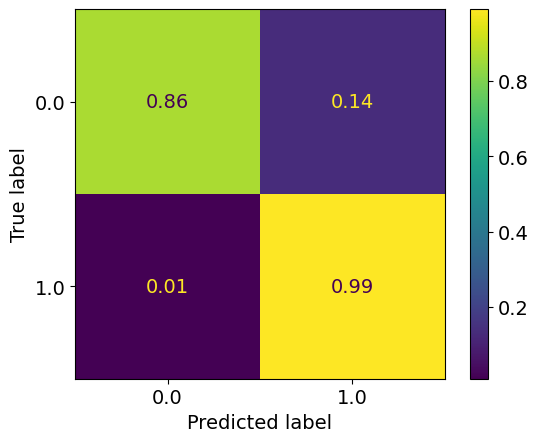

epoch: 1180
Learning rate: 3.456818229618647e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.30it/s]


train loss: 0.13953526560098503
train acc: 0.94493914


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.33it/s]


test loss: 0.14002284668385984
test acc: 0.9489566
epoch: 1181
Learning rate: 3.1612378800902485e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.13866181643145858
train acc: 0.945396


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.43it/s]


test loss: 0.1447195341810584
test acc: 0.9488716
epoch: 1182
Learning rate: 2.87291428459863e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.13823353124272292
train acc: 0.94477975


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.31it/s]


test loss: 0.14189140703529118
test acc: 0.94848907
epoch: 1183
Learning rate: 2.5929853246526715e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.13899684265540663
train acc: 0.94494975


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.39it/s]


test loss: 0.13991266600787639
test acc: 0.9483191
epoch: 1184
Learning rate: 2.322555751969906e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.64it/s]


train loss: 0.13928157309438013
train acc: 0.9444397


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.31it/s]


test loss: 0.14171851482242345
test acc: 0.9486591
epoch: 1185
Learning rate: 2.062692828526193e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.28it/s]


train loss: 0.1371160640268569
train acc: 0.94494975


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.30it/s]


test loss: 0.1464455895125866
test acc: 0.9480216
epoch: 1186
Learning rate: 1.8144221145602852e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.13778570849614538
train acc: 0.94575727


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.37it/s]


test loss: 0.14231614489108324
test acc: 0.9482766
epoch: 1187
Learning rate: 1.5787234211561068e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.13781108113990467
train acc: 0.94524723


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.35it/s]


test loss: 0.1454255623742938
test acc: 0.9482341
epoch: 1188
Learning rate: 1.3565269433760352e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.32it/s]


train loss: 0.1382810130810282
train acc: 0.9446097


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.41it/s]


test loss: 0.14587509706616403
test acc: 0.9487866
epoch: 1189
Learning rate: 1.1487095892059523e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.13861543689943423
train acc: 0.9454385


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.31it/s]


test loss: 0.14710130598396062
test acc: 0.9484466


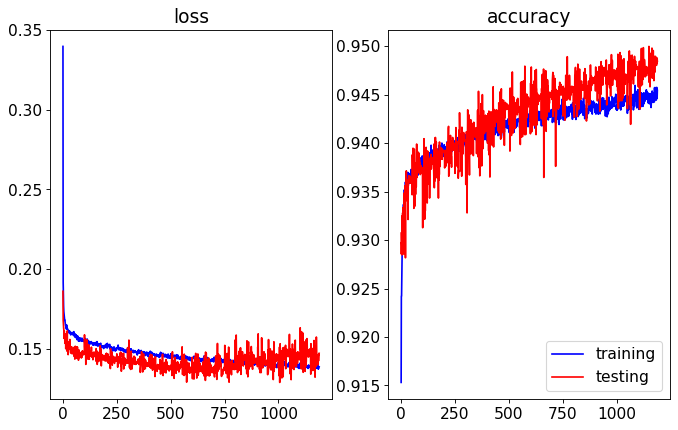

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.39it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


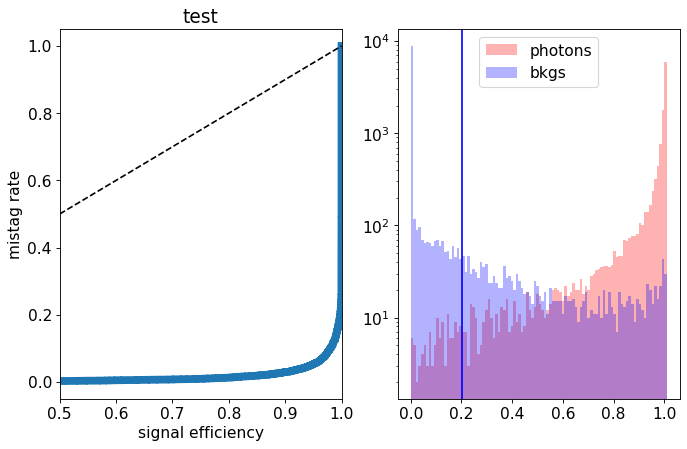

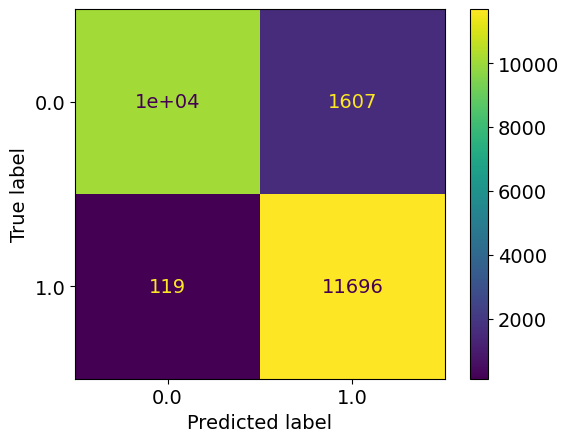

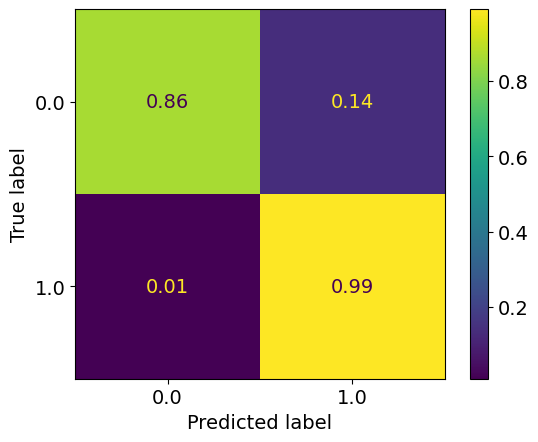

epoch: 1190
Learning rate: 9.560915188000497e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.31it/s]


train loss: 0.1383809285463801
train acc: 0.9450135


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.41it/s]


test loss: 0.14390231836587192
test acc: 0.9484466
epoch: 1191
Learning rate: 7.794329076833946e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.13726860593268825
train acc: 0.94503474


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.34it/s]


test loss: 0.1459391236305237
test acc: 0.9479791
epoch: 1192
Learning rate: 6.194309466864218e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.32it/s]


train loss: 0.13712764526628385
train acc: 0.94497097


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.44it/s]


test loss: 0.14782667197287083
test acc: 0.9481916
epoch: 1193
Learning rate: 4.7671709045124306e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.64it/s]


train loss: 0.13773177231952644
train acc: 0.945141


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.43it/s]


test loss: 0.14624686911702156
test acc: 0.9481066
epoch: 1194
Learning rate: 3.5185456536865835e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.1383712532319081
train acc: 0.94570416


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.32it/s]


test loss: 0.1464613800868392
test acc: 0.9482766
epoch: 1195
Learning rate: 2.4533614678090954e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.31it/s]


train loss: 0.1375789784227207
train acc: 0.9452579


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.44it/s]


test loss: 0.14693045280873776
test acc: 0.9482341
epoch: 1196
Learning rate: 1.5758221422252306e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.64it/s]


train loss: 0.138815569032909
train acc: 0.9444185


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.36it/s]


test loss: 0.14709089137613773
test acc: 0.9483616
epoch: 1197
Learning rate: 8.893909237435216e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.13774214234131915
train acc: 0.94494975


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.33it/s]


test loss: 0.14710037801414727
test acc: 0.9481916
epoch: 1198
Learning rate: 3.967768427826979e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.1381180489993399
train acc: 0.94507724


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.28it/s]


test loss: 0.1479948541149497
test acc: 0.9480216
epoch: 1199
Learning rate: 9.992402206634999e-08


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.60it/s]


train loss: 0.13696832281009408
train acc: 0.94520473


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.57it/s]


test loss: 0.14734309688210487
test acc: 0.9479791


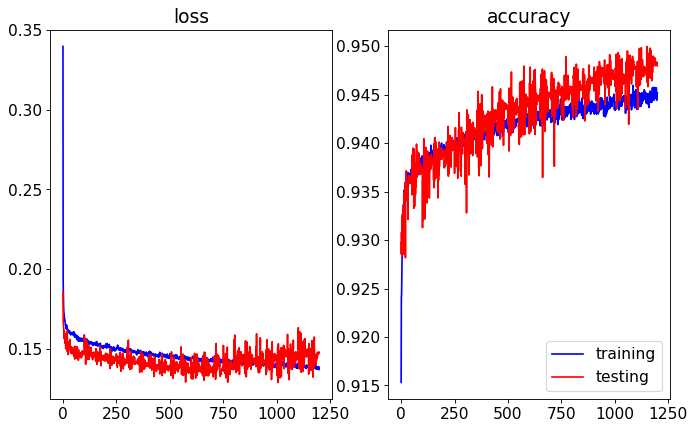

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.62it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


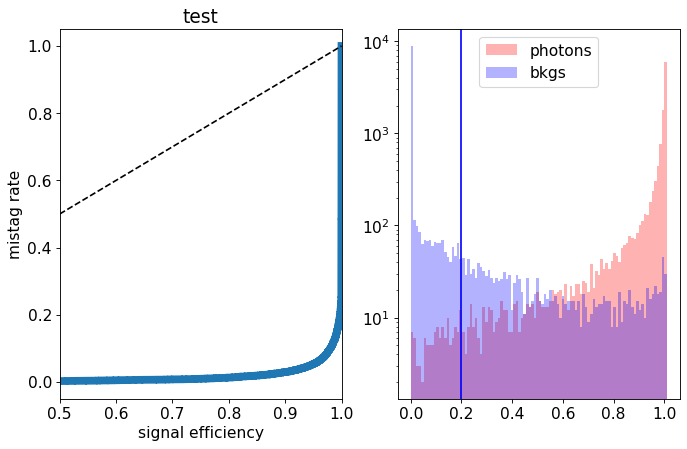

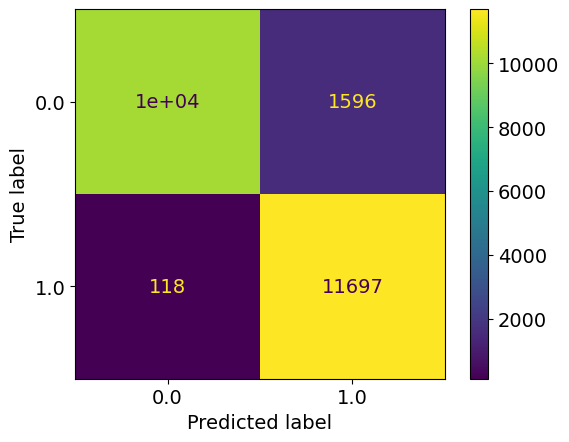

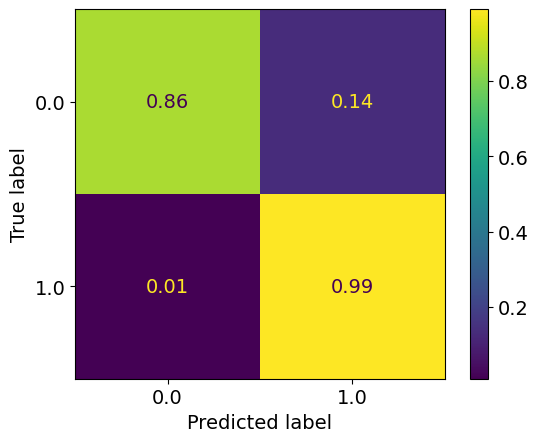

epoch: 1200
Learning rate: 4.004058690165735e-12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.31it/s]


train loss: 0.13897757089821397
train acc: 0.9444929


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.30it/s]


test loss: 0.14744690116494893
test acc: 0.9480641
epoch: 1201
Learning rate: 9.990258887257832e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.13870604934206435
train acc: 0.94387656


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.67it/s]


test loss: 0.14632851760834456
test acc: 0.9478091
epoch: 1202
Learning rate: 9.960823902925949e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.17it/s]


train loss: 0.1397361389960453
train acc: 0.94419533


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.63it/s]


test loss: 0.1346833772957325
test acc: 0.9491266
epoch: 1203
Learning rate: 9.911810813034079e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.45it/s]


train loss: 0.13891189474209098
train acc: 0.9444822


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.17it/s]


test loss: 0.13554017934948207
test acc: 0.9502741
new best acc: 0.9502741
epoch: 1204
Learning rate: 9.84341304985607e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.13972617989512764
train acc: 0.9441316


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.43it/s]


test loss: 0.14300590101629496
test acc: 0.9489141
epoch: 1205
Learning rate: 9.755900548115223e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.17it/s]


train loss: 0.14014442075210012
train acc: 0.9444716


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.21it/s]


test loss: 0.13735295422375202
test acc: 0.9488291
epoch: 1206
Learning rate: 9.649618679675248e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1400781298044381
train acc: 0.9445566


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.57it/s]


test loss: 0.1534592540934682
test acc: 0.94632155
epoch: 1207
Learning rate: 9.524986890515313e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.1394842118024826
train acc: 0.94395095


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.24it/s]


test loss: 0.166545650921762
test acc: 0.94534403
epoch: 1208
Learning rate: 9.382497045368382e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.14001925023877695
train acc: 0.9445141


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.93it/s]


test loss: 0.15914861988276244
test acc: 0.94619405
epoch: 1209
Learning rate: 9.222711486555833e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.13929691156194468
train acc: 0.9447585


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.55it/s]


test loss: 0.1566386828199029
test acc: 0.94632155


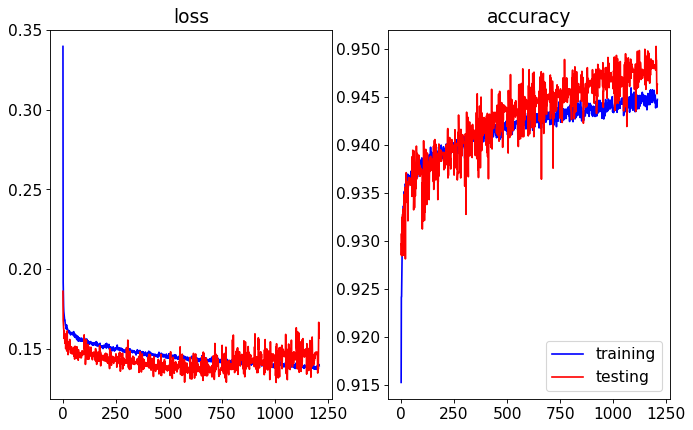

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.95it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


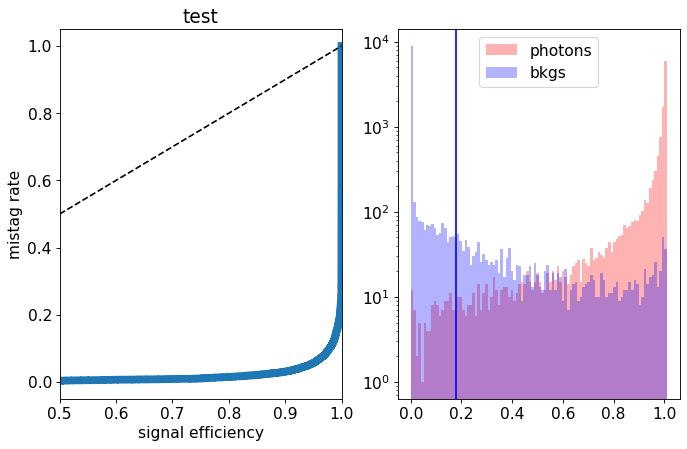

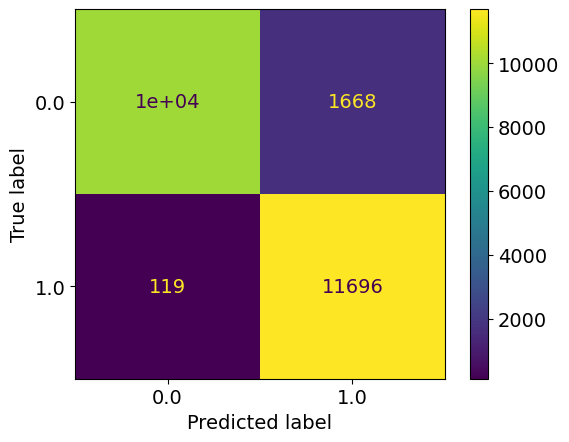

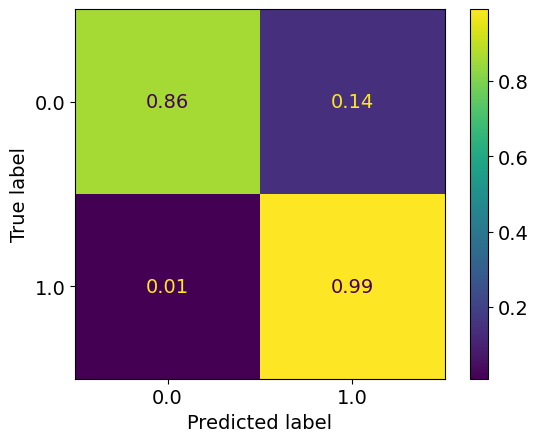

epoch: 1210
Learning rate: 9.046260814679219e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1392205864380879
train acc: 0.94411033


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.39it/s]


test loss: 0.16097382009029387
test acc: 0.94725657
epoch: 1211
Learning rate: 8.853841399927796e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.42it/s]


train loss: 0.13915340573924362
train acc: 0.94520473


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.77it/s]


test loss: 0.1388098865747452
test acc: 0.9499341
epoch: 1212
Learning rate: 8.646212633823516e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.10it/s]


train loss: 0.13819545260660207
train acc: 0.94479036


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 13.98it/s]


test loss: 0.14871463868767024
test acc: 0.94738406
epoch: 1213
Learning rate: 8.424193932249635e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.1385722129967562
train acc: 0.9436003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.34it/s]


test loss: 0.14910155832767485
test acc: 0.9485316
epoch: 1214
Learning rate: 8.188661501590568e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.42it/s]


train loss: 0.13892535547352142
train acc: 0.94503474


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.74it/s]


test loss: 0.14615499768406154
test acc: 0.94632155
epoch: 1215
Learning rate: 7.940544880745594e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.13699189905717873
train acc: 0.94479036


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.95it/s]


test loss: 0.15728243626654148
test acc: 0.94725657
epoch: 1216
Learning rate: 7.680823272663487e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.13825186631482117
train acc: 0.94513035


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.79it/s]


test loss: 0.1502456633374095
test acc: 0.9478941
epoch: 1217
Learning rate: 7.410521679875828e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.08it/s]


train loss: 0.13918479954361157
train acc: 0.9444716


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.59it/s]


test loss: 0.15065154060721397
test acc: 0.9466191
epoch: 1218
Learning rate: 7.130706859280303e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1383050389730247
train acc: 0.945056


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.08it/s]


test loss: 0.13819822194054723
test acc: 0.9489566
epoch: 1219
Learning rate: 6.842483112138567e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.13882188185764727
train acc: 0.94494975


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.88it/s]


test loss: 0.15425610709935428
test acc: 0.9466616


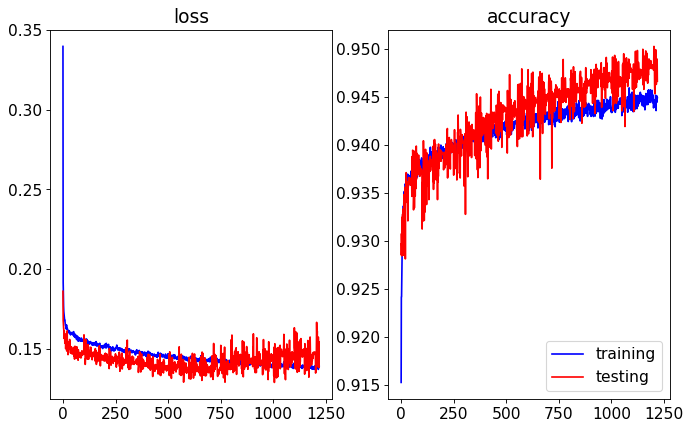

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.64it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


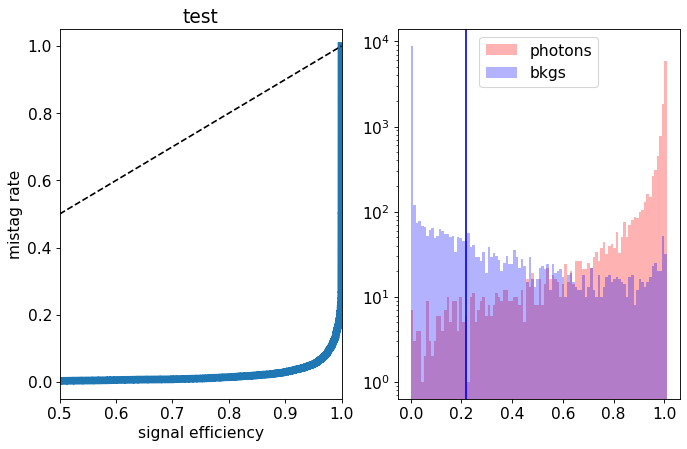

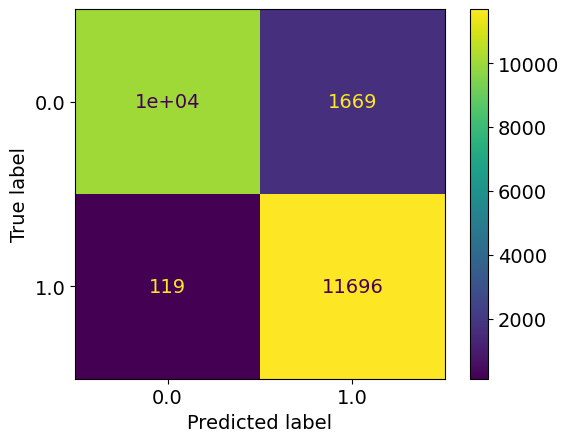

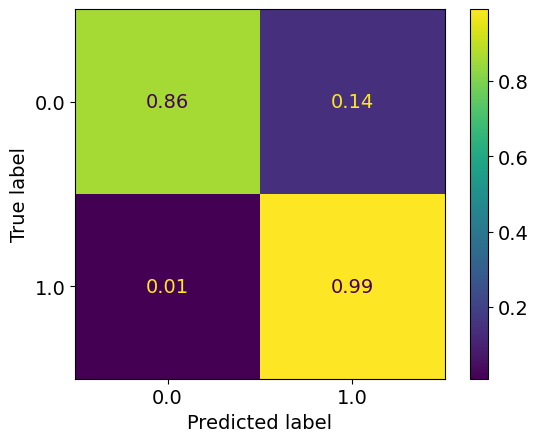

epoch: 1220
Learning rate: 6.546987925903684e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.13864241108583036
train acc: 0.94473726


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.33it/s]


test loss: 0.16272345203906297
test acc: 0.94615155
epoch: 1221
Learning rate: 6.245387485076818e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.46it/s]


train loss: 0.1386630787591266
train acc: 0.94469476


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.99it/s]


test loss: 0.14931663107126952
test acc: 0.9480641
epoch: 1222
Learning rate: 5.9388720688097756e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.06it/s]


train loss: 0.1383956106510132
train acc: 0.94500285


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.47it/s]


test loss: 0.15629944298416376
test acc: 0.94738406
epoch: 1223
Learning rate: 5.628651353416987e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.1387479154357485
train acc: 0.9451516


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.73it/s]


test loss: 0.1479158839210868
test acc: 0.9488291
epoch: 1224
Learning rate: 5.3159496383357456e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.04it/s]


train loss: 0.1383531889433314
train acc: 0.9451091


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.13it/s]


test loss: 0.14503328036516905
test acc: 0.9484466
epoch: 1225
Learning rate: 5.0020010143756554e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.13763491012108553
train acc: 0.9455554


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.42it/s]


test loss: 0.14859372302889823
test acc: 0.9490416
epoch: 1226
Learning rate: 4.6880444933259986e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.13744850499424965
train acc: 0.9453535


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.80it/s]


test loss: 0.13981358353048562
test acc: 0.9489991
epoch: 1227
Learning rate: 4.3753191181422696e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.09it/s]


train loss: 0.13802779888271527
train acc: 0.94504535


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.37it/s]


test loss: 0.14372427761554718
test acc: 0.9482341
epoch: 1228
Learning rate: 4.065059073009685e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.13667562608696093
train acc: 0.9463098


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.48it/s]


test loss: 0.15202859099954366
test acc: 0.94734156
epoch: 1229
Learning rate: 3.7584888125820524e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.10it/s]


train loss: 0.13802444597907887
train acc: 0.94524723


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.70it/s]


test loss: 0.14782503955066204
test acc: 0.9475541


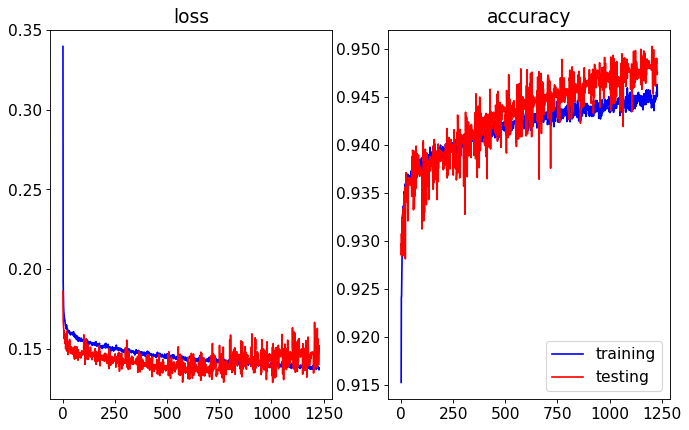

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.12it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


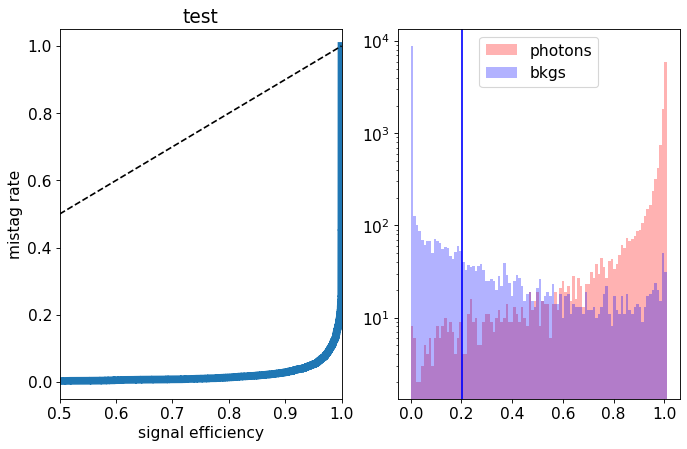

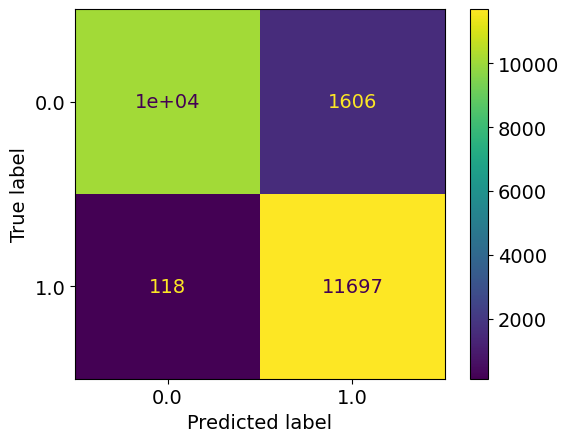

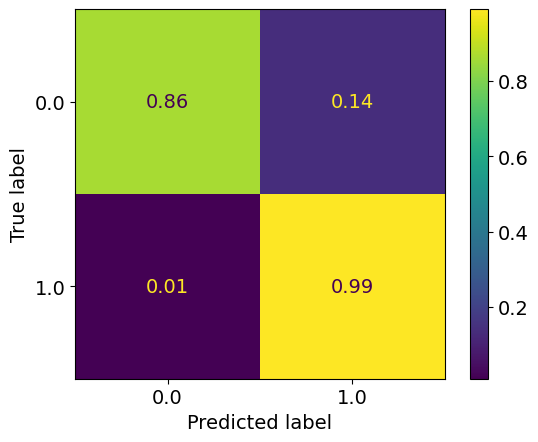

epoch: 1230
Learning rate: 3.456818229618647e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.13861341812428396
train acc: 0.9460973


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.73it/s]


test loss: 0.15114774107933043
test acc: 0.9482341
epoch: 1231
Learning rate: 3.1612378800902485e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.1380483144597643
train acc: 0.945311


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.53it/s]


test loss: 0.15233606789261103
test acc: 0.9480641
epoch: 1232
Learning rate: 2.87291428459863e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1382577768082072
train acc: 0.9446735


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.35it/s]


test loss: 0.15604831296950578
test acc: 0.9467041
epoch: 1233
Learning rate: 2.5929853246526715e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.46it/s]


train loss: 0.13767883281229407
train acc: 0.94575727


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.27it/s]


test loss: 0.14675752595067024
test acc: 0.9488291
epoch: 1234
Learning rate: 2.322555751969906e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.13711921505297825
train acc: 0.94486475


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.40it/s]


test loss: 0.15206664986908436
test acc: 0.9480641
epoch: 1235
Learning rate: 2.062692828526193e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.46it/s]


train loss: 0.13688652952955027
train acc: 0.945481


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.01it/s]


test loss: 0.14349361434578894
test acc: 0.9487016
epoch: 1236
Learning rate: 1.8144221145602852e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.13846589468277185
train acc: 0.9452154


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.37it/s]


test loss: 0.1498394126072526
test acc: 0.9477241
epoch: 1237
Learning rate: 1.5787234211561068e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.1378646297439648
train acc: 0.94487536


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.1511923374608159
test acc: 0.9480216
epoch: 1238
Learning rate: 1.3565269433760352e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.13824787702719876
train acc: 0.9451091


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.96it/s]


test loss: 0.149644529633224
test acc: 0.9482341
epoch: 1239
Learning rate: 1.1487095892059523e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.20it/s]


train loss: 0.13804394372139767
train acc: 0.9455235


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.58it/s]


test loss: 0.1510476991534233
test acc: 0.9481066


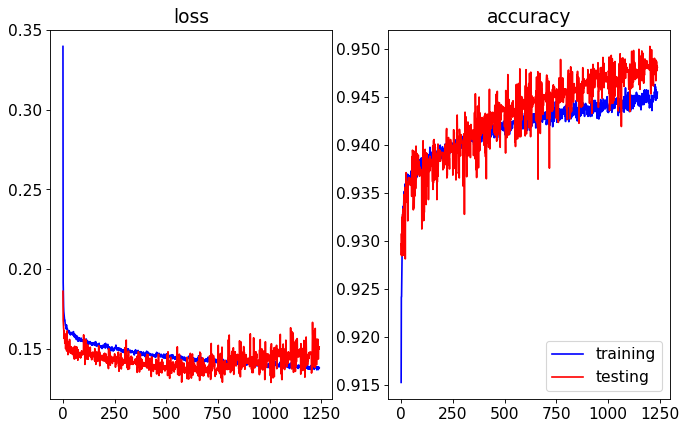

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.40it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


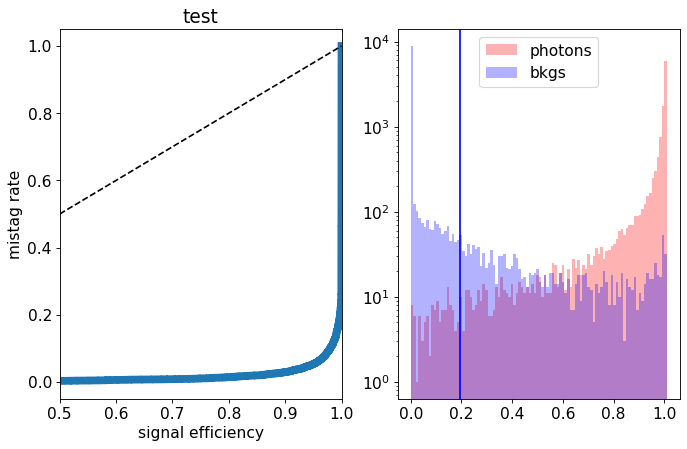

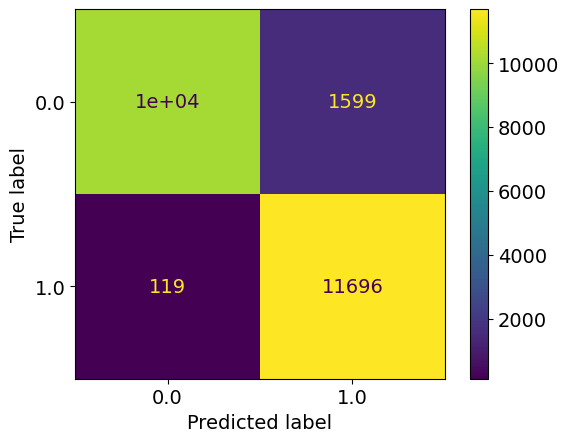

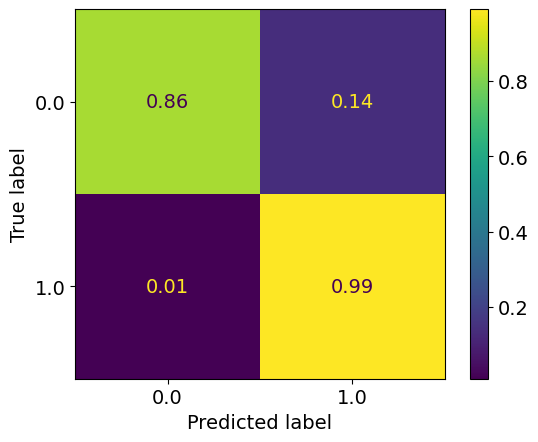

epoch: 1240
Learning rate: 9.560915188000497e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.13827605740090085
train acc: 0.94502413


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.91it/s]


test loss: 0.14783419612795115
test acc: 0.9480216
epoch: 1241
Learning rate: 7.794329076833946e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.09it/s]


train loss: 0.13892171878343934
train acc: 0.94485414


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.71it/s]


test loss: 0.15043075811117887
test acc: 0.9483616
epoch: 1242
Learning rate: 6.194309466864218e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.13744964180098976
train acc: 0.94566166


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.65it/s]


test loss: 0.15019461382180452
test acc: 0.9483191
epoch: 1243
Learning rate: 4.7671709045124306e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.13796018154188328
train acc: 0.94483286


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.67it/s]


test loss: 0.14937229063361884
test acc: 0.9484466
epoch: 1244
Learning rate: 3.5185456536865835e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.07it/s]


train loss: 0.13889572242642664
train acc: 0.94593793


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.81it/s]


test loss: 0.14918158687651156
test acc: 0.9482341
epoch: 1245
Learning rate: 2.4533614678090954e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.13807608718705025
train acc: 0.9454491


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.82it/s]


test loss: 0.14905817806720734
test acc: 0.94848907
epoch: 1246
Learning rate: 1.5758221422252306e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.09it/s]


train loss: 0.13714495092440562
train acc: 0.94502413


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.10it/s]


test loss: 0.1514754818752408
test acc: 0.9485316
epoch: 1247
Learning rate: 8.893909237435216e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.13750398377324366
train acc: 0.94493914


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.45it/s]


test loss: 0.15097999405115842
test acc: 0.94848907
epoch: 1248
Learning rate: 3.967768427826979e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.13734719840584286
train acc: 0.9451091


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.74it/s]


test loss: 0.14814924448728561
test acc: 0.9484041
epoch: 1249
Learning rate: 9.992402206634999e-08


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.08it/s]


train loss: 0.13659754485651188
train acc: 0.94516224


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.70it/s]


test loss: 0.14895047787576915
test acc: 0.9483616


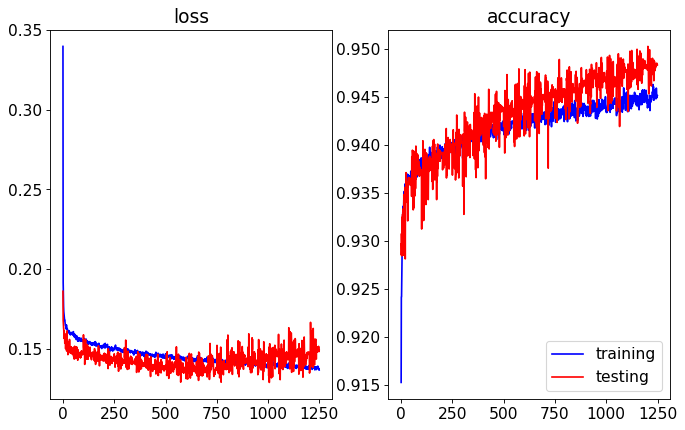

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.49it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


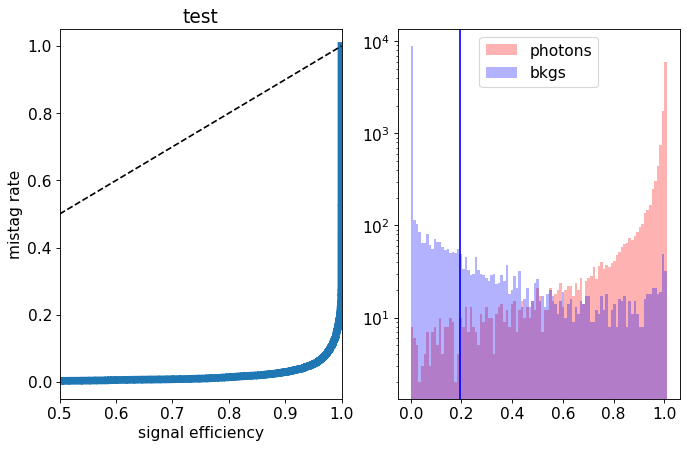

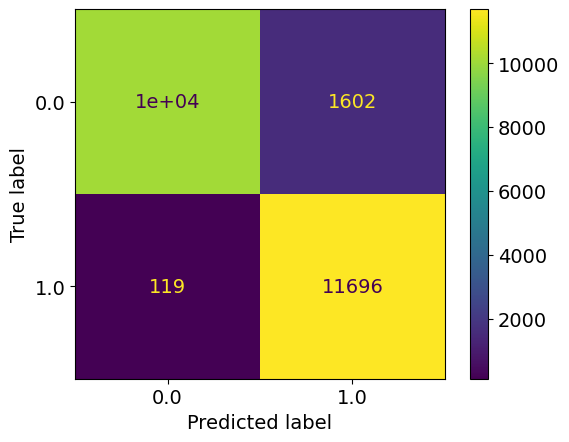

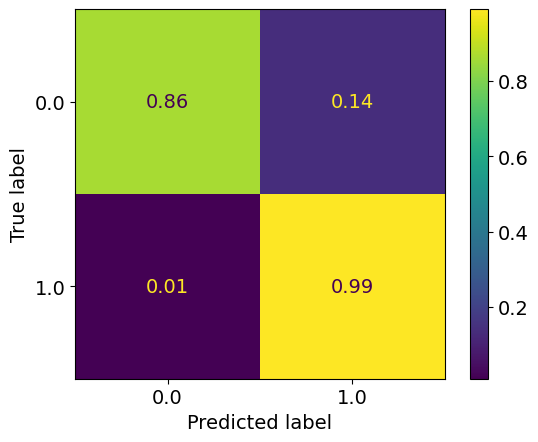

epoch: 1250
Learning rate: 4.004058690165735e-12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.13862494213186252
train acc: 0.9442803


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.56it/s]


test loss: 0.14732195064425468
test acc: 0.9467041
epoch: 1251
Learning rate: 9.990258887257832e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.06it/s]


train loss: 0.13878910162836122
train acc: 0.9440147


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.63it/s]


test loss: 0.15640194360166787
test acc: 0.9467466
epoch: 1252
Learning rate: 9.960823902925949e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.13840055883310404
train acc: 0.9445354


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.76it/s]


test loss: 0.15952675342559813
test acc: 0.94636405
epoch: 1253
Learning rate: 9.911810813034079e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.13975329251046392
train acc: 0.9446097


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.73it/s]


test loss: 0.15756986532360315
test acc: 0.9469591
epoch: 1254
Learning rate: 9.84341304985607e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.13830112537760644
train acc: 0.9445991


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.57it/s]


test loss: 0.14703476447612046
test acc: 0.9456416
epoch: 1255
Learning rate: 9.755900548115223e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.13985816930319853
train acc: 0.9441741


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.04it/s]


test loss: 0.14217943213880063
test acc: 0.9485316
epoch: 1256
Learning rate: 9.649618679675248e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.13753971951023028
train acc: 0.9445991


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.55it/s]


test loss: 0.14333337787538766
test acc: 0.9492966
epoch: 1257
Learning rate: 9.524986890515313e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.13824699857052725
train acc: 0.9453322


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.98it/s]


test loss: 0.13802144788205623
test acc: 0.9487866
epoch: 1258
Learning rate: 9.382497045368382e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.13957046072004706
train acc: 0.94399345


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.65it/s]


test loss: 0.15530814360827208
test acc: 0.9469591
epoch: 1259
Learning rate: 9.222711486555833e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.06it/s]


train loss: 0.1391858441434848
train acc: 0.94490725


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.50it/s]


test loss: 0.1505473444238305
test acc: 0.94955164


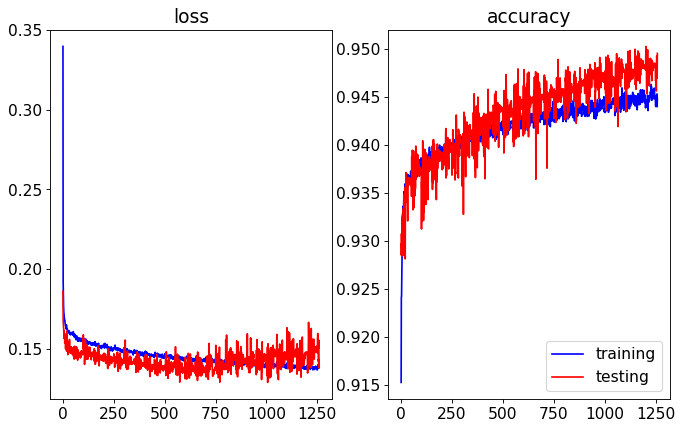

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.30it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


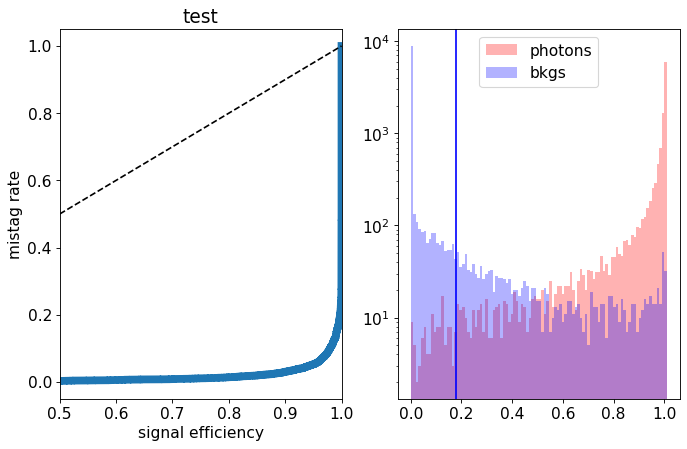

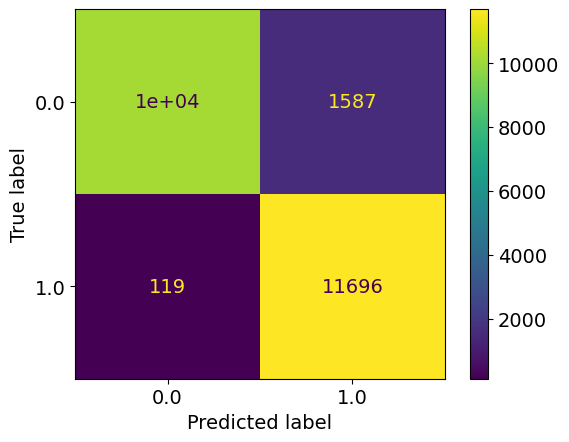

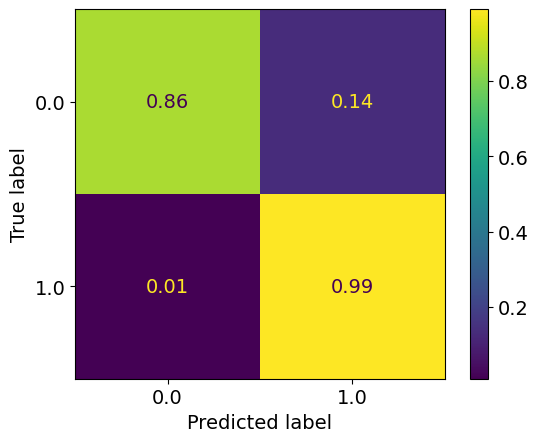

epoch: 1260
Learning rate: 9.046260814679219e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.13810700719143934
train acc: 0.94483286


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.98it/s]


test loss: 0.14743008483201264
test acc: 0.9476391
epoch: 1261
Learning rate: 8.853841399927796e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.10it/s]


train loss: 0.13902391460101315
train acc: 0.9446735


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.49it/s]


test loss: 0.1571265859529376
test acc: 0.94479156
epoch: 1262
Learning rate: 8.646212633823516e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.45it/s]


train loss: 0.1381248307360965
train acc: 0.9447691


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.45it/s]


test loss: 0.15612226743251084
test acc: 0.9467041
epoch: 1263
Learning rate: 8.424193932249635e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.1374744436923106
train acc: 0.94492847


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.53it/s]


test loss: 0.15070803742855787
test acc: 0.9484466
epoch: 1264
Learning rate: 8.188661501590568e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.13805724822791518
train acc: 0.94592726


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.25it/s]


test loss: 0.14783003591001034
test acc: 0.9483191
epoch: 1265
Learning rate: 7.940544880745594e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1383140897200366
train acc: 0.94517285


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.51it/s]


test loss: 0.15123501736670733
test acc: 0.9482766
epoch: 1266
Learning rate: 7.680823272663487e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.14it/s]


train loss: 0.13891823504381118
train acc: 0.94503474


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.23it/s]


test loss: 0.15055358354002238
test acc: 0.9476391
epoch: 1267
Learning rate: 7.410521679875828e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.13695050486523636
train acc: 0.9453004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.45it/s]


test loss: 0.15873969830572604
test acc: 0.9468316
epoch: 1268
Learning rate: 7.130706859280303e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.13845663626862179
train acc: 0.94496036


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.36it/s]


test loss: 0.1491069857031107
test acc: 0.9484041
epoch: 1269
Learning rate: 6.842483112138567e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.13791867326589147
train acc: 0.9454598


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.22it/s]


test loss: 0.1514821842312813
test acc: 0.9477666


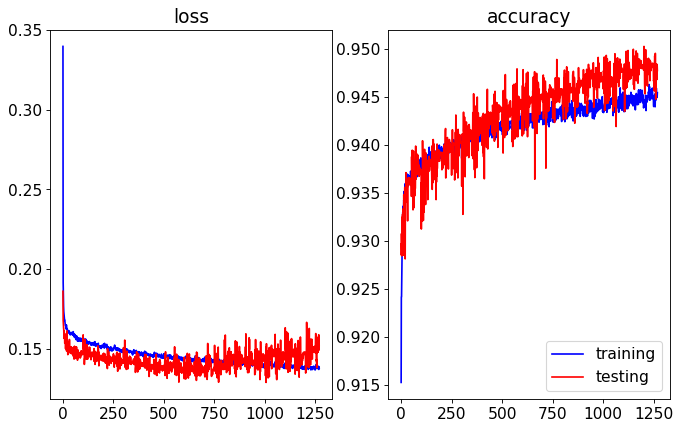

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.40it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


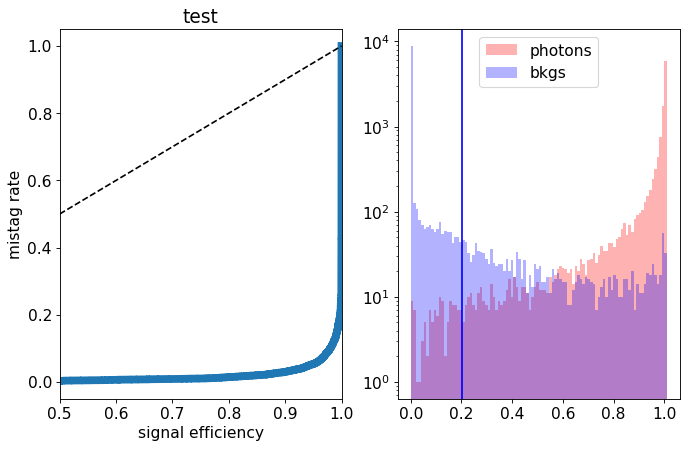

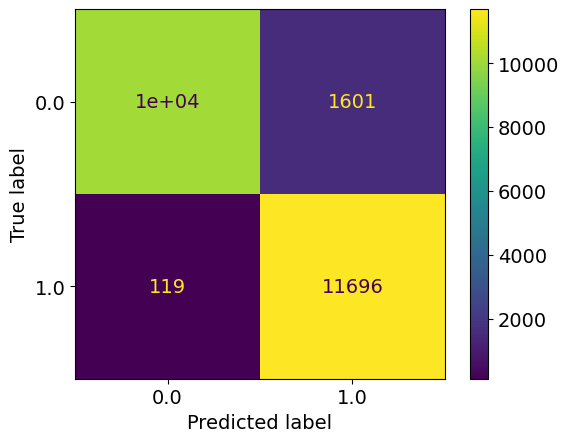

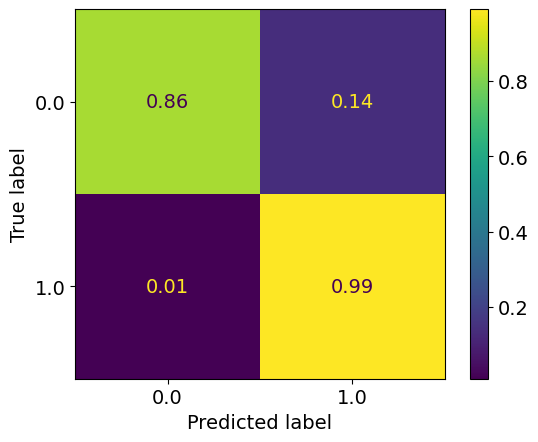

epoch: 1270
Learning rate: 6.546987925903684e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.13714384615041647
train acc: 0.94494975


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.93it/s]


test loss: 0.14443600941449403
test acc: 0.94848907
epoch: 1271
Learning rate: 6.245387485076818e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.1375949321563836
train acc: 0.9451835


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.82it/s]


test loss: 0.15009503178298472
test acc: 0.9490841
epoch: 1272
Learning rate: 5.9388720688097756e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.13723239929053435
train acc: 0.94579977


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.72it/s]


test loss: 0.16065164357423783
test acc: 0.9481491
epoch: 1273
Learning rate: 5.628651353416987e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.1386114203721095
train acc: 0.9446416


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.97it/s]


test loss: 0.1294075535610318
test acc: 0.95086914
new best acc: 0.95086914
epoch: 1274
Learning rate: 5.3159496383357456e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.46it/s]


train loss: 0.13780571150172288
train acc: 0.9447266


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.54it/s]


test loss: 0.1398619817569852
test acc: 0.9490841
epoch: 1275
Learning rate: 5.0020010143756554e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.13822747491727208
train acc: 0.94508785


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.37it/s]


test loss: 0.15759607180953025
test acc: 0.94623655
epoch: 1276
Learning rate: 4.6880444933259986e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.04it/s]


train loss: 0.13906903109353058
train acc: 0.94473726


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.21it/s]


test loss: 0.1554920669645071
test acc: 0.94717157
epoch: 1277
Learning rate: 4.3753191181422696e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.13753447112194292
train acc: 0.94511974


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.62it/s]


test loss: 0.14986947197467088
test acc: 0.9494666
epoch: 1278
Learning rate: 4.065059073009685e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.04it/s]


train loss: 0.13907285115331602
train acc: 0.9452366


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.09it/s]


test loss: 0.1407199302688241
test acc: 0.9499766
epoch: 1279
Learning rate: 3.7584888125820524e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.13702564919070834
train acc: 0.945651


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.45it/s]


test loss: 0.1537248630076647
test acc: 0.9478941


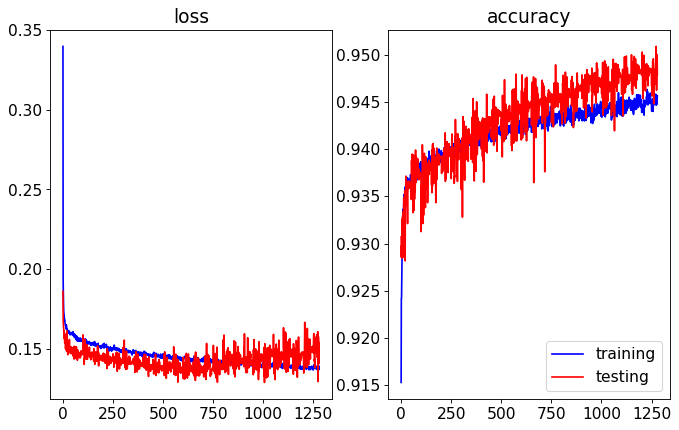

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.85it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


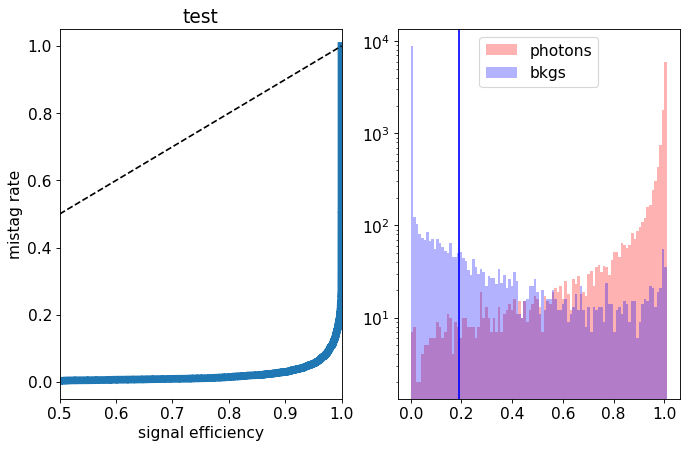

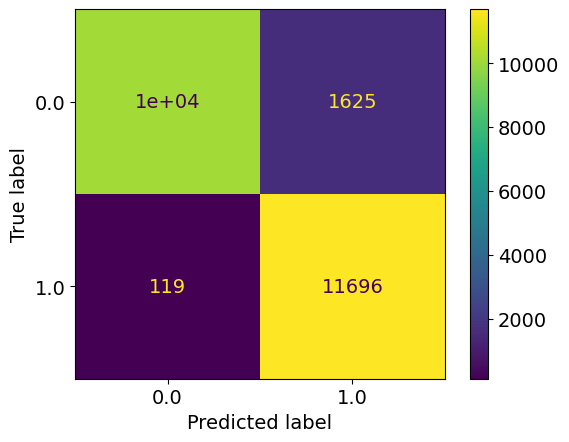

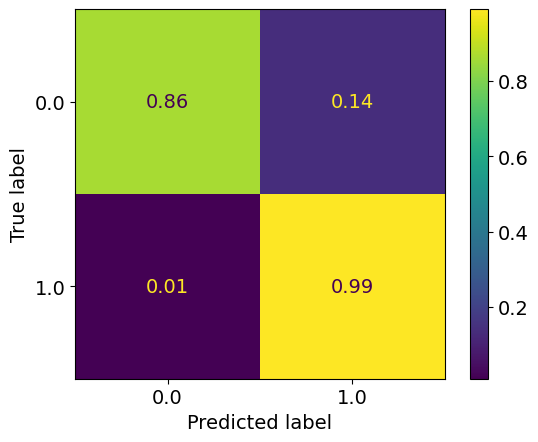

epoch: 1280
Learning rate: 3.456818229618647e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.1367319497712858
train acc: 0.9456404


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.50it/s]


test loss: 0.14663700200617313
test acc: 0.9493391
epoch: 1281
Learning rate: 3.1612378800902485e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.46it/s]


train loss: 0.13651846975657592
train acc: 0.9455979


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.24it/s]


test loss: 0.14933017874136567
test acc: 0.9483616
epoch: 1282
Learning rate: 2.87291428459863e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.13770675426645643
train acc: 0.9455979


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.50it/s]


test loss: 0.14928684029728173
test acc: 0.9479791
epoch: 1283
Learning rate: 2.5929853246526715e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.17it/s]


train loss: 0.137120794433697
train acc: 0.9456298


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.45it/s]


test loss: 0.14442761223763229
test acc: 0.9482341
epoch: 1284
Learning rate: 2.322555751969906e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.1384658845746593
train acc: 0.94520473


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.32it/s]


test loss: 0.1459710353985429
test acc: 0.9487016
epoch: 1285
Learning rate: 2.062692828526193e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1374744721184111
train acc: 0.9451516


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.61it/s]


test loss: 0.14191465862095357
test acc: 0.9502316
epoch: 1286
Learning rate: 1.8144221145602852e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1377724305649472
train acc: 0.9457148


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.36it/s]


test loss: 0.14596381299197675
test acc: 0.9488716
epoch: 1287
Learning rate: 1.5787234211561068e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.13801543163076327
train acc: 0.9453854


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.14752666149288415
test acc: 0.9485741
epoch: 1288
Learning rate: 1.3565269433760352e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.13it/s]


train loss: 0.13755294414842203
train acc: 0.945651


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.76it/s]


test loss: 0.15288759022951126
test acc: 0.9482766
epoch: 1289
Learning rate: 1.1487095892059523e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.13714505798497778
train acc: 0.9455129


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.19it/s]


test loss: 0.15233645252883435
test acc: 0.9481491


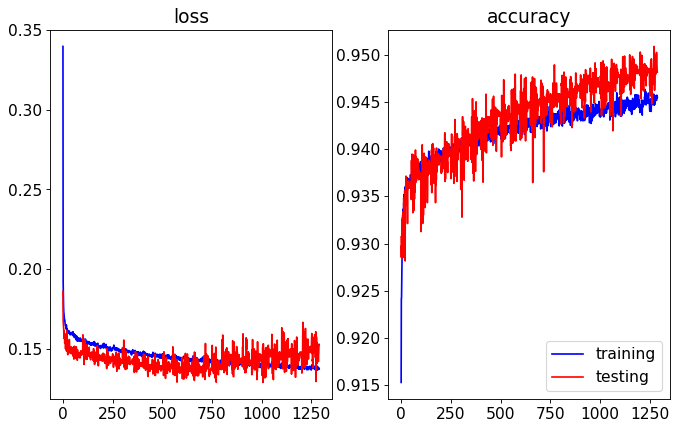

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.64it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


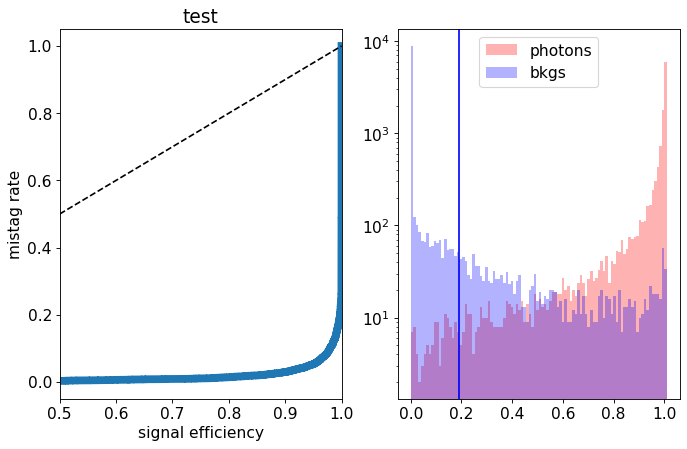

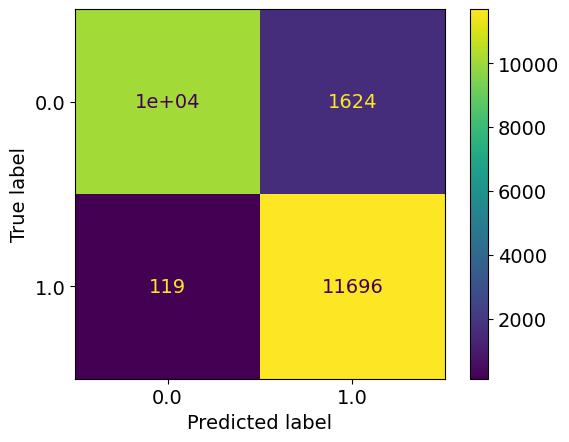

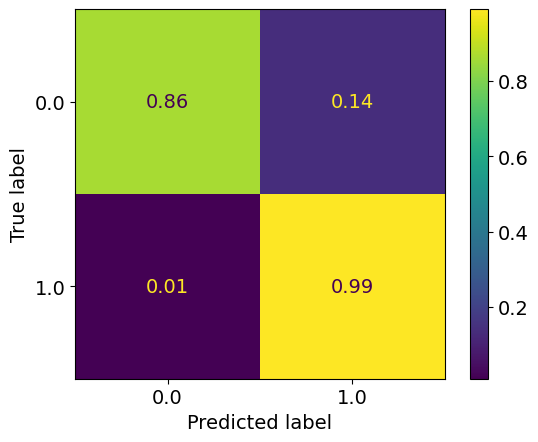

epoch: 1290
Learning rate: 9.560915188000497e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


train loss: 0.1367377223577469
train acc: 0.9452791


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.72it/s]


test loss: 0.15137852858752013
test acc: 0.9483191
epoch: 1291
Learning rate: 7.794329076833946e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.13785083739051393
train acc: 0.94513035


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.54it/s]


test loss: 0.14969296995550394
test acc: 0.9482766
epoch: 1292
Learning rate: 6.194309466864218e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.13581759734138563
train acc: 0.9456404


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.26it/s]


test loss: 0.1499570082873106
test acc: 0.94848907
epoch: 1293
Learning rate: 4.7671709045124306e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.1373611387743312
train acc: 0.94524723


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.25it/s]


test loss: 0.15054363589733838
test acc: 0.9482341
epoch: 1294
Learning rate: 3.5185456536865835e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.13565086250662045
train acc: 0.94561917


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.88it/s]


test loss: 0.14920915123075246
test acc: 0.9481916
epoch: 1295
Learning rate: 2.4533614678090954e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.09it/s]


train loss: 0.13756510264174954
train acc: 0.9455341


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.05it/s]


test loss: 0.14978092033416032
test acc: 0.9483616
epoch: 1296
Learning rate: 1.5758221422252306e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.13711063933979933
train acc: 0.94617164


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.53it/s]


test loss: 0.14930664878338576
test acc: 0.9483616
epoch: 1297
Learning rate: 8.893909237435216e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.1370448491470829
train acc: 0.94593793


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.64it/s]


test loss: 0.1489097887650132
test acc: 0.9484041
epoch: 1298
Learning rate: 3.967768427826979e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.11it/s]


train loss: 0.13650404747314515
train acc: 0.9454704


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.54it/s]


test loss: 0.14882015027105808
test acc: 0.9483191
epoch: 1299
Learning rate: 9.992402206634999e-08


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.13718456181750935
train acc: 0.9456935


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.50it/s]


test loss: 0.15133162178099155
test acc: 0.9483191


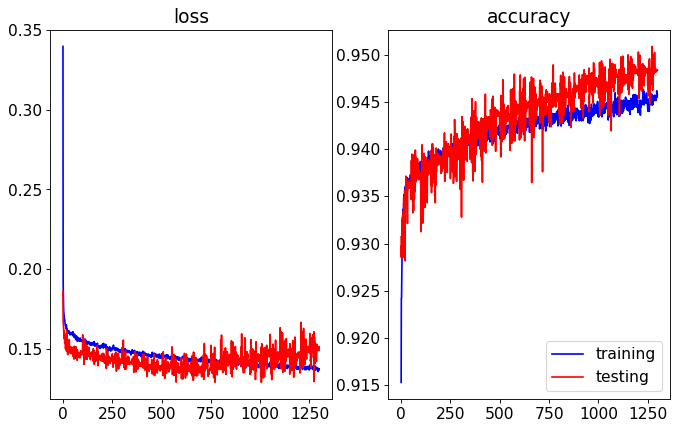

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.52it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


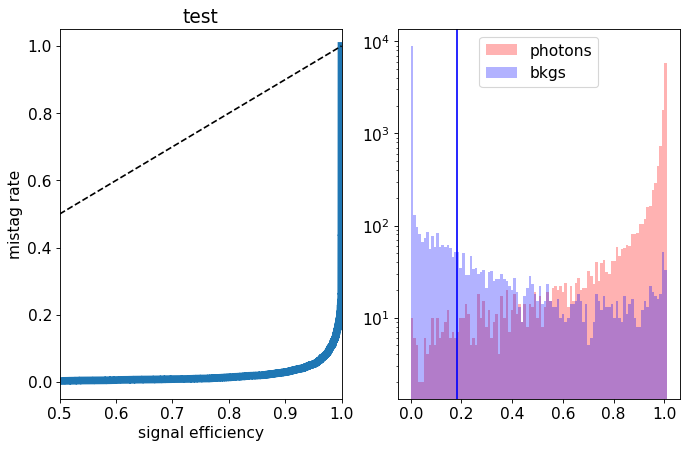

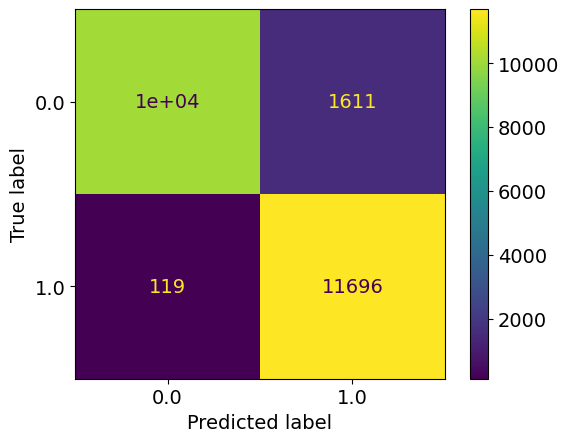

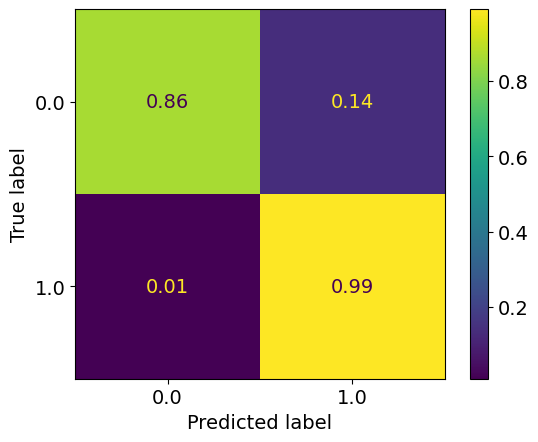

epoch: 1300
Learning rate: 4.004058690165735e-12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.06it/s]


train loss: 0.13873257711055173
train acc: 0.94503474


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.53it/s]


test loss: 0.15660651978105306
test acc: 0.94751155
epoch: 1301
Learning rate: 9.990258887257832e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.1378939595476837
train acc: 0.9451835


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.21it/s]


test loss: 0.15276800636202098
test acc: 0.94742656
epoch: 1302
Learning rate: 9.960823902925949e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.1377156321315249
train acc: 0.94487536


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.85it/s]


test loss: 0.15699461698532105
test acc: 0.9483191
epoch: 1303
Learning rate: 9.911810813034079e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.13767460050286762
train acc: 0.94499224


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.73it/s]


test loss: 0.16374987810850145
test acc: 0.9478516
epoch: 1304
Learning rate: 9.84341304985607e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.13805828224511663
train acc: 0.9455235


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.85it/s]


test loss: 0.14821684192866086
test acc: 0.94959414
epoch: 1305
Learning rate: 9.755900548115223e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.03it/s]


train loss: 0.1384892240166664
train acc: 0.9444397


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.76it/s]


test loss: 0.1363893048837781
test acc: 0.94980663
epoch: 1306
Learning rate: 9.649618679675248e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1393201605529542
train acc: 0.944461


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.84it/s]


test loss: 0.16552672479301692
test acc: 0.94615155
epoch: 1307
Learning rate: 9.524986890515313e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.13681816779504155
train acc: 0.944801


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.72it/s]


test loss: 0.15633341390639544
test acc: 0.9485741
epoch: 1308
Learning rate: 9.382497045368382e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.06it/s]


train loss: 0.138526314240732
train acc: 0.945141


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.66it/s]


test loss: 0.1538910673931241
test acc: 0.9479791
epoch: 1309
Learning rate: 9.222711486555833e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1372645585115548
train acc: 0.9456723


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.77it/s]


test loss: 0.15894793011248112
test acc: 0.94657654


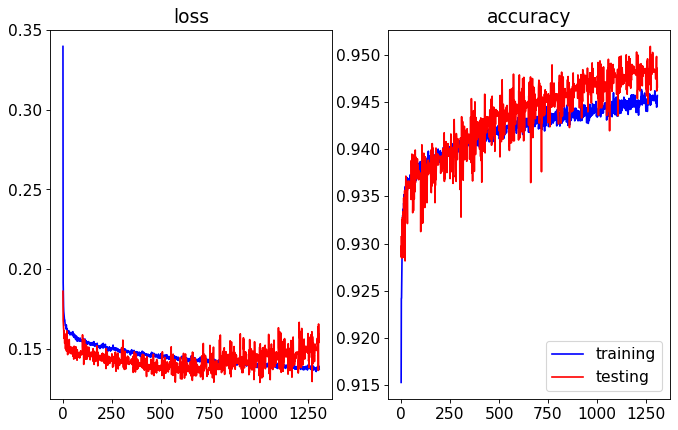

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.70it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


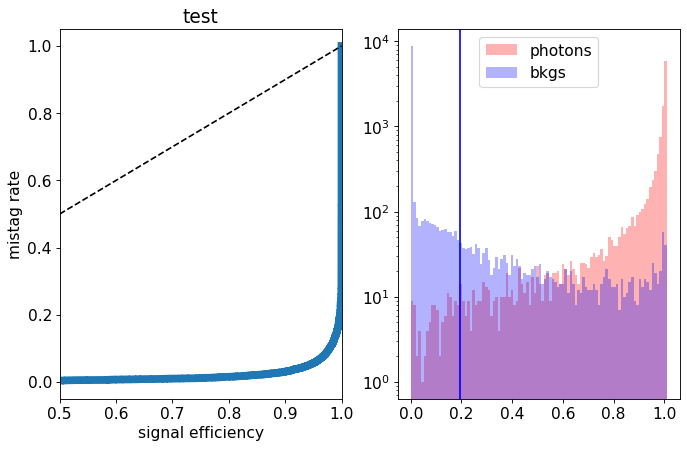

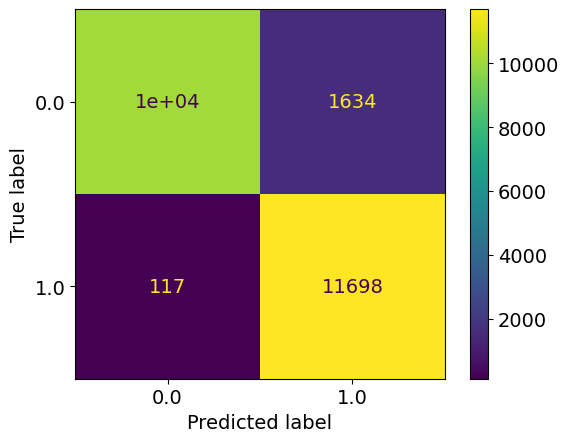

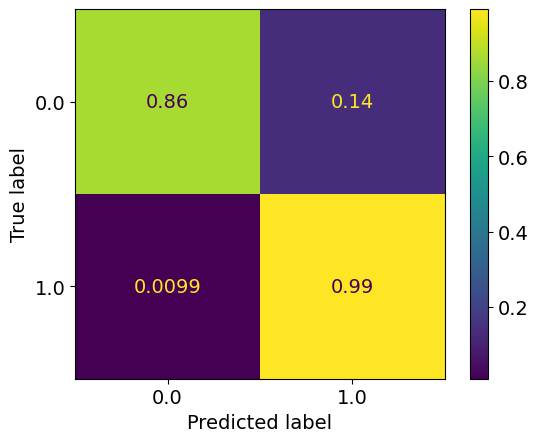

epoch: 1310
Learning rate: 9.046260814679219e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.00it/s]


train loss: 0.1370100639997774
train acc: 0.9454385


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.04it/s]


test loss: 0.14042944610118865
test acc: 0.9498491
epoch: 1311
Learning rate: 8.853841399927796e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.13883182434899033
train acc: 0.9452685


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.92it/s]


test loss: 0.13957571610808372
test acc: 0.9501466
epoch: 1312
Learning rate: 8.646212633823516e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.13765023364003298
train acc: 0.94499224


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.48it/s]


test loss: 0.16851687263697385
test acc: 0.943389
epoch: 1313
Learning rate: 8.424193932249635e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1378169066397248
train acc: 0.9452579


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.62it/s]


test loss: 0.1454605797305703
test acc: 0.9486591
epoch: 1314
Learning rate: 8.188661501590568e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.13761789299500216
train acc: 0.94487536


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.81it/s]


test loss: 0.15882349759340286
test acc: 0.9477666
epoch: 1315
Learning rate: 7.940544880745594e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


train loss: 0.13783465482436927
train acc: 0.945141


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.41it/s]


test loss: 0.16606439389288424
test acc: 0.94589657
epoch: 1316
Learning rate: 7.680823272663487e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.13789279588088868
train acc: 0.9452366


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.70it/s]


test loss: 0.1579741032794118
test acc: 0.94598156
epoch: 1317
Learning rate: 7.410521679875828e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.1375674562184674
train acc: 0.9450135


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.83it/s]


test loss: 0.15324414521455765
test acc: 0.9478941
epoch: 1318
Learning rate: 7.130706859280303e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.46it/s]


train loss: 0.1371307482195508
train acc: 0.9455873


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.23it/s]


test loss: 0.15271274652332067
test acc: 0.9489566
epoch: 1319
Learning rate: 6.842483112138567e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.13634894849957935
train acc: 0.9452791


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.86it/s]


test loss: 0.1546021206304431
test acc: 0.9486591


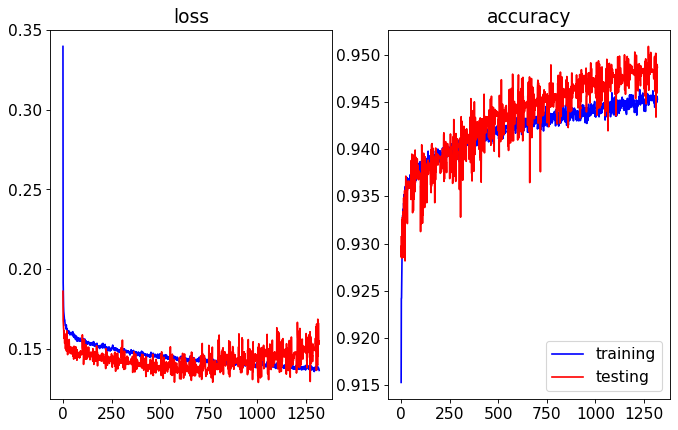

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.28it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


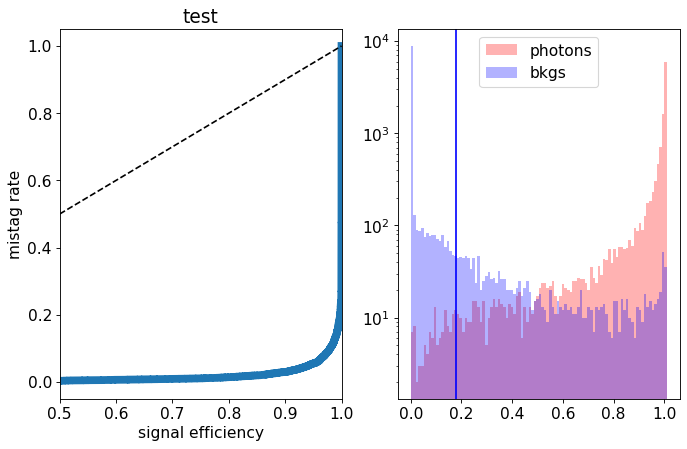

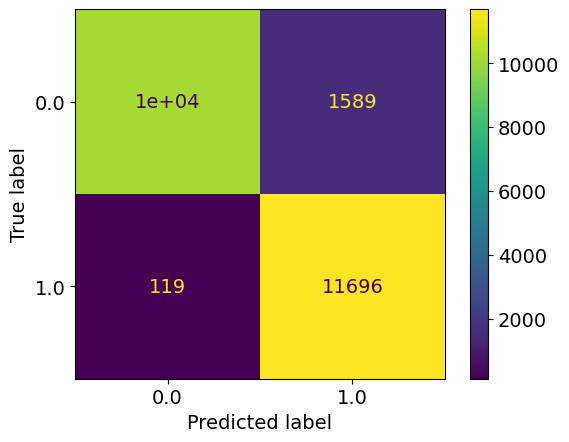

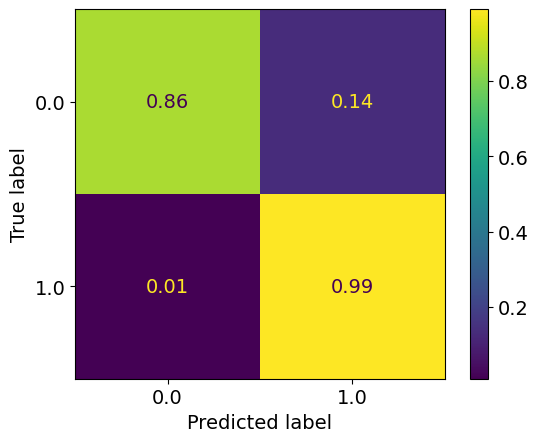

epoch: 1320
Learning rate: 6.546987925903684e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.09it/s]


train loss: 0.13820236503698263
train acc: 0.94524723


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.27it/s]


test loss: 0.15154975857585667
test acc: 0.9487866
epoch: 1321
Learning rate: 6.245387485076818e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.1368557518929433
train acc: 0.9456404


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.90it/s]


test loss: 0.15253668427467346
test acc: 0.9487441
epoch: 1322
Learning rate: 5.9388720688097756e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.13it/s]


train loss: 0.1364962615215095
train acc: 0.94603354


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.16097191125154495
test acc: 0.94717157
epoch: 1323
Learning rate: 5.628651353416987e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.13687799643179413
train acc: 0.9454279


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.79it/s]


test loss: 0.16045305412262678
test acc: 0.9467891
epoch: 1324
Learning rate: 5.3159496383357456e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.1372251323169204
train acc: 0.94520473


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.98it/s]


test loss: 0.14400666505098342
test acc: 0.9489991
epoch: 1325
Learning rate: 5.0020010143756554e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.18it/s]


train loss: 0.13613520183001354
train acc: 0.94601226


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.76it/s]


test loss: 0.16054417043924332
test acc: 0.9483616
epoch: 1326
Learning rate: 4.6880444933259986e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.13668917285598767
train acc: 0.94574666


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.59it/s]


test loss: 0.15474914573132992
test acc: 0.9478941
epoch: 1327
Learning rate: 4.3753191181422696e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.13it/s]


train loss: 0.1363078914820009
train acc: 0.9460229


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.89it/s]


test loss: 0.15790608134120704
test acc: 0.9480641
epoch: 1328
Learning rate: 4.065059073009685e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.13809632011659587
train acc: 0.9454066


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.11it/s]


test loss: 0.15312770642340184
test acc: 0.9483191
epoch: 1329
Learning rate: 3.7584888125820524e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.13610601605503422
train acc: 0.94566166


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.06it/s]


test loss: 0.15012826230376958
test acc: 0.9494666


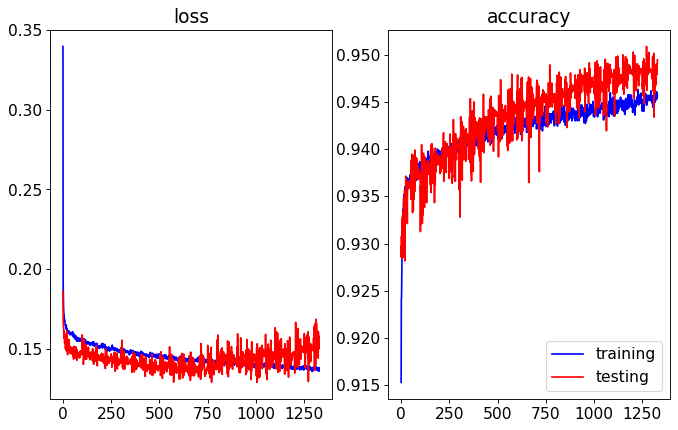

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.55it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


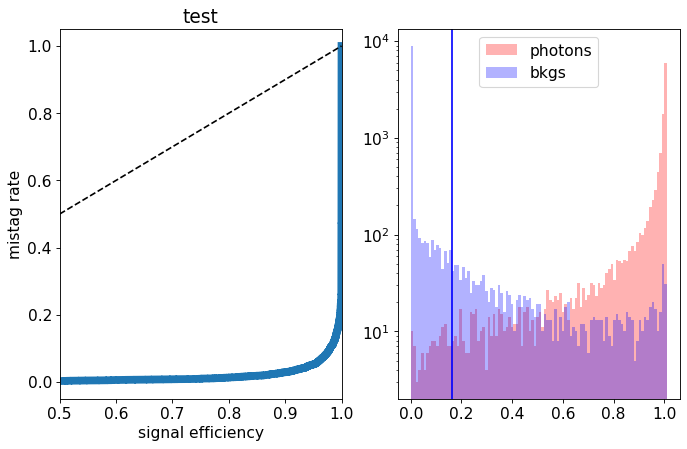

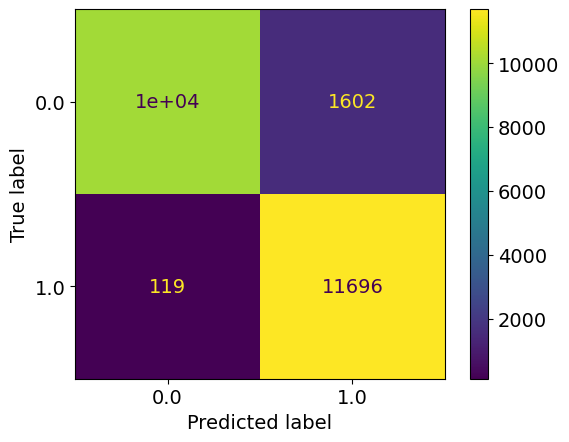

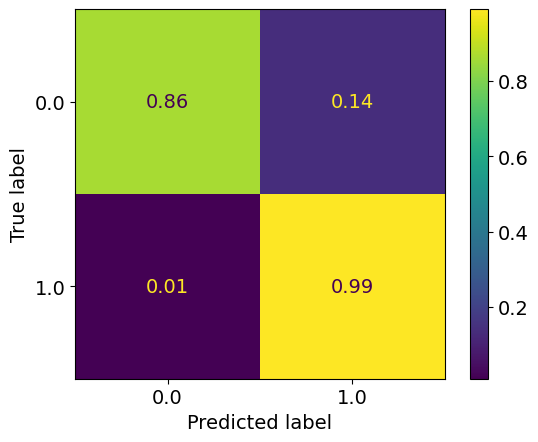

epoch: 1330
Learning rate: 3.456818229618647e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.13789579120411236
train acc: 0.94528973


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.81it/s]


test loss: 0.15911269467324018
test acc: 0.9483191
epoch: 1331
Learning rate: 3.1612378800902485e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.13620158683532363
train acc: 0.9455341


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.09it/s]


test loss: 0.151147617213428
test acc: 0.9490841
epoch: 1332
Learning rate: 2.87291428459863e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.20it/s]


train loss: 0.13673251354770297
train acc: 0.9454598


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.81it/s]


test loss: 0.1602295393124223
test acc: 0.9486166
epoch: 1333
Learning rate: 2.5929853246526715e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.1373466054440304
train acc: 0.945056


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.71it/s]


test loss: 0.15446126144379377
test acc: 0.9476391
epoch: 1334
Learning rate: 2.322555751969906e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.13686589645162509
train acc: 0.94588476


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.15it/s]


test loss: 0.15147456750273705
test acc: 0.9485316
epoch: 1335
Learning rate: 2.062692828526193e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.59it/s]


train loss: 0.13715451025659112
train acc: 0.9453004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.70it/s]


test loss: 0.15106295980513096
test acc: 0.9493391
epoch: 1336
Learning rate: 1.8144221145602852e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.57it/s]


train loss: 0.1373503174466692
train acc: 0.9454066


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.60it/s]


test loss: 0.15020459648221732
test acc: 0.9485316
epoch: 1337
Learning rate: 1.5787234211561068e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.26it/s]


train loss: 0.1363546419770095
train acc: 0.94583166


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.22it/s]


test loss: 0.15245952010154723
test acc: 0.9487866
epoch: 1338
Learning rate: 1.3565269433760352e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.60it/s]


train loss: 0.1370900333592087
train acc: 0.9460973


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.71it/s]


test loss: 0.15082239937037228
test acc: 0.9492966
epoch: 1339
Learning rate: 1.1487095892059523e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.13723427451150433
train acc: 0.94582105


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.16it/s]


test loss: 0.1553885918110609
test acc: 0.9486591


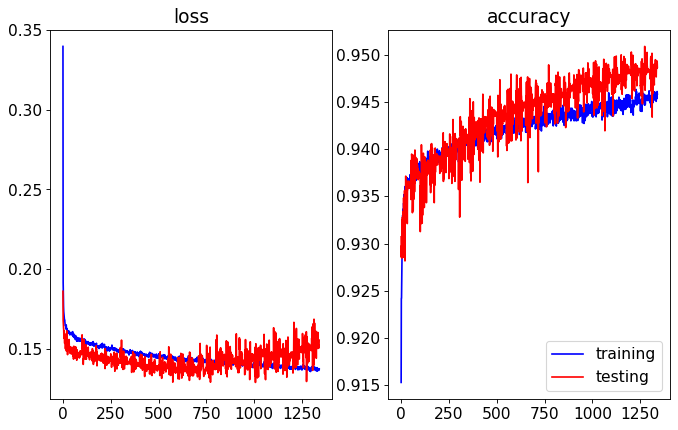

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.18it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


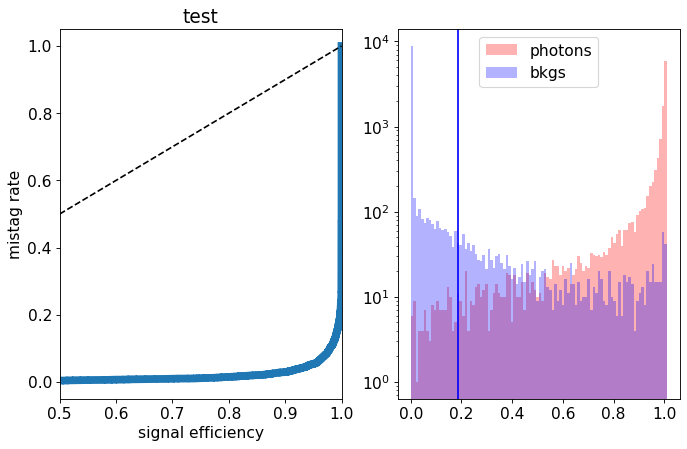

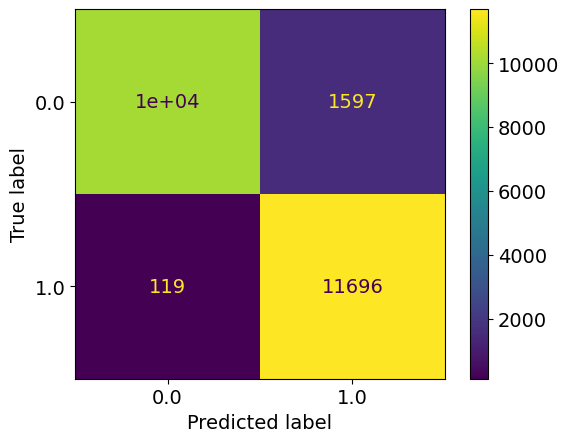

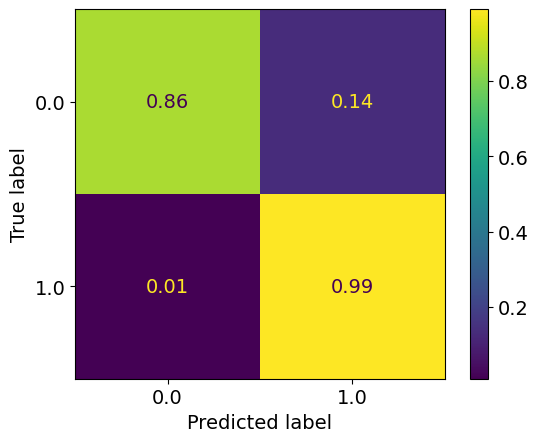

epoch: 1340
Learning rate: 9.560915188000497e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.57it/s]


train loss: 0.1362076671734737
train acc: 0.9461079


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.17it/s]


test loss: 0.15238599609583617
test acc: 0.9487441
epoch: 1341
Learning rate: 7.794329076833946e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.57it/s]


train loss: 0.1370322379242083
train acc: 0.94578916


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.15it/s]


test loss: 0.15251013189554213
test acc: 0.9490416
epoch: 1342
Learning rate: 6.194309466864218e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.25it/s]


train loss: 0.13611001630497585
train acc: 0.94566166


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.22it/s]


test loss: 0.15641934536397456
test acc: 0.9485741
epoch: 1343
Learning rate: 4.7671709045124306e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.58it/s]


train loss: 0.1360618915812225
train acc: 0.94578916


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.20it/s]


test loss: 0.1556206565350294
test acc: 0.9486591
epoch: 1344
Learning rate: 3.5185456536865835e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.26it/s]


train loss: 0.13695558929329466
train acc: 0.9464586


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.46it/s]


test loss: 0.15573165975511075
test acc: 0.9481066
epoch: 1345
Learning rate: 2.4533614678090954e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.45it/s]


train loss: 0.13740221534375172
train acc: 0.9453748


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.10it/s]


test loss: 0.1551926203072071
test acc: 0.9483616
epoch: 1346
Learning rate: 1.5758221422252306e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.58it/s]


train loss: 0.1360884465419563
train acc: 0.9461504


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.21it/s]


test loss: 0.1563043102622032
test acc: 0.9483616
epoch: 1347
Learning rate: 8.893909237435216e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.28it/s]


train loss: 0.13636267004878658
train acc: 0.94577855


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.12it/s]


test loss: 0.15628513135015965
test acc: 0.9483191
epoch: 1348
Learning rate: 3.967768427826979e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.60it/s]


train loss: 0.13703784318106949
train acc: 0.9455341


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.26it/s]


test loss: 0.15631718412041665
test acc: 0.9482766
epoch: 1349
Learning rate: 9.992402206634999e-08


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.26it/s]


train loss: 0.1352350351632021
train acc: 0.9461079


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.34it/s]


test loss: 0.1584942640736699
test acc: 0.9482766


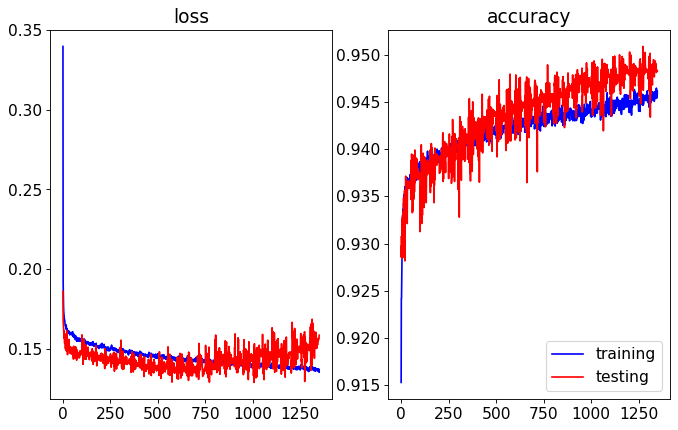

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.35it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


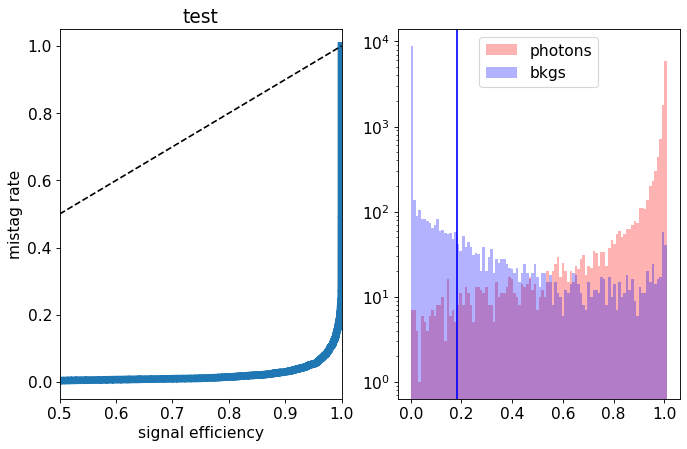

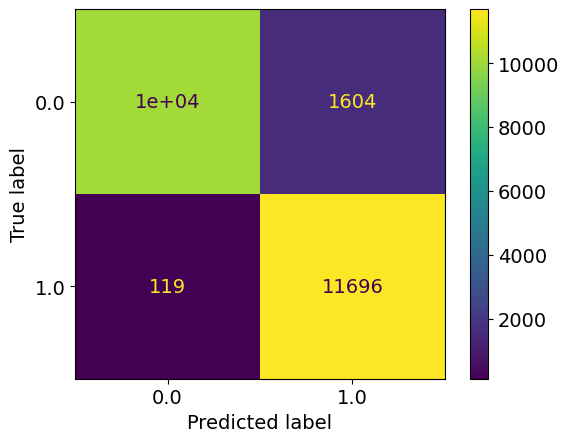

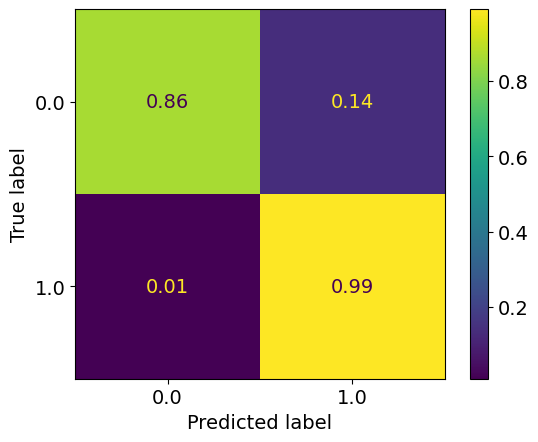

epoch: 1350
Learning rate: 4.004058690165735e-12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.60it/s]


train loss: 0.13812538995674462
train acc: 0.9453535


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.33it/s]


test loss: 0.1505873968824744
test acc: 0.94746906
epoch: 1351
Learning rate: 9.990258887257832e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.63it/s]


train loss: 0.13804683075019508
train acc: 0.9446735


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.31it/s]


test loss: 0.1459090456366539
test acc: 0.94717157
epoch: 1352
Learning rate: 9.960823902925949e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.55it/s]


train loss: 0.1367933783371737
train acc: 0.9452154


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.37it/s]


test loss: 0.14032218120992185
test acc: 0.94959414
epoch: 1353
Learning rate: 9.911810813034079e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.13731839787808192
train acc: 0.945481


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.69it/s]


test loss: 0.16447016093879938
test acc: 0.9480216
epoch: 1354
Learning rate: 9.84341304985607e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.24it/s]


train loss: 0.13739744630778672
train acc: 0.9455129


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.04it/s]


test loss: 0.14779531843960286
test acc: 0.9493816
epoch: 1355
Learning rate: 9.755900548115223e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.55it/s]


train loss: 0.1378423171533141
train acc: 0.9454385


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.44it/s]


test loss: 0.15831921622157097
test acc: 0.9487016
epoch: 1356
Learning rate: 9.649618679675248e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.54it/s]


train loss: 0.1365177687376168
train acc: 0.9453535


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.41it/s]


test loss: 0.16294238790869714
test acc: 0.9486166
epoch: 1357
Learning rate: 9.524986890515313e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.17it/s]


train loss: 0.13666041707916624
train acc: 0.94561917


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.81it/s]


test loss: 0.14455054942518472
test acc: 0.9487866
epoch: 1358
Learning rate: 9.382497045368382e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.13803818404294882
train acc: 0.945481


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.94it/s]


test loss: 0.1312182890251279
test acc: 0.9512516
new best acc: 0.9512516
epoch: 1359
Learning rate: 9.222711486555833e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.17it/s]


train loss: 0.1360982639394748
train acc: 0.94604415


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.85it/s]


test loss: 0.1487695114687085
test acc: 0.94980663


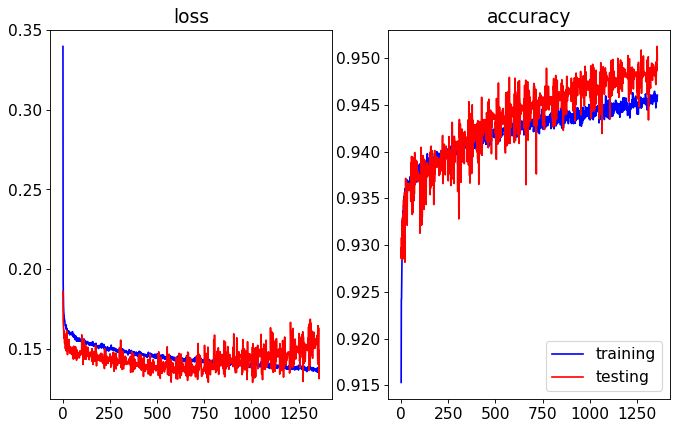

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.95it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


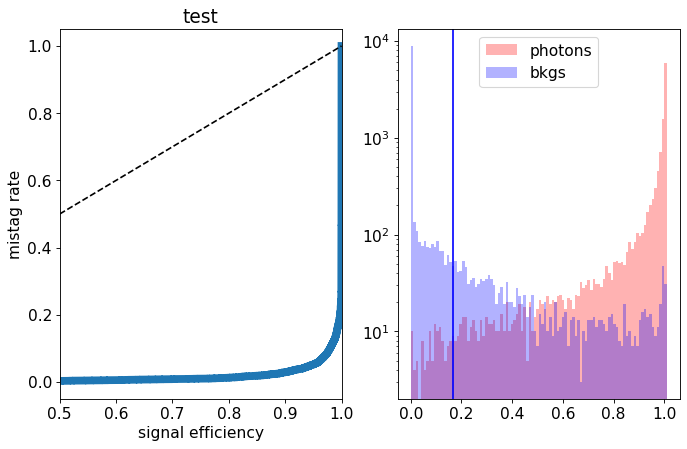

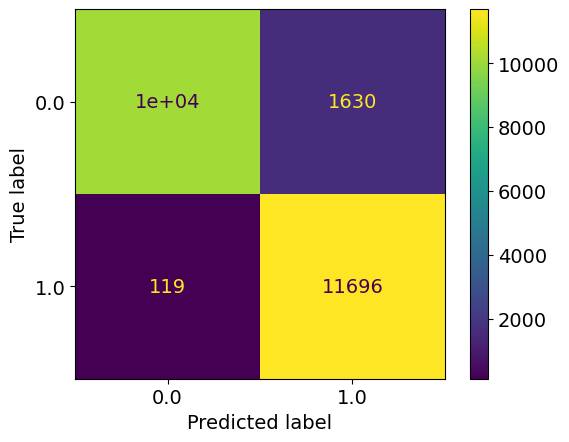

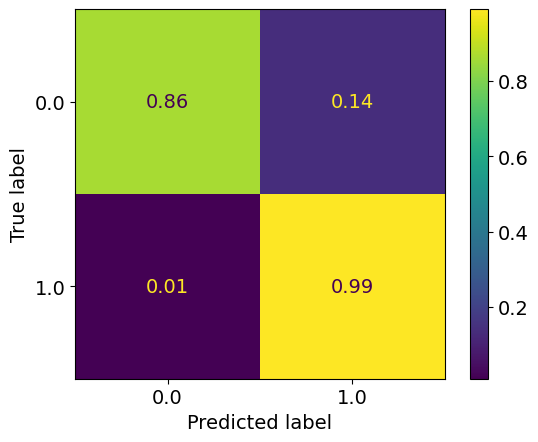

epoch: 1360
Learning rate: 9.046260814679219e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1383007698377986
train acc: 0.94500285


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.11it/s]


test loss: 0.15814553741365672
test acc: 0.9482766
epoch: 1361
Learning rate: 8.853841399927796e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.02it/s]


train loss: 0.1379533991407437
train acc: 0.9455341


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.17it/s]


test loss: 0.1518045083619654
test acc: 0.9482766
epoch: 1362
Learning rate: 8.646212633823516e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.13610016203420178
train acc: 0.94493914


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.74it/s]


test loss: 0.15646491423249245
test acc: 0.94751155
epoch: 1363
Learning rate: 8.424193932249635e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.13679764234715966
train acc: 0.9457254


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.52it/s]


test loss: 0.15958008226007223
test acc: 0.9487441
epoch: 1364
Learning rate: 8.188661501590568e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  4.94it/s]


train loss: 0.13660581727885895
train acc: 0.94517285


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.51it/s]


test loss: 0.1517855128273368
test acc: 0.9490416
epoch: 1365
Learning rate: 7.940544880745594e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.13668062637566
train acc: 0.94557667


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.30it/s]


test loss: 0.14834529031068086
test acc: 0.9487016
epoch: 1366
Learning rate: 7.680823272663487e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.46it/s]


train loss: 0.13646202842900707
train acc: 0.94561917


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.23it/s]


test loss: 0.1427921786904335
test acc: 0.94959414
epoch: 1367
Learning rate: 7.410521679875828e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.13629254727226914
train acc: 0.94601226


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.46it/s]


test loss: 0.13581208530813454
test acc: 0.94959414
epoch: 1368
Learning rate: 7.130706859280303e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.45it/s]


train loss: 0.1363126915541424
train acc: 0.9465011


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.08it/s]


test loss: 0.14941270146518945
test acc: 0.9488716
epoch: 1369
Learning rate: 6.842483112138567e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  4.98it/s]


train loss: 0.13559761382402127
train acc: 0.94681984


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.89it/s]


test loss: 0.15782516449689865
test acc: 0.9482341


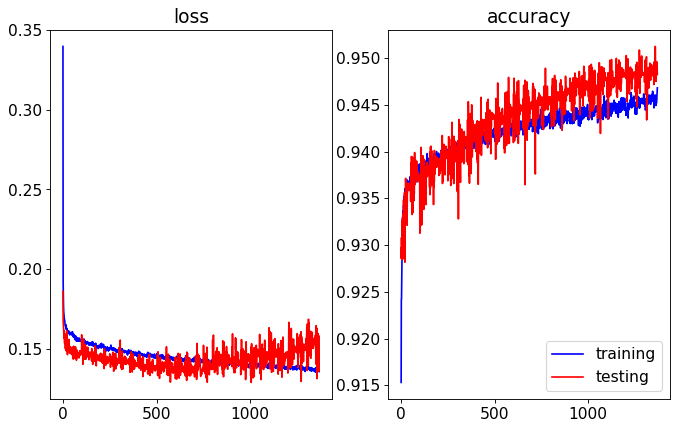

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.18it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


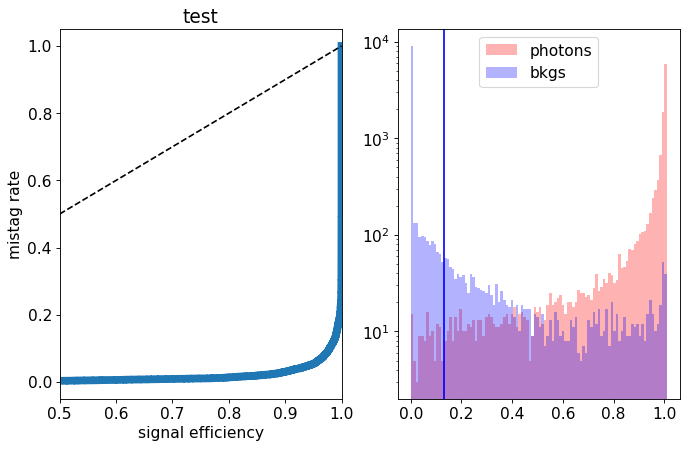

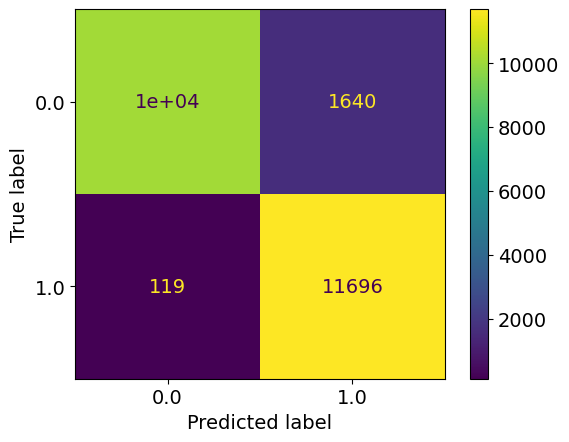

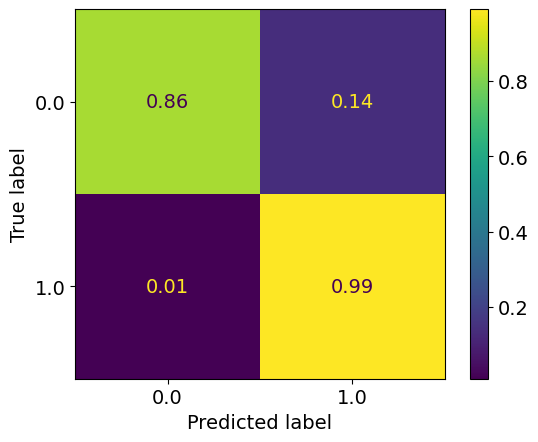

epoch: 1370
Learning rate: 6.546987925903684e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.46it/s]


train loss: 0.13563985173489637
train acc: 0.94570416


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.45it/s]


test loss: 0.1543483456596732
test acc: 0.9479791
epoch: 1371
Learning rate: 6.245387485076818e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


train loss: 0.13640901104659792
train acc: 0.9455554


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.96it/s]


test loss: 0.15821566730737685
test acc: 0.9485741
epoch: 1372
Learning rate: 5.9388720688097756e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.54it/s]


train loss: 0.13624463277827403
train acc: 0.94582105


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.04it/s]


test loss: 0.14358863458037377
test acc: 0.9492541
epoch: 1373
Learning rate: 5.628651353416987e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.56it/s]


train loss: 0.13656956854329746
train acc: 0.9457148


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.16it/s]


test loss: 0.16365675386041403
test acc: 0.9478091
epoch: 1374
Learning rate: 5.3159496383357456e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.17it/s]


train loss: 0.13669356613591976
train acc: 0.94587415


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.21it/s]


test loss: 0.14809612669050692
test acc: 0.94972163
epoch: 1375
Learning rate: 5.0020010143756554e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.58it/s]


train loss: 0.13573395000521543
train acc: 0.94679856


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.27it/s]


test loss: 0.15810407046228647
test acc: 0.9480641
epoch: 1376
Learning rate: 4.6880444933259986e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.28it/s]


train loss: 0.13615678843988735
train acc: 0.9456935


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.84it/s]


test loss: 0.17651998531073332
test acc: 0.9469591
epoch: 1377
Learning rate: 4.3753191181422696e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.59it/s]


train loss: 0.1370289602856727
train acc: 0.9460973


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.24it/s]


test loss: 0.14758257009088993
test acc: 0.9494241
epoch: 1378
Learning rate: 4.065059073009685e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.58it/s]


train loss: 0.13591950154228574
train acc: 0.9461398


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.83it/s]


test loss: 0.16340194679796696
test acc: 0.94729906
epoch: 1379
Learning rate: 3.7584888125820524e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.23it/s]


train loss: 0.13579993932300313
train acc: 0.94595915


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.10it/s]


test loss: 0.1591245647519827
test acc: 0.9487016


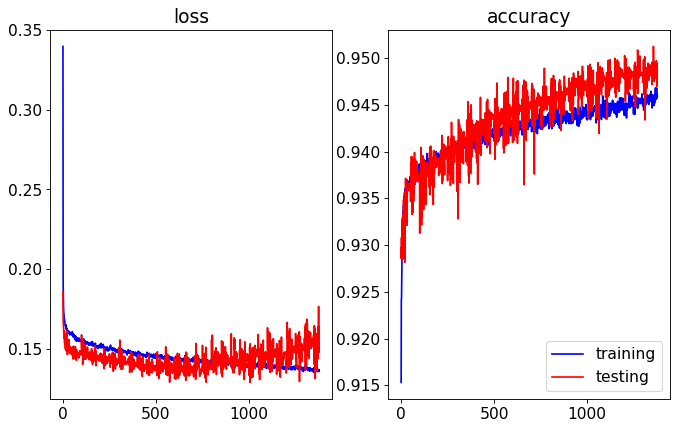

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.15it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


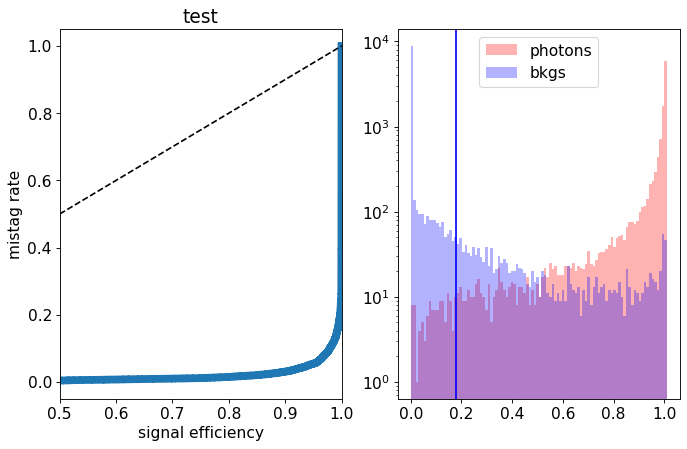

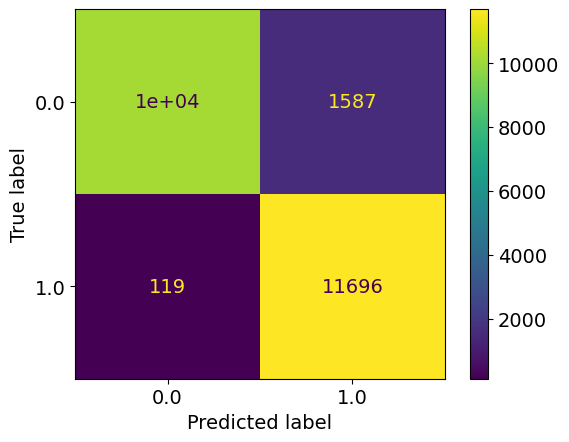

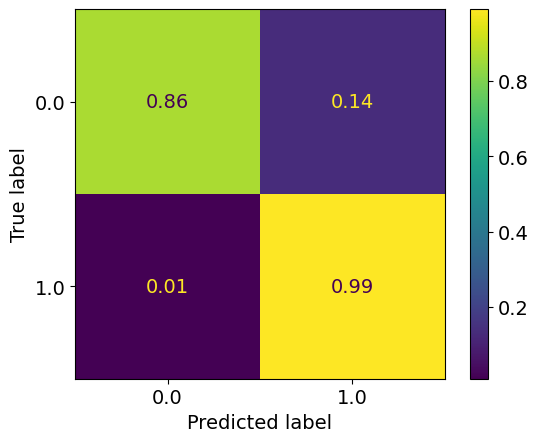

epoch: 1380
Learning rate: 3.456818229618647e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.60it/s]


train loss: 0.13537911268746017
train acc: 0.94579977


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.19it/s]


test loss: 0.1563864082098007
test acc: 0.9487866
epoch: 1381
Learning rate: 3.1612378800902485e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.23it/s]


train loss: 0.13610155192340256
train acc: 0.94603354


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.83it/s]


test loss: 0.15932132210582495
test acc: 0.9471291
epoch: 1382
Learning rate: 2.87291428459863e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.56it/s]


train loss: 0.13673387377694912
train acc: 0.9460973


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.13it/s]


test loss: 0.15191068612039088
test acc: 0.9486166
epoch: 1383
Learning rate: 2.5929853246526715e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.56it/s]


train loss: 0.13562722376007944
train acc: 0.9460229


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.01it/s]


test loss: 0.16072190478444098
test acc: 0.9486591
epoch: 1384
Learning rate: 2.322555751969906e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.55it/s]


train loss: 0.13605619530389262
train acc: 0.9456723


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.58it/s]


test loss: 0.16022933814674617
test acc: 0.9478516
epoch: 1385
Learning rate: 2.062692828526193e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.1353498905612405
train acc: 0.94587415


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.98it/s]


test loss: 0.163231704197824
test acc: 0.9481916
epoch: 1386
Learning rate: 1.8144221145602852e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.05it/s]


train loss: 0.13572238917183724
train acc: 0.94661796


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.59it/s]


test loss: 0.16039272174239158
test acc: 0.9492541
epoch: 1387
Learning rate: 1.5787234211561068e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.1360675998174461
train acc: 0.9464798


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.69it/s]


test loss: 0.1560569278895855
test acc: 0.9489566
epoch: 1388
Learning rate: 1.3565269433760352e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.13623456163391187
train acc: 0.9463204


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.62it/s]


test loss: 0.15911904256790876
test acc: 0.9487866
epoch: 1389
Learning rate: 1.1487095892059523e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.43it/s]


train loss: 0.1370138554436386
train acc: 0.9462885


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.21it/s]


test loss: 0.15632639219984412
test acc: 0.9485316


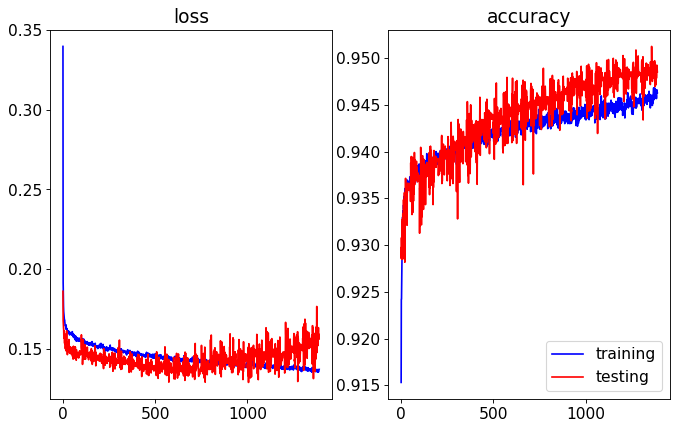

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.29it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


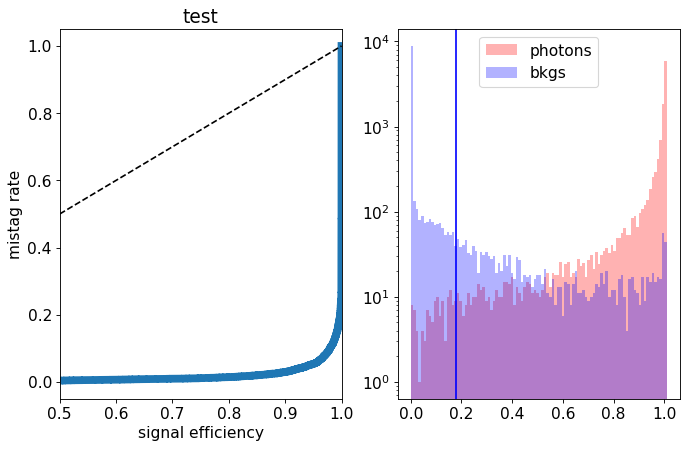

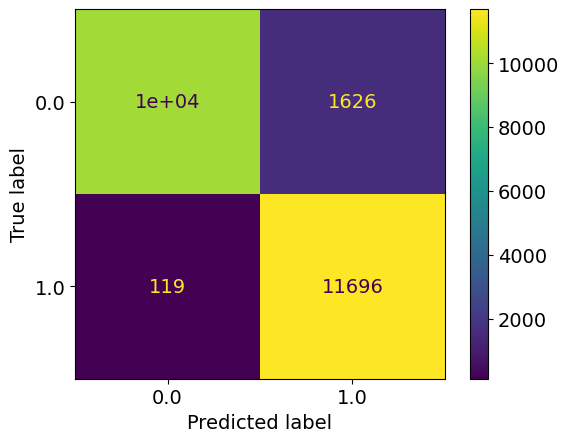

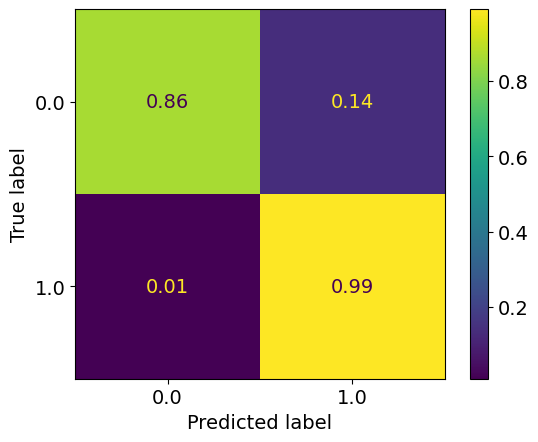

epoch: 1390
Learning rate: 9.560915188000497e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.42it/s]


train loss: 0.13535350917061423
train acc: 0.94695795


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 13.74it/s]


test loss: 0.15876364316791297
test acc: 0.9491691
epoch: 1391
Learning rate: 7.794329076833946e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:32<00:00,  4.85it/s]


train loss: 0.1366936381265616
train acc: 0.9463629


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.69it/s]


test loss: 0.1570604622364044
test acc: 0.94848907
epoch: 1392
Learning rate: 6.194309466864218e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.38it/s]


train loss: 0.13648974719890364
train acc: 0.94607604


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.00it/s]


test loss: 0.15024092886596918
test acc: 0.9489991
epoch: 1393
Learning rate: 4.7671709045124306e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  4.91it/s]


train loss: 0.1350275340733255
train acc: 0.94679856


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.22it/s]


test loss: 0.15071651823818683
test acc: 0.9492116
epoch: 1394
Learning rate: 3.5185456536865835e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.13605801590309022
train acc: 0.94621414


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.16it/s]


test loss: 0.15265124943107367
test acc: 0.9491691
epoch: 1395
Learning rate: 2.4533614678090954e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.54it/s]


train loss: 0.13459854511318692
train acc: 0.9464586


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.91it/s]


test loss: 0.15316622350364922
test acc: 0.9493391
epoch: 1396
Learning rate: 1.5758221422252306e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.07it/s]


train loss: 0.13533648929208708
train acc: 0.94666046


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.70it/s]


test loss: 0.1520937766879797
test acc: 0.9492116
epoch: 1397
Learning rate: 8.893909237435216e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.1367612919135458
train acc: 0.9457148


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.82it/s]


test loss: 0.15369310472160577
test acc: 0.9490841
epoch: 1398
Learning rate: 3.967768427826979e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.07it/s]


train loss: 0.13566015798384976
train acc: 0.9462885


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.29it/s]


test loss: 0.15154410861432552
test acc: 0.9490416
epoch: 1399
Learning rate: 9.992402206634999e-08


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:27<00:00,  5.62it/s]


train loss: 0.13456341534093685
train acc: 0.94681984


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.30it/s]


test loss: 0.15242323875427247
test acc: 0.9490416


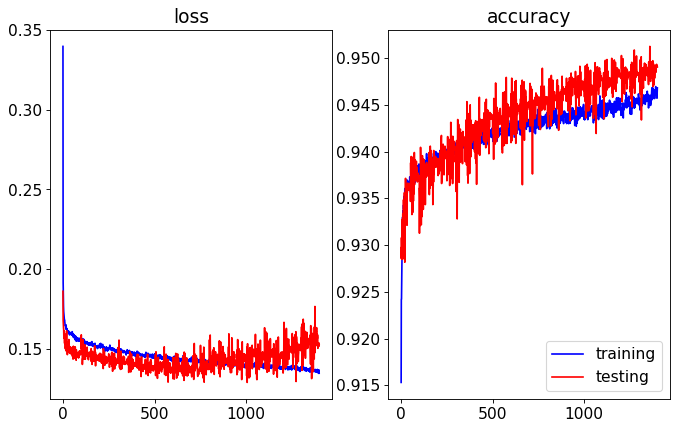

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.30it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


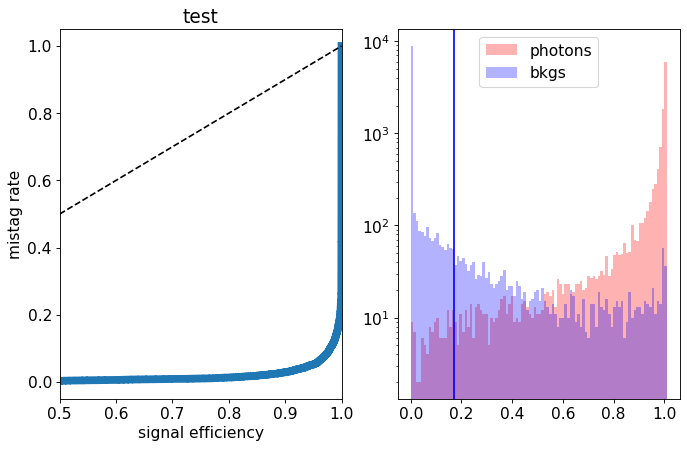

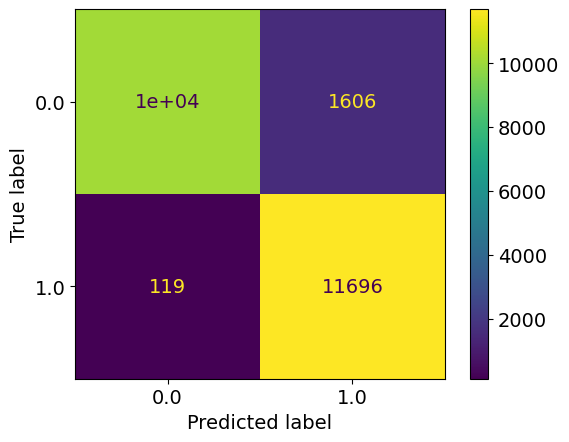

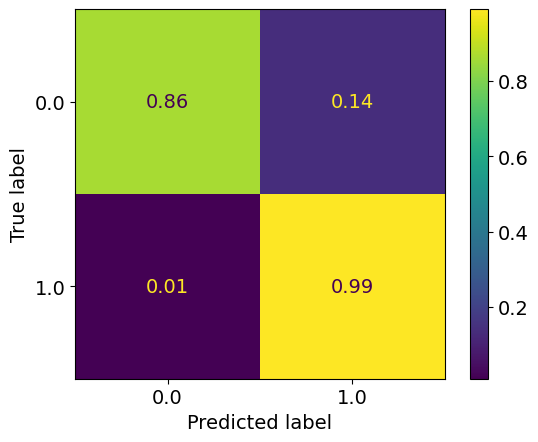

epoch: 1400
Learning rate: 4.004058690165735e-12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.61it/s]


train loss: 0.13665849971733277
train acc: 0.9456829


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.22it/s]


test loss: 0.15441944729536772
test acc: 0.9491691
epoch: 1401
Learning rate: 9.990258887257832e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.58it/s]


train loss: 0.13786117775235207
train acc: 0.94488597


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.19it/s]


test loss: 0.1423916148021817
test acc: 0.95078415
epoch: 1402
Learning rate: 9.960823902925949e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.59it/s]


train loss: 0.13710960508531825
train acc: 0.94524723


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.94it/s]


test loss: 0.14345562178641558
test acc: 0.9500191
epoch: 1403
Learning rate: 9.911810813034079e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.04it/s]


train loss: 0.1385309907850946
train acc: 0.94477975


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.23it/s]


test loss: 0.1404279712587595
test acc: 0.9489566
epoch: 1404
Learning rate: 9.84341304985607e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.41it/s]


train loss: 0.1366783288918483
train acc: 0.94583166


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.12it/s]


test loss: 0.13142989985644818
test acc: 0.95184666
new best acc: 0.95184666
epoch: 1405
Learning rate: 9.755900548115223e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.1361480342449656
train acc: 0.94579977


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.27it/s]


test loss: 0.14057918060570956
test acc: 0.94972163
epoch: 1406
Learning rate: 9.649618679675248e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.43it/s]


train loss: 0.13624966206254474
train acc: 0.94608665


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.25it/s]


test loss: 0.14904414173215627
test acc: 0.9488291
epoch: 1407
Learning rate: 9.524986890515313e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.13559684750570614
train acc: 0.94596976


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.86it/s]


test loss: 0.14939240086823702
test acc: 0.9481916
epoch: 1408
Learning rate: 9.382497045368382e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.19it/s]


train loss: 0.1372487529827531
train acc: 0.9459804


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.77it/s]


test loss: 0.16668929494917392
test acc: 0.94746906
epoch: 1409
Learning rate: 9.222711486555833e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.13757829985041528
train acc: 0.9454704


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.69it/s]


test loss: 0.15323460288345814
test acc: 0.9489141


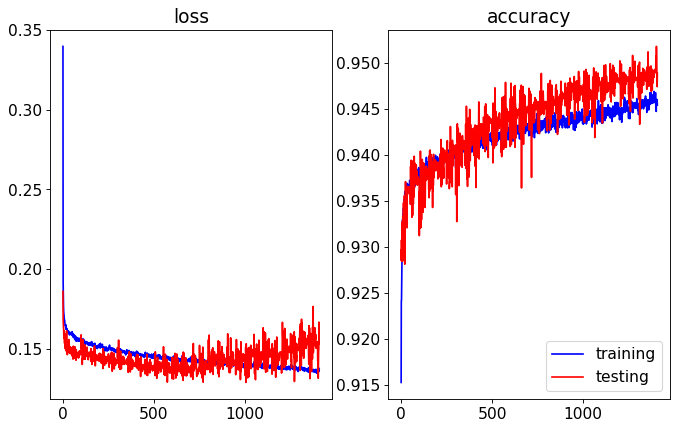

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.85it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


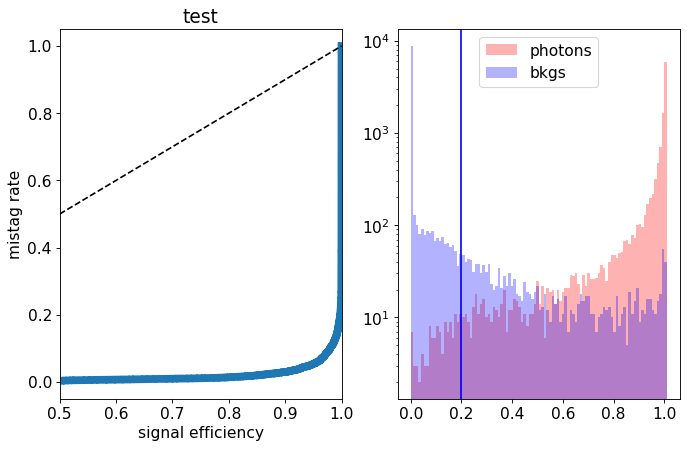

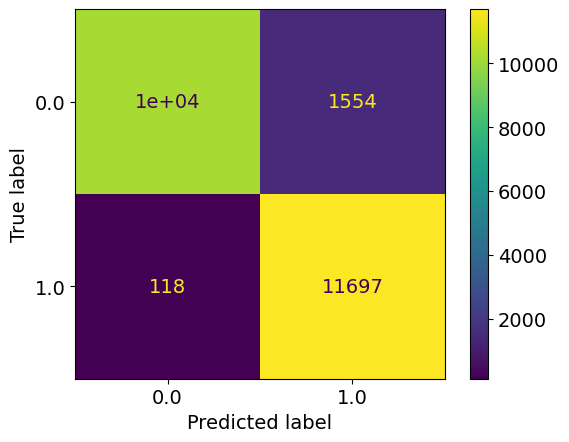

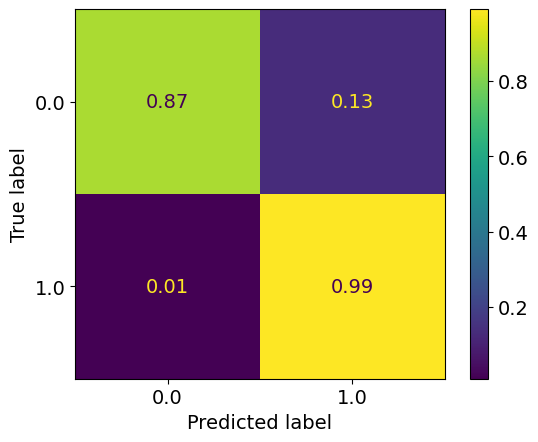

epoch: 1410
Learning rate: 9.046260814679219e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.13605267369443444
train acc: 0.94620353


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.01it/s]


test loss: 0.1445286948233843
test acc: 0.9481916
epoch: 1411
Learning rate: 8.853841399927796e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.54it/s]


train loss: 0.13664191600623404
train acc: 0.9454173


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.79it/s]


test loss: 0.16031818464398384
test acc: 0.9478941
epoch: 1412
Learning rate: 8.646212633823516e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.43it/s]


train loss: 0.13643422267239563
train acc: 0.9464904


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.48it/s]


test loss: 0.16579131837934255
test acc: 0.9470866
epoch: 1413
Learning rate: 8.424193932249635e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  4.99it/s]


train loss: 0.136095408516325
train acc: 0.94603354


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.46it/s]


test loss: 0.17534146066755057
test acc: 0.94729906
epoch: 1414
Learning rate: 8.188661501590568e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.41it/s]


train loss: 0.13553521255399012
train acc: 0.9458529


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.07it/s]


test loss: 0.16015165261924266
test acc: 0.9479791
epoch: 1415
Learning rate: 7.940544880745594e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  4.93it/s]


train loss: 0.13586798571287448
train acc: 0.94600165


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.88it/s]


test loss: 0.15846494324505328
test acc: 0.9485741
epoch: 1416
Learning rate: 7.680823272663487e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.13609184690152004
train acc: 0.9460654


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.78it/s]


test loss: 0.1659596910700202
test acc: 0.9480641
epoch: 1417
Learning rate: 7.410521679875828e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.13517280796151251
train acc: 0.94616103


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.81it/s]


test loss: 0.1579338237643242
test acc: 0.94729906
epoch: 1418
Learning rate: 7.130706859280303e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  4.98it/s]


train loss: 0.13791015668279805
train acc: 0.9454385


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.22it/s]


test loss: 0.16058031730353833
test acc: 0.9477666
epoch: 1419
Learning rate: 6.842483112138567e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.44it/s]


train loss: 0.13617472246194343
train acc: 0.9462779


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.85it/s]


test loss: 0.1473151057958603
test acc: 0.9489566


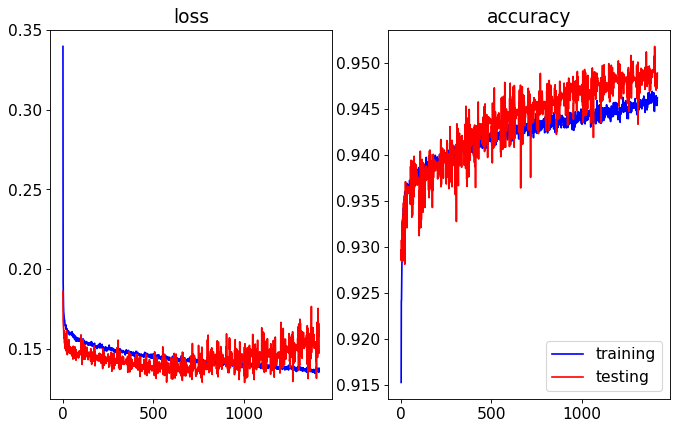

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.13it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


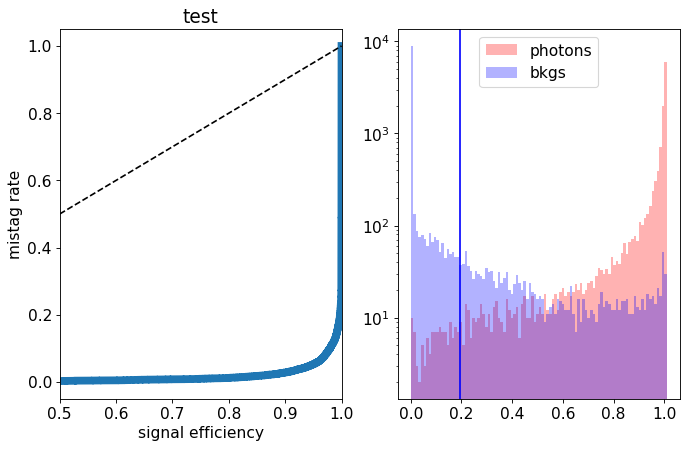

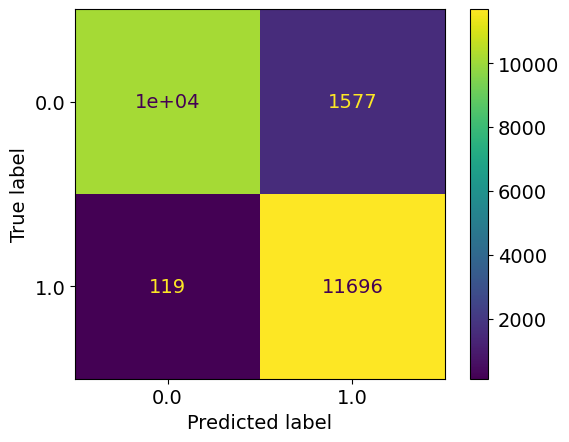

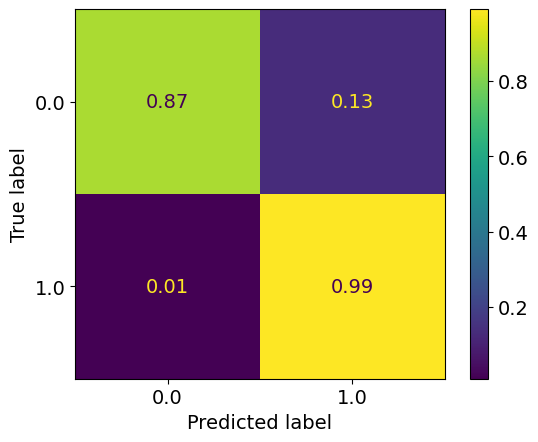

epoch: 1420
Learning rate: 6.546987925903684e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.05it/s]


train loss: 0.13581840641749132
train acc: 0.9462885


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.05it/s]


test loss: 0.1666675081476569
test acc: 0.94657654
epoch: 1421
Learning rate: 6.245387485076818e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.13666070077070006
train acc: 0.9461929


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.00it/s]


test loss: 0.14657800868153573
test acc: 0.9494666
epoch: 1422
Learning rate: 5.9388720688097756e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.47it/s]


train loss: 0.13620613619780084
train acc: 0.94574666


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.41it/s]


test loss: 0.15153189953416585
test acc: 0.9490416
epoch: 1423
Learning rate: 5.628651353416987e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.02it/s]


train loss: 0.1356321475972795
train acc: 0.9464586


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.98it/s]


test loss: 0.15288047399371862
test acc: 0.9485316
epoch: 1424
Learning rate: 5.3159496383357456e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.45it/s]


train loss: 0.13503764180620764
train acc: 0.9465436


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.96it/s]


test loss: 0.16088949460536242
test acc: 0.9481491
epoch: 1425
Learning rate: 5.0020010143756554e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.13576657419941227
train acc: 0.9457679


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.88it/s]


test loss: 0.14095917474478484
test acc: 0.9493816
epoch: 1426
Learning rate: 4.6880444933259986e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.44it/s]


train loss: 0.13655438653792545
train acc: 0.94611853


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.94it/s]


test loss: 0.15331431310623883
test acc: 0.9485316
epoch: 1427
Learning rate: 4.3753191181422696e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.46it/s]


train loss: 0.13537465467764315
train acc: 0.94671357


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.59it/s]


test loss: 0.1654965655878186
test acc: 0.94734156
epoch: 1428
Learning rate: 4.065059073009685e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  4.97it/s]


train loss: 0.13508999062951205
train acc: 0.9463948


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.84it/s]


test loss: 0.15562513880431653
test acc: 0.9490416
epoch: 1429
Learning rate: 3.7584888125820524e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.44it/s]


train loss: 0.13494505576647012
train acc: 0.9466392


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.34it/s]


test loss: 0.1571159904822707
test acc: 0.9483616


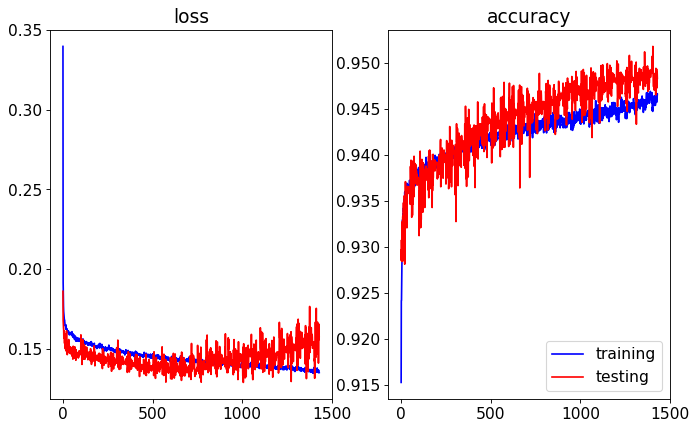

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.42it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


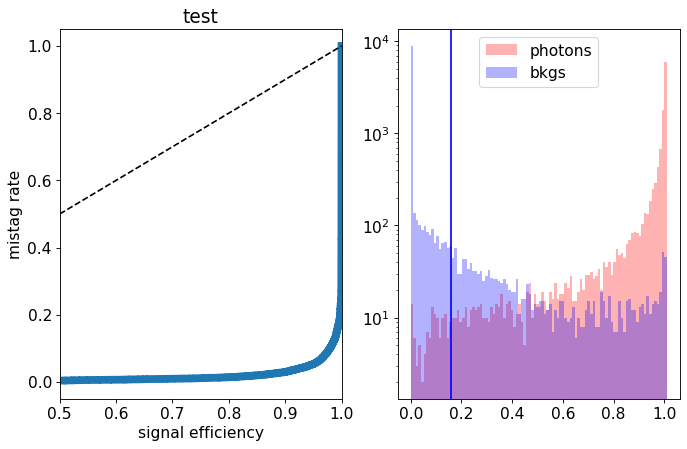

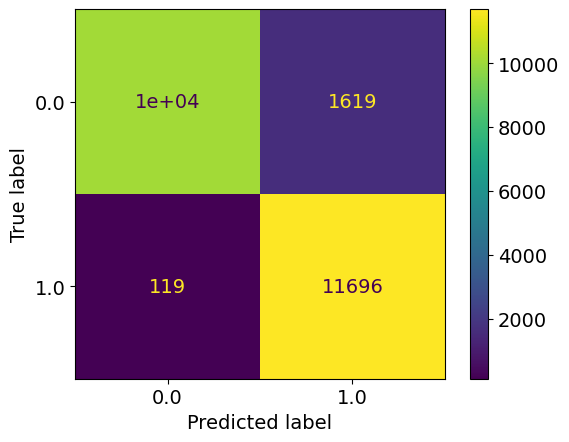

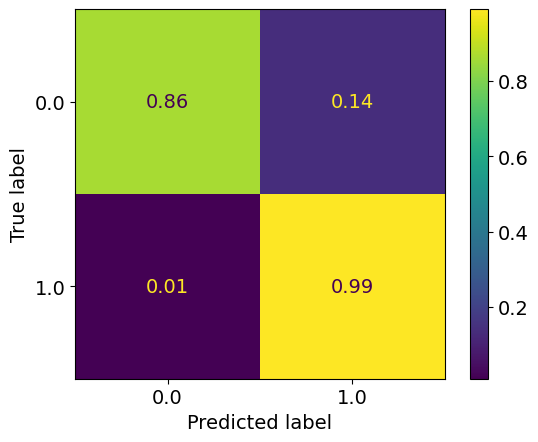

epoch: 1430
Learning rate: 3.456818229618647e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.03it/s]


train loss: 0.13541141275767307
train acc: 0.94679856


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.40it/s]


test loss: 0.15918155396357178
test acc: 0.9482341
epoch: 1431
Learning rate: 3.1612378800902485e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.45it/s]


train loss: 0.13497395789737154
train acc: 0.9462885


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.48it/s]


test loss: 0.1593596713617444
test acc: 0.9483191
epoch: 1432
Learning rate: 2.87291428459863e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.46it/s]


train loss: 0.13558309226279047
train acc: 0.94688356


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.21it/s]


test loss: 0.14348622877150774
test acc: 0.9502316
epoch: 1433
Learning rate: 2.5929853246526715e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.13473860810326924
train acc: 0.94595915


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.44it/s]


test loss: 0.16225908380001783
test acc: 0.9485316
epoch: 1434
Learning rate: 2.322555751969906e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.42it/s]


train loss: 0.1349315924249637
train acc: 0.9466073


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.09it/s]


test loss: 0.15823724530637265
test acc: 0.9480216
epoch: 1435
Learning rate: 2.062692828526193e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.02it/s]


train loss: 0.1348748562062622
train acc: 0.94607604


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.45it/s]


test loss: 0.15340579394251108
test acc: 0.9489141
epoch: 1436
Learning rate: 1.8144221145602852e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.45it/s]


train loss: 0.13477003289635775
train acc: 0.94683045


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.71it/s]


test loss: 0.16262413207441567
test acc: 0.9488716
epoch: 1437
Learning rate: 1.5787234211561068e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.54it/s]


train loss: 0.13613870891795796
train acc: 0.94575727


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.75it/s]


test loss: 0.16043095234781504
test acc: 0.9481916
epoch: 1438
Learning rate: 1.3565269433760352e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.40it/s]


train loss: 0.13627435637127822
train acc: 0.94604415


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.50it/s]


test loss: 0.1644218884408474
test acc: 0.9478516
epoch: 1439
Learning rate: 1.1487095892059523e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.46it/s]


train loss: 0.1362963105747654
train acc: 0.946331


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.23it/s]


test loss: 0.16290309615433216
test acc: 0.9488291


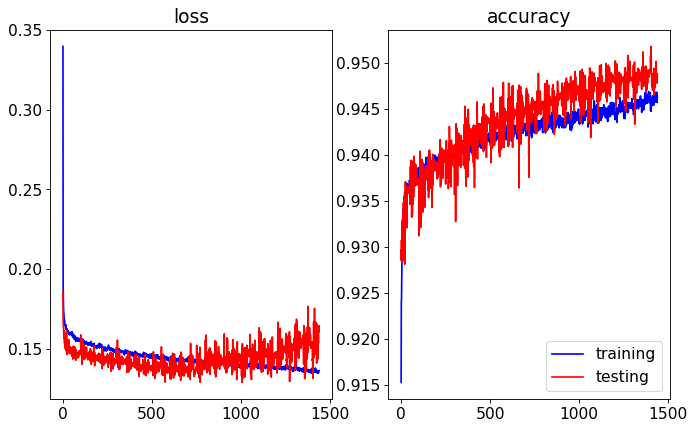

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.89it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


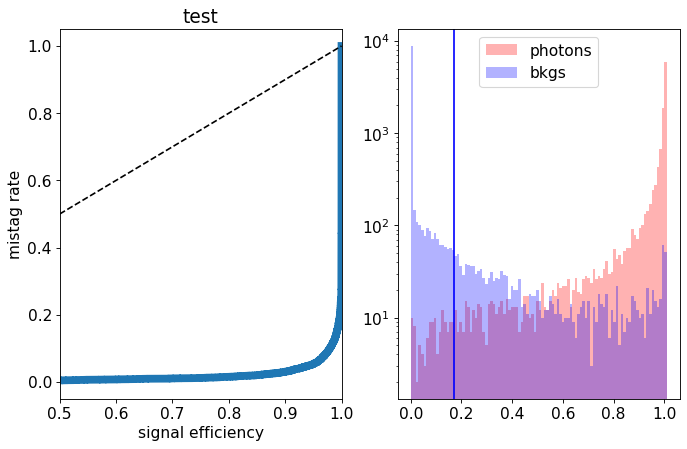

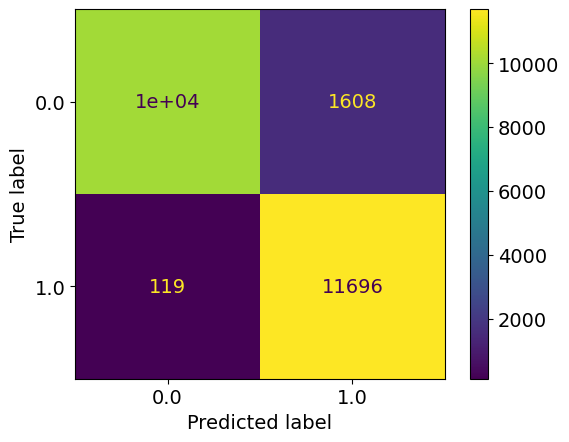

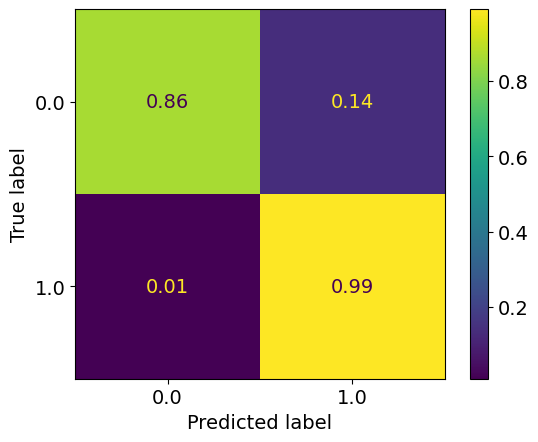

epoch: 1440
Learning rate: 9.560915188000497e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.01it/s]


train loss: 0.13466154366351996
train acc: 0.9471811


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.40it/s]


test loss: 0.15808878988027572
test acc: 0.9487016
epoch: 1441
Learning rate: 7.794329076833946e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.13405310300884732
train acc: 0.9465223


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.72it/s]


test loss: 0.16009075548499824
test acc: 0.9490416
epoch: 1442
Learning rate: 6.194309466864218e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.06it/s]


train loss: 0.13334710478403006
train acc: 0.94704294


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.35it/s]


test loss: 0.158026288356632
test acc: 0.9488716
epoch: 1443
Learning rate: 4.7671709045124306e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.56it/s]


train loss: 0.13624278033614917
train acc: 0.9462567


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.28it/s]


test loss: 0.159000875800848
test acc: 0.9488291
epoch: 1444
Learning rate: 3.5185456536865835e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.55it/s]


train loss: 0.13478847469683666
train acc: 0.9466817


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.78it/s]


test loss: 0.15980460066348315
test acc: 0.9490416
epoch: 1445
Learning rate: 2.4533614678090954e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.09it/s]


train loss: 0.13489315188994075
train acc: 0.9465329


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.27it/s]


test loss: 0.15945580042898655
test acc: 0.9491266
epoch: 1446
Learning rate: 1.5758221422252306e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.60it/s]


train loss: 0.1340569685788671
train acc: 0.9463629


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.29it/s]


test loss: 0.15903493575751781
test acc: 0.9493391
epoch: 1447
Learning rate: 8.893909237435216e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.26it/s]


train loss: 0.13320426657131523
train acc: 0.9466817


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.03it/s]


test loss: 0.15889665056020022
test acc: 0.9493816
epoch: 1448
Learning rate: 3.967768427826979e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.13525339121082028
train acc: 0.94696856


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.04it/s]


test loss: 0.15744411889463664
test acc: 0.9493391
epoch: 1449
Learning rate: 9.992402206634999e-08


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.55it/s]


train loss: 0.13534539605781531
train acc: 0.9460973


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.15it/s]


test loss: 0.15637006843462586
test acc: 0.9493391


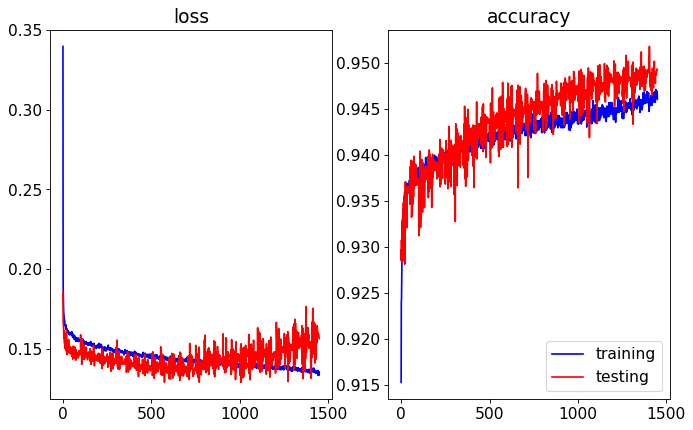

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.09it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


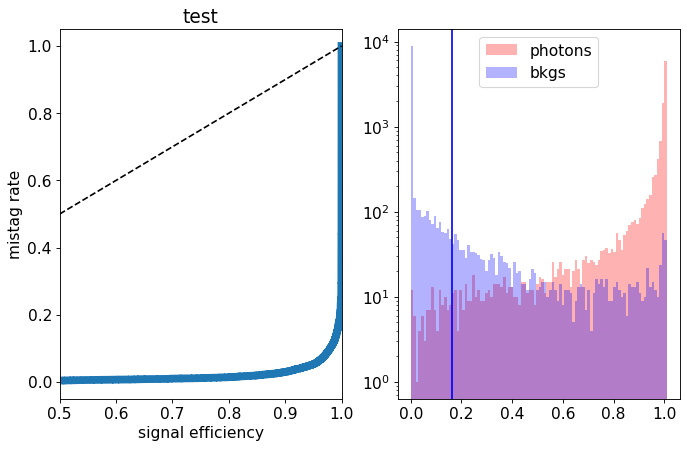

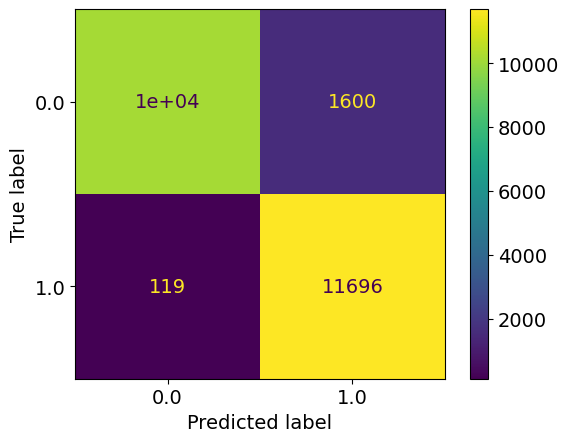

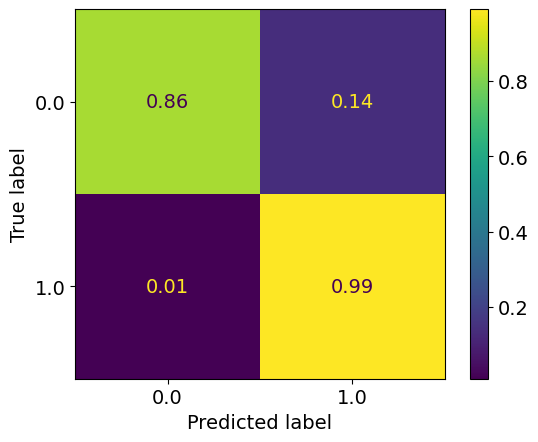

epoch: 1450
Learning rate: 4.004058690165735e-12


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.48it/s]


train loss: 0.1356840589243895
train acc: 0.94694734


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.80it/s]


test loss: 0.17680887095630168
test acc: 0.94653404
epoch: 1451
Learning rate: 9.990258887257832e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.53it/s]


train loss: 0.13608354244642196
train acc: 0.9454598


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.31it/s]


test loss: 0.15387273989617825
test acc: 0.9483616
epoch: 1452
Learning rate: 9.960823902925949e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


train loss: 0.13529744416854944
train acc: 0.94612914


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.43it/s]


test loss: 0.16580786537379028
test acc: 0.9470866
epoch: 1453
Learning rate: 9.911810813034079e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.49it/s]


train loss: 0.1354657650278632
train acc: 0.9463842


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.49it/s]


test loss: 0.1492199031636119
test acc: 0.94976413
epoch: 1454
Learning rate: 9.84341304985607e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.1373408623277002
train acc: 0.9456404


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  8.93it/s]


test loss: 0.16329256016761065
test acc: 0.94734156
epoch: 1455
Learning rate: 9.755900548115223e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.50it/s]


train loss: 0.13556047538473348
train acc: 0.9464479


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.48it/s]


test loss: 0.15741268098354338
test acc: 0.9468741
epoch: 1456
Learning rate: 9.649618679675248e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.13596199414912302
train acc: 0.94604415


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.53it/s]


test loss: 0.15428972970694305
test acc: 0.9487441
epoch: 1457
Learning rate: 9.524986890515313e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.20it/s]


train loss: 0.13646843217930216
train acc: 0.9461504


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.88it/s]


test loss: 0.17374660577625037
test acc: 0.94593906
epoch: 1458
Learning rate: 9.382497045368382e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.58it/s]


train loss: 0.1359409202056326
train acc: 0.9456935


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.21it/s]


test loss: 0.1743791250512004
test acc: 0.94657654
epoch: 1459
Learning rate: 9.222711486555833e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.57it/s]


train loss: 0.13552501550905263
train acc: 0.9465329


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.11it/s]


test loss: 0.1569983135908842
test acc: 0.9488716


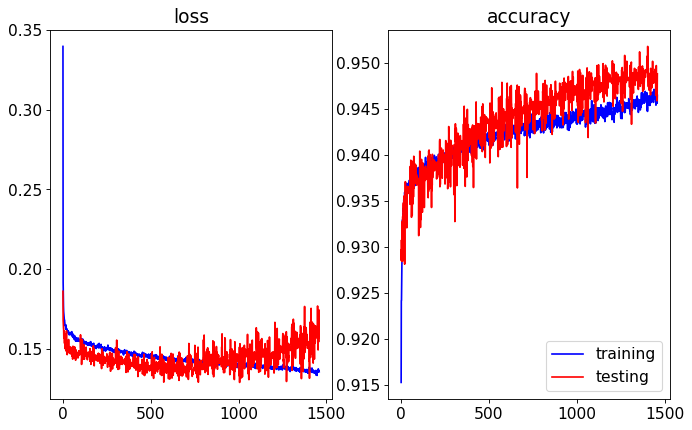

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.02it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


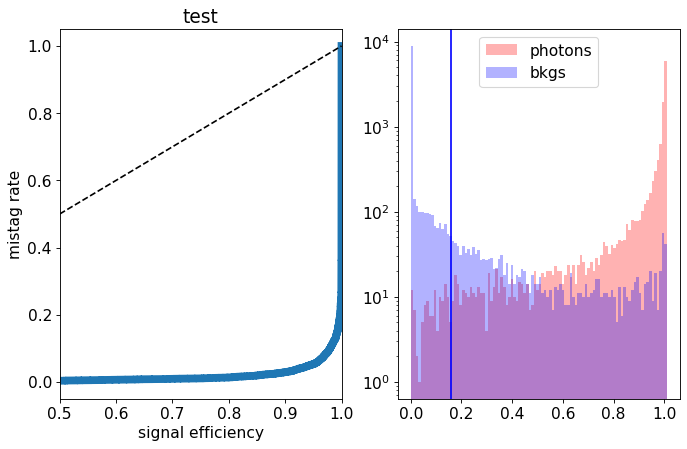

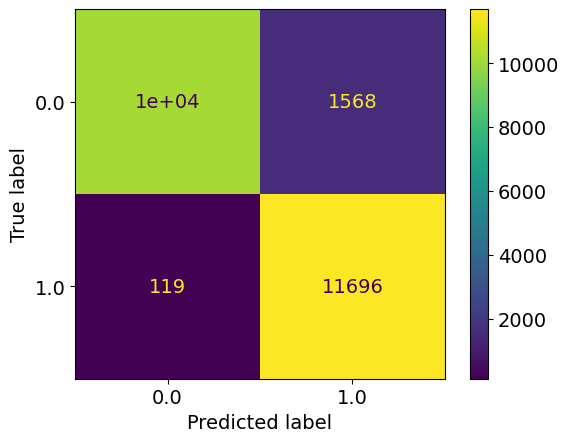

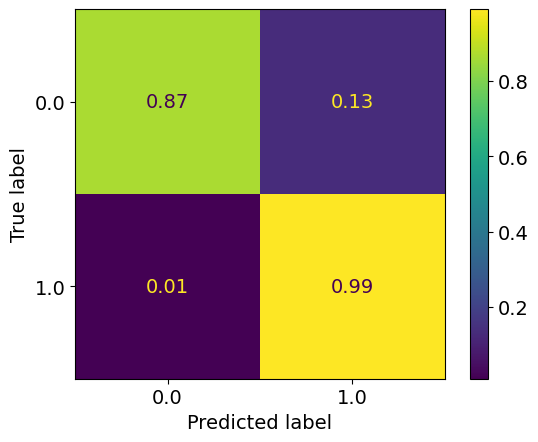

epoch: 1460
Learning rate: 9.046260814679219e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.56it/s]


train loss: 0.1355094415651765
train acc: 0.9460654


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.07it/s]


test loss: 0.15615344122052194
test acc: 0.94653404
epoch: 1461
Learning rate: 8.853841399927796e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.59it/s]


train loss: 0.13535776677404998
train acc: 0.94683045


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.20it/s]


test loss: 0.15563128162175416
test acc: 0.9486591
epoch: 1462
Learning rate: 8.646212633823516e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.27it/s]


train loss: 0.13599728038356562
train acc: 0.9454704


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.17it/s]


test loss: 0.15668129753321408
test acc: 0.9487866
epoch: 1463
Learning rate: 8.424193932249635e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.58it/s]


train loss: 0.13493497451399541
train acc: 0.94608665


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.04it/s]


test loss: 0.16546626351773738
test acc: 0.94746906
epoch: 1464
Learning rate: 8.188661501590568e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.25it/s]


train loss: 0.1351539668194048
train acc: 0.9467667


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.10it/s]


test loss: 0.16846795622259378
test acc: 0.9481916
epoch: 1465
Learning rate: 7.940544880745594e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.55it/s]


train loss: 0.13502346444281804
train acc: 0.94599104


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.08it/s]


test loss: 0.1794449657201767
test acc: 0.94657654
epoch: 1466
Learning rate: 7.680823272663487e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.56it/s]


train loss: 0.13601155223170663
train acc: 0.94620353


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.13it/s]


test loss: 0.1675919633358717
test acc: 0.9481916
epoch: 1467
Learning rate: 7.410521679875828e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.23it/s]


train loss: 0.135119551021582
train acc: 0.94693667


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.06it/s]


test loss: 0.17018754594027996
test acc: 0.94734156
epoch: 1468
Learning rate: 7.130706859280303e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.58it/s]


train loss: 0.13601881241912295
train acc: 0.9462673


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.18it/s]


test loss: 0.1700387954711914
test acc: 0.9477241
epoch: 1469
Learning rate: 6.842483112138567e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.59it/s]


train loss: 0.13638989029416612
train acc: 0.9466392


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.15it/s]


test loss: 0.1592924878001213
test acc: 0.9484466


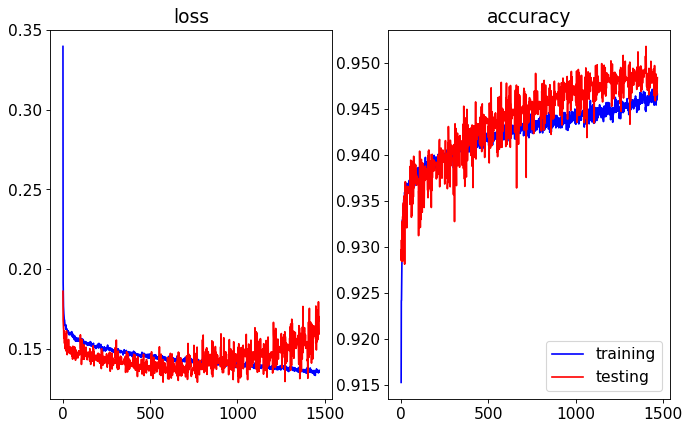

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.26it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


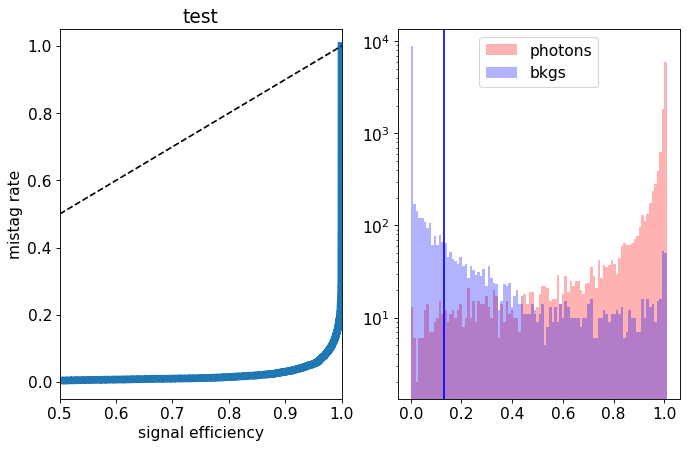

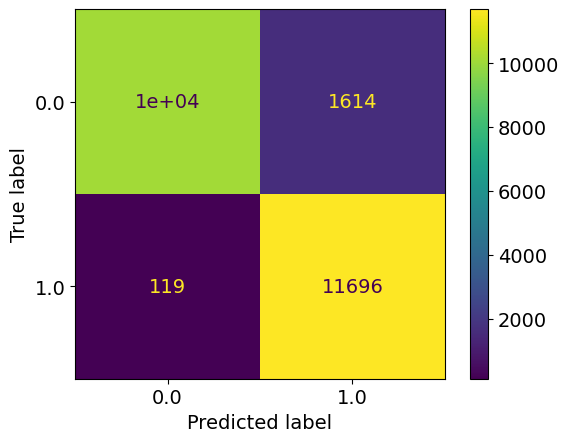

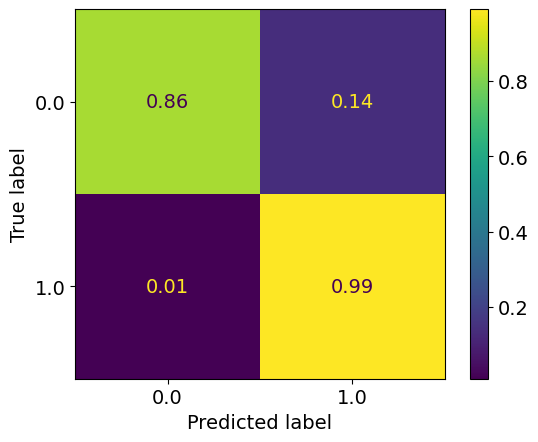

epoch: 1470
Learning rate: 6.546987925903684e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.56it/s]


train loss: 0.13492899834160593
train acc: 0.9461929


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 15.21it/s]


test loss: 0.15175868961960076
test acc: 0.9489566
epoch: 1471
Learning rate: 6.245387485076818e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.57it/s]


train loss: 0.13576725979519497
train acc: 0.9464586


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:04<00:00,  9.03it/s]


test loss: 0.16314449328929187
test acc: 0.9484041
epoch: 1472
Learning rate: 5.9388720688097756e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]


train loss: 0.1359059251133044
train acc: 0.9471173


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.91it/s]


test loss: 0.14276980571448802
test acc: 0.95044416
epoch: 1473
Learning rate: 5.628651353416987e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.46it/s]


train loss: 0.1350136600482236
train acc: 0.9467348


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.77it/s]


test loss: 0.15661078542470933
test acc: 0.9485741
epoch: 1474
Learning rate: 5.3159496383357456e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.19it/s]


train loss: 0.13587031214480189
train acc: 0.9464479


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.86it/s]


test loss: 0.1538398338481784
test acc: 0.9492966
epoch: 1475
Learning rate: 5.0020010143756554e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.40it/s]


train loss: 0.13396346531096537
train acc: 0.94713855


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.06it/s]


test loss: 0.1627626556903124
test acc: 0.9470866
epoch: 1476
Learning rate: 4.6880444933259986e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.41it/s]


train loss: 0.13447992299582548
train acc: 0.9471173


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.84it/s]


test loss: 0.15376135148108006
test acc: 0.9490841
epoch: 1477
Learning rate: 4.3753191181422696e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:30<00:00,  5.13it/s]


train loss: 0.13483372677093858
train acc: 0.9465436


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.74it/s]


test loss: 0.15515744928270578
test acc: 0.9484466
epoch: 1478
Learning rate: 4.065059073009685e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.40it/s]


train loss: 0.13420386009725035
train acc: 0.9474255


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.17it/s]


test loss: 0.16966818049550056
test acc: 0.9468316
epoch: 1479
Learning rate: 3.7584888125820524e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.00it/s]


train loss: 0.13502520223142236
train acc: 0.94678795


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.03it/s]


test loss: 0.1575694290921092
test acc: 0.9485741


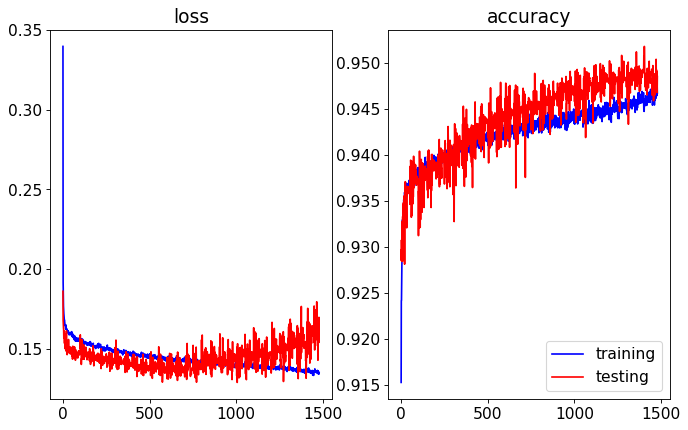

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.84it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


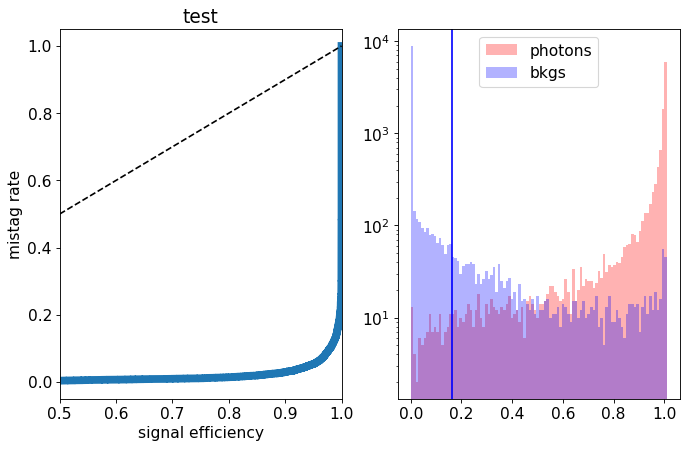

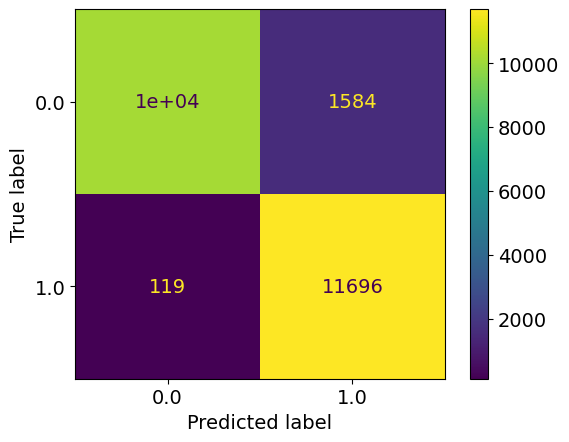

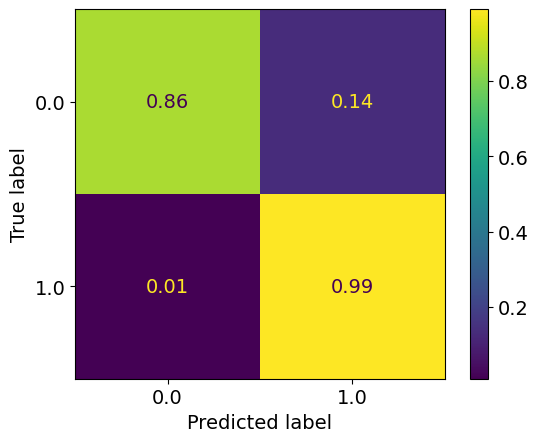

epoch: 1480
Learning rate: 3.456818229618647e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.46it/s]


train loss: 0.13441672769321758
train acc: 0.9465011


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.01it/s]


test loss: 0.15266529209911822
test acc: 0.9491266
epoch: 1481
Learning rate: 3.1612378800902485e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:32<00:00,  4.86it/s]


train loss: 0.1345209331744036
train acc: 0.9467773


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.28it/s]


test loss: 0.14788389392197132
test acc: 0.9499766
epoch: 1482
Learning rate: 2.87291428459863e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.39it/s]


train loss: 0.13396038029603896
train acc: 0.94692606


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.50it/s]


test loss: 0.15556895937770604
test acc: 0.9492541
epoch: 1483
Learning rate: 2.5929853246526715e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.37it/s]


train loss: 0.13460493268101079
train acc: 0.94712794


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.64it/s]


test loss: 0.14789005350321532
test acc: 0.9494241
epoch: 1484
Learning rate: 2.322555751969906e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.01it/s]


train loss: 0.1339853815971666
train acc: 0.9470217


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.42it/s]


test loss: 0.15667252112179994
test acc: 0.9482766
epoch: 1485
Learning rate: 2.062692828526193e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.44it/s]


train loss: 0.13466805058300116
train acc: 0.94708544


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.57it/s]


test loss: 0.15574842356145382
test acc: 0.9487866
epoch: 1486
Learning rate: 1.8144221145602852e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.41it/s]


train loss: 0.1350674678091031
train acc: 0.94713855


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  7.44it/s]


test loss: 0.16049214471131562
test acc: 0.9482766
epoch: 1487
Learning rate: 1.5787234211561068e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.44it/s]


train loss: 0.1344991170202091
train acc: 0.94707483


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.21it/s]


test loss: 0.15351571086794139
test acc: 0.9485741
epoch: 1488
Learning rate: 1.3565269433760352e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.42it/s]


train loss: 0.13463914797754045
train acc: 0.94708544


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 13.96it/s]


test loss: 0.1530294694006443
test acc: 0.9489566
epoch: 1489
Learning rate: 1.1487095892059523e-05


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  4.96it/s]


train loss: 0.13351028469527604
train acc: 0.94689417


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.23it/s]


test loss: 0.15333983227610587
test acc: 0.9492116


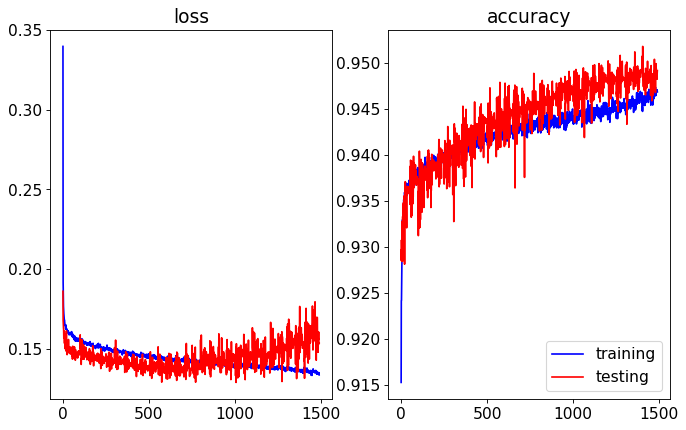

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 13.73it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


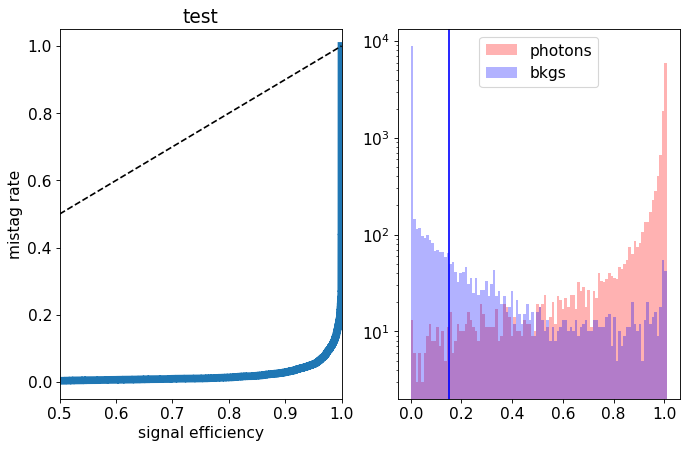

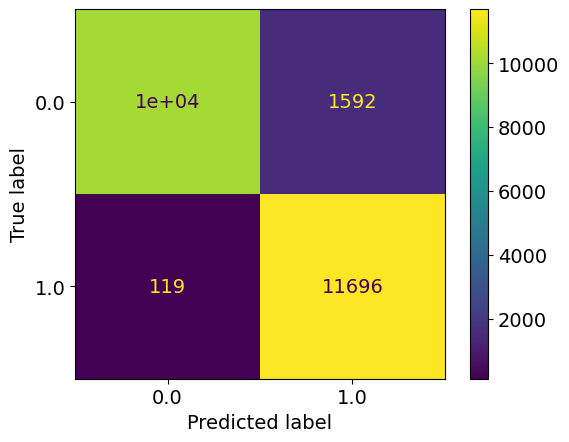

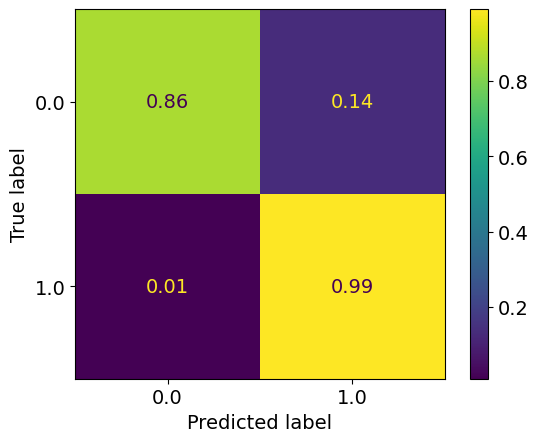

epoch: 1490
Learning rate: 9.560915188000497e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.36it/s]


train loss: 0.13460524128690646
train acc: 0.9465967


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.76it/s]


test loss: 0.1557247033342719
test acc: 0.9490416
epoch: 1491
Learning rate: 7.794329076833946e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  4.95it/s]


train loss: 0.1348926155430496
train acc: 0.94607604


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.13it/s]


test loss: 0.15322862323373557
test acc: 0.9492541
epoch: 1492
Learning rate: 6.194309466864218e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.36it/s]


train loss: 0.13448528214624733
train acc: 0.9467667


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 13.89it/s]


test loss: 0.15422462578862906
test acc: 0.9494666
epoch: 1493
Learning rate: 4.7671709045124306e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.32it/s]


train loss: 0.1350094315352713
train acc: 0.94694734


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.56it/s]


test loss: 0.1566531563177705
test acc: 0.9489991
epoch: 1494
Learning rate: 3.5185456536865835e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  4.92it/s]


train loss: 0.13413693252832268
train acc: 0.94679856


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.78it/s]


test loss: 0.15749592781066896
test acc: 0.9490841
epoch: 1495
Learning rate: 2.4533614678090954e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.51it/s]


train loss: 0.13487347224905233
train acc: 0.9474786


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.92it/s]


test loss: 0.15656551942229271
test acc: 0.9489991
epoch: 1496
Learning rate: 1.5758221422252306e-06


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:31<00:00,  5.00it/s]


train loss: 0.1342121814941145
train acc: 0.9471598


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.61it/s]


test loss: 0.15563293173909187
test acc: 0.9489991
epoch: 1497
Learning rate: 8.893909237435216e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:28<00:00,  5.42it/s]


train loss: 0.13501715693314364
train acc: 0.94678795


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.72it/s]


test loss: 0.15641632303595543
test acc: 0.9489991
epoch: 1498
Learning rate: 3.967768427826979e-07


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:29<00:00,  5.41it/s]


train loss: 0.1344856591835903
train acc: 0.9466498


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.43it/s]


test loss: 0.15688976366072893
test acc: 0.9489991
epoch: 1499
Learning rate: 9.992402206634999e-08


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:32<00:00,  4.87it/s]


train loss: 0.13314130551116482
train acc: 0.94689417


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.14it/s]


test loss: 0.15686871893703938
test acc: 0.9490416


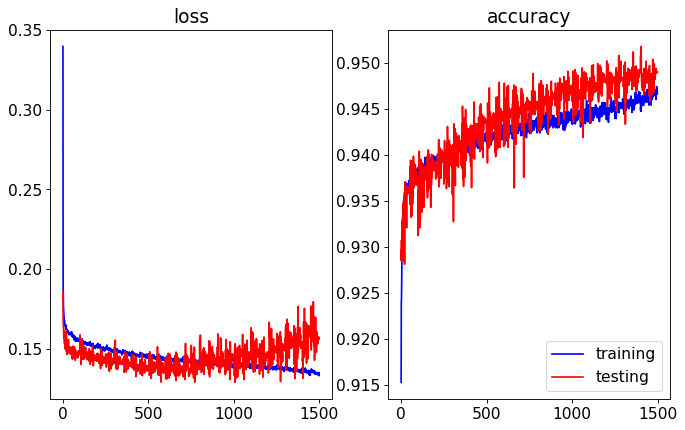

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 14.04it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


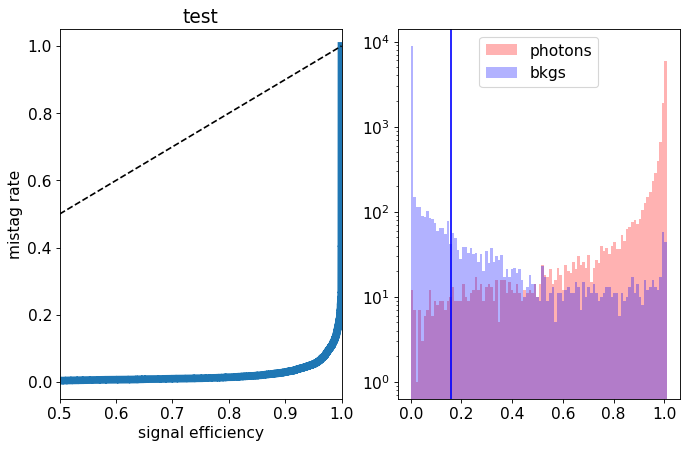

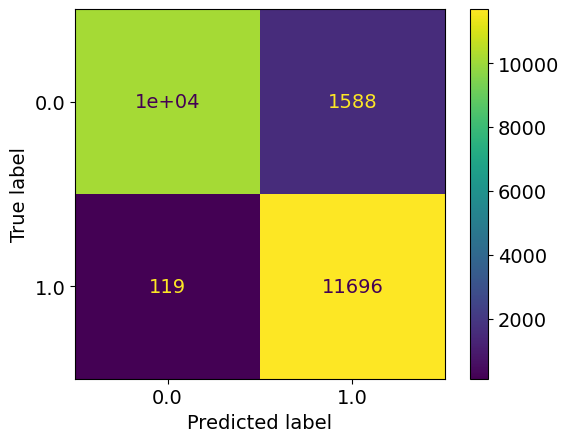

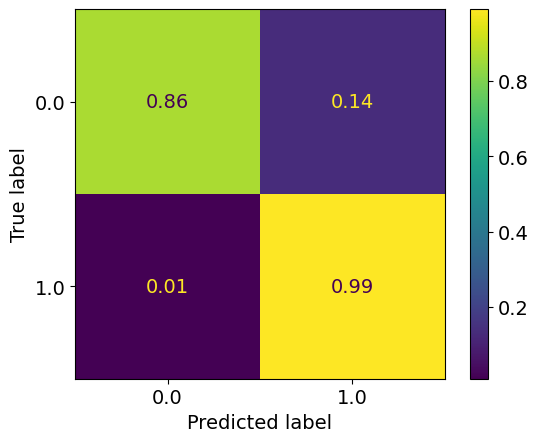

In [20]:
from tqdm import tqdm as tqdm

## OUTPUT directory
checkpoint_dir = out_dir
os.makedirs(checkpoint_dir, exist_ok=True)


nepoch=1500
best_loss = 99999999
best_acc = 0.
losst = []
lossv = []
acct = []
accv = []
epochs = []
for epoch in range(nepoch):
    print ('epoch:',epoch)
    print("Learning rate:", optimizer.param_groups[0]['lr'])
    loss_t, acc_t = train(epoch)
    losst.append(loss_t)
    acct.append(acc_t)
    loss_v, acc_v = test(epoch)
    loss_epoch = loss_v
    lossv.append(loss_epoch)
    accv.append(acc_v)
    epochs.append(epoch)

    
     
    
    checkpoint = {
    'epoch': epoch + 1,
    'state_dict': model.state_dict(),
    'optimizer': optimizer.state_dict()
    }
    checkpoint_file = 'model_epoch_%i.pth.tar' % ( epoch )
    torch.save(checkpoint,
                   os.path.join(checkpoint_dir,checkpoint_file ))
    
#     if loss_epoch < best_loss:
#         best_loss = loss_epoch
#         print('new best test loss:',best_loss)
#         torch.save(checkpoint,
#                    os.path.join(checkpoint_dir,'model_checkpoint_best.pth.tar' ))
    
    
    if acc_v > best_acc:
        print('new best acc:',acc_v)
        best_acc = acc_v
        torch.save(checkpoint,
                   os.path.join(checkpoint_dir,'model_checkpoint_bestacc.pth.tar' ))
    
    if ((epoch+1)%10 == 0):
        fig, (ax0,ax1) = plt.subplots(1,2,figsize=(10, 6),dpi=80)
        
        ax0.plot(np.array(epochs),np.array(losst),c='b',label='training')
        ax0.plot(np.array(epochs),np.array(lossv),c='r',label='testing')
        ax0.title.set_text("loss")
        #if ((epoch+1) == nepoch):
        #    plt.savefig('%s/TrainvsValLoss_ep%d.png'%(plot_dir, epoch), bbox_inches='tight')
        #plt.legend()
        #plt.show()
        ax1.plot(np.array(epochs),np.array(acct),c='b',label='training')
        ax1.plot(np.array(epochs),np.array(accv),c='r',label='testing')
        ax1.title.set_text("accuracy")
        plt.legend()
        #if ((epoch+1) == nepoch):
        #    plt.savefig('%s/TrainvsValLoss_ep%d.png'%(plot_dir, epoch), bbox_inches='tight')
        plt.show()
        
        
        model.eval()
        scores = []
        trues = []
        true_preds, num_preds = 0., 0.
        for data in tqdm(testloader): ### change to loaderDNN for DNN
                datax, label, masks, info3d = data[0].to(device), data[1].to(device), data[2].to(device), data[3].to(device)
                optimizer.zero_grad()
                #label = label.to(torch.long).squeeze()
                result = model(datax, masks, info3d)
                scores.append(torch.exp(result)[:,1].detach().cpu().flatten().numpy())
                trues.append(label.detach().cpu().numpy().flatten())
        
        
        truesa = np.hstack(trues)
        scoresa = np.hstack(scores)
        fpr, tpr, thresholds = metrics.roc_curve(truesa, scoresa, pos_label=1)
        aucv = metrics.auc(fpr, tpr)

        tpr90,fpr90,threshold90 = 0,0,0
        for i,j,k in zip(tpr,fpr,thresholds):
            if i >0.99:
                tpr90 = i
                fpr90 = j
                threshold90 = k
                break

        fig, (ax0,ax1) = plt.subplots(1,2,figsize=(10, 6),dpi=80)
        plt.rcParams['font.size'] = '14'
        ax0.plot(tpr,fpr, linewidth=7.0, label= "AUC:"+str(round(aucv,3))+" eff:"+str(round(tpr90,3))+" @ bkg rejection rate:"+str(round(1-fpr90,3)))
        ax0.set_xlabel("signal efficiency")
        ax0.set_ylabel("mistag rate")
        ax0.set_xlim([0.5,1])
        ax0.plot([0.,1], [0.,1], 'k--')
        ax0.title.set_text("test")
        plt.legend()
        #ax.text(0.6,0.6,aucv,)
        #plt.yscale("log")
        
        ax1.hist(scoresa[truesa == 1],bins=100, range=[0,1.01], label='photons',linewidth=2.0, color="r" , alpha=0.3)
        ax1.hist(scoresa[truesa == 0],bins=100, range=[0,1.01], label='bkgs',linewidth=2.0, color="b", alpha=0.3 )
        ax1.axvline(threshold90,c="b")
        plt.yscale("log")
        plt.legend()
        plt.show()

        
        
        
        
        
        ConfusionMatrixDisplay.from_predictions(np.hstack(trues), np.where(np.hstack(scores)>threshold90, 1, 0))
        plt.show()
        ConfusionMatrixDisplay.from_predictions(np.hstack(trues), np.where(np.hstack(scores)>threshold90, 1, 0), normalize="true")
        plt.show()
        

In [46]:
# find point of min distance between training loss and test loss 
# check point of this point will be used for inference

train_loss = np.array(losst)
test_loss = np.array(lossv)
# check that the two lists have the same len
assert train_loss.shape == test_loss.shape, "Error: the two lists have different length!"

# min absolute difference between loss functions
min_abs_diff = np.min(np.abs(train_loss - test_loss))
print(min_abs_diff)

# now I need the index of in the list of this min difference 
# the index of the point where the two functions cross
crossing_idx = np.argmin(np.abs(train_loss - test_loss))
print(crossing_idx)

# train and test loss of this index
print(train_loss[crossing_idx])
print(test_loss[crossing_idx])

# then I can take the checkpoint of the epoch number crossing_idx 

1.5620794740461852e-05
673
0.143062112200412
0.14307773299515247


## Inference with model of best accuracy checkpoint

### Load best accuracy checkpoint and define model

In [23]:
### REMEMBER: specify the correct input model

# old trainings directories
#out_dir = '20250226_225333_checkpoints' # training 4
#out_dir = '20250227_190925_checkpoints' # training 6
#out_dir = '20250227_235925_checkpoints' # training 7
#out_dir = '20250306_181358_checkpoints' # training 8

# new training firectories, with low en photons
out_dir = "20250703_224411_checkpoints" # training 7 with low en photons and 1500 epochs

## no need to specify the out_dir if launching the full notebook alltogether

device = torch.device(f'cuda:{cuda_id[0]}')#('cuda' if torch.cuda.is_available() else 'cpu')
#model_load = torch.load(out_dir+"/model_checkpoint_bestacc.pth.tar")

# TEST: load model of checkpoint with min difference between train and test loss (computed in the cell above)
crossing_idx = 673
model_load = torch.load(out_dir+f"/model_epoch_{crossing_idx}.pth.tar") 
print(f"model_epoch_{crossing_idx}.pth.tar")

print(out_dir)


model = MHA_model(n_seq=150,
        input_dim = 4,
        dim_emb = 16,#32
        n_heads = 16,
        num_enclayers = 6,#4
        dim_feedforward = 64,
        output_dim = 2)


model.to(device)
model.load_state_dict(model_load["state_dict"])
model.eval()

model_epoch_673.pth.tar
20250703_224411_checkpoints


MHA_model(
  (emb_inp): RecursiveScriptModule(
    original_name=Sequential
    (0): RecursiveScriptModule(original_name=Linear)
    (1): RecursiveScriptModule(original_name=Dropout)
    (2): RecursiveScriptModule(original_name=ELU)
    (3): RecursiveScriptModule(original_name=Linear)
    (4): RecursiveScriptModule(original_name=Dropout)
    (5): RecursiveScriptModule(original_name=ELU)
  )
  (transformer_encoder): RecursiveScriptModule(
    original_name=TransformerEncoder
    (layers): RecursiveScriptModule(
      original_name=ModuleList
      (0): RecursiveScriptModule(
        original_name=TransformerEncoderLayer
        (self_attn): RecursiveScriptModule(
          original_name=MultiheadAttention
          (out_proj): RecursiveScriptModule(original_name=NonDynamicallyQuantizableLinear)
        )
        (linear1): RecursiveScriptModule(original_name=Linear)
        (dropout): RecursiveScriptModule(original_name=Dropout)
        (linear2): RecursiveScriptModule(original_name=Lin

### Confusion matrix and accuracy on test dataset (testloader)

  5%|██████                                                                                                                    | 2/40 [00:02<00:47,  1.26s/it]/opt/exp_soft/vo.gridcl.fr/software/torch/2.0.1/py311-cuda117/lib/python3.11/site-packages/torch/nn/modules/module.py:1501: UserWarning: FALLBACK path has been taken inside: runCudaFusionGroup. This is an indication that codegen Failed for some reason.
To debug try disable codegen fallback path via setting the env variable `export PYTORCH_NVFUSER_DISABLE=fallback`
 (Triggered internally at ../third_party/nvfuser/csrc/manager.cpp:335.)
  return forward_call(*args, **kwargs)
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:05<00:00,  6.82it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


accuracy: 0.9412215
threshold : 0.21041493


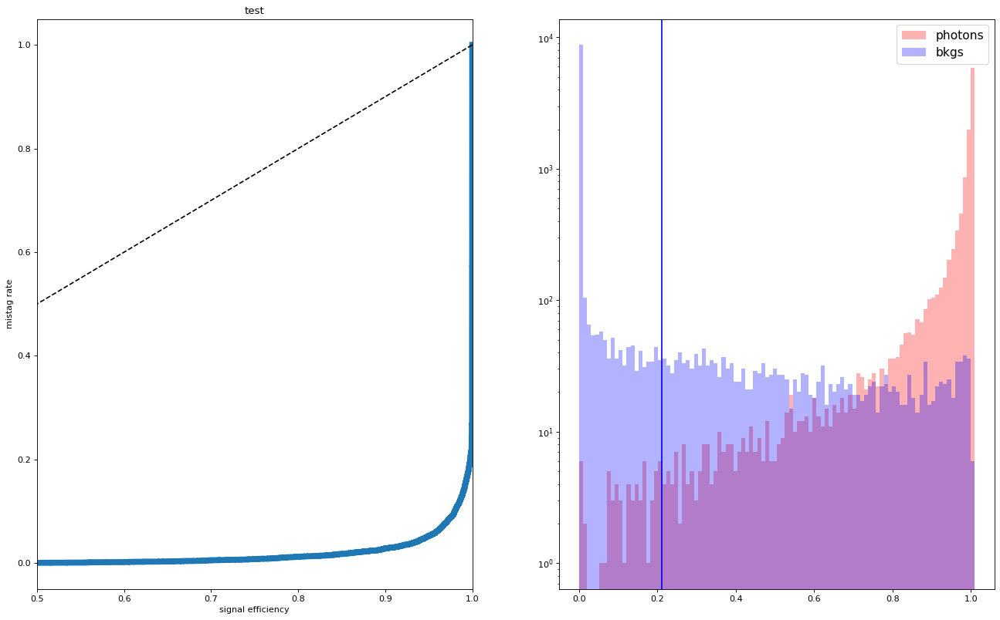

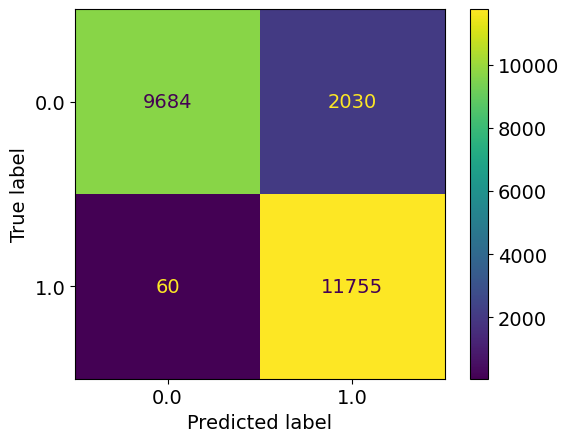

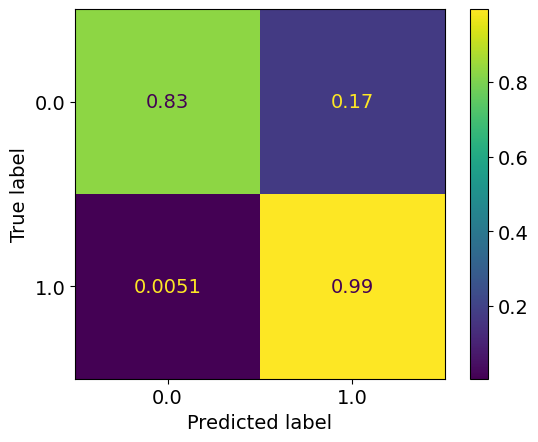

In [24]:
scores = []
trues = []
true_preds, num_preds = 0., 0.
#threshold90 = 0.152
mispredpho = []
mispredbkg = []
for data in tqdm(testloader): ### change to loaderDNN for DNN
    
        datax, label, masks, info3d = data[0].to(device), data[1].to(device), data[2].to(device), data[3].to(device)
        #label = label.to(torch.long).squeeze()
        result = model(datax, masks, info3d)
        op = torch.exp(result)[:,1].detach().cpu().flatten().numpy()
        ip = label.detach().cpu().numpy().flatten()
        scores.append(op)
        trues.append( ip )

######## use the following lines if you want to store mispredicted event indices for plotting  (REMEMBER to set batch_size=1)

#        opt = np.where(np.hstack(op)>threshold90, 1, 0)
#        if (ip == 1)&(opt == 0):
#            mispredpho.append(datax.detach().cpu().numpy())
#        elif (ip == 0)&(opt == 1):
#            mispredbkg.append(datax.detach().cpu().numpy())

        
        
        ######## use the following lines if you want just the overall scores for accuracy etc (Use this when you want to extract threshold and plot confusion matrices)
        
        label = label.to(torch.long).squeeze()
        pred_labels = torch.argmax(result.cpu(), dim=-1) 
        true_preds += (pred_labels == label.cpu()).sum()
        num_preds += label.shape[0]
        
acc = true_preds / num_preds
print("accuracy:",np.mean(np.array(acc)))

########################### this part extracts the threshold value and plots overall confusion matrices

truesa = np.hstack(trues)
scoresa = np.hstack(scores)
fpr, tpr, thresholds = metrics.roc_curve(truesa, scoresa, pos_label=1)
aucv = metrics.auc(fpr, tpr)

tpr90,fpr90,threshold90_test = 0,0,0
for i,j,k in zip(tpr,fpr,thresholds):
    if i >0.995:
        tpr90 = i
        fpr90 = j
        threshold90_test = k
        break
print("threshold :",threshold90_test)
fig, (ax0,ax1) = plt.subplots(1,2,figsize=(20, 12),dpi=80)
plt.rcParams['font.size'] = '14'
### plot AUC
ax0.plot(tpr,fpr, linewidth=7.0, label= "AUC:"+str(round(aucv,3))+" eff:"+str(round(tpr90,3))+" @ bkg rejection rate:"+str(round(1-fpr90,3)))
ax0.set_xlabel("signal efficiency")
ax0.set_ylabel("mistag rate")
ax0.set_xlim([0.5,1])
ax0.plot([0.,1], [0.,1], 'k--')
ax0.title.set_text("test")
plt.legend()
#plt.show()

## plot signal-bkg distribution
ax1.hist(scoresa[truesa == 1],bins=100, range=[0,1.01], label='photons',linewidth=2.0, color="r" , alpha=0.3)
ax1.hist(scoresa[truesa == 0],bins=100, range=[0,1.01], label='bkgs',linewidth=2.0, color="b", alpha=0.3 )
ax1.axvline(threshold90_test,c="b")
plt.yscale("log")
plt.legend()
plt.show()

#ax.text(0.6,0.6,aucv,)
#plt.yscale("log")
#plt.legend()
#plt.show()



### plot confusion matrices
ConfusionMatrixDisplay.from_predictions(truesa, np.where(scoresa>threshold90_test, 1, 0))
plt.show()
ConfusionMatrixDisplay.from_predictions(truesa, np.where(scoresa>threshold90_test, 1, 0), normalize="true")
plt.show()

### Confusion matrix and accuracy on full dataset (totalloader)

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 197/197 [00:15<00:00, 12.92it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


accuracy: 0.93996245
threshold : 0.20511523


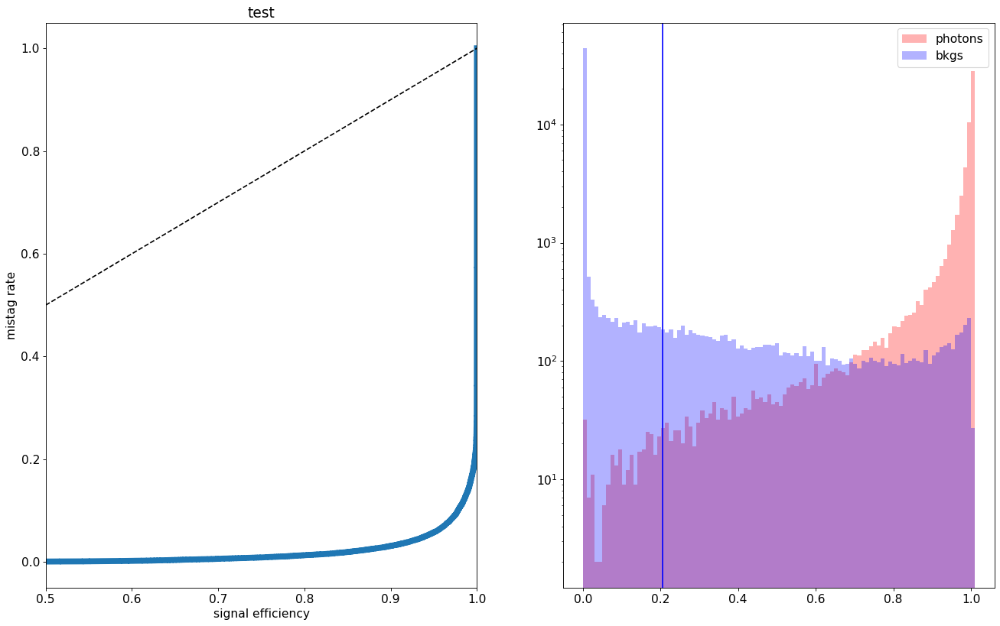

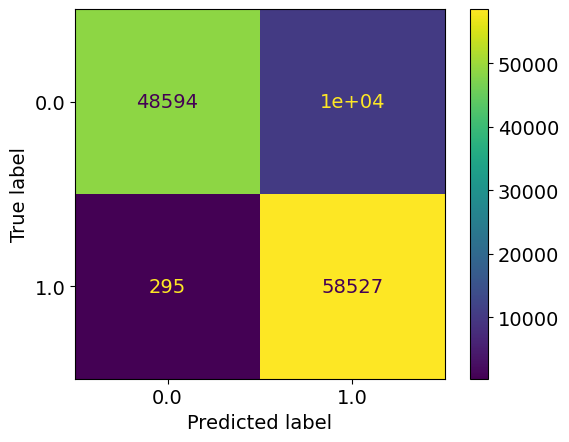

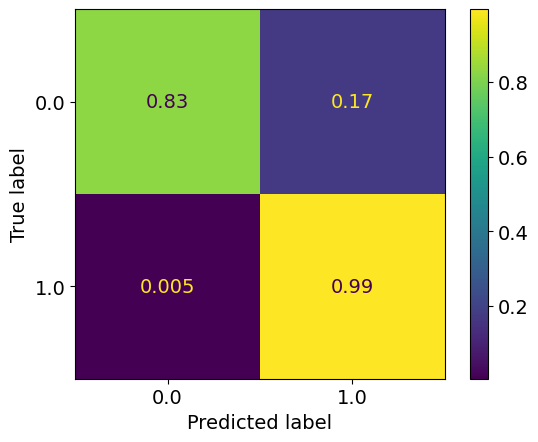

In [25]:
scores = []
trues = []
true_preds, num_preds = 0., 0.
#threshold90 = 0.152
mispredpho = []
mispredbkg = []
for data in tqdm(totalloader): ### change to loaderDNN for DNN
        datax, label, masks, info3d = data[0].to(device), data[1].to(device), data[2].to(device), data[3].to(device)
        #label = label.to(torch.long).squeeze()
        result = model(datax, masks, info3d)
        op = torch.exp(result)[:,1].detach().cpu().flatten().numpy()
        ip = label.detach().cpu().numpy().flatten()
        scores.append(op)
        trues.append( ip )
     
        ######## use the following lines if you want just the overall scores for accuracy etc (Use this when you want to extract threshold and plot confusion matrices)
        
        label = label.to(torch.long).squeeze()
        pred_labels = torch.argmax(result.cpu(), dim=-1) 
        true_preds += (pred_labels == label.cpu()).sum()
        num_preds += label.shape[0]
        
acc = true_preds / num_preds
print("accuracy:",np.mean(np.array(acc)))

########################### this part extracts the threshold value and plots overall confusion matrices

truesa = np.hstack(trues)
scoresa = np.hstack(scores)
fpr, tpr, thresholds = metrics.roc_curve(truesa, scoresa, pos_label=1)
aucv = metrics.auc(fpr, tpr)

tpr90,fpr90,threshold90_tot = 0,0,0
for i,j,k in zip(tpr,fpr,thresholds):
    if i >0.995:
        tpr90 = i
        fpr90 = j
        threshold90_tot = k
        break
print("threshold :",threshold90_tot)
fig, (ax0,ax1) = plt.subplots(1,2,figsize=(20, 12),dpi=80)
plt.rcParams['font.size'] = '14'
### plot AUC
ax0.plot(tpr,fpr, linewidth=7.0, label= "AUC:"+str(round(aucv,3))+" eff:"+str(round(tpr90,3))+" @ bkg rejection rate:"+str(round(1-fpr90,3)))
ax0.set_xlabel("signal efficiency")
ax0.set_ylabel("mistag rate")
ax0.set_xlim([0.5,1])
ax0.plot([0.,1], [0.,1], 'k--')
ax0.title.set_text("test")
plt.legend()
#plt.show()

## plot signal-bkg distribution
ax1.hist(scoresa[truesa == 1],bins=100, range=[0,1.01], label='photons',linewidth=2.0, color="r" , alpha=0.3)
ax1.hist(scoresa[truesa == 0],bins=100, range=[0,1.01], label='bkgs',linewidth=2.0, color="b", alpha=0.3 )
ax1.axvline(threshold90_tot,c="b")
plt.yscale("log")
plt.legend()
plt.show()

#ax.text(0.6,0.6,aucv,)
#plt.yscale("log")
#plt.legend()
#plt.show()



### plot confusion matrices
ConfusionMatrixDisplay.from_predictions(truesa, np.where(scoresa>threshold90_tot, 1, 0))
plt.show()
ConfusionMatrixDisplay.from_predictions(truesa, np.where(scoresa>threshold90_tot, 1, 0), normalize="true")
plt.show()

### Confusion matrix and accuracy on unbiased dataset (unbiasloader)

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 160/160 [00:10<00:00, 14.83it/s]
/opt/exp_soft/llr/python/3.11.6/el7/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:1133: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


accuracy: 0.86814094
threshold unbias: 0
threshold tot: 0.20511523


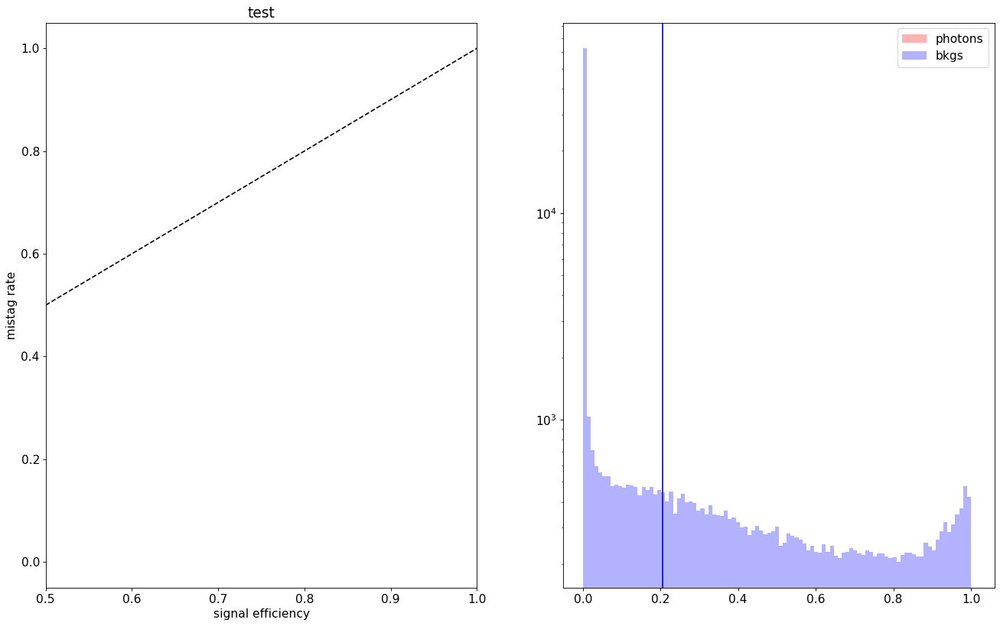

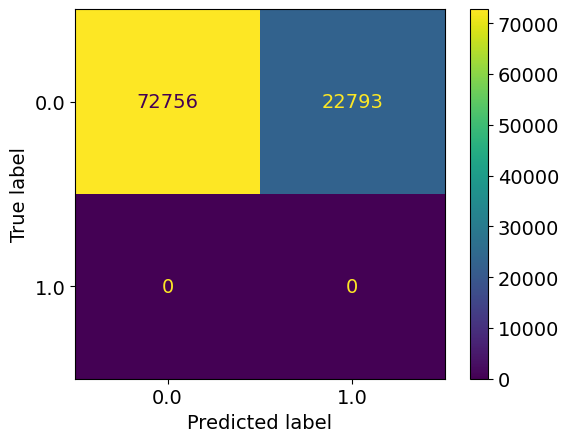

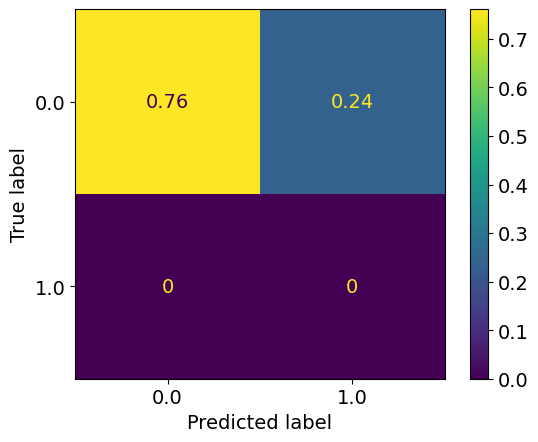

In [26]:
scores = []
trues = []
true_preds, num_preds = 0., 0.
#threshold90 = 0.152
mispredpho = []
mispredbkg = []
for data in tqdm(unbiasloader): ### change to loaderDNN for DNN
        datax, label, masks, info3d = data[0].to(device), data[1].to(device), data[2].to(device), data[3].to(device)
        #label = label.to(torch.long).squeeze()
        result = model(datax, masks, info3d)
        op = torch.exp(result)[:,1].detach().cpu().flatten().numpy()
        ip = label.detach().cpu().numpy().flatten()
        scores.append(op)
        trues.append( ip )
     
        ######## use the following lines if you want just the overall scores for accuracy etc (Use this when you want to extract threshold and plot confusion matrices)
        
        label = label.to(torch.long).squeeze()
        pred_labels = torch.argmax(result.cpu(), dim=-1) 
        true_preds += (pred_labels == label.cpu()).sum()
        num_preds += label.shape[0]
        
acc = true_preds / num_preds
print("accuracy:",np.mean(np.array(acc)))

########################### this part extracts the threshold value and plots overall confusion matrices

truesa = np.hstack(trues)
scoresa = np.hstack(scores)
fpr, tpr, thresholds = metrics.roc_curve(truesa, scoresa, pos_label=1)
aucv = metrics.auc(fpr, tpr)

tpr90,fpr90,threshold90_unbias = 0,0,0
for i,j,k in zip(tpr,fpr,thresholds):
    if i >0.995:
        tpr90 = i
        fpr90 = j
        threshold90_unbias = k
        break
print("threshold unbias:",threshold90_unbias)
print("threshold tot:",threshold90_tot)
fig, (ax0,ax1) = plt.subplots(1,2,figsize=(20, 12),dpi=80)
plt.rcParams['font.size'] = '14'
### plot AUC
ax0.plot(tpr,fpr, linewidth=7.0, label= "AUC:"+str(round(aucv,3))+" eff:"+str(round(tpr90,3))+" @ bkg rejection rate:"+str(round(1-fpr90,3)))
ax0.set_xlabel("signal efficiency")
ax0.set_ylabel("mistag rate")
ax0.set_xlim([0.5,1])
ax0.plot([0.,1], [0.,1], 'k--')
ax0.title.set_text("test")
plt.legend()
#plt.show()

## plot signal-bkg distribution
ax1.hist(scoresa[truesa == 1],bins=100, range=[0,1.01], label='photons',linewidth=2.0, color="r" , alpha=0.3)
ax1.hist(scoresa[truesa == 0],bins=100, range=[0,1.01], label='bkgs',linewidth=2.0, color="b", alpha=0.3 )
ax1.axvline(threshold90_tot,c="b")
plt.yscale("log")
plt.legend()
plt.show()

#ax.text(0.6,0.6,aucv,)
#plt.yscale("log")
#plt.legend()
#plt.show()



### plot confusion matrices
ConfusionMatrixDisplay.from_predictions(truesa, np.where(scoresa>threshold90_tot, 1, 0))
plt.show()
ConfusionMatrixDisplay.from_predictions(truesa, np.where(scoresa>threshold90_tot, 1, 0), normalize="true")
plt.show()

### Plot mispredicted events

In [27]:
### set batch_size=1
testloader = torch.utils.data.DataLoader(tsdata, batch_size=1,shuffle=True)#, num_workers=2)
totalloader = torch.utils.data.DataLoader(combdataset, batch_size=1,shuffle=True)#, num_workers=2)
unbiasloader = torch.utils.data.DataLoader(unbiased_dataset, batch_size=1,shuffle=True)

#### mispredicted events on test dataset (testloader)

  0%|                                                                                                                               | 0/23529 [00:00<?, ?it/s]/opt/exp_soft/vo.gridcl.fr/software/torch/2.0.1/py311-cuda117/lib/python3.11/site-packages/torch/nn/modules/module.py:1501: UserWarning: FALLBACK path has been taken inside: runCudaFusionGroup. This is an indication that codegen Failed for some reason.
To debug try disable codegen fallback path via setting the env variable `export PYTORCH_NVFUSER_DISABLE=fallback`
 (Triggered internally at ../third_party/nvfuser/csrc/manager.cpp:335.)
  return forward_call(*args, **kwargs)
100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23529/23529 [01:50<00:00, 212.33it/s]


threshold 0.21041493
mispred_pho 59


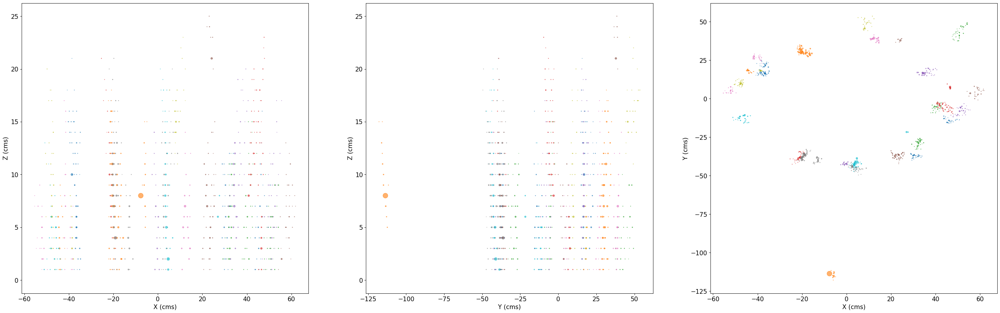

mispred_bkg 2030


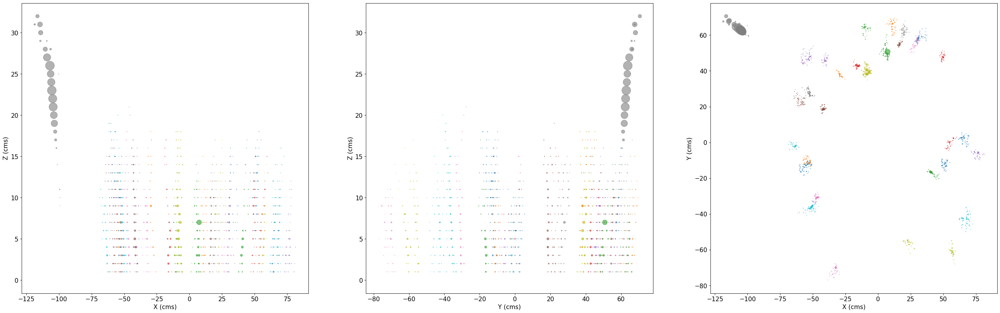

In [28]:
## REMEMBER to specify the threshold (to match the one obtained above)
scores = []
trues = []
true_preds, num_preds = 0., 0.
threshold90 = threshold90_test #0.152
mispredpho = []
mispredpho_3d = []
mispredbkg = []
mispredbkg_3d = []

for data in tqdm(testloader): ### change to loaderDNN for DNN
        datax, label, masks, info3d = data[0].to(device), data[1].to(device), data[2].to(device), data[3].to(device)
        #label = label.to(torch.long).squeeze()
        result = model(datax, masks, info3d)
        op = torch.exp(result)[:,1].detach().cpu().flatten().numpy()
        ip = label.detach().cpu().numpy().flatten()
        scores.append(op)
        trues.append( ip )

######## use the following lines if you want to store mispredicted event indices for plotting  (REMEMBER to set batch_size=1)

        opt = np.where(np.hstack(op)>threshold90, 1, 0)
        if (ip == 1)&(opt == 0):
            mispredpho.append(datax.detach().cpu().numpy())     ## get info of layer clusters (2D obj)
            mispredpho_3d.append(info3d.detach().cpu().numpy()) ## get info of tracksters (3D obj)
        elif (ip == 0)&(opt == 1):
            mispredbkg.append(datax.detach().cpu().numpy())     ## get info of layer clusters
            mispredbkg_3d.append(info3d.detach().cpu().numpy()) ## get info of tracksters


#Plot mispredicted events:
print("threshold", threshold90)

## mispredicted PHOTONS
fig, (ax0,ax1, ax2) = plt.subplots(1,3,figsize=(40, 12),dpi=80)
print("mispred_pho",len(mispredpho))
cc = 0
for uarray in mispredpho:
    
    uarray = uarray.reshape(uarray.shape[1],uarray.shape[2])
    #uarray = uarray[uarray[:,2]>0]
    ax0.scatter(uarray[:,0],uarray[:,2],s=uarray[:,3]*10,alpha=0.6)
    ax0.set_xlabel('X (cms)')
    ax0.set_ylabel('Z (cms)')
    ax1.scatter(uarray[:,1],uarray[:,2],s=uarray[:,3]*10,alpha=0.6)
    ax1.set_xlabel('Y (cms)')
    ax1.set_ylabel('Z (cms)')

    ax2.scatter(uarray[:,0],uarray[:,1],s=uarray[:,3]*10,alpha=0.6)
    ax2.set_xlabel('X (cms)')
    ax2.set_ylabel('Y (cms)')
    cc += 1
    if cc > 30:
        break    

plt.show()

## mispredicted PIONS
fig, (ax0,ax1, ax2) = plt.subplots(1,3,figsize=(40, 12),dpi=80)
print("mispred_bkg",len(mispredbkg))
cc = 0
for uarray in mispredbkg:
    
    uarray = uarray.reshape(uarray.shape[1],uarray.shape[2])
    #uarray = uarray[uarray[:,2]>0]
    ax0.scatter(uarray[:,0],uarray[:,2],s=uarray[:,3]*10,alpha=0.6)
    ax0.set_xlabel('X (cms)')
    ax0.set_ylabel('Z (cms)')
    ax1.scatter(uarray[:,1],uarray[:,2],s=uarray[:,3]*10,alpha=0.6)
    ax1.set_xlabel('Y (cms)')
    ax1.set_ylabel('Z (cms)')
    ax2.scatter(uarray[:,0],uarray[:,1],s=uarray[:,3]*10,alpha=0.6)
    ax2.set_xlabel('X (cms)')
    ax2.set_ylabel('Y (cms)')
    cc += 1
    if cc > 30:
        break    

plt.show()

Plot Barycenter of mispredicted photons
len: 59


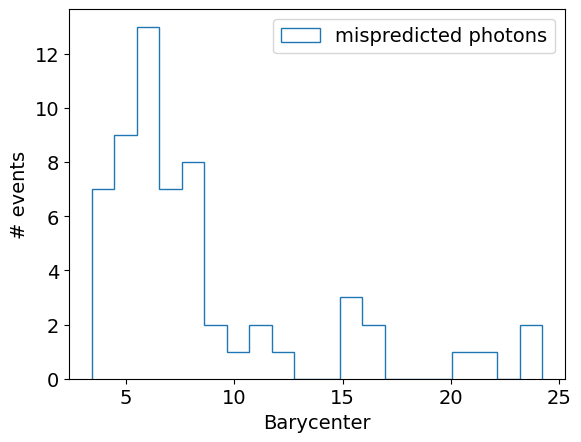

Plot Barycenter of mispredicted pions
len: 2030


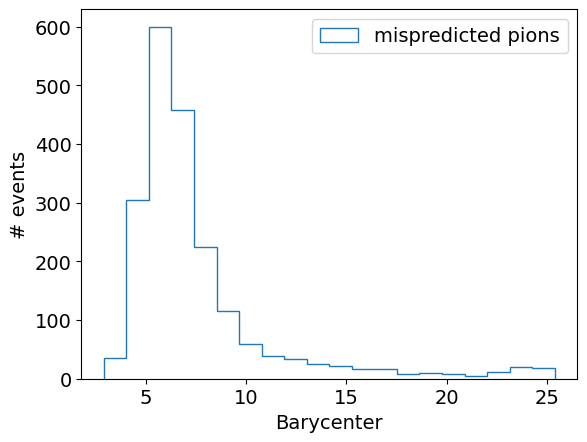

In [29]:
# mispredicted PHOTONS
print("Plot Barycenter of mispredicted photons")

fig, ax = plt.subplots(1,1)#,figsize=(40, 12),dpi=80)

barycenter_mis_pho = []
for uarray in mispredpho:
    
    uarray = uarray.reshape(uarray.shape[1],uarray.shape[2])

    barycenter_z = np.average(uarray[:,2], weights=uarray[:,3])
    barycenter_mis_pho.append(barycenter_z)
    #print(barycenter_z)

print("len:",len(barycenter_mis_pho))
#print(barycenter_mis_pho)

ax.hist(barycenter_mis_pho, bins=20, histtype='step',linewidth=1,label='mispredicted photons')
ax.legend()
ax.set_xlabel('Barycenter')
ax.set_ylabel('# events')
 
plt.show()


### -------------
# mispredicted PIONS
print("Plot Barycenter of mispredicted pions")

fig, ax = plt.subplots(1,1)#,figsize=(40, 12),dpi=80)

barycenter_mis_bkg = []
for uarray in mispredbkg:
    
    uarray = uarray.reshape(uarray.shape[1],uarray.shape[2])

    barycenter_z = np.average(uarray[:,2], weights=uarray[:,3])
    barycenter_mis_bkg.append(barycenter_z)
    #print(barycenter_z)

print("len:",len(barycenter_mis_bkg))
#print(barycenter_mis_pho)

ax.hist(barycenter_mis_bkg, bins=20, histtype='step',linewidth=1,label='mispredicted pions')
ax.legend()
ax.set_xlabel('Barycenter')
ax.set_ylabel('# events')
 

plt.show()


Plot 3D features of mispredicted photons
mispredicted pho: 59


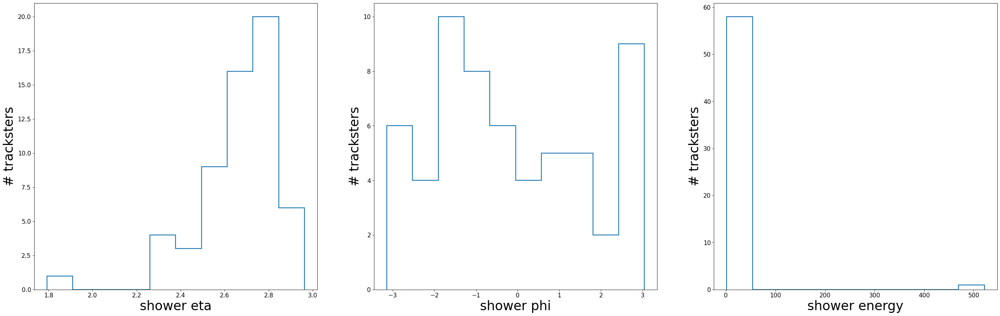

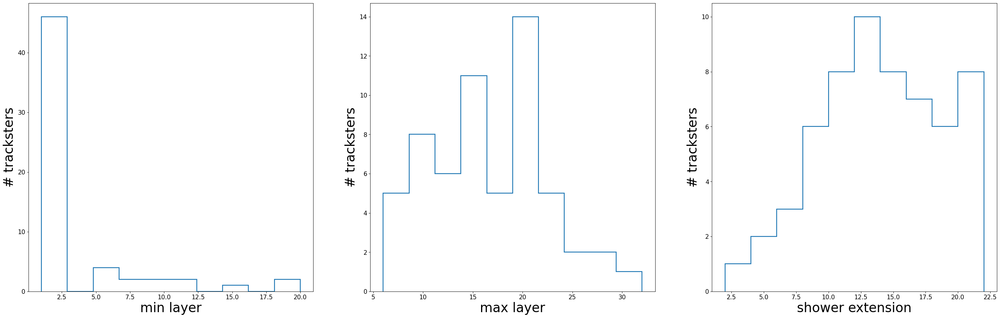

Plot 3D features of mispredicted pions
mispredicted bkg: 2030


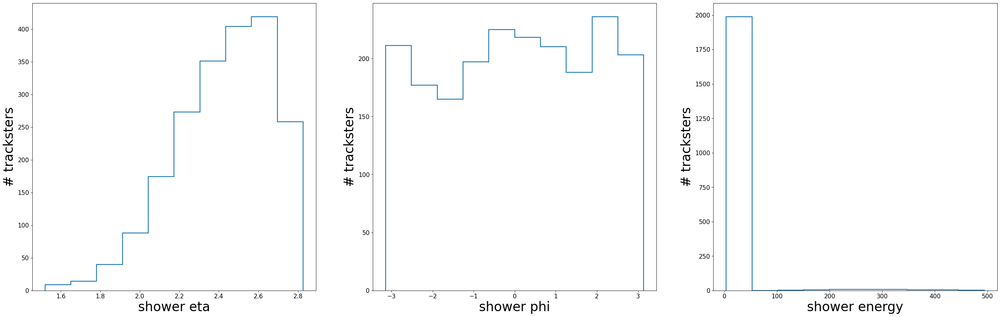

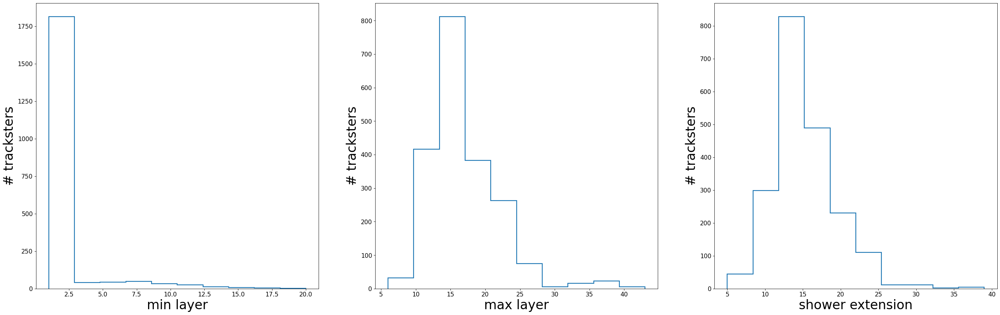

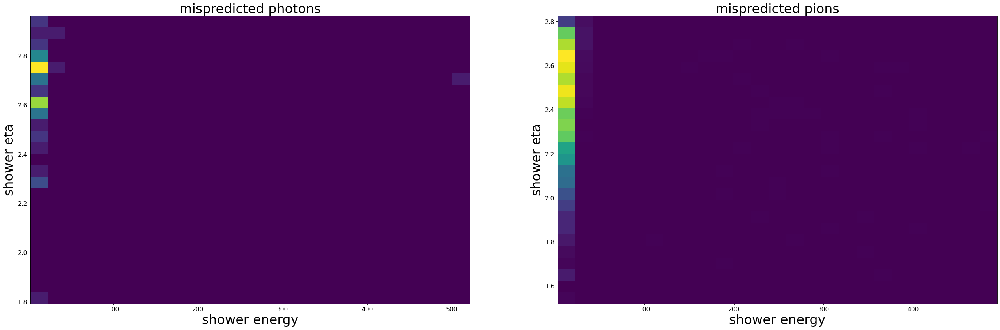

In [30]:
# mispredicted PHOTONS
print("Plot 3D features of mispredicted photons")

# mispredpho_3d is tensor of trackster information with 
# - mispredpho_3d[0] = eta
# - mispredpho_3d[1] = phi
# - mispredpho_3d[2] = energy
# - mispredpho_3d[3] = min layer
# - mispredpho_3d[4] = max layer


eta_mis_pho_3D = []  
phi_mis_pho_3D = []  
en_mis_pho_3D = []
minL_mis_pho_3D = []
maxL_mis_pho_3D = []
ext_mis_pho_3D = [] # shower extension

for tracksterarray in mispredpho_3d:

    eta_mis_pho_3D.append(tracksterarray[0][0]) #photons have eta >0 because of the selection
    phi_mis_pho_3D.append(tracksterarray[0][1])
    en_mis_pho_3D.append(tracksterarray[0][2])
    minL_mis_pho_3D.append(tracksterarray[0][3])
    maxL_mis_pho_3D.append(tracksterarray[0][4])
    ext_mis_pho_3D.append(abs(tracksterarray[0][4] - tracksterarray[0][3]))

print('mispredicted pho:',len(mispredpho_3d))

fig, (ax0, ax1, ax2) = plt.subplots(1,3,figsize=(40, 12),dpi=80)
ax0.hist(eta_mis_pho_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax0.set_xlabel('shower eta',fontsize=30)
ax0.set_ylabel('# tracksters',fontsize=30)
ax1.hist(phi_mis_pho_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax1.set_xlabel('shower phi',fontsize=30)
ax1.set_ylabel('# tracksters',fontsize=30)
ax2.hist(en_mis_pho_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax2.set_xlabel('shower energy',fontsize=30)
ax2.set_ylabel('# tracksters',fontsize=30)

plt.show()

fig, (ax0, ax1, ax2) = plt.subplots(1,3,figsize=(40, 12),dpi=80)
ax0.hist(minL_mis_pho_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax0.set_xlabel('min layer',fontsize=30)
ax0.set_ylabel('# tracksters',fontsize=30)
ax1.hist(maxL_mis_pho_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax1.set_xlabel('max layer',fontsize=30)
ax1.set_ylabel('# tracksters',fontsize=30)
ax2.hist(ext_mis_pho_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax2.set_xlabel('shower extension',fontsize=30)
ax2.set_ylabel('# tracksters',fontsize=30)
 
plt.show()


# mispredicted PIONS
print("Plot 3D features of mispredicted pions")

# mispredbkg_3d is tensor of trackster information with 
# - mispredbkg_3d[0] = eta
# - mispredbkg_3d[1] = phi
# - mispredbkg_3d[2] = energy
# - mispredbkg_3d[3] = min layer
# - mispredbkg_3d[4] = max layer


eta_mis_bkg_3D = []  
phi_mis_bkg_3D = []  
en_mis_bkg_3D = []
minL_mis_bkg_3D = []
maxL_mis_bkg_3D = []
ext_mis_bkg_3D = [] # shower extension

for tracksterarray in mispredbkg_3d:

    eta_mis_bkg_3D.append(abs(tracksterarray[0][0])) # bkg do not have eta>0, so the abs is imposed
    phi_mis_bkg_3D.append(tracksterarray[0][1])
    en_mis_bkg_3D.append(tracksterarray[0][2])
    minL_mis_bkg_3D.append(tracksterarray[0][3])
    maxL_mis_bkg_3D.append(tracksterarray[0][4])
    ext_mis_bkg_3D.append(abs(tracksterarray[0][4] - tracksterarray[0][3]))

print('mispredicted bkg:',len(mispredbkg_3d))

fig, (ax0, ax1, ax2) = plt.subplots(1,3,figsize=(40, 12),dpi=80)
ax0.hist(eta_mis_bkg_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax0.set_xlabel('shower eta',fontsize=30)
ax0.set_ylabel('# tracksters',fontsize=30)
ax1.hist(phi_mis_bkg_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax1.set_xlabel('shower phi',fontsize=30)
ax1.set_ylabel('# tracksters',fontsize=30)
ax2.hist(en_mis_bkg_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax2.set_xlabel('shower energy',fontsize=30)
ax2.set_ylabel('# tracksters',fontsize=30)

plt.show()

fig, (ax0, ax1, ax2) = plt.subplots(1,3,figsize=(40, 12),dpi=80)
ax0.hist(minL_mis_bkg_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax0.set_xlabel('min layer',fontsize=30)
ax0.set_ylabel('# tracksters',fontsize=30)
ax1.hist(maxL_mis_bkg_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax1.set_xlabel('max layer',fontsize=30)
ax1.set_ylabel('# tracksters',fontsize=30)
ax2.hist(ext_mis_bkg_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax2.set_xlabel('shower extension',fontsize=30)
ax2.set_ylabel('# tracksters',fontsize=30)
 
plt.show()

# eta vs energy
fig, (ax0,ax1) = plt.subplots(1, 2,figsize=(40, 12),dpi=80)
ax0.hist2d(en_mis_pho_3D, eta_mis_pho_3D, bins=25)
ax0.set_title('mispredicted photons',fontsize=30)
ax0.set_xlabel('shower energy',fontsize=30)
ax0.set_ylabel('shower eta',fontsize=30)
ax1.hist2d(en_mis_bkg_3D, eta_mis_bkg_3D, bins=25)
ax1.set_title('mispredicted pions',fontsize=30)
ax1.set_xlabel('shower energy',fontsize=30)
ax1.set_ylabel('shower eta',fontsize=30)
plt.show()

#### mispredicted events on full dataset (totalloader)

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 117643/117643 [08:56<00:00, 219.08it/s]


threshold 0.20511523
mispred_pho 294


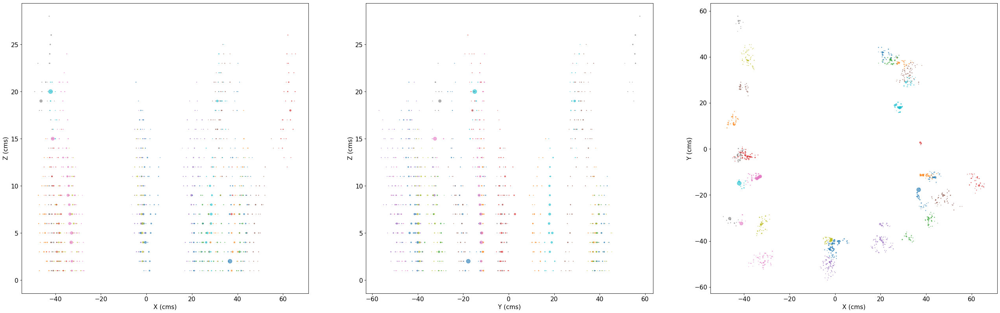

mispred_bkg 10227


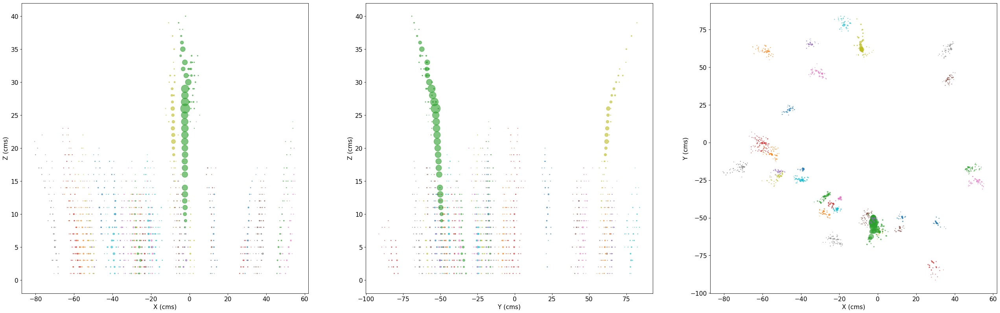

In [31]:
## REMEMBER to specify the threshold (to match the one obtained above)
scores = []
trues = []
true_preds, num_preds = 0., 0.
threshold90 = threshold90_tot #0.152
mispredpho = []
mispredpho_3d = []
mispredbkg = []
mispredbkg_3d = []

for data in tqdm(totalloader): ### change to loaderDNN for DNN
        datax, label, masks, info3d = data[0].to(device), data[1].to(device), data[2].to(device), data[3].to(device)
        #label = label.to(torch.long).squeeze()
        result = model(datax, masks, info3d)
        op = torch.exp(result)[:,1].detach().cpu().flatten().numpy()
        ip = label.detach().cpu().numpy().flatten()
        scores.append(op)
        trues.append( ip )

######## use the following lines if you want to store mispredicted event indices for plotting  (REMEMBER to set batch_size=1)

        opt = np.where(np.hstack(op)>threshold90, 1, 0)
        if (ip == 1)&(opt == 0):
            mispredpho.append(datax.detach().cpu().numpy())
            mispredpho_3d.append(info3d.detach().cpu().numpy()) ## get info of tracksters (3D obj)
        elif (ip == 0)&(opt == 1):
            mispredbkg.append(datax.detach().cpu().numpy())
            mispredbkg_3d.append(info3d.detach().cpu().numpy()) ## get info of tracksters (3D obj)



#Plot mispredicted events:
print("threshold", threshold90)

## mispredicted PHOTONS
fig, (ax0,ax1, ax2) = plt.subplots(1,3,figsize=(40, 12),dpi=80)
print("mispred_pho",len(mispredpho))
cc = 0
for uarray in mispredpho:
    
    uarray = uarray.reshape(uarray.shape[1],uarray.shape[2])
    #uarray = uarray[uarray[:,2]>0]
    ax0.scatter(uarray[:,0],uarray[:,2],s=uarray[:,3]*10,alpha=0.6)
    ax0.set_xlabel('X (cms)')
    ax0.set_ylabel('Z (cms)')
    ax1.scatter(uarray[:,1],uarray[:,2],s=uarray[:,3]*10,alpha=0.6)
    ax1.set_xlabel('Y (cms)')
    ax1.set_ylabel('Z (cms)')

    ax2.scatter(uarray[:,0],uarray[:,1],s=uarray[:,3]*10,alpha=0.6)
    ax2.set_xlabel('X (cms)')
    ax2.set_ylabel('Y (cms)')
    cc += 1
    if cc > 30:
        break    

plt.show()

## mispredicted PIONS
fig, (ax0,ax1, ax2) = plt.subplots(1,3,figsize=(40, 12),dpi=80)
print("mispred_bkg",len(mispredbkg))
cc = 0
for uarray in mispredbkg:
    
    uarray = uarray.reshape(uarray.shape[1],uarray.shape[2])
    #uarray = uarray[uarray[:,2]>0]
    ax0.scatter(uarray[:,0],uarray[:,2],s=uarray[:,3]*10,alpha=0.6)
    ax0.set_xlabel('X (cms)')
    ax0.set_ylabel('Z (cms)')
    ax1.scatter(uarray[:,1],uarray[:,2],s=uarray[:,3]*10,alpha=0.6)
    ax1.set_xlabel('Y (cms)')
    ax1.set_ylabel('Z (cms)')

    ax2.scatter(uarray[:,0],uarray[:,1],s=uarray[:,3]*10,alpha=0.6)
    ax2.set_xlabel('X (cms)')
    ax2.set_ylabel('Y (cms)')
    cc += 1
    if cc > 30:
        break    

plt.show()

Plot Barycenter of mispredicted photons
len: 294


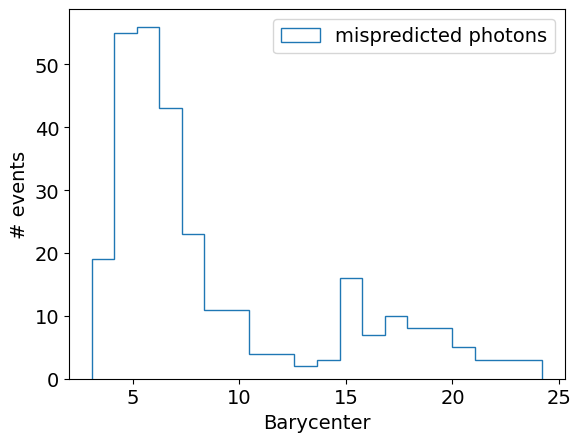

Plot Barycenter of mispredicted pions
len: 10227


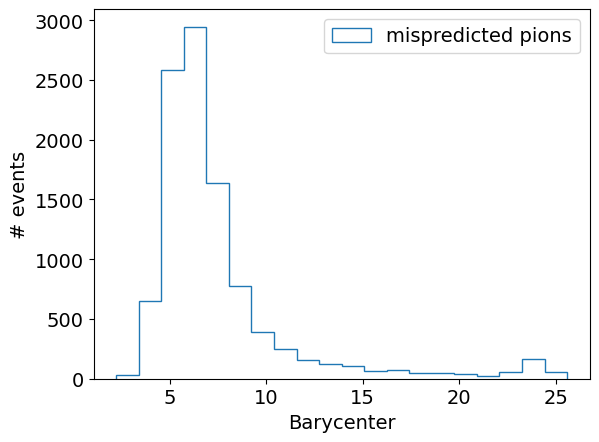

In [32]:
# mispredicted PHOTONS
print("Plot Barycenter of mispredicted photons")

fig, ax = plt.subplots(1,1)#,figsize=(40, 12),dpi=80)

barycenter_mis_pho = []
for uarray in mispredpho:
    
    uarray = uarray.reshape(uarray.shape[1],uarray.shape[2])

    barycenter_z = np.average(uarray[:,2], weights=uarray[:,3])
    barycenter_mis_pho.append(barycenter_z)
    #print(barycenter_z)

print("len:",len(barycenter_mis_pho))
#print(barycenter_mis_pho)

ax.hist(barycenter_mis_pho, bins=20, histtype='step',linewidth=1,label='mispredicted photons')
ax.legend()
ax.set_xlabel('Barycenter')
ax.set_ylabel('# events')
 
plt.show()


### -------------
# mispredicted PIONS
print("Plot Barycenter of mispredicted pions")

fig, ax = plt.subplots(1,1)#,figsize=(40, 12),dpi=80)

barycenter_mis_bkg = []
for uarray in mispredbkg:
    
    uarray = uarray.reshape(uarray.shape[1],uarray.shape[2])

    barycenter_z = np.average(uarray[:,2], weights=uarray[:,3])
    barycenter_mis_bkg.append(barycenter_z)
    #print(barycenter_z)

print("len:",len(barycenter_mis_bkg))
#print(barycenter_mis_pho)

ax.hist(barycenter_mis_bkg, bins=20, histtype='step',linewidth=1,label='mispredicted pions')
ax.legend()
ax.set_xlabel('Barycenter')
ax.set_ylabel('# events')
 

plt.show()

Plot 3D features of mispredicted photons
mispredicted pho: 294


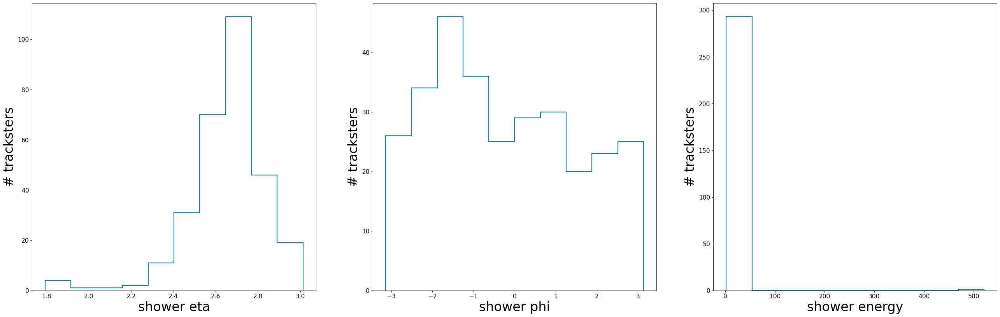

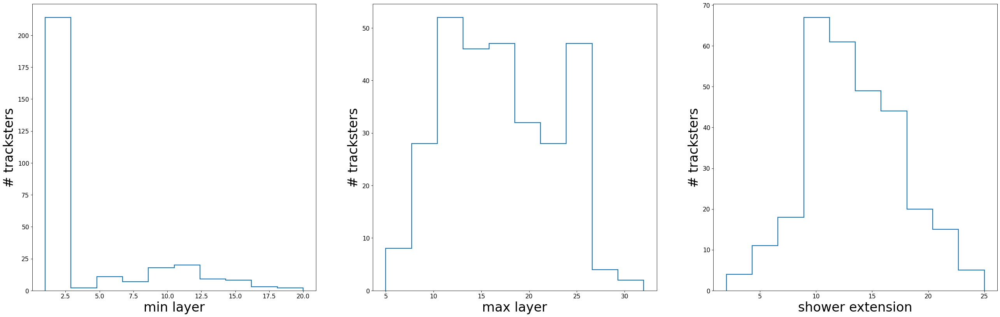

Plot 3D features of mispredicted pions
mispredicted bkg: 10227


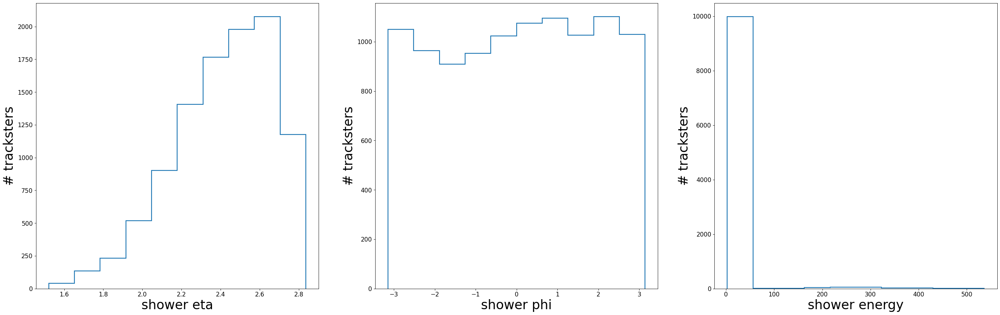

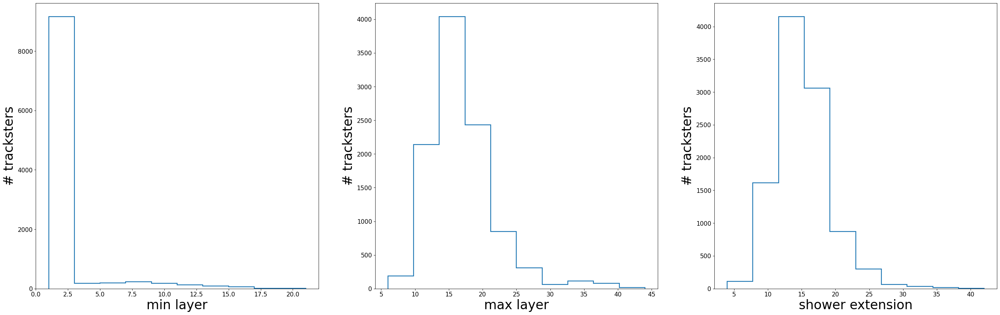

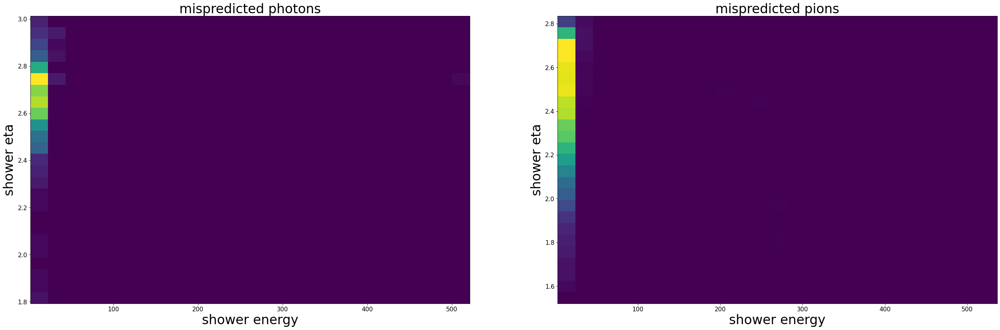

In [33]:
# mispredicted PHOTONS
print("Plot 3D features of mispredicted photons")

# mispredpho_3d is tensor of trackster information with 
# - mispredpho_3d[0] = eta
# - mispredpho_3d[1] = phi
# - mispredpho_3d[2] = energy
# - mispredpho_3d[3] = min layer
# - mispredpho_3d[4] = max layer


eta_mis_pho_3D = []  
phi_mis_pho_3D = []  
en_mis_pho_3D = []
minL_mis_pho_3D = []
maxL_mis_pho_3D = []
ext_mis_pho_3D = [] # shower extension

for tracksterarray in mispredpho_3d:

    eta_mis_pho_3D.append(tracksterarray[0][0])
    phi_mis_pho_3D.append(tracksterarray[0][1])
    en_mis_pho_3D.append(tracksterarray[0][2])
    minL_mis_pho_3D.append(tracksterarray[0][3])
    maxL_mis_pho_3D.append(tracksterarray[0][4])
    ext_mis_pho_3D.append(abs(tracksterarray[0][4] - tracksterarray[0][3]))

print('mispredicted pho:',len(mispredpho_3d))

fig, (ax0, ax1, ax2) = plt.subplots(1,3,figsize=(40, 12),dpi=80)
ax0.hist(eta_mis_pho_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax0.set_xlabel('shower eta',fontsize=30)
ax0.set_ylabel('# tracksters',fontsize=30)
ax1.hist(phi_mis_pho_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax1.set_xlabel('shower phi',fontsize=30)
ax1.set_ylabel('# tracksters',fontsize=30)
ax2.hist(en_mis_pho_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax2.set_xlabel('shower energy',fontsize=30)
ax2.set_ylabel('# tracksters',fontsize=30)

plt.show()

fig, (ax0, ax1, ax2) = plt.subplots(1,3,figsize=(40, 12),dpi=80)
ax0.hist(minL_mis_pho_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax0.set_xlabel('min layer',fontsize=30)
ax0.set_ylabel('# tracksters',fontsize=30)
ax1.hist(maxL_mis_pho_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax1.set_xlabel('max layer',fontsize=30)
ax1.set_ylabel('# tracksters',fontsize=30)
ax2.hist(ext_mis_pho_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax2.set_xlabel('shower extension',fontsize=30)
ax2.set_ylabel('# tracksters',fontsize=30)
 
plt.show()


# mispredicted PIONS
print("Plot 3D features of mispredicted pions")

# mispredbkg_3d is tensor of trackster information with 
# - mispredbkg_3d[0] = eta
# - mispredbkg_3d[1] = phi
# - mispredbkg_3d[2] = energy
# - mispredbkg_3d[3] = min layer
# - mispredbkg_3d[4] = max layer


eta_mis_bkg_3D = []  
phi_mis_bkg_3D = []  
en_mis_bkg_3D = []
minL_mis_bkg_3D = []
maxL_mis_bkg_3D = []
ext_mis_bkg_3D = [] # shower extension

for tracksterarray in mispredbkg_3d:

    eta_mis_bkg_3D.append(abs(tracksterarray[0][0]))
    phi_mis_bkg_3D.append(tracksterarray[0][1])
    en_mis_bkg_3D.append(tracksterarray[0][2])
    minL_mis_bkg_3D.append(tracksterarray[0][3])
    maxL_mis_bkg_3D.append(tracksterarray[0][4])
    ext_mis_bkg_3D.append(abs(tracksterarray[0][4] - tracksterarray[0][3]))

print('mispredicted bkg:',len(mispredbkg_3d))

fig, (ax0, ax1, ax2) = plt.subplots(1,3,figsize=(40, 12),dpi=80)
ax0.hist(eta_mis_bkg_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax0.set_xlabel('shower eta',fontsize=30)
ax0.set_ylabel('# tracksters',fontsize=30)
ax1.hist(phi_mis_bkg_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax1.set_xlabel('shower phi',fontsize=30)
ax1.set_ylabel('# tracksters',fontsize=30)
ax2.hist(en_mis_bkg_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax2.set_xlabel('shower energy',fontsize=30)
ax2.set_ylabel('# tracksters',fontsize=30)

plt.show()

fig, (ax0, ax1, ax2) = plt.subplots(1,3,figsize=(40, 12),dpi=80)
ax0.hist(minL_mis_bkg_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax0.set_xlabel('min layer',fontsize=30)
ax0.set_ylabel('# tracksters',fontsize=30)
ax1.hist(maxL_mis_bkg_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax1.set_xlabel('max layer',fontsize=30)
ax1.set_ylabel('# tracksters',fontsize=30)
ax2.hist(ext_mis_bkg_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax2.set_xlabel('shower extension',fontsize=30)
ax2.set_ylabel('# tracksters',fontsize=30)
 
plt.show()

# eta vs energy
fig, (ax0,ax1) = plt.subplots(1, 2,figsize=(40, 12),dpi=80)
ax0.hist2d(en_mis_pho_3D, eta_mis_pho_3D, bins=25)
ax0.set_title('mispredicted photons',fontsize=30)
ax0.set_xlabel('shower energy',fontsize=30)
ax0.set_ylabel('shower eta',fontsize=30)
ax1.hist2d(en_mis_bkg_3D, eta_mis_bkg_3D, bins=25)
ax1.set_title('mispredicted pions',fontsize=30)
ax1.set_xlabel('shower energy',fontsize=30)
ax1.set_ylabel('shower eta',fontsize=30)
plt.show()

#### mispredicted events on test dataset (unbiasloader)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 95549/95549 [07:29<00:00, 212.48it/s]


threshold 0.20511523
mispred_pho 0


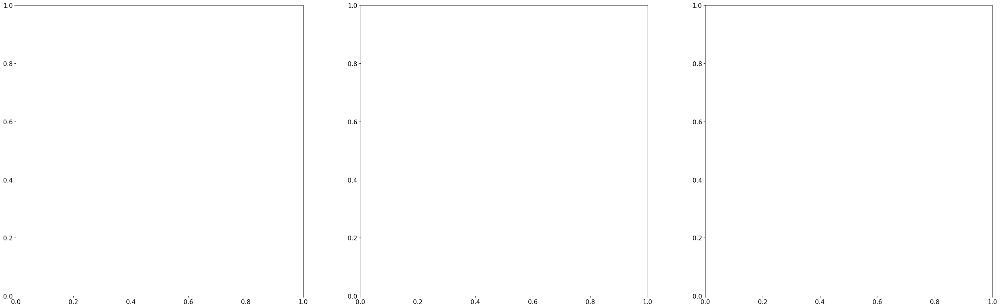

mispred_bkg 22793


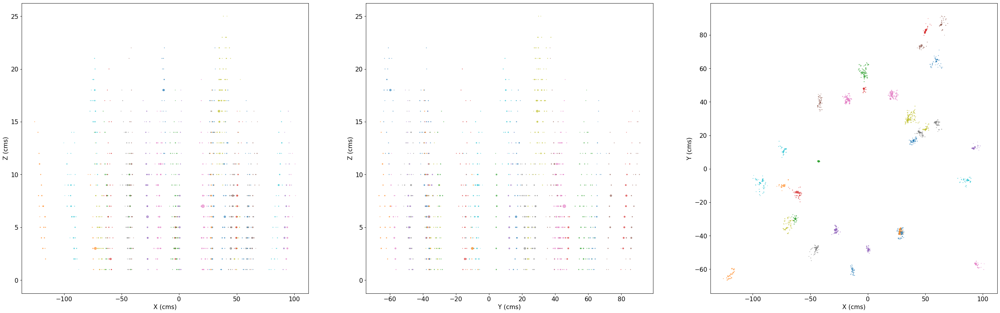

In [34]:
## REMEMBER to specify the threshold (to match the one obtained above)
scores = []
trues = []
true_preds, num_preds = 0., 0.
#threshold90 = threshold90_unbias #0.152
threshold90 = threshold90_tot
mispredpho = []
mispredpho_3d = []
mispredbkg = []
mispredbkg_3d = []

for data in tqdm(unbiasloader): ### change to loaderDNN for DNN
        datax, label, masks, info3d = data[0].to(device), data[1].to(device), data[2].to(device), data[3].to(device)
        #label = label.to(torch.long).squeeze()
        result = model(datax, masks, info3d)
        op = torch.exp(result)[:,1].detach().cpu().flatten().numpy()
        ip = label.detach().cpu().numpy().flatten()
        scores.append(op)
        trues.append( ip )

######## use the following lines if you want to store mispredicted event indices for plotting  (REMEMBER to set batch_size=1)

        opt = np.where(np.hstack(op)>threshold90, 1, 0)
        if (ip == 1)&(opt == 0):
            mispredpho.append(datax.detach().cpu().numpy())
            mispredpho_3d.append(info3d.detach().cpu().numpy()) ## get info of tracksters (3D obj)
        elif (ip == 0)&(opt == 1):
            mispredbkg.append(datax.detach().cpu().numpy())
            mispredbkg_3d.append(info3d.detach().cpu().numpy()) ## get info of tracksters (3D obj)



#Plot mispredicted events:
print("threshold", threshold90)

## mispredicted PHOTONS
fig, (ax0,ax1, ax2) = plt.subplots(1,3,figsize=(40, 12),dpi=80)
print("mispred_pho",len(mispredpho))
cc = 0
for uarray in mispredpho:
    
    uarray = uarray.reshape(uarray.shape[1],uarray.shape[2])
    #uarray = uarray[uarray[:,2]>0]
    ax0.scatter(uarray[:,0],uarray[:,2],s=uarray[:,3]*10,alpha=0.6)
    ax0.set_xlabel('X (cms)')
    ax0.set_ylabel('Z (cms)')
    ax1.scatter(uarray[:,1],uarray[:,2],s=uarray[:,3]*10,alpha=0.6)
    ax1.set_xlabel('Y (cms)')
    ax1.set_ylabel('Z (cms)')

    ax2.scatter(uarray[:,0],uarray[:,1],s=uarray[:,3]*10,alpha=0.6)
    ax2.set_xlabel('X (cms)')
    ax2.set_ylabel('Y (cms)')
    cc += 1
    if cc > 30:
        break    

plt.show()

## mispredicted PIONS
fig, (ax0,ax1, ax2) = plt.subplots(1,3,figsize=(40, 12),dpi=80)
print("mispred_bkg",len(mispredbkg))
cc = 0
for uarray in mispredbkg:
    
    uarray = uarray.reshape(uarray.shape[1],uarray.shape[2])
    #uarray = uarray[uarray[:,2]>0]
    ax0.scatter(uarray[:,0],uarray[:,2],s=uarray[:,3]*10,alpha=0.6)
    ax0.set_xlabel('X (cms)')
    ax0.set_ylabel('Z (cms)')
    ax1.scatter(uarray[:,1],uarray[:,2],s=uarray[:,3]*10,alpha=0.6)
    ax1.set_xlabel('Y (cms)')
    ax1.set_ylabel('Z (cms)')

    ax2.scatter(uarray[:,0],uarray[:,1],s=uarray[:,3]*10,alpha=0.6)
    ax2.set_xlabel('X (cms)')
    ax2.set_ylabel('Y (cms)')
    cc += 1
    if cc > 30:
        break    

plt.show()

Plot Barycenter of mispredicted photons
len: 0


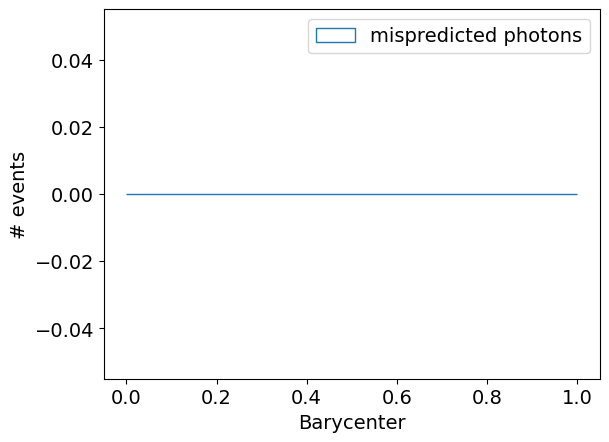

Plot Barycenter of mispredicted pions
len: 22793


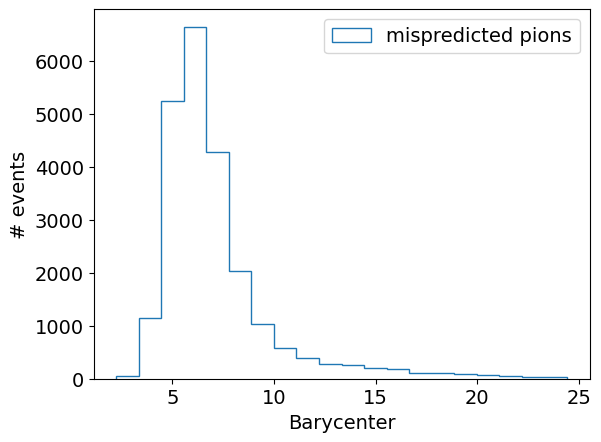

In [35]:
# mispredicted PHOTONS
print("Plot Barycenter of mispredicted photons")

fig, ax = plt.subplots(1,1)#,figsize=(40, 12),dpi=80)

barycenter_mis_pho = []
for uarray in mispredpho:
    
    uarray = uarray.reshape(uarray.shape[1],uarray.shape[2])

    barycenter_z = np.average(uarray[:,2], weights=uarray[:,3])
    barycenter_mis_pho.append(barycenter_z)
    #print(barycenter_z)

print("len:",len(barycenter_mis_pho))
#print(barycenter_mis_pho)

ax.hist(barycenter_mis_pho, bins=20, histtype='step',linewidth=1,label='mispredicted photons')
ax.legend()
ax.set_xlabel('Barycenter')
ax.set_ylabel('# events')
 
plt.show()


### -------------
# mispredicted PIONS
print("Plot Barycenter of mispredicted pions")

fig, ax = plt.subplots(1,1)#,figsize=(40, 12),dpi=80)

barycenter_mis_bkg = []
for uarray in mispredbkg:
    
    uarray = uarray.reshape(uarray.shape[1],uarray.shape[2])

    barycenter_z = np.average(uarray[:,2], weights=uarray[:,3])
    barycenter_mis_bkg.append(barycenter_z)
    #print(barycenter_z)

print("len:",len(barycenter_mis_bkg))
#print(barycenter_mis_pho)

ax.hist(barycenter_mis_bkg, bins=20, histtype='step',linewidth=1,label='mispredicted pions')
ax.legend()
ax.set_xlabel('Barycenter')
ax.set_ylabel('# events')
 

plt.show()

Plot 3D features of mispredicted photons
mispredicted pho: 0


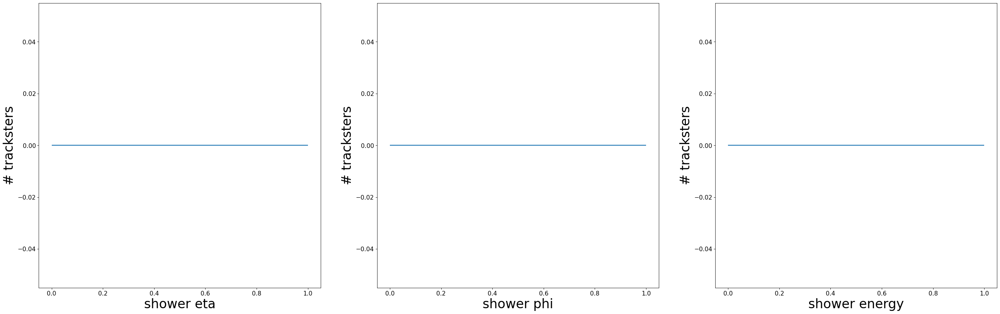

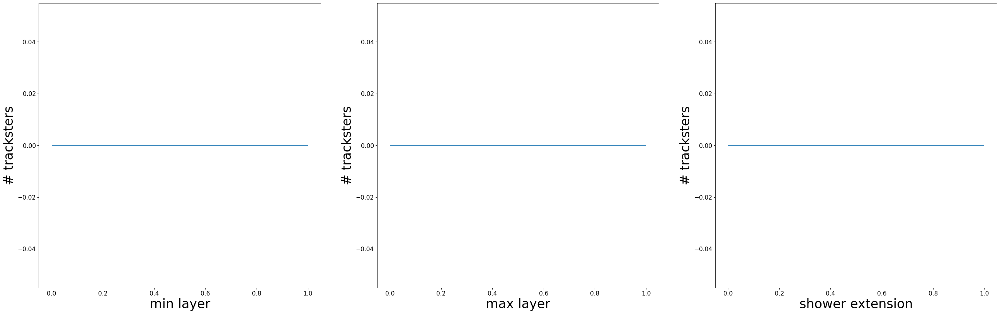

Plot 3D features of mispredicted pions
mispredicted bkg: 22793


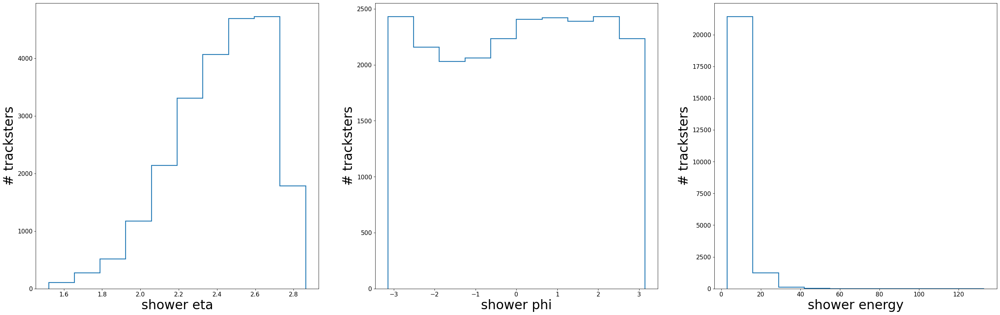

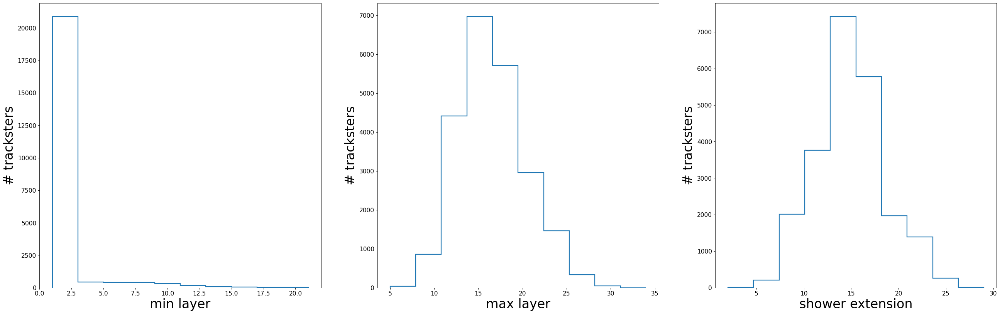

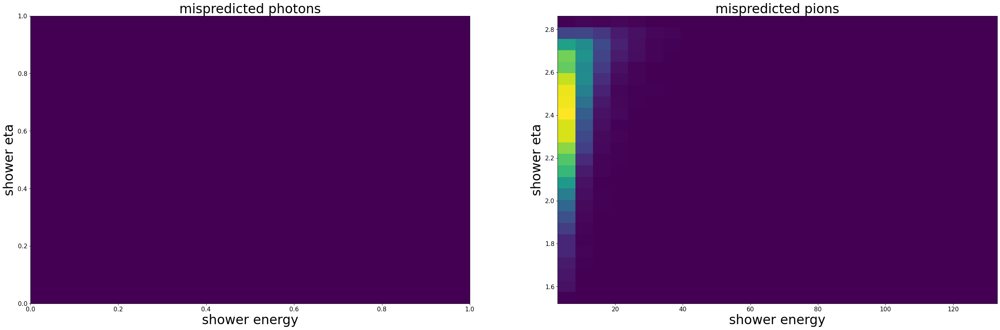

In [36]:
# mispredicted PHOTONS
print("Plot 3D features of mispredicted photons")

# mispredpho_3d is tensor of trackster information with 
# - mispredpho_3d[0] = eta
# - mispredpho_3d[1] = phi
# - mispredpho_3d[2] = energy
# - mispredpho_3d[3] = min layer
# - mispredpho_3d[4] = max layer


eta_mis_pho_3D = []  
phi_mis_pho_3D = []  
en_mis_pho_3D = []
minL_mis_pho_3D = []
maxL_mis_pho_3D = []
ext_mis_pho_3D = [] # shower extension

for tracksterarray in mispredpho_3d:

    eta_mis_pho_3D.append(tracksterarray[0][0])
    phi_mis_pho_3D.append(tracksterarray[0][1])
    en_mis_pho_3D.append(tracksterarray[0][2])
    minL_mis_pho_3D.append(tracksterarray[0][3])
    maxL_mis_pho_3D.append(tracksterarray[0][4])
    ext_mis_pho_3D.append(abs(tracksterarray[0][4] - tracksterarray[0][3]))

print('mispredicted pho:',len(mispredpho_3d))

fig, (ax0, ax1, ax2) = plt.subplots(1,3,figsize=(40, 12),dpi=80)
ax0.hist(eta_mis_pho_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax0.set_xlabel('shower eta',fontsize=30)
ax0.set_ylabel('# tracksters',fontsize=30)
ax1.hist(phi_mis_pho_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax1.set_xlabel('shower phi',fontsize=30)
ax1.set_ylabel('# tracksters',fontsize=30)
ax2.hist(en_mis_pho_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax2.set_xlabel('shower energy',fontsize=30)
ax2.set_ylabel('# tracksters',fontsize=30)

plt.show()

fig, (ax0, ax1, ax2) = plt.subplots(1,3,figsize=(40, 12),dpi=80)
ax0.hist(minL_mis_pho_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax0.set_xlabel('min layer',fontsize=30)
ax0.set_ylabel('# tracksters',fontsize=30)
ax1.hist(maxL_mis_pho_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax1.set_xlabel('max layer',fontsize=30)
ax1.set_ylabel('# tracksters',fontsize=30)
ax2.hist(ext_mis_pho_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax2.set_xlabel('shower extension',fontsize=30)
ax2.set_ylabel('# tracksters',fontsize=30)
 
plt.show()


# mispredicted PIONS
print("Plot 3D features of mispredicted pions")

# mispredbkg_3d is tensor of trackster information with 
# - mispredbkg_3d[0] = eta
# - mispredbkg_3d[1] = phi
# - mispredbkg_3d[2] = energy
# - mispredbkg_3d[3] = min layer
# - mispredbkg_3d[4] = max layer


eta_mis_bkg_3D = []  
phi_mis_bkg_3D = []  
en_mis_bkg_3D = []
minL_mis_bkg_3D = []
maxL_mis_bkg_3D = []
ext_mis_bkg_3D = [] # shower extension

for tracksterarray in mispredbkg_3d:

    eta_mis_bkg_3D.append(abs(tracksterarray[0][0]))
    phi_mis_bkg_3D.append(tracksterarray[0][1])
    en_mis_bkg_3D.append(tracksterarray[0][2])
    minL_mis_bkg_3D.append(tracksterarray[0][3])
    maxL_mis_bkg_3D.append(tracksterarray[0][4])
    ext_mis_bkg_3D.append(abs(tracksterarray[0][4] - tracksterarray[0][3]))

print('mispredicted bkg:',len(mispredbkg_3d))

fig, (ax0, ax1, ax2) = plt.subplots(1,3,figsize=(40, 12),dpi=80)
ax0.hist(eta_mis_bkg_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax0.set_xlabel('shower eta',fontsize=30)
ax0.set_ylabel('# tracksters',fontsize=30)
ax1.hist(phi_mis_bkg_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax1.set_xlabel('shower phi',fontsize=30)
ax1.set_ylabel('# tracksters',fontsize=30)
ax2.hist(en_mis_bkg_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax2.set_xlabel('shower energy',fontsize=30)
ax2.set_ylabel('# tracksters',fontsize=30)

plt.show()

fig, (ax0, ax1, ax2) = plt.subplots(1,3,figsize=(40, 12),dpi=80)
ax0.hist(minL_mis_bkg_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax0.set_xlabel('min layer',fontsize=30)
ax0.set_ylabel('# tracksters',fontsize=30)
ax1.hist(maxL_mis_bkg_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax1.set_xlabel('max layer',fontsize=30)
ax1.set_ylabel('# tracksters',fontsize=30)
ax2.hist(ext_mis_bkg_3D, histtype='step', linewidth=2, label='mispredicted photons')
ax2.set_xlabel('shower extension',fontsize=30)
ax2.set_ylabel('# tracksters',fontsize=30)
 
plt.show()

# eta vs energy
fig, (ax0,ax1) = plt.subplots(1, 2,figsize=(40, 12),dpi=80)
ax0.hist2d(en_mis_pho_3D, eta_mis_pho_3D, bins=25)
ax0.set_title('mispredicted photons',fontsize=30)
ax0.set_xlabel('shower energy',fontsize=30)
ax0.set_ylabel('shower eta',fontsize=30)
ax1.hist2d(en_mis_bkg_3D, eta_mis_bkg_3D, bins=25)
ax1.set_title('mispredicted pions',fontsize=30)
ax1.set_xlabel('shower energy',fontsize=30)
ax1.set_ylabel('shower eta',fontsize=30)
plt.show()